In [ ]:
from bs4 import BeautifulSoup
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import networkx as nx
import scipy
from scipy.sparse import csr_matrix
from tqdm import tqdm
from scipy.sparse.linalg import LinearOperator

In [ ]:
table = pd.read_csv('all_data/content/drive/MyDrive/arXiv_table.csv')

In [ ]:
table

,Unnamed: 0,author,title,abstract,key_words,date_published
0,0,Marc Moreno Lopez \n Jugal Kalita \n Marc More...,Deep Learning applied to NLP,Convolutional Neural Network (CNNs) are typi...,natural language processing \n deep learning \...,2017-03-09
1,1,Li Wang \n Dennis Sng \n Li Wang \n Dennis Sng,Deep Learning Algorithms with Applications to ...,Deep learning has recently achieved very pro...,natural language processing \n deep learning \...,2015-12-10
2,2,Jian Guo \n He He \n Tong He \n Leonard Lausen...,GluonCV and GluonNLP: Deep Learning in Compute...,"We present GluonCV and GluonNLP, the deep le...",natural language processing \n deep learning \...,2019-07-09
3,3,Chuyu Xiong,What Really is Deep Learning Doing?,Deep learning has achieved a great success i...,natural language processing \n deep learning \...,2017-11-06
4,4,Jianqing Fan \n Cong Ma \n Yiqiao Zhong \n Jia...,A Selective Overview of Deep Learning,Deep learning has arguably achieved tremendo...,natural language processing \n deep learning \...,2019-04-10
...,...,...,...,...,...,...
995,995,Devinder Kumar \n Graham W Taylor \n Alexander...,Opening the Black Box of Financial AI with CLE...,Deep learning has been shown to outperform t...,natural language processing \n deep learning \...,2017-09-05
996,996,Jianqing Zhu \n Huanqiang Zeng \n Jingchang Hu...,Vehicle Re-identification Using Quadruple Dire...,In order to resist the adverse effect of vie...,natural language processing \n deep learning \...,2018-11-13
997,997,Kiran Rama \n Pradeep Kumar \n Bharat Bhasker ...,Deep Learning to Address Candidate Generation ...,Among the machine learning applications to b...,natural language processing \n deep learning \...,2019-07-17
998,998,Saul Calderon-Ramirez \n Shengxiang Yang \n Da...,Semi-supervised Deep Learning for Image Classi...,Deep learning methodologies have been employ...,natural language processing \n deep learning \...,2022-03-01


### sort by time


In [ ]:
table['date_published'] = pd.to_datetime(table['date_published'])
table = table.sort_values(by='date_published',ascending=False)
table

,Unnamed: 0,author,title,abstract,key_words,date_published
561,561,Chenhao Xu \n Chang-Tsun Li \n Yongjian Hu \n ...,Deep Learning Techniques for Video Instance Se...,"Video instance segmentation, also known as m...",natural language processing \n deep learning \...,2023-10-19
954,954,Hejie Ying \n Mengmeng Song \n Yaohong Tang \n...,Enhancing Deep Neural Network Training Efficie...,Deep neural networks (DNN) have achieved rem...,natural language processing \n deep learning \...,2023-10-17
242,242,Muhan Zhang,Neural Attention: Enhancing QKV Calculation in...,"In the realm of deep learning, the self-atte...",natural language processing \n deep learning \...,2023-10-17
147,147,Guoxin Wang \n Qingyuan Wang \n Ganesh Neelaka...,Unsupervised Pre-Training Using Masked Autoenc...,Unsupervised learning methods have become in...,natural language processing \n deep learning \...,2023-10-17
565,565,Guanghua Wang \n Weili Wu \n Guanghua Wang \n ...,Surveying the Landscape of Text Summarization ...,"In recent years, deep learning has revolutio...",natural language processing \n deep learning \...,2023-10-13
...,...,...,...,...,...,...
497,497,Christian Scheible \n Hinrich Schuetze \n Chri...,Cutting Recursive Autoencoder Trees,Deep Learning models enjoy considerable succ...,natural language processing \n deep learning \...,2013-01-13
575,575,Shuang-Hong Yang,A Scale-Space Theory for Text,Scale-space theory has been established prim...,natural language processing \n deep learning \...,2012-12-10
767,767,James Gerard Wolff,Simplification and integration in computing an...,The main purpose of this article is to descr...,natural language processing \n deep learning \...,2012-12-02
812,812,Vladimir Kolmogorov \n Thomas Schoenemann \n V...,Generalized sequential tree-reweighted message...,This paper addresses the problem of approxim...,natural language processing \n deep learning \...,2012-05-29


In [ ]:
table.author = table.author.apply(lambda x: x.split(' \n '))

### Get all the authors

In [ ]:
table_exploded = table.explode('author')

## Construct table from google scholar data

In [ ]:
import os
files = os.listdir('all_data/content/drive/MyDrive/large authors data')

In [ ]:
dict_authors = {
                "name" : [],
            "affiliation" : [],
            "email_domain" : [],
            "interests" : [],
            "hindex" : [],
            "i10index" : [],
}

In [ ]:
import json

In [ ]:

for file in files:
    print(file)
    try :
        link  = 'all_data/content/drive/MyDrive/large authors data/' + file
        f =  open(link)
        data = json.load(f)

        for key in dict_authors.keys():

            dict_authors[key].append(data[key])
        f.close()
    except json.JSONDecodeError and IsADirectoryError:
        pass

Xuechao Sun
Ningxin Zheng
Kai Shu
Purvi Goel
Chen Change Loy
Tuka Alhanai
Hailin Jin
Qi Wang
Xiaodong He
Mengyuan Liu
Ganesh Bagler
Karteek Alahari
Anirban Laha
Matthias Grabmair
Matthew D. Hoffman
Barath Raj Kandur Raja
Pablo Arias
Guoliang Li
Ke Qin
Akarsh S
Qun Liu
Peter Fettke
Ulas Sert
Evgenii Zheltonozhskii
Kanav Vats
Subir Biswas
Shumin Deng
Yi-Chia Wang
Luis Vega
Maciej M. Mazurowski
Xiongwei Wu
Bing Shuai
Tianyu Gao
Tri Nguyen
Hui Deng
Ping Lu
Cameran Frank
Muhammad Ali Ibrahim
Yuyu Luo
Khiem Vinh Tran
Huiqiang Xie
Sungho Yoon
Yaoru Luo
Mitchell Nahmias
Cong Bai
Prabal Datta Barua
Min Peng
Yiheng Xu
Zhangyang Wang
Dheeraj Vattikonda
Mengwei Xu
Swasti Mishra
Shuai Zheng
Yongqiang Yao
Wenwu Zhu
Guangxiang Zhao
Soujanya Poria
Felix Hieber
Owen Rambow
Pravendra Singh
Pablo Pino
Xiaoyu Zhang
Michael Zyda
Christopher Hidey
Cyprien de Masson d'Autume
Nan Yang
Zolzaya Dashdorj
Shubhada Labde
Chen Zhao
Yan Shi
Gang Chen
Zihao Wang
Liang Zhao
Shi Jin
Ze Cao
 Zhang
Wangchunshu Zhou
Ahmad

In [ ]:
authors_info = pd.DataFrame(dict_authors)

# citation by year

Xuechao Sun
[2018, 2019, 2020, 2021, 2022, 2023]


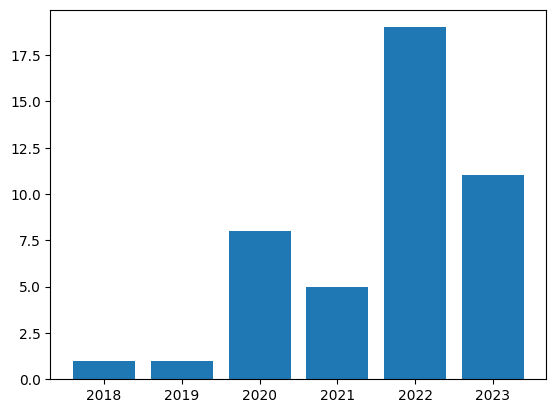

Ningxin Zheng
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


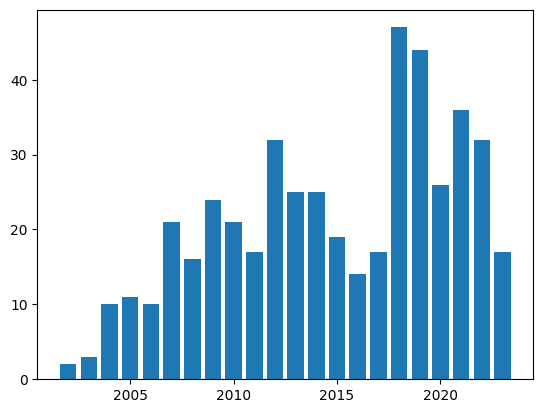

Kai Shu
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


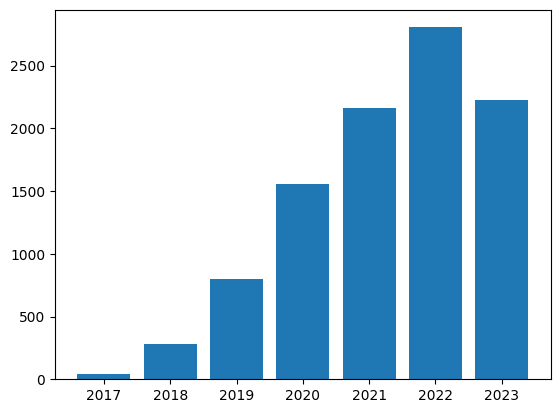

Purvi Goel
[2019, 2020, 2021, 2022, 2023]


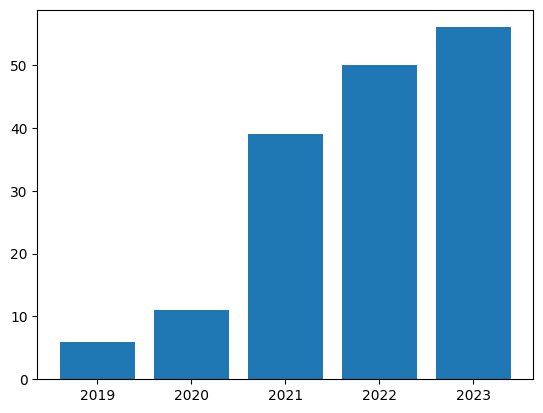

Chen Change Loy
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


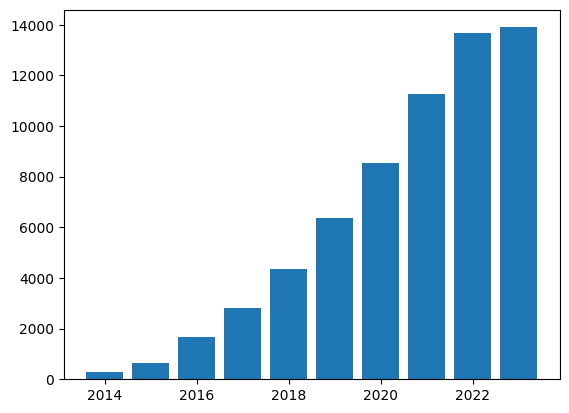

Tuka Alhanai
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


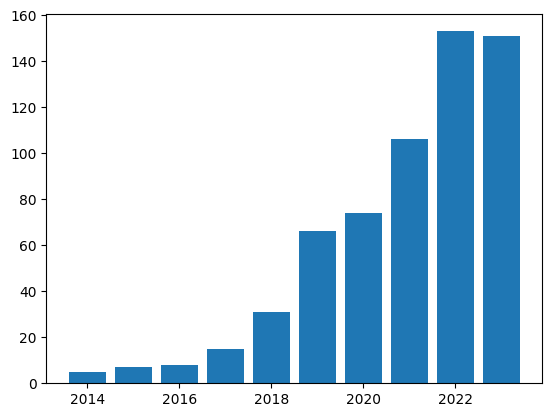

Hailin Jin
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


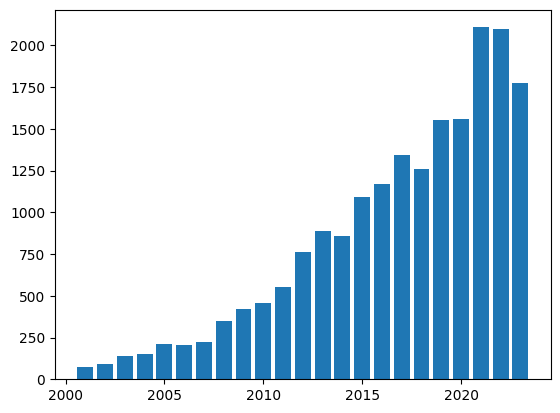

Qi Wang
[1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


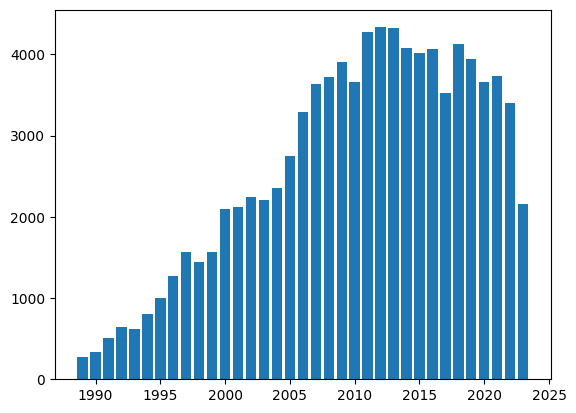

Xiaodong He
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


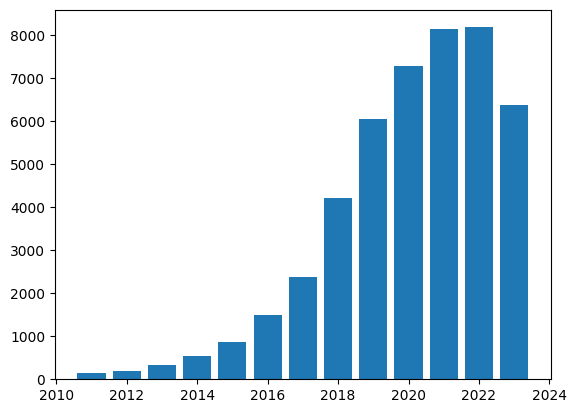

Mengyuan Liu
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


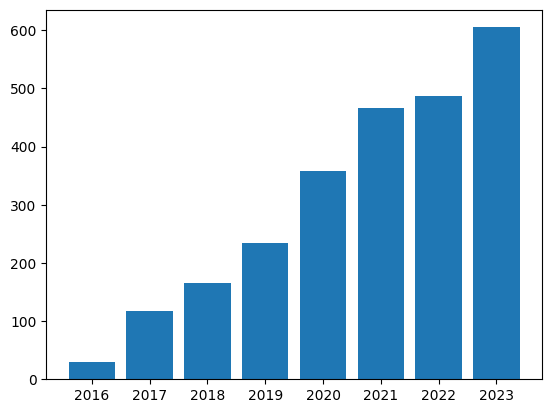

Ganesh Bagler
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


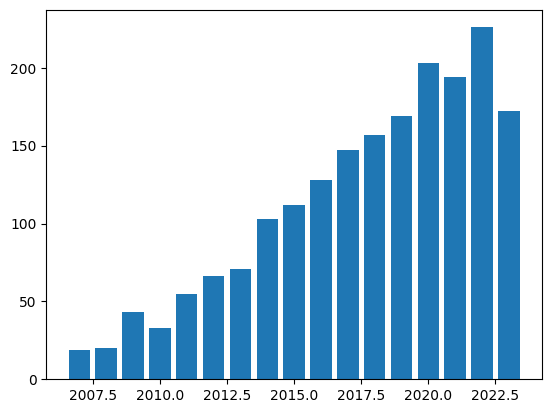

Karteek Alahari
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


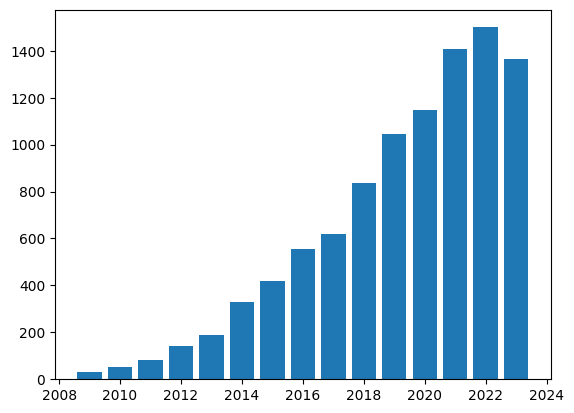

Anirban Laha
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


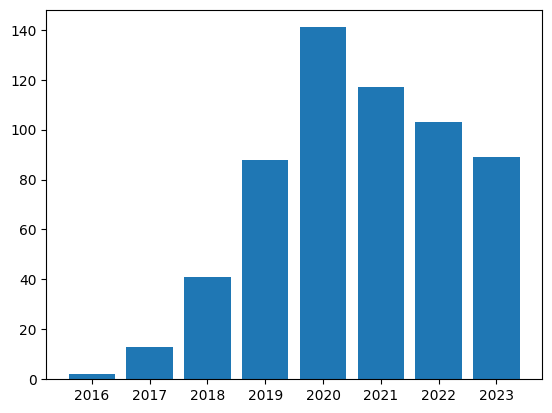

Matthias Grabmair
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


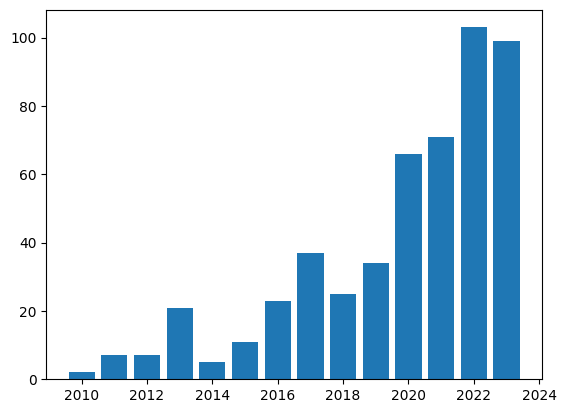

Matthew D. Hoffman
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


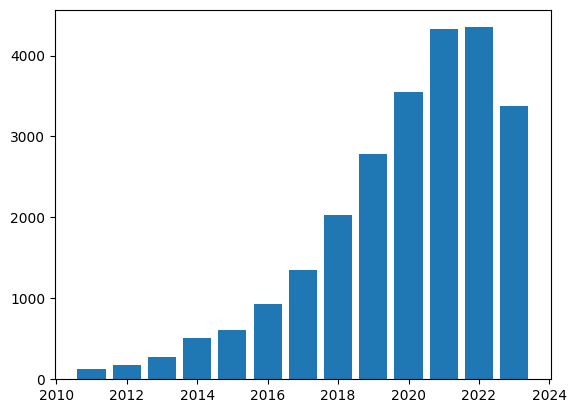

Barath Raj Kandur Raja
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


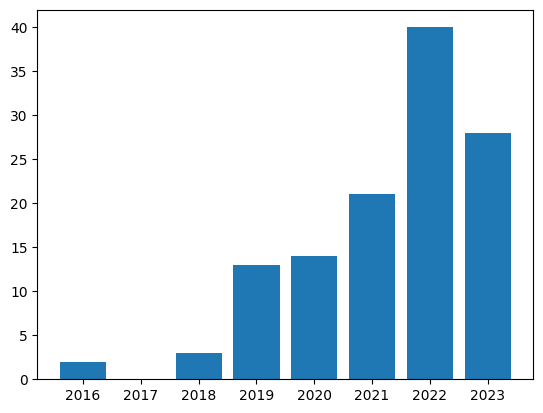

Pablo Arias
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


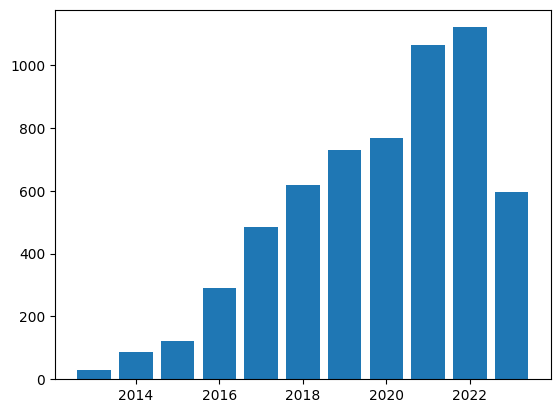

Guoliang Li
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


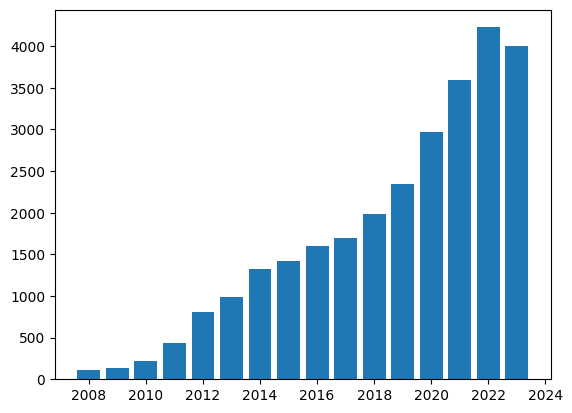

Ke Qin
[1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


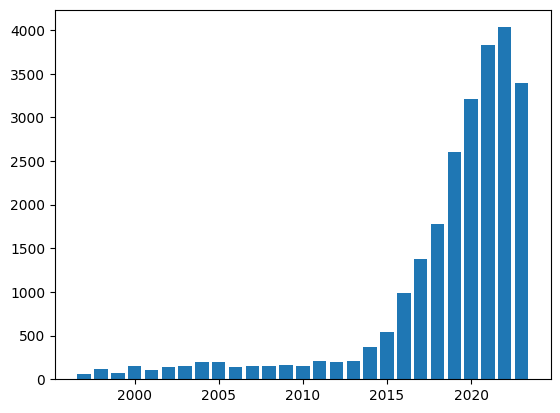

Akarsh S
[2019, 2020, 2021, 2022, 2023]


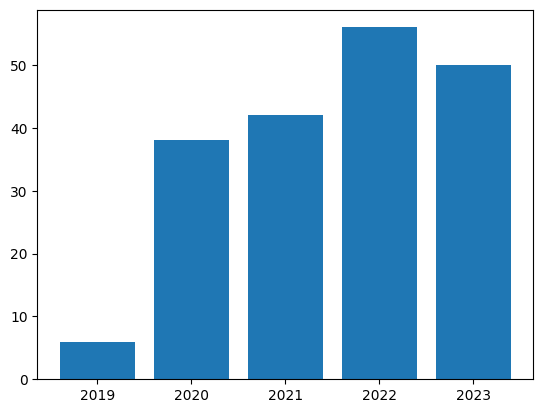

Qun Liu
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


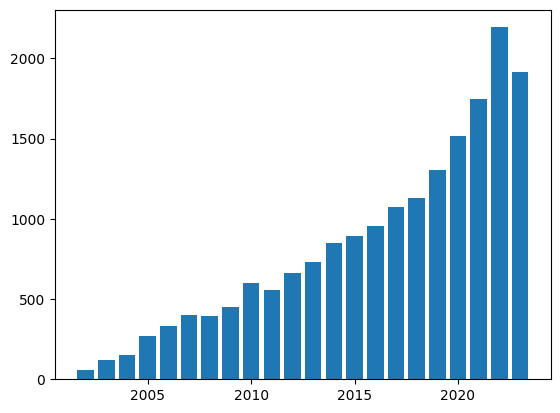

Peter Fettke
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


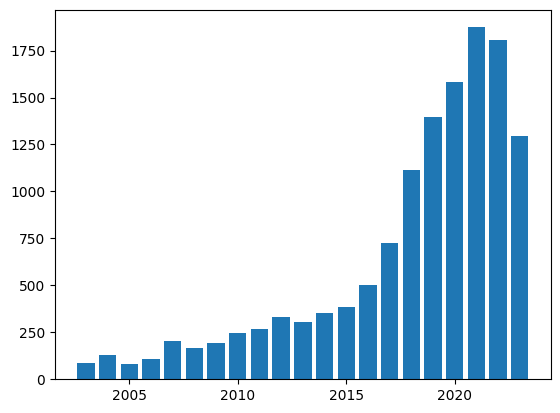

Ulas Sert
[2019, 2020, 2021, 2022, 2023]


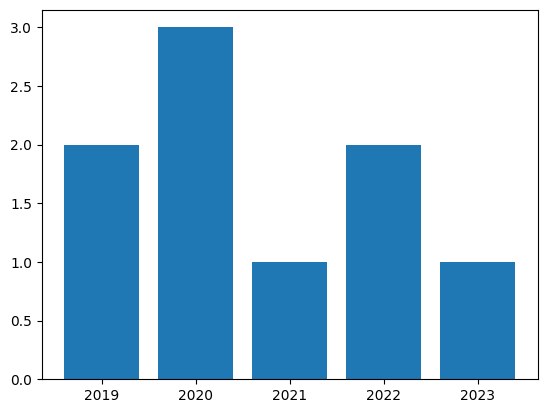

Evgenii Zheltonozhskii
[2018, 2019, 2020, 2021, 2022, 2023]


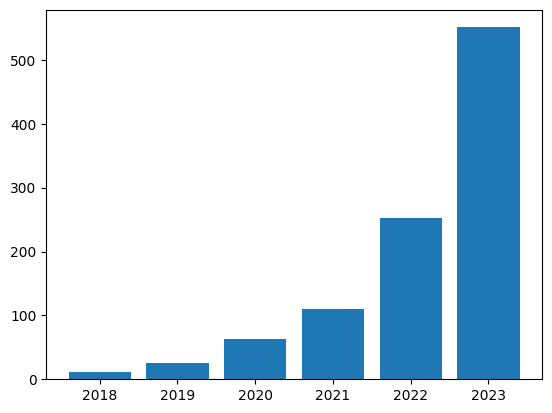

Kanav Vats
[2018, 2019, 2020, 2021, 2022, 2023]


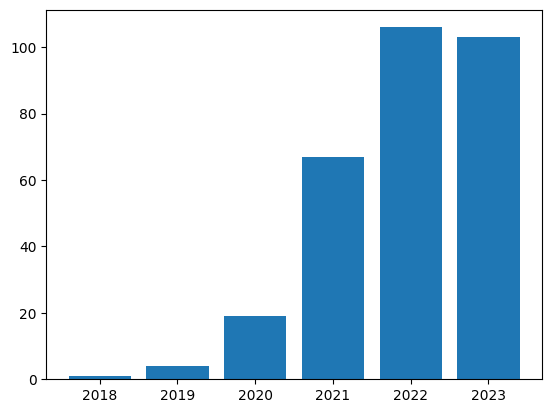

Subir Biswas
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


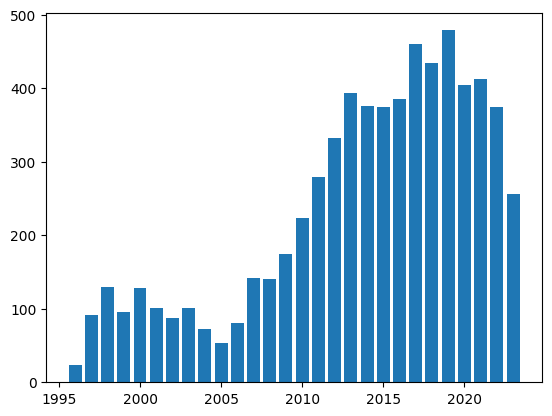

Shumin Deng
[2019, 2020, 2021, 2022, 2023]


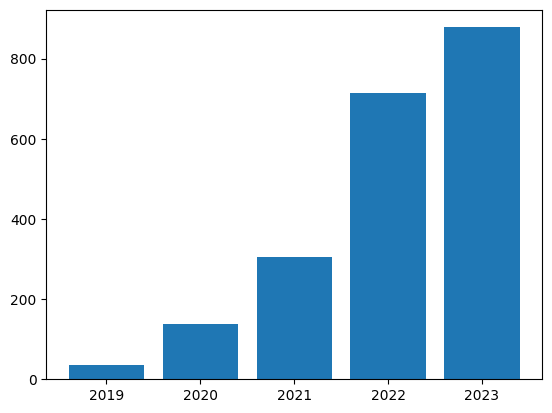

Yi-Chia Wang
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


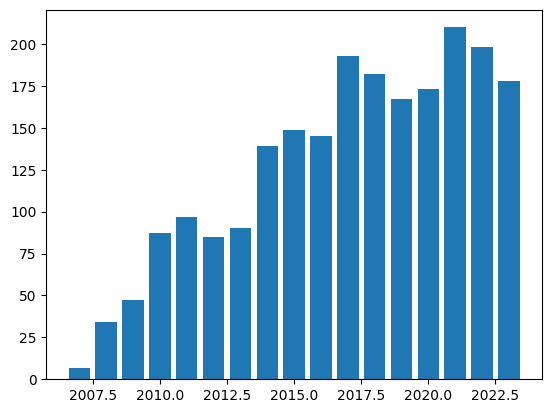

Luis Vega
[1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


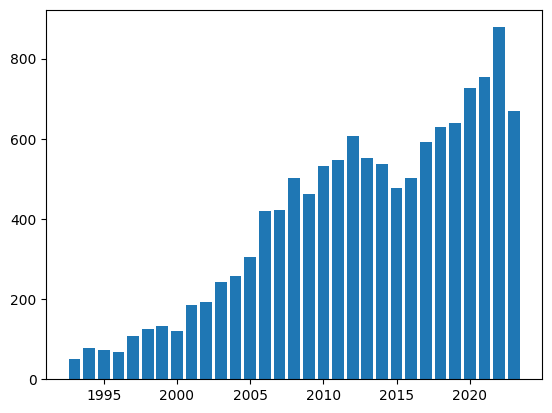

Maciej M. Mazurowski
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


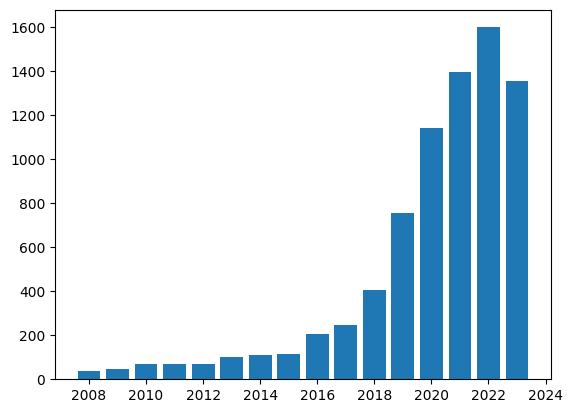

Xiongwei Wu
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


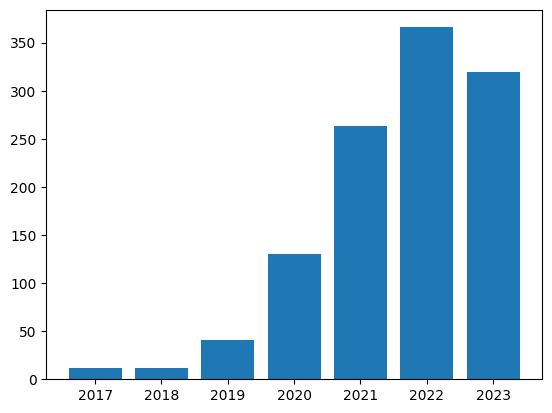

Bing Shuai
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


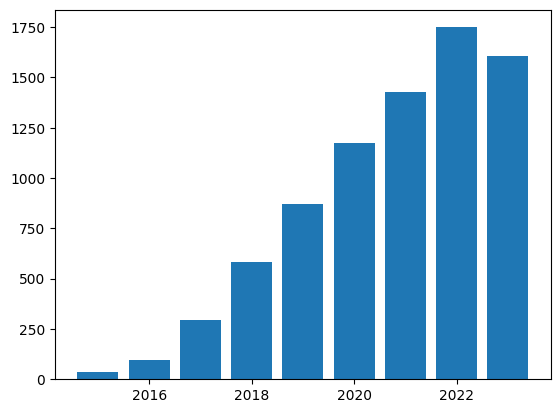

Tianyu Gao
[2019, 2020, 2021, 2022, 2023]


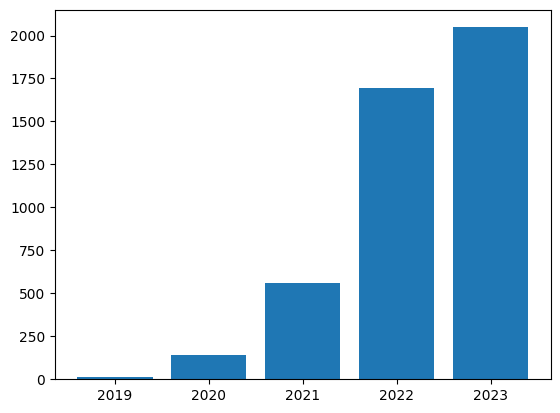

Tri Nguyen
[1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


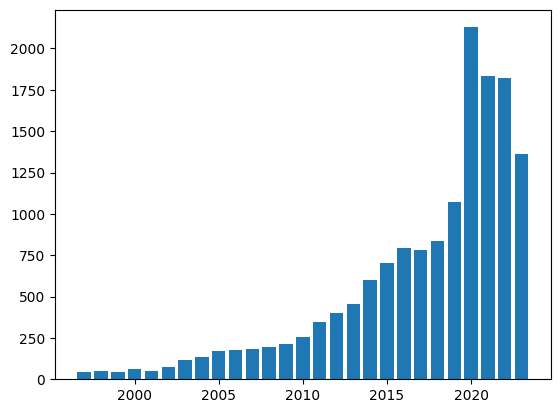

Hui Deng
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


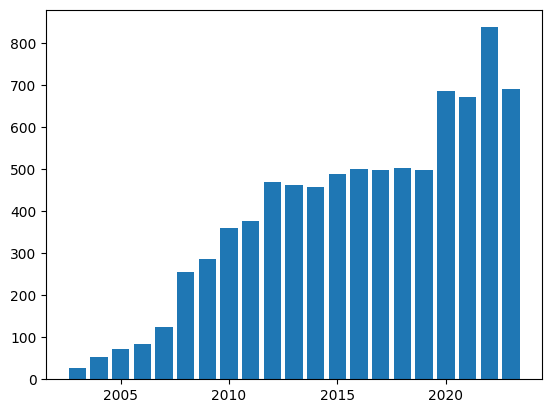

Ping Lu
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


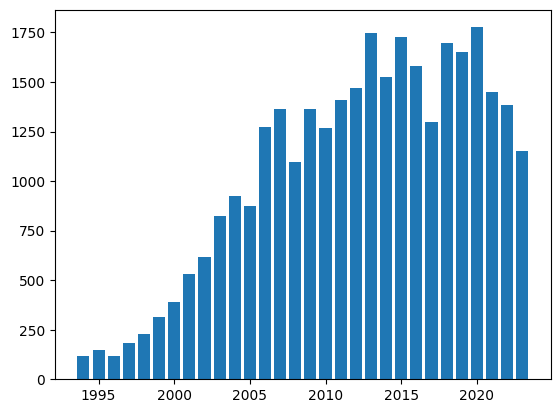

Cameran Frank
[1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


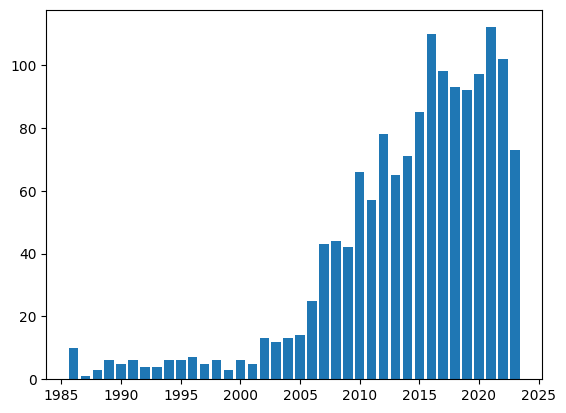

Muhammad Ali Ibrahim
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


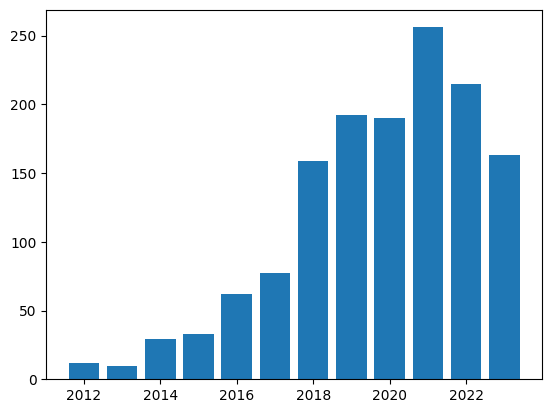

Yuyu Luo
[2018, 2019, 2020, 2021, 2022, 2023]


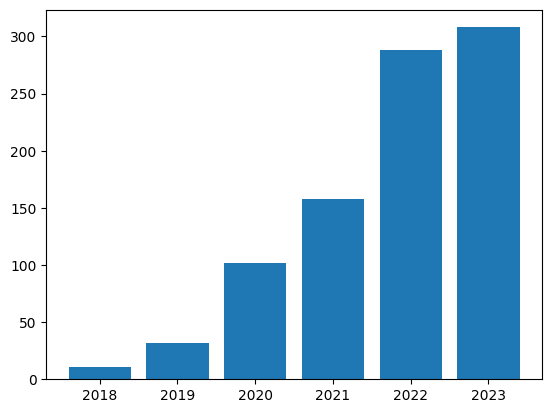

Khiem Vinh Tran
[2020, 2021, 2022, 2023]


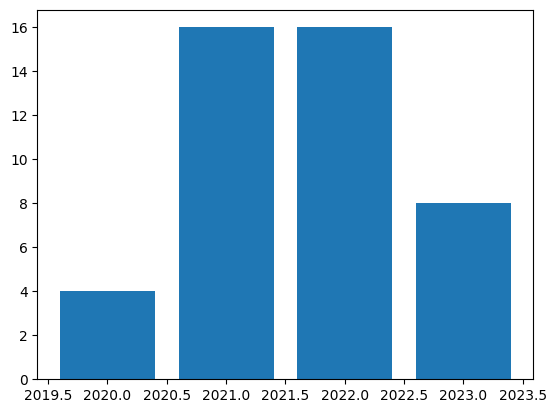

Huiqiang Xie
[2020, 2021, 2022, 2023]


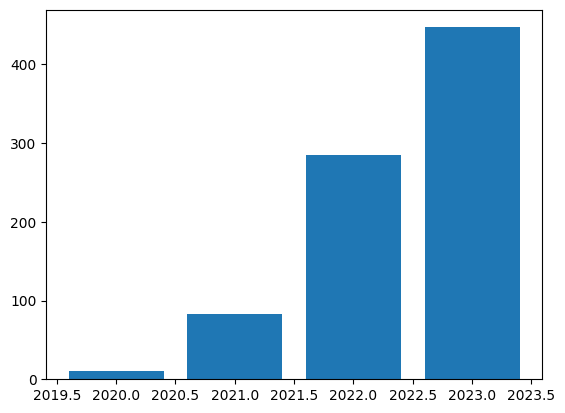

Sungho Yoon
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


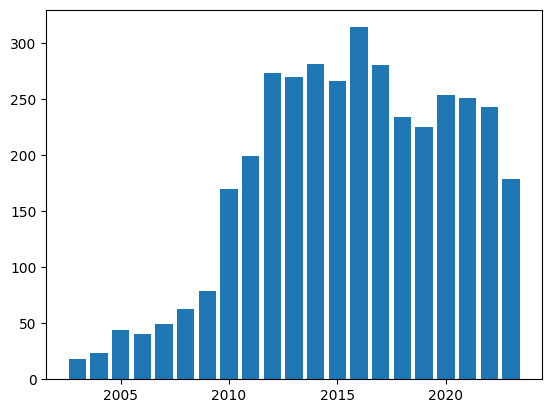

Yaoru Luo
[2019, 2020, 2021, 2022, 2023]


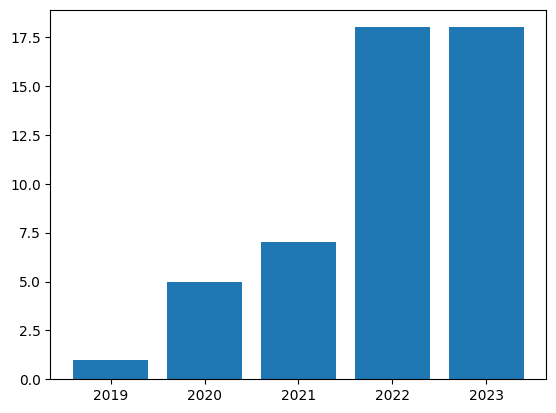

Mitchell Nahmias
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


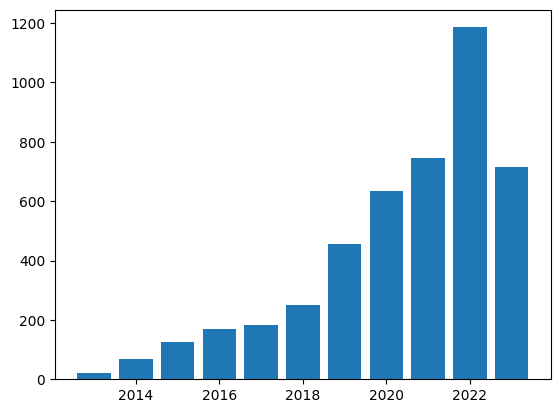

Cong Bai
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


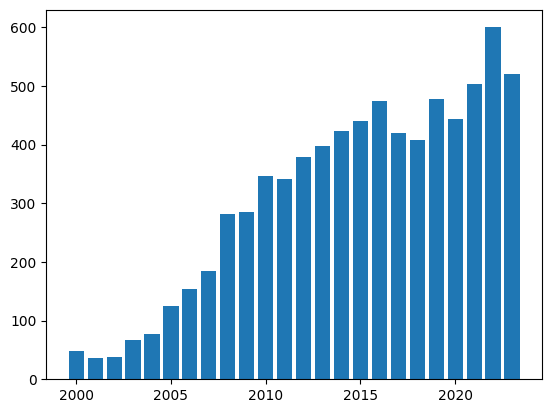

Prabal Datta Barua
[2019, 2020, 2021, 2022, 2023]


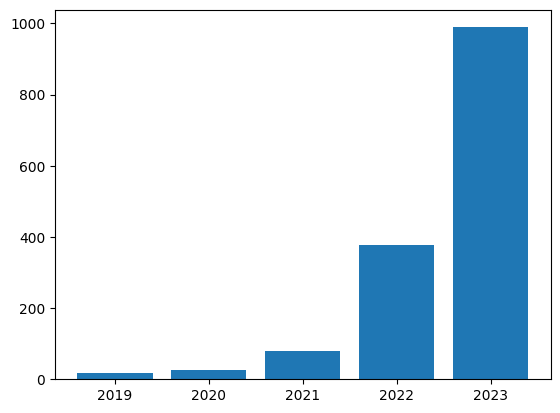

Min Peng
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


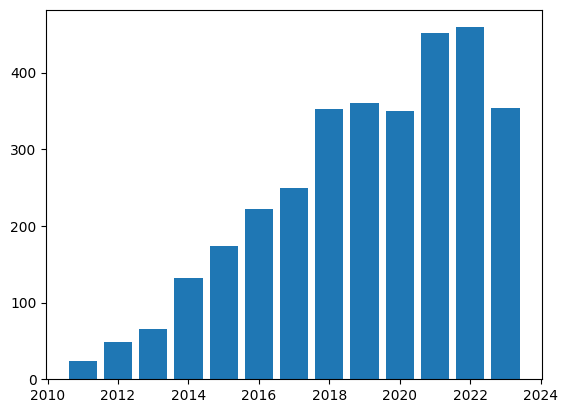

Yiheng Xu
[2020, 2021, 2022, 2023]


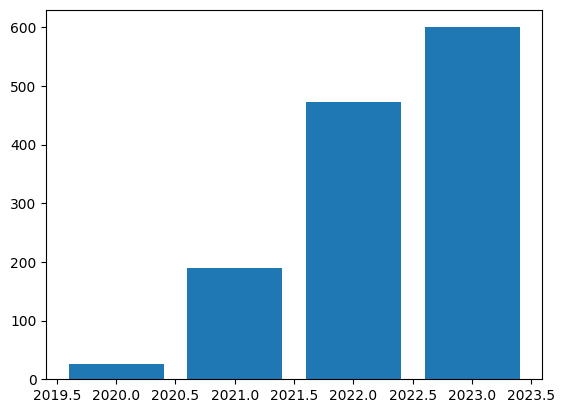

Zhangyang Wang
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


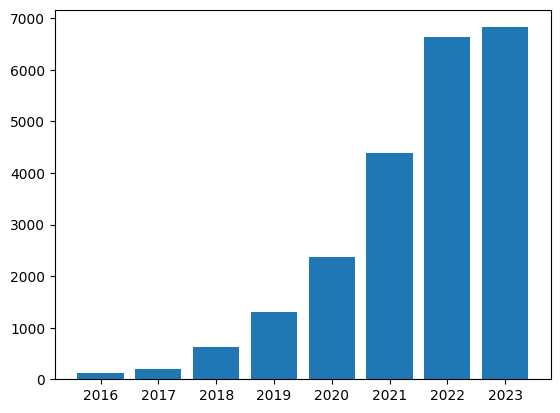

Dheeraj Vattikonda
[]


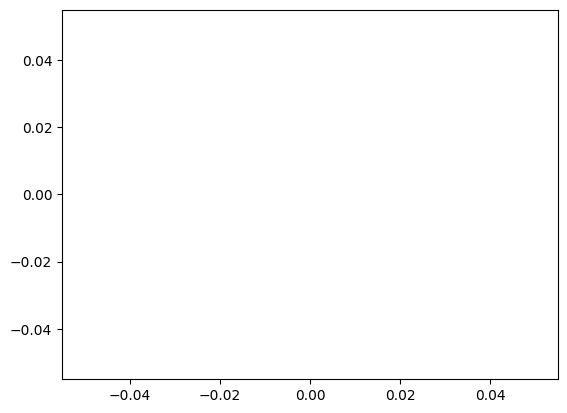

Mengwei Xu
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


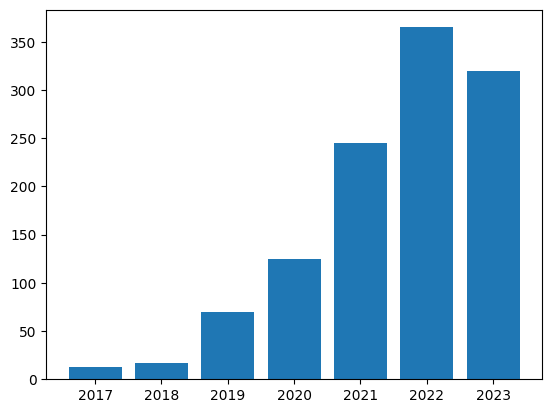

Swasti Mishra
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


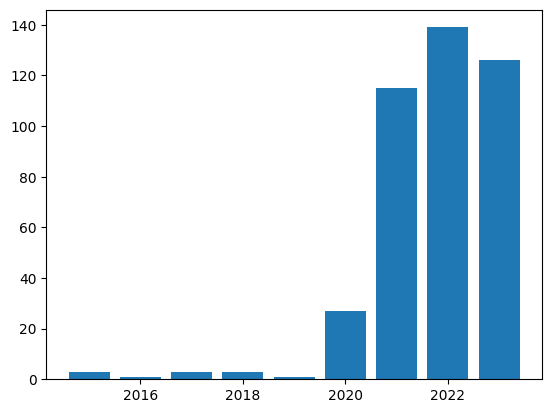

Shuai Zheng
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


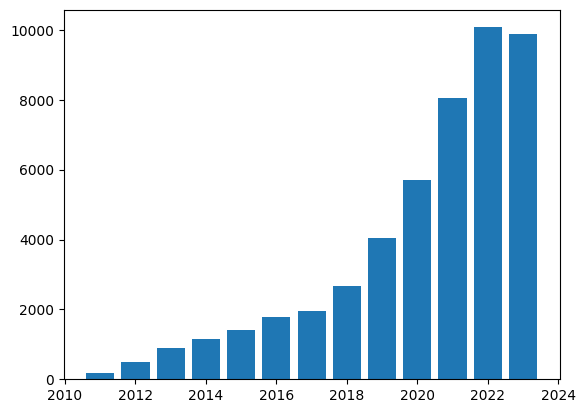

Yongqiang Yao
[2019, 2020, 2021, 2022, 2023]


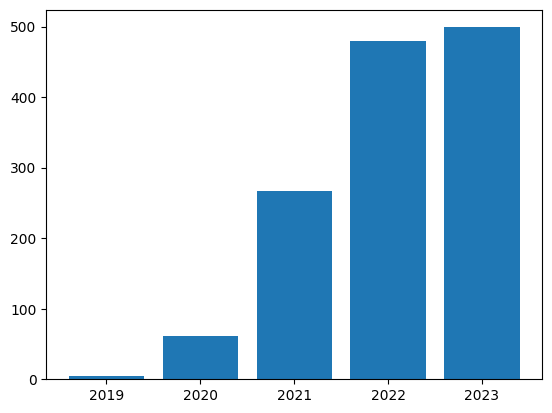

Wenwu Zhu
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


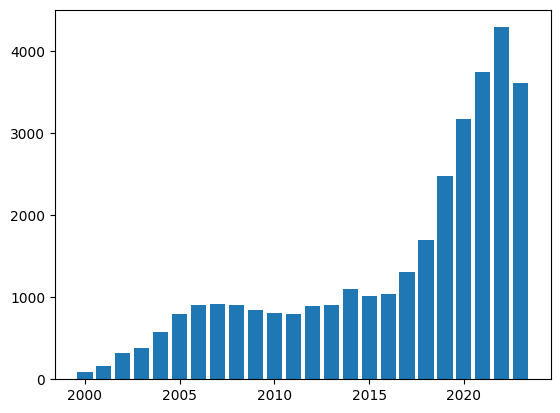

Guangxiang Zhao
[2019, 2020, 2021, 2022, 2023]


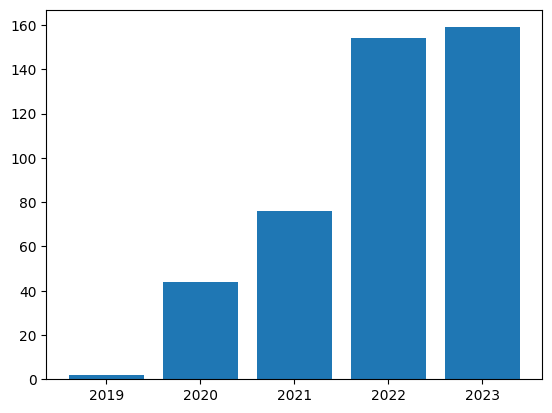

Soujanya Poria
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


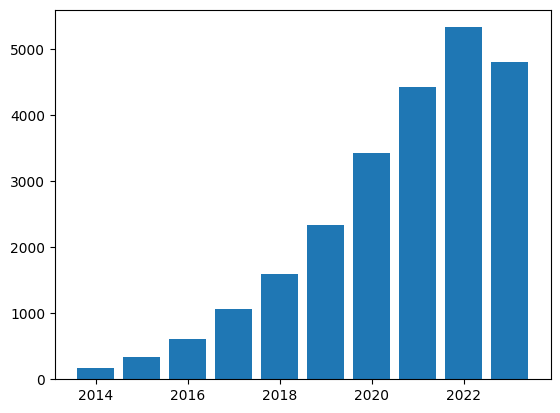

Felix Hieber
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


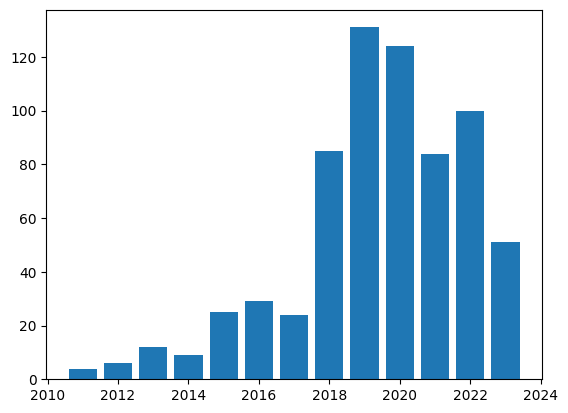

Owen Rambow
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


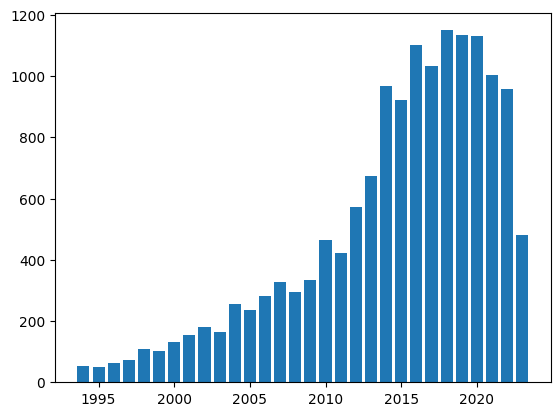

Pravendra Singh
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


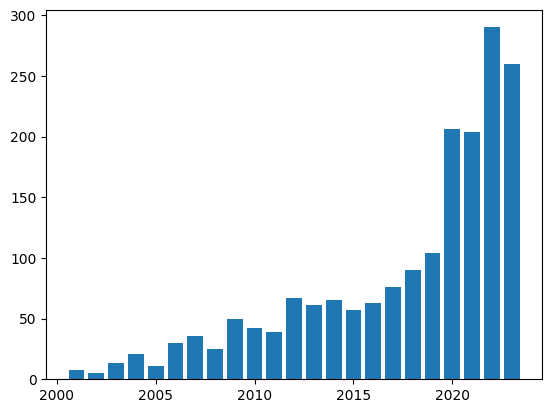

Pablo Pino
[1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


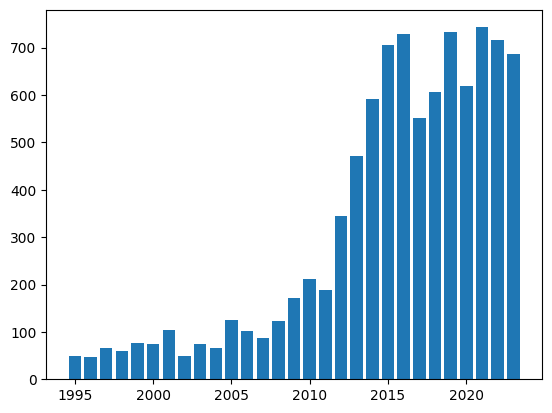

Xiaoyu Zhang
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


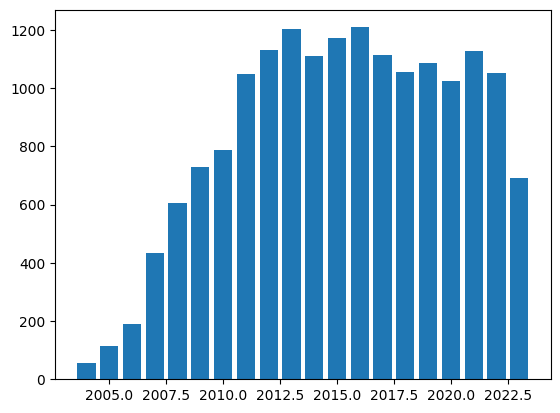

Michael Zyda
[1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


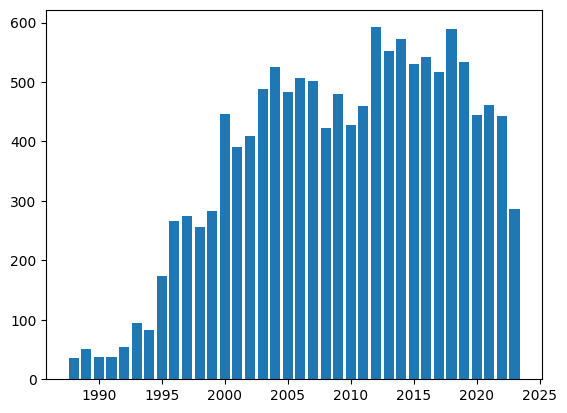

Christopher Hidey
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


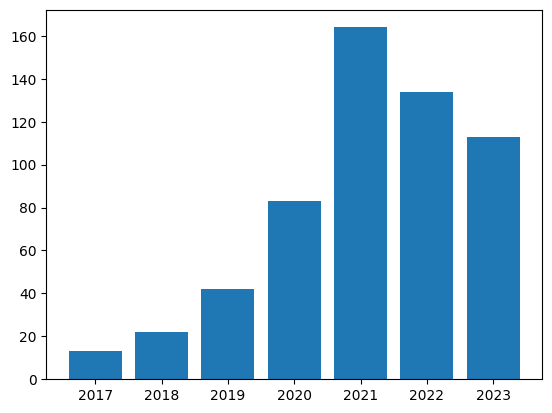

Cyprien de Masson d'Autume
[2018, 2019, 2020, 2021, 2022, 2023]


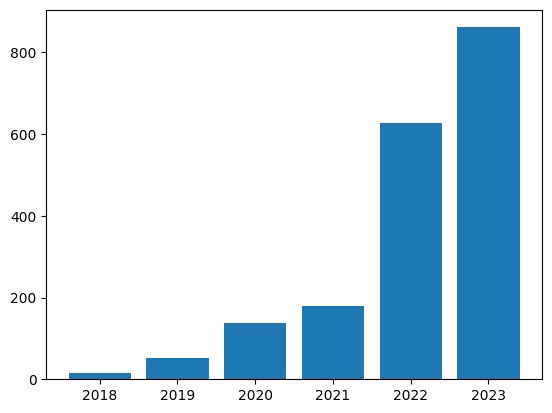

Nan Yang
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


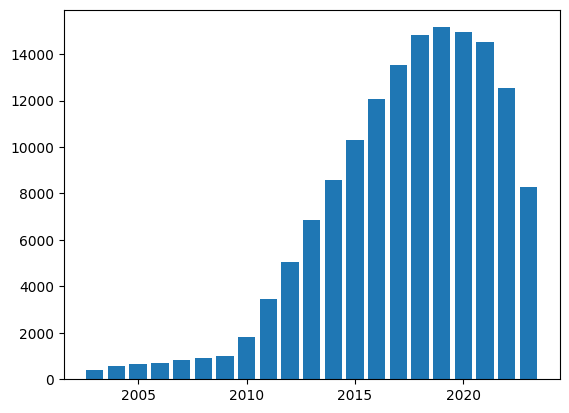

Zolzaya Dashdorj
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


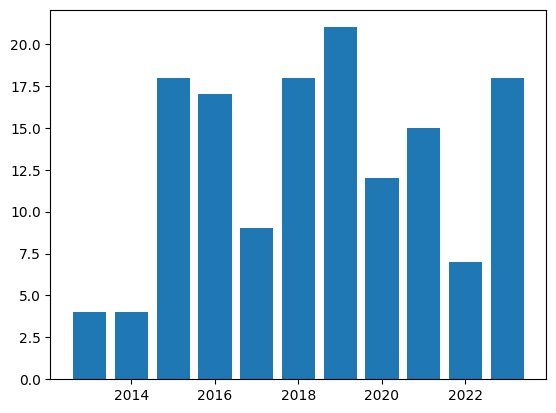

Shubhada Labde
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


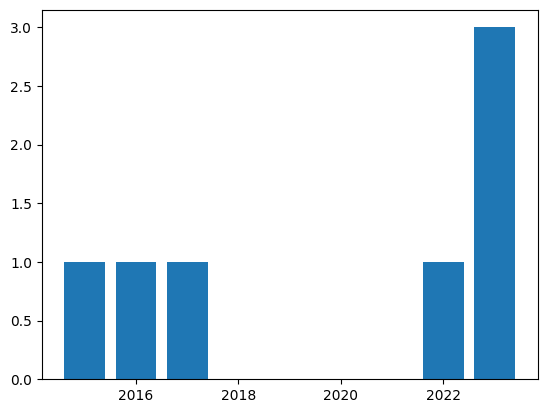

Chen Zhao
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


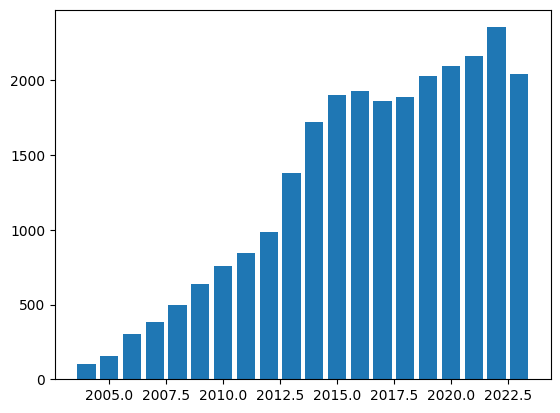

Yan Shi
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


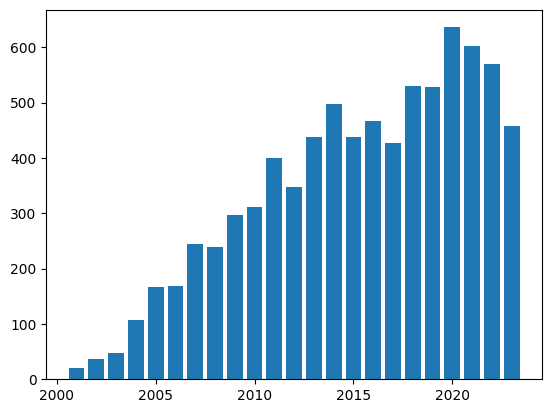

Gang Chen
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


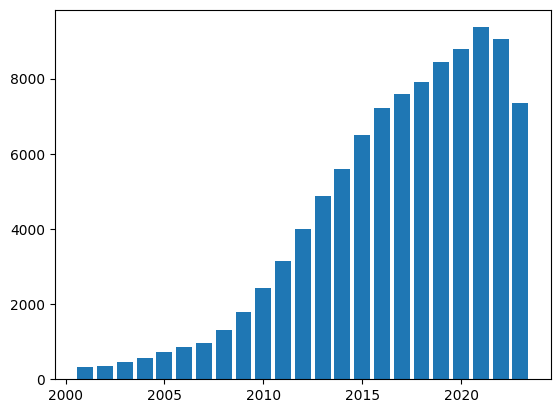

Zihao Wang
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


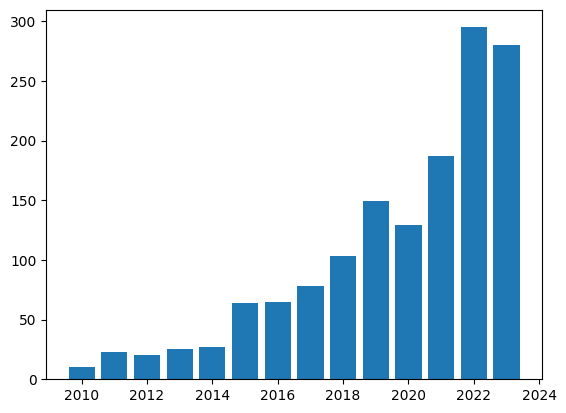

Liang Zhao
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


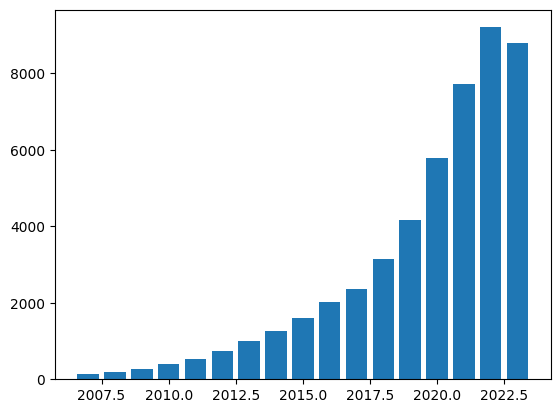

Shi Jin
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


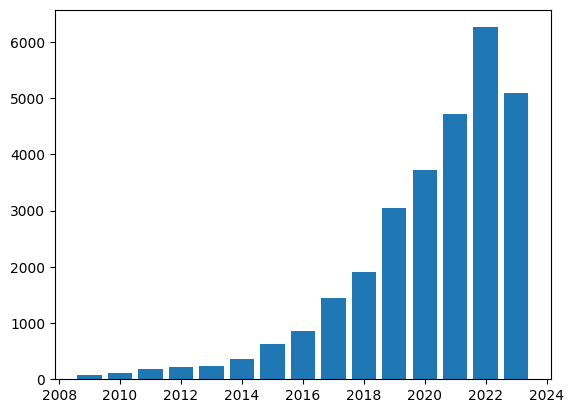

Ze Cao
[2019, 2020, 2021, 2022, 2023]


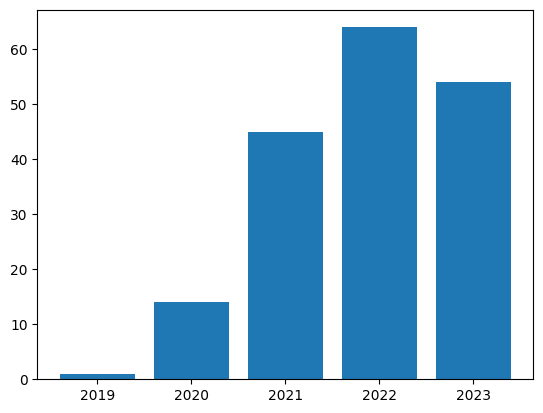

 Zhang
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


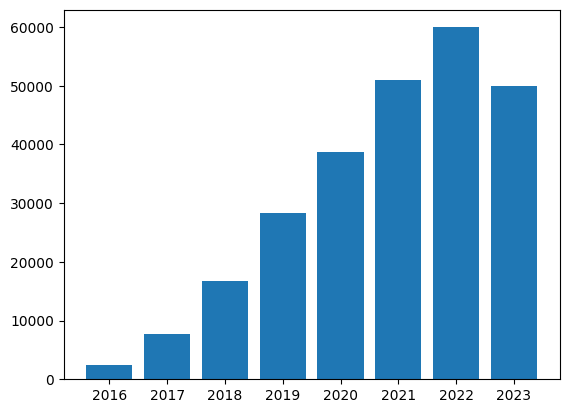

Wangchunshu Zhou
[2019, 2020, 2021, 2022, 2023]


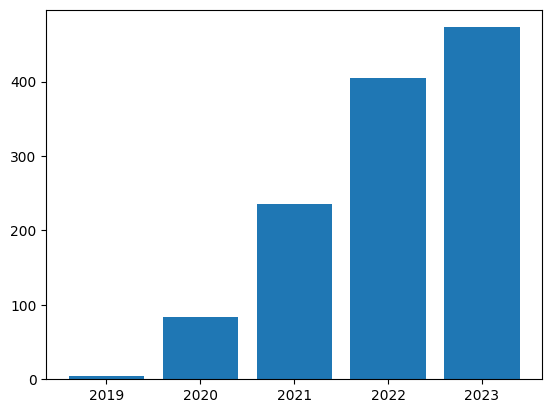

Ahmad Rashid
[1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


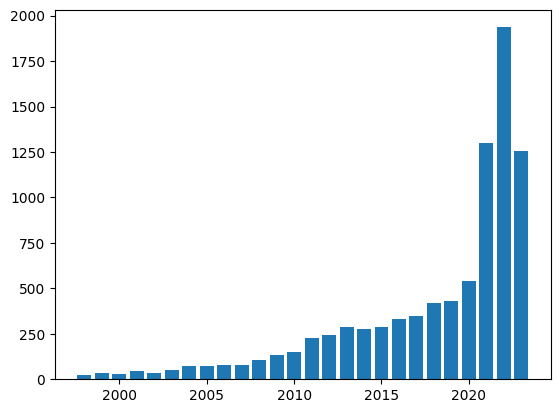

Jared Mathews
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


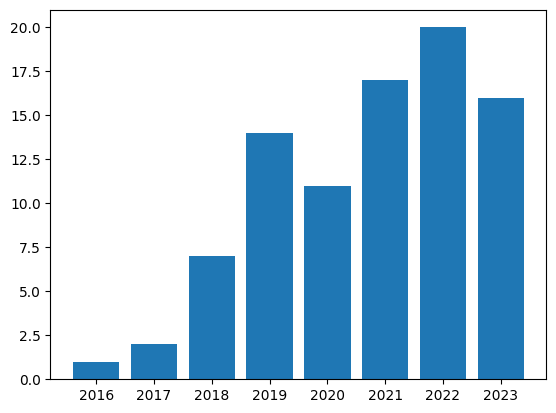

Gabriela de Queiroz
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


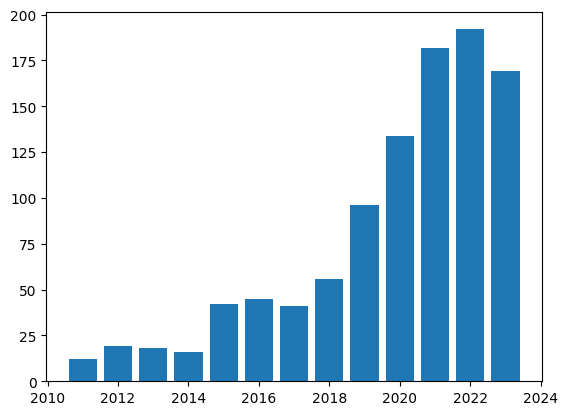

Baolin Li
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


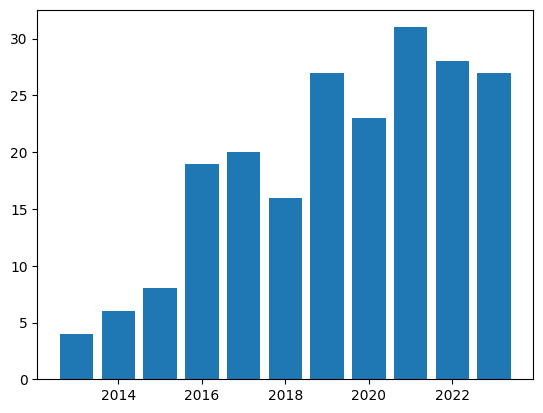

Javier Yebes
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


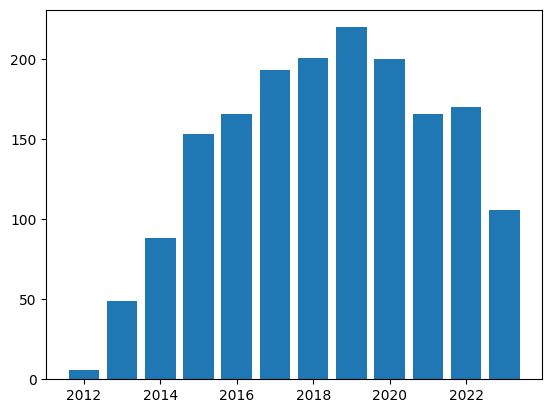

Philip Lubin
[1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


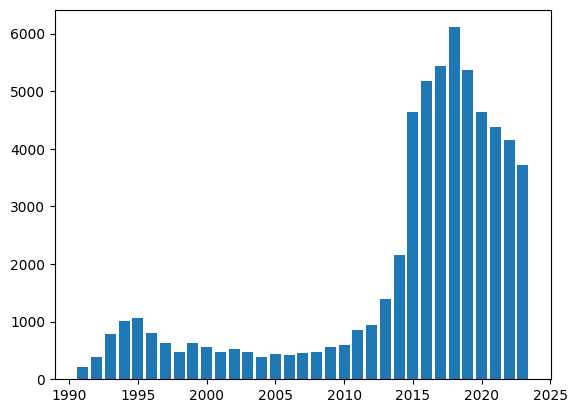

Anup Basu
[1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


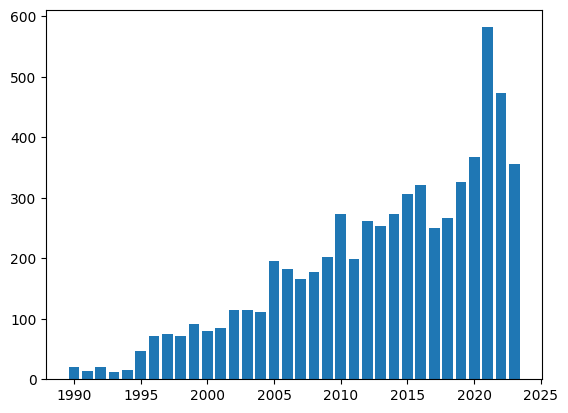

Natan Liss
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


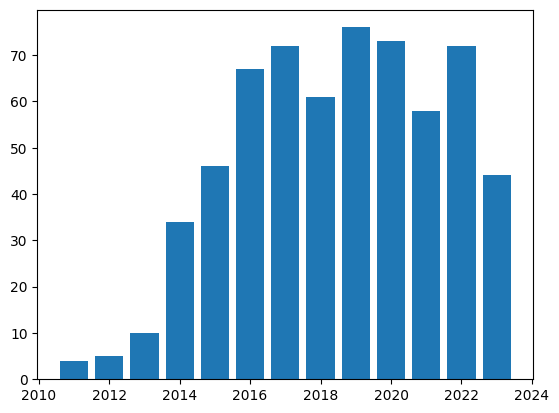

Jiebo Luo
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


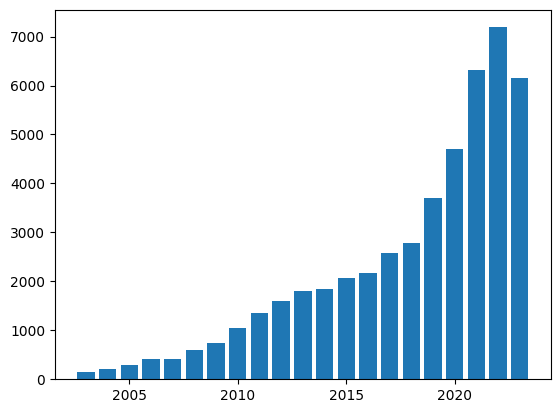

LiXin Zheng
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


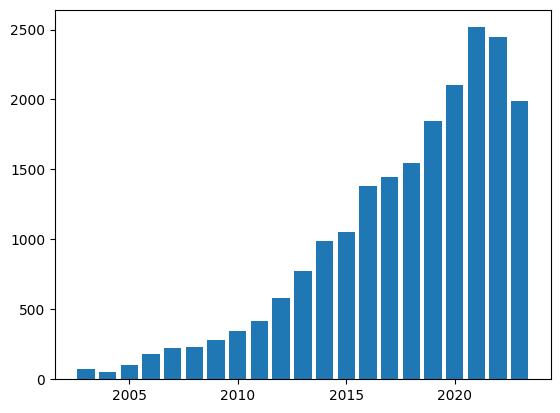

Kuo Yang
[1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


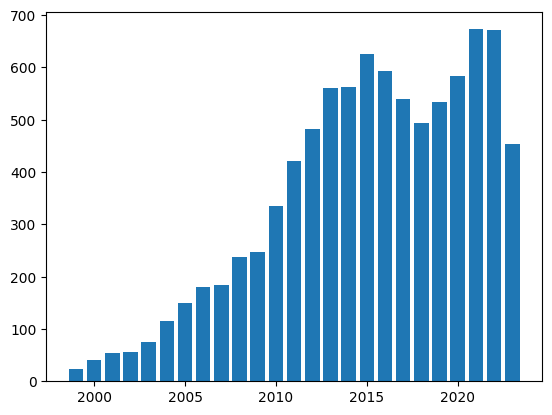

James O' Neill
[1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


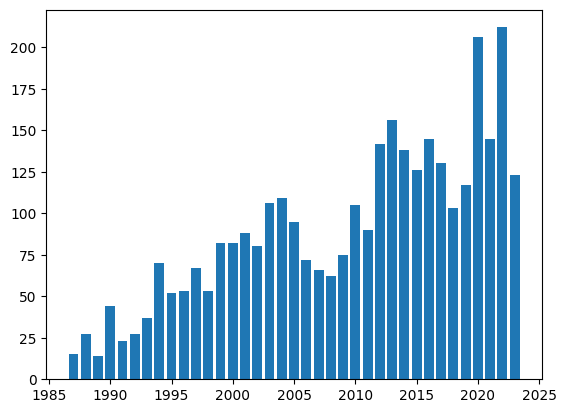

Daniel McDuff
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


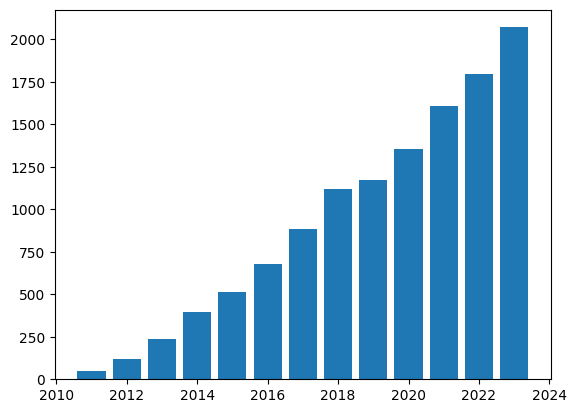

Anupam Shukla
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


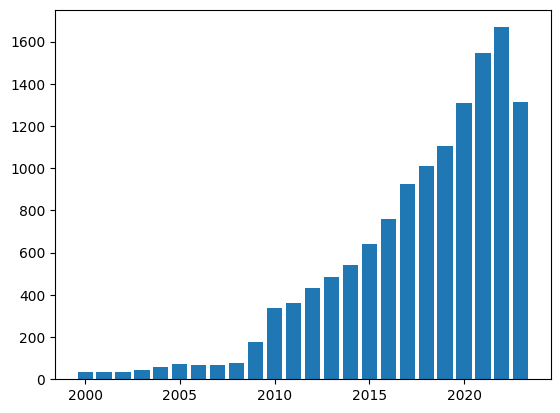

Hinrich Schütze
[1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


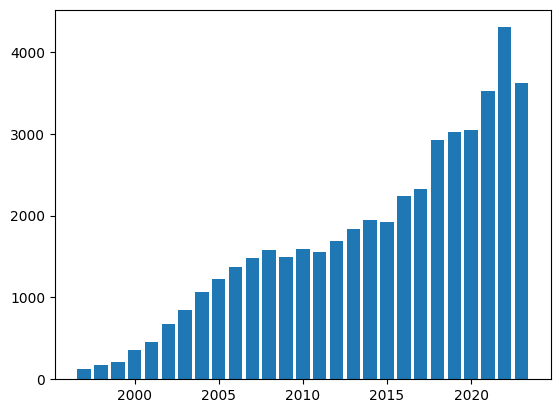

Chaim Baskin
[2018, 2019, 2020, 2021, 2022, 2023]


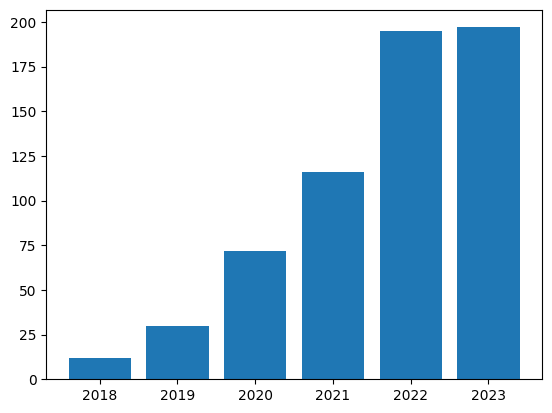

Fuzhao Xue
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


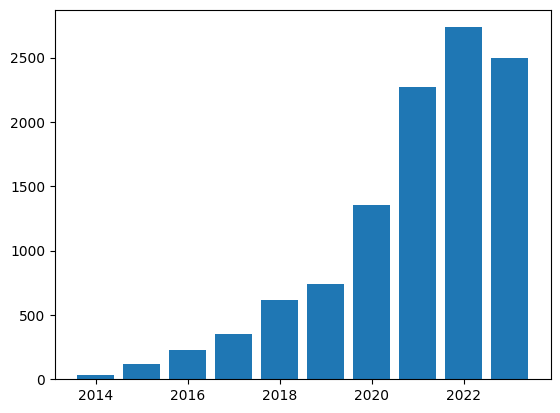

Ramtin Zand
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


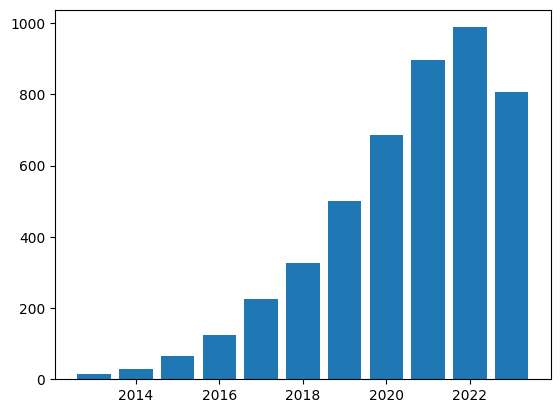

He Huang
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


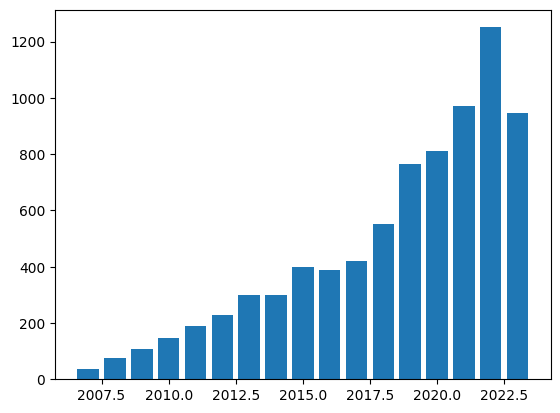

Xing Fu
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


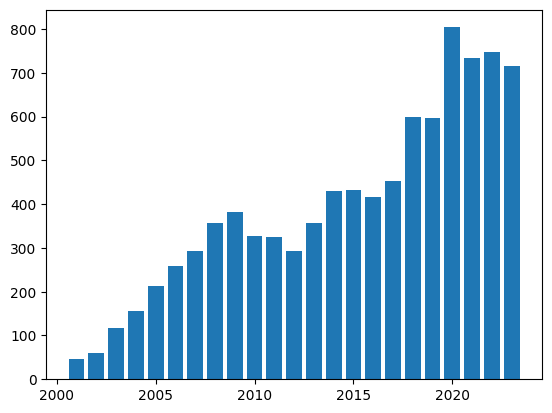

Stefan Ruseti
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


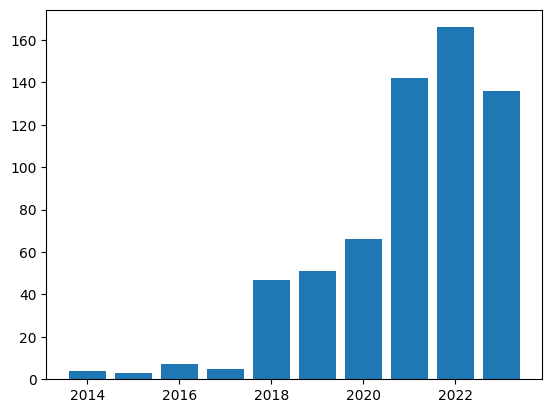

Yue Liu
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


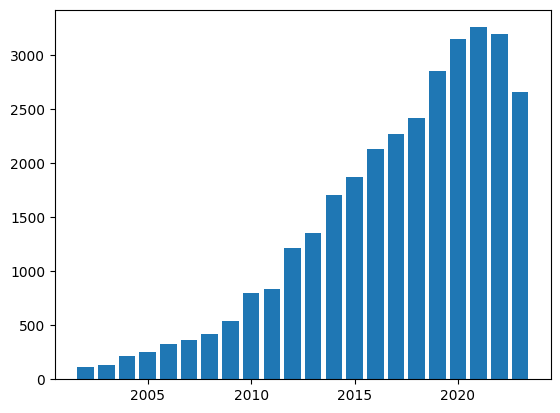

Yu Shi
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


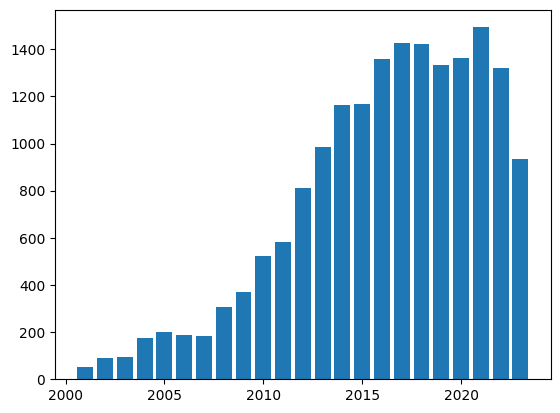

Pallab Chakraborty
[2021, 2022, 2023]


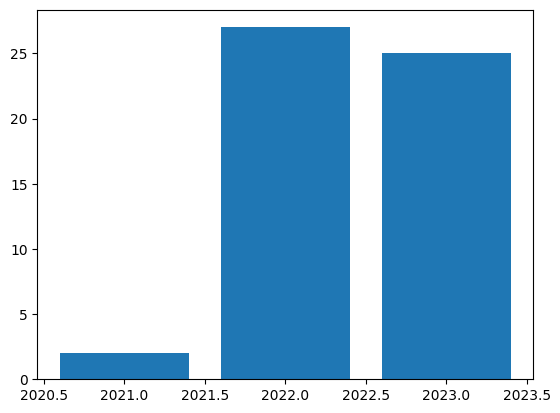

Udo Hoffmann
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


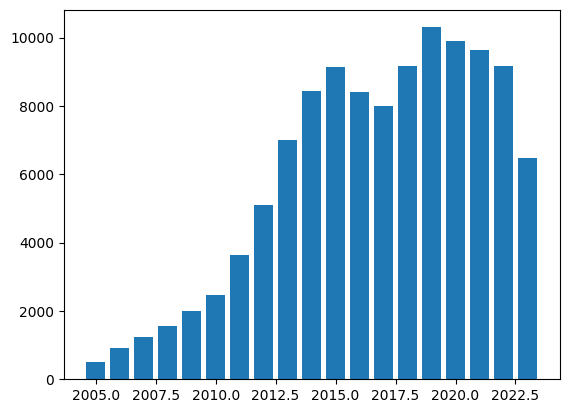

Sergiu Oprea
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


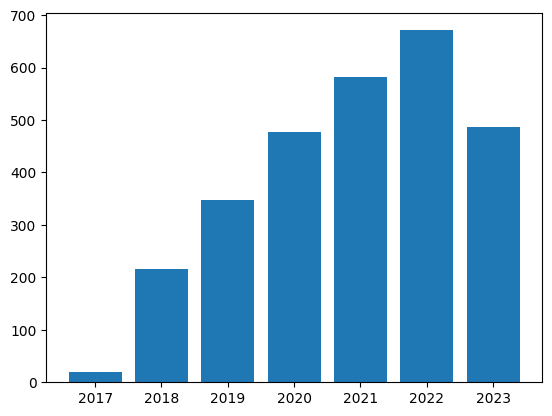

Honglin Mu
[]


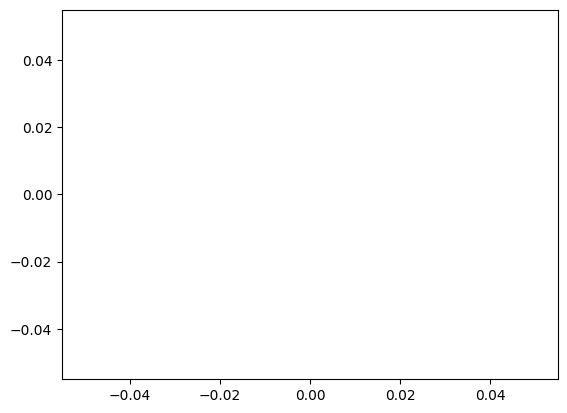

Kranti Chalamalasetti
[2019, 2020, 2021, 2022, 2023]


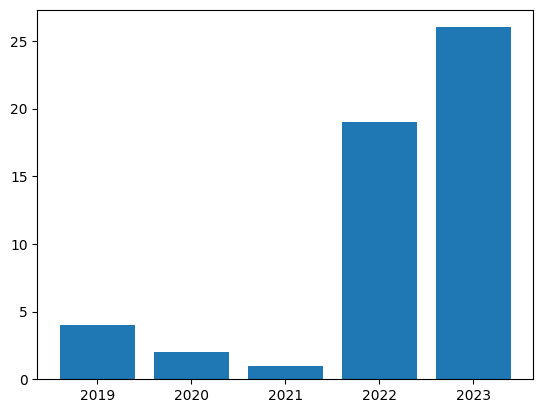

Srinivas S S Kruthiventi
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


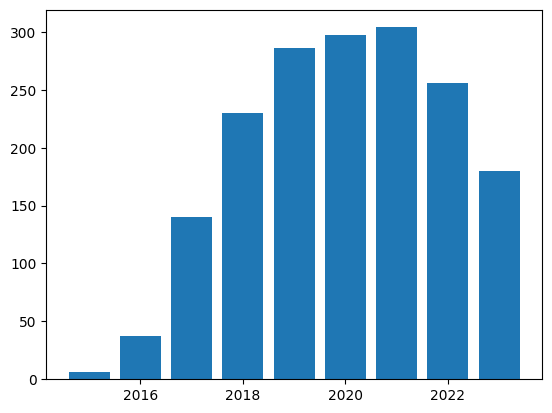

Pedro Machado
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


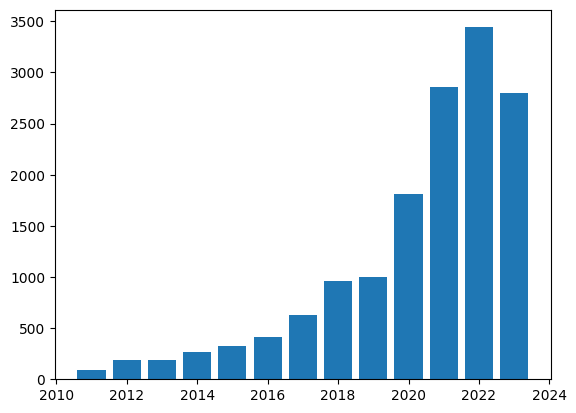

Awal Ahmed Fime
[2020, 2021, 2022, 2023]


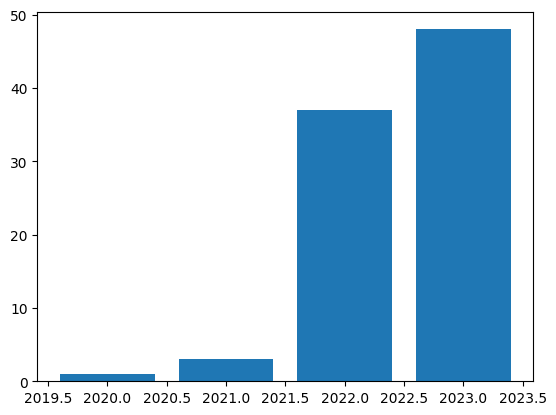

Wojciech Samek
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


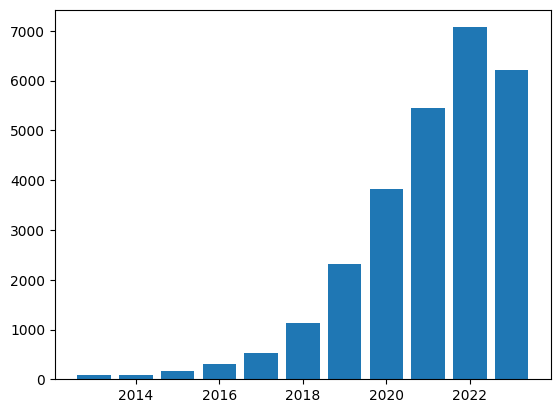

Wendong Ge
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


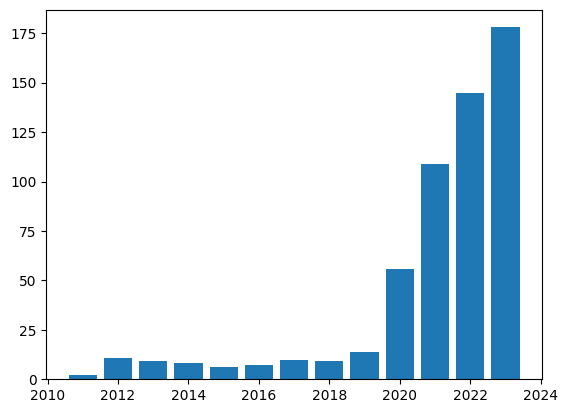

Qingqing Zhu
[2022, 2023]


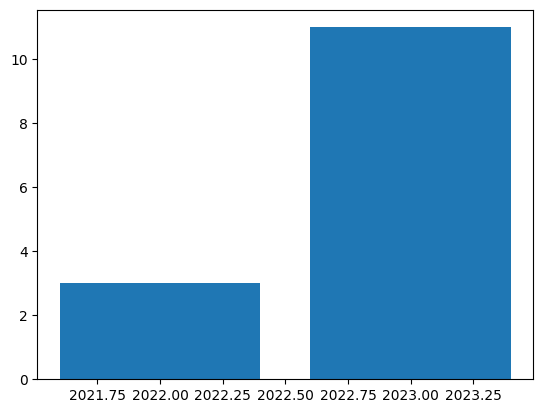

Xihong Yang
[2022, 2023]


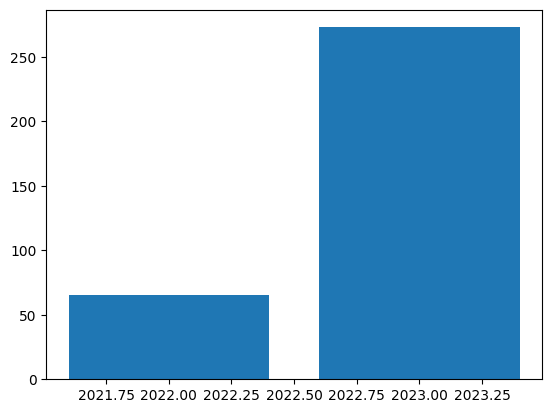

Lianli Gao
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


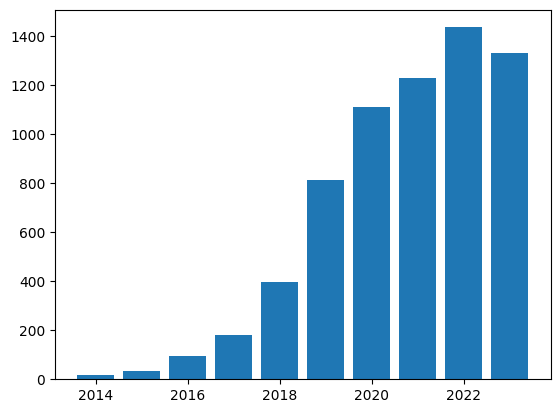

Jianguo Liu
[1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


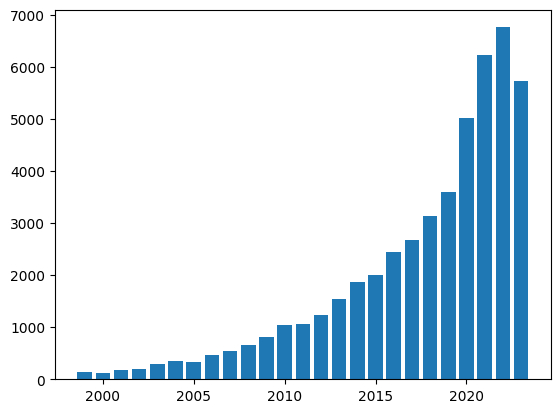

Dung Van Pham
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


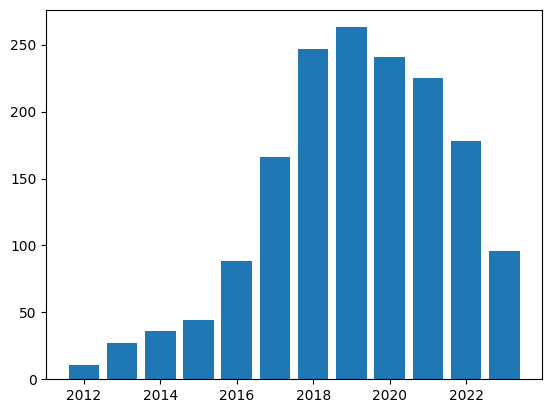

Issa Khalil
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


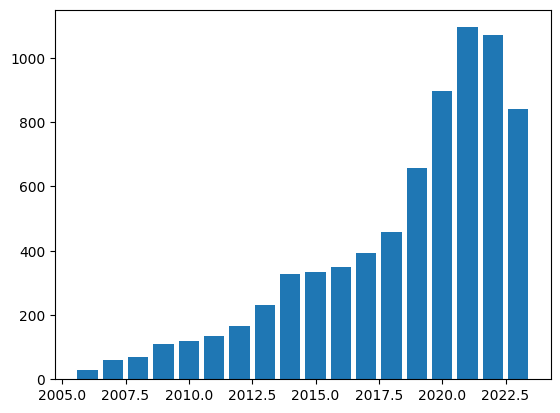

Yuyu Guo
[2018, 2019, 2020, 2021, 2022, 2023]


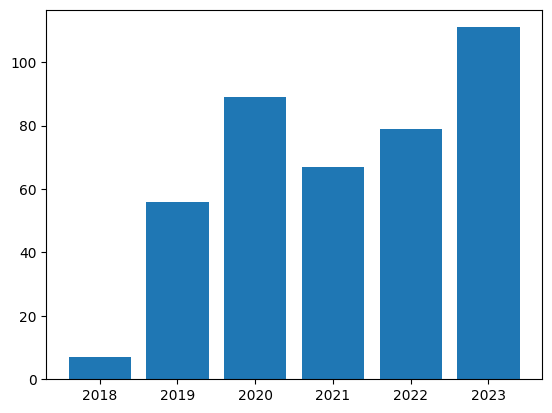

Arian Soltani
[2021, 2022, 2023]


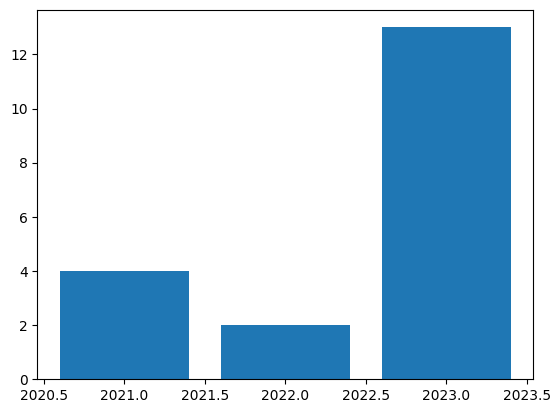

Dongpu Cao
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


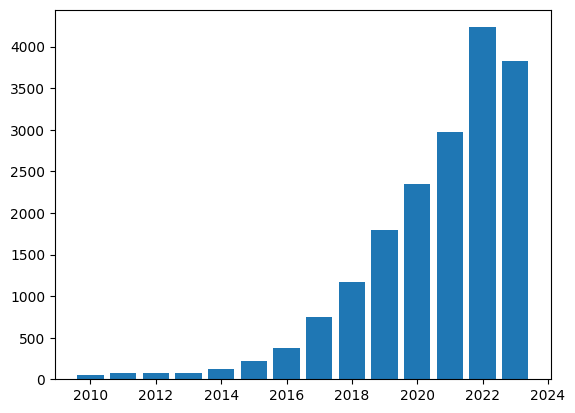

Jeremy S. Smith
[1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


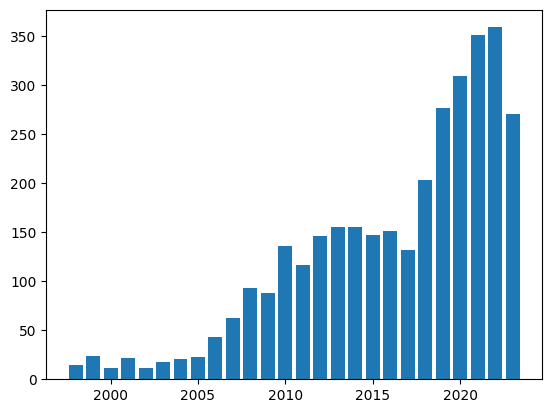

Peng Liu
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


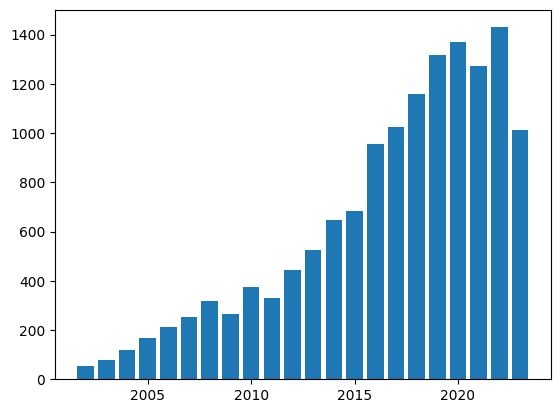

Yarkin Gevez
[2021, 2022, 2023]


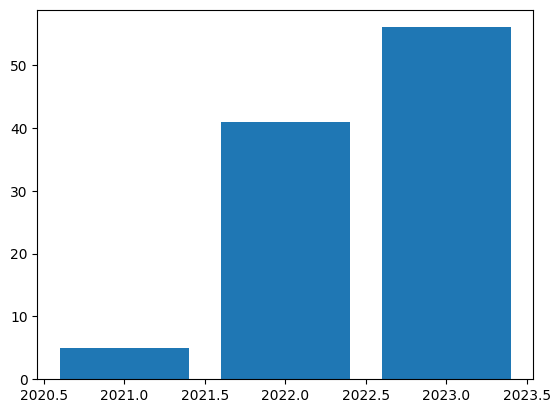

Payam Azad
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


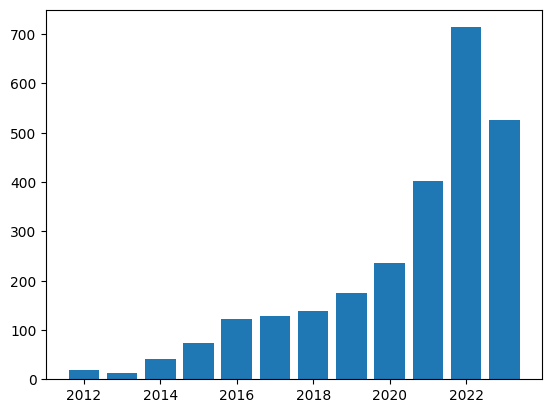

Xavier Hinaut
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


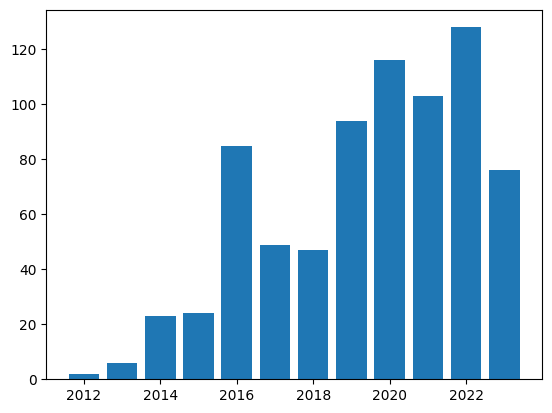

Mohammad Mahmudur Rahman Khan
[2018, 2019, 2020, 2021, 2022, 2023]


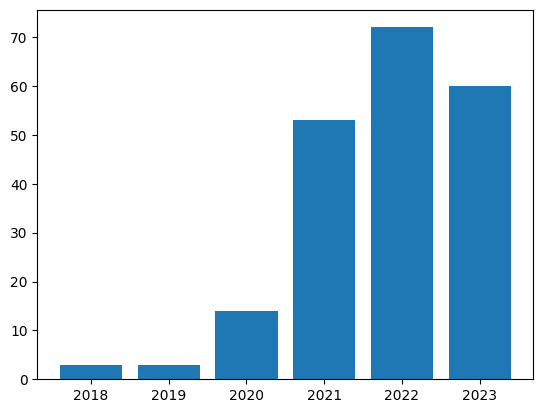

Paweł Ksieniewicz
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


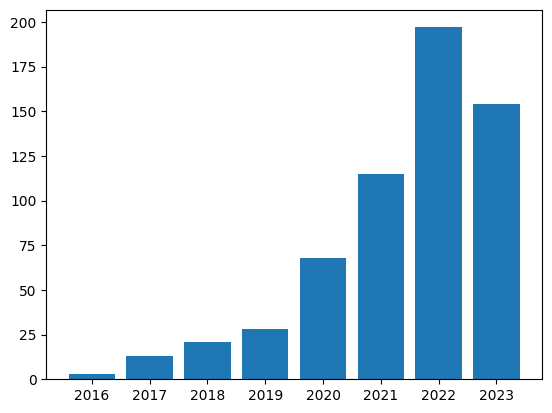

Yufei Li
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


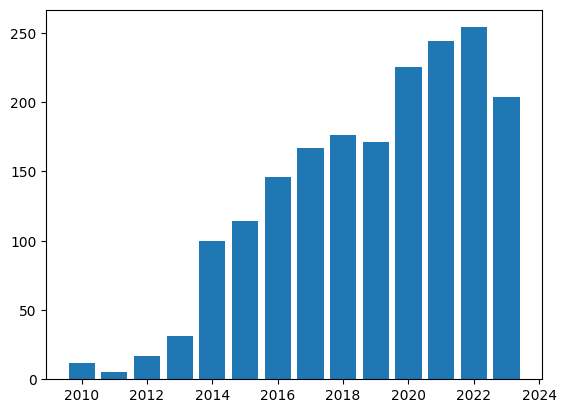

Kaiwen Zha
[2018, 2019, 2020, 2021, 2022, 2023]


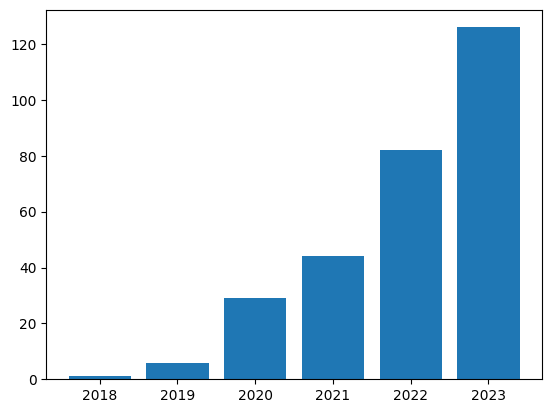

Pei Wang
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


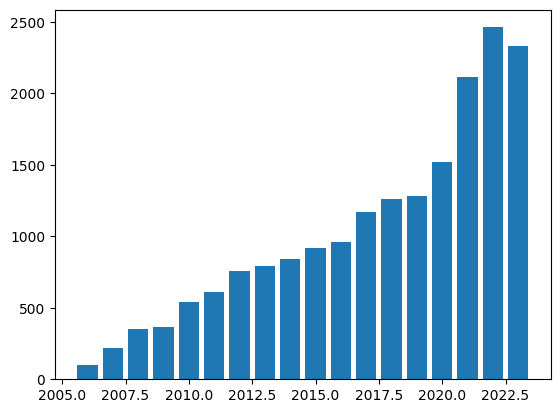

Andreas Kamilaris
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


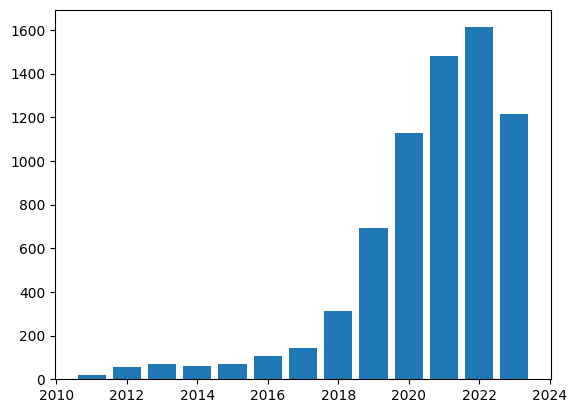

Qinyu Chen
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


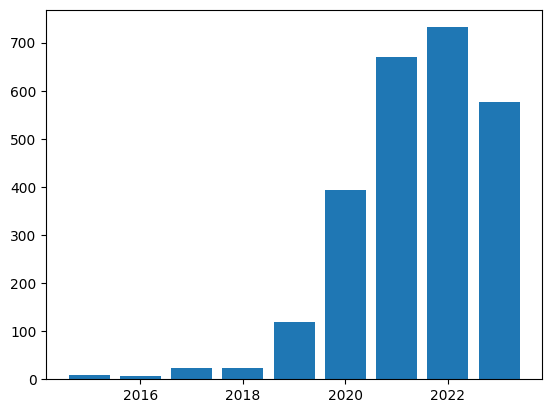

Jaydip Sen
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


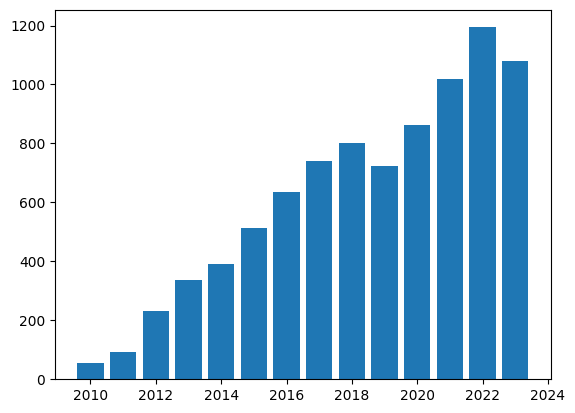

Xiaochun Cao
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


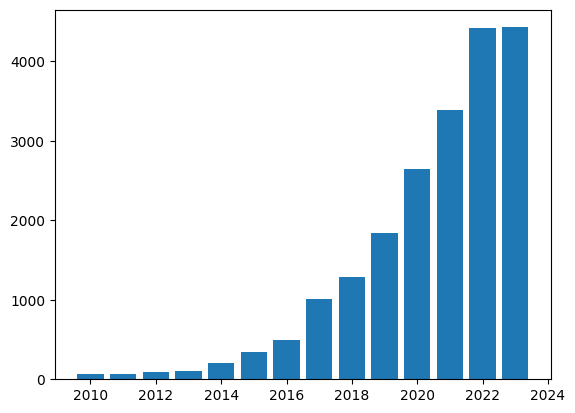

Jean-Michel Morel
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


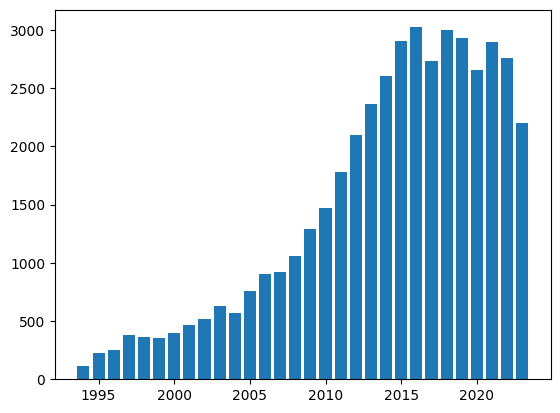

Guang Yang
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


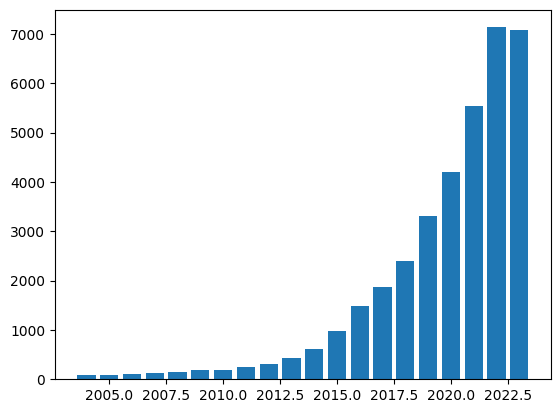

Sadiq Hussain
[1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


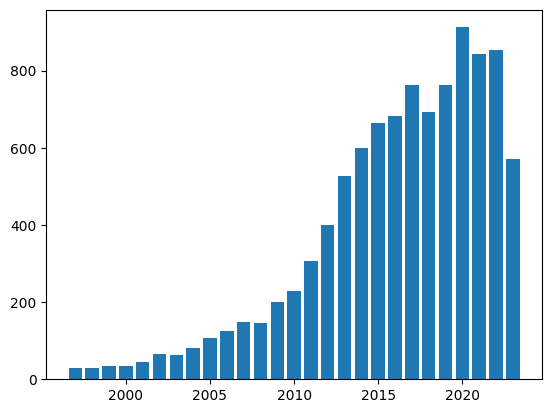

Guangyao Chen
[2020, 2021, 2022, 2023]


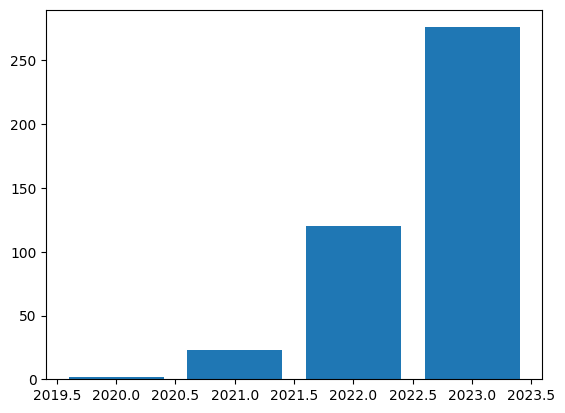

Adrian Muscat
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


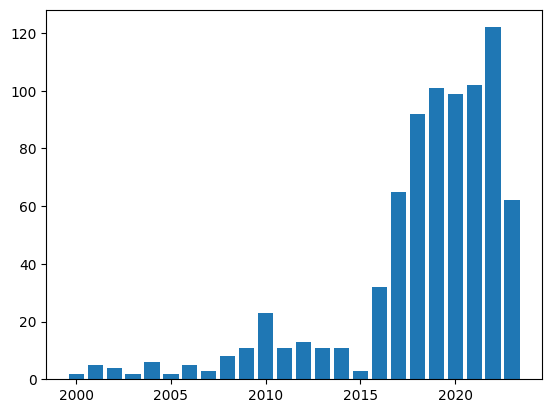

Jacopo Teneggi
[2021, 2022, 2023]


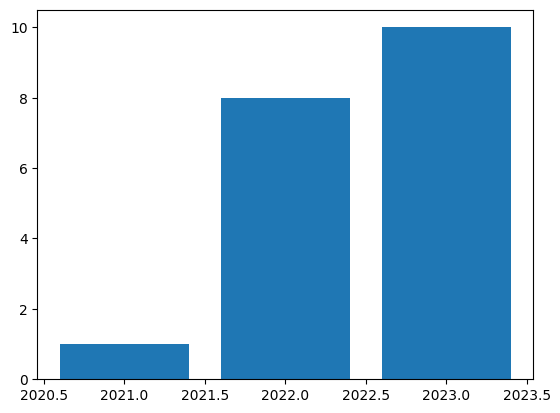

Alexander Toshev
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


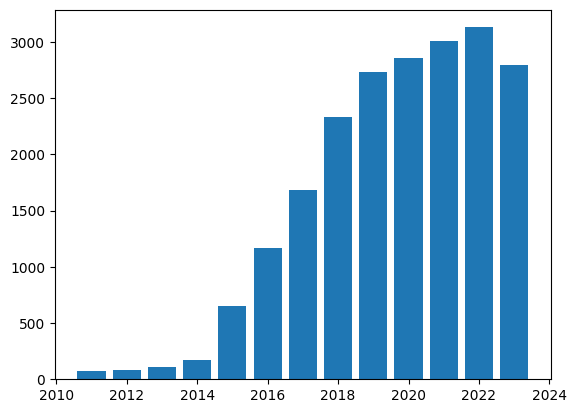

Vincenzo Riccio
[2018, 2019, 2020, 2021, 2022, 2023]


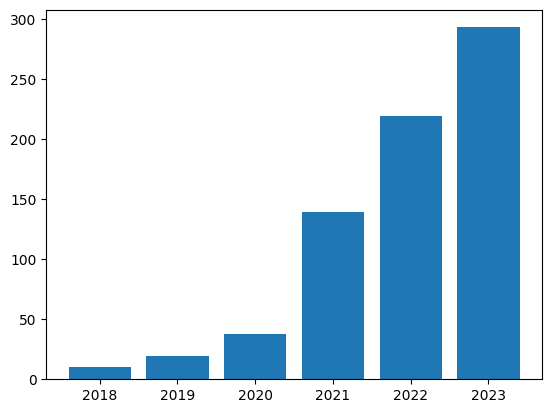

Pierre-Alain Muller
[1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


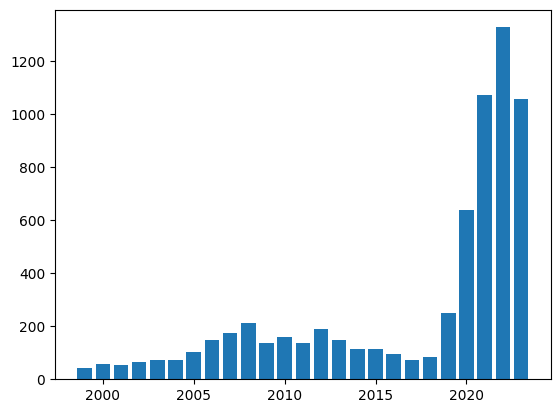

Ekaterina Artemova
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


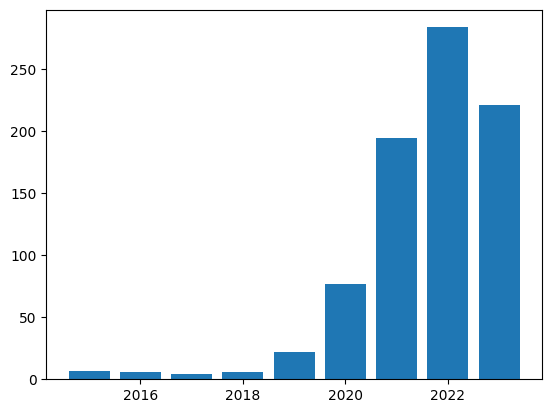

Dantong Yu
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


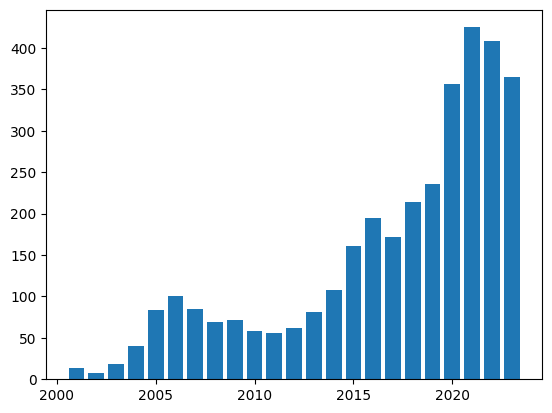

Abdelrahman Mohamed
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


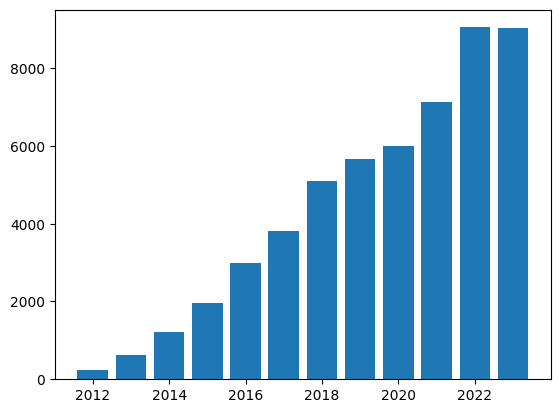

Mohamed R. Ibrahim
[1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


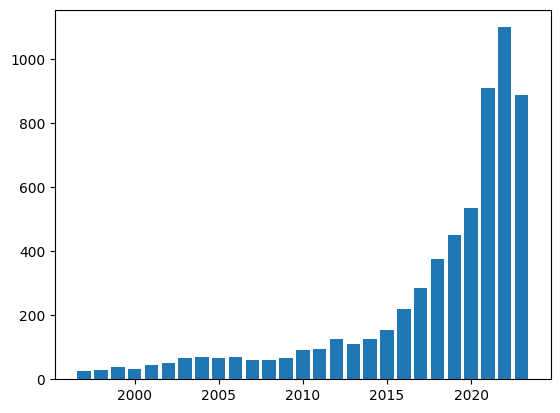

Alessandro Calefati
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


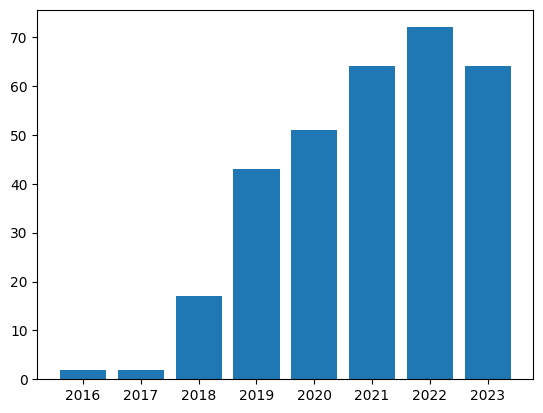

Anil Kumar Singh
[1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


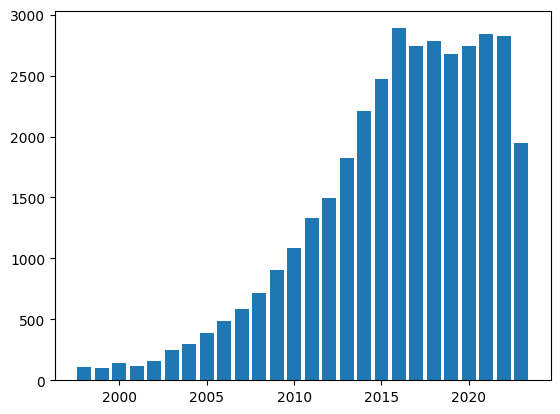

Ismini Lourentzou
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


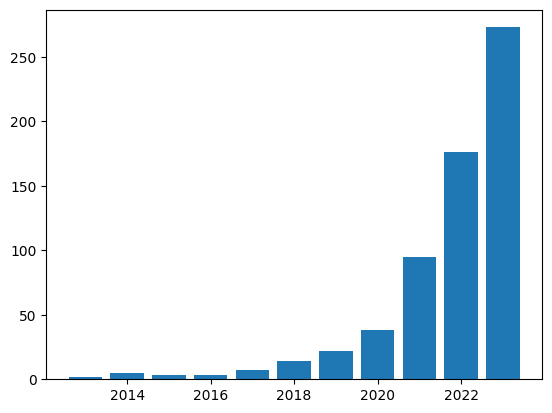

Xiao-Yong Wei
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


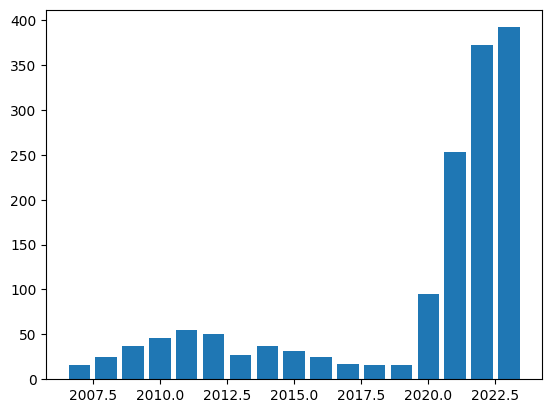

Rajiv Raman
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


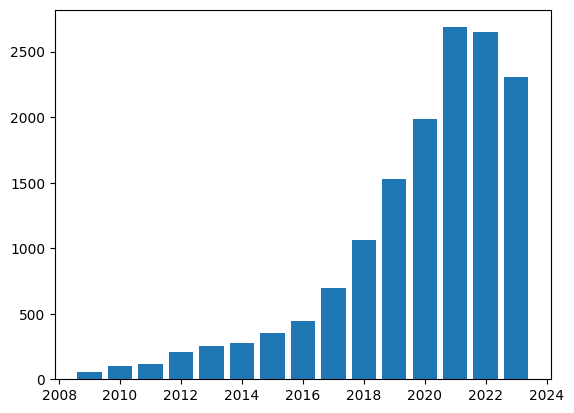

Qiang Liu
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


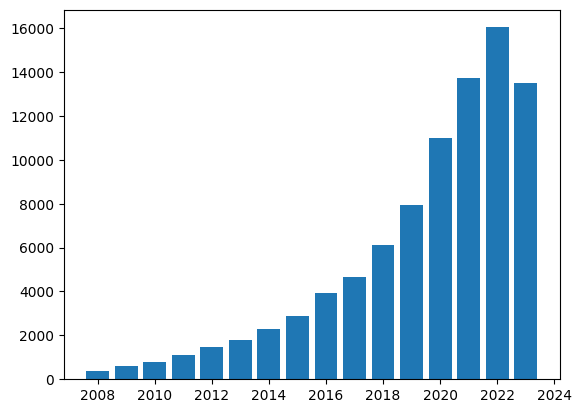

Leon Weninger
[2019, 2020, 2021, 2022, 2023]


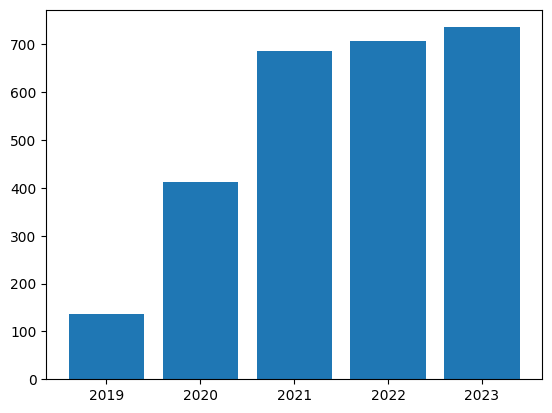

Jovan Kalajdjieski
[2020, 2021, 2022, 2023]


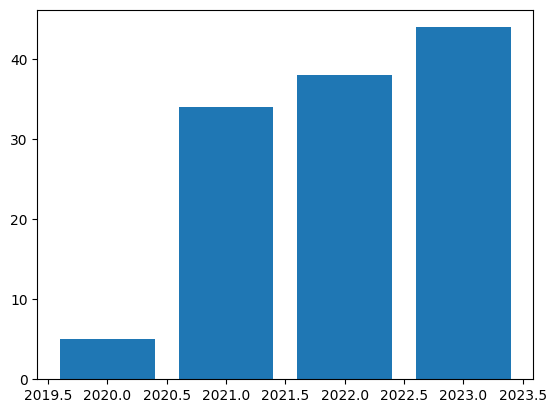

Chengxi Ye
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


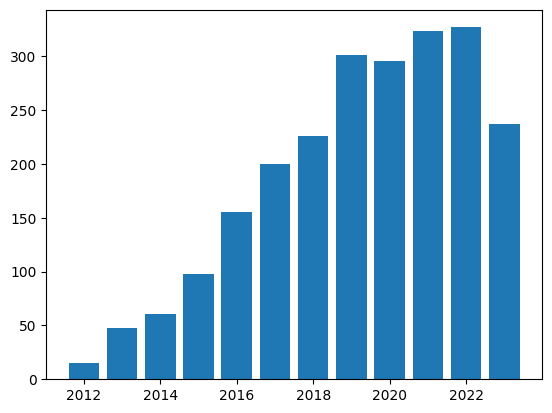

Bhiksha Raj
[1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


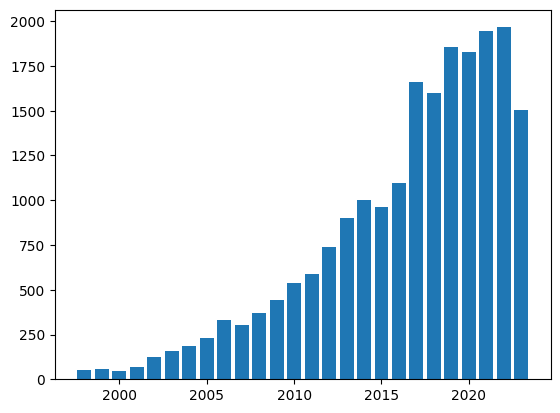

Kidiyo Kpalma
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


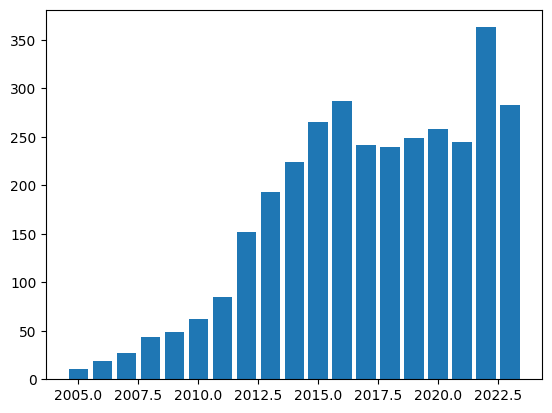

Ivan Rubachev
[2021, 2022, 2023]


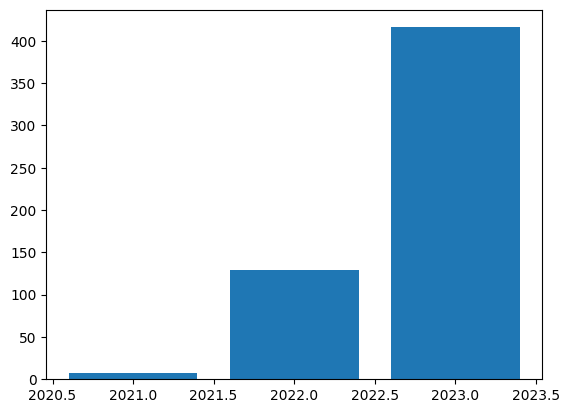

Mei Ming
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


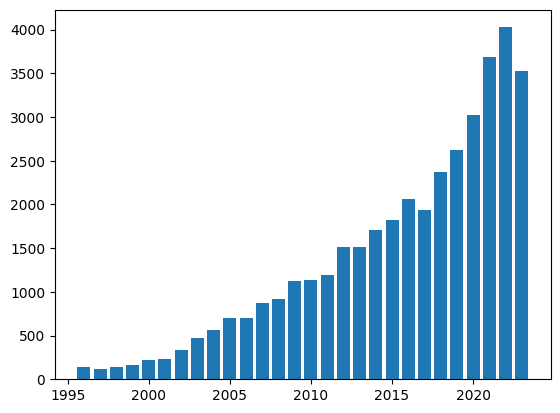

William Yang Wang
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


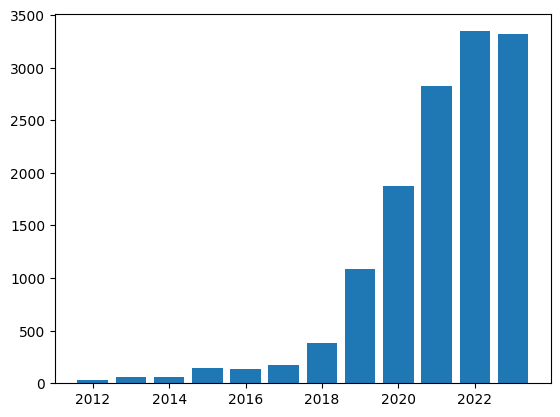

Ekraam Sabir
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


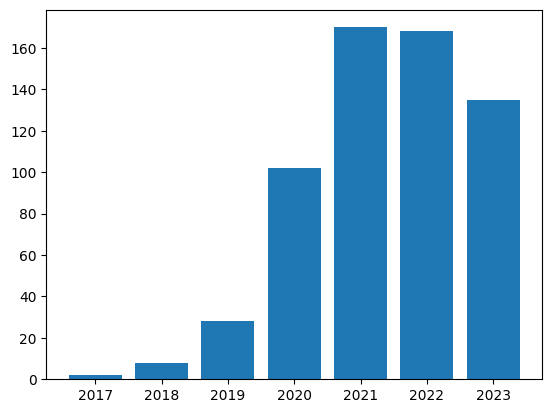

Siddharth Samsi
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


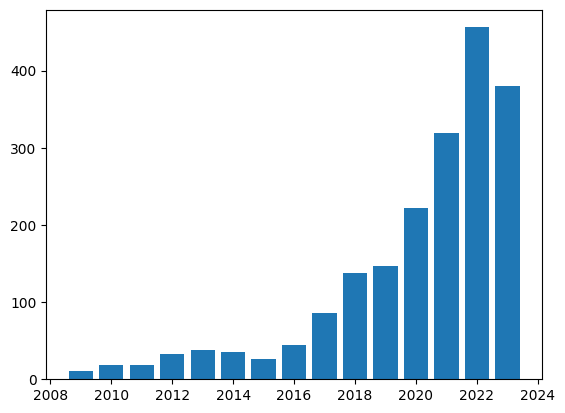

Brian DeCost
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


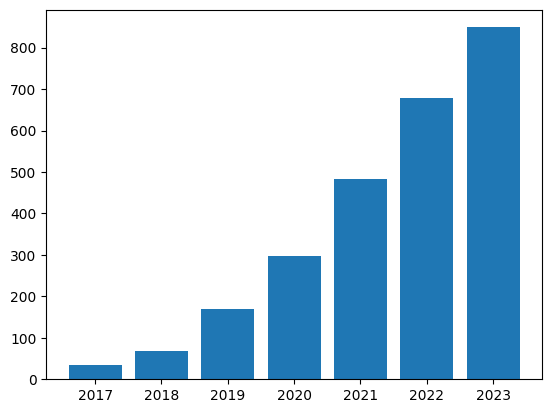

Mao Yang
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


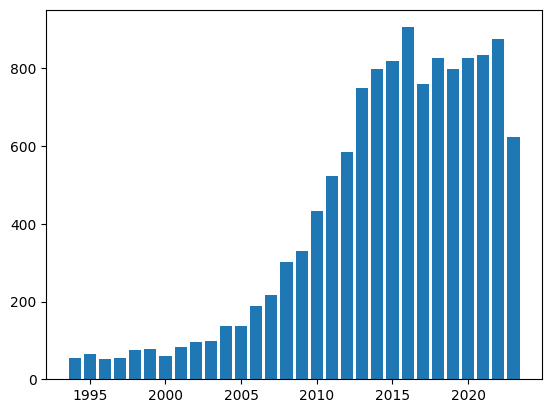

Nick Erickson
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


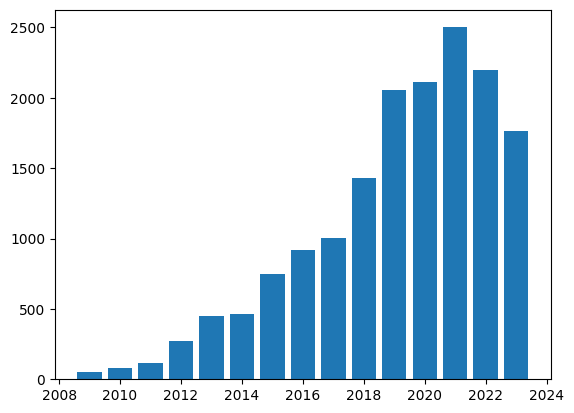

Zhen Lei
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


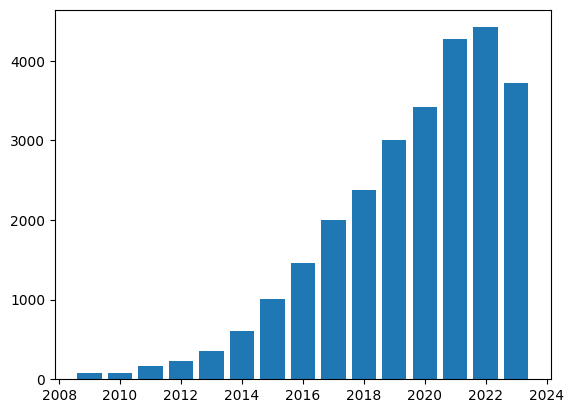

Nkechinyere N. Agu
[2018, 2019, 2020, 2021, 2022, 2023]


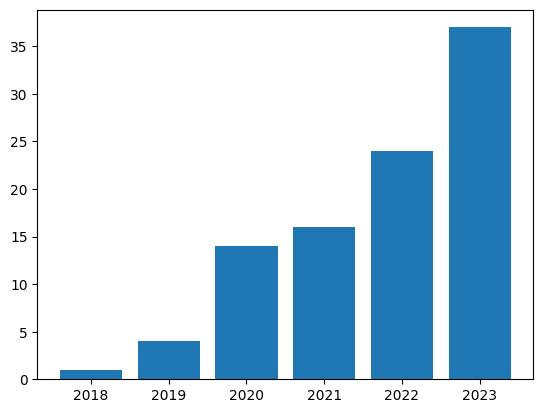

Taiji Suzuki
[1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


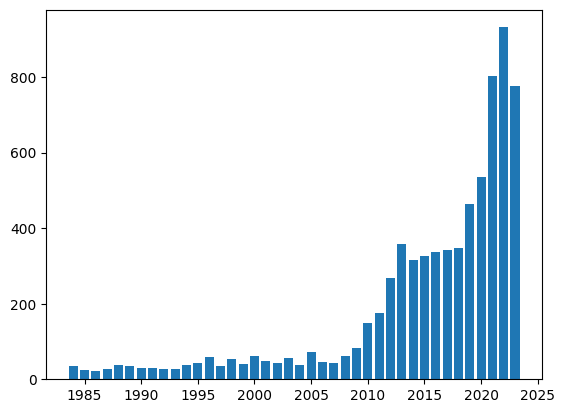

Chase Zimmerman
[2020, 2021, 2022, 2023]


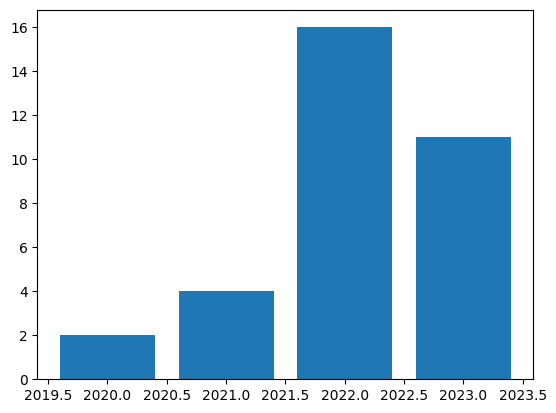

Zhuoran Liu
[2018, 2019, 2020, 2021, 2022, 2023]


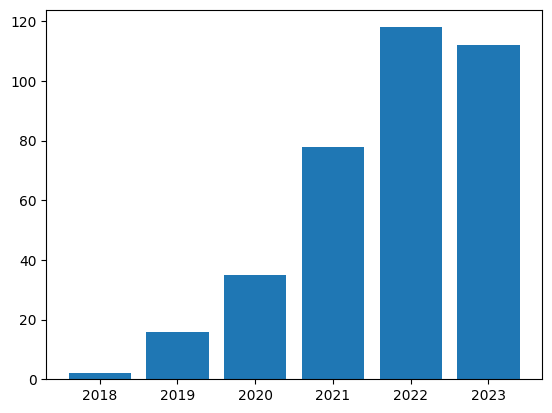

Gui-Song Xia
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


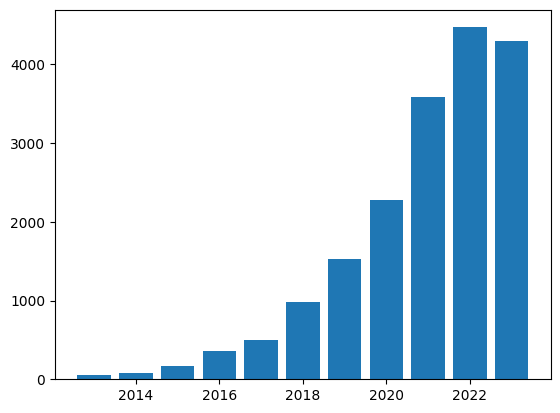

Oliver Bensch
[2022, 2023]


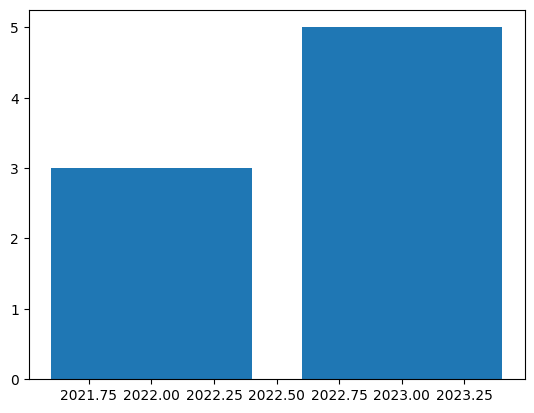

Pooja Kherwa
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


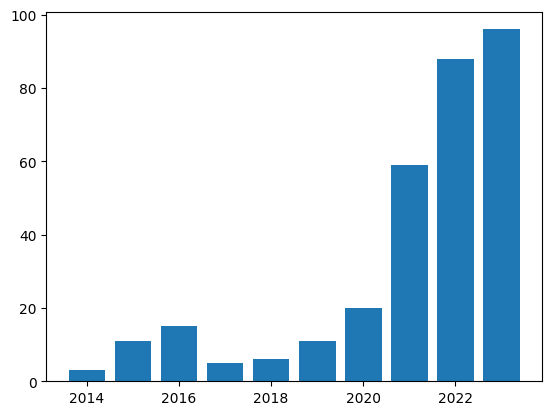

Ngan Le
[1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


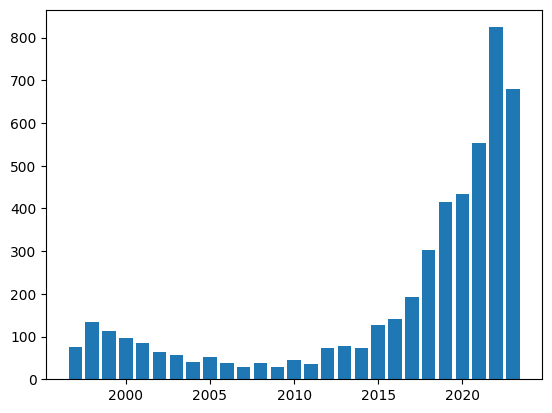

Goutham Ramakrishnan
[2019, 2020, 2021, 2022, 2023]


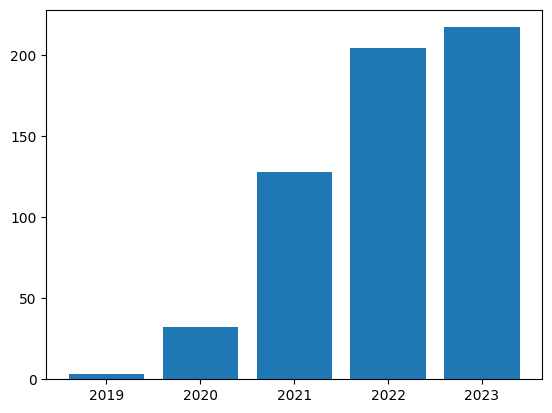

Zhaofan Qiu
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


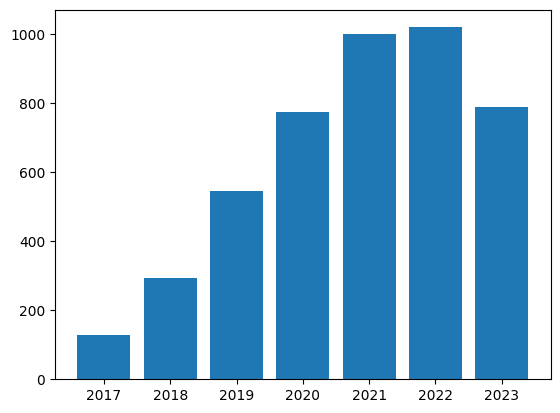

Hamish Ivison
[2022, 2023]


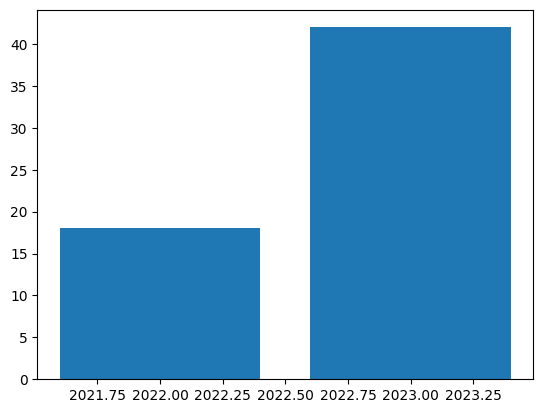

Yinghui Xu
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


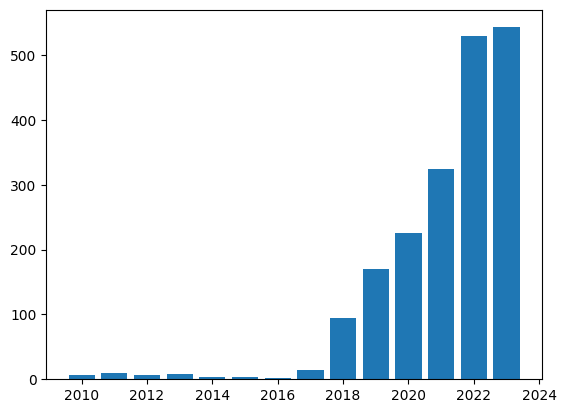

Fabian Hornung
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


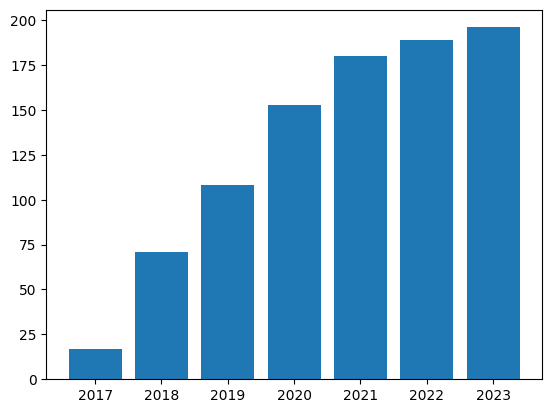

Ezgi Yıldırım
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


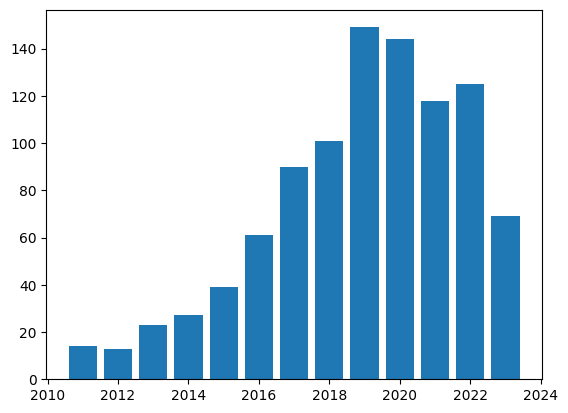

Geraldine Morin
[1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


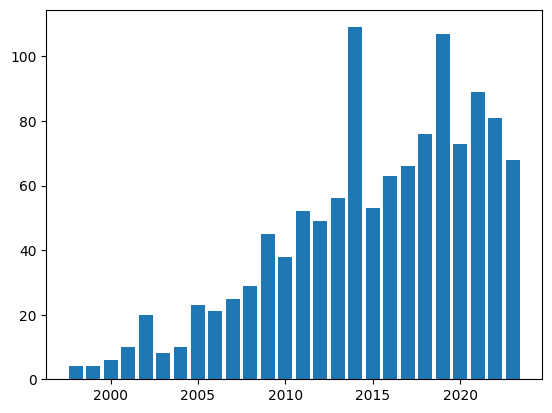

Xiangnan He
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


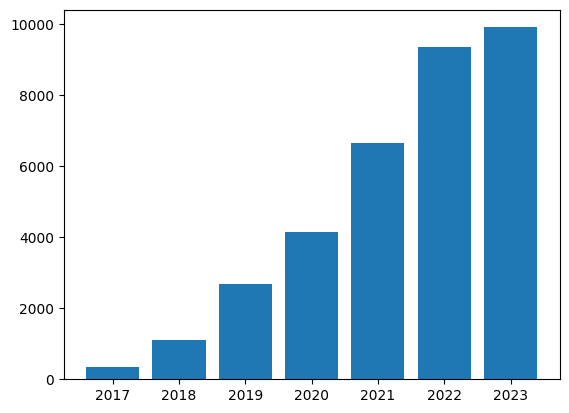

Zengchang Qin
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


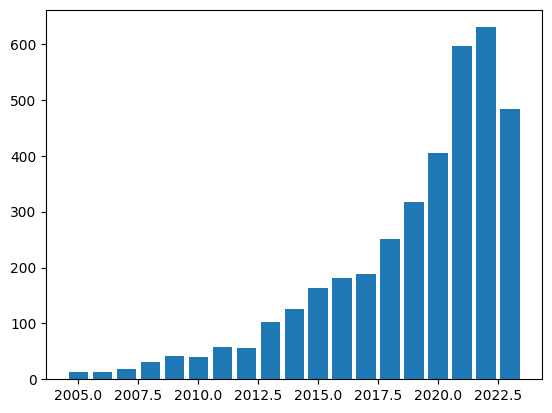

Tristan Naumann
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


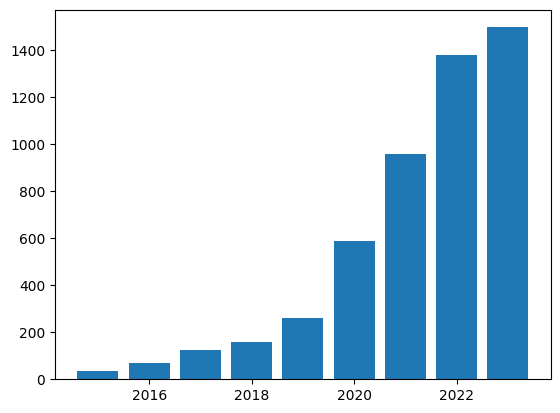

Sarwar Khan
[1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


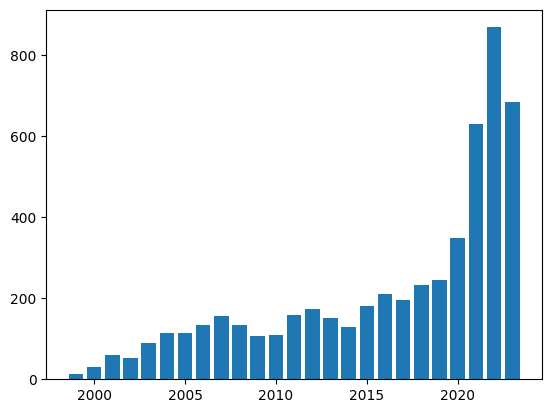

Marisa Kirisame
[2018, 2019, 2020, 2021, 2022, 2023]


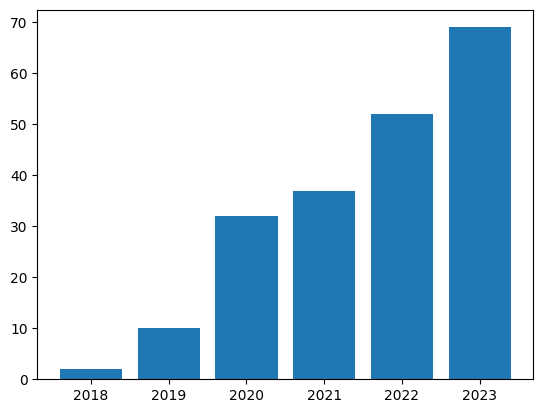

Eleni Vasilaki
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


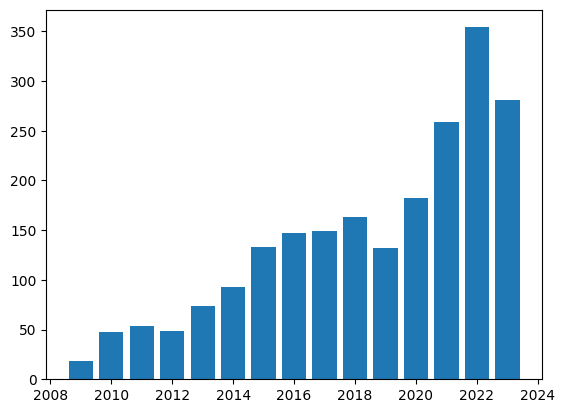

Hui Lin
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


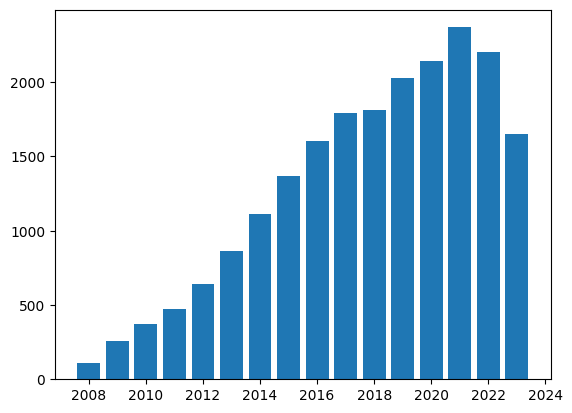

Ayush Singhal
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


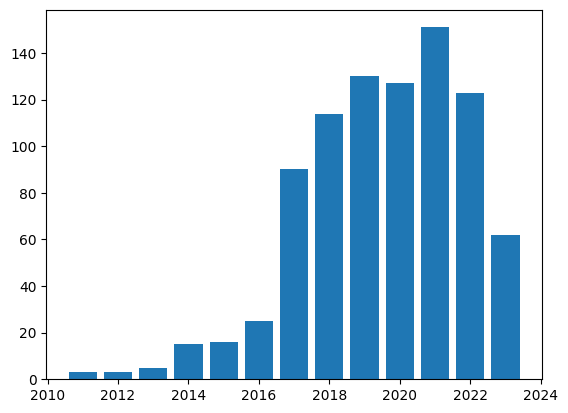

Ginés García
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


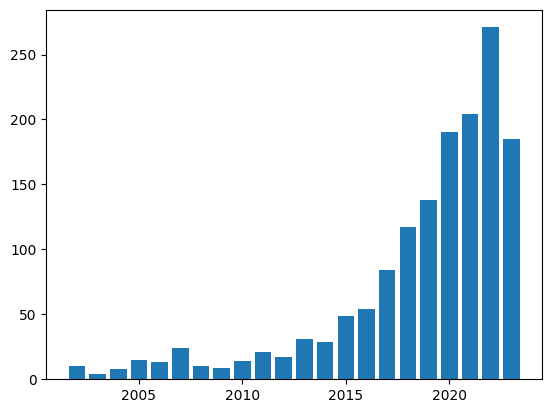

Junyuan Xie
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


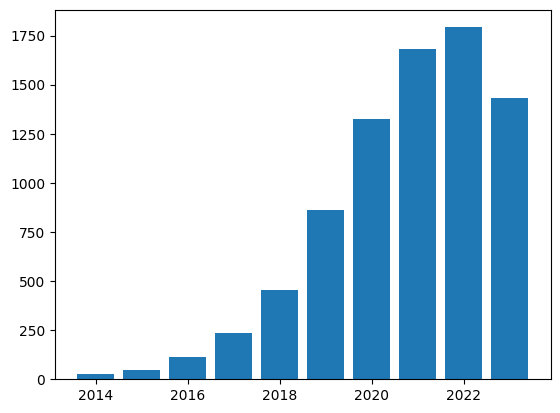

Jeffrey Soar
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


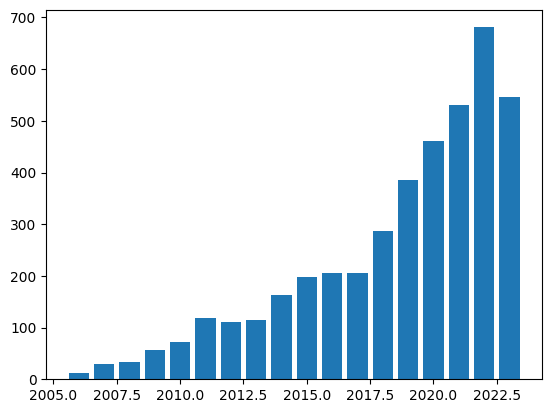

Şükrü Ozan
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


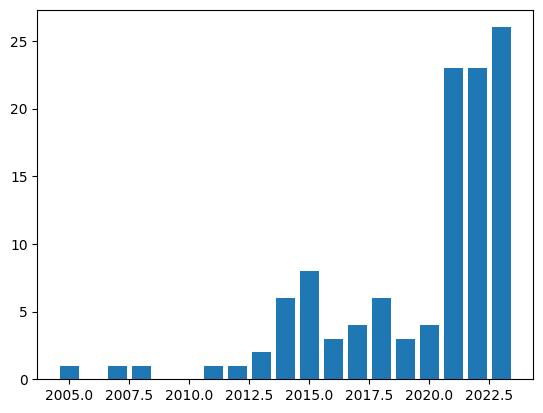

Christian Hardmeier
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


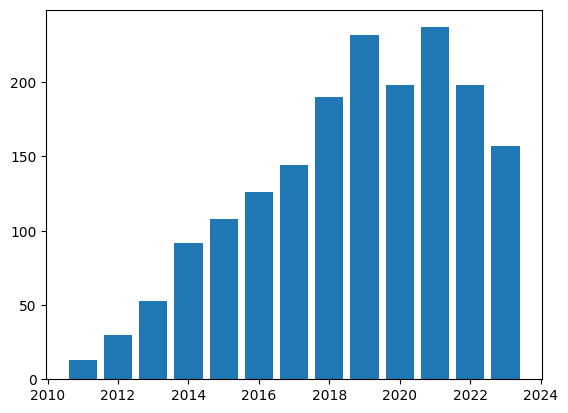

Rashid Khan
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


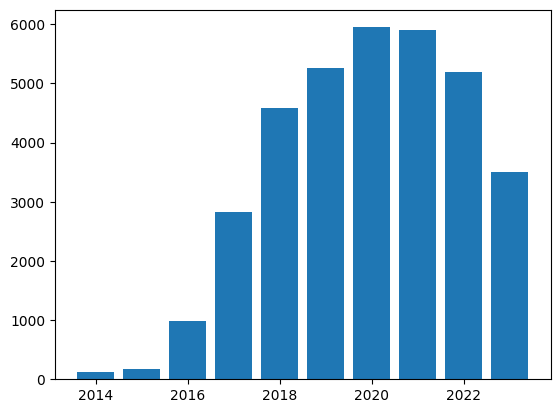

sule gunduz oguducu
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


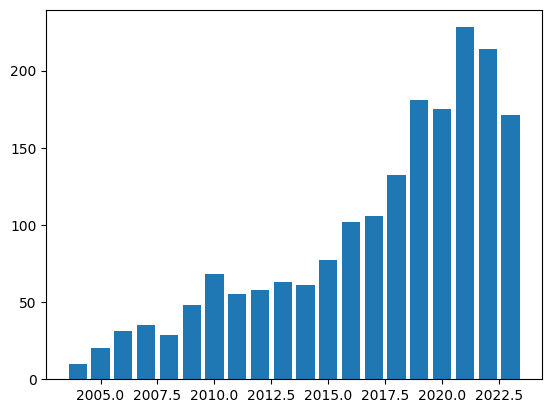

Xiaosen Wang
[2019, 2020, 2021, 2022, 2023]


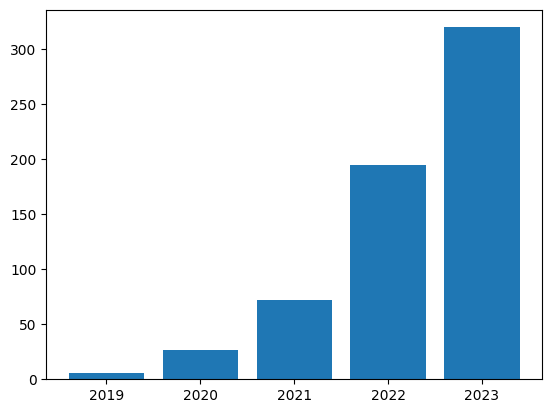

Fabio Massimo Zanzotto
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


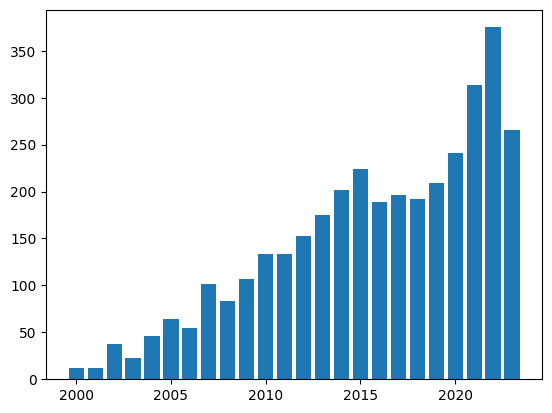

Yi Qin Gao
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


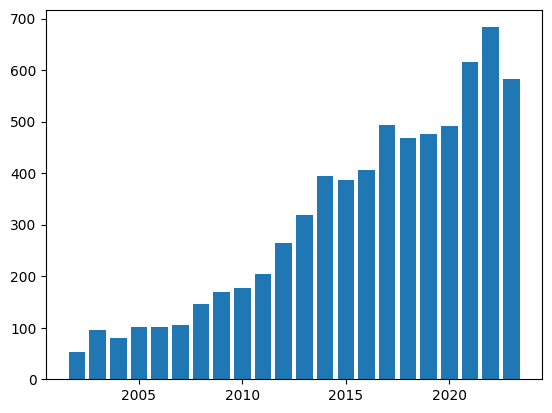

jipeng qiang
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


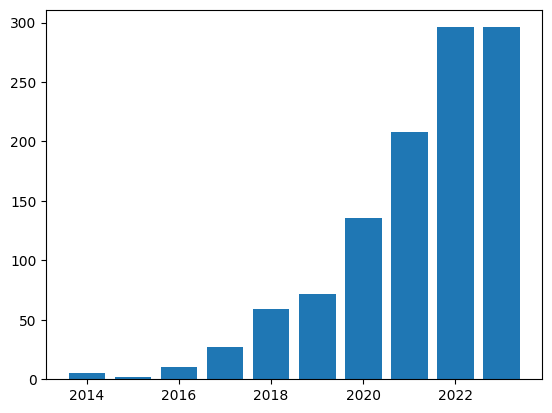

Jon Azpiazu
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


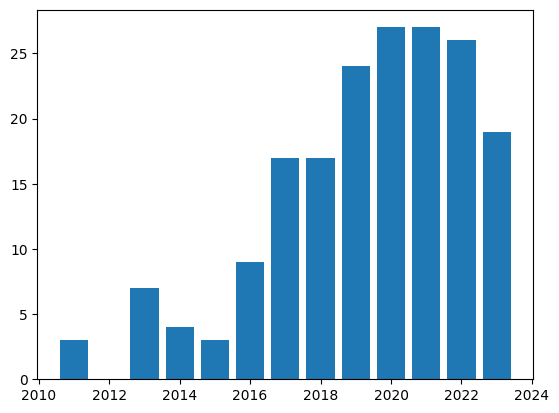

Luo Mai
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


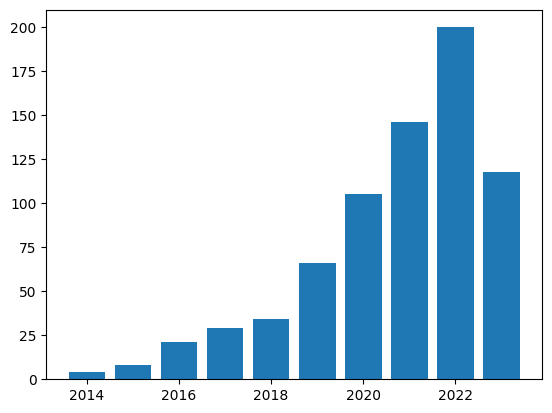

Durgesh Nandini
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


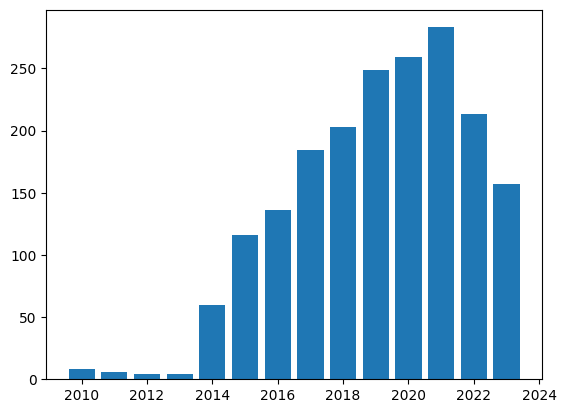

Mohamed Abdalla
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


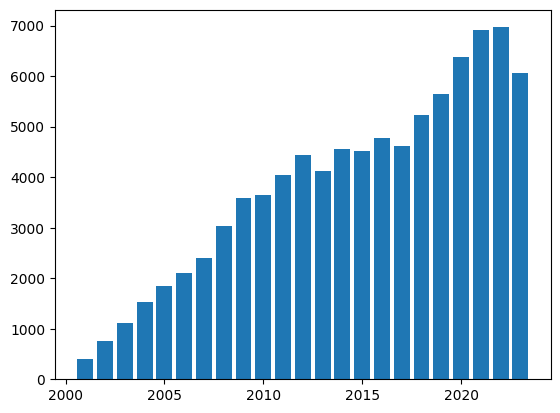

Zibo Yi
[2018, 2019, 2020, 2021, 2022, 2023]


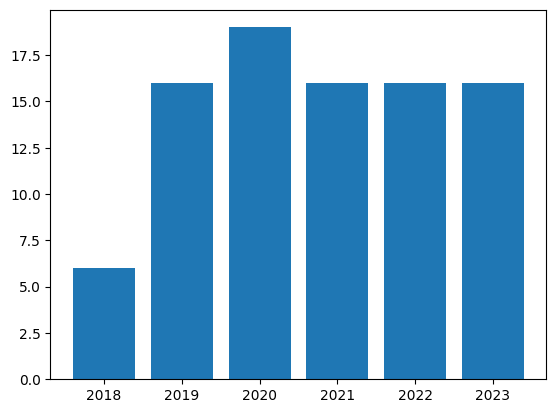

Debi Prosad Dogra
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


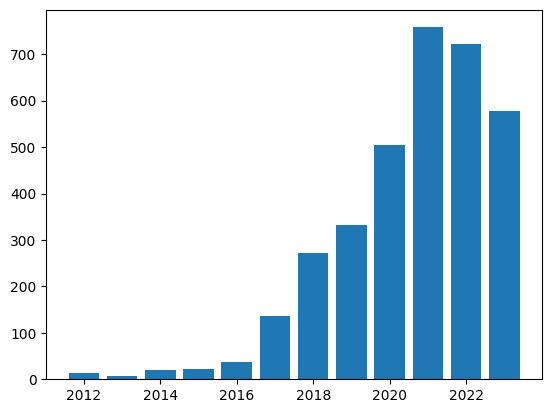

Yingli Tian
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


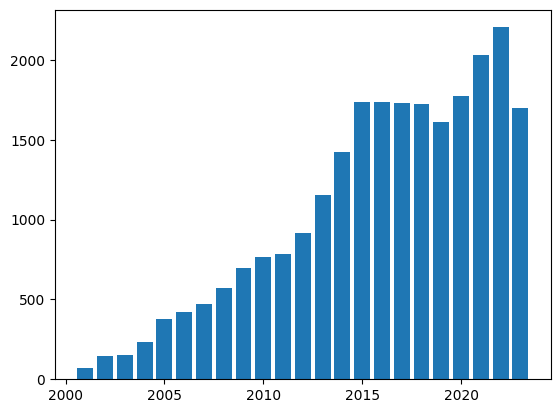

Ufuk Altun
[2018, 2019, 2020, 2021, 2022, 2023]


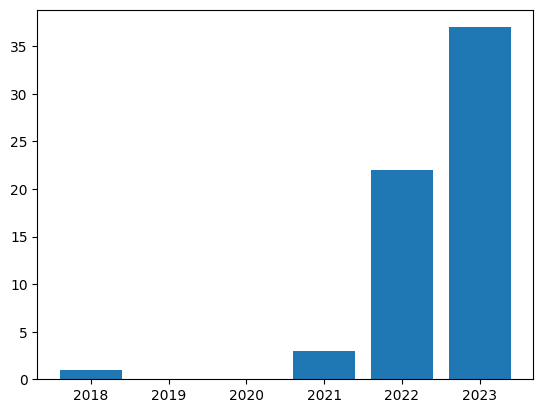

Yufei Wang
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


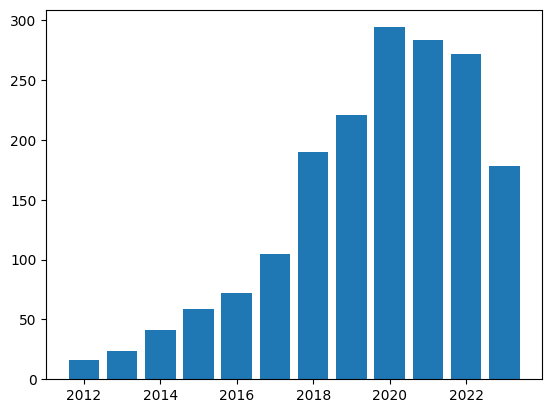

Yann LeCun
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


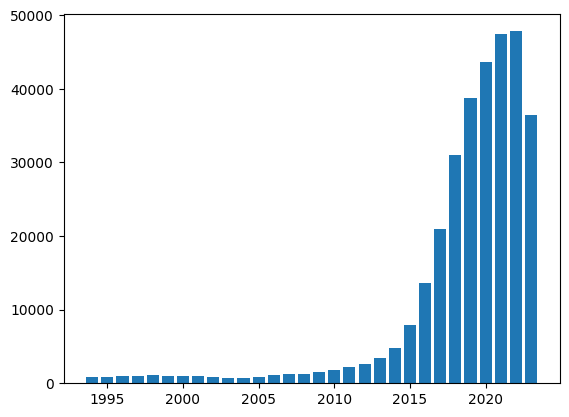

Paul H. Yi
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


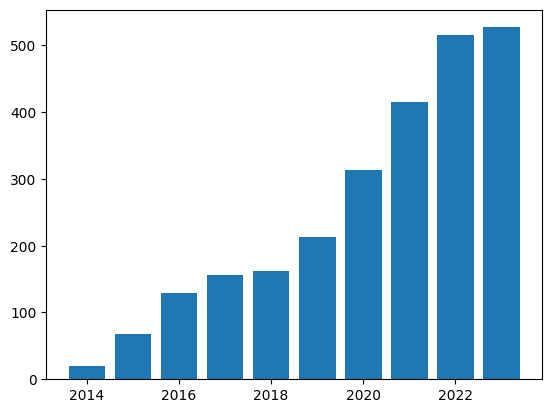

Vinayakumar R
[1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


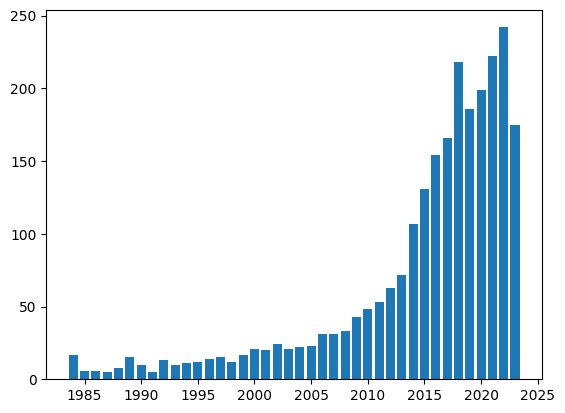

Mehdi Rezagholizadeh
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


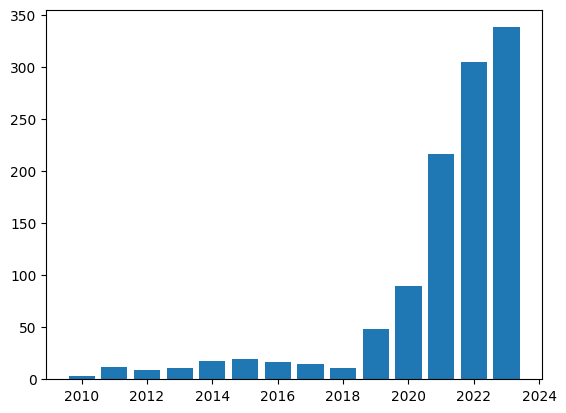

Bei Zhou
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


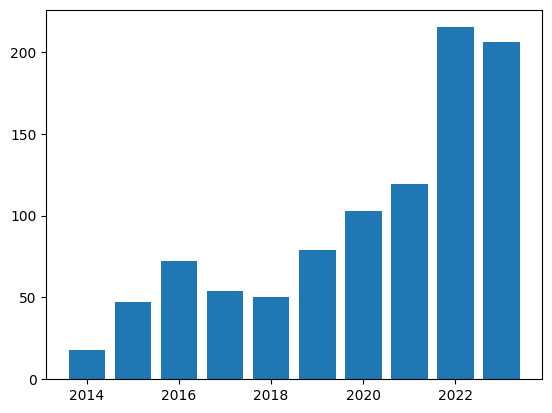

Mahjabin Rahman Oishe
[2018, 2019, 2020, 2021, 2022, 2023]


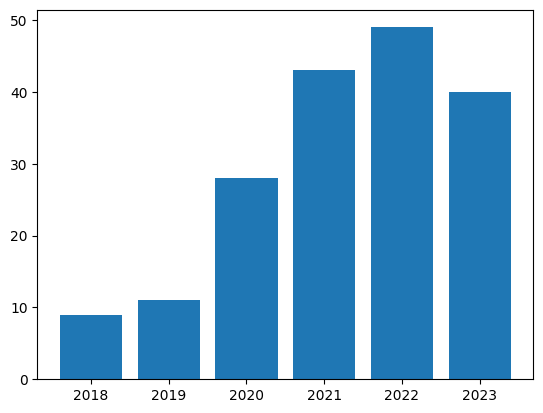

Chao Xue
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


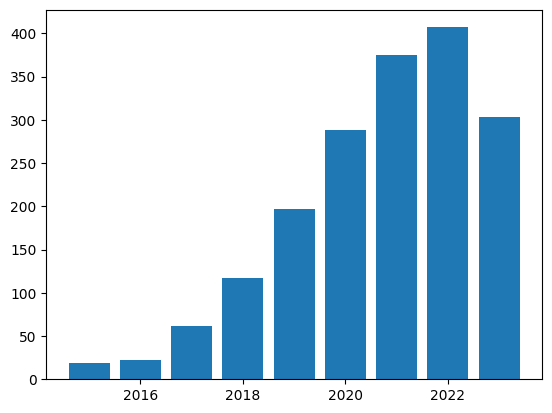

Thomas Brettin
[1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


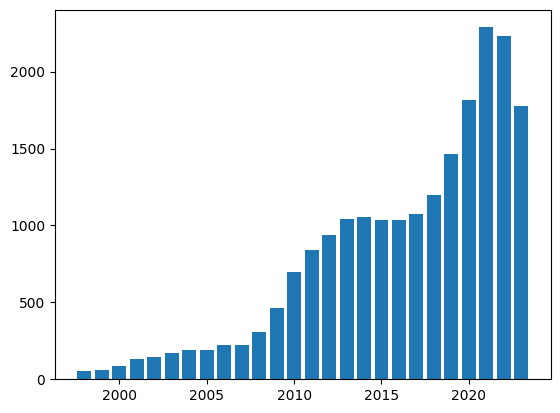

Mingyi He
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


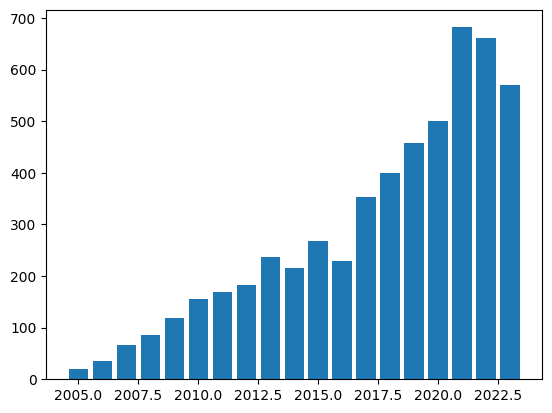

Devinder Kumar
[1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


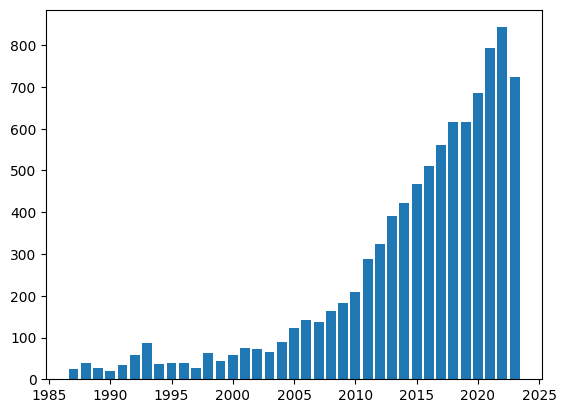

Faiza Memood
[2020, 2021, 2022, 2023]


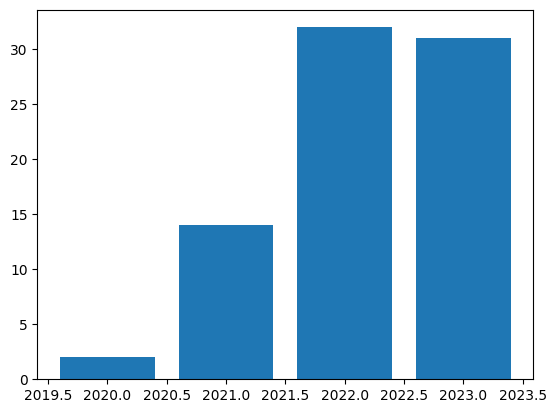

Arvid Lundervold
[1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


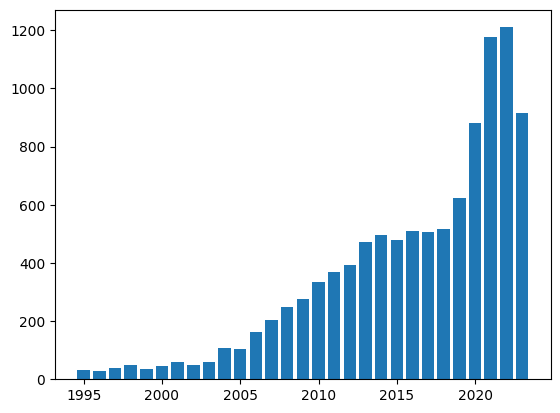

Leila Wehbe
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


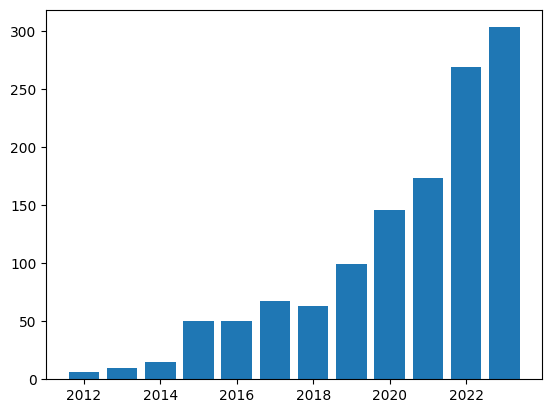

Joey Huchette
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


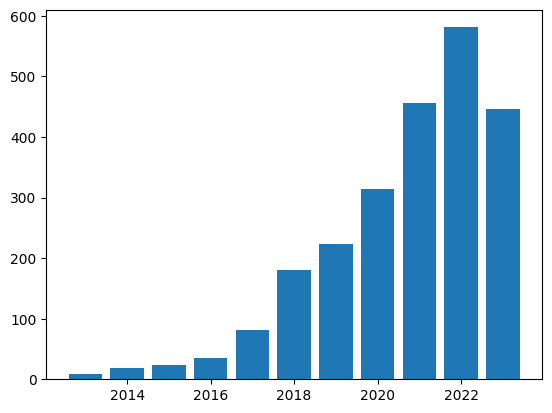

Meisam Razaviyayn
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


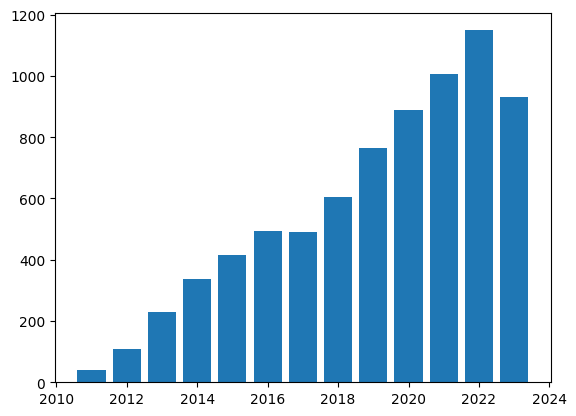

Rufai Yusuf Zakari
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


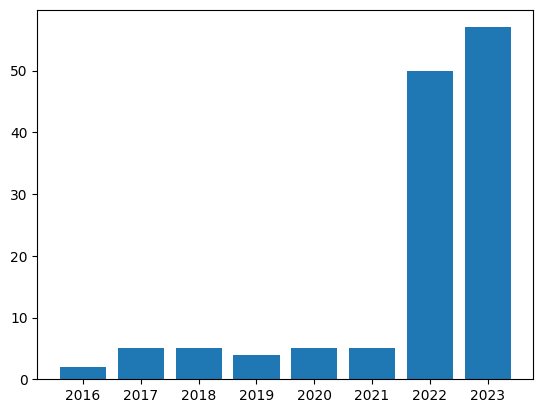

Safeen Huda
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


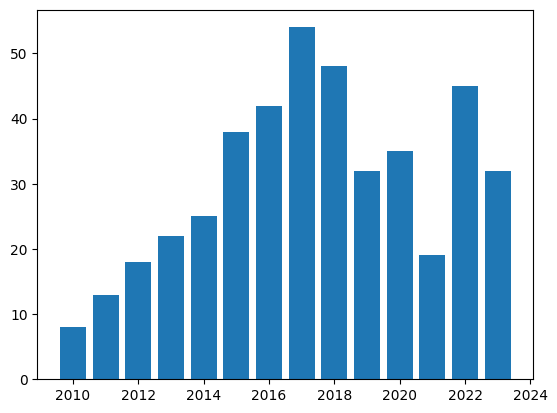

Mohammed Abuhamad
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


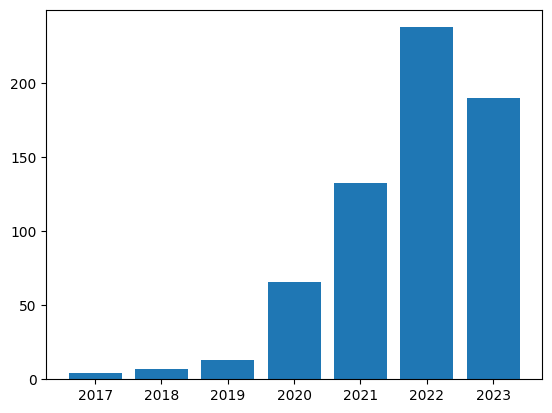

Damien Teney
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


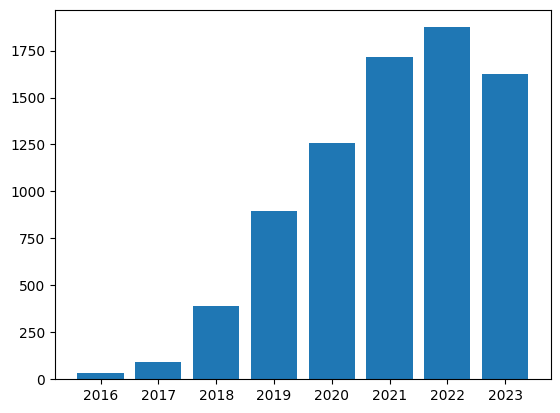

Matthieu Mallejac
[2020, 2021, 2022, 2023]


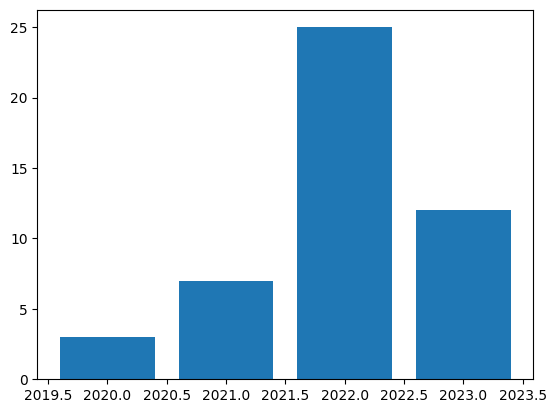

Saeed S. Alahmari
[2018, 2019, 2020, 2021, 2022, 2023]


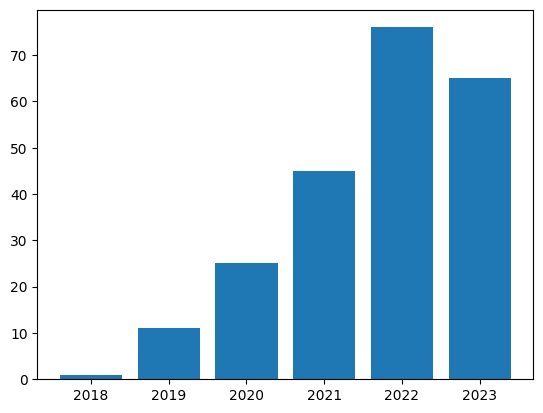

Lingxi Xie
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


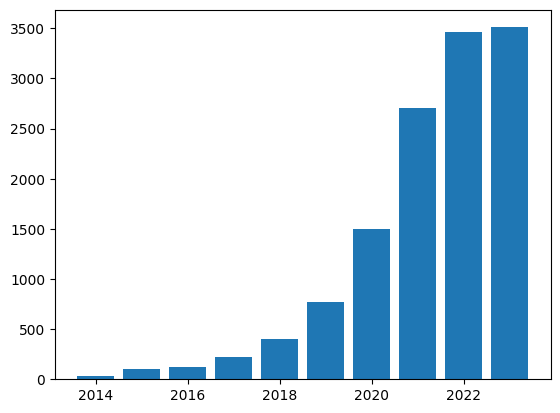

Meera Hahn
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


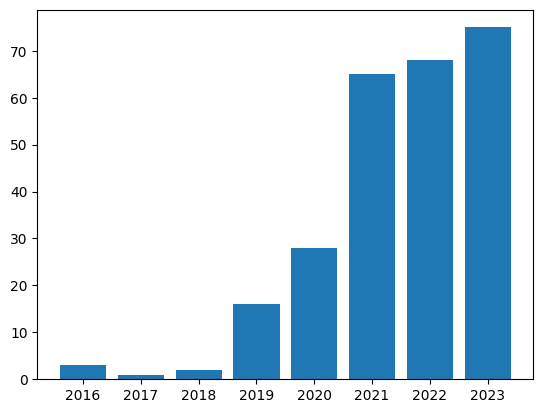

Qiang Wang
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


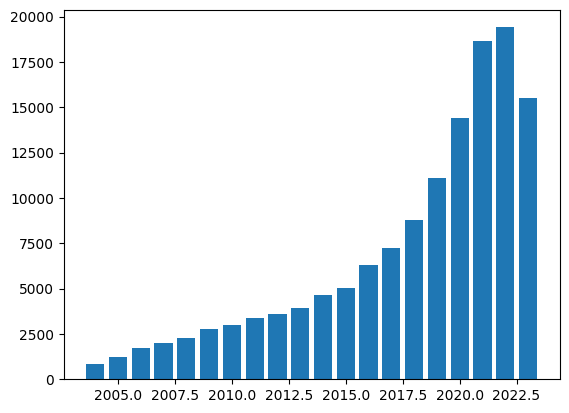

Christoph Berger
[1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


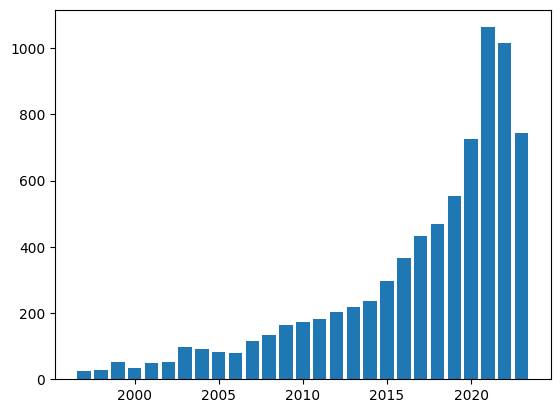

Yuxuan Lou
[2021, 2022, 2023]


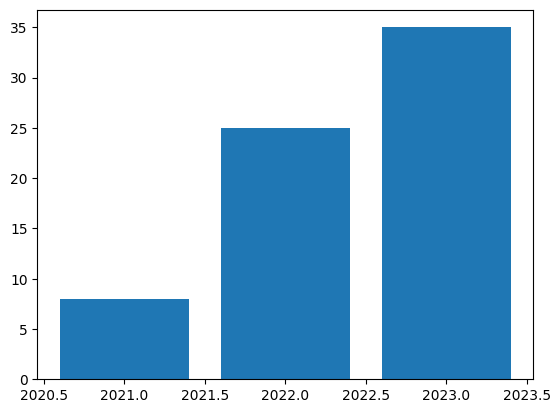

Fabio Narducci
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


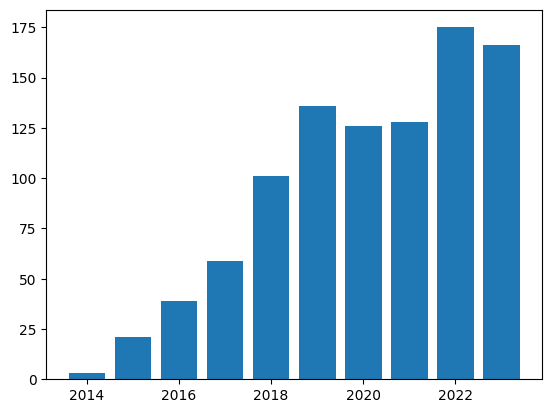

Sylvain Lobry
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


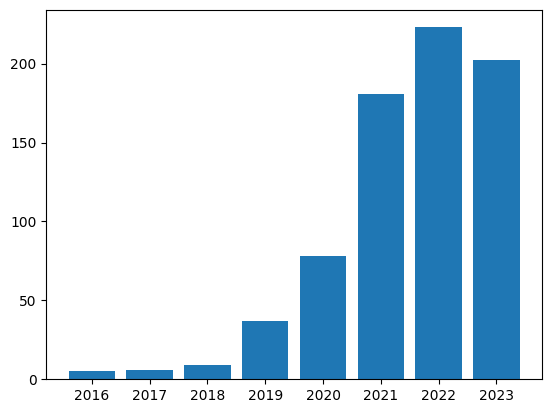

Yizhe Zhang
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


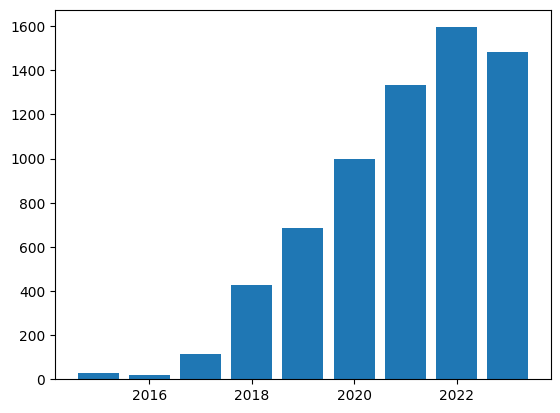

Philipp Zimmermann
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


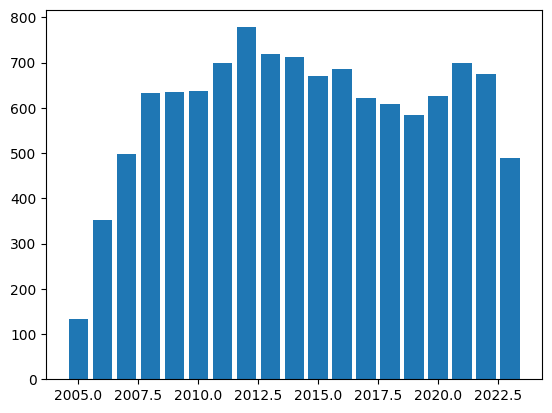

Zhipeng Cai
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


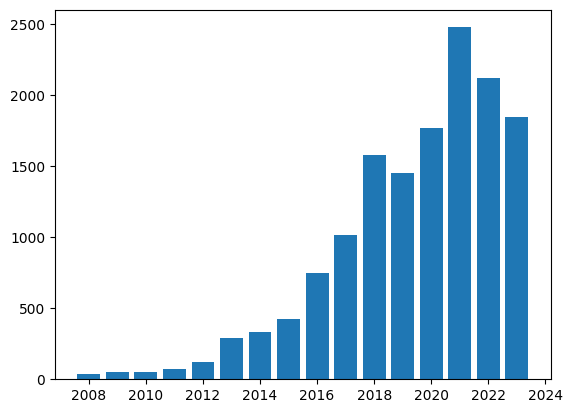

Elaina Tan
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


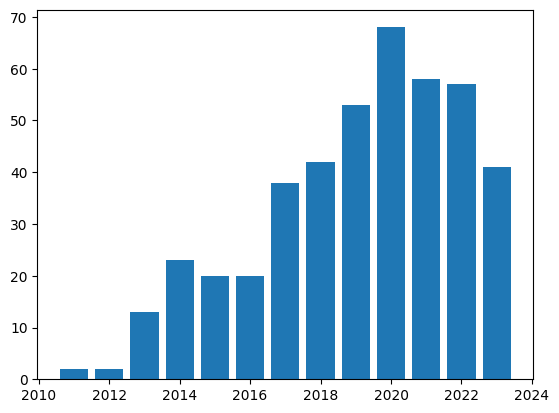

Zhan Shi
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


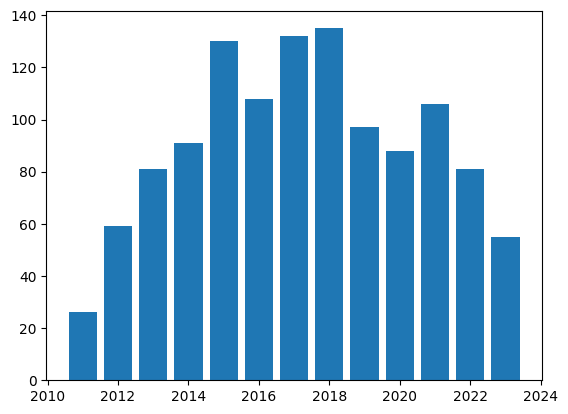

Keletso J. Letsholo
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


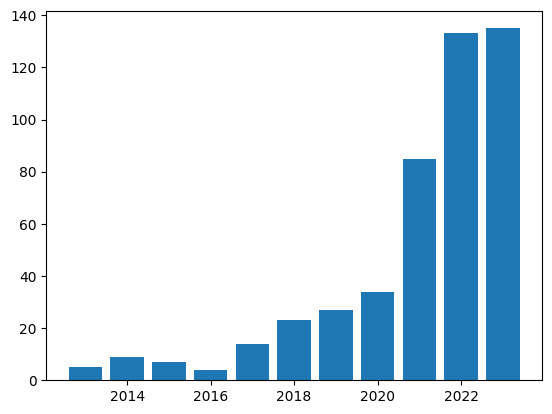

Simon Ott
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


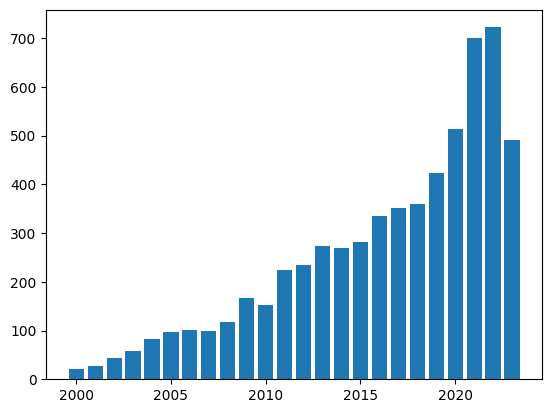

Jinjun Shan
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


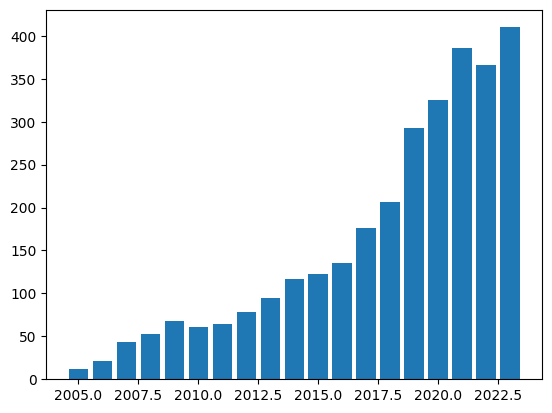

Aishan Liu
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


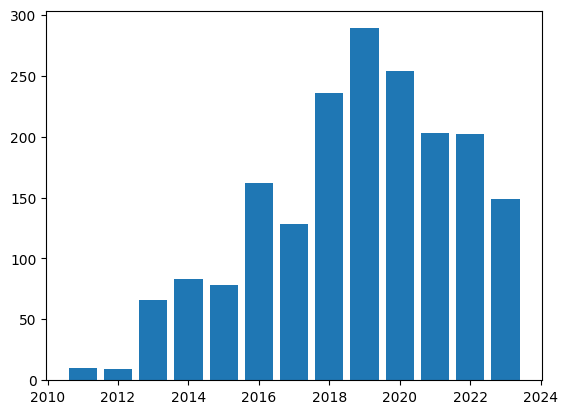

Vladimir Vincan
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


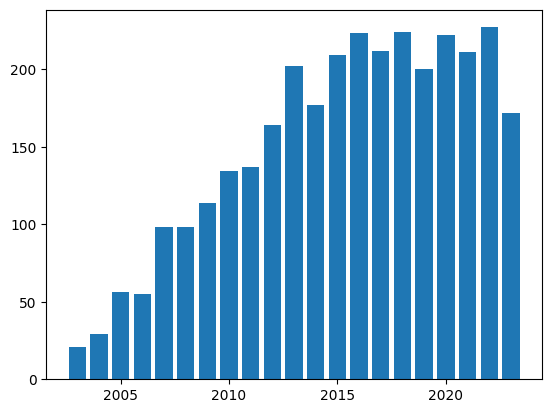

Aruna Balasubramanian
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


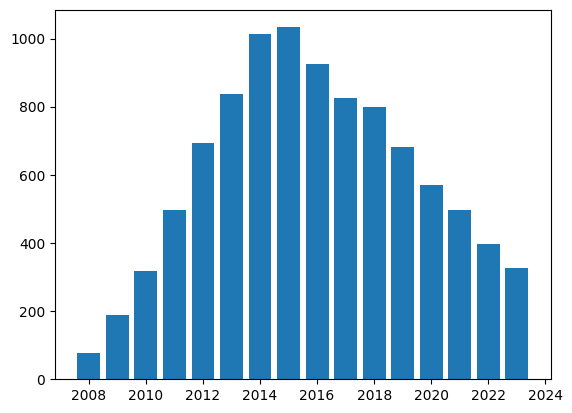

Kien Nguyen
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


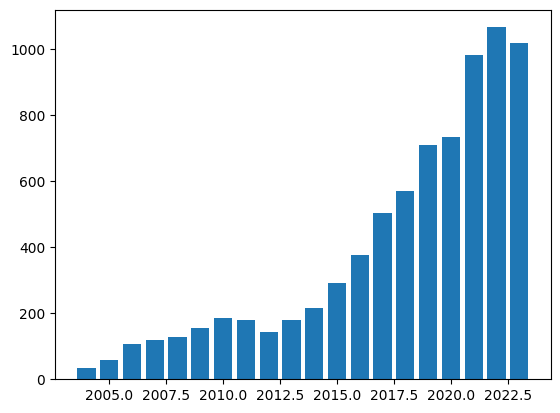

Lorenzo Ferrone
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


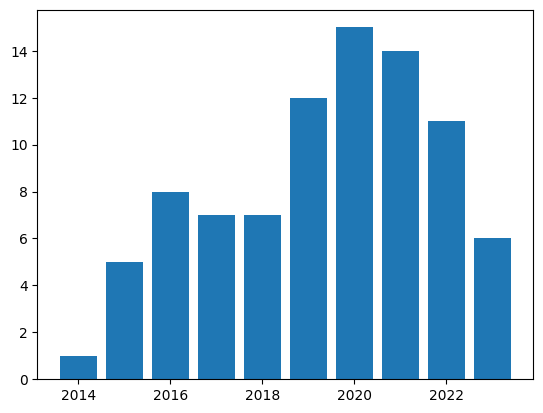

Zachary Nado
[2018, 2019, 2020, 2021, 2022, 2023]


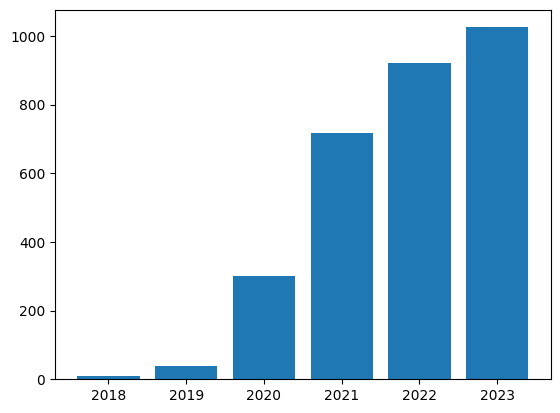

David Oniani
[2020, 2021, 2022, 2023]


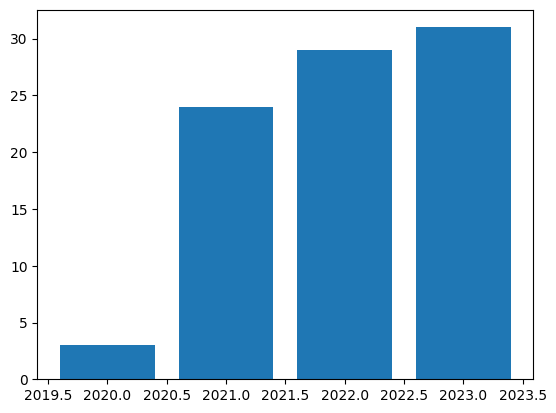

Navedanjum Ansari
[2021, 2022, 2023]


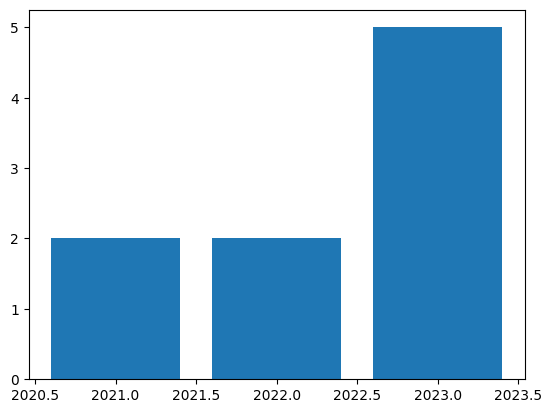

Tien D. Bui
[1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


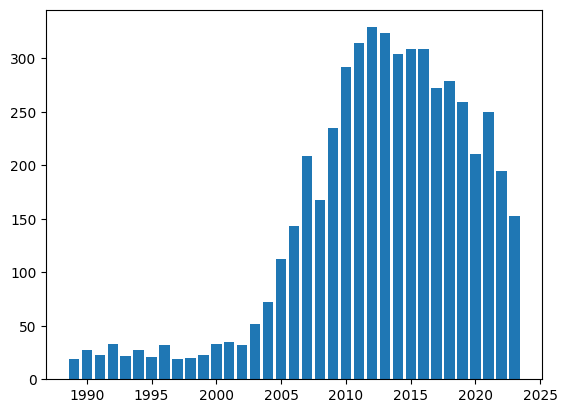

Yibo Liu
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


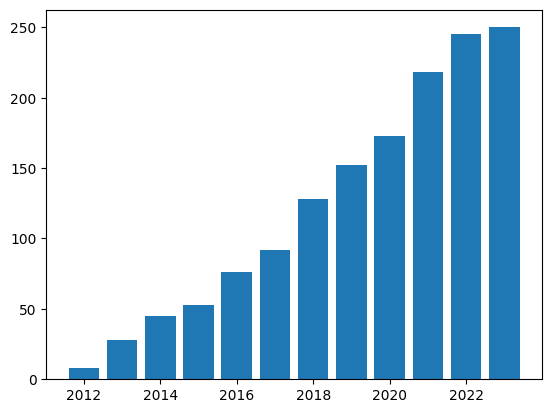

Ziwei Liu
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


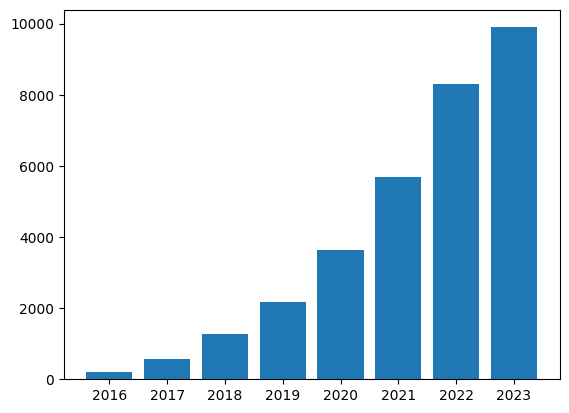

Min Cen
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


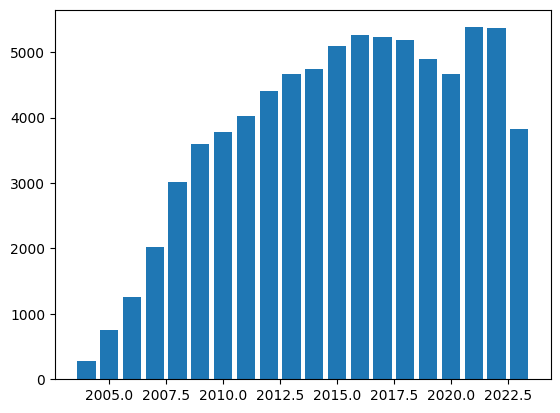

Jiwen Lu
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


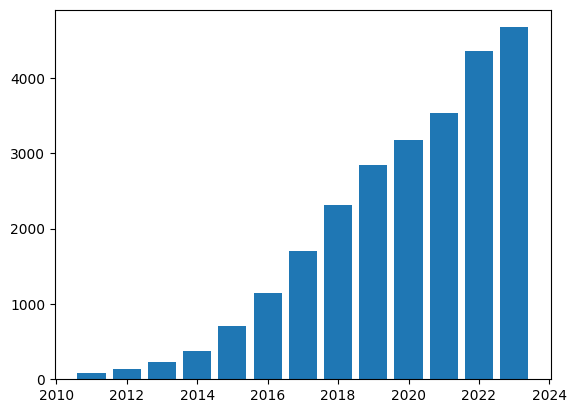

Navid Mohammadi Foumani
[2019, 2020, 2021, 2022, 2023]


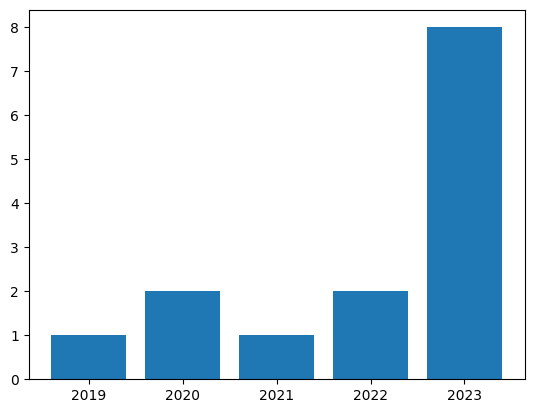

Dayang Wang
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


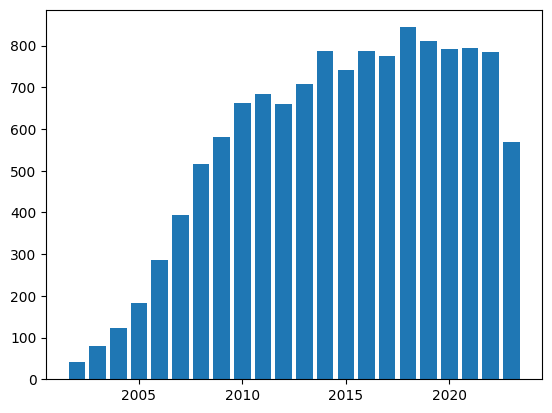

Robert Kwiatkowski
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


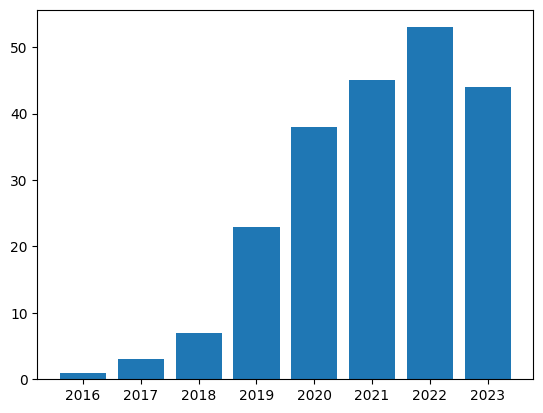

Kaushal Patel
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


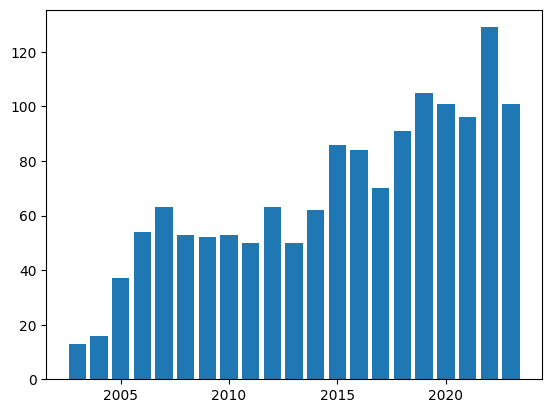

Feng Xia
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


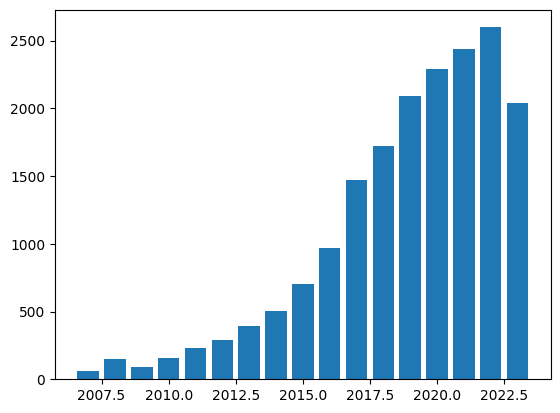

Tobias Domhan
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


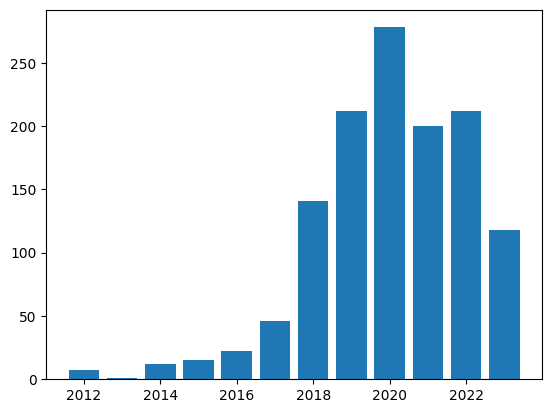

Edwin Weill
[1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


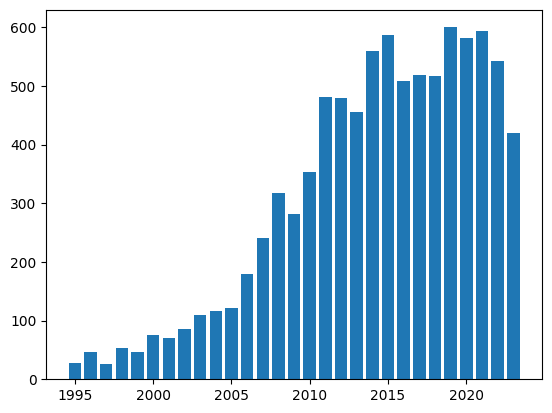

Lifang He
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


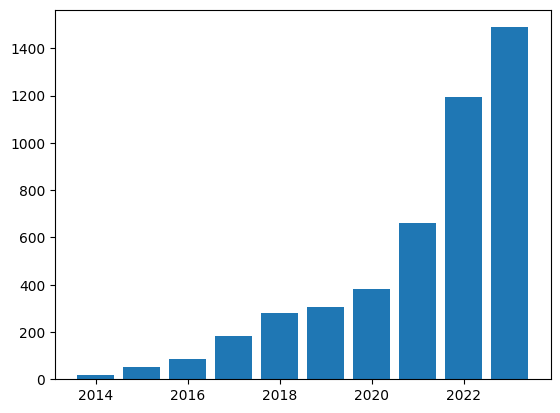

Linlin Yang
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


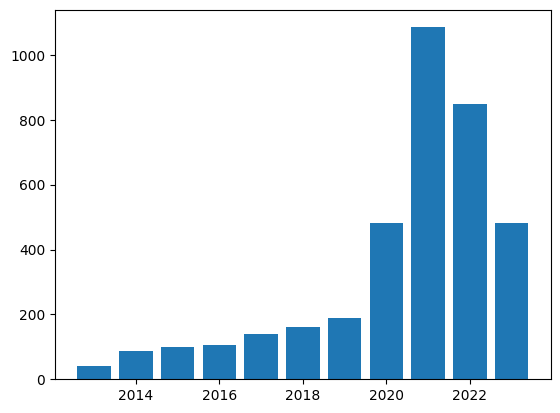

Lihua Xie
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


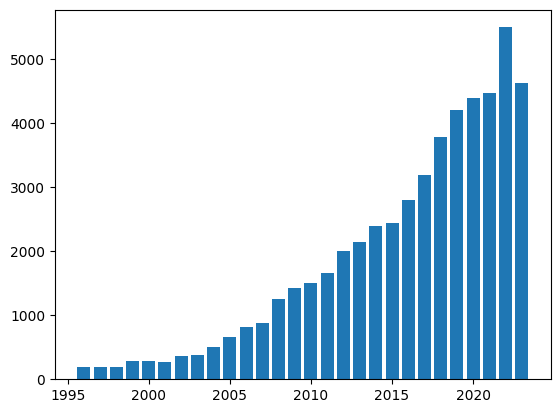

Xing Xie
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


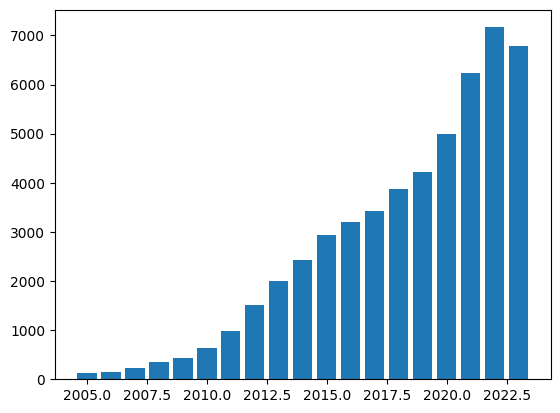

Claudia Prieto
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


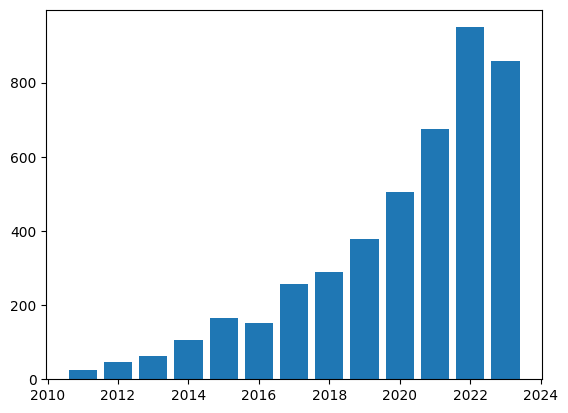

Fernando Alonso-Fernandez
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


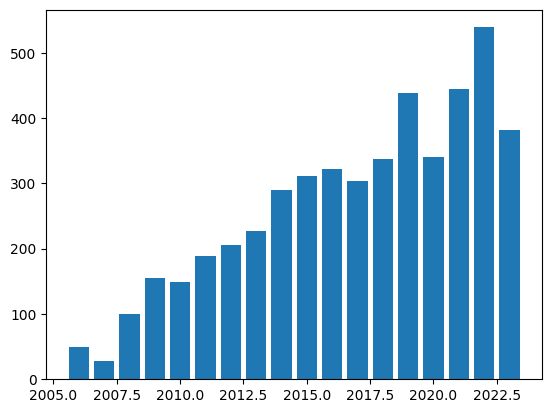

Yan Liu
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


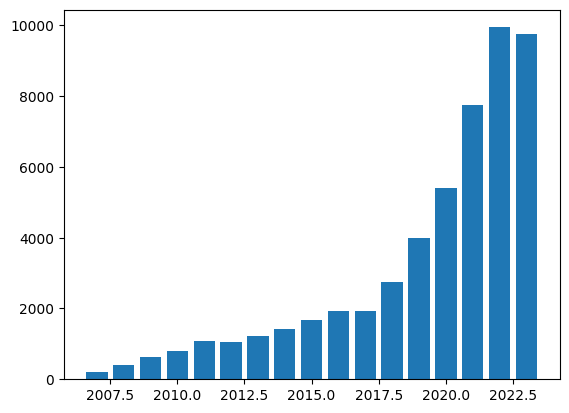

Ian Pratt-Hartmann
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


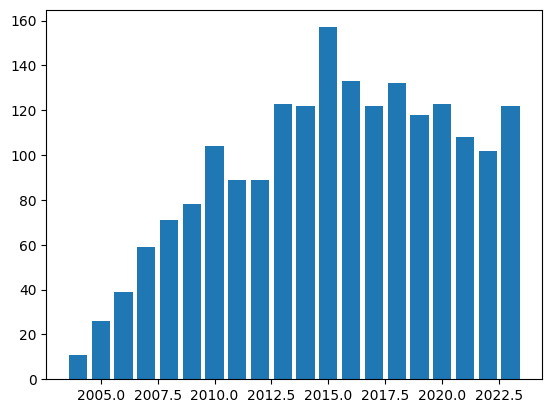

Steven C. H. Hoi
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


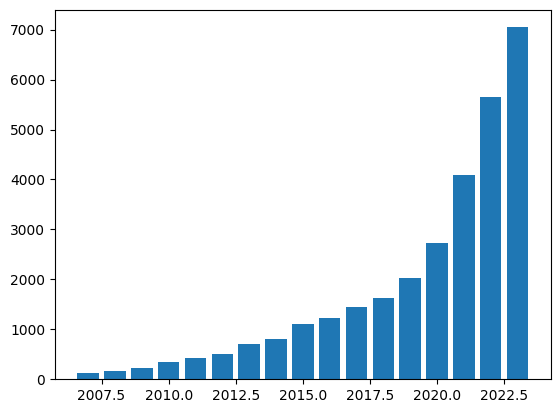

Ognjen Kundačina
[2021, 2022, 2023]


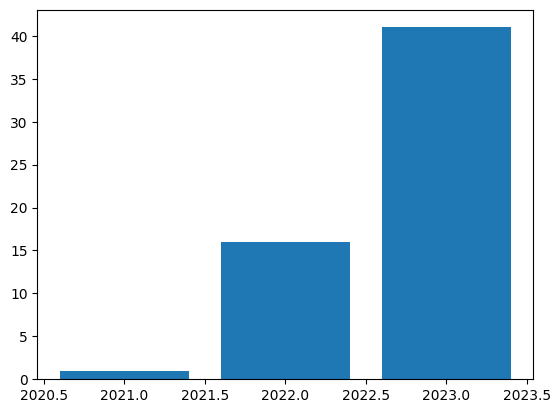

Yu-Shian Lin
[]


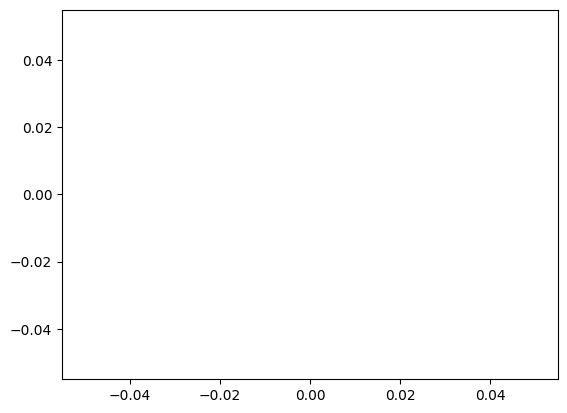

Chris Xiaoxuan Lu
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


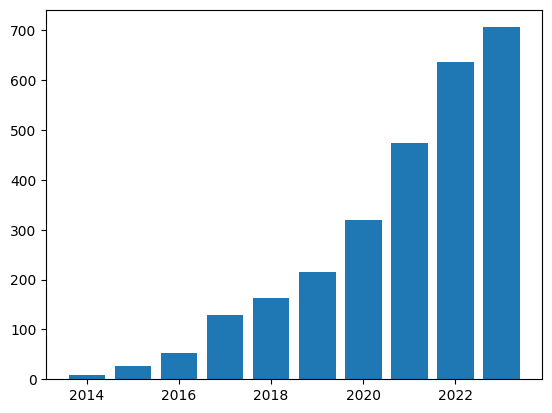

Spyridon Bakas
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


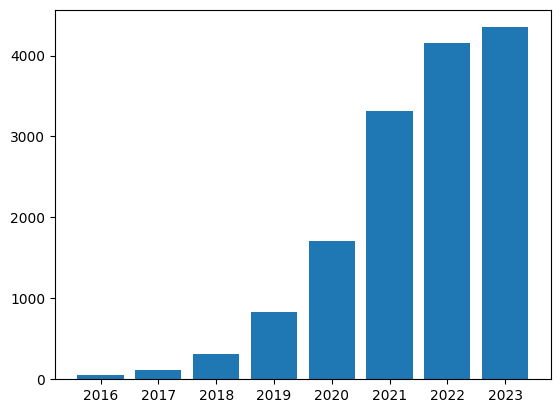

Jing Tian
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


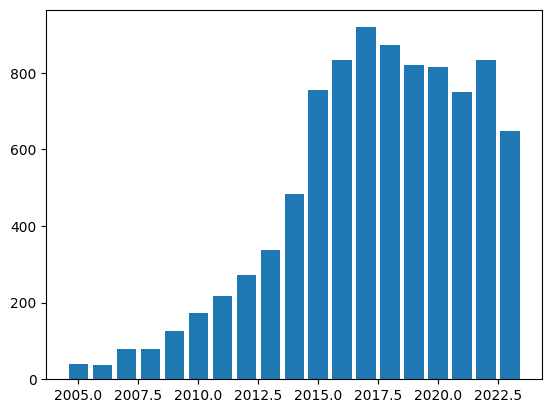

Zhiqi Zhang
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


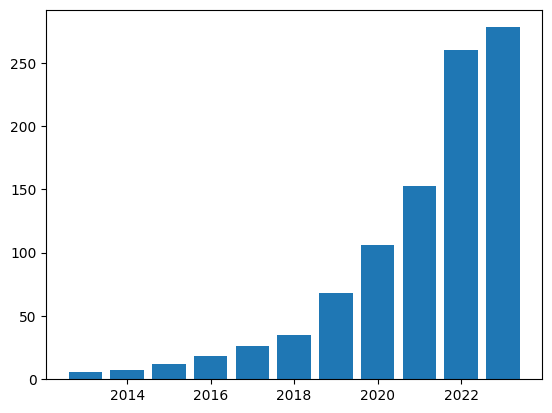

Liang Ding
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


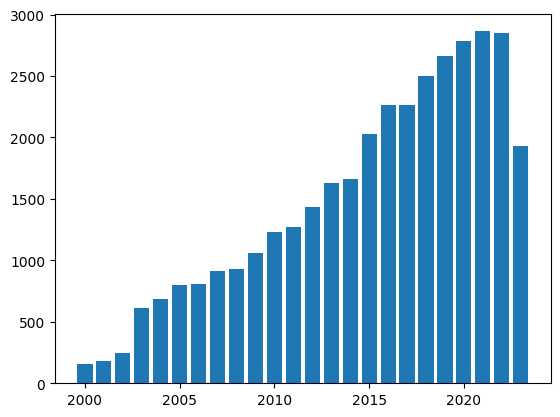

Kai Zhang
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


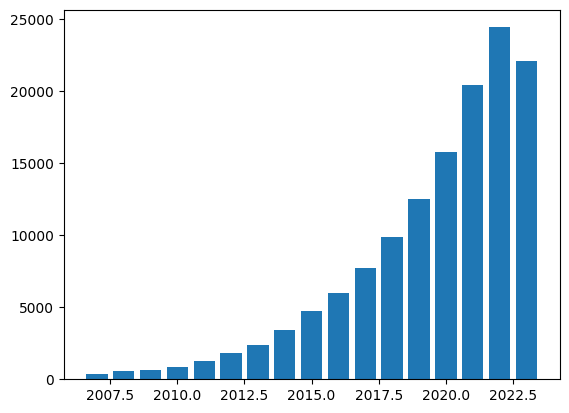

Mykhaylo Andriluka
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


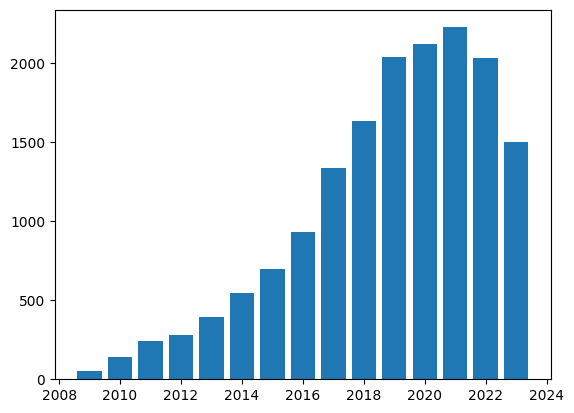

Syed Rafay Hasan
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


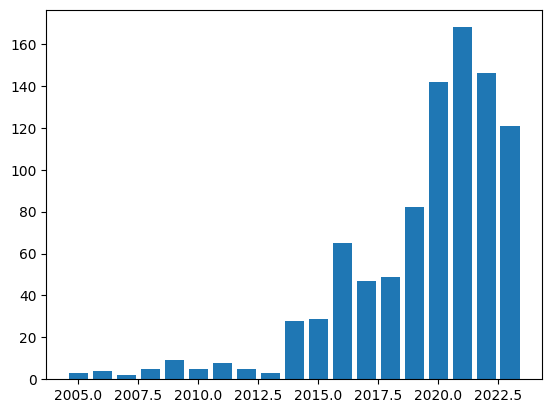

Bastien Durix
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


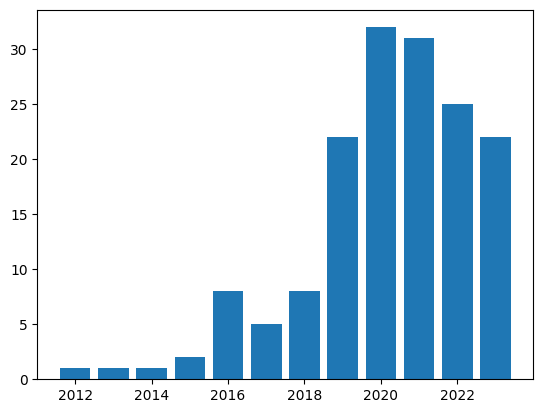

Manisha Sinha
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


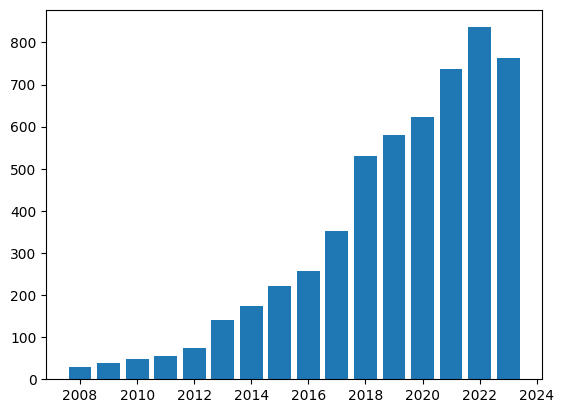

Bipin Rajendran
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


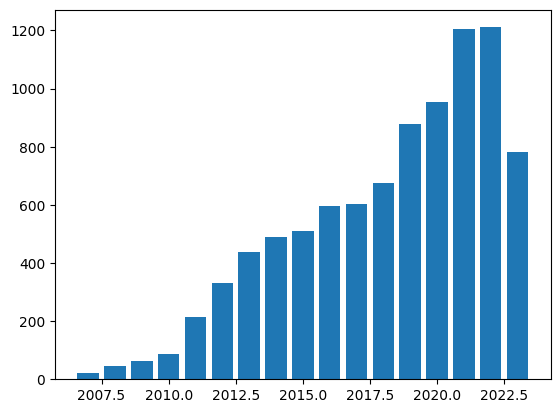

Andrea Montanari
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


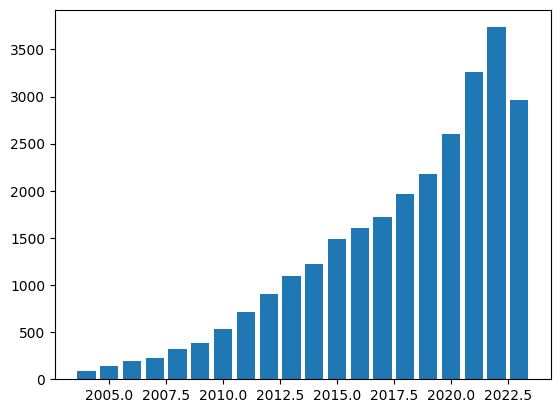

Dhrubajyoti Pathak
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


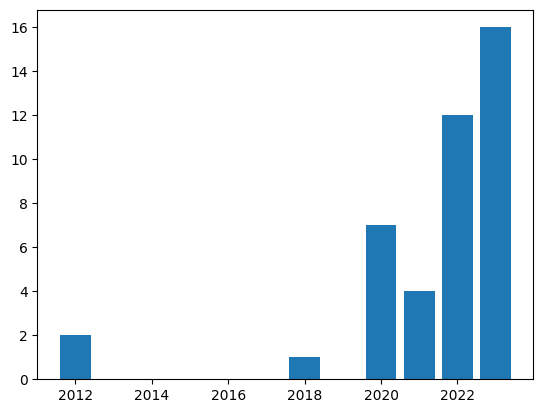

Ana Paula Marques Ramos
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


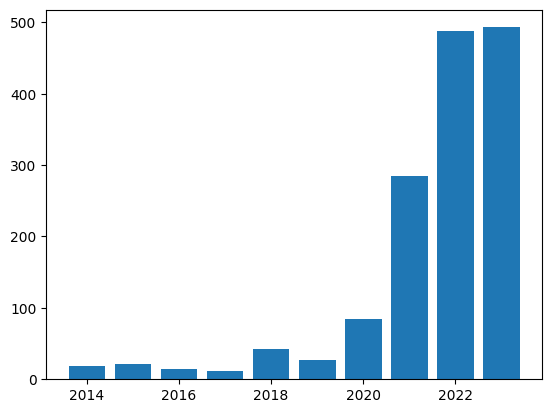

Wenyu Wang
[2019, 2020, 2021, 2022, 2023]


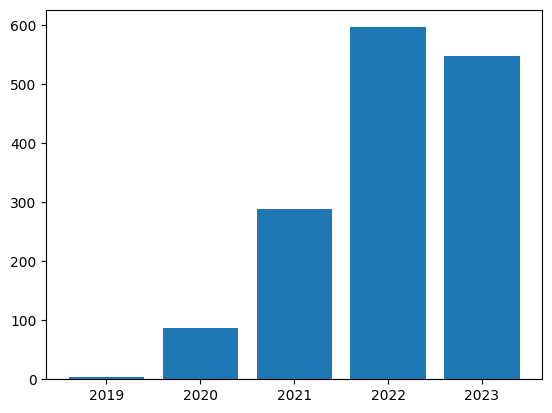

Fei Wang
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


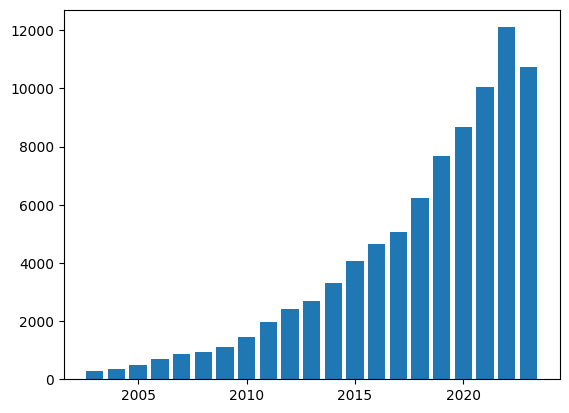

Rachid Guerraoui
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


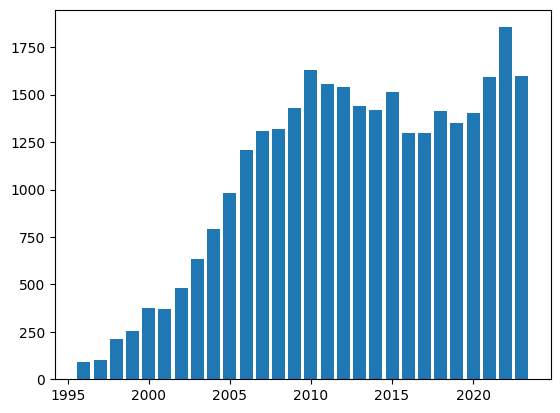

Binod Karunanayake
[2019, 2020, 2021, 2022, 2023]


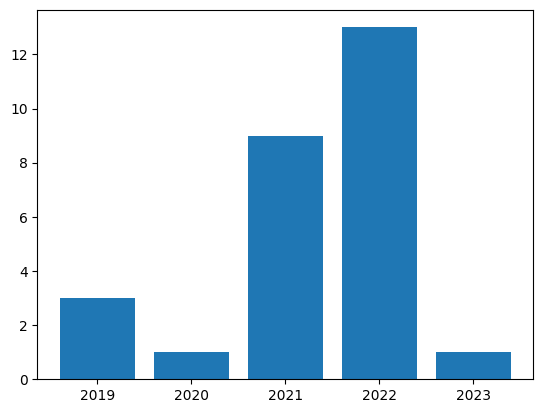

Zhiyuan Liu
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


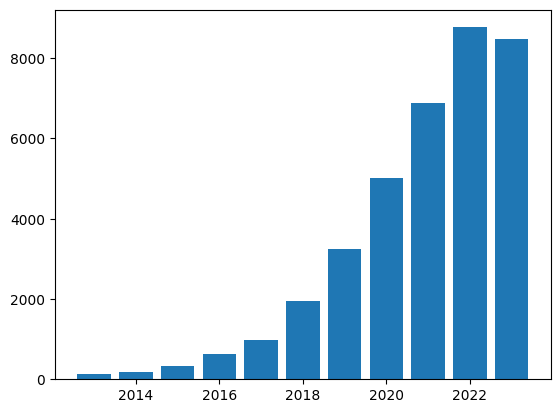

Jianwei Qiu
[1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


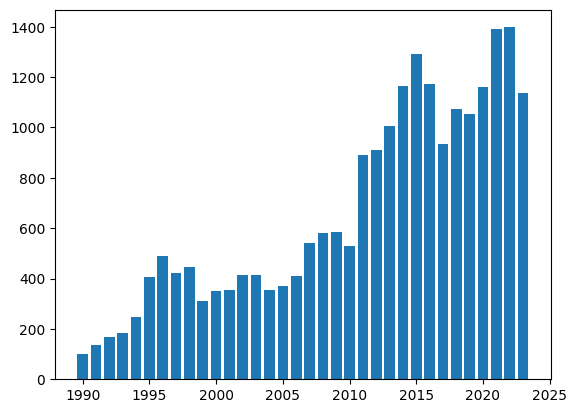

Chen Sun
[1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


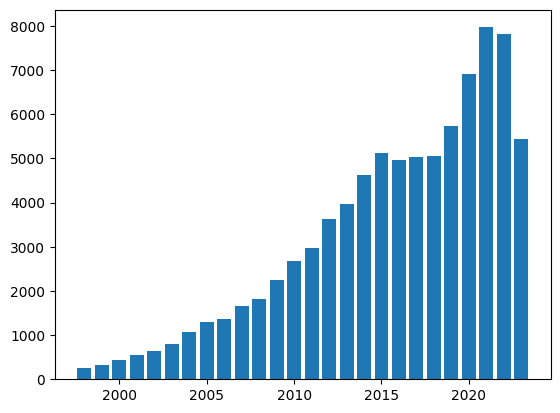

Ruifeng Xu
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


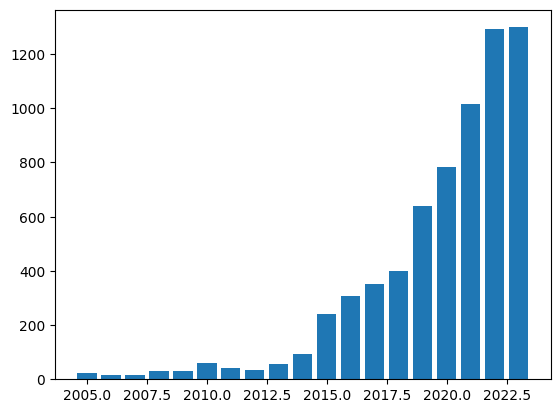

Hieu H. Pham
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


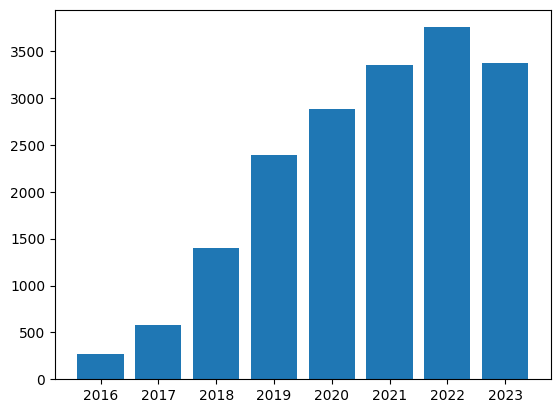

Yuxin Jiang
[2020, 2021, 2022, 2023]


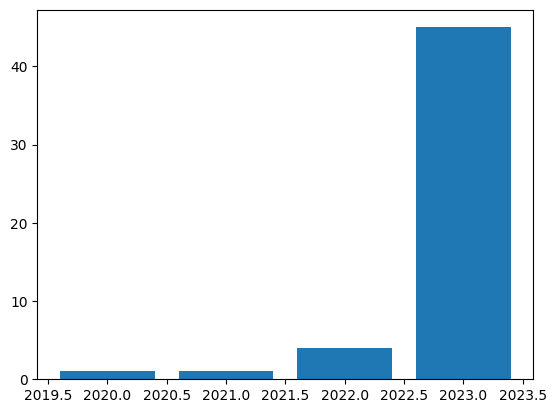

Marieke van Buchem
[2018, 2019, 2020, 2021, 2022, 2023]


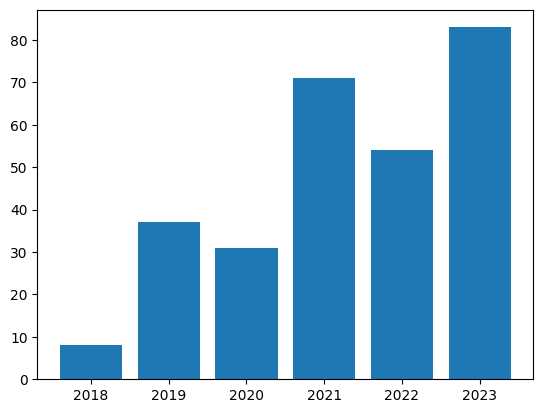

Vicky Kalogeiton
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


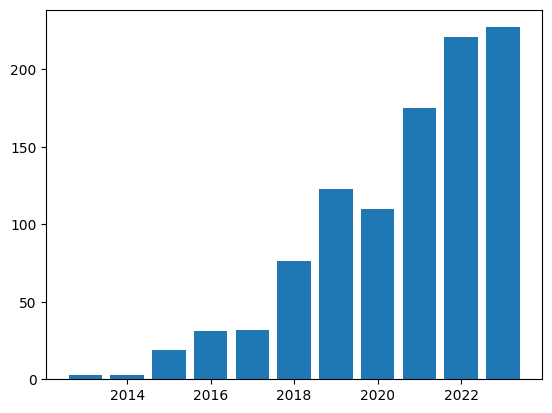

Ian Foster
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


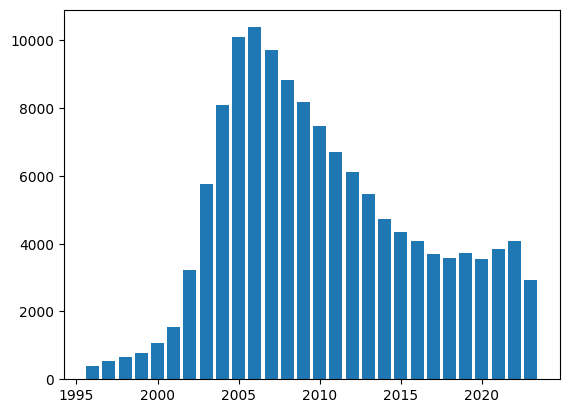

Mingming Fan
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


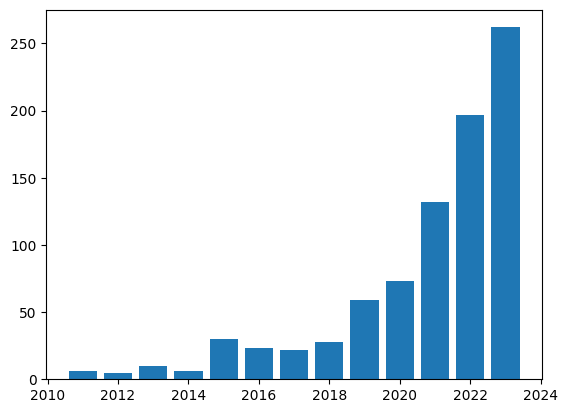

Josh Pollock
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


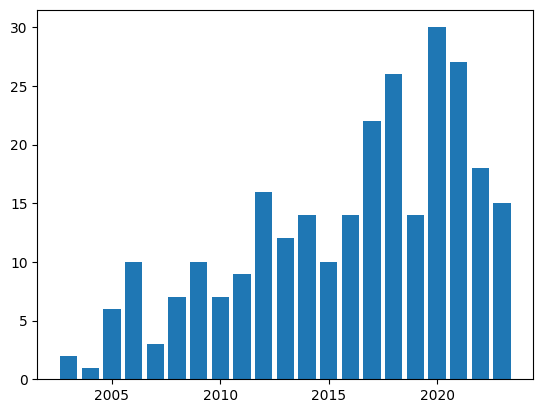

Li Meng
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


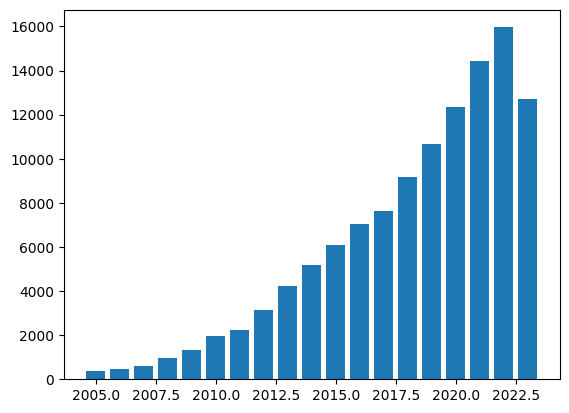

Yeongjoon Park
[2018, 2019, 2020, 2021, 2022, 2023]


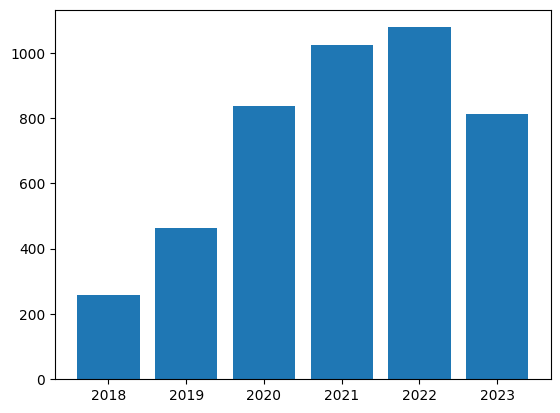

Hui Li
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


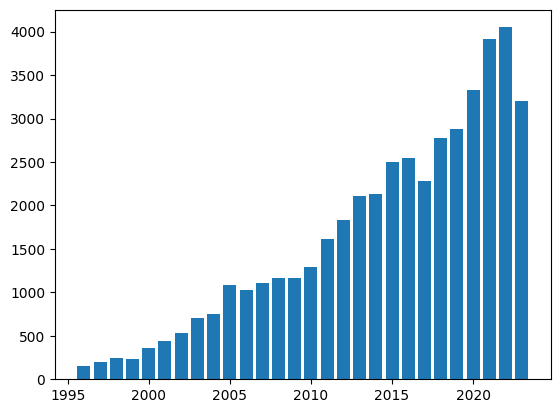

Sida Wang
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


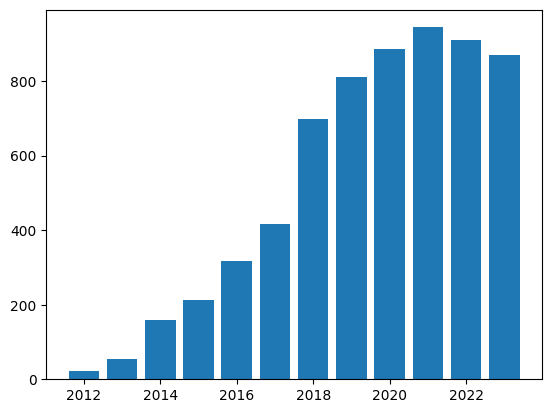

Abrar Hasin Kamal
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


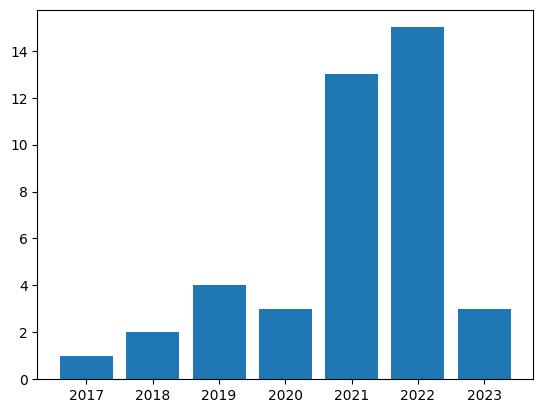

Shravan Murlidaran
[2017, 2018, 2019, 2020, 2021, 2022]


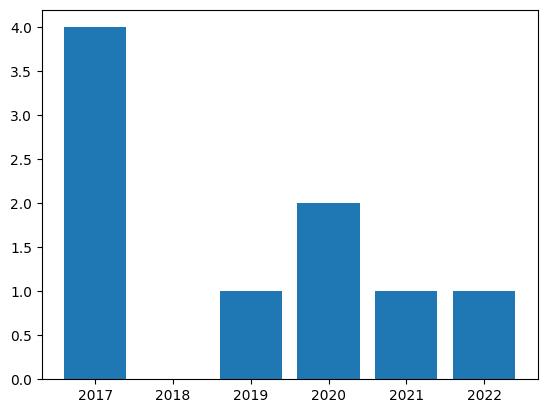

Ivan Lazarevich
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


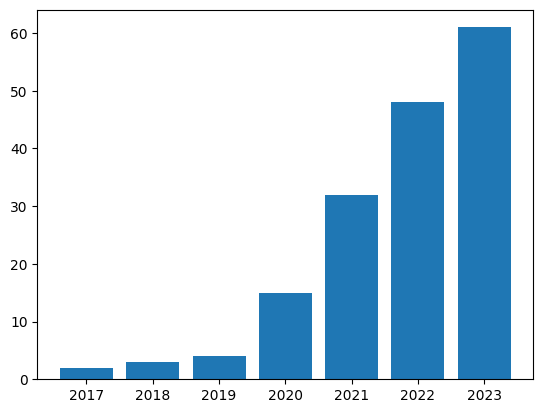

Philip S. Yu
[1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


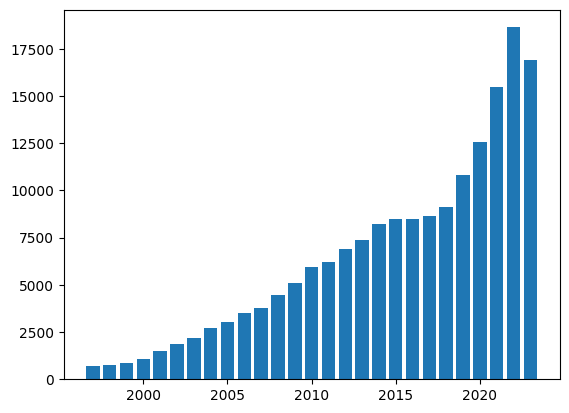

Wenxin Jiang
[2021, 2022, 2023]


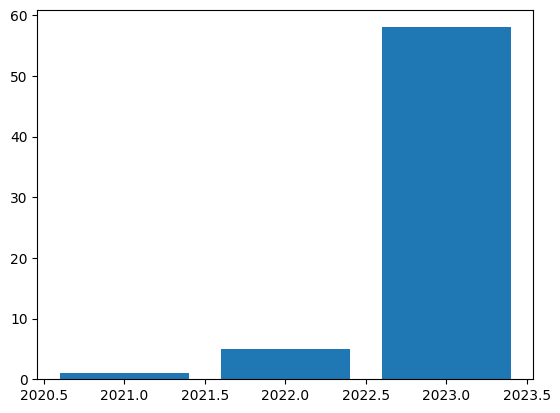

Desmond Elliott
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


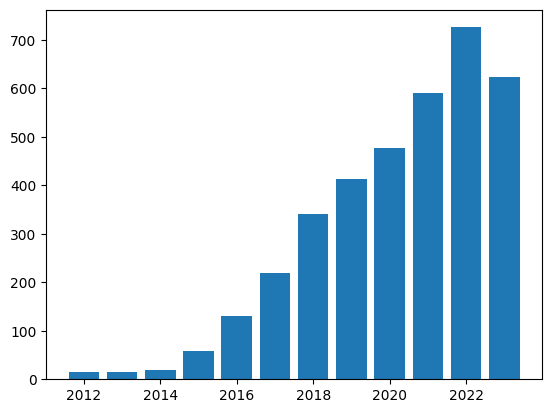

Yifan Du
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


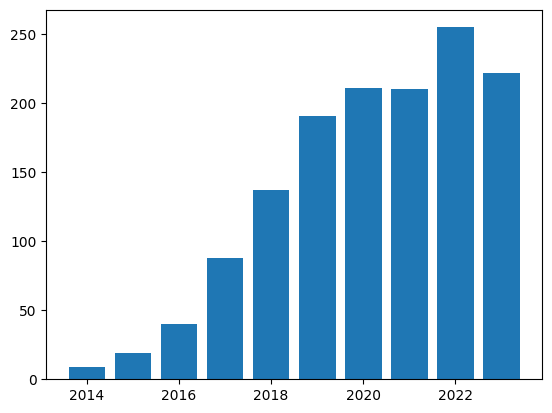

Amit Kumar Yadav
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


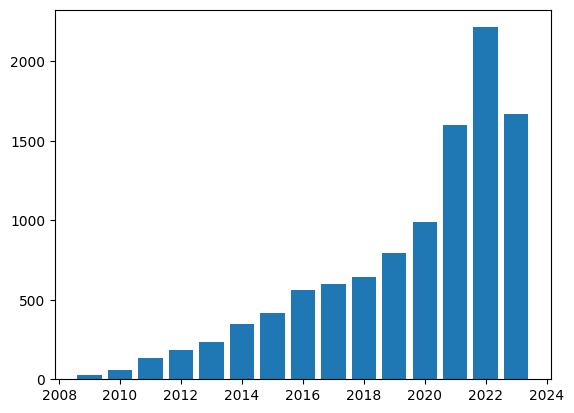

Fabio De Sousa Ribeiro
[2018, 2019, 2020, 2021, 2022, 2023]


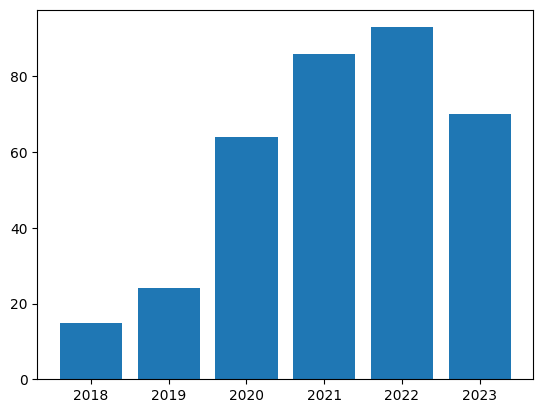

Cheng Chen
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


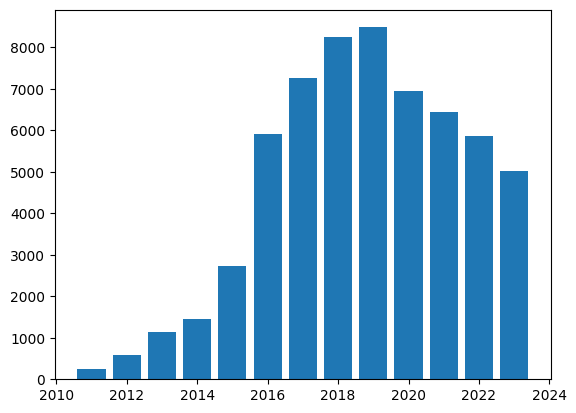

Guangxu Zhu
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


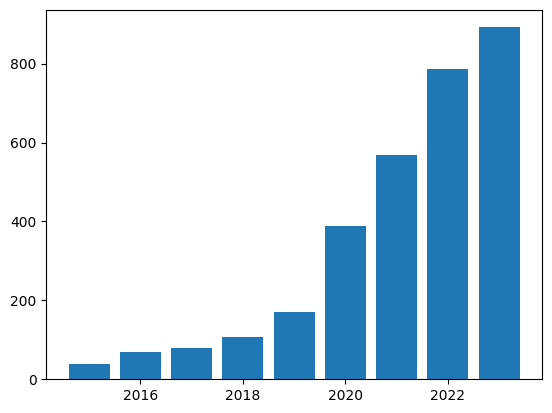

Masaki Saito
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


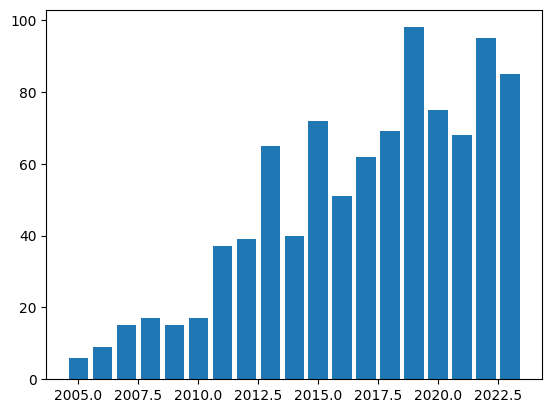

Zhelun Wu
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


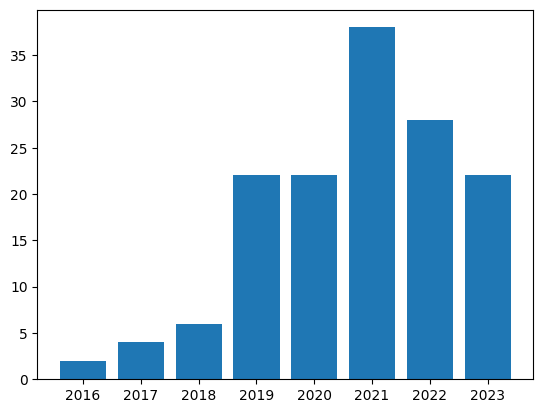

Muhammad Nabeel Asim
[2018, 2019, 2020, 2021, 2022, 2023]


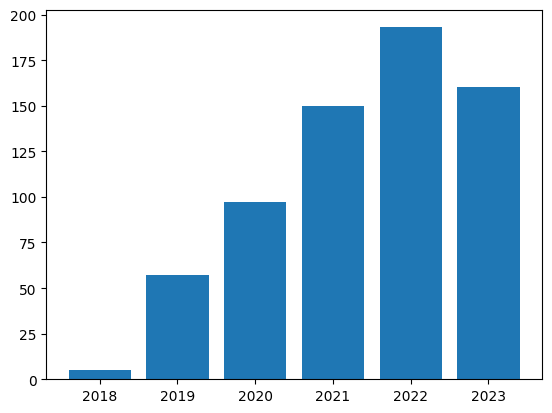

Fausto Giunchiglia
[1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


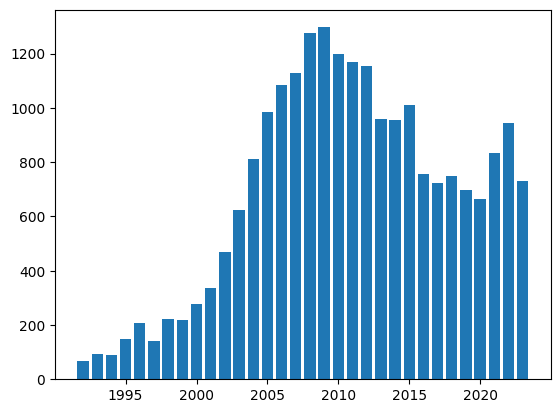

Anima Anandkumar
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


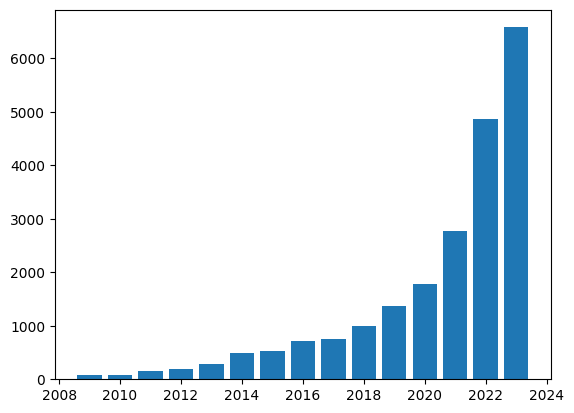

Madhavi Perera
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


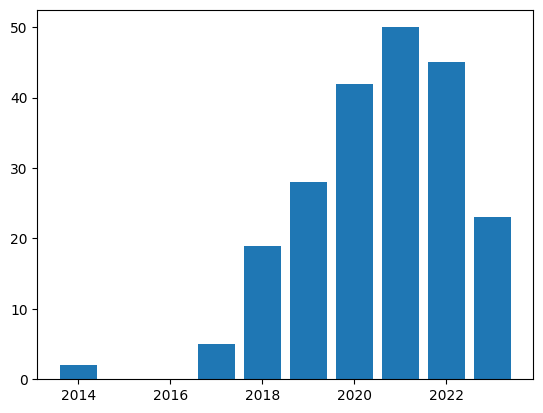

Zhiqiang Zhang
[1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


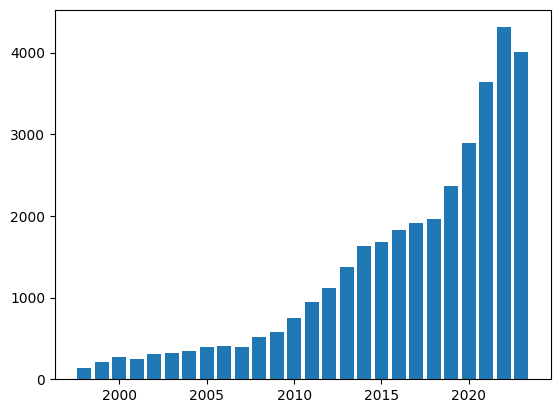

Lu Bai
[1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


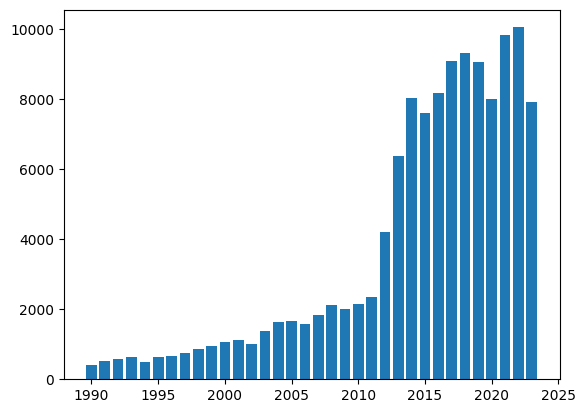

Brendt Wohlberg
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


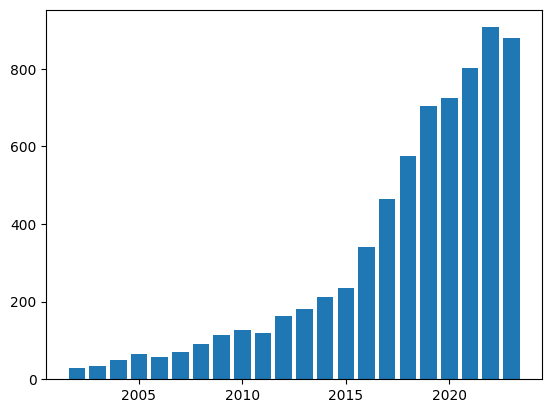

Gunel Jahangirova
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


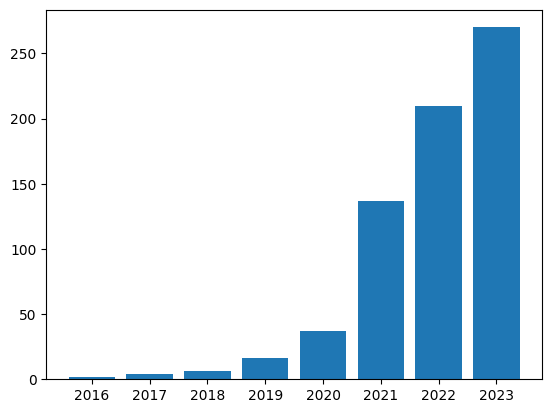

Konda Reddy Mopuri
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


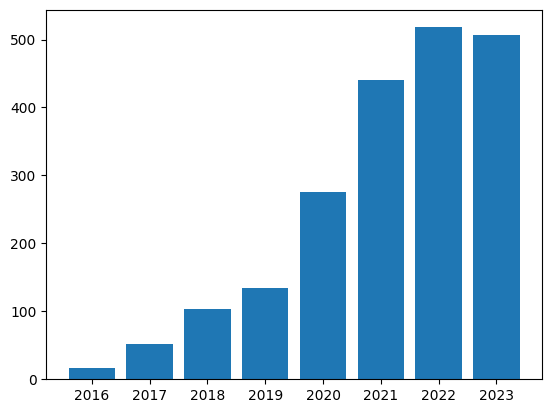

Aurélie Névéol
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


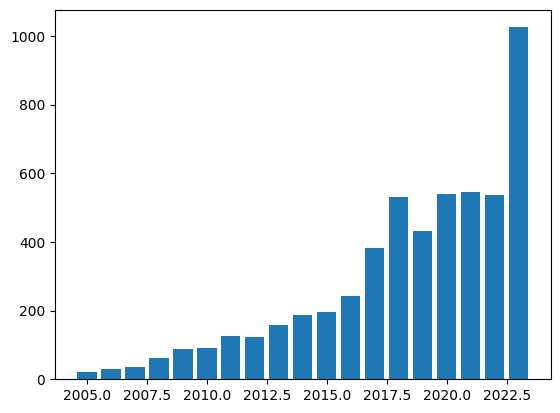

Dongqi Cai
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


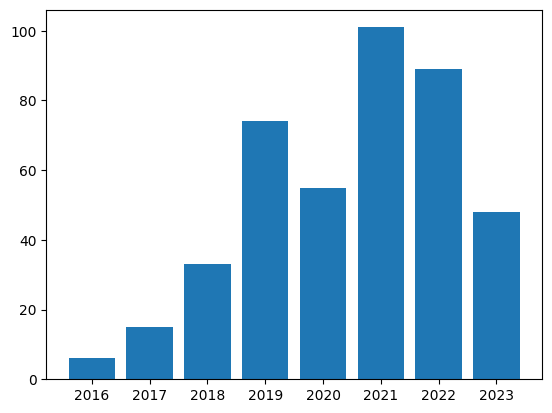

William McNally
[1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


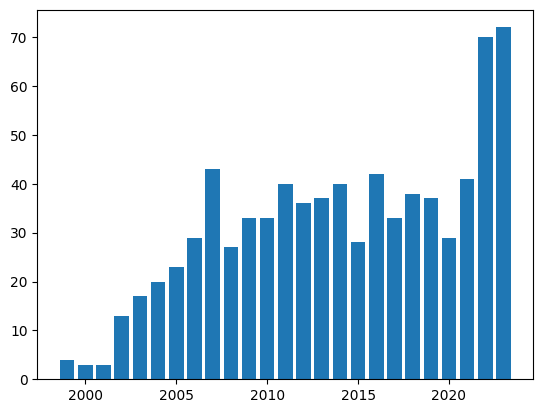

M. Ali Babar
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


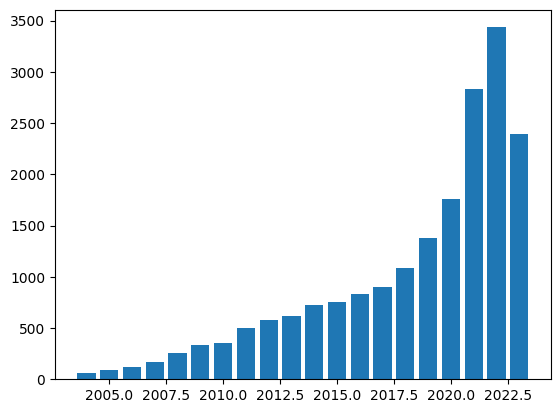

Xiangmao Chang
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


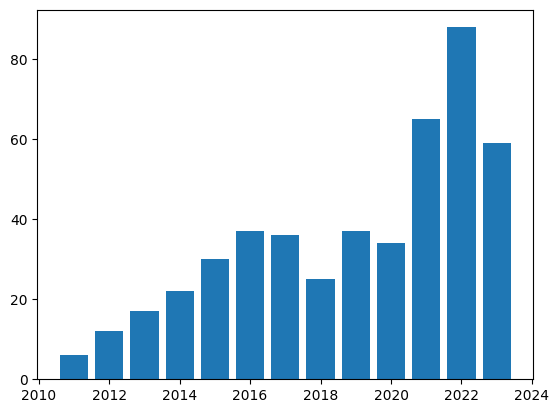

Parisa Rashidi
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


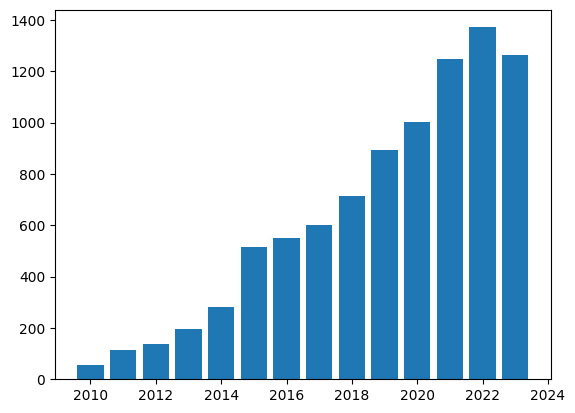

Tianlong Chen
[2020, 2021, 2022, 2023]


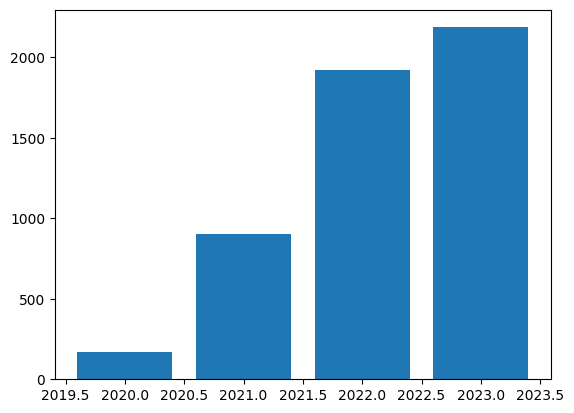

Sai Ho Yeung
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


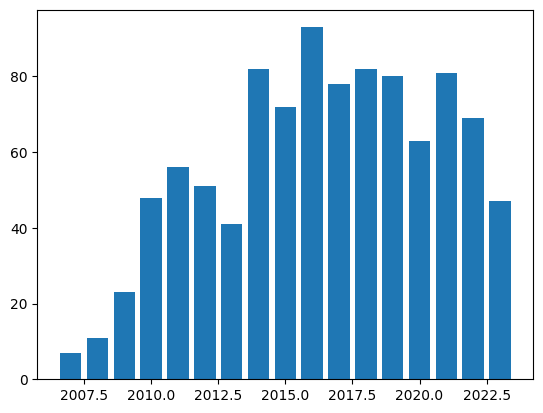

Weikang Xiao
[]


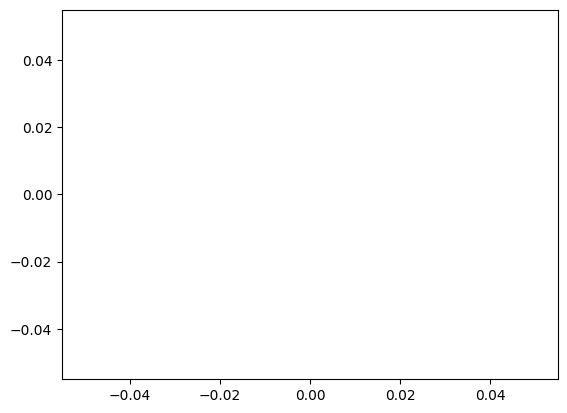

Zhengchun Liu
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


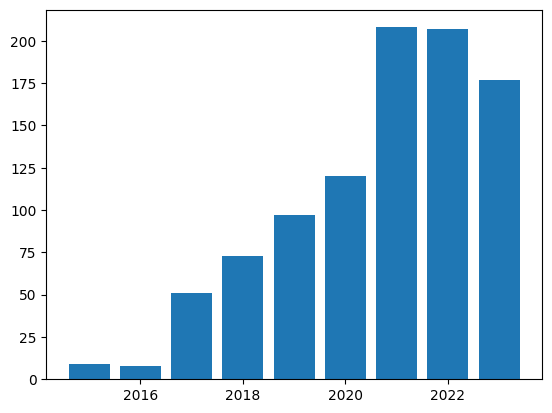

Kang Zhao
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


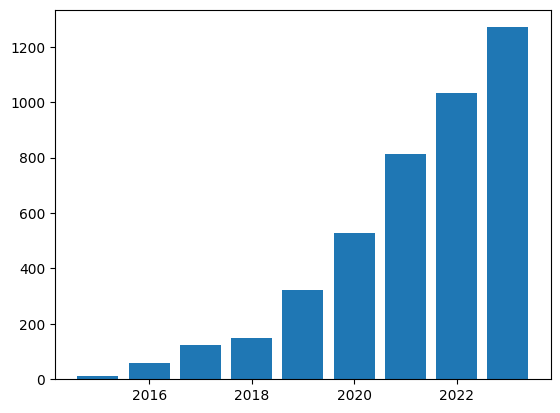

Joongheon Kim
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


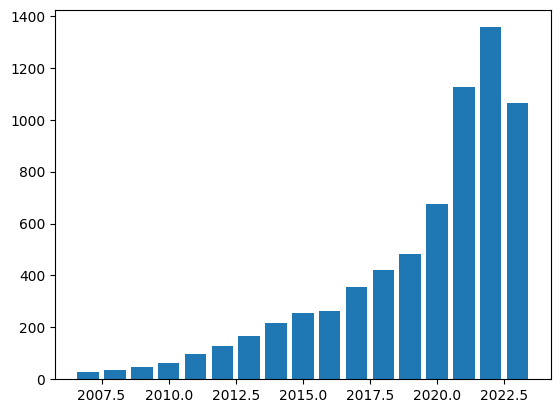

Ülkü Meteriz
[2019, 2020, 2021, 2022, 2023]


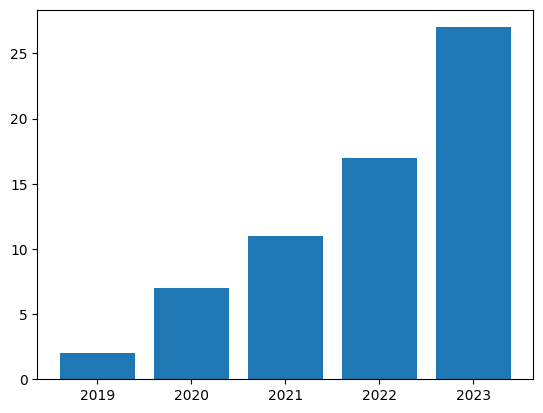

Victor Veitch
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


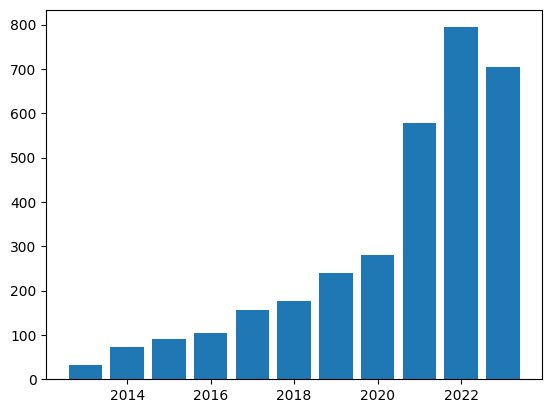

Karen Livescu
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


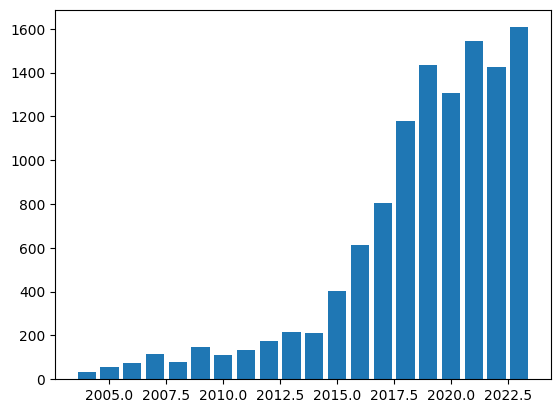

Shafie Gholizadeh
[2018, 2019, 2020, 2021, 2022, 2023]


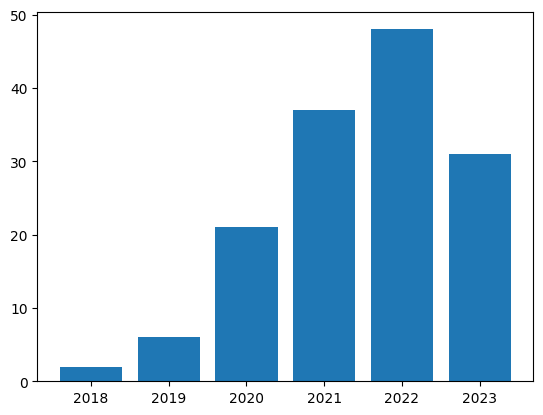

Dheevatsa Mudigere
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


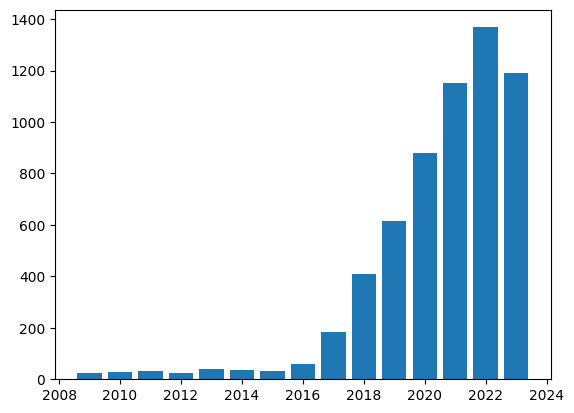

Dai Hoang Tran
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


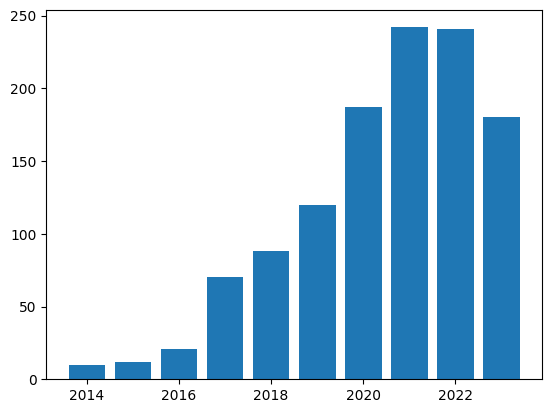

Giorgos Stamou
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


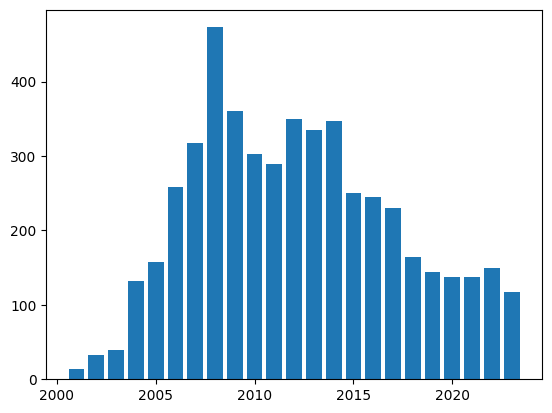

William Hsu
[1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


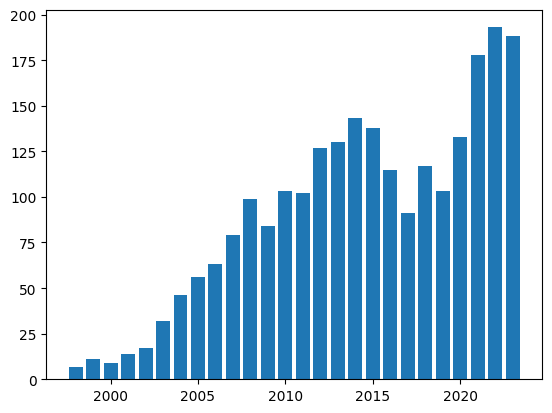

Homanga Bharadhwaj
[2018, 2019, 2020, 2021, 2022, 2023]


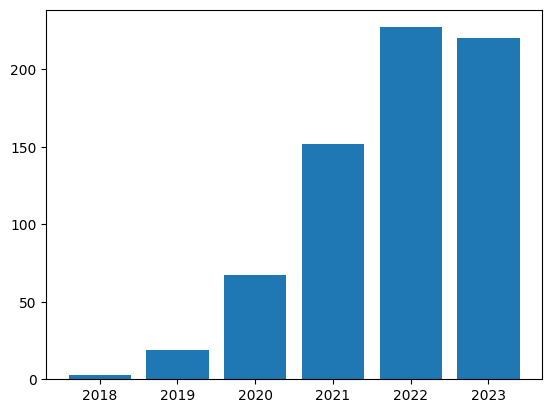

Samarth Sinha
[2019, 2020, 2021, 2022, 2023]


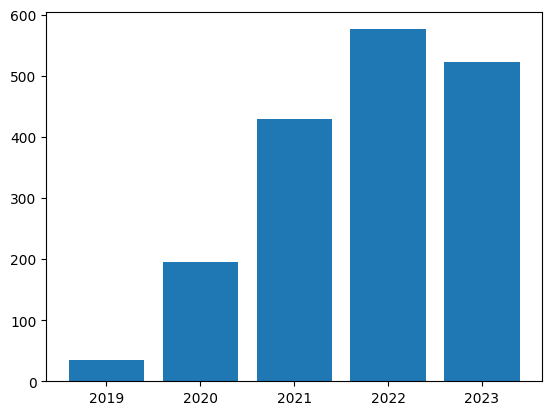

Olivier J. Hénaff
[2018, 2019, 2020, 2021, 2022, 2023]


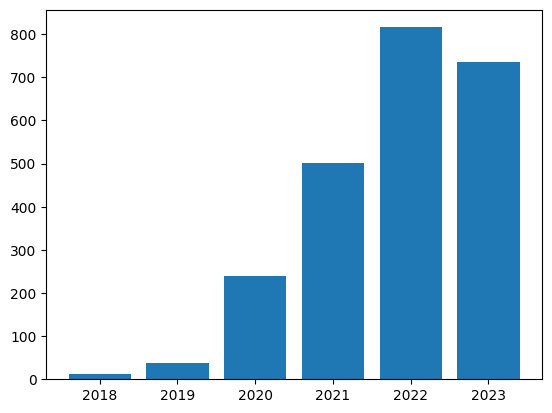

Wenyu Liu
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


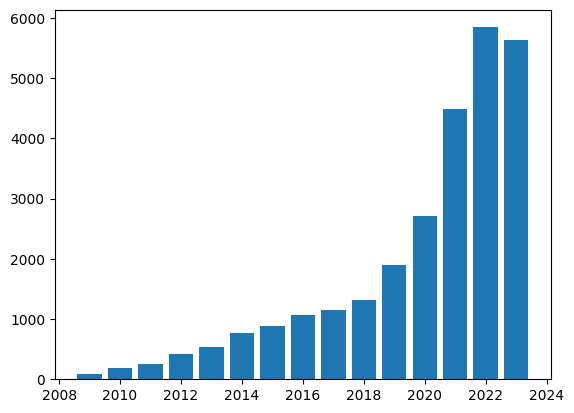

Luciano Lavagno
[1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


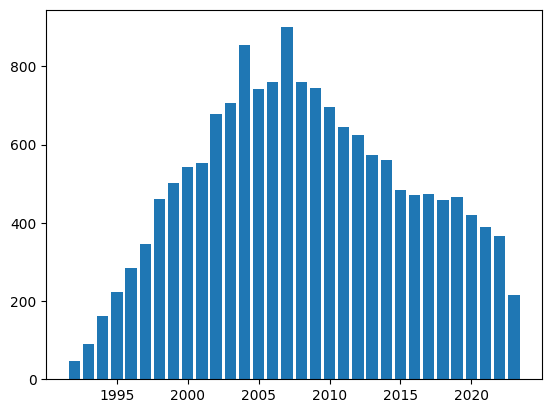

Mohammad Zaki Zadeh
[]


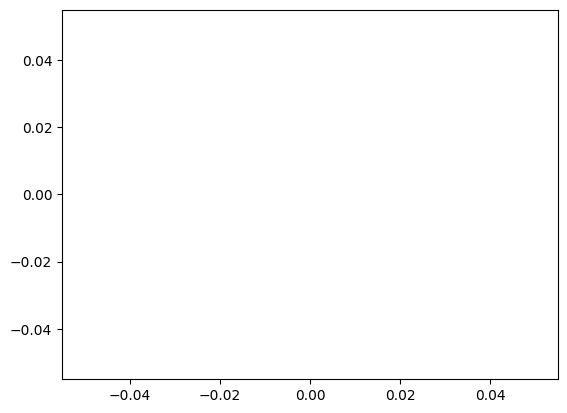

M. V. Nguyen
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


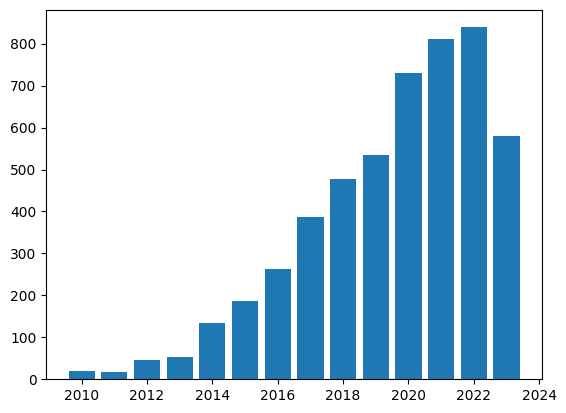

Michael A. Chapman
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


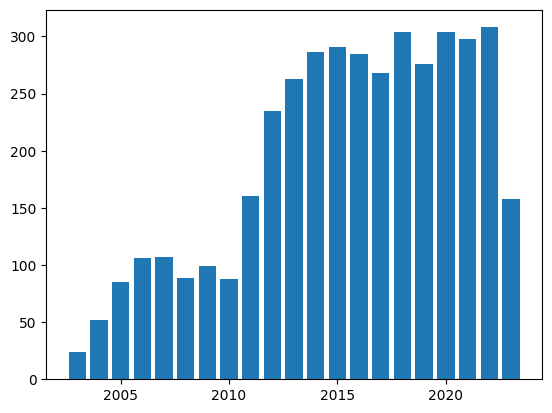

Jingwei Zhang
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


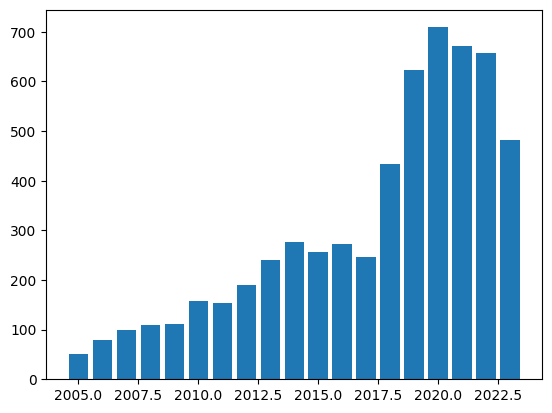

Keith Butler
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


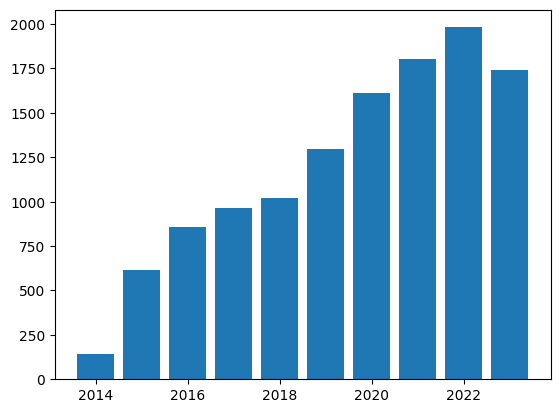

Yifan Peng
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


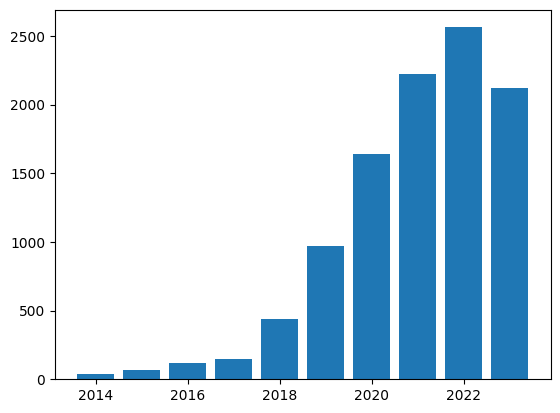

Vikas Raykar
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


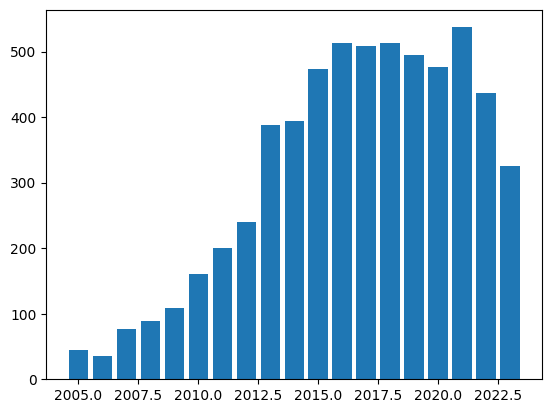

Guanfang Dong
[2020, 2021, 2022, 2023]


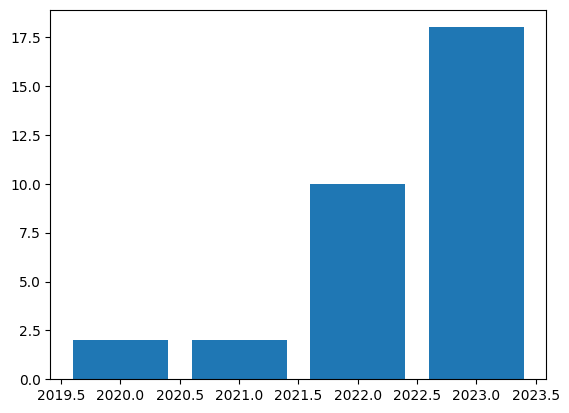

Haobo Yang
[2022, 2023]


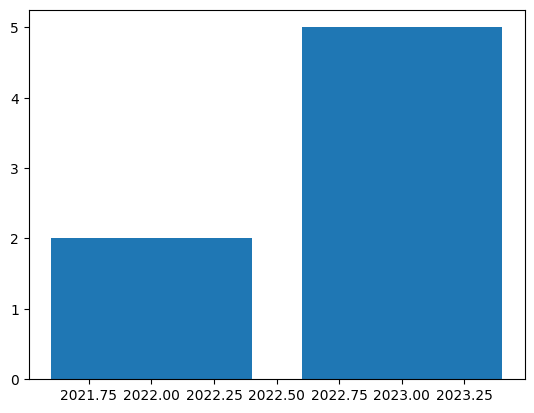

Erqun Dong
[2019, 2020, 2021, 2022, 2023]


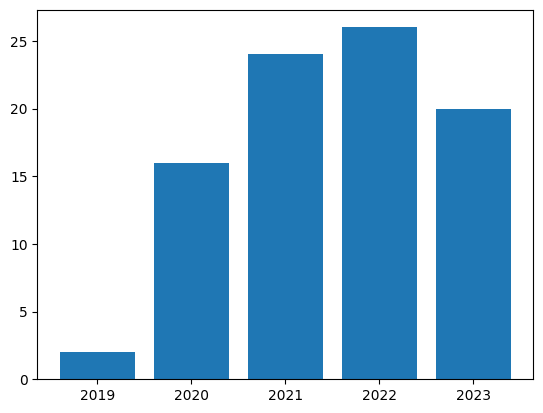

ZhenZhe Ying
[2020, 2021, 2022, 2023]


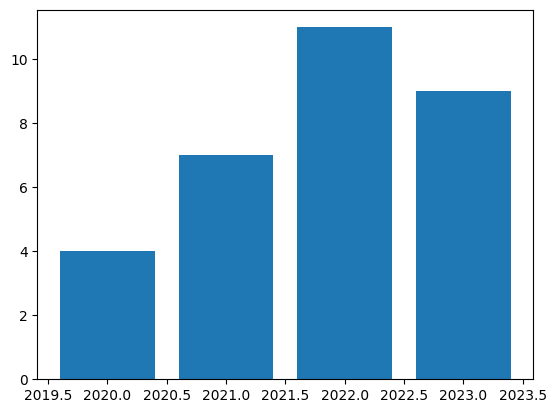

Donglin Bai
[1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


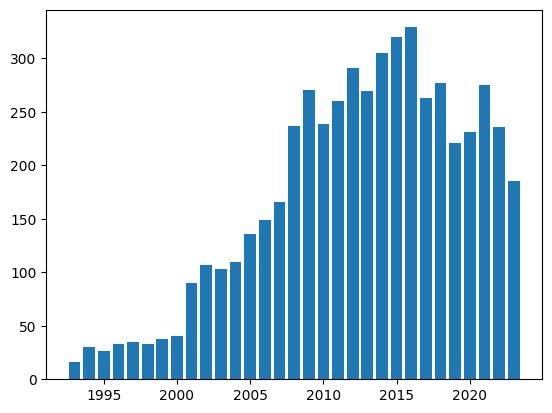

Théodore Papadopoulo
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


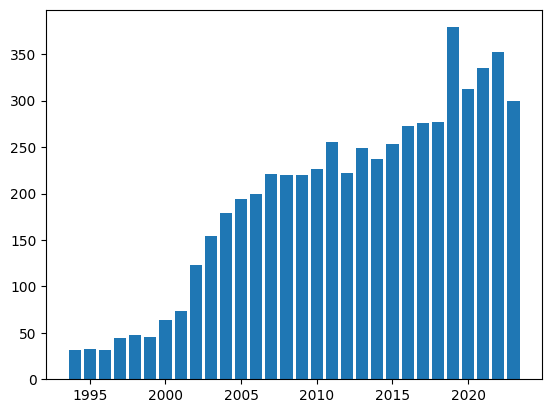

David Filliat
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


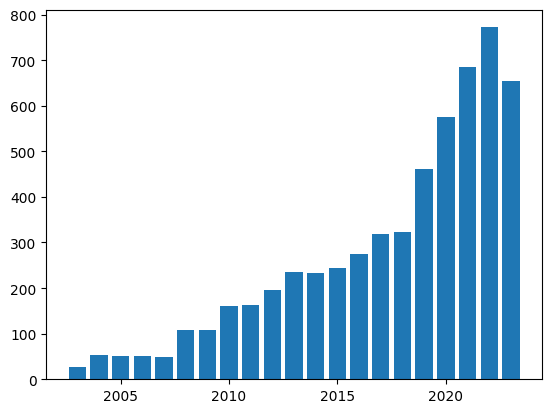

Ali Momeni
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


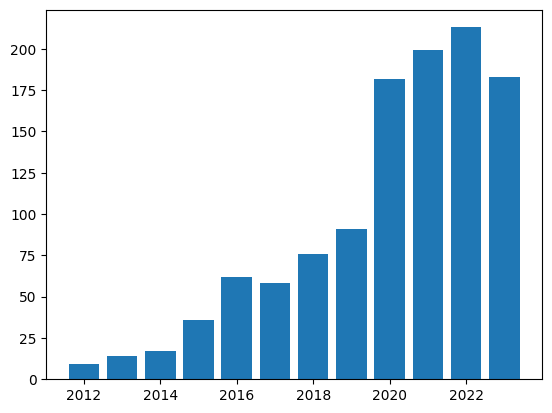

Jeff Heaton
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


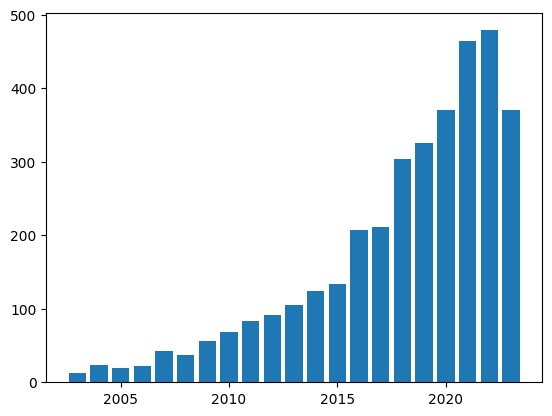

Zhanxing Zhu
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


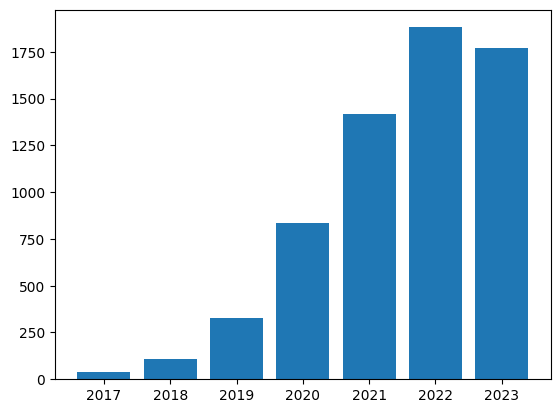

Chenxi Duan
[2020, 2021, 2022, 2023]


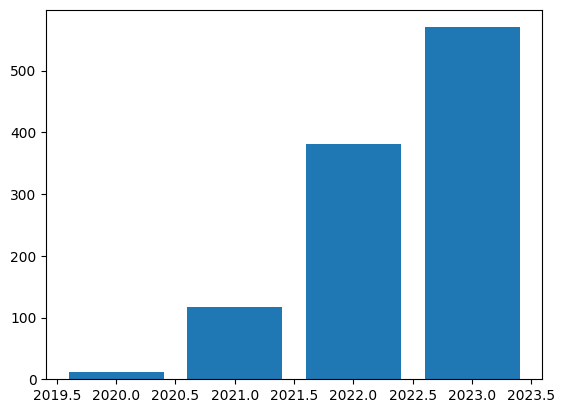

Niall O' Mahony
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


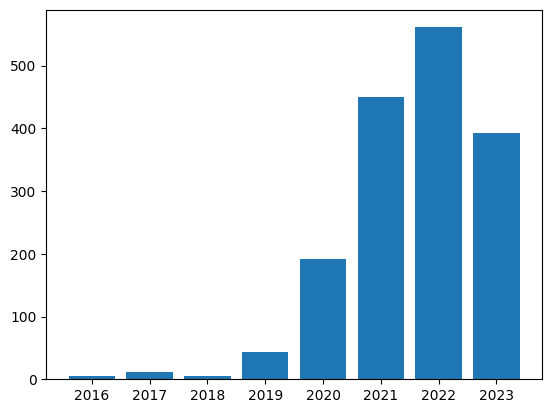

Pradeep Kumar
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


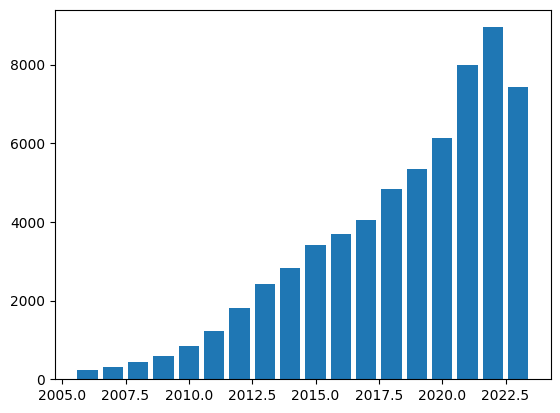

Khoa Luu
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


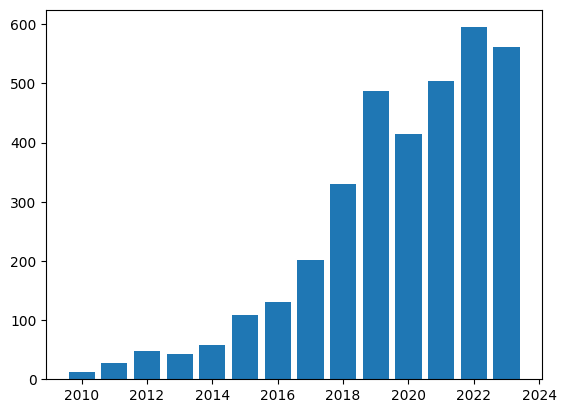

Nikolai Ilinykh
[2018, 2019, 2020, 2021, 2022, 2023]


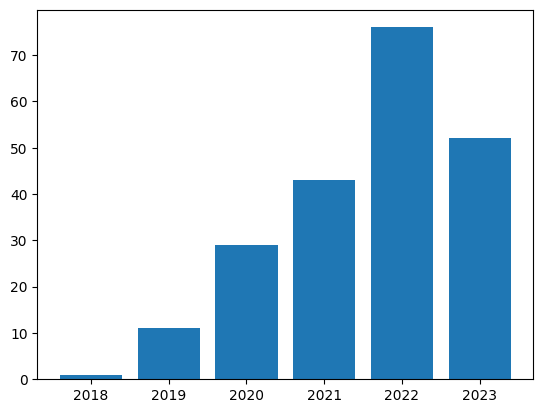

Niels Lobo
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


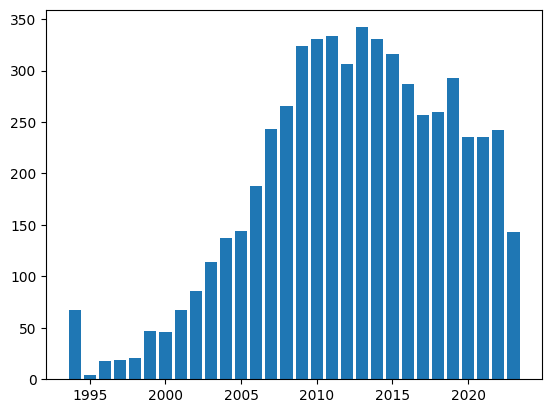

Seoyeon Kim
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


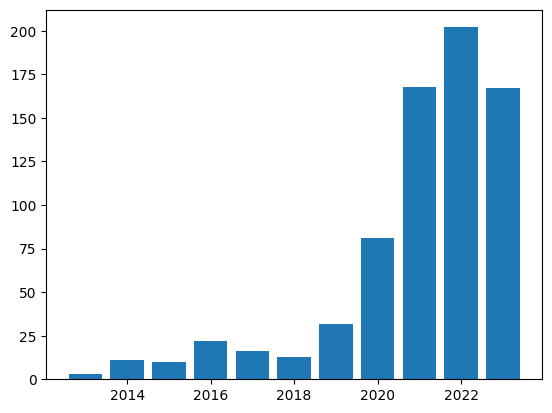

William Beluch
[2018, 2019, 2020, 2021, 2022, 2023]


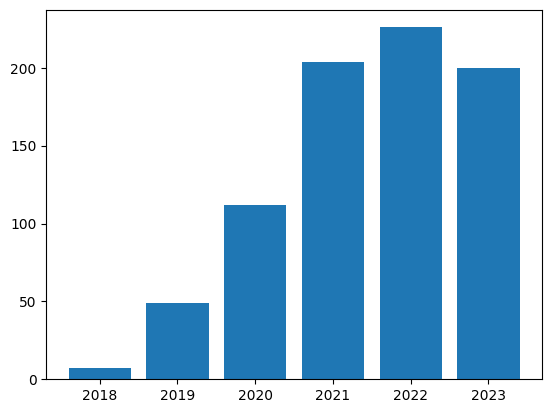

Cordelia Schmid
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


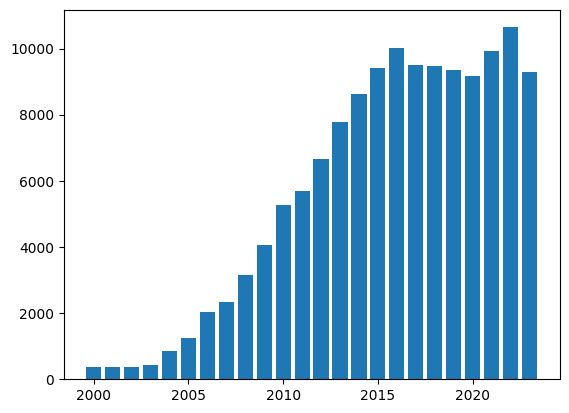

Mustafa Ali Arat
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


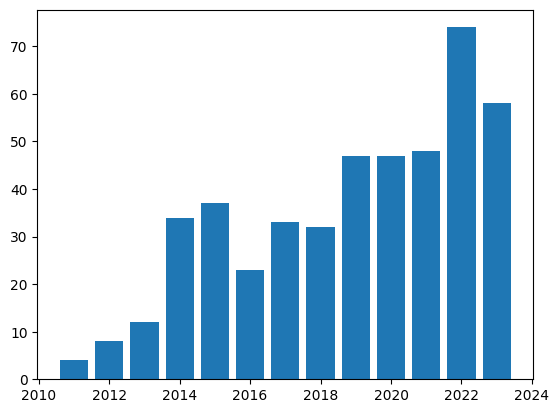

Yuanwei Liu
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


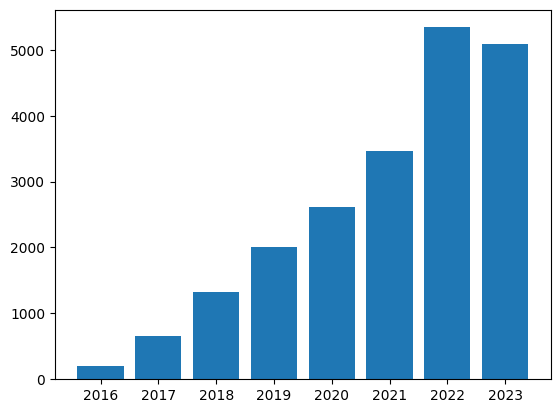

Tony Hey
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


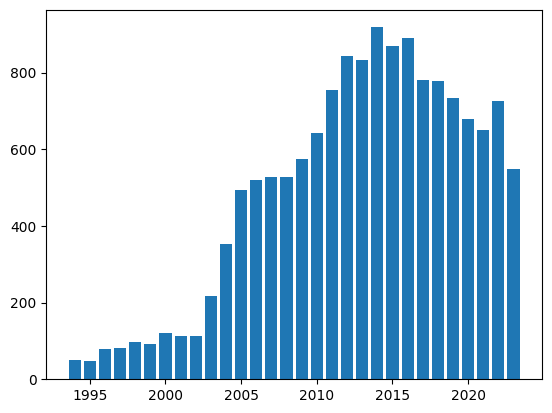

Xuenan Xu
[2020, 2021, 2022, 2023]


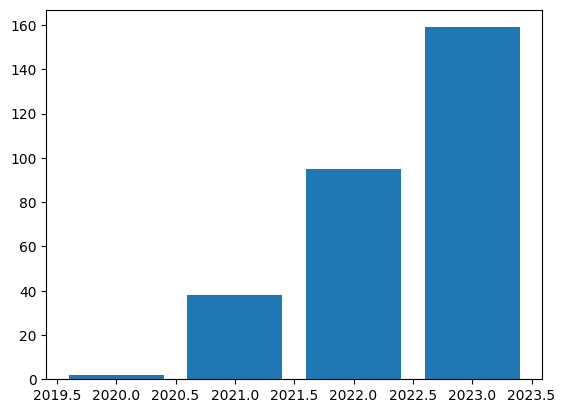

Christopher Yakopcic
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


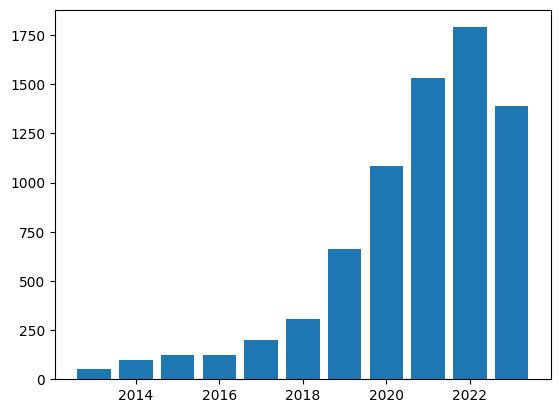

Jian Pei
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


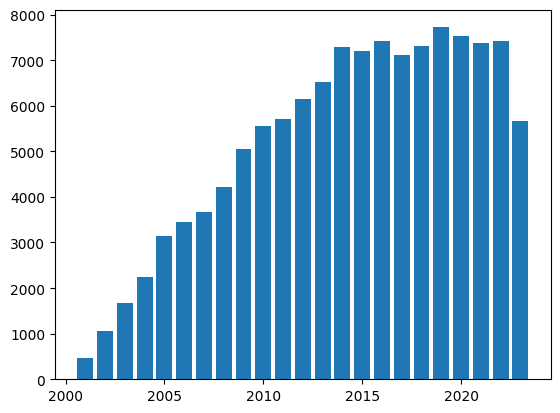

Jakob D. Havtorn
[2020, 2021, 2022, 2023]


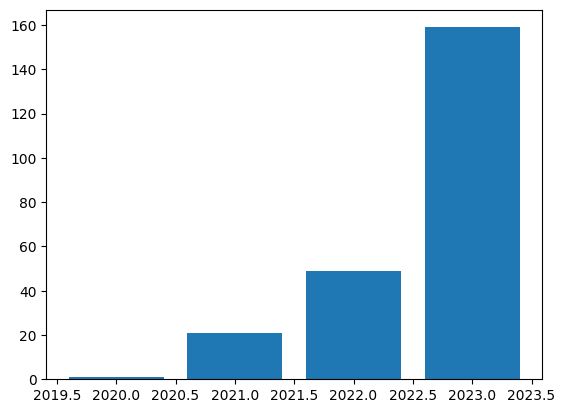

Kamran Kowsari
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


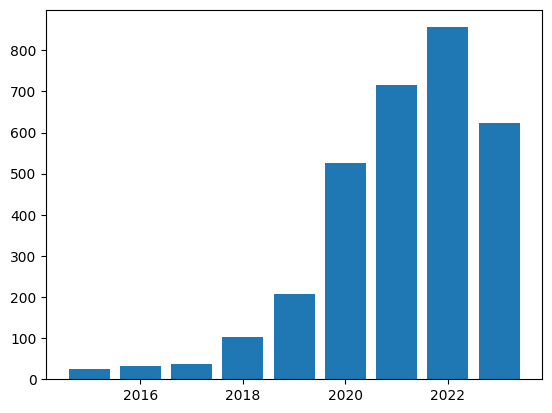

Jian Chen
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


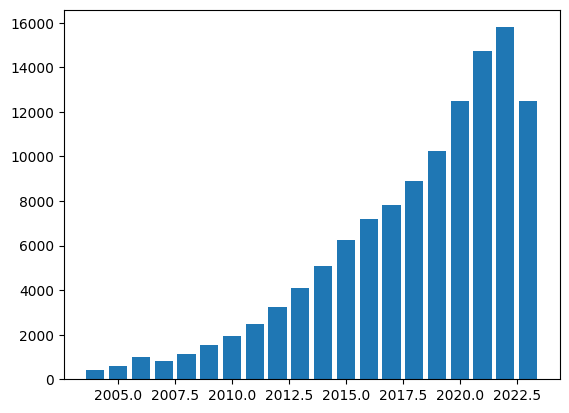

Davide Bacciu
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


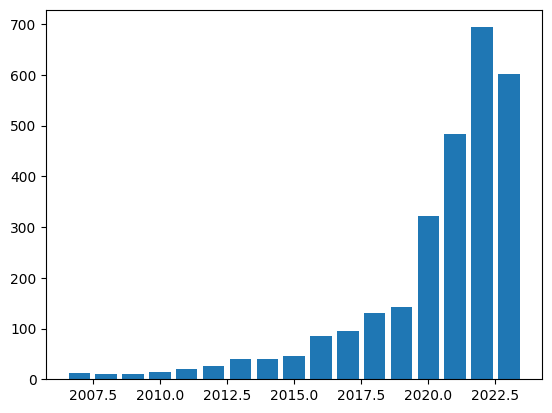

Yiman Zhang
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


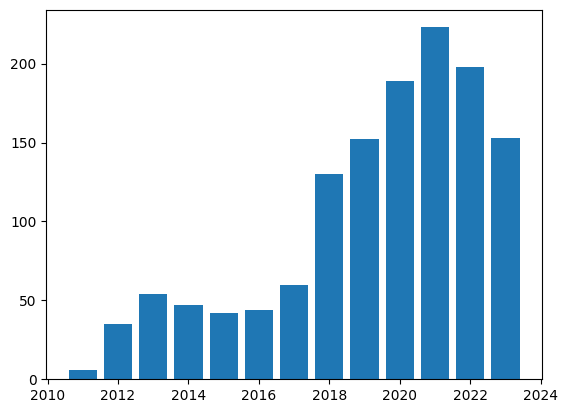

Tianyi Wu
[2019, 2020, 2021, 2022, 2023]


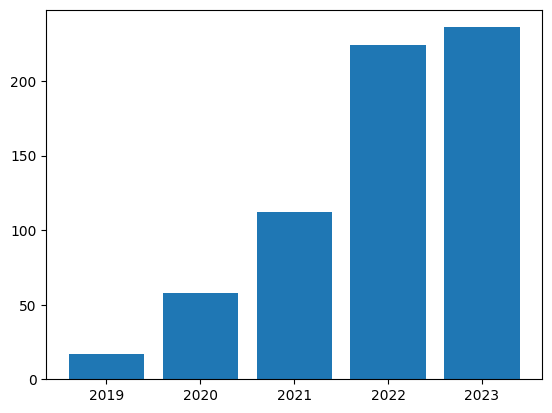

Dimitri Perrin
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


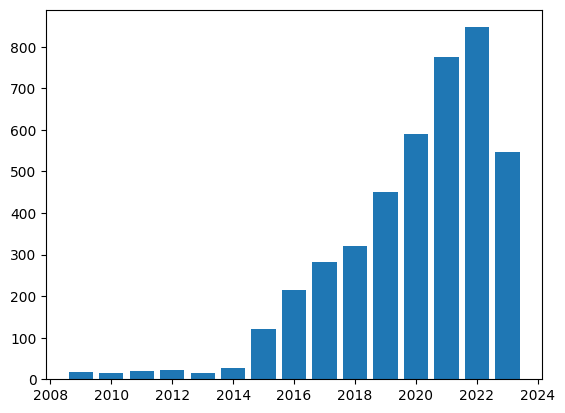

Tianyuan Zhang
[2019, 2020, 2021, 2022, 2023]


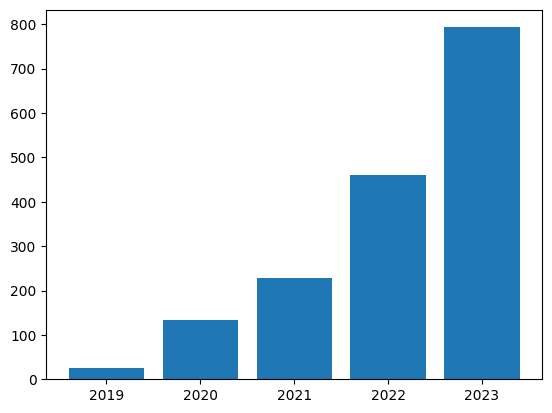

Rajesh Sharma
[1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


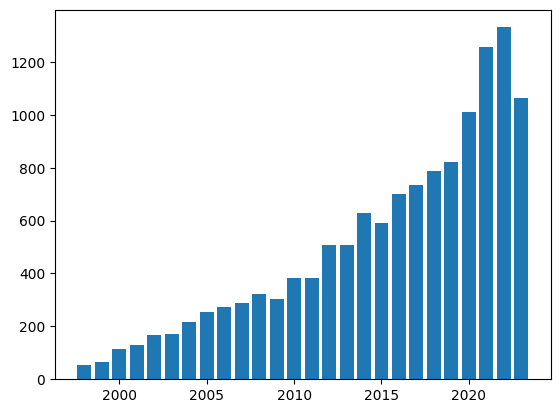

Yuzhe Yang
[2018, 2019, 2020, 2021, 2022, 2023]


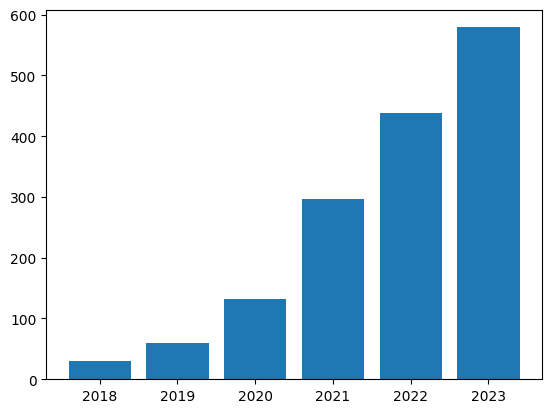

Wesley Nunes Gonçalves
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


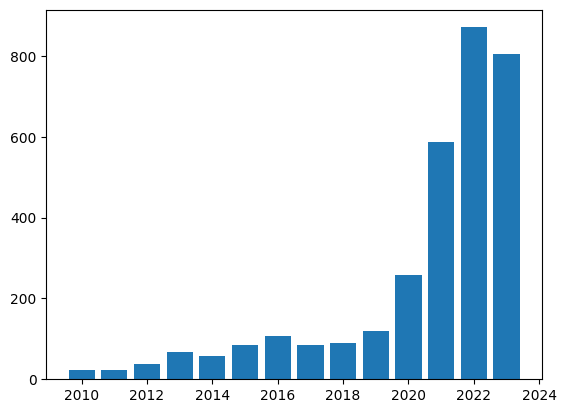

Riqiang Gao
[2018, 2019, 2020, 2021, 2022, 2023]


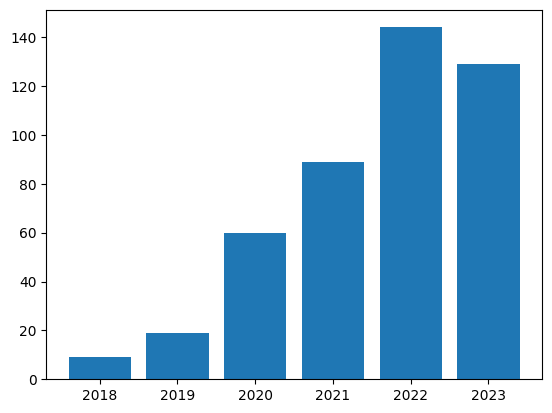

Chaehwa Yoo
[2019, 2020, 2021, 2022, 2023]


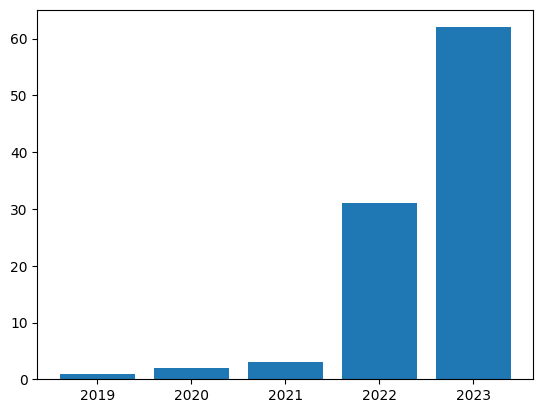

Ting Liu
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


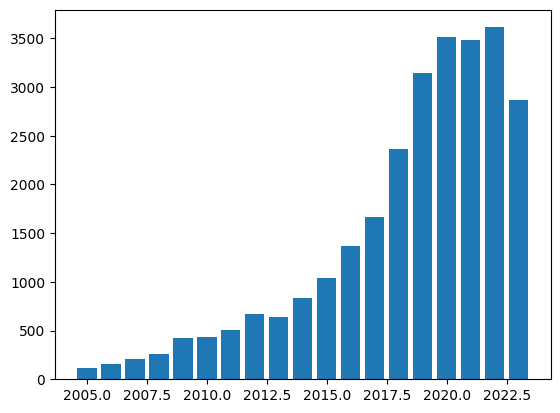

Md Mustafizur Rahman
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


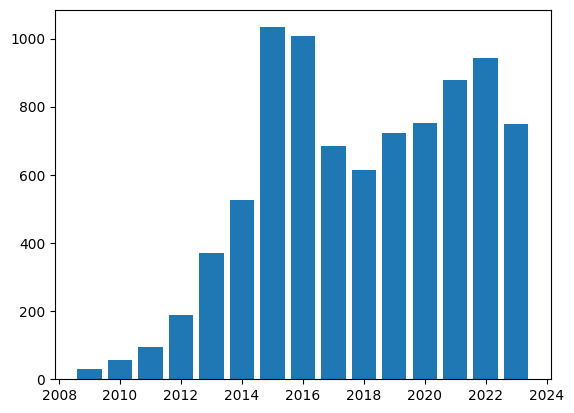

Guanbin Li
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


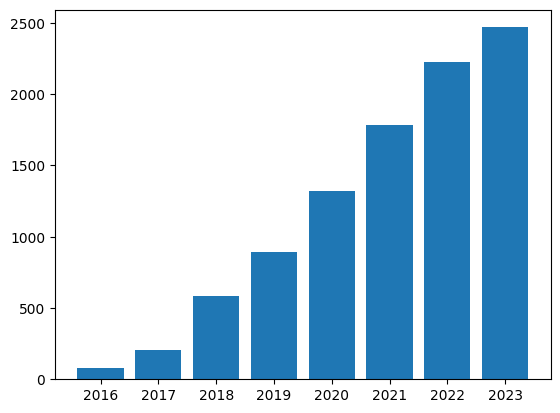

Hong-Yi Wang
[2018, 2019, 2020, 2021, 2022, 2023]


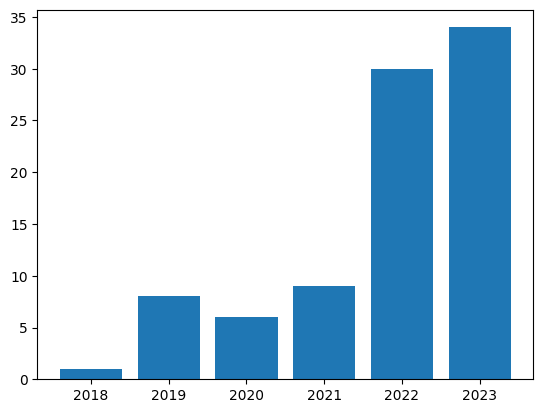

Chunjing Xu
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


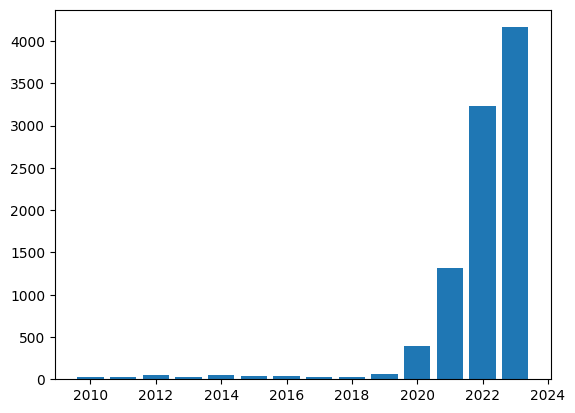

Tianqi Chen
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


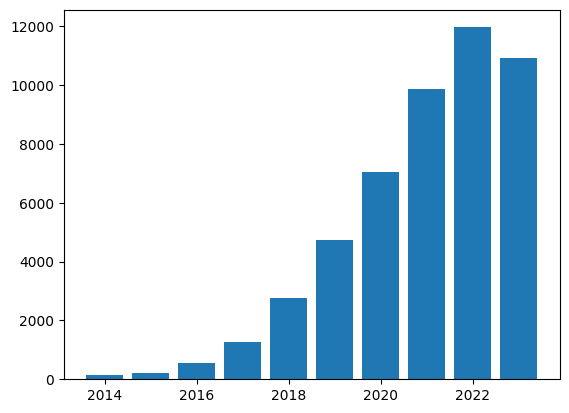

Songsong Tian
[2021, 2022, 2023]


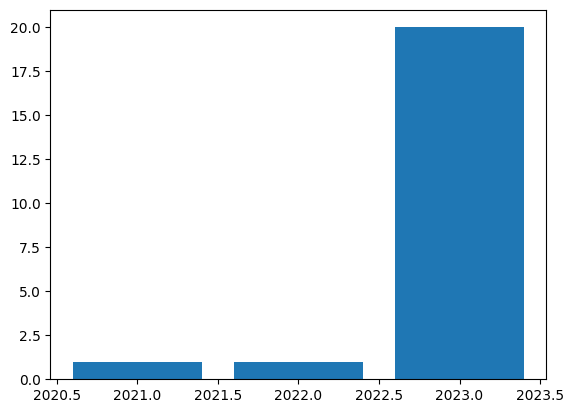

Zeinab Rahimi
[2020, 2021, 2022, 2023]


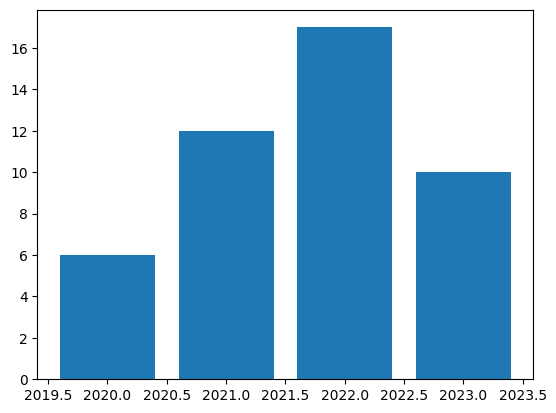

Xin Du
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


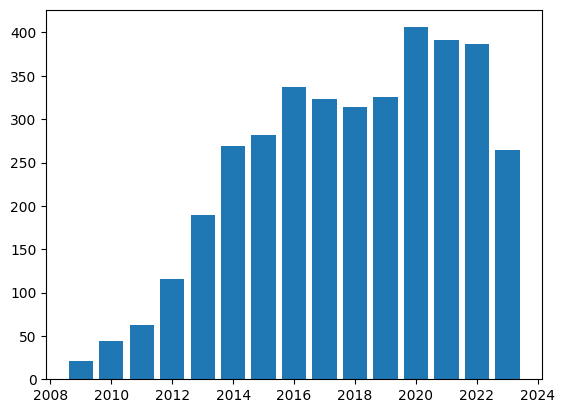

Christoph Hoog Antink
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


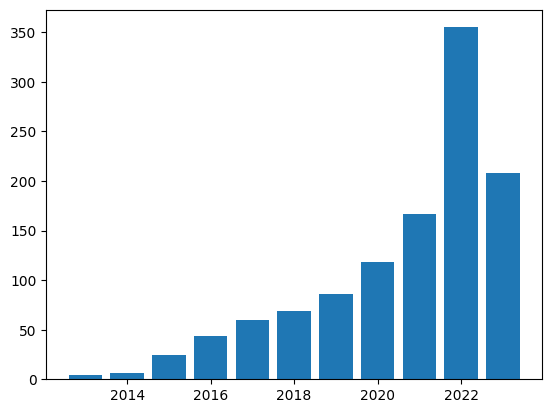

Tony X. Han
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


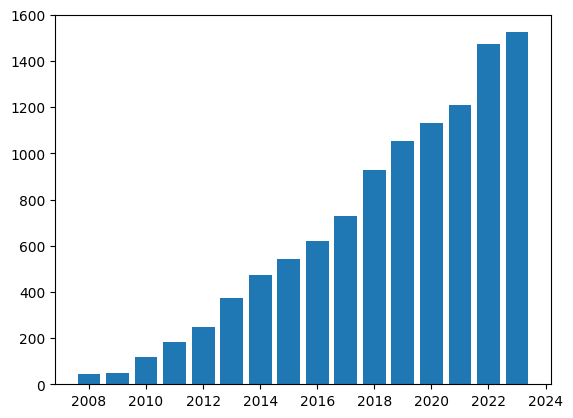

Vladimir Kolmogorov
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


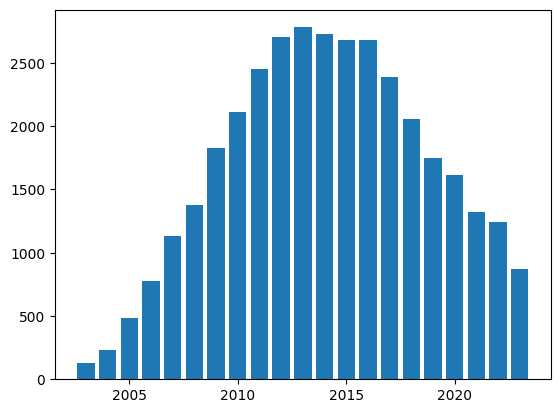

Joydeep Ghosh
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


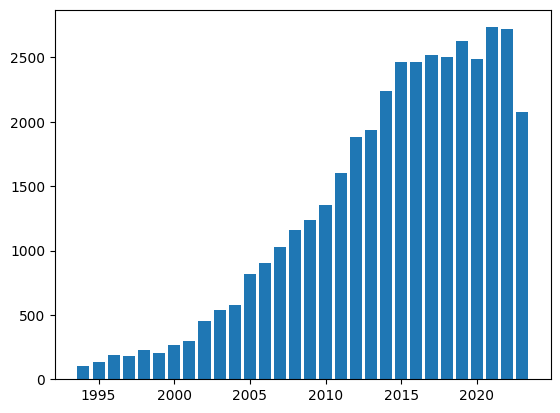

Ph. D
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


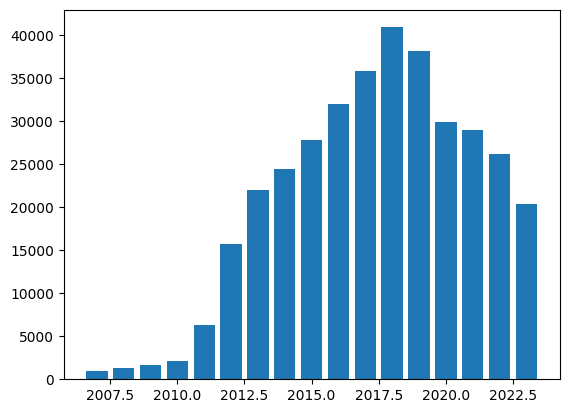

Pierre Guetschel
[]


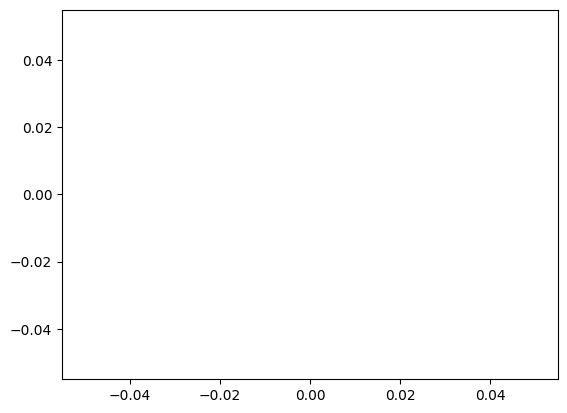

Xuezhi Wang
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


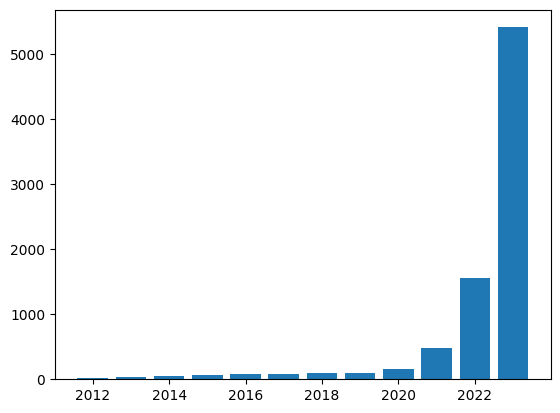

Mihalis A. Nicolaou
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


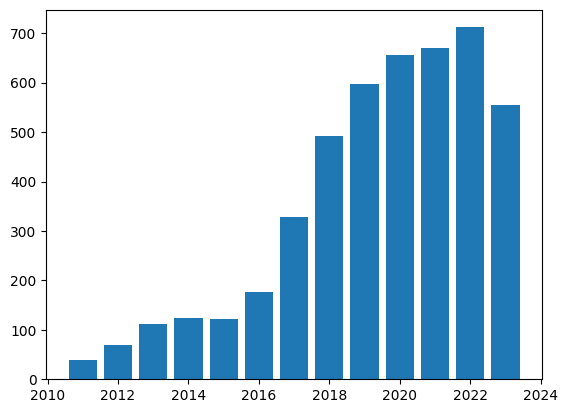

Paul Landes
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


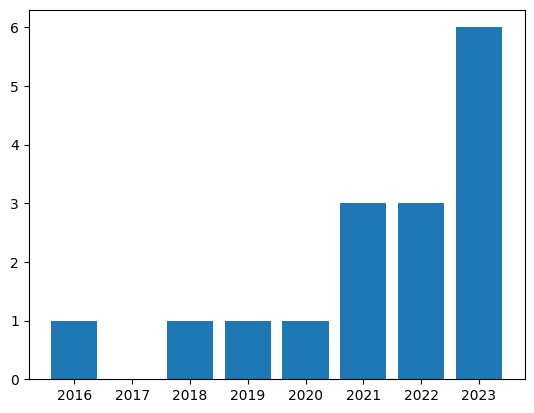

Chuan Wu
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


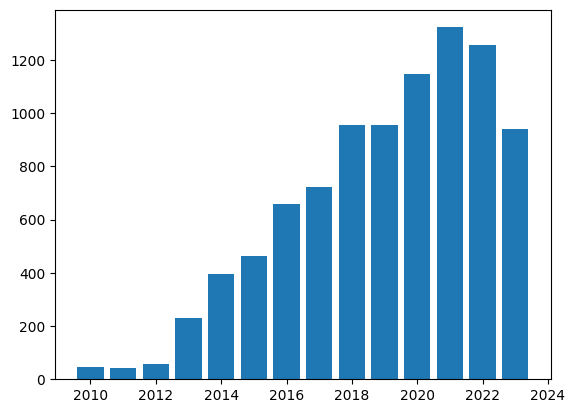

Bo Li
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


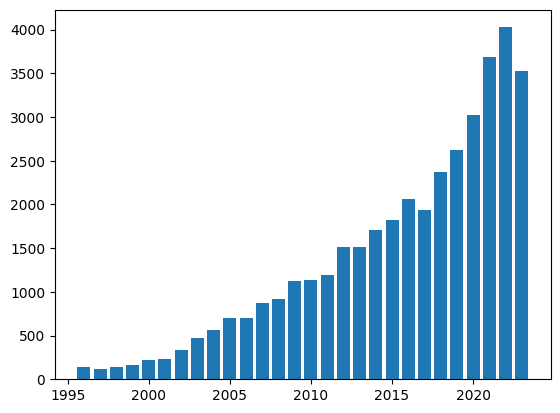

Ozan Sonmez
[2020, 2021, 2022, 2023]


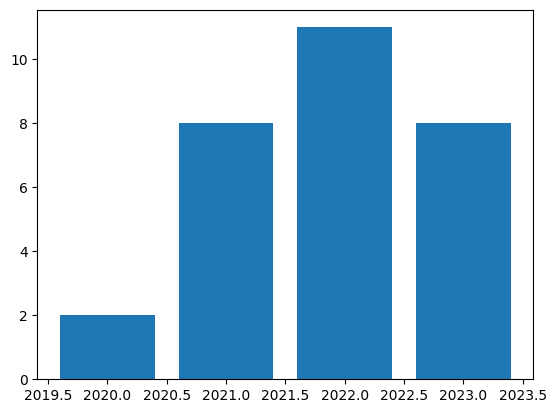

Bo Yang
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


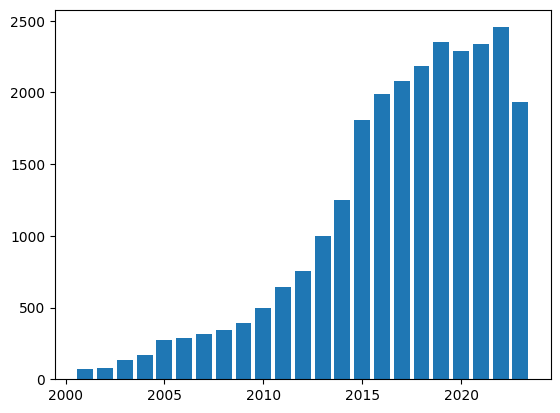

Senwei Liang
[2019, 2020, 2021, 2022, 2023]


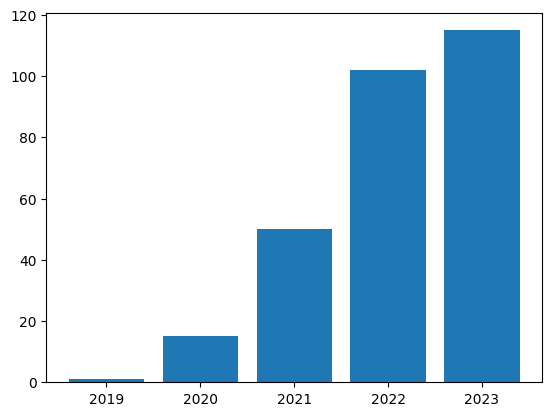

Minguk Kang
[2020, 2021, 2022, 2023]


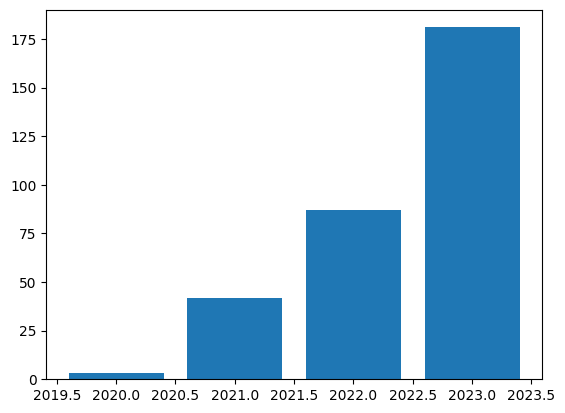

Wanyi Zhu
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


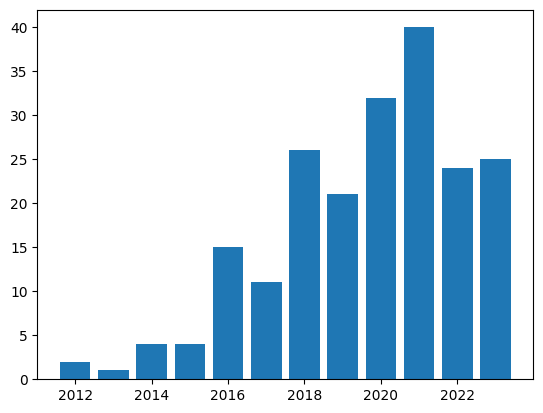

T. S. Jayram
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


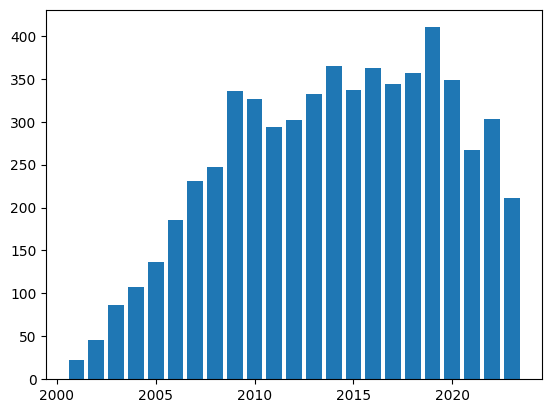

Anton Milan
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


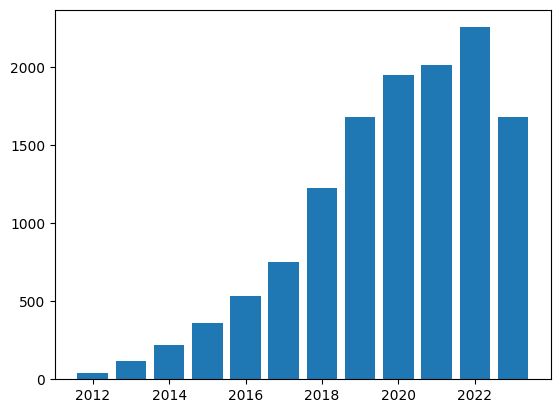

Rong Jin
[1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


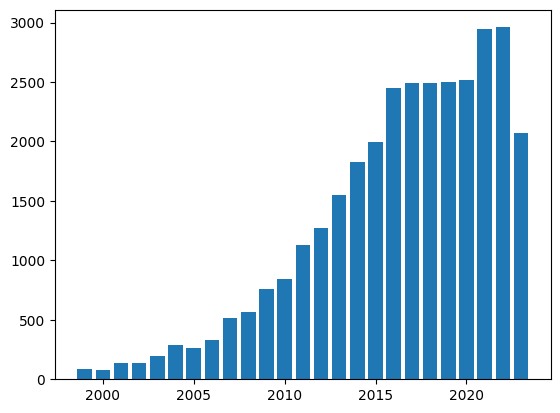

Anh Nguyen
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


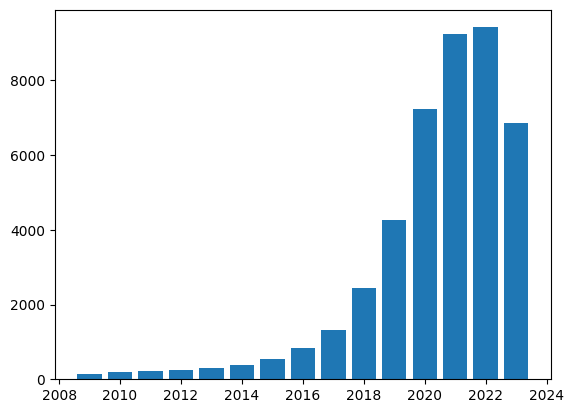

Christian Wachinger
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


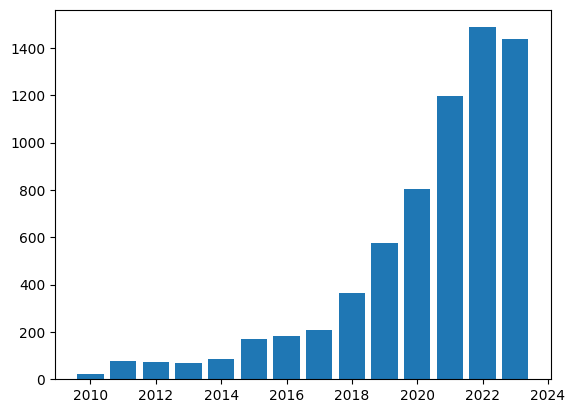

Md Shariful Islam
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


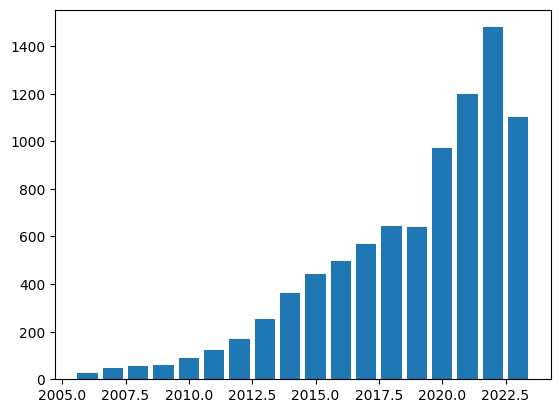

Jun Jia
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


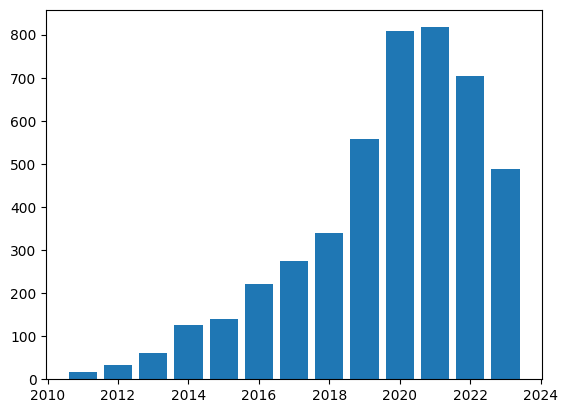

Hai Wang
[1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


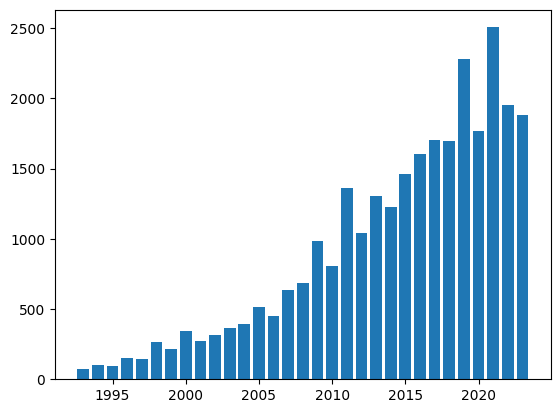

Shengyu Hao
[2019, 2020, 2021, 2022, 2023]


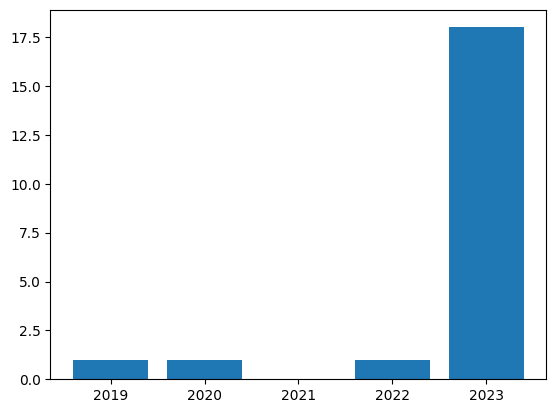

Ziyang Huang
[2021, 2022, 2023]


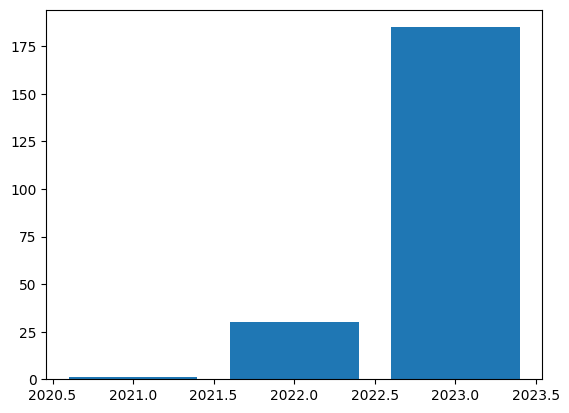

Dhruv Shah
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


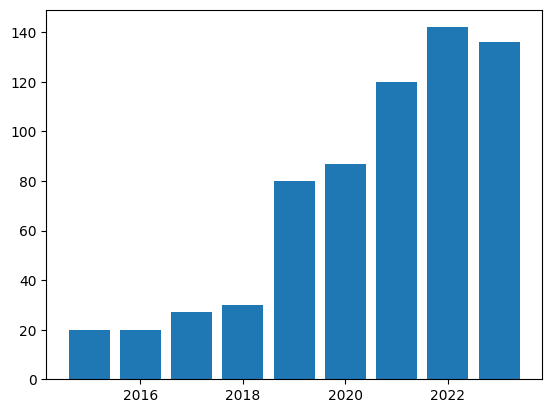

Alejandro Jaimes
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


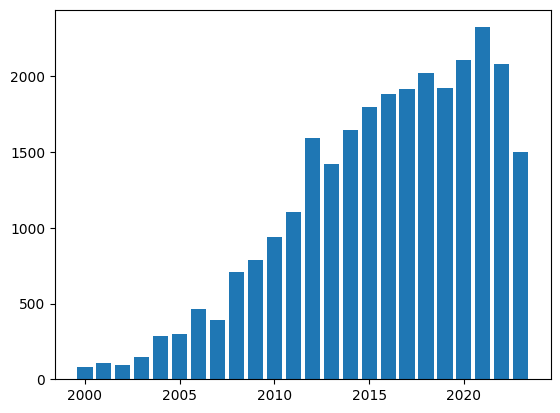

Fernando De la Prieta
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


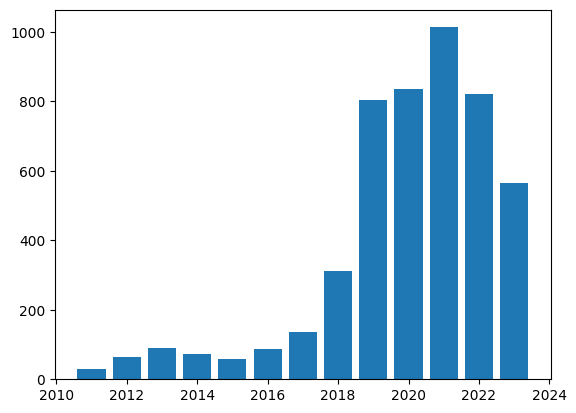

Zhe Zhao
[1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


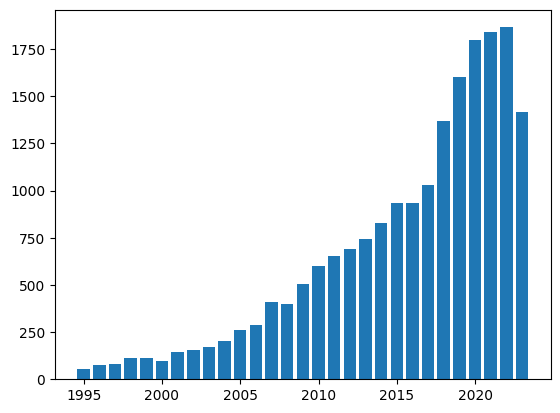

Ulku Meteriz-Yildiran
[2019, 2020, 2021, 2022, 2023]


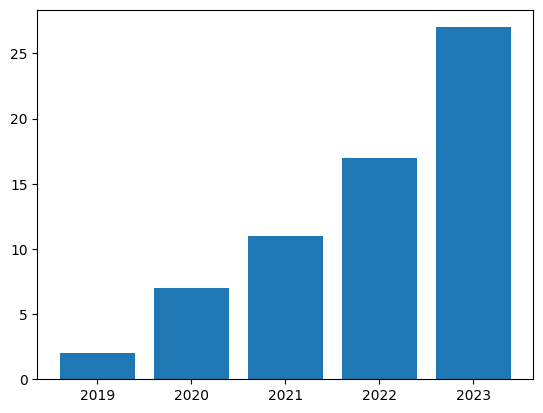

Hongying Liu
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


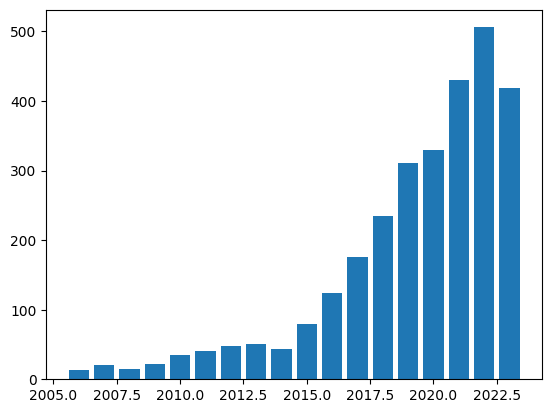

Chongyang Bai
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


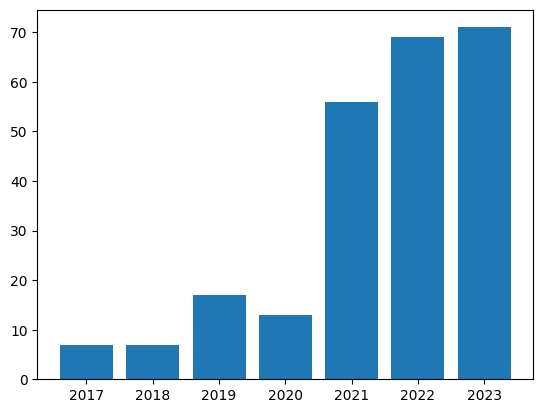

Xianfeng Gu
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


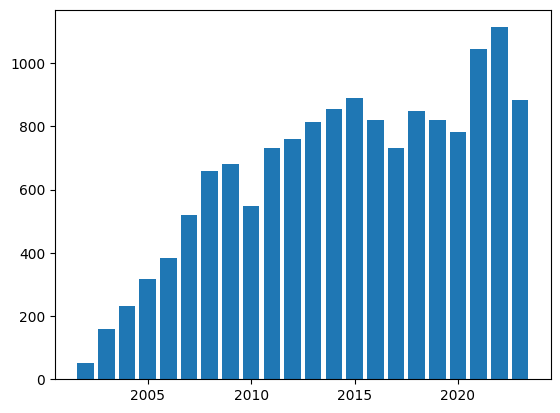

Matiur Rahman Minar
[2018, 2019, 2020, 2021, 2022, 2023]


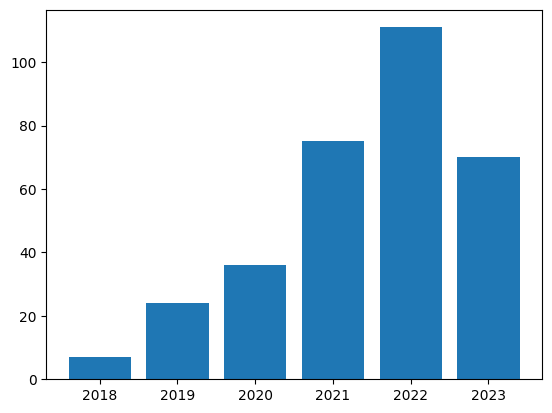

Mikhail Salnikov
[2020, 2021, 2022, 2023]


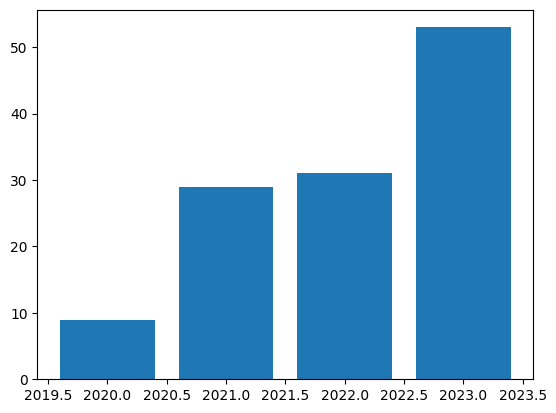

Shankar Banik
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


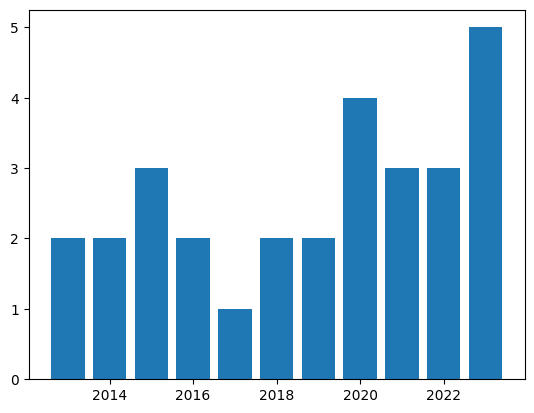

Weiwei Deng
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


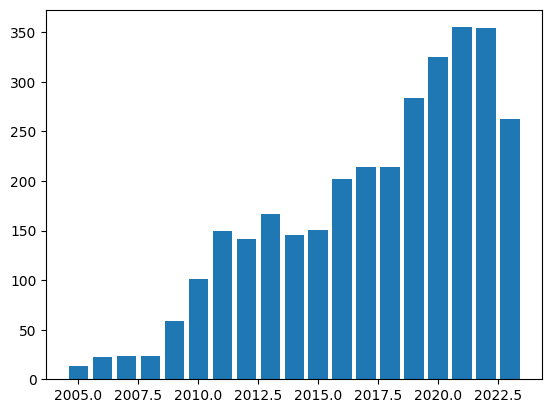

Ge Li
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


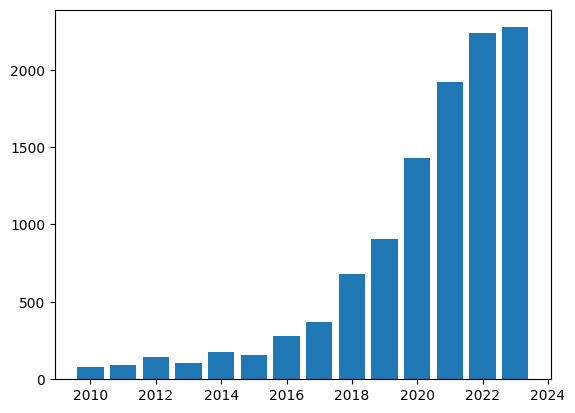

Fang Wang
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


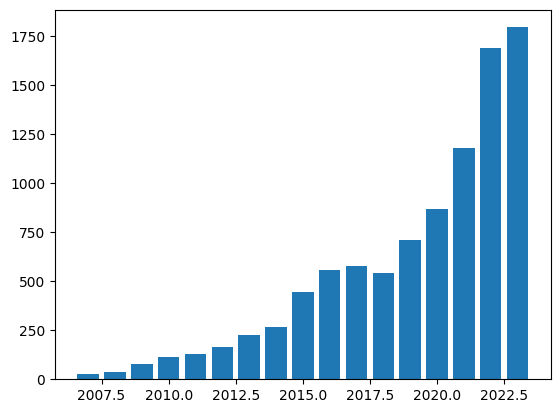

Nhan Cach Dang
[1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


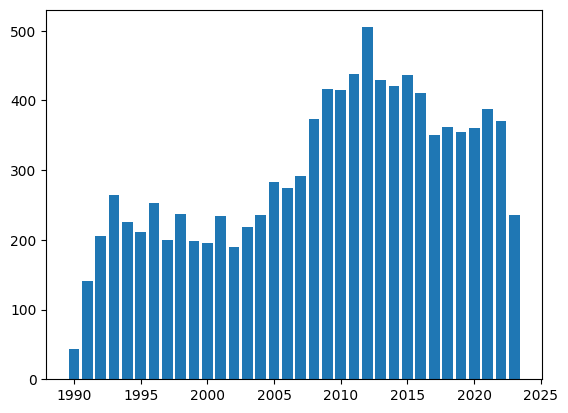

Sofia Rizou
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


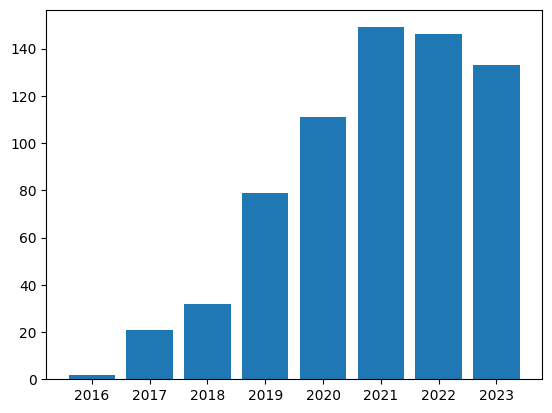

Yuang Liu
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


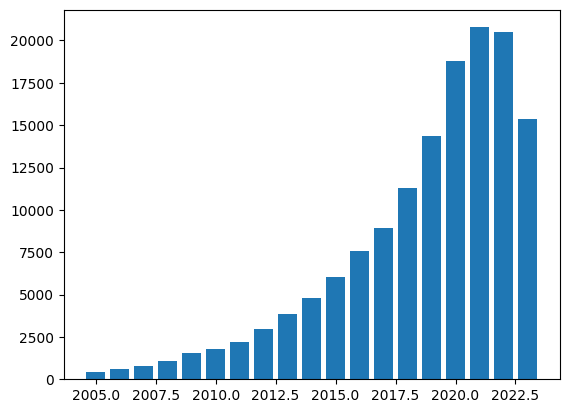

Chunmei Wang
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


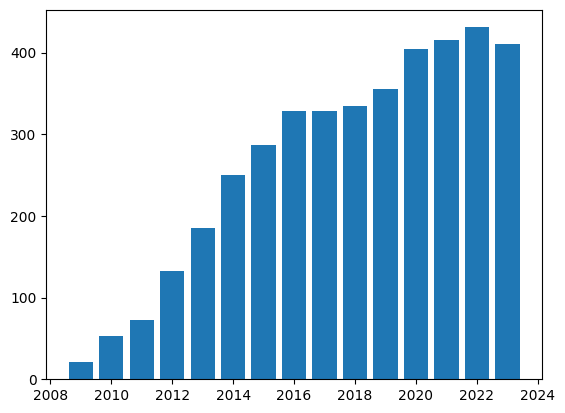

Saif M. Mohammad
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


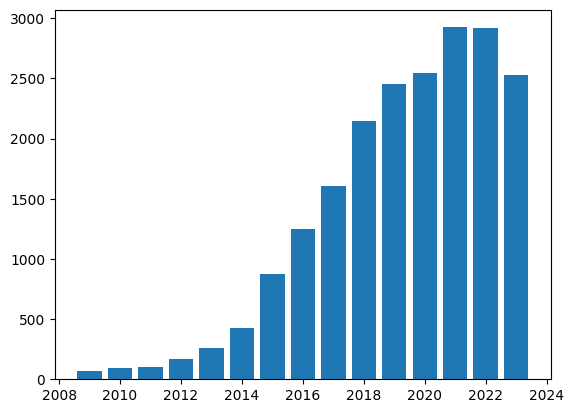

Xingjun Wang
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


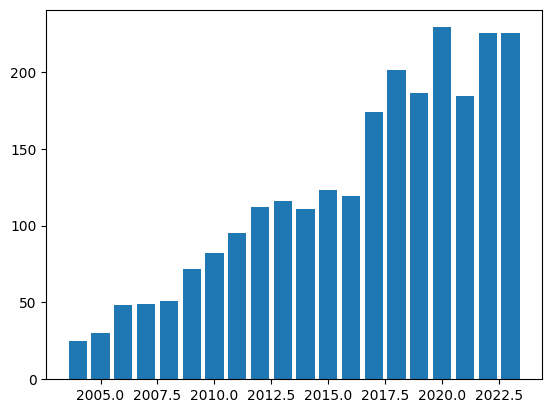

Ebadollah Taheri
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


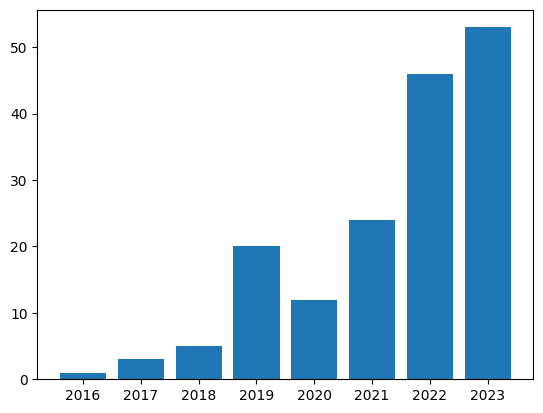

Jiawei Zhang
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


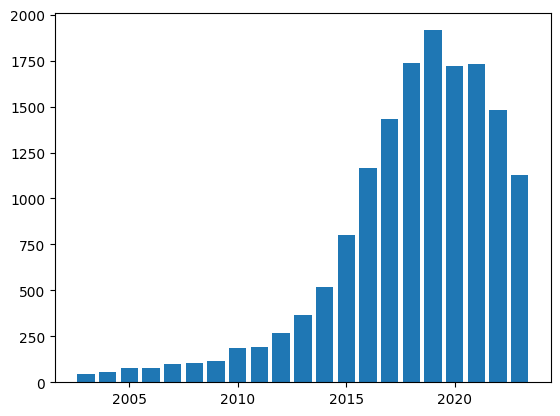

Yuhang Li
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


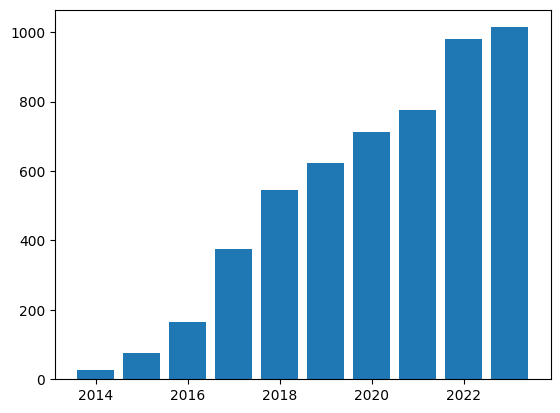

Robert Schreiber
[1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


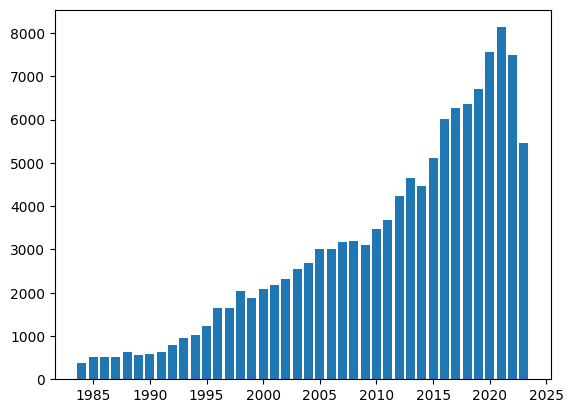

Toan Nguyen
[1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


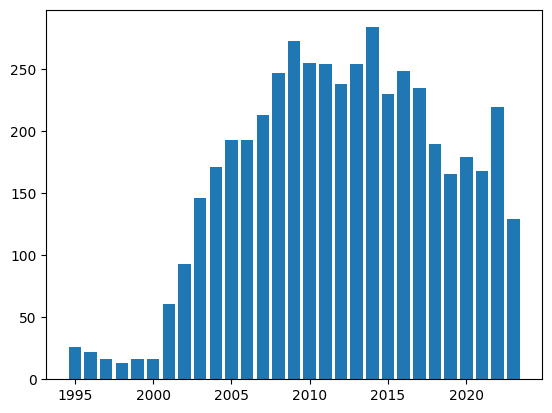

Sarvesh Patil
[2020, 2021, 2022, 2023]


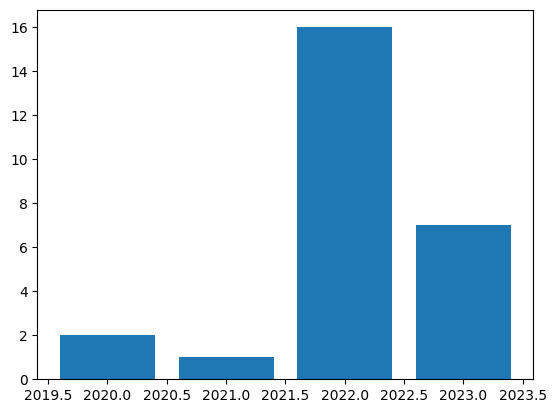

Friedrich Fraundorfer
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


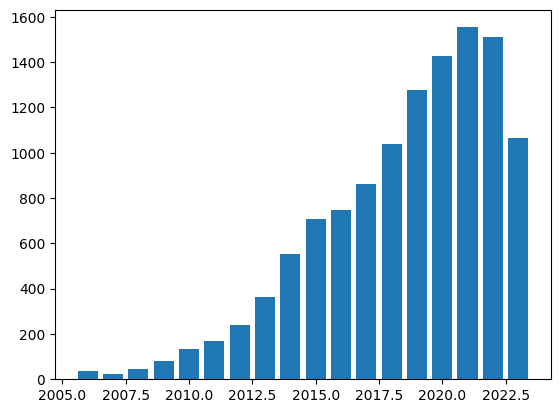

Yue Yu
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


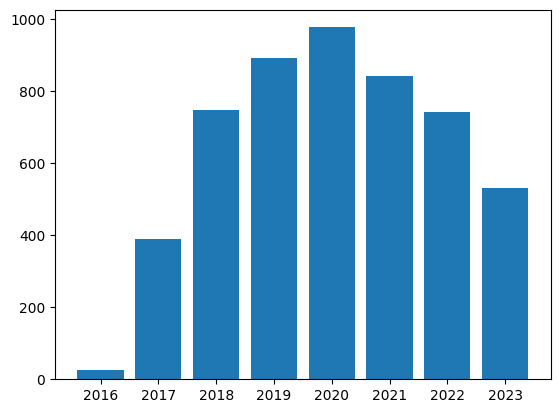

Yidan Zhang
[2018, 2019, 2020, 2021, 2022, 2023]


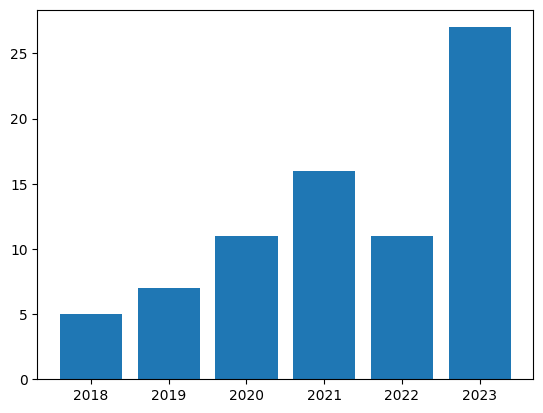

Thiago Serra
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


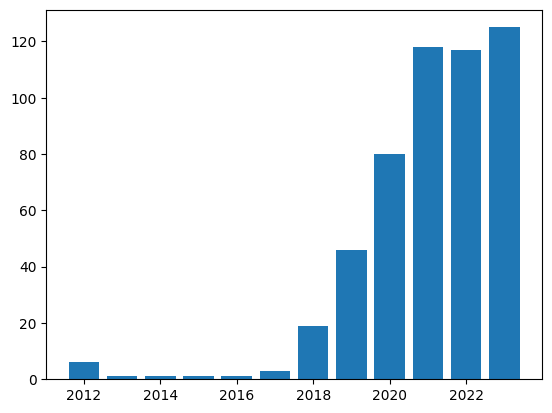

Kevin Lybarger
[2018, 2019, 2020, 2021, 2022, 2023]


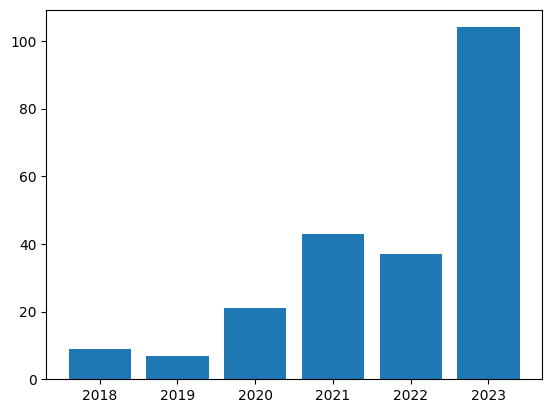

Hanzi Mei
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


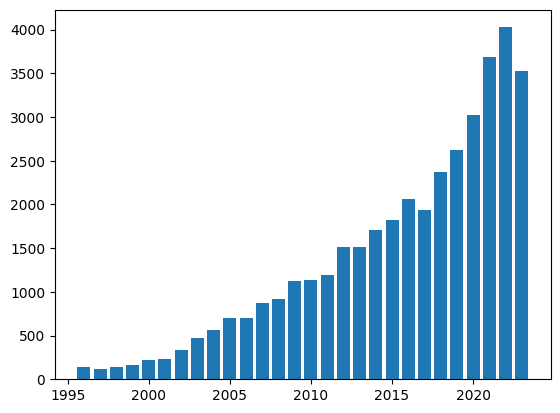

Qiyuan Dai
[2022, 2023]


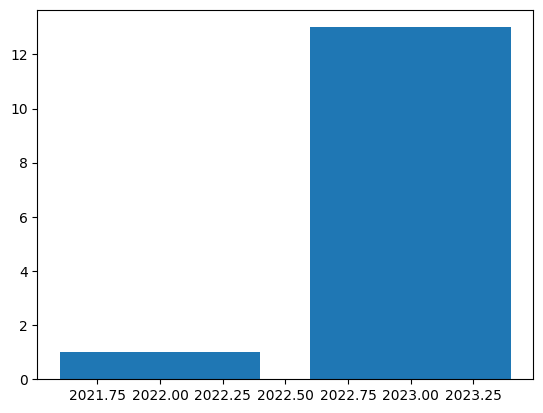

Chris Hankin
[1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


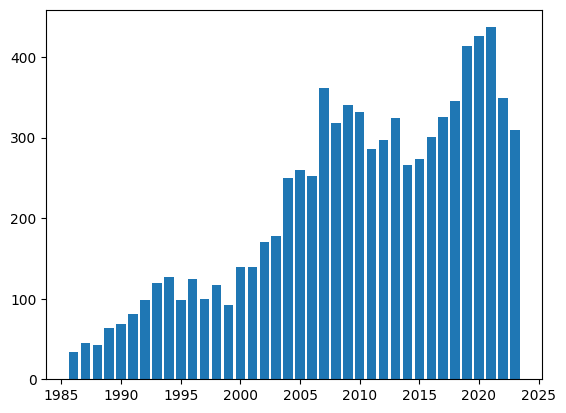

Yan Zhuang
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


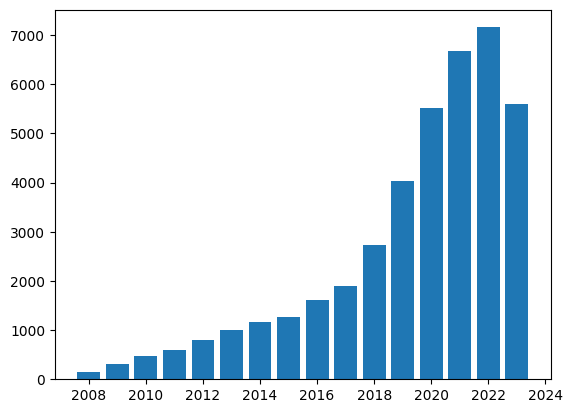

Lei Cui
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


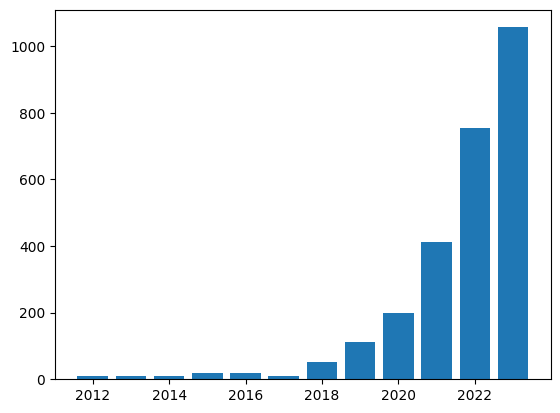

Arnulf Jentzen
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


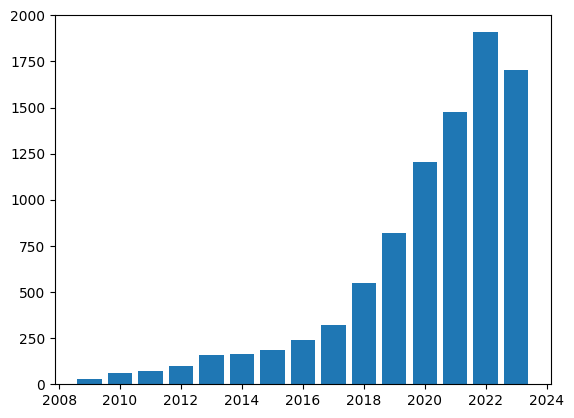

Xiaoming Chen
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


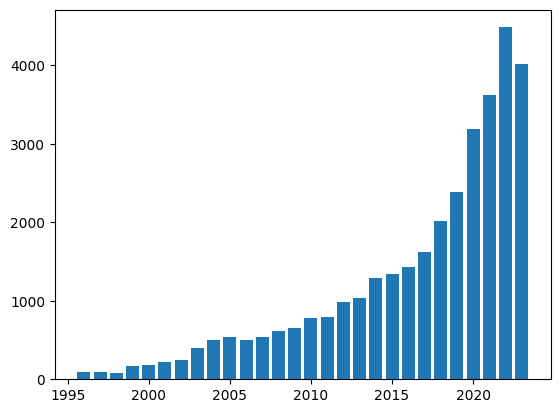

Mengyue Wu
[2019, 2020, 2021, 2022, 2023]


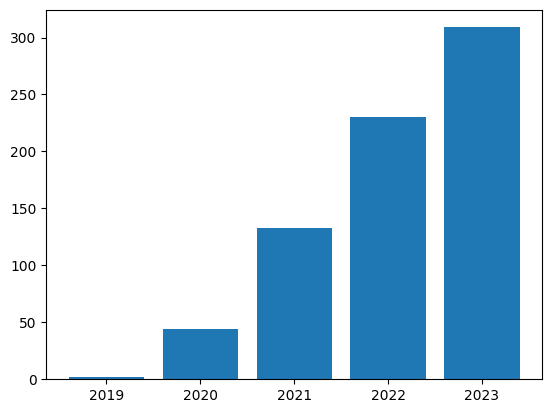

Novanto Yudistira
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


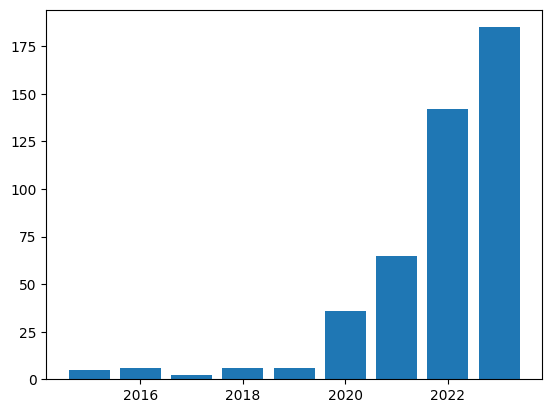

Leonard Lausen
[2018, 2019, 2020, 2021, 2022, 2023]


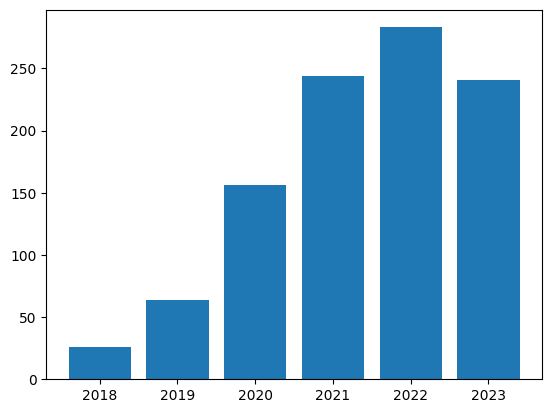

Yipeng Ji
[2021, 2022, 2023]


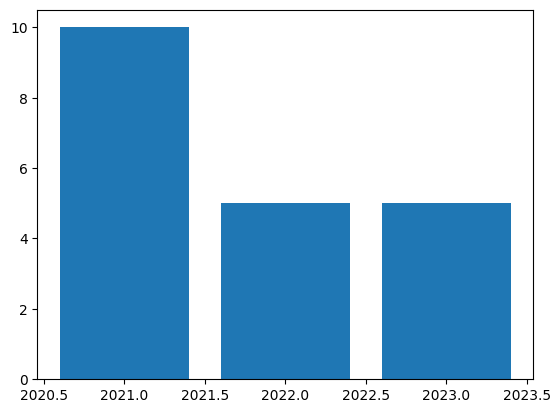

Jeremy Lynch
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


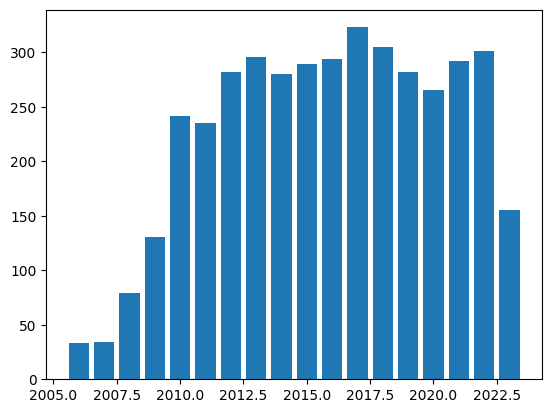

Wei Liu
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


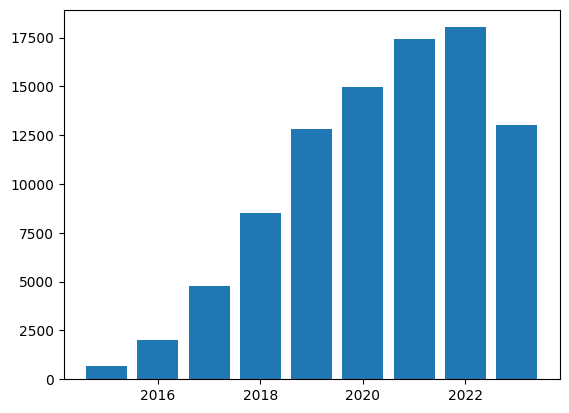

Jie Zhao
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


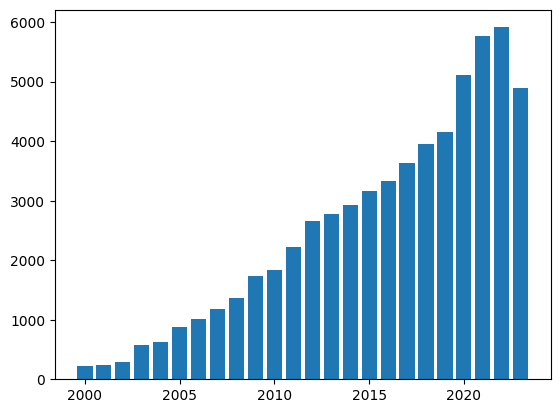

Caglar Tirkaz
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


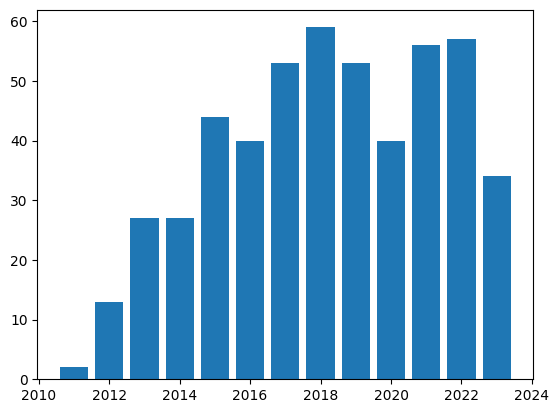

Alireza Fathi
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


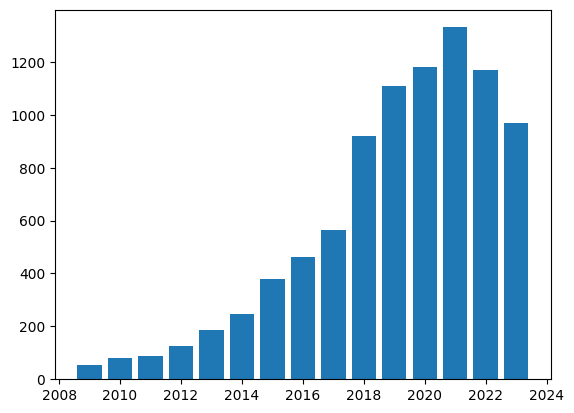

Matteo Matteucci
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


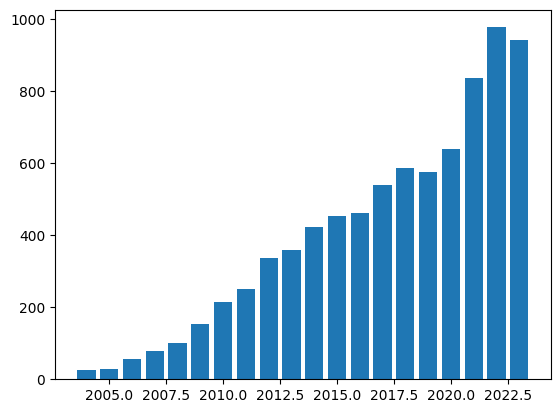

Saket Anand
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


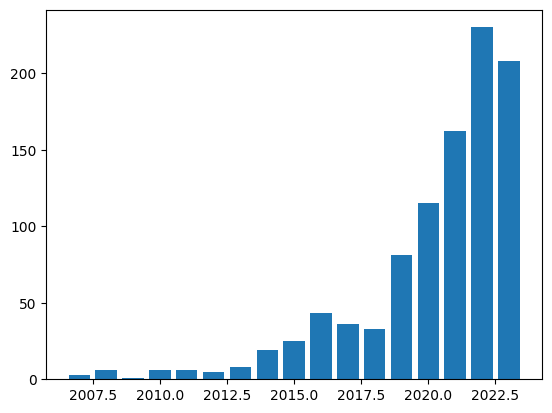

David Bestor
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


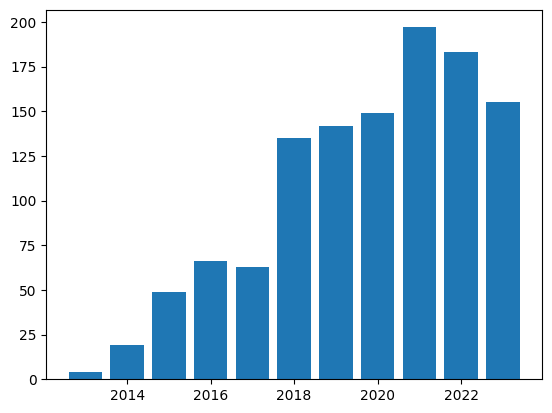

Xiao Xiang Zhu
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


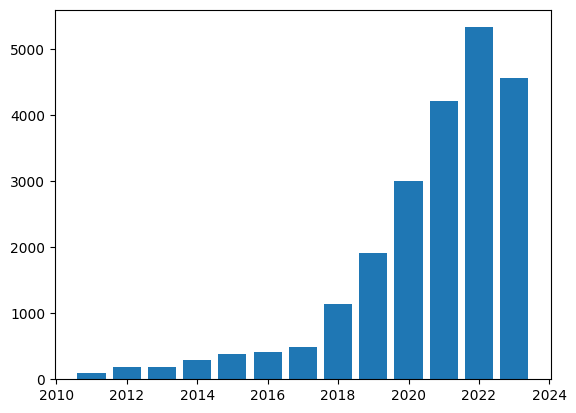

Valentina Popescu
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


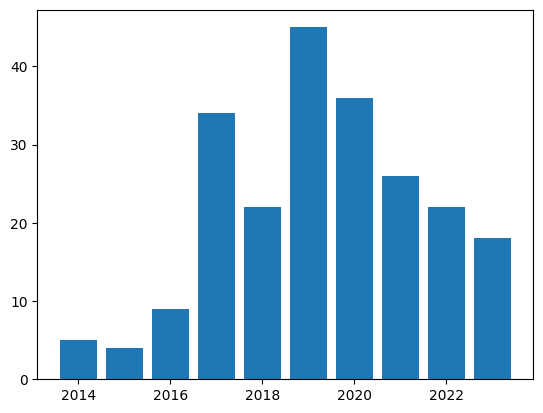

Yiming Chen
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


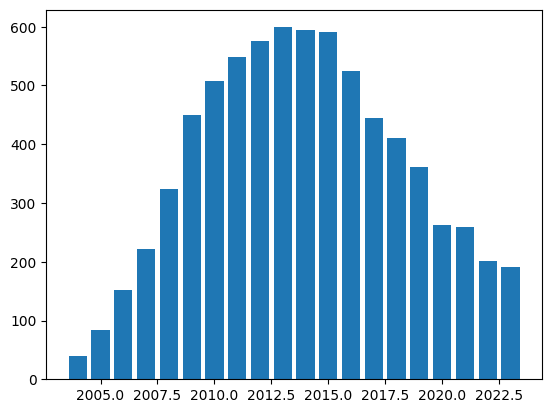

Yang Deng
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


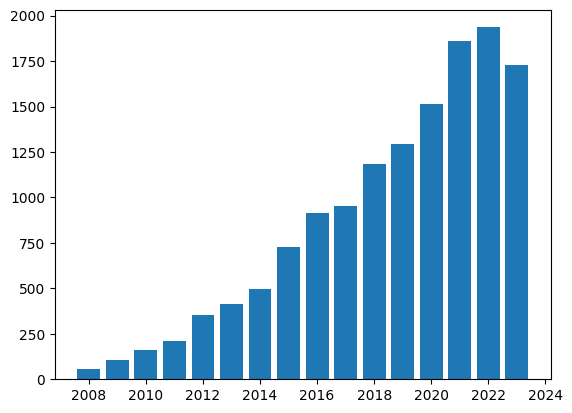

Taojiannan Yang
[2020, 2021, 2022, 2023]


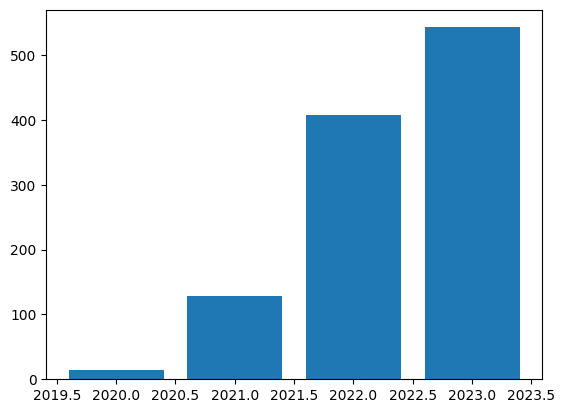

Han Li
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


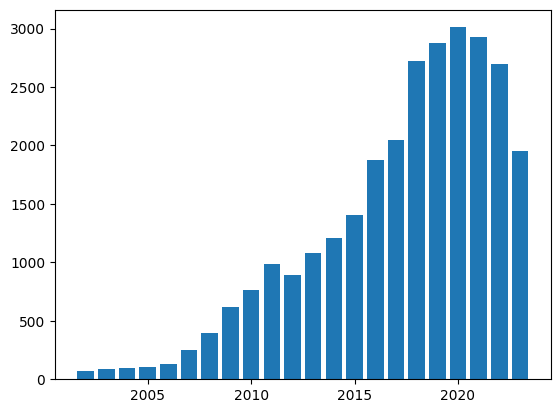

Mingli Ding
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


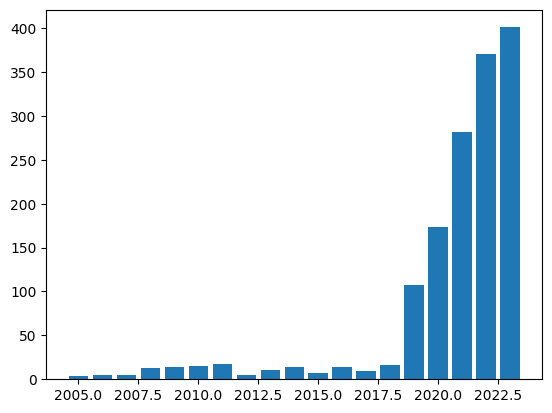

James Sharpnack
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


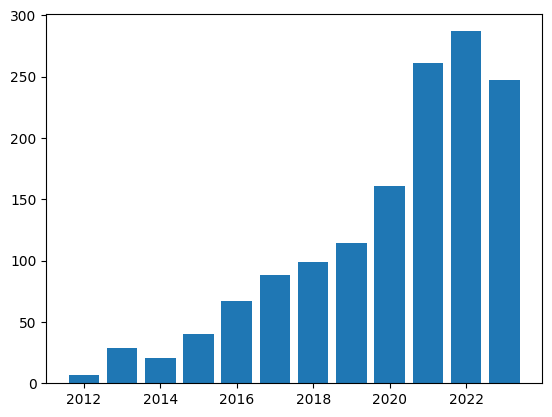

Raju S. Bapi
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


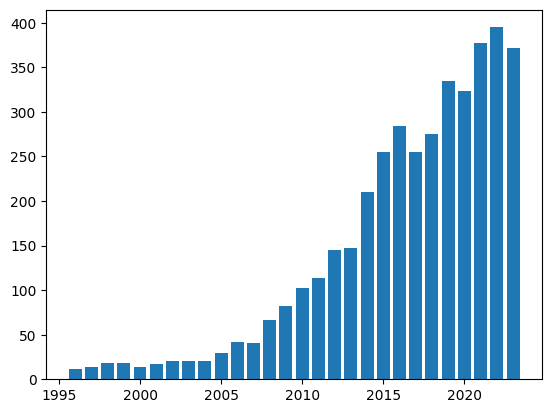

Sangchul Hahn
[2019, 2020, 2021, 2022, 2023]


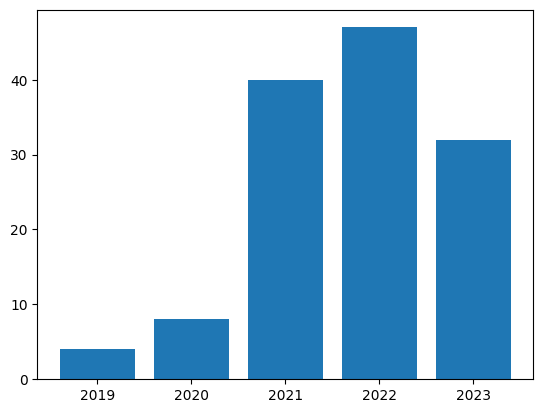

Pedro Dal Bianco
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


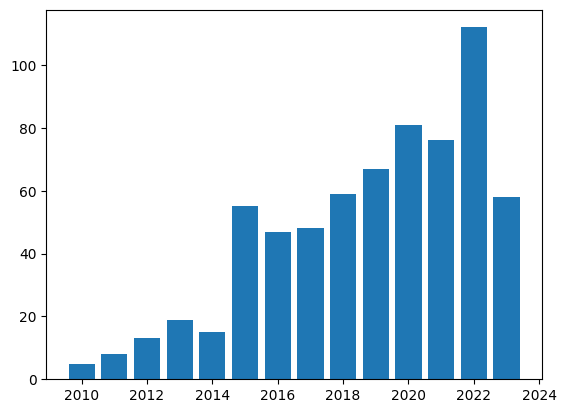

Fouzia Altaf
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


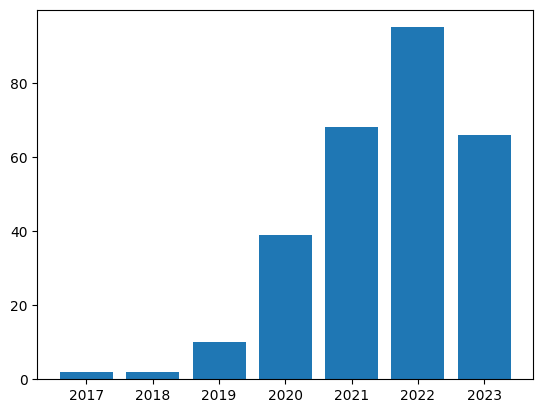

Ashwin Agrawal
[2019, 2020, 2021, 2022, 2023]


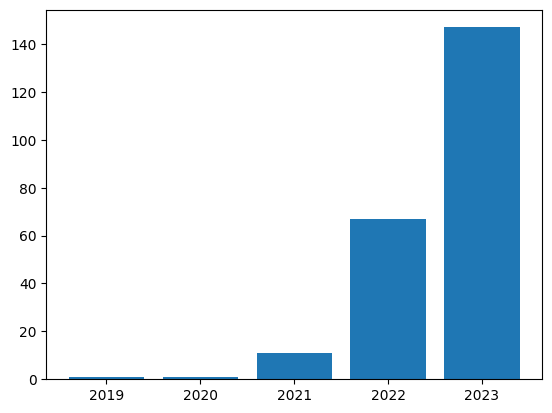

Bharath K. Samanthula
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


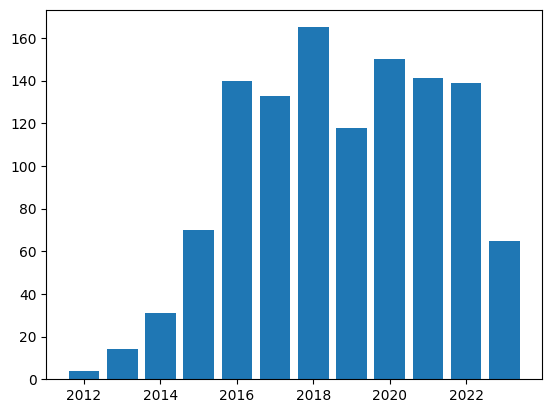

Chandan K. Reddy
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


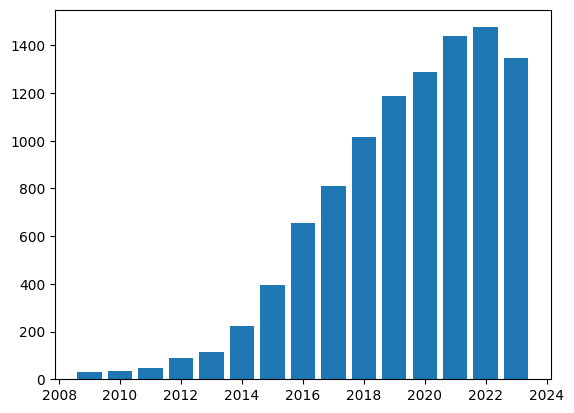

Siqi Yu
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


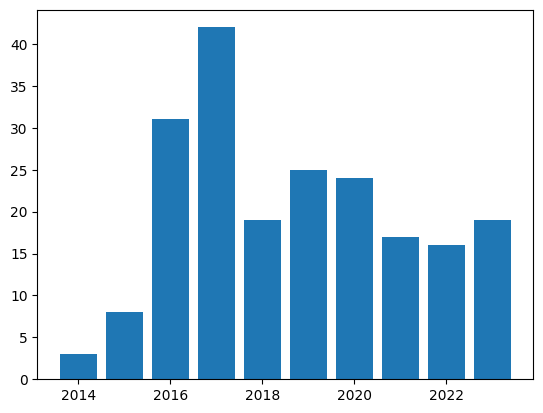

Hang Li
[1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


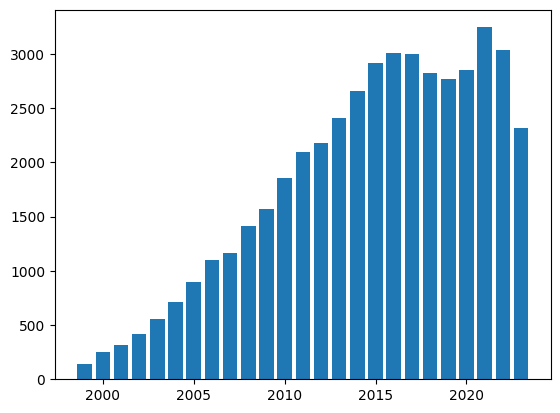

Puneet Agrawal
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


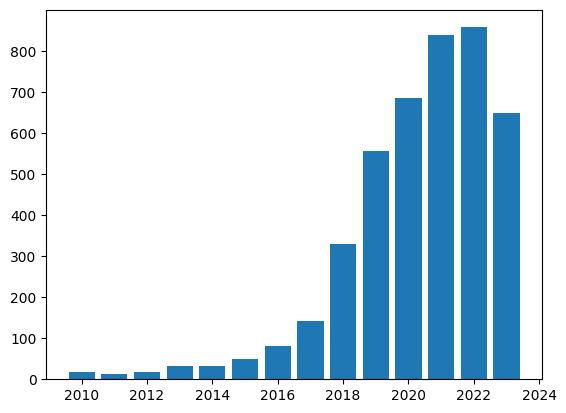

Liping Zhao
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


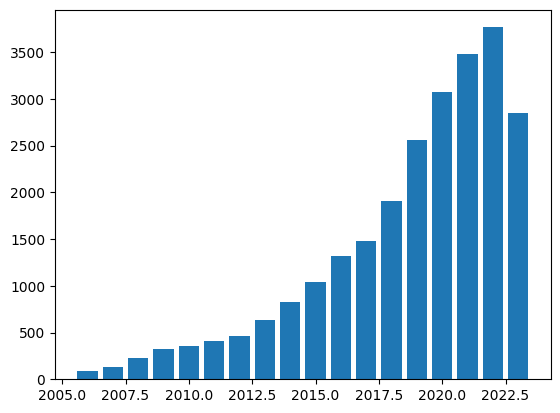

Edward A. Fox
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


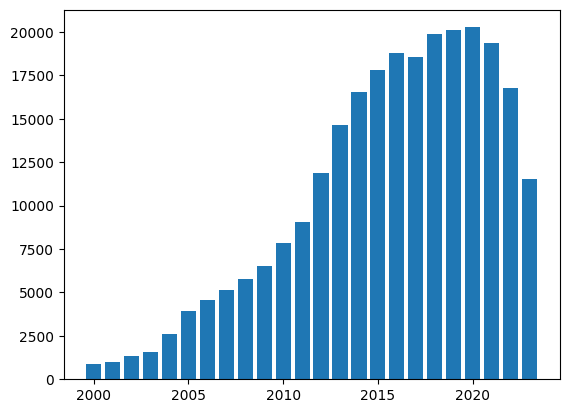

Steven Puttemans
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


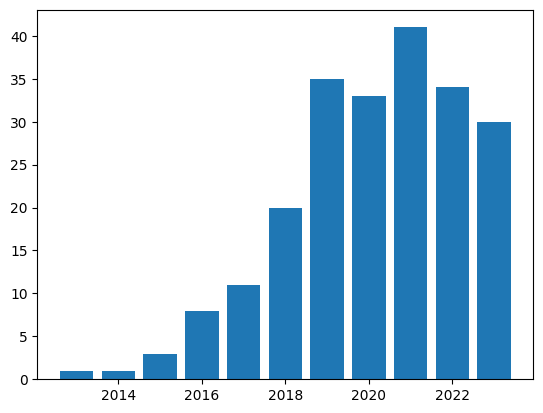

Penghao Jiang
[]


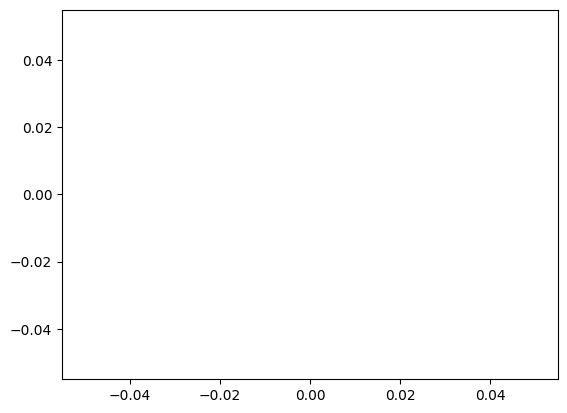

Dorothy Chang
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


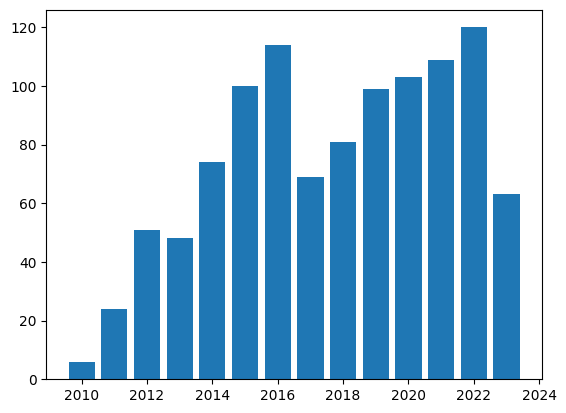

David Picard
[1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


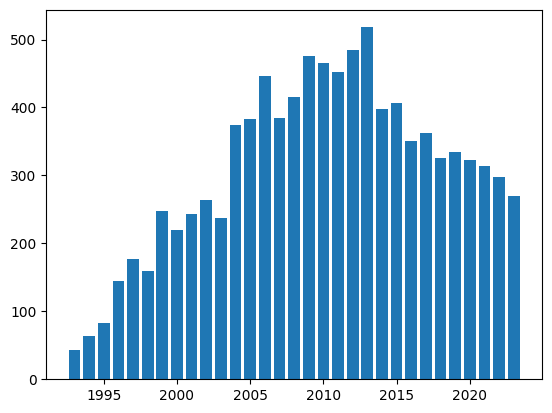

Hanrui Wang
[2018, 2019, 2020, 2021, 2022, 2023]


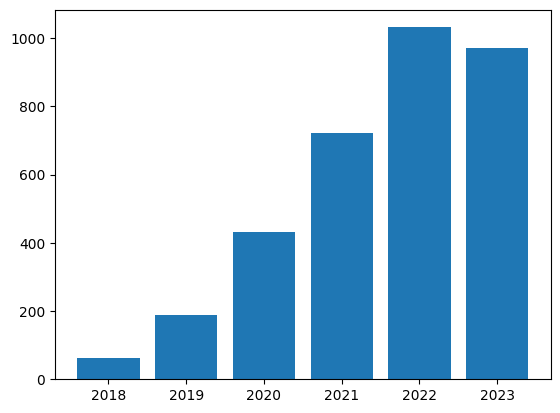

Pierre Baldi
[1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


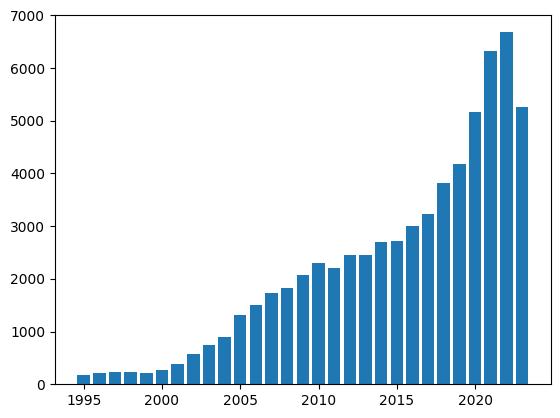

Ayoung Kim
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


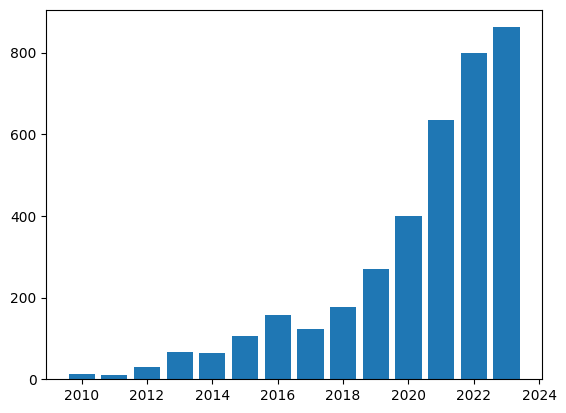

John D. Kelleher
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


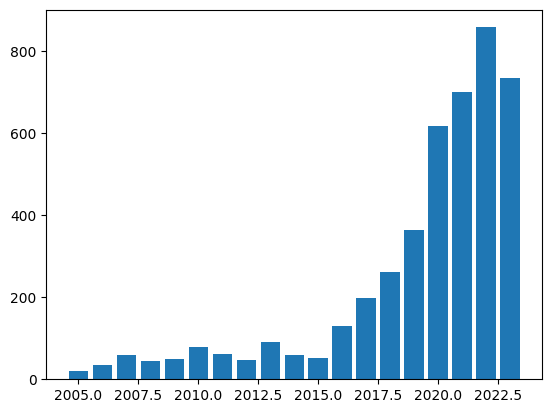

Stefano Pedemonte
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


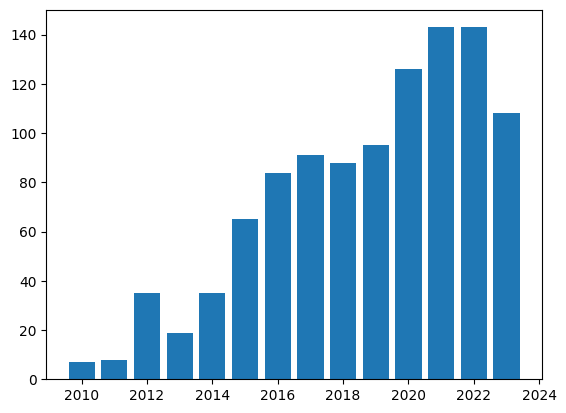

Cho-Jui Hsieh
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


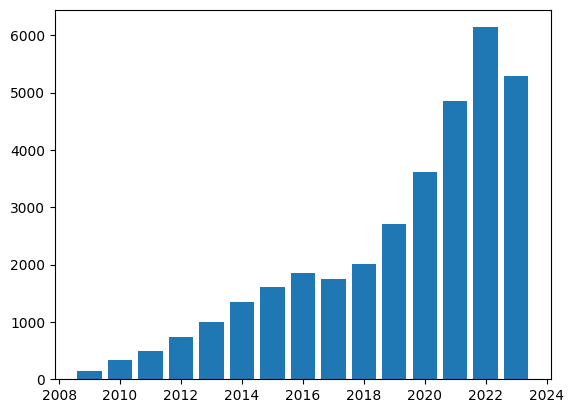

Mathieu Dubois
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


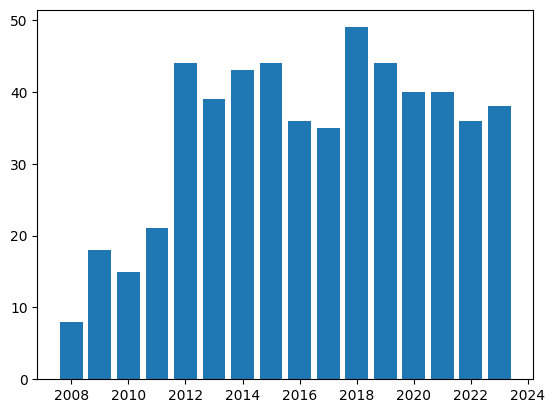

John K. Tsotsos
[1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


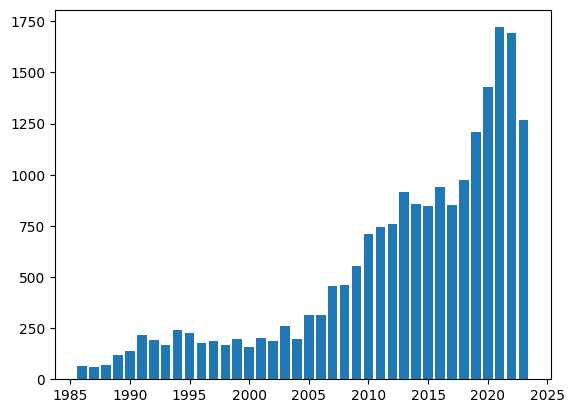

Khaled Rasheed
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


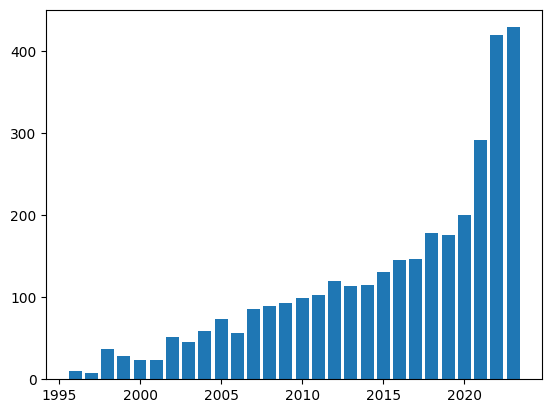

Yehui Tang
[2020, 2021, 2022, 2023]


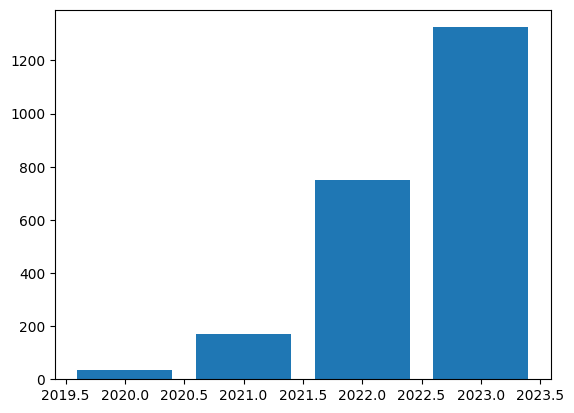

Federico Monti
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


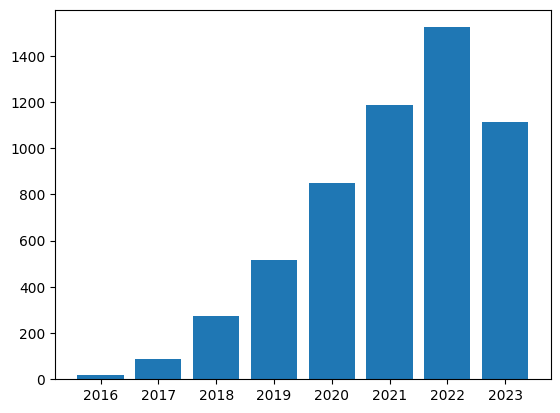

Diana Inkpen
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


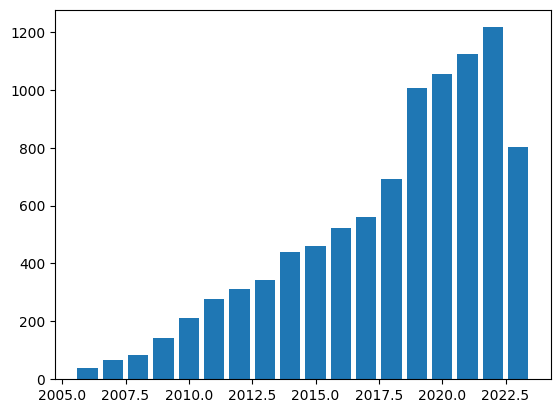

Ovishake Sen
[2020, 2021, 2022, 2023]


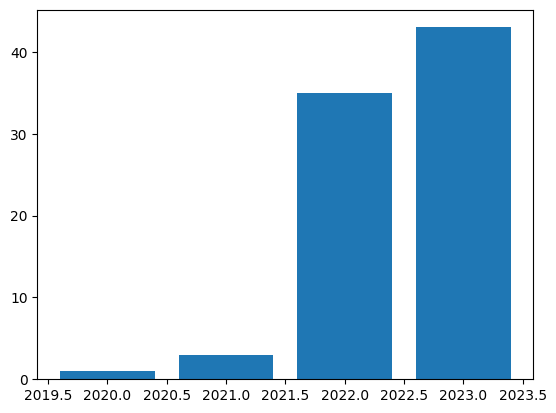

Yue Chen
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


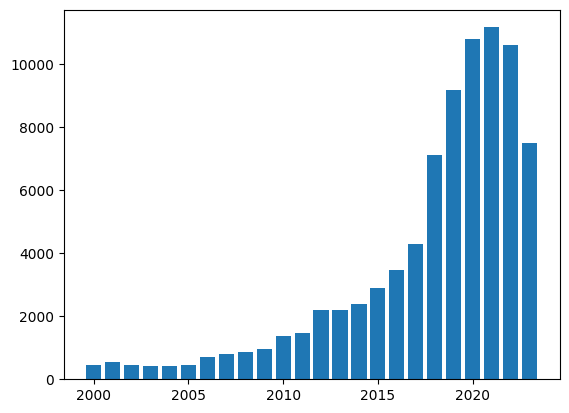

Xiaobo Qu
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


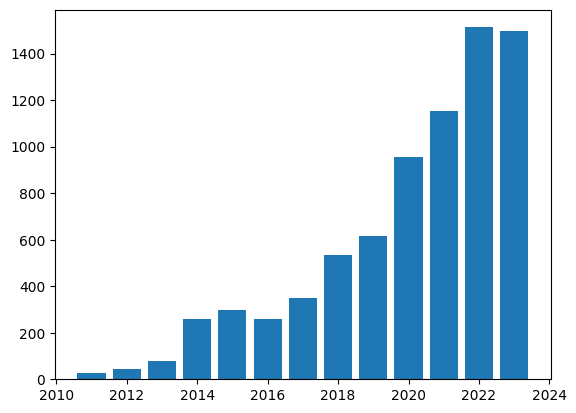

Eli Schwartz
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


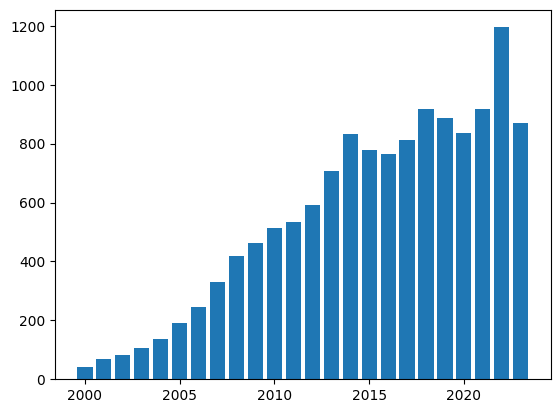

Md Zahangir Alom
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


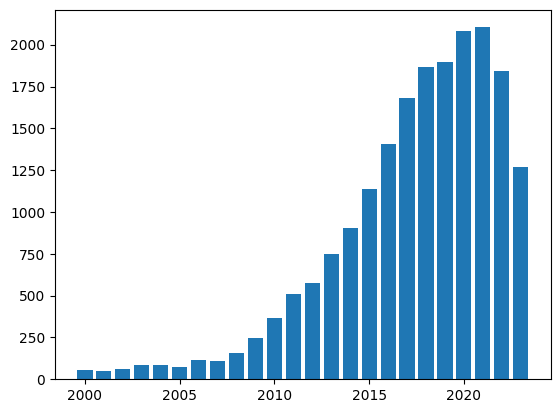

Hanyun Wang
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


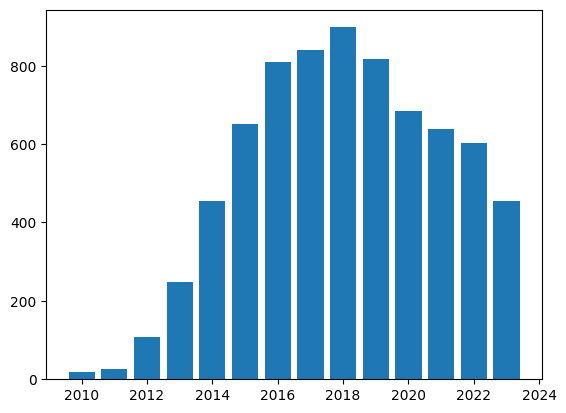

Gen Li
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


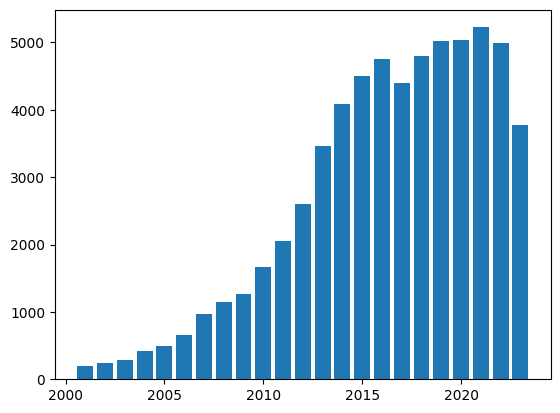

Jesús Fernández-Reche
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


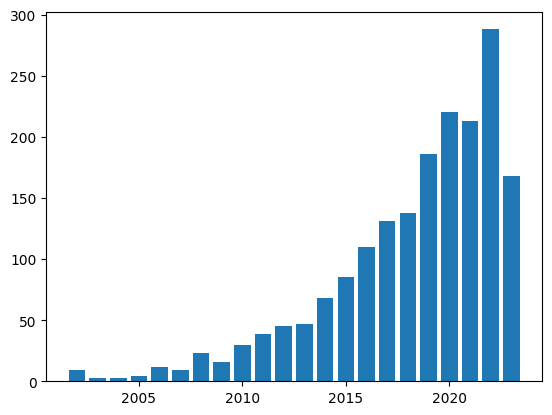

Na Zhang
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


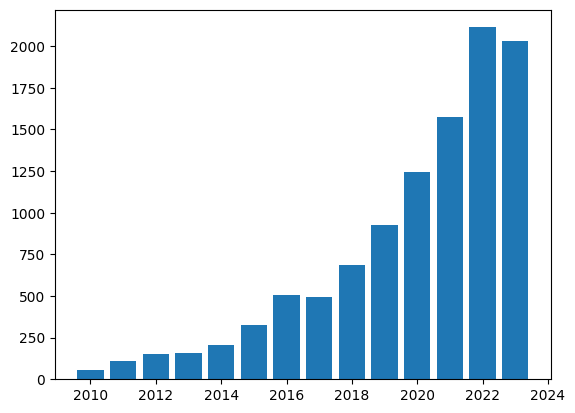

Shreya Ghosh
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


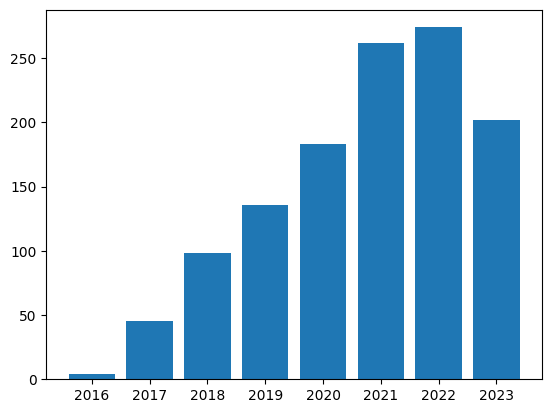

Mandar Kale
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


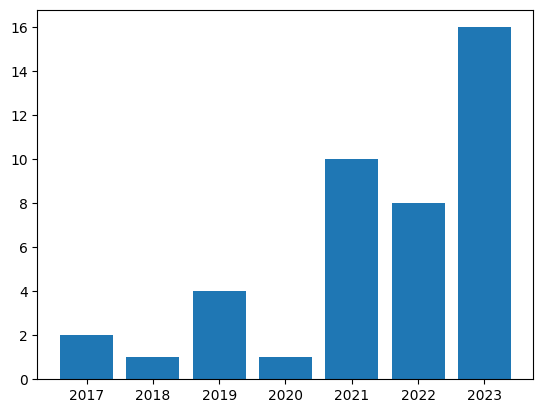

Fahad AlQurashi
[2019, 2020, 2021, 2022, 2023]


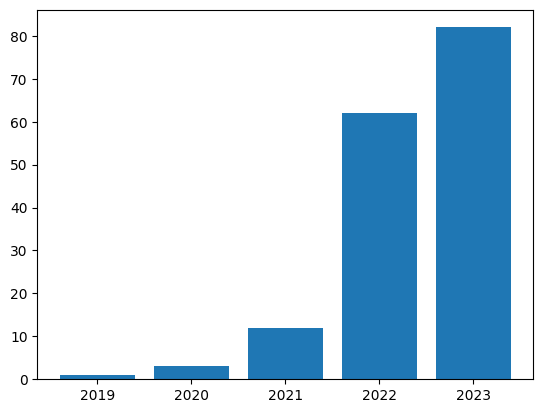

Matteo Salvatori
[2019, 2020, 2021, 2022, 2023]


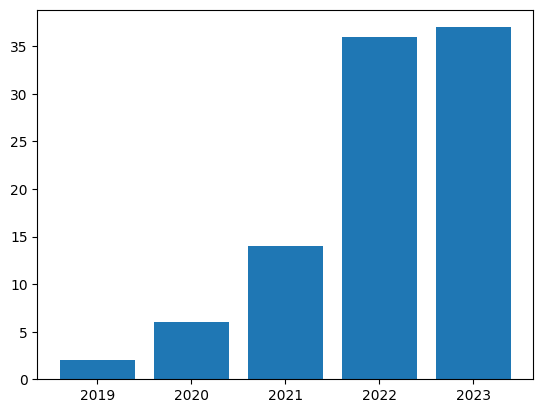

Yibing Song
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


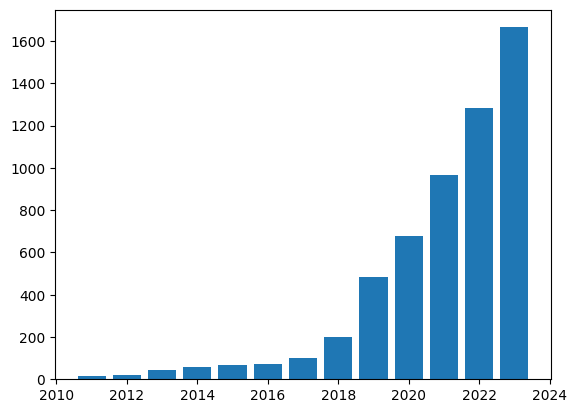

Seunghyeon Kim
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


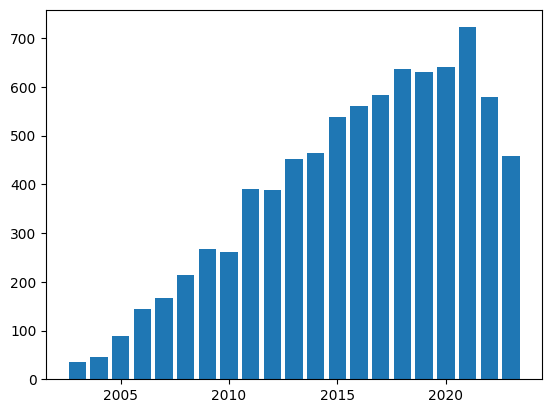

Weijie J. Su
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


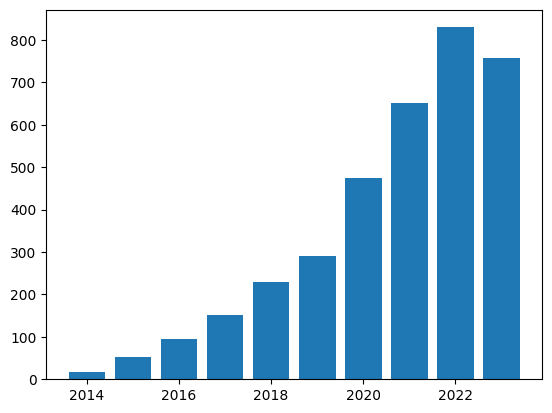

Jingjing Xu
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


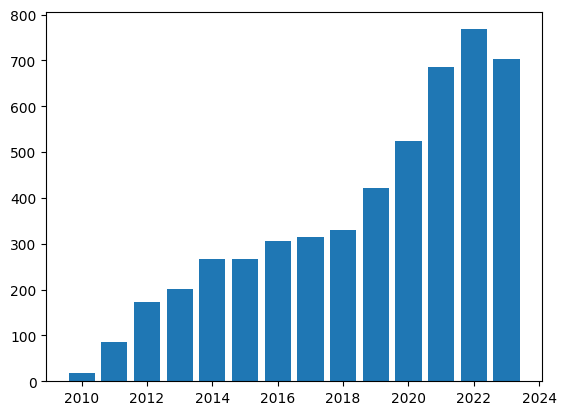

Maciej Szankin
[2018, 2019, 2020, 2021, 2022, 2023]


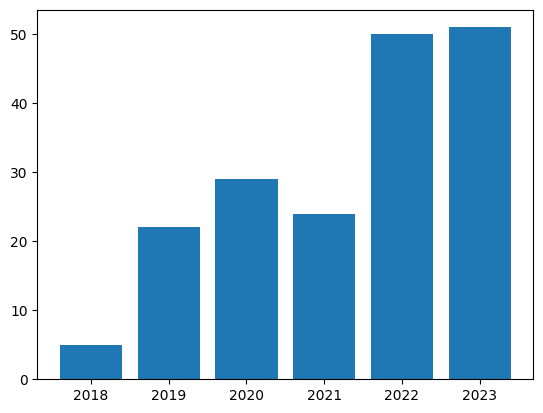

Chen Chen
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


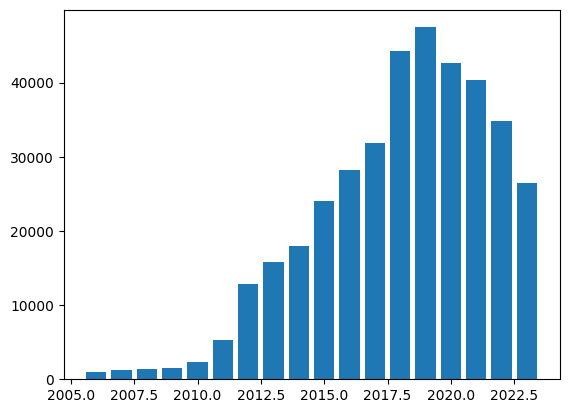

Ryan Cotterell
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


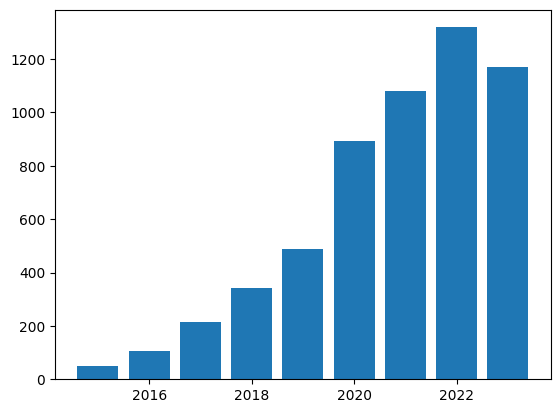

Peter Goldsborough
[1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


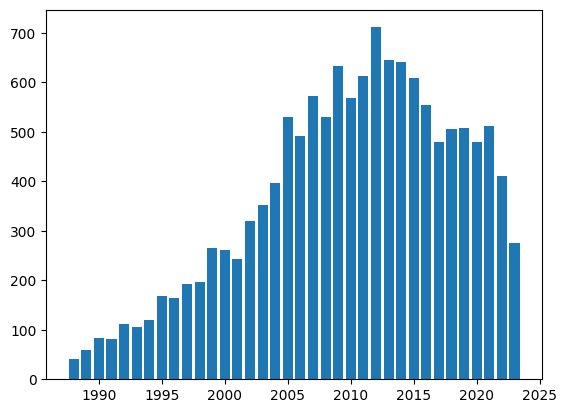

Pablo Messina
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


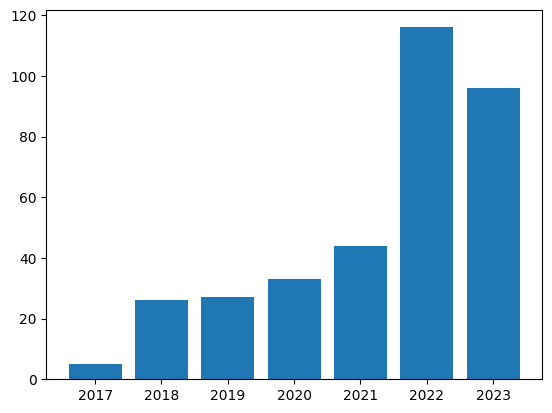

Mehedi Masud
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


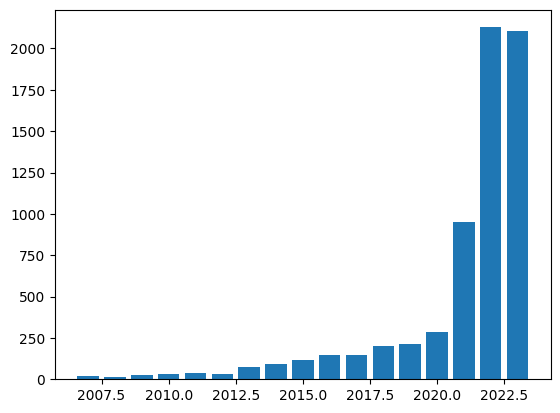

Mohammad Rashedul Hasan
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


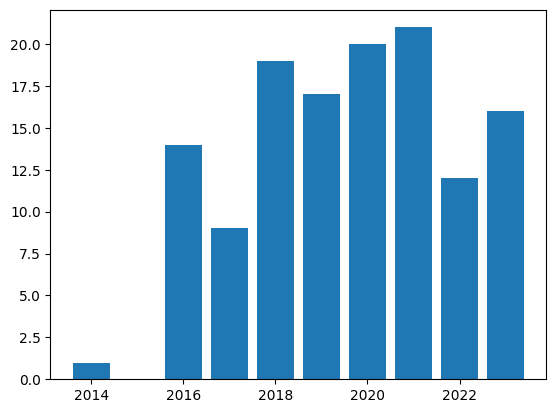

Shivam Raval
[2018, 2019, 2020, 2021, 2022, 2023]


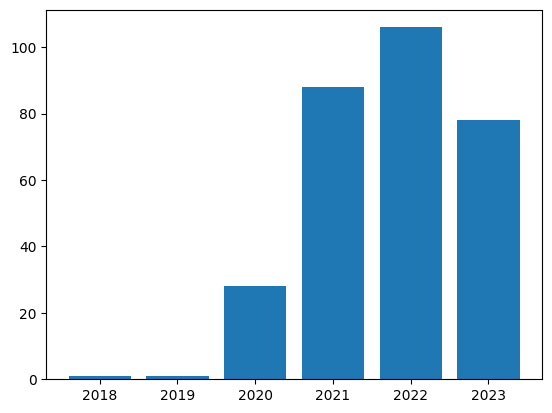

Matteo Rizzo
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


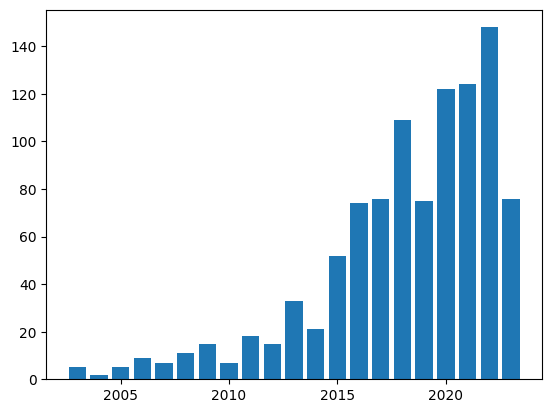

Vincent Marois
[2018, 2019, 2020, 2021, 2022, 2023]


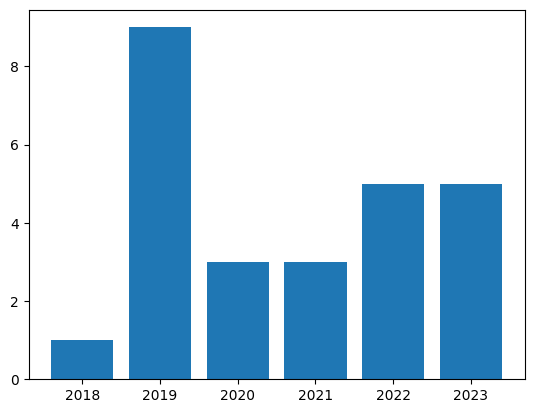

Ehsan Adeli
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


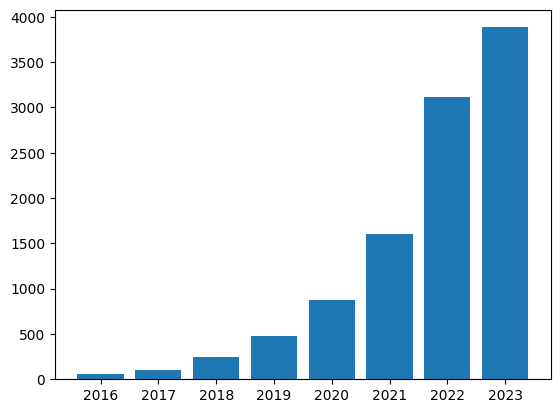

Harish Tayyar Madabushi
[2018, 2019, 2020, 2021, 2022, 2023]


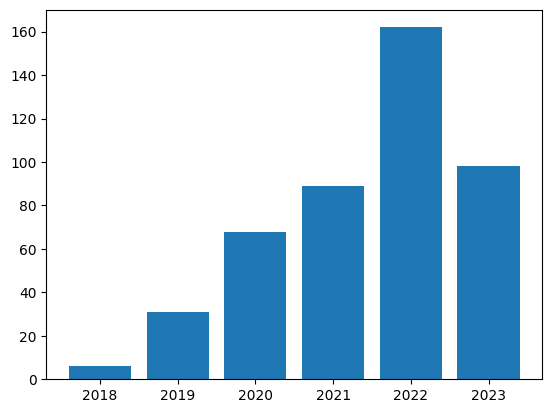

Ronald M. Summers
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


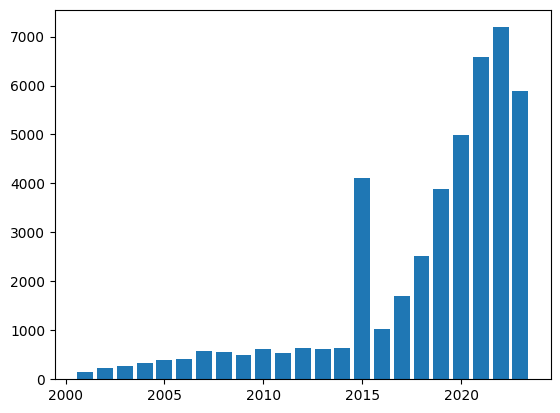

Yilei Zeng
[2018, 2019, 2020, 2021, 2022, 2023]


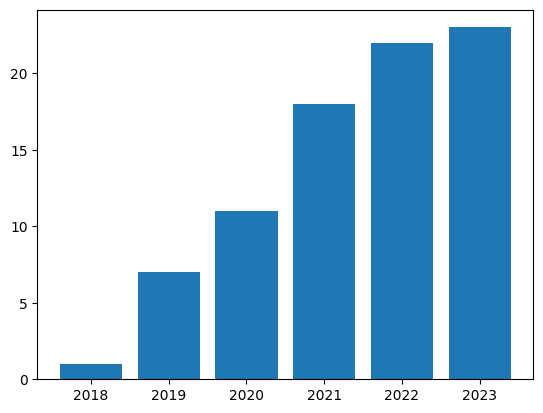

Abu Sebastian
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


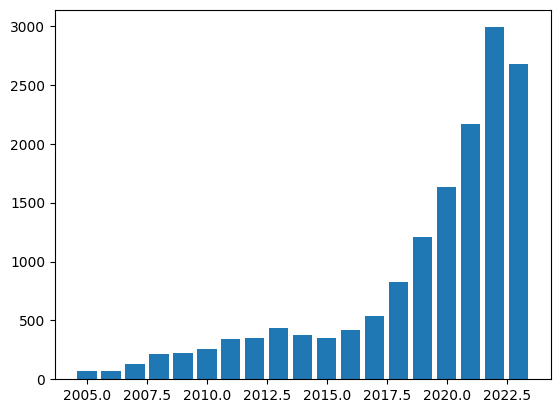

Wei Emma Zhang
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


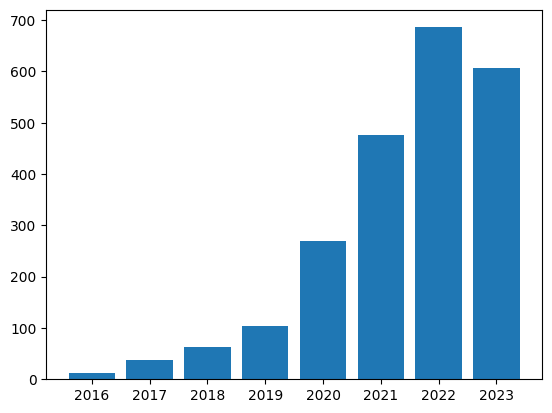

Nazli Ikizler-Cinbis
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


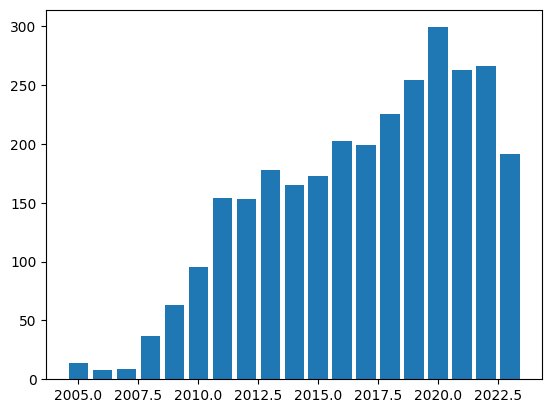

Liming Chen
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


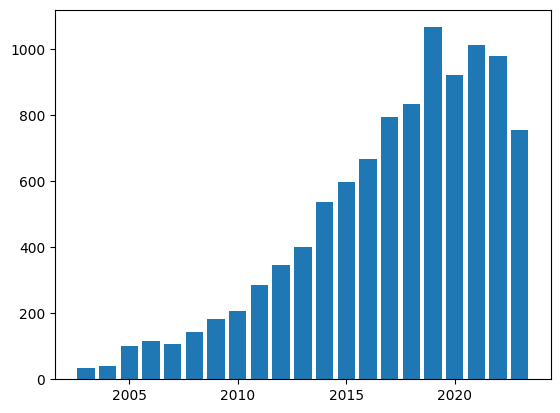

Leo A. Celi
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


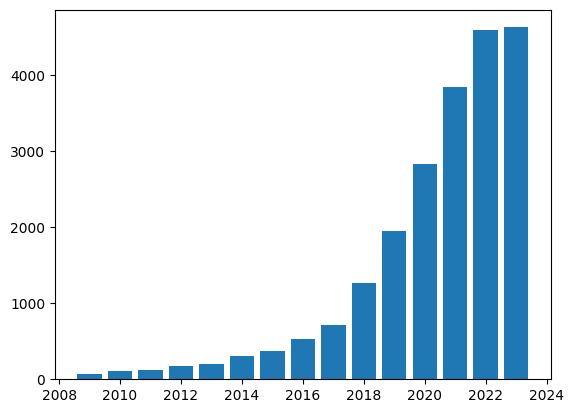

Matteo Stefanini
[2020, 2021, 2022, 2023]


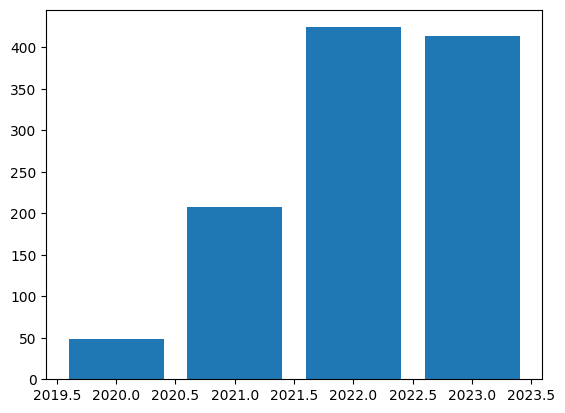

Yuge Zhang
[2020, 2021, 2022, 2023]


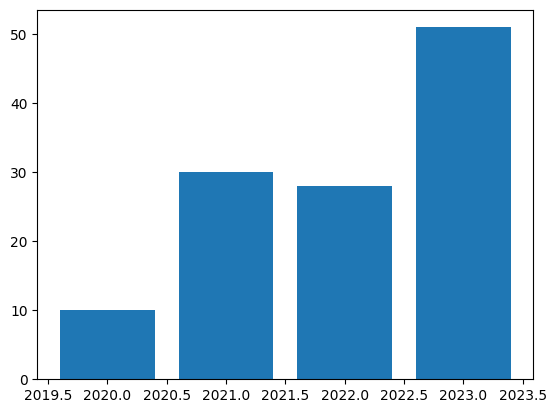

Hrishikesh Viswanath
[2022, 2023]


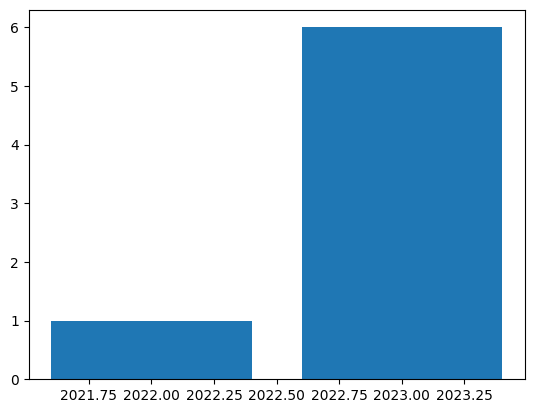

Zhen Wang
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


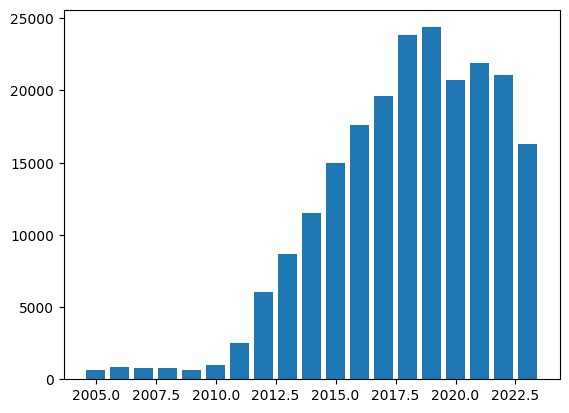

Zheng Zhou
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


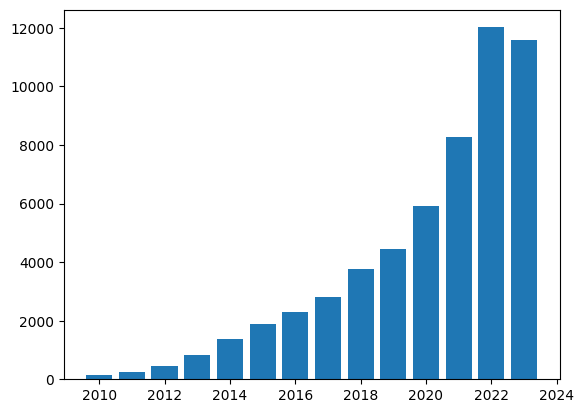

Dany Haddad
[2018, 2019, 2020, 2021, 2022, 2023]


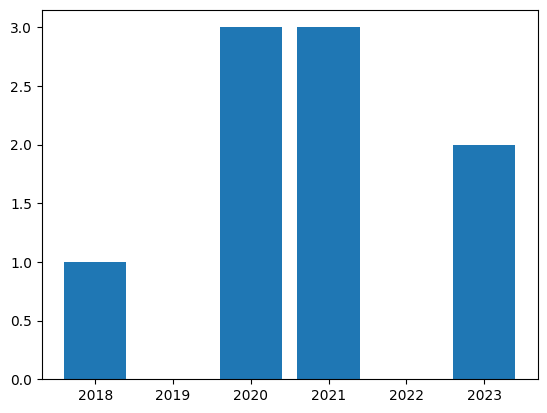

Erin Craig
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


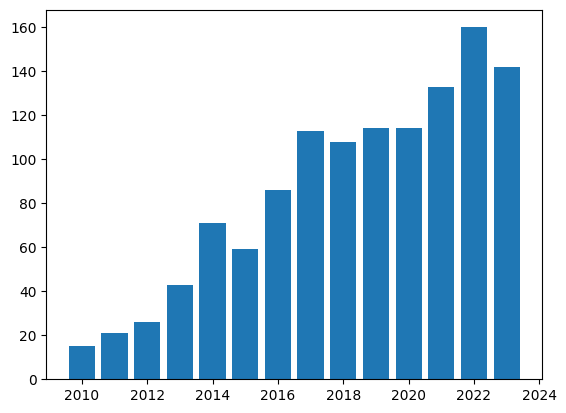

Rao Muhammad Anwer
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


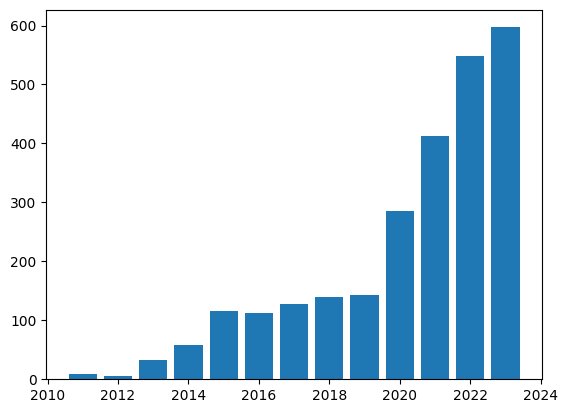

Fei Wu
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


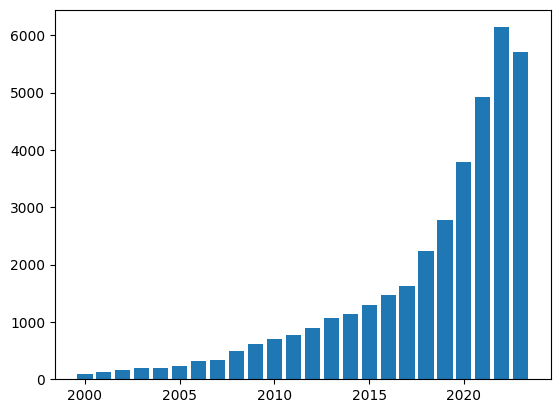

Mourad Ouzzani
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


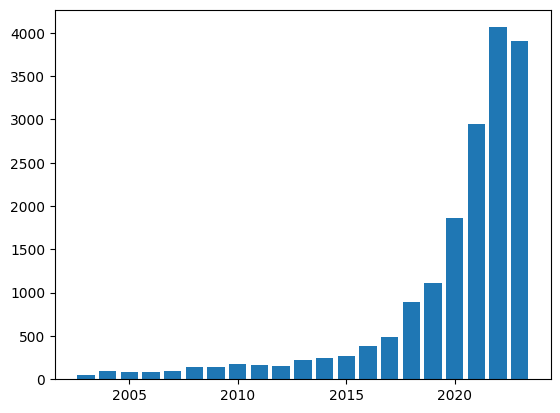

Yong Zhang
[1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


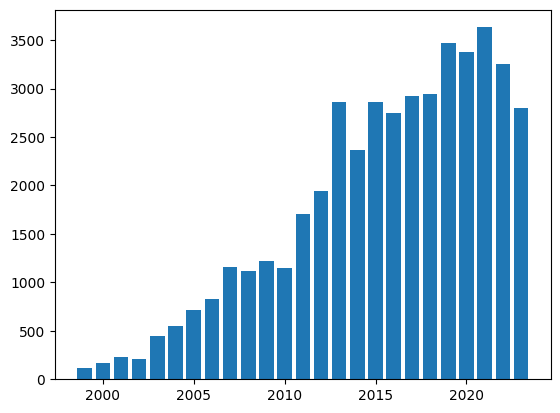

Shashank Narayana Gowda
[2019, 2020, 2021, 2022, 2023]


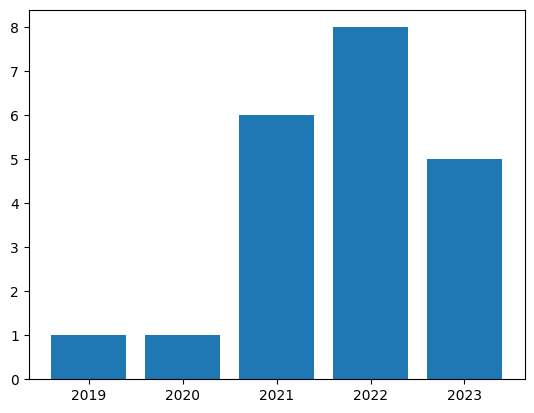

Tianxiao Li
[1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


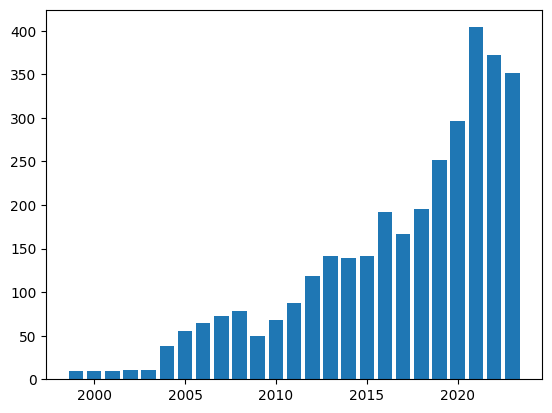

Ying Lu
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


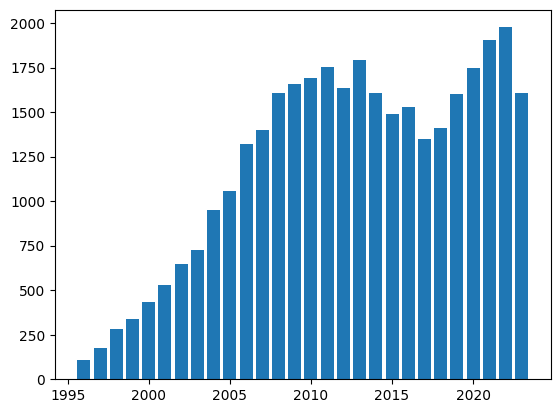

Long Zhang
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


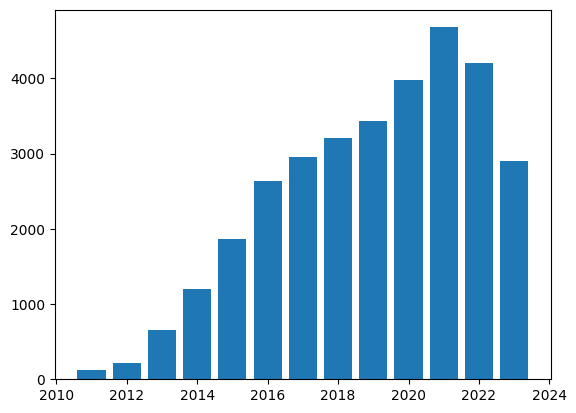

Uddeshya Upadhyay
[2019, 2020, 2021, 2022, 2023]


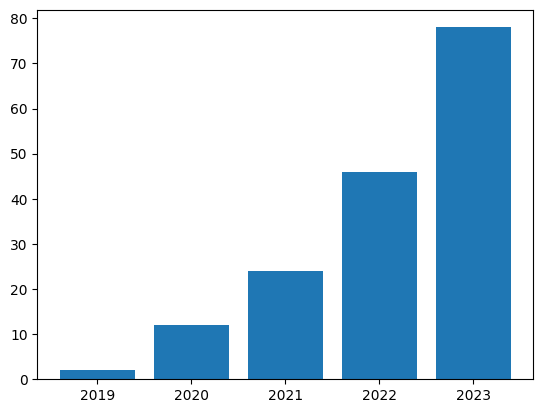

José Marcato Junior
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


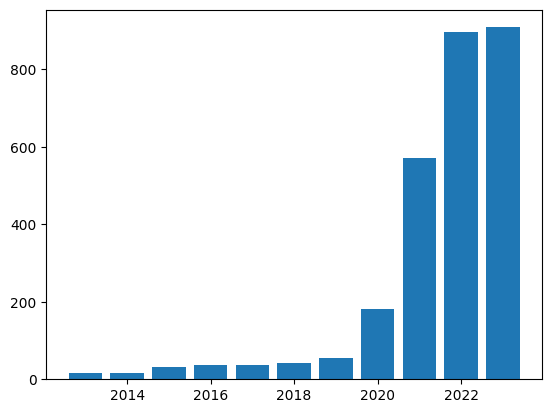

Li Zhang
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


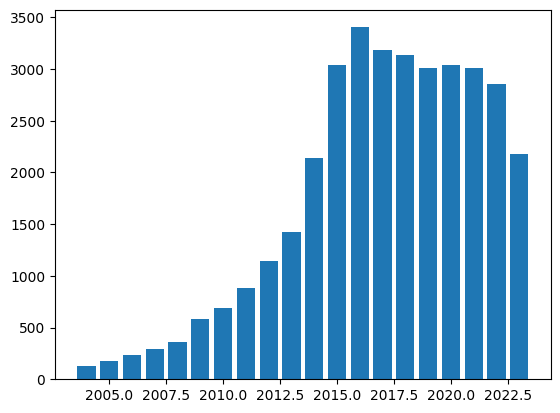

Arif Ahmed Sekh
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


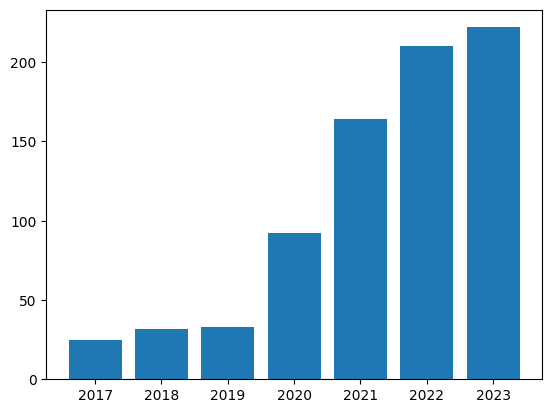

Abbas Ghaddar
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


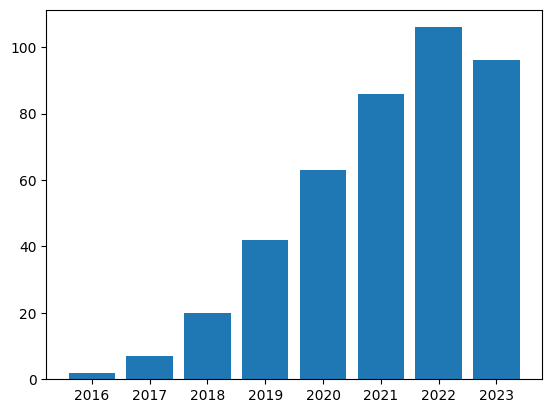

Alan Karthikesalingam
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


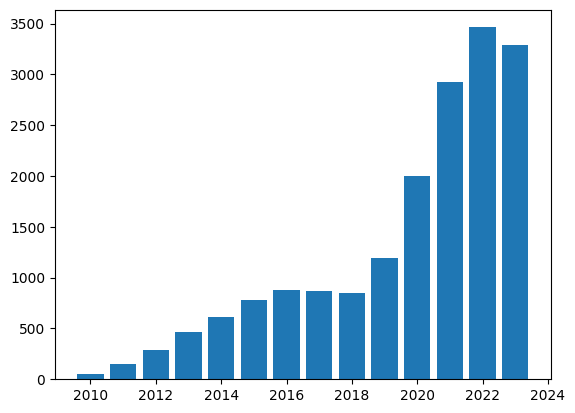

Yaowei Li
[2020, 2021, 2022, 2023]


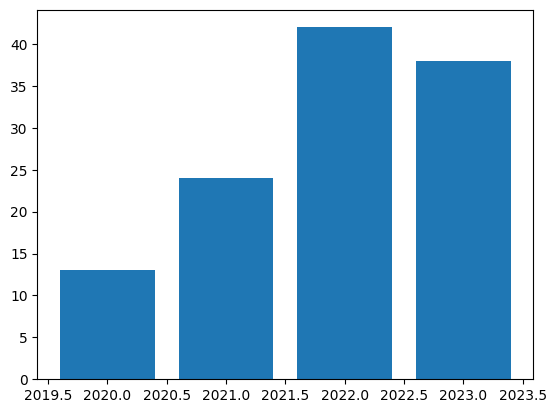

Haizhao Yang
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


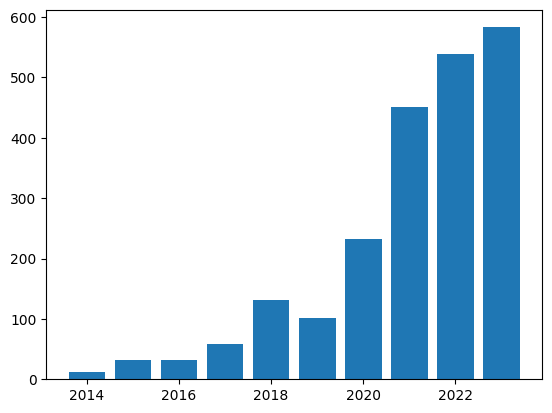

Mark H. Michalski
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


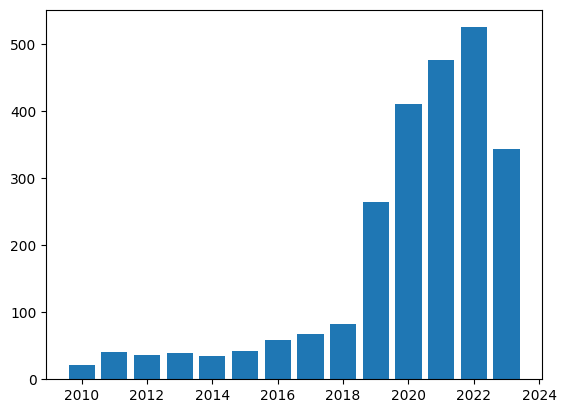

Xu Wu
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


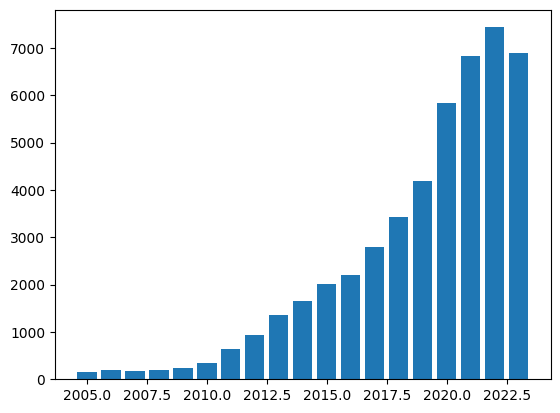

Qiyuan Du
[2019, 2020, 2021, 2022, 2023]


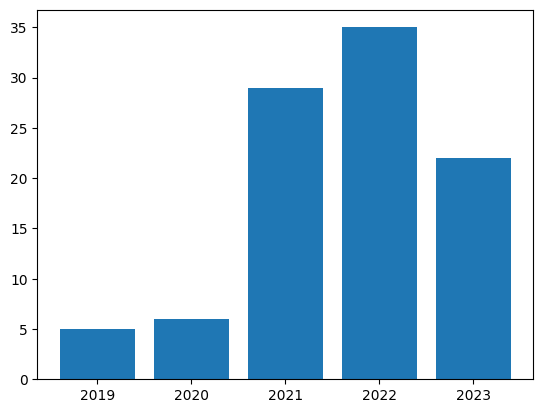

Longxiang Gao
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


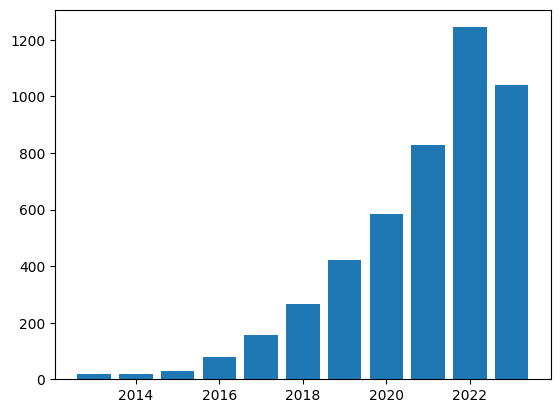

Debapriyo Majumdar
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


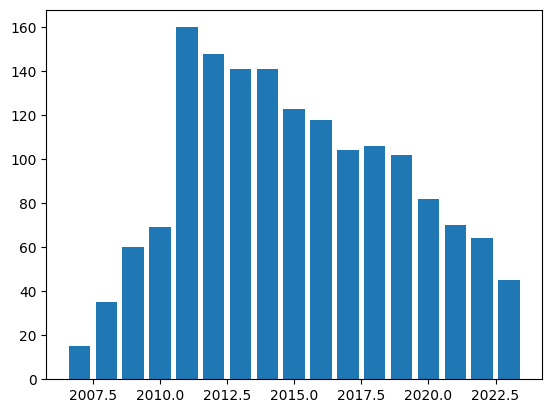

Xiaowen Chu
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


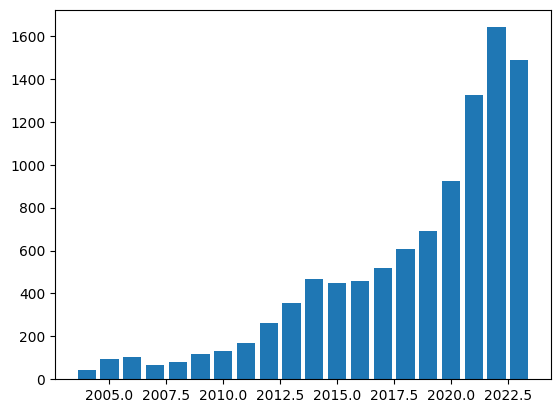

Lars Maaløe
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


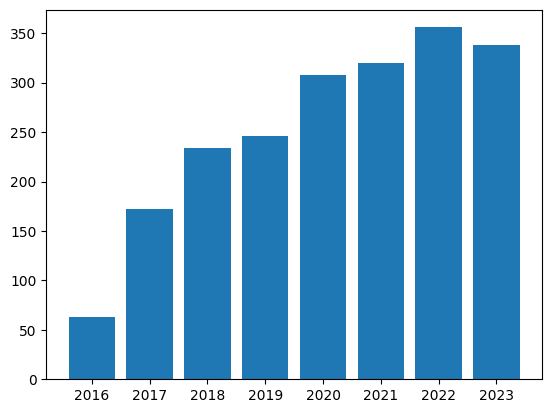

Ahmet S. Ozcan
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


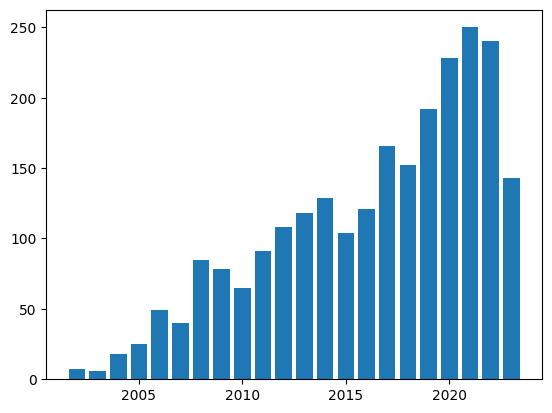

Suruchi Kumari
[1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


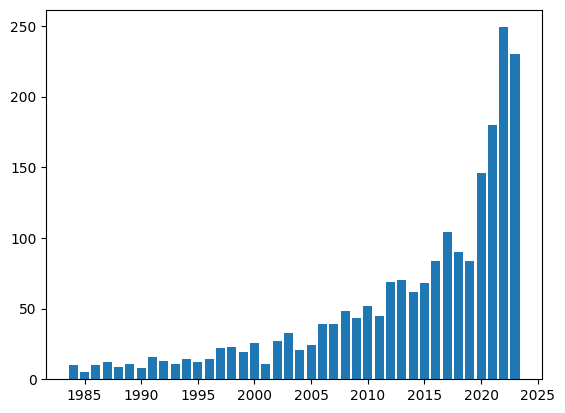

Gorana Gojić
[2019, 2020, 2021, 2022, 2023]


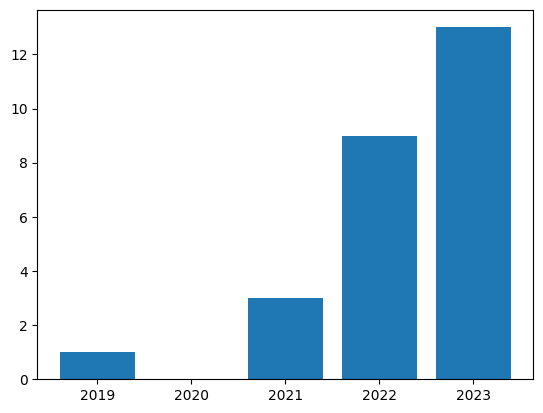

Ryan Cohn
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


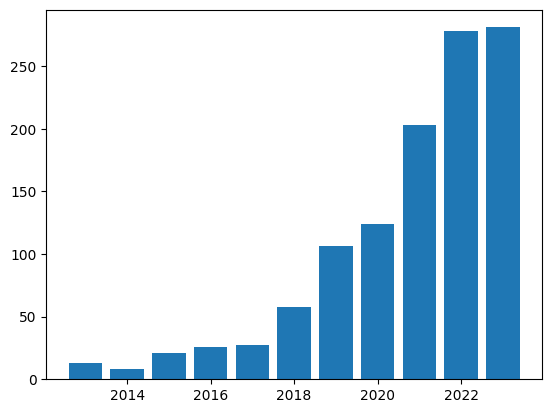

Oshin Dutta
[2022, 2023]


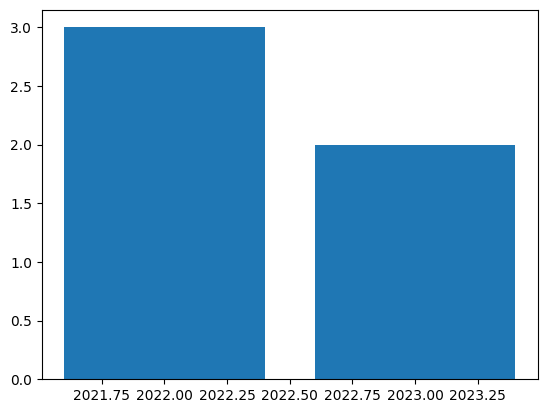

Haibin Lin
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


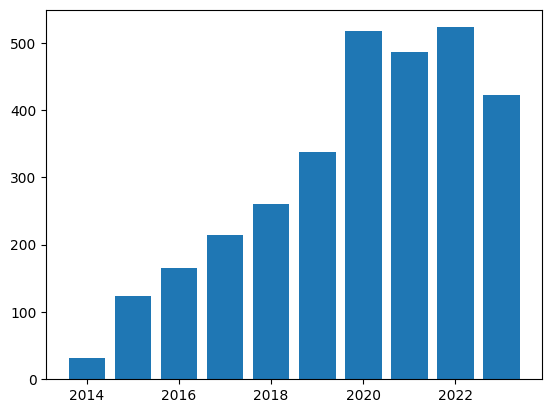

Ran Ben Basat
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


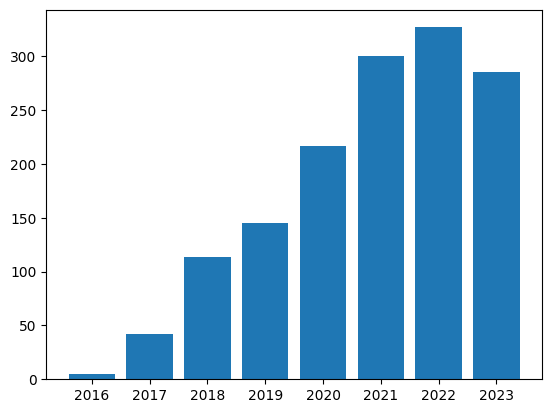

Miguel Couceiro
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


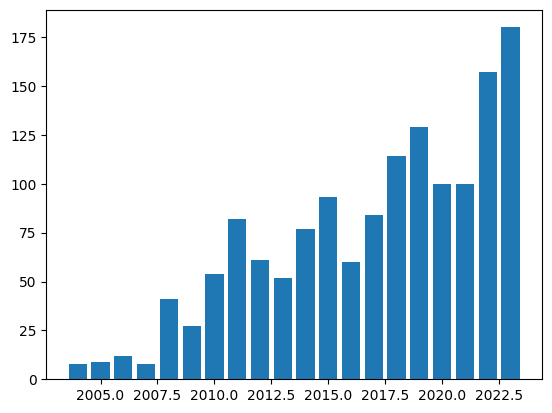

Mario Fritz
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


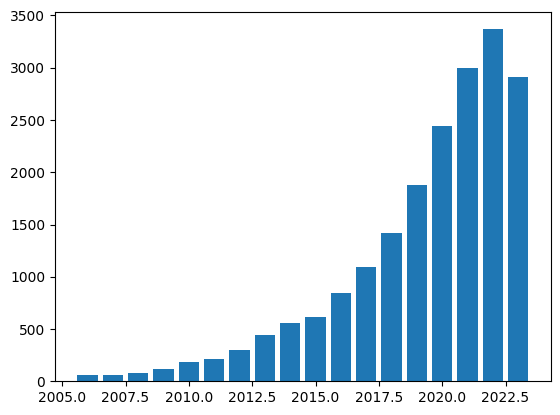

Ping Li
[1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


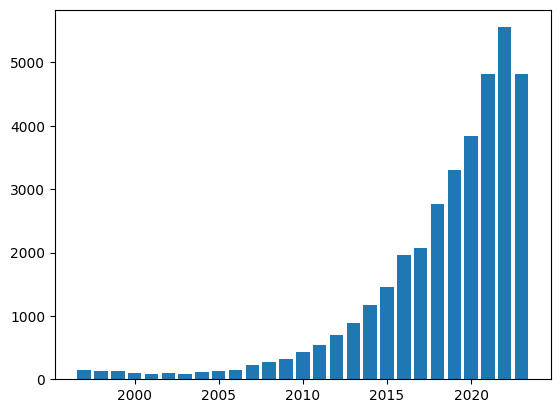

Thomas Gilles
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


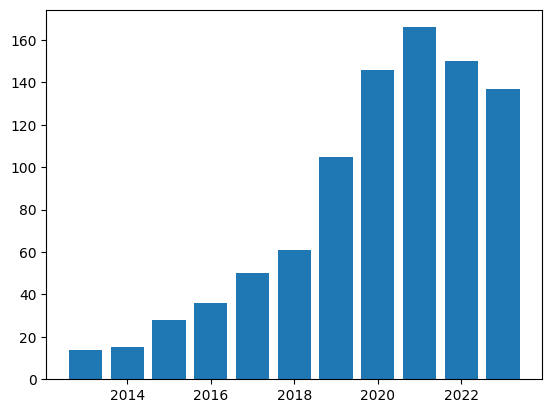

Xiang Chen
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


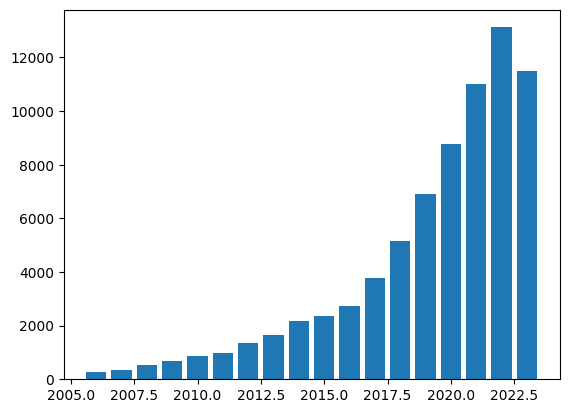

John Foote Jr.
[1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


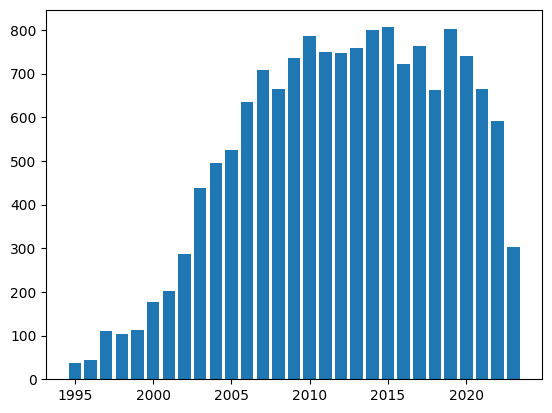

Mohtasim Fuad
[2020, 2021, 2022, 2023]


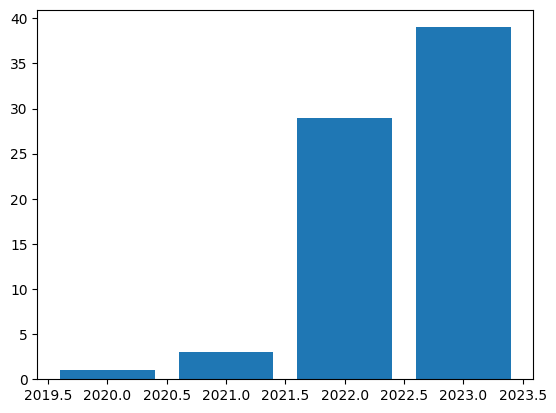

Jaehun Kim
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


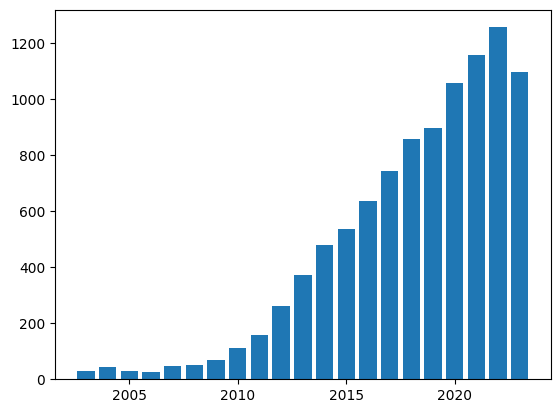

Yunxin Liu
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


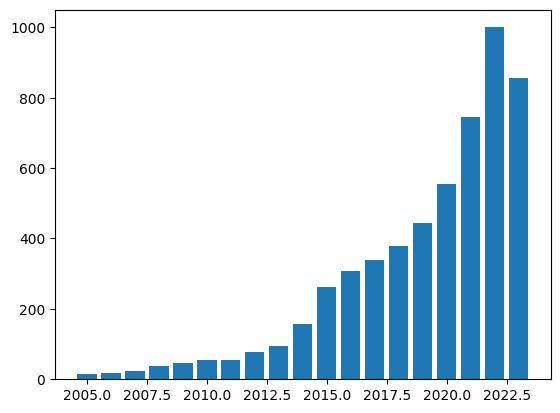

He Zhang
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


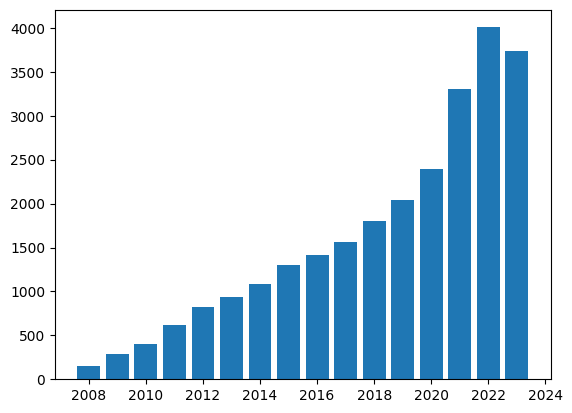

Albert Haque
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


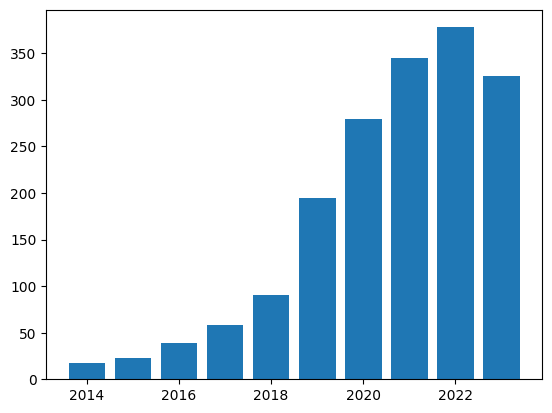

Jonathan Ish-Horowicz
[2018, 2019, 2020, 2021, 2022, 2023]


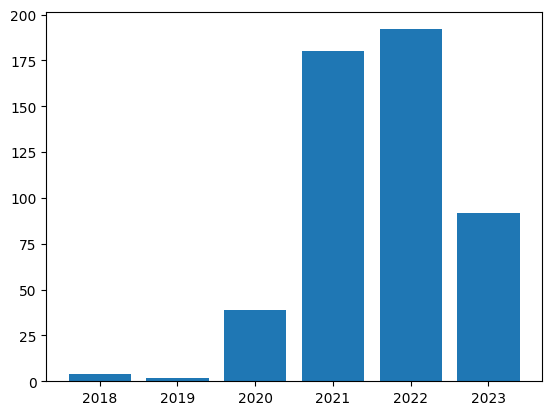

Aditya Joshi
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


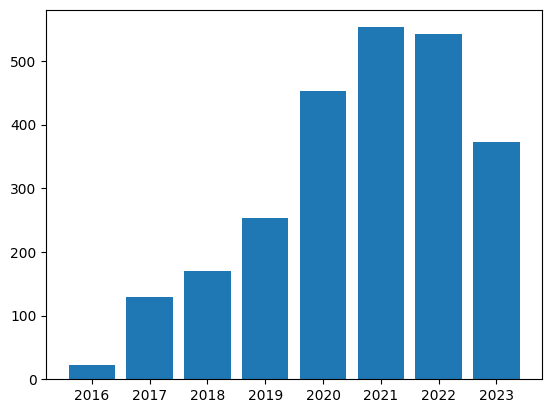

Muhammad Usman Ghani Khan
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


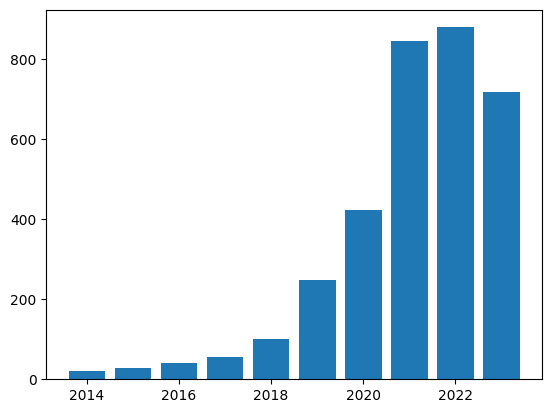

Pranav Rajpurkar
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


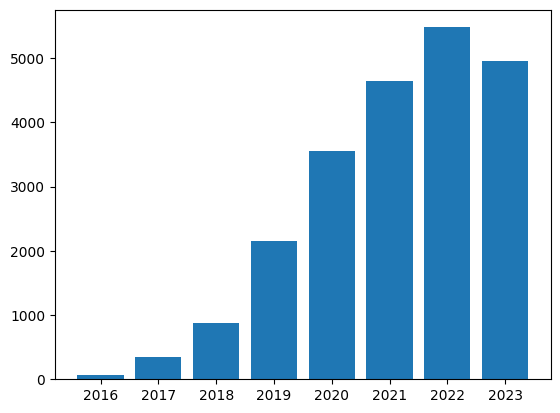

Sergey Troshin
[2020, 2021, 2022, 2023]


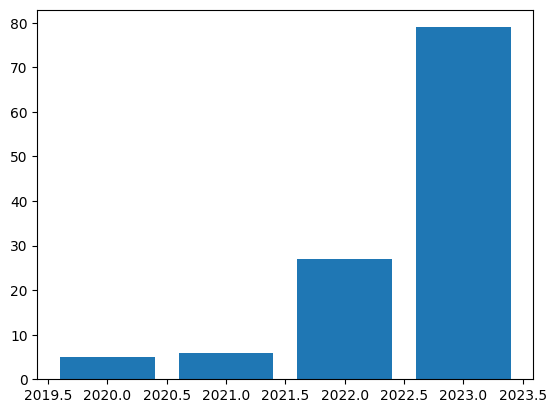

Wei Zhan
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


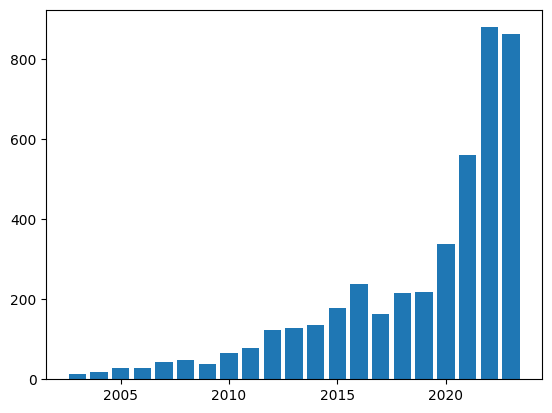

Zheng Wang
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


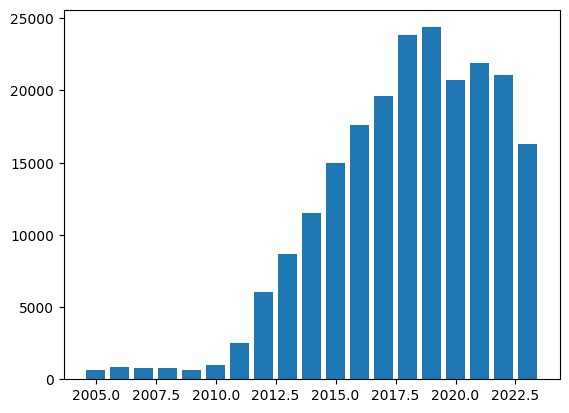

Ethan Goan
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


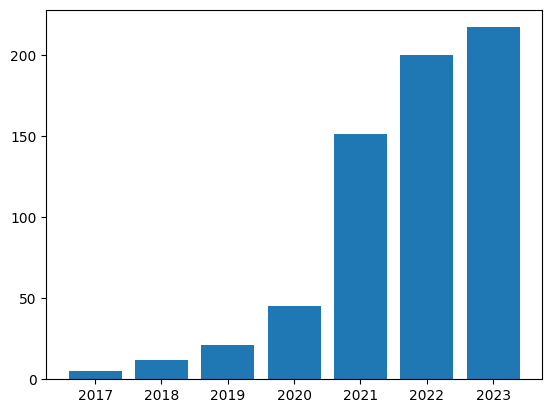

Stefan S. Linquist
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


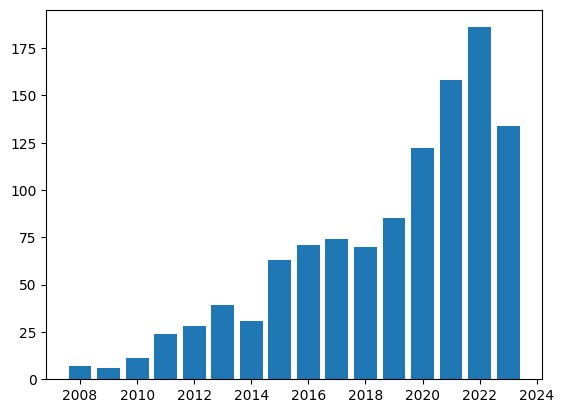

Ted Pedersen
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


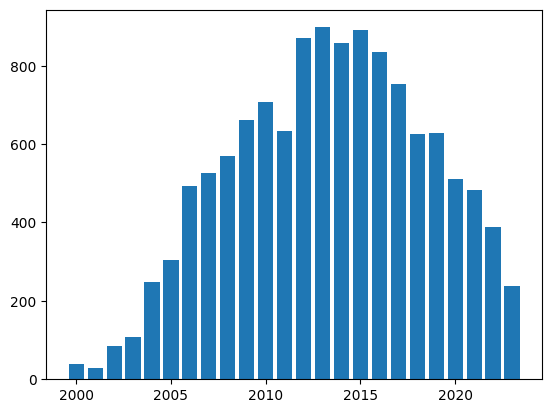

Asako Kanezaki
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


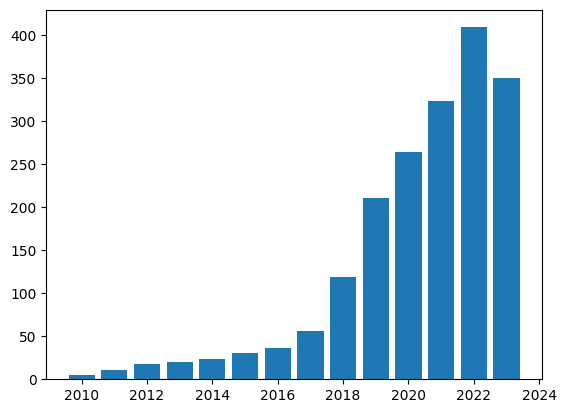

Thanh Phuong Pham
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


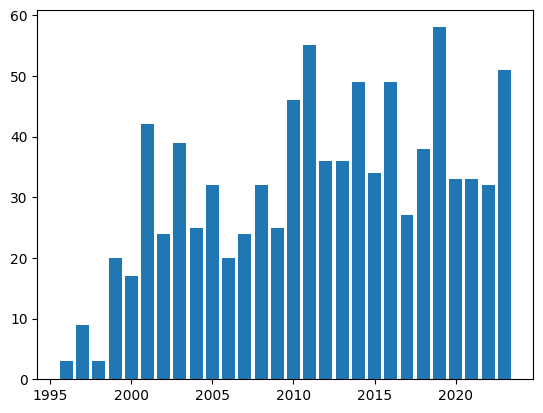

Zhiming Zheng
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


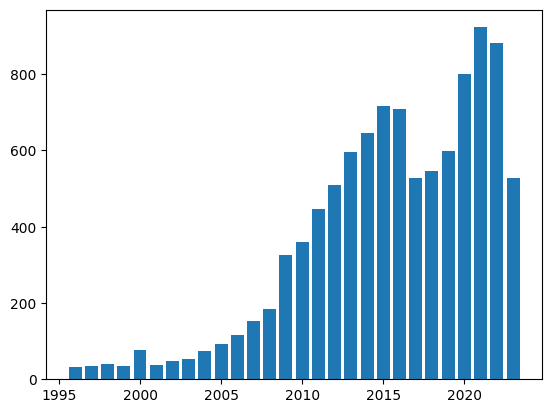

Richard McKinley
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


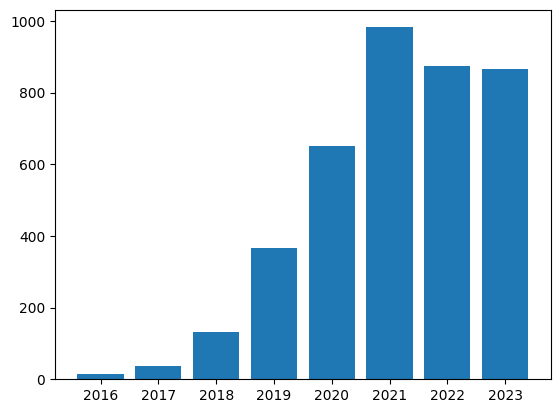

Muhammad Kamran Janjua
[2018, 2019, 2020, 2021, 2022, 2023]


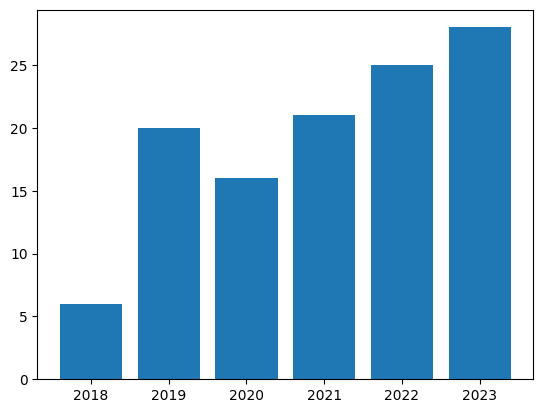

Yucheng Tang
[2020, 2021, 2022, 2023]


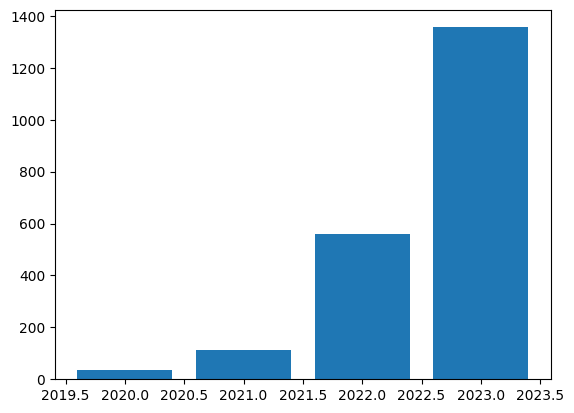

Onur Kara
[2019, 2020, 2021, 2022, 2023]


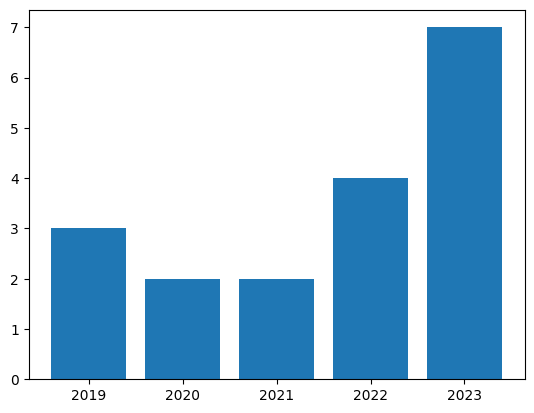

David A. Clifton
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


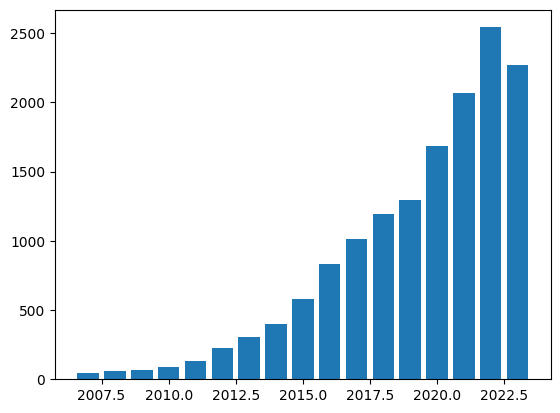

Alan J. Michaels
[1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


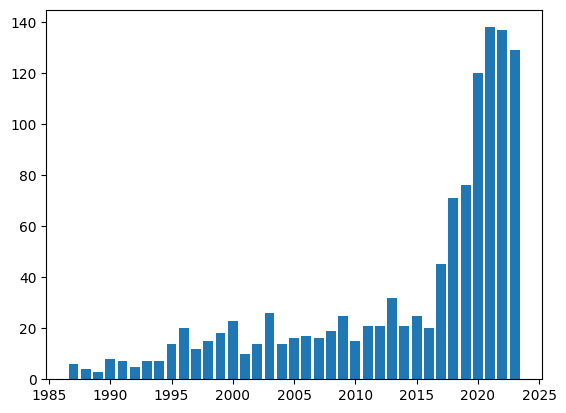

Surangika Ranathunga
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


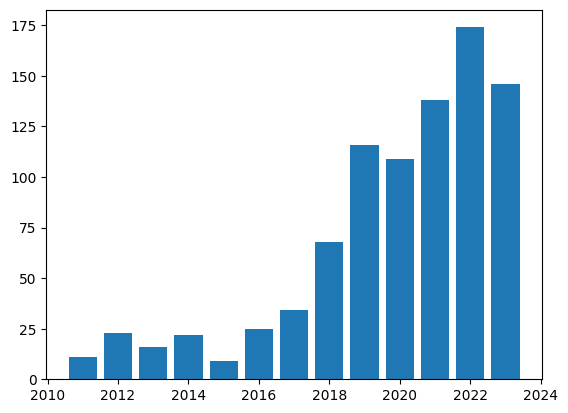

Wenhao Chai
[2022, 2023]


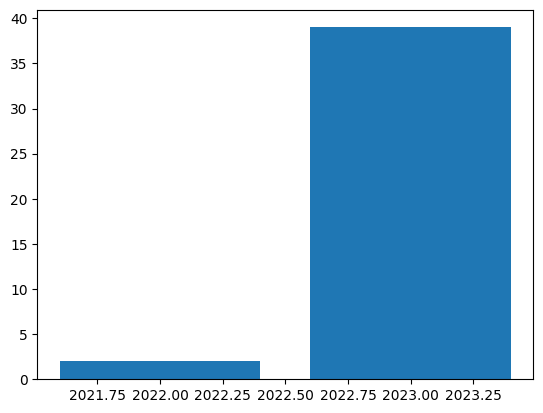

Arzucan Özgür
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


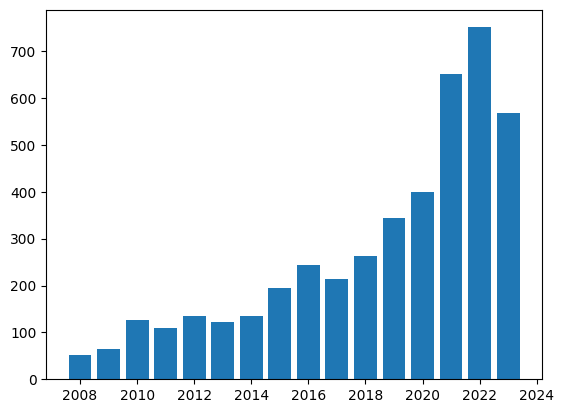

Natalia Díaz-Rodríguez
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


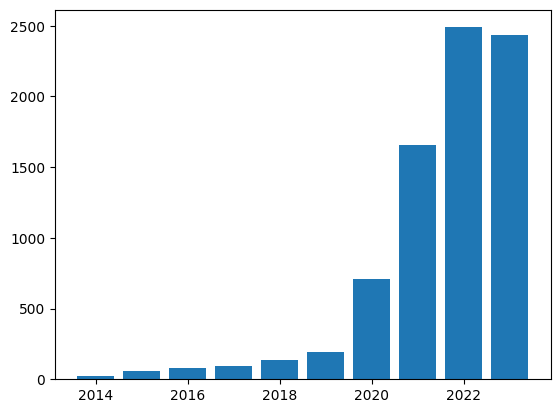

Stella Ho
[2020, 2021, 2022, 2023]


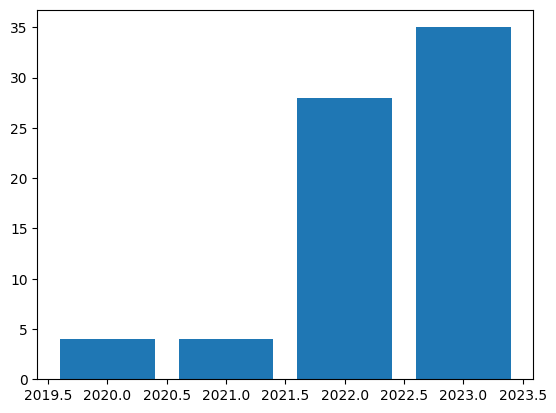

Shijie Chen
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


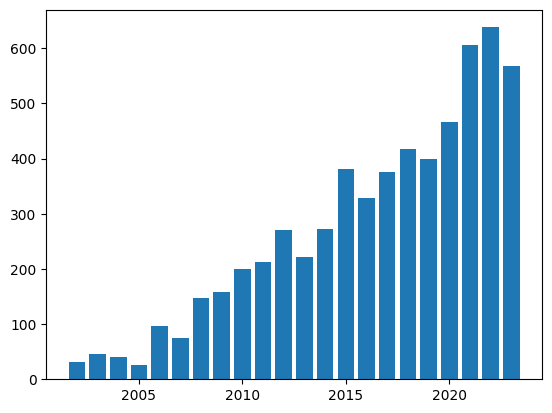

Maciej A. Mazurowski
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


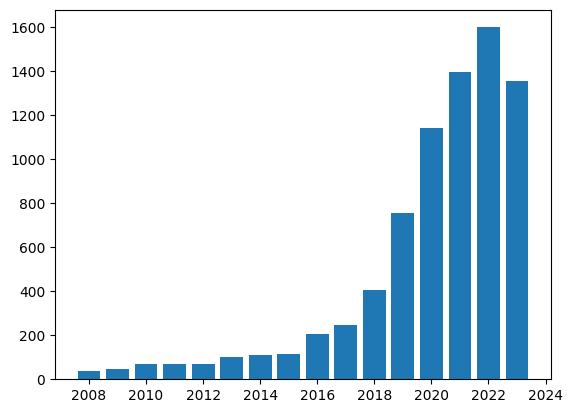

Adrian M. P. Braşoveanu
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


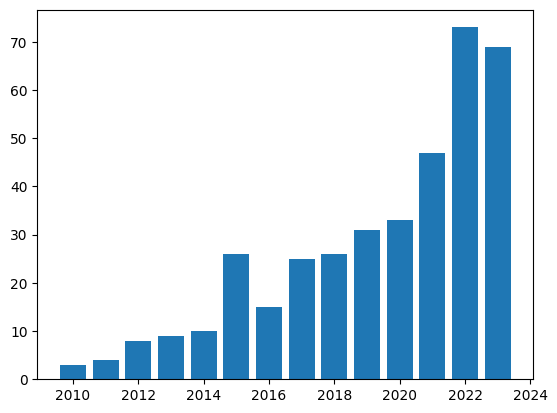

Manik Gupta
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


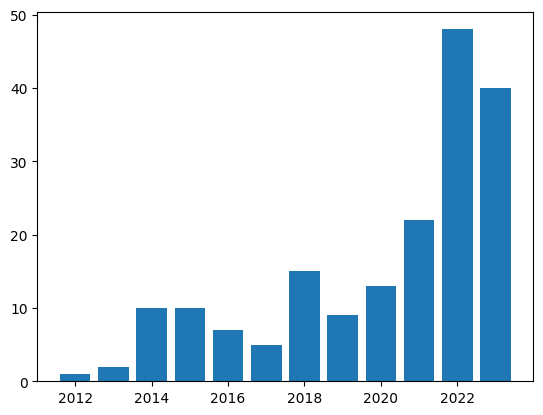

Guillermo Cecchi
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


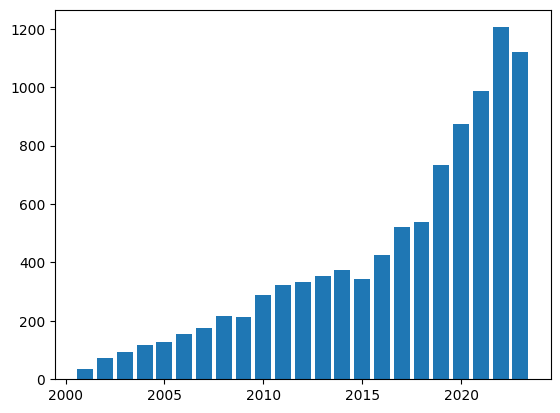

Maged Saeed AlShaibani
[2020, 2021, 2022, 2023]


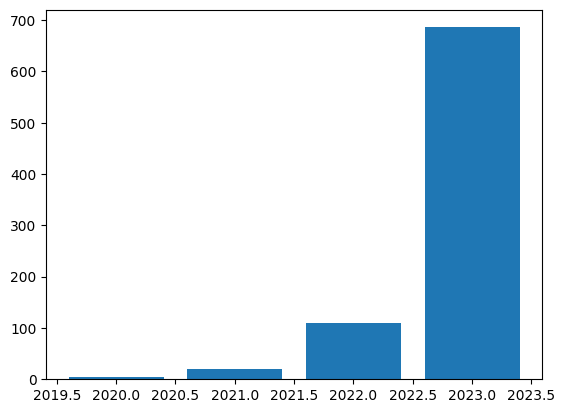

Li Li
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


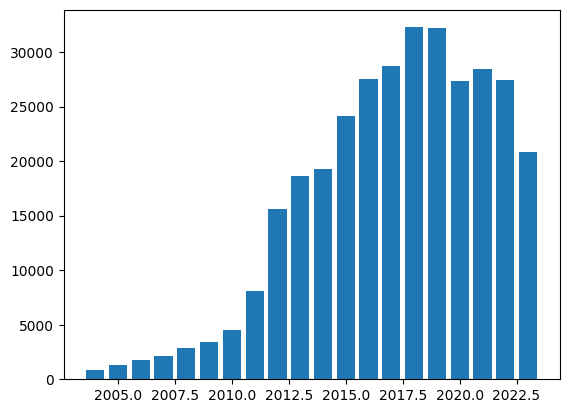

Aykut Erdem
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


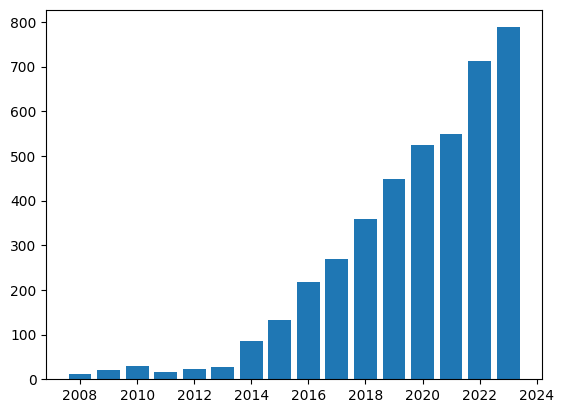

Vijay Devabhaktuni
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


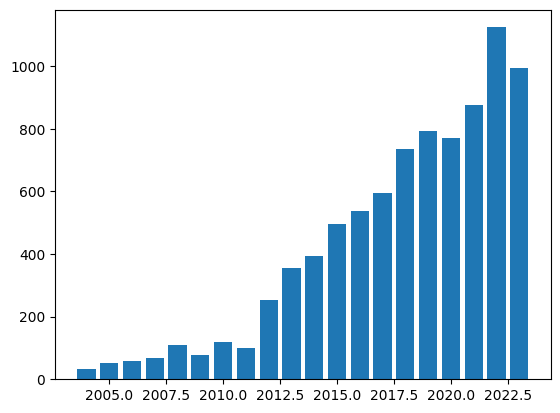

Xiang Bai
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


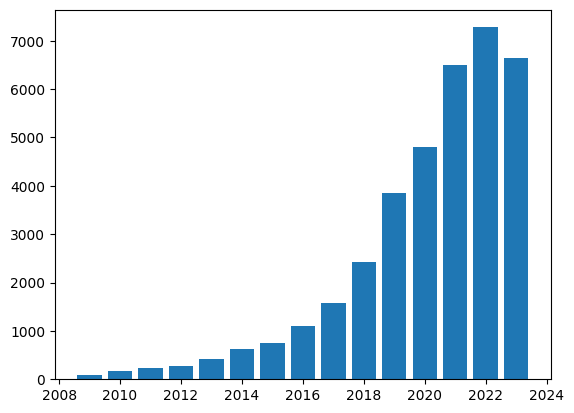

Mahsa Bazzaz
[]


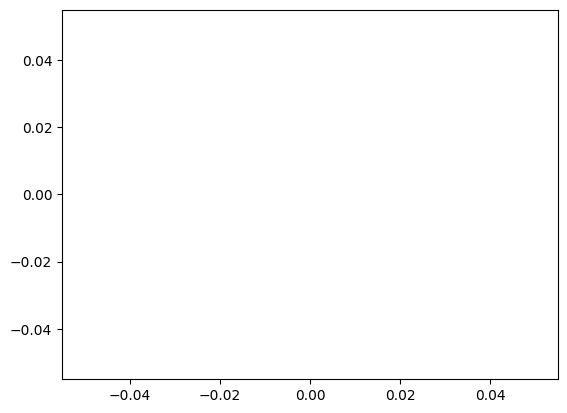

Daniel Hain
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


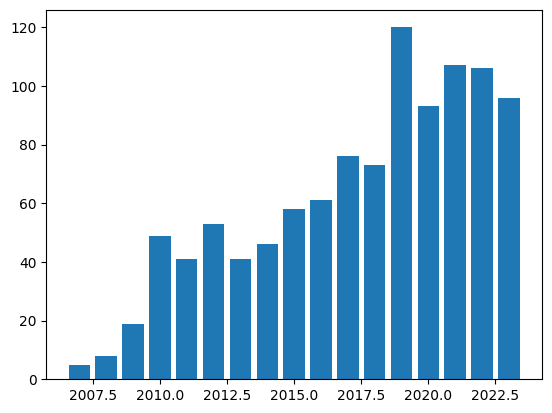

Geoffrey I. Webb
[1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


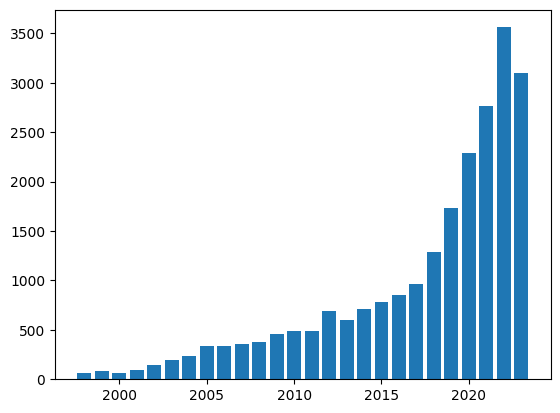

Jana-Rebecca Rehse
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


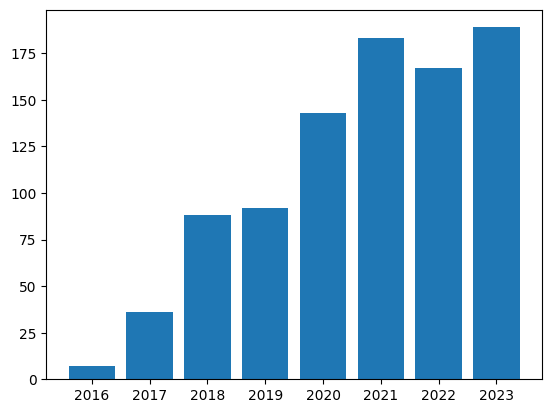

Joan Puigcerver
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


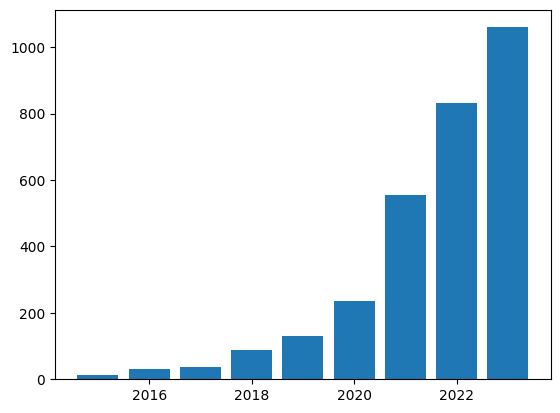

Shinjae Yoo
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


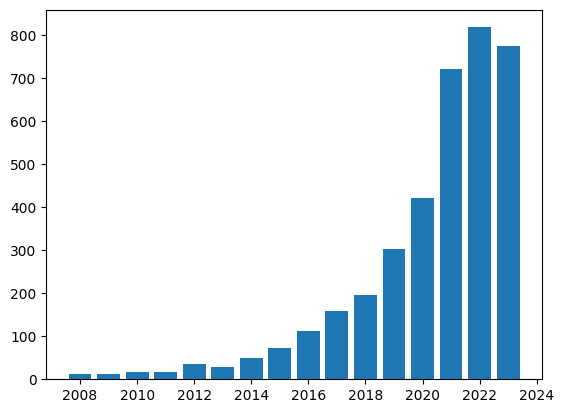

Triet H. M. Le
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


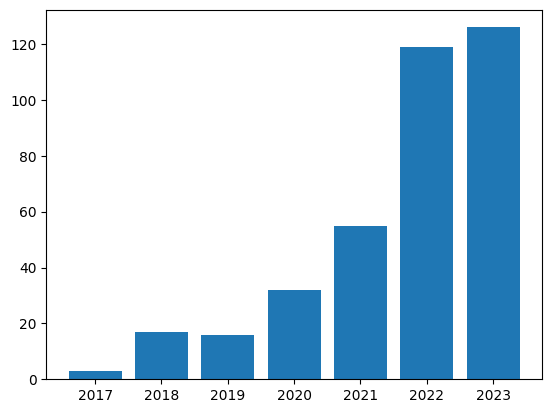

Ignazio Gallo
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


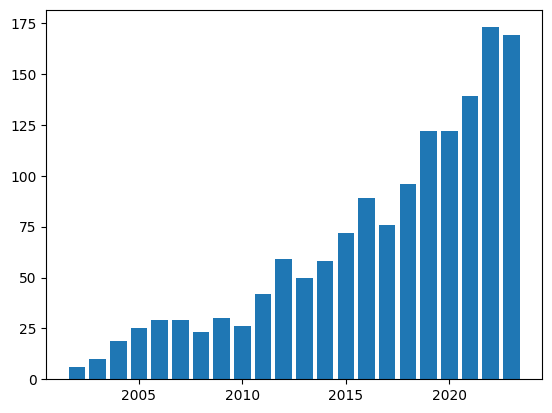

Neelesh Mungoli
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


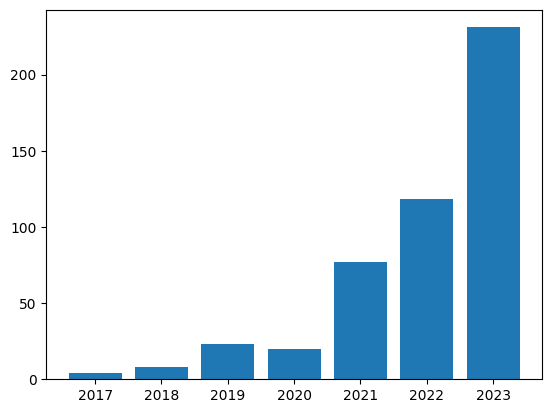

Simion-Vlad Bogolin
[2018, 2019, 2020, 2021, 2022, 2023]


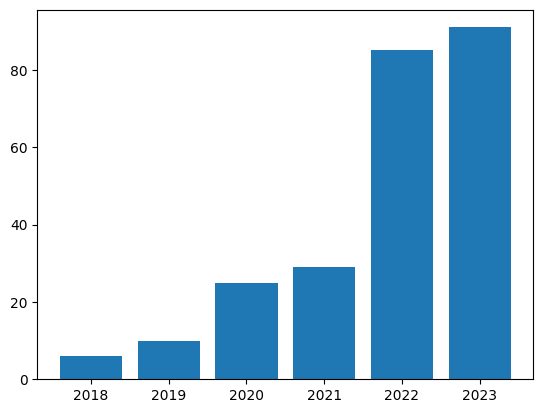

Oladunni A. Daramola
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


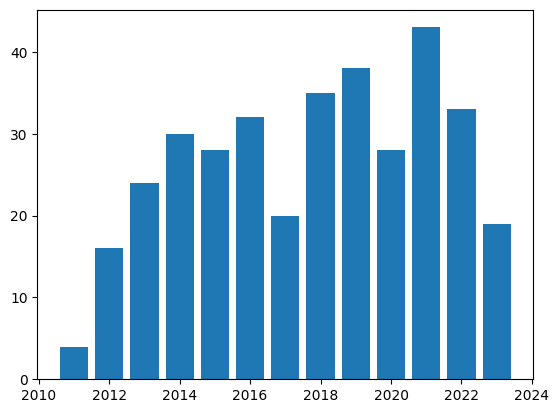

Mehrtash Harandi
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


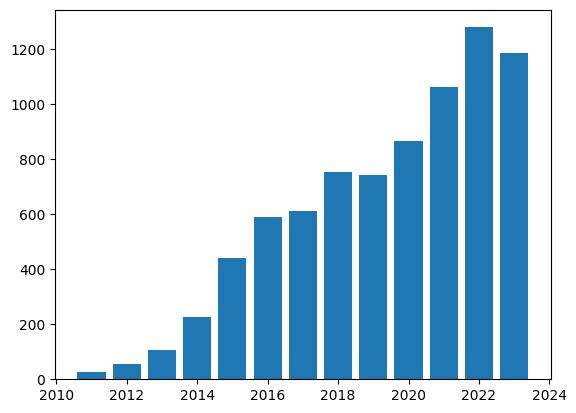

Hao Jin
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


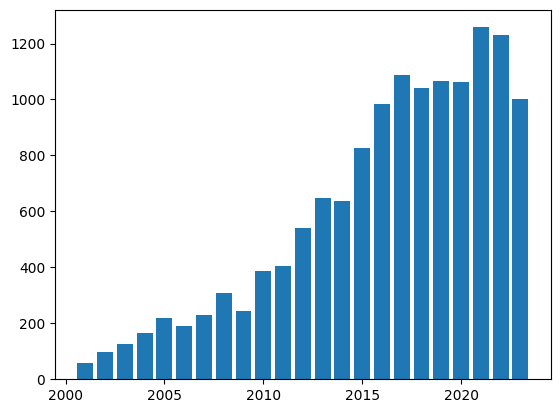

Giuseppe Fiameni
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


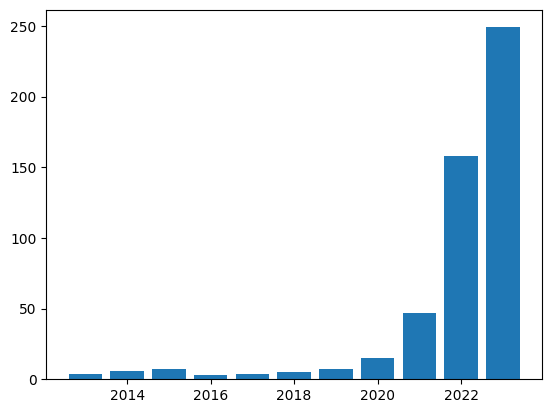

Hadi Abdine
[2021, 2022, 2023]


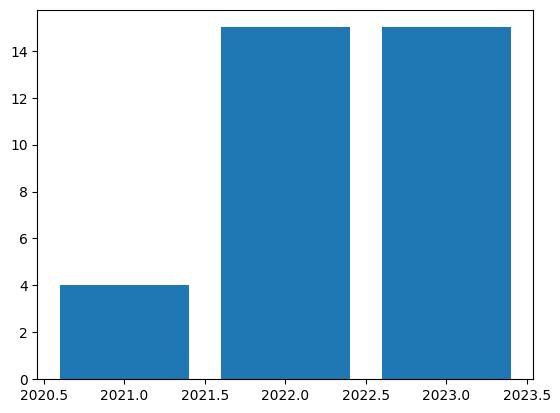

Nafees Mansoor
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


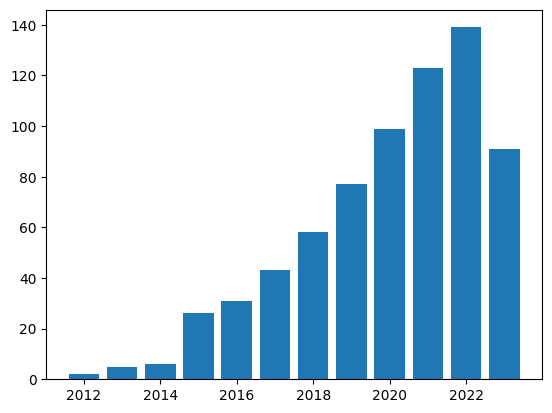

Ming Li
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


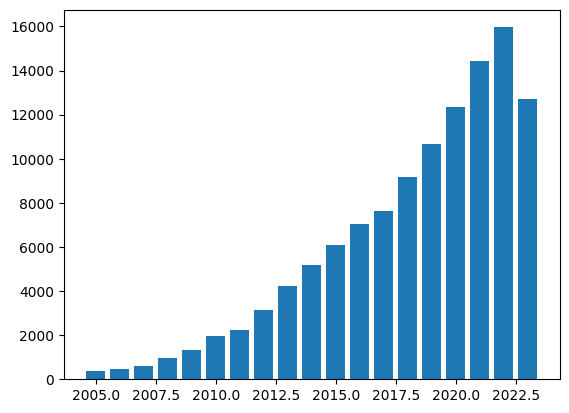

Johannes Schneider
[1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


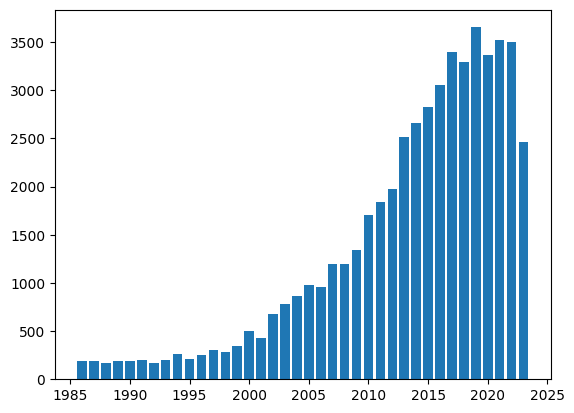

Guo Pu
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


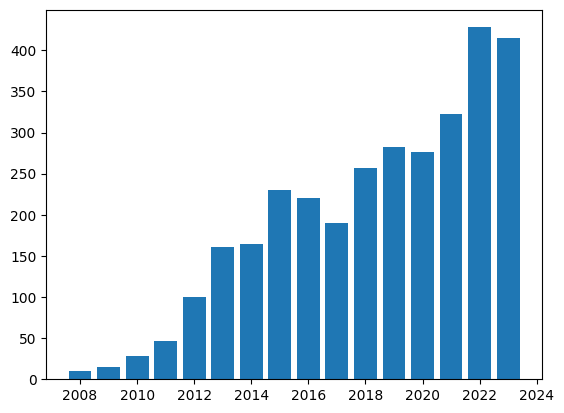

Jiangmiao Pang
[2019, 2020, 2021, 2022, 2023]


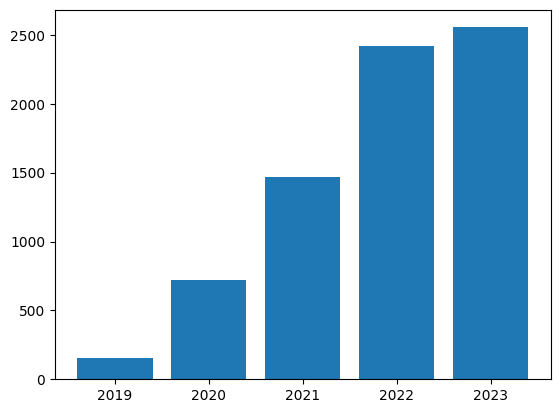

David Ha
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


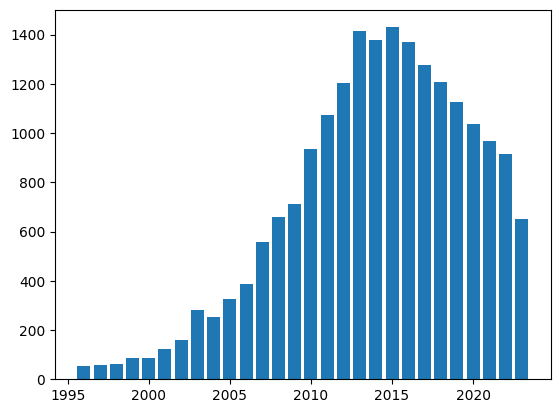

Ganesh Neelakanta Iyer
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


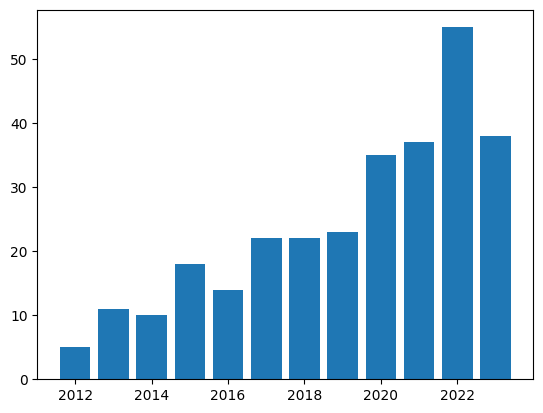

Mustafa R. Bashir
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


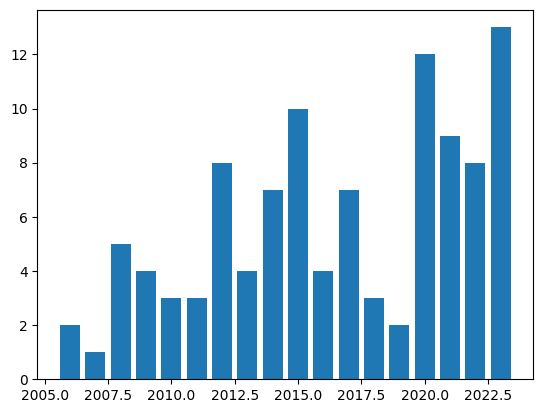

Yizhou Chen
[1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


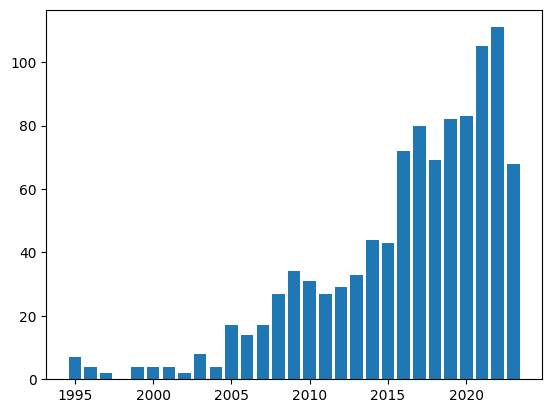

Qi Zhong
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


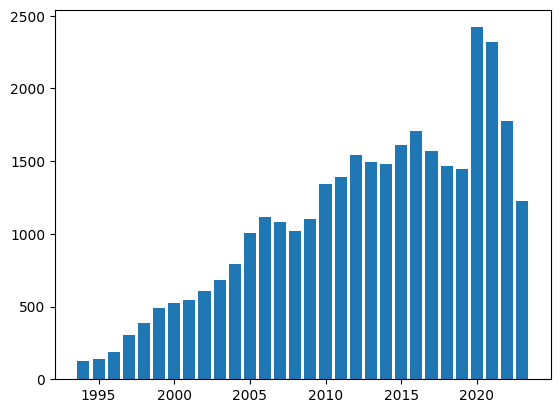

Alexander D'Amour
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


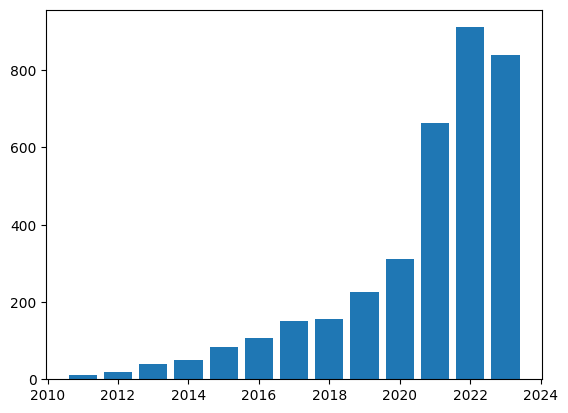

Sergio Maffeis
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


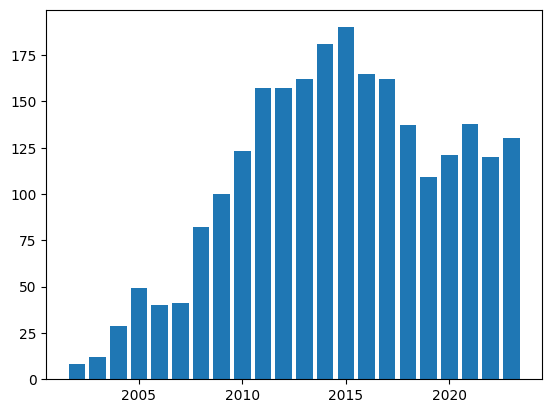

Sean McPherson
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


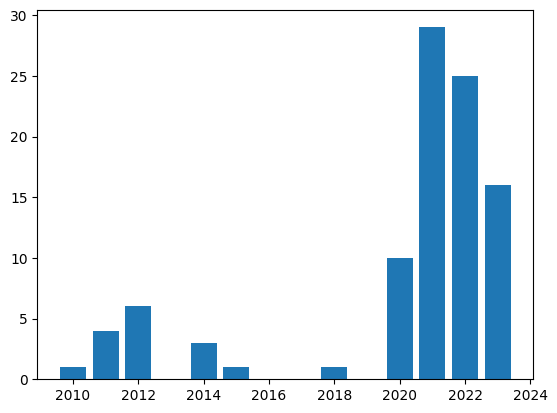

Lina Rojas-Barahona
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


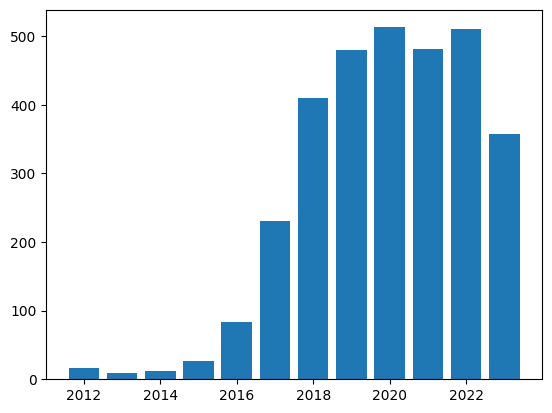

Douglas Creighton
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


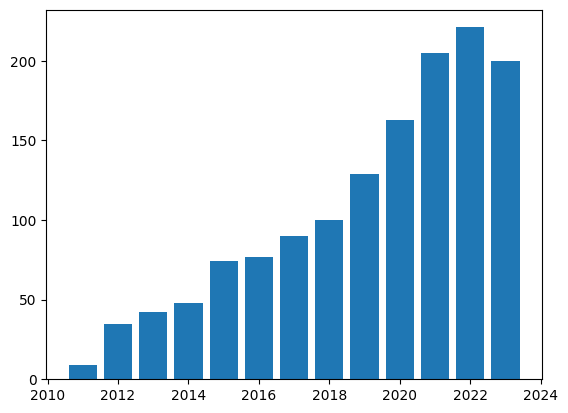

Xiaorui Liu
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


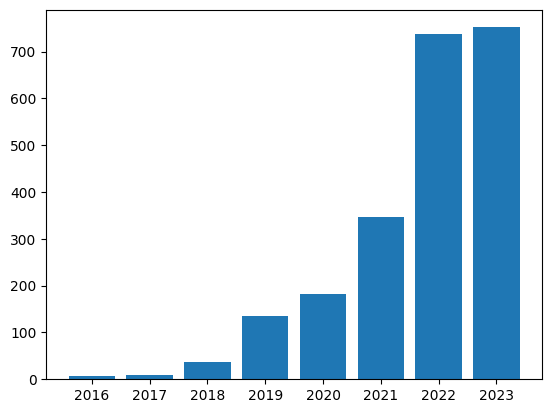

Linghe Kong
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


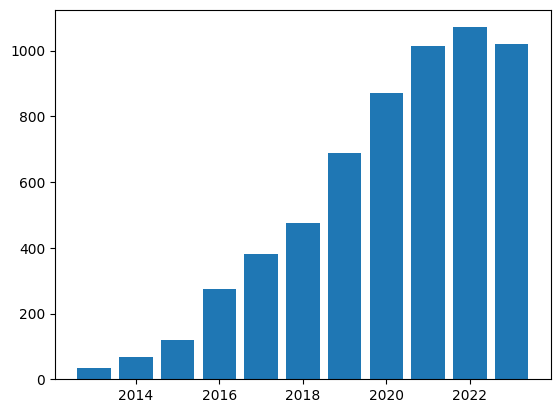

Lukas Gruber
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


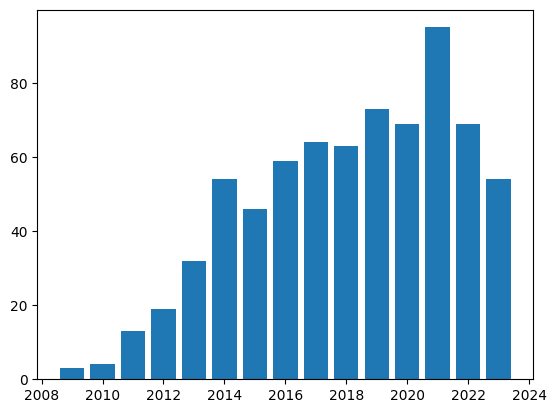

Quoc Le
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


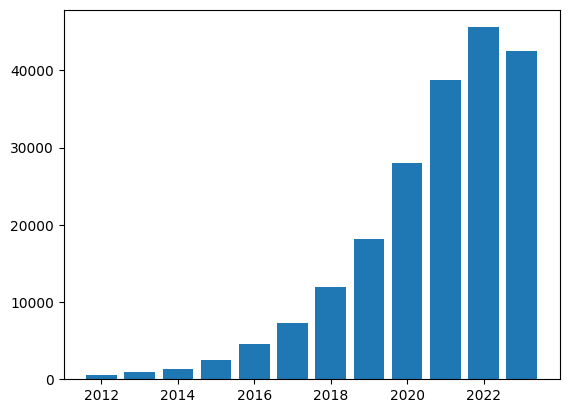

Navdha Agarwal
[2021, 2022, 2023]


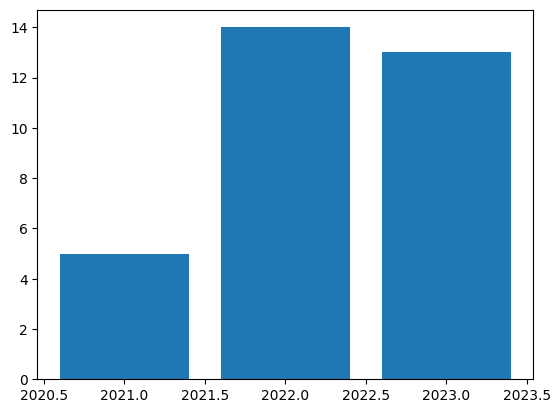

James H. Cole
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


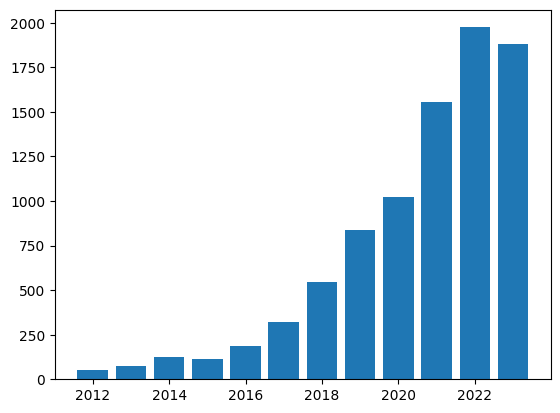

Fahad Shahbaz khan
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


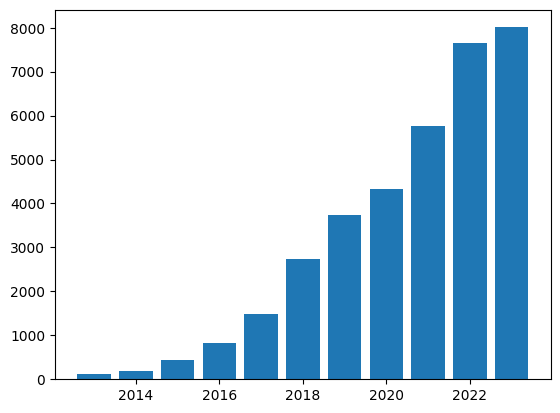

Isaac Bentata Chocron
[2021, 2022]


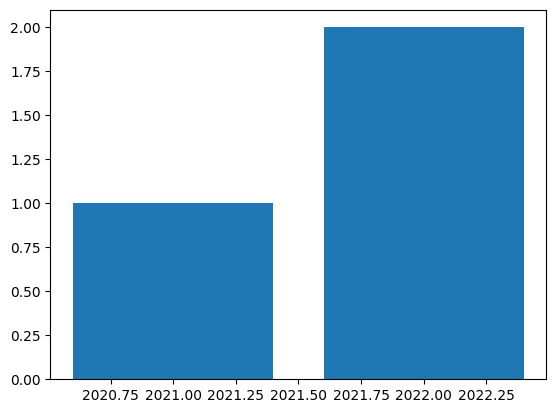

Hongge Chen
[2018, 2019, 2020, 2021, 2022, 2023]


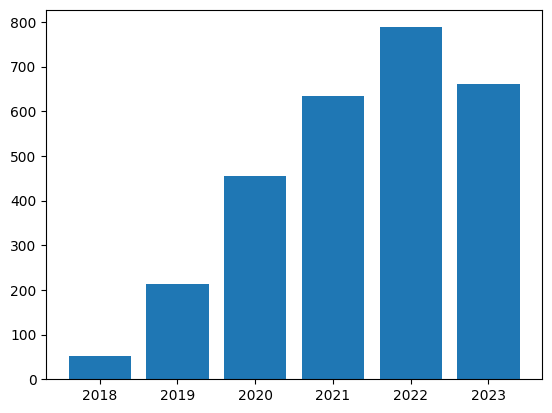

Yibo Zhu
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


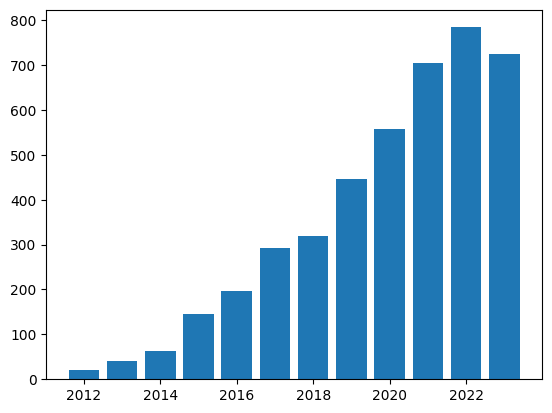

Mina Naghshnejad
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


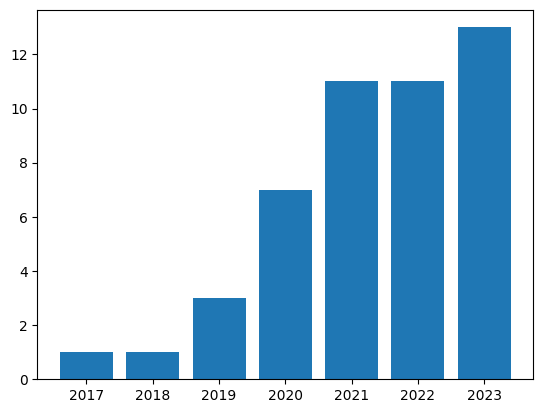

Chang Wei Tan
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


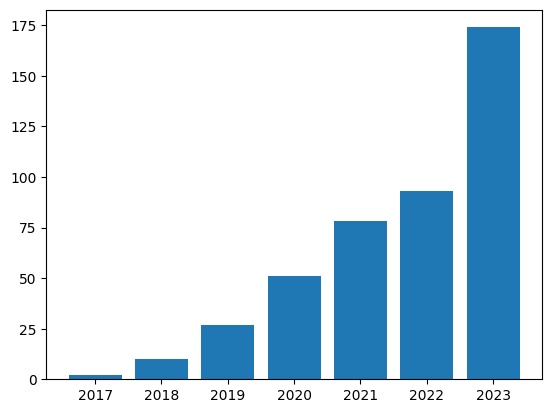

Sijia Liu
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


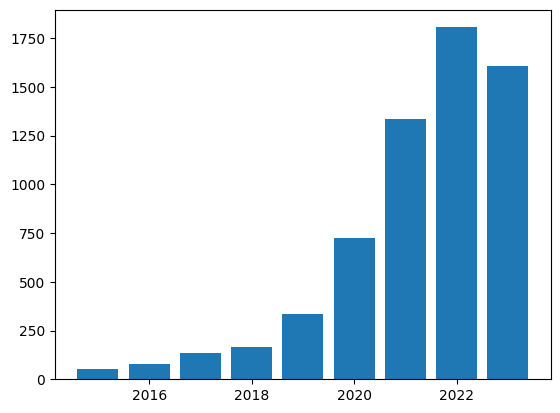

Arvind Ramanathan
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


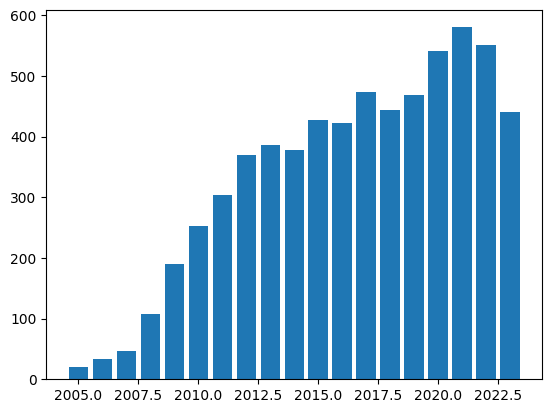

Ruochen Zhang
[2020, 2021, 2022, 2023]


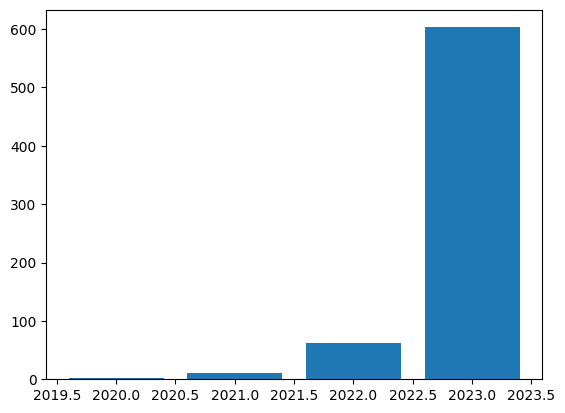

Malcolm Greaves
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


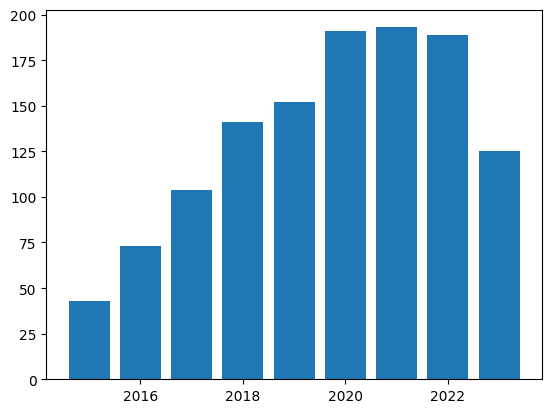

Khadija Kanwal
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


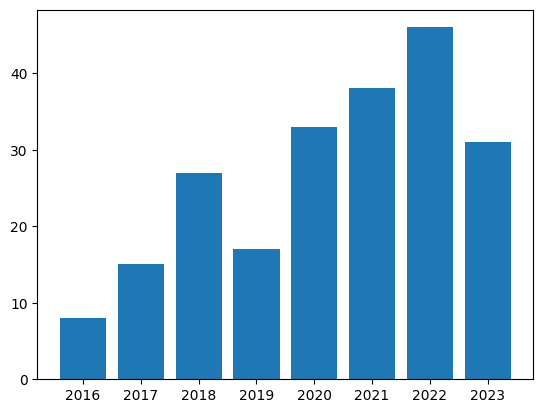

Bennett Landman
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


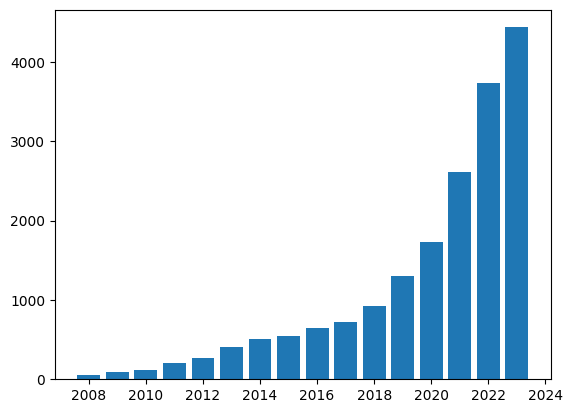

Wael AbdAlmageed
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


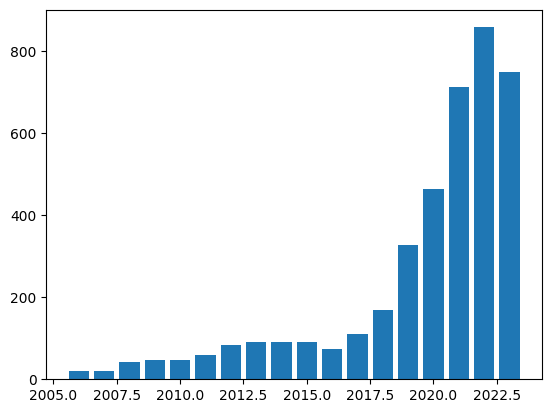

Zhongwei Wan
[2021, 2022, 2023]


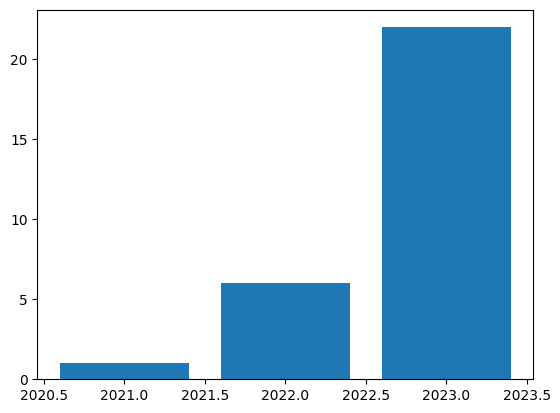

Relja Arandjelović
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


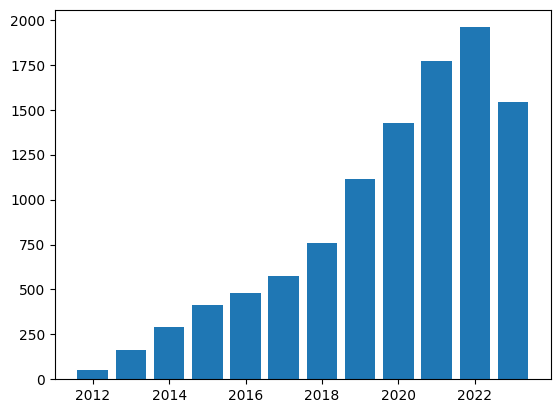

Saahil Jain
[2020, 2021, 2022, 2023]


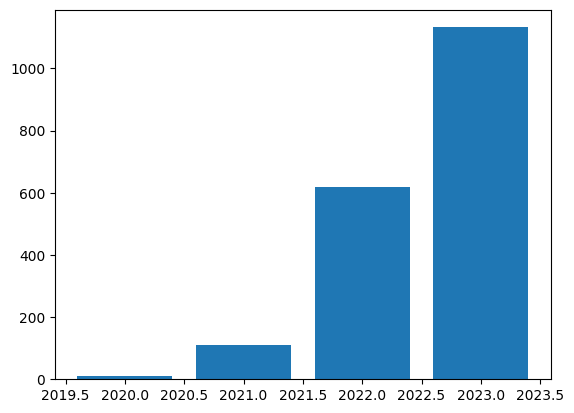

Thomas Dopierre
[2021, 2022, 2023]


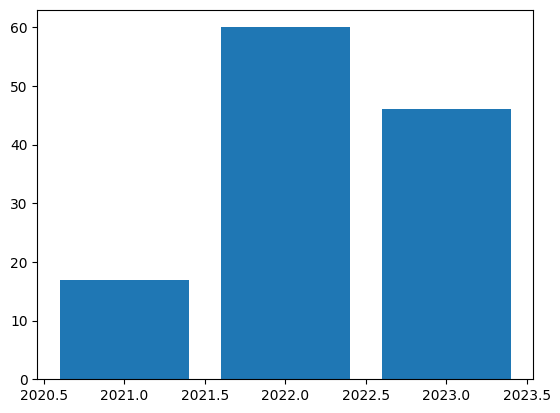

Dario Rossi
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


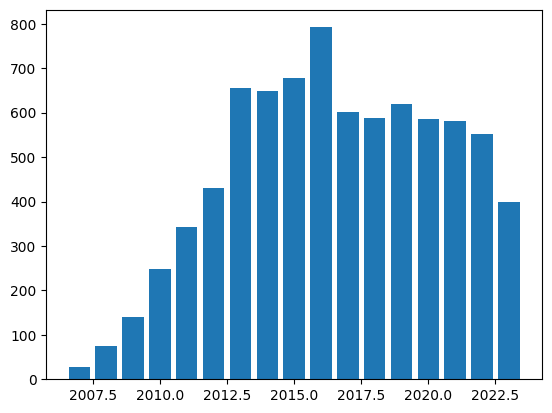

Alberto Garcia-Garcia
[1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


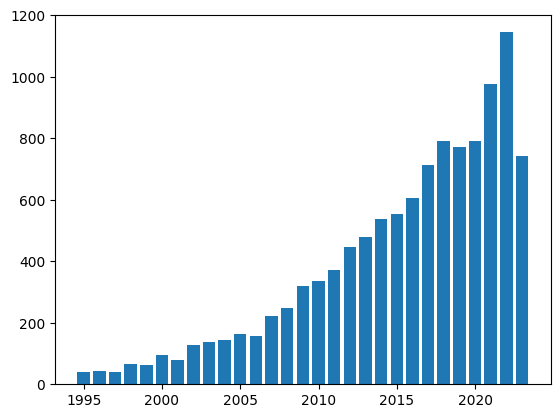

Yanfei Wang
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


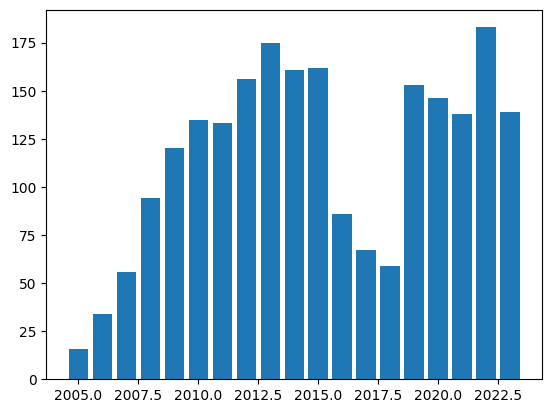

Junfeng Zhang
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


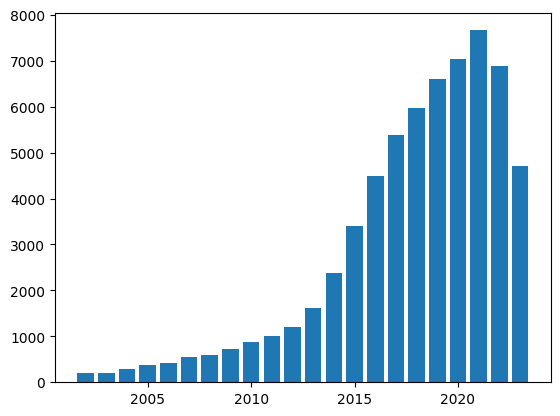

Sourav Saha
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


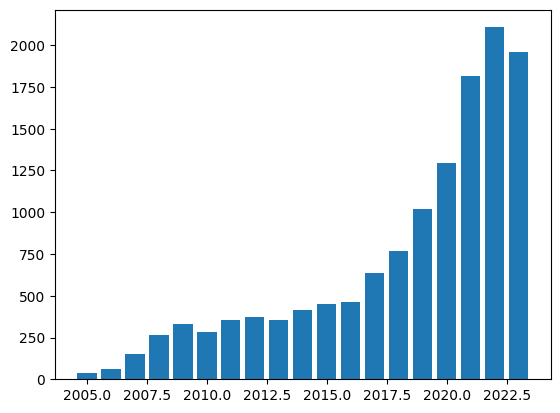

David Salinas
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


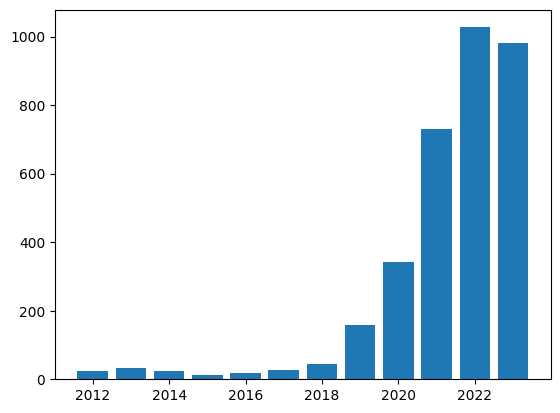

Brian Murphy
[1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


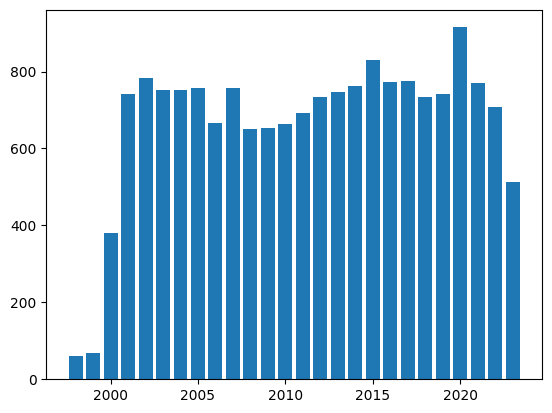

Gaurav Menghani
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


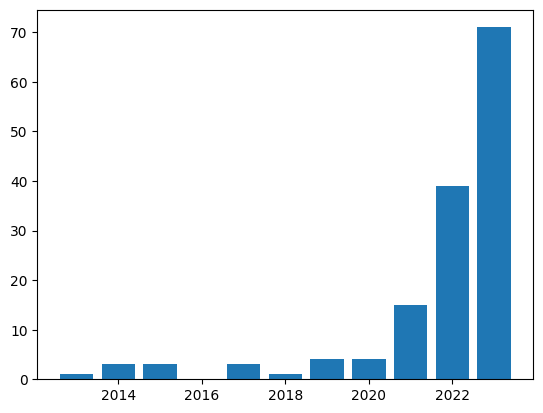

Ian Reid
[1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


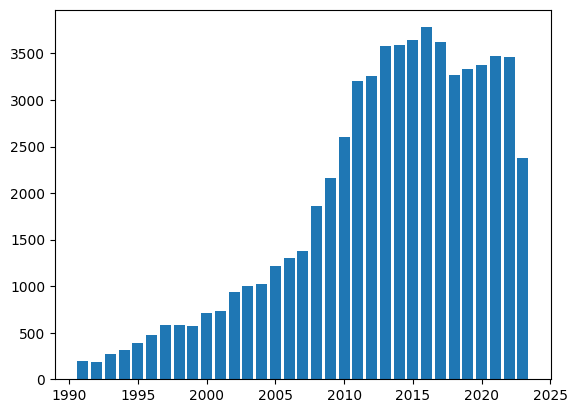

Jieping Ye
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


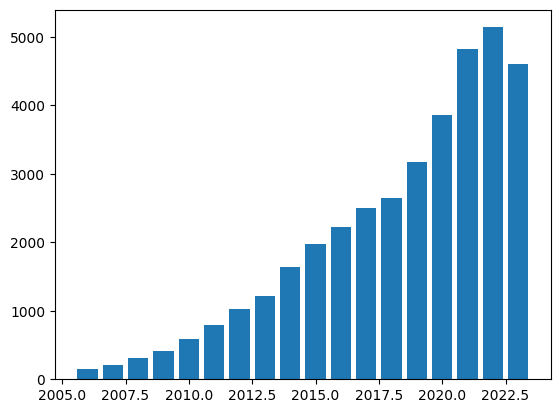

Shihe Wang
[2021, 2022, 2023]


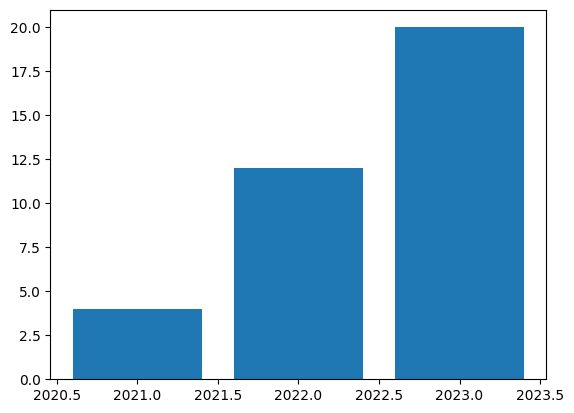

Yonghui Wu
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


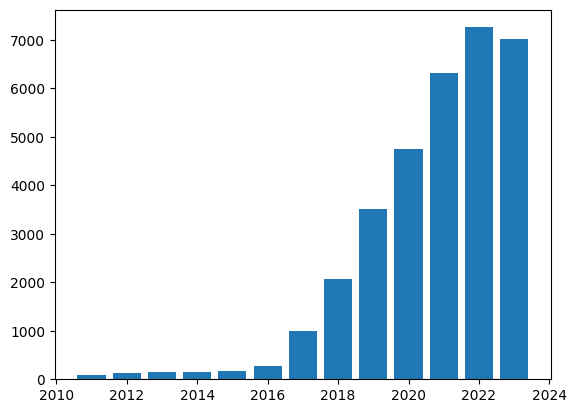

Cordelia Schmidt
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


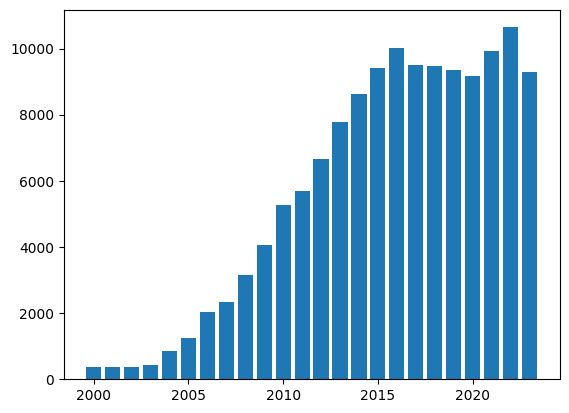

Gael Jobard
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


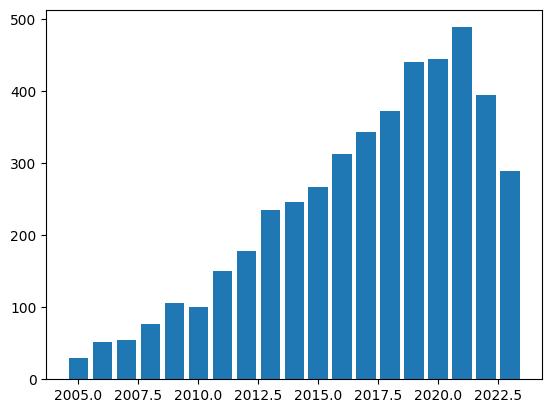

Ashish Jaiswal
[2020, 2021, 2022, 2023]


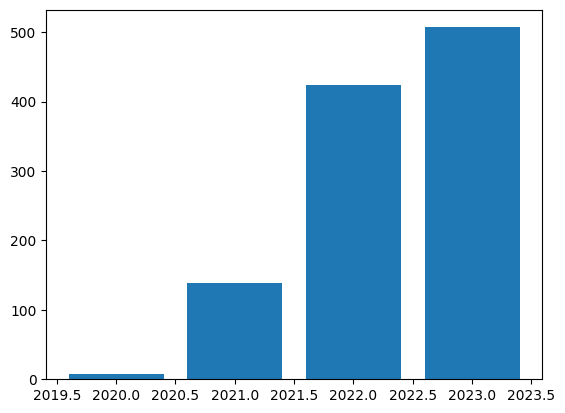

Yuxin Wang
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


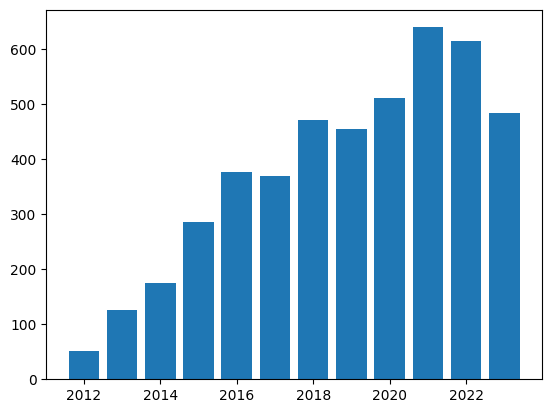

Ruchi Pandey
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


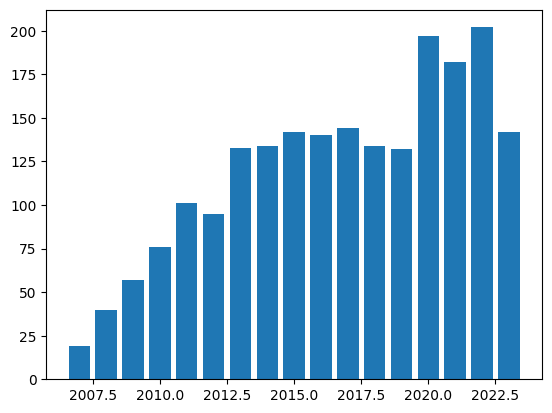

Jared Roesch
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


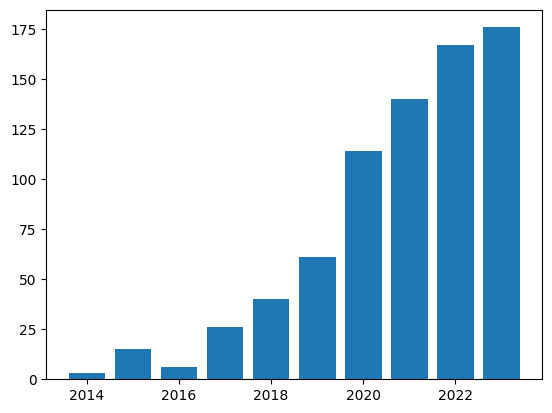

Yijia Zhang
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


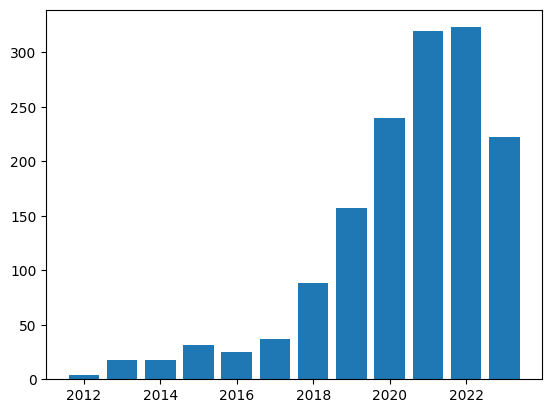

Hao Zhang
[1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


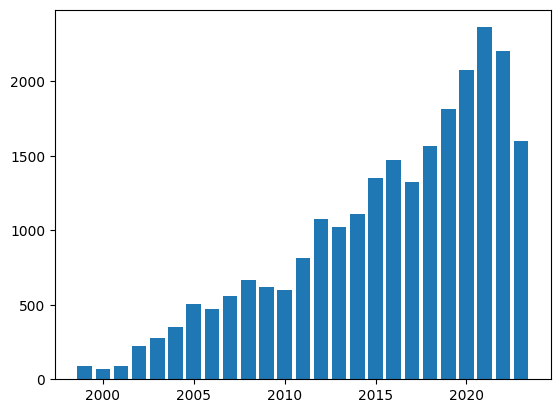

Daniel Sáez Trigueros
[2018, 2019, 2020, 2021, 2022, 2023]


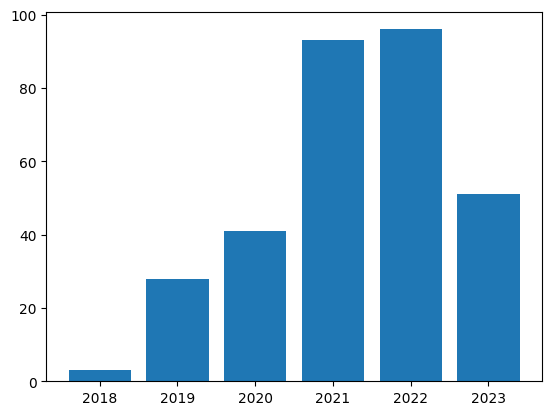

Fabien Moldonado
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


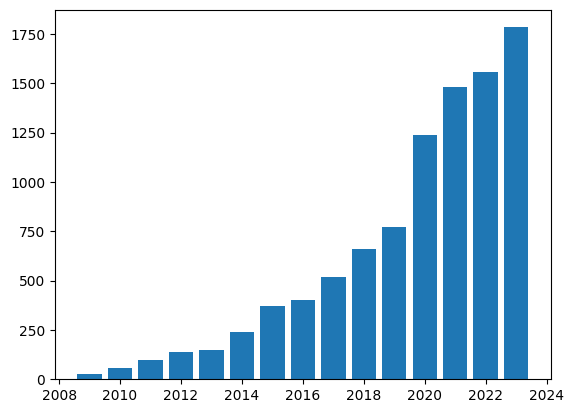

Xiao Han
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


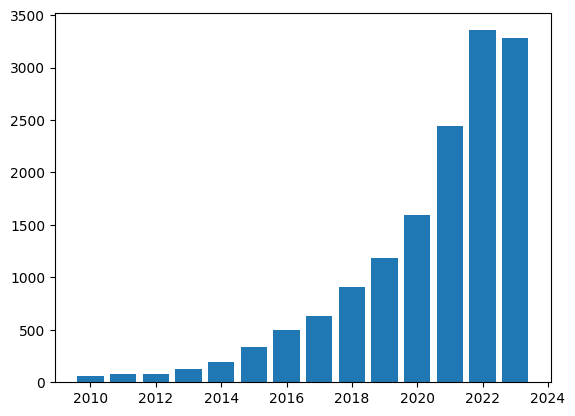

Dapeng Wu
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


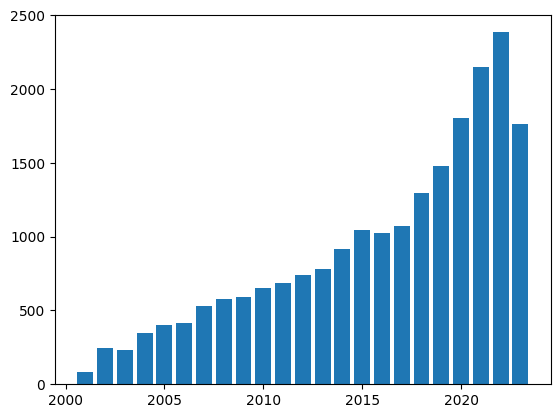

David W. Anderson
[1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


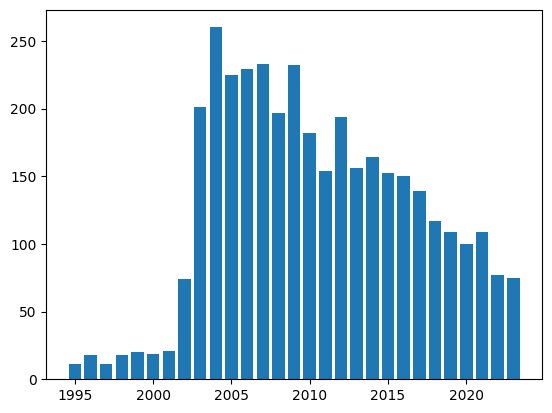

Fangjian Lin
[2021, 2022, 2023]


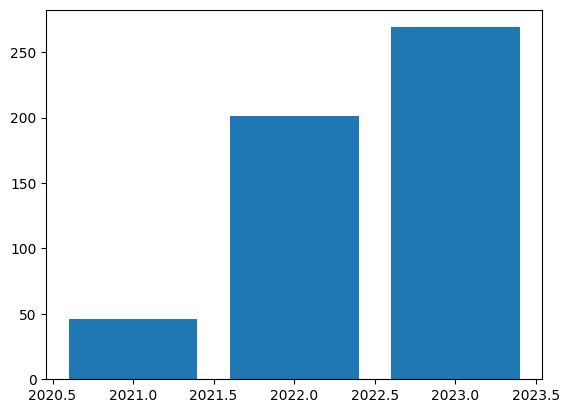

Ali Khodadadi
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


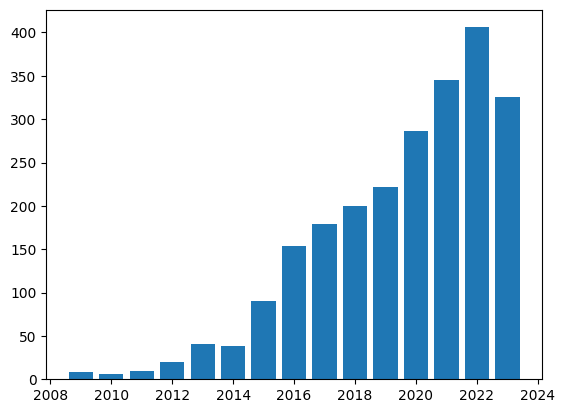

Zhong Yang
[1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


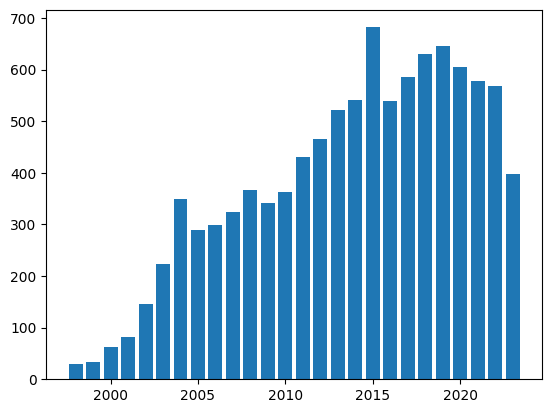

Steve Yadlowsky
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


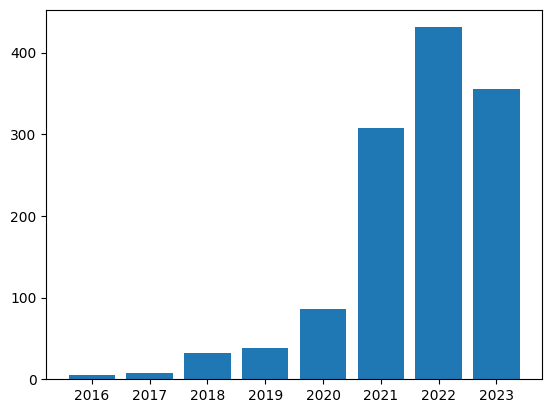

Marcel van Gerven
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


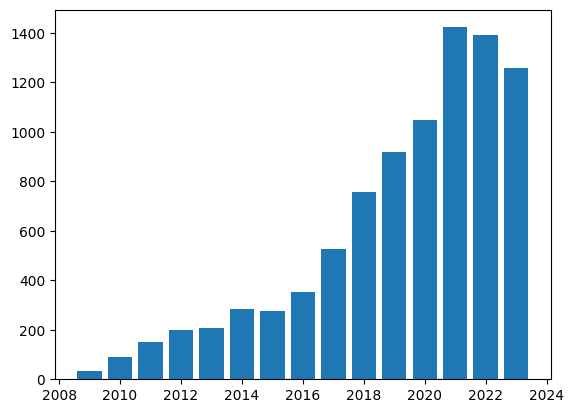

Dana Rezazadegan
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


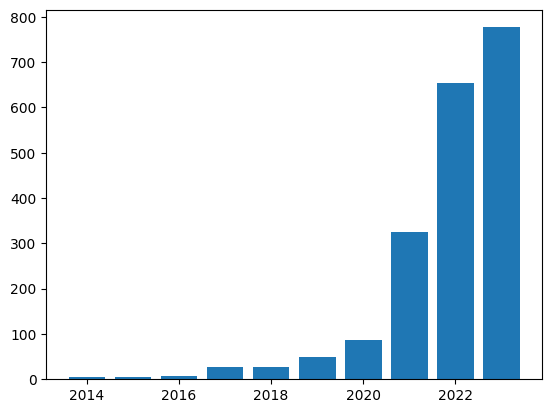

Marc Moreno Lopez
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


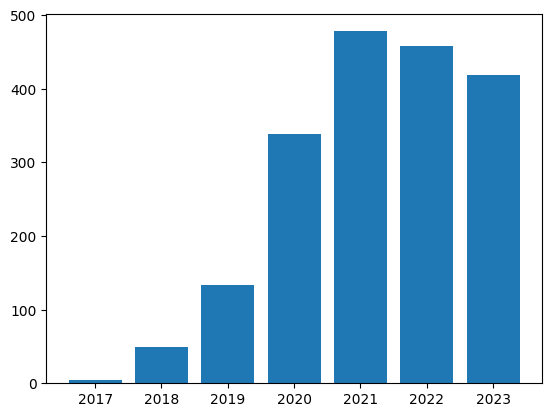

Haiyang Xu
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


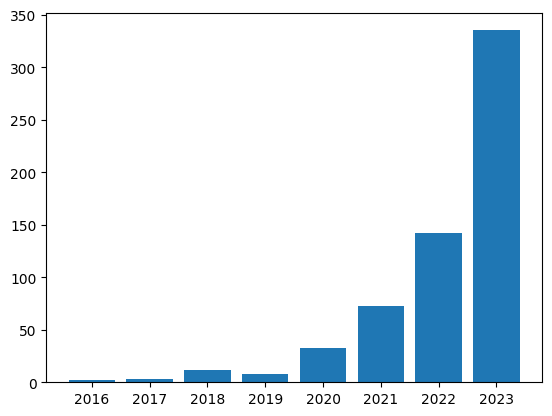

Christina Chen
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


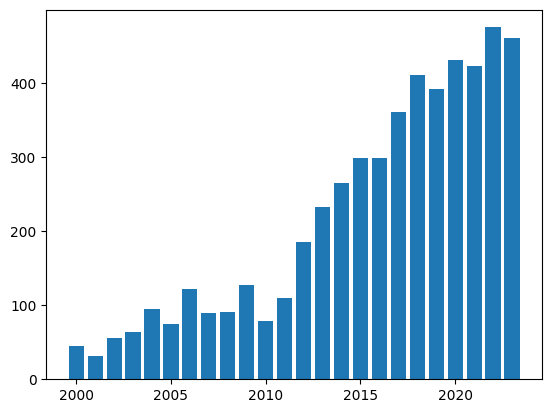

Tao Mei
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


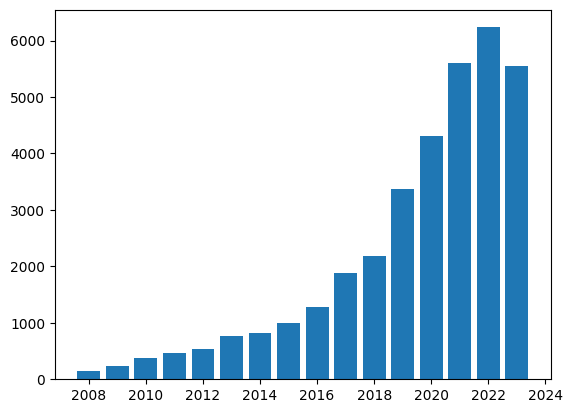

V. Della Pietra
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


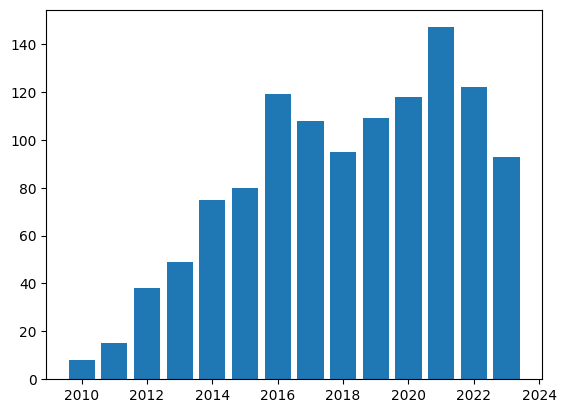

Qingzhong Wang
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


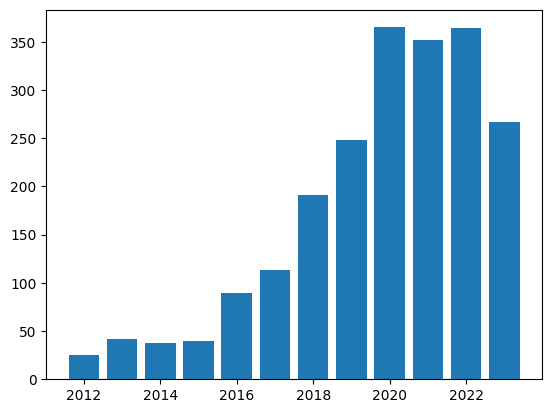

Jianning Li
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


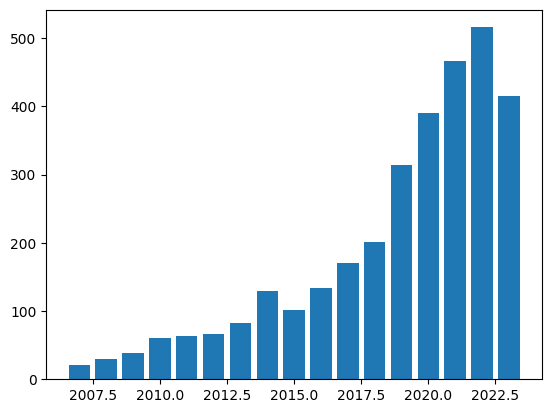

Abhinav Gupta
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


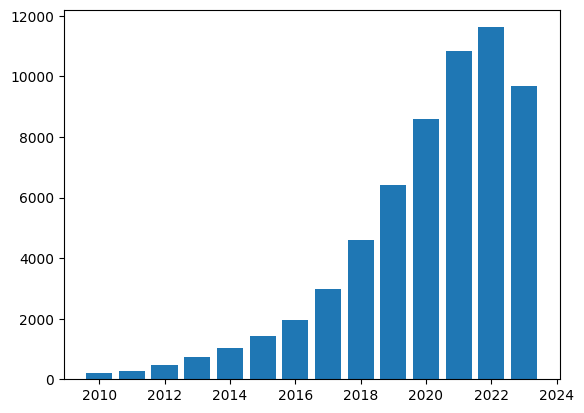

Ying-Cong Chen
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


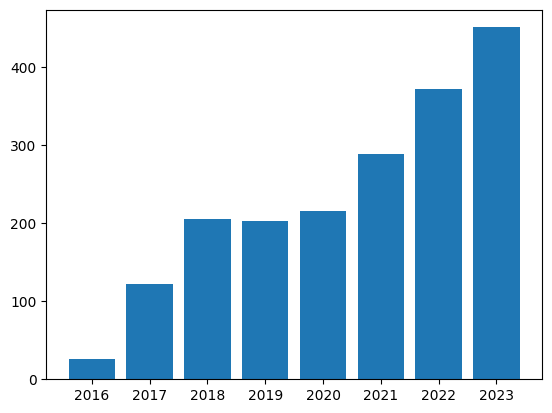

Bevan Koopman
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


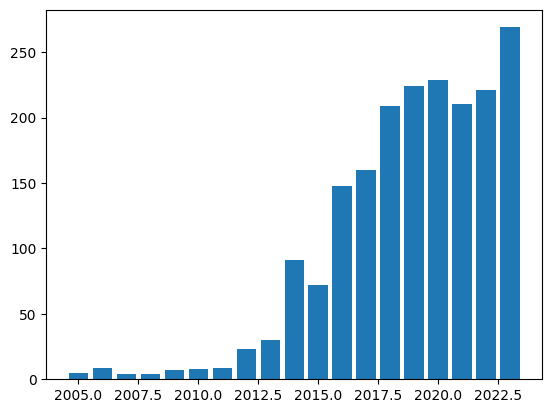

Yi-Fan Zhang
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


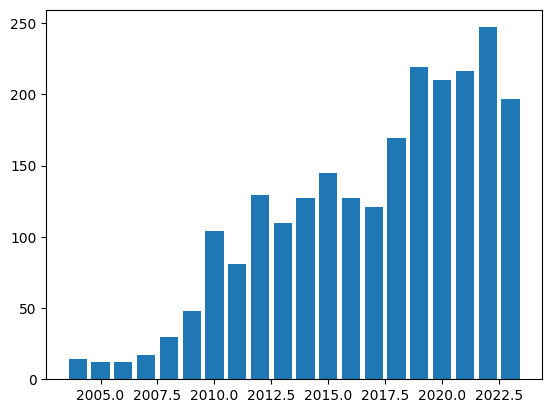

Patrick Hammer
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


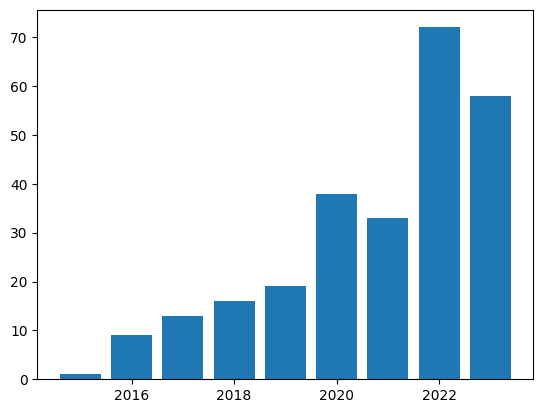

Lifan Yuan
[2021, 2022, 2023]


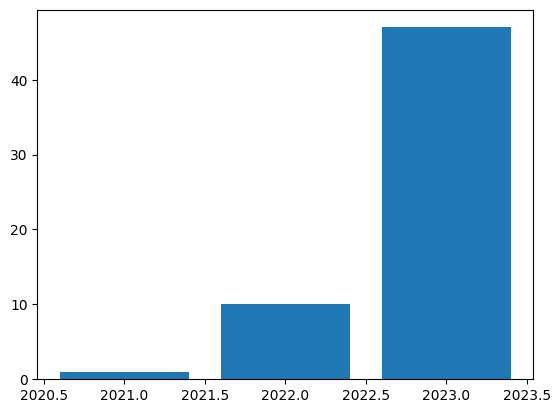

Donald Metzler
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


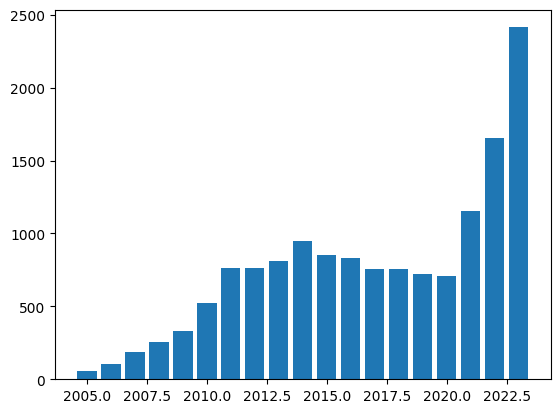

Daniel Probst
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


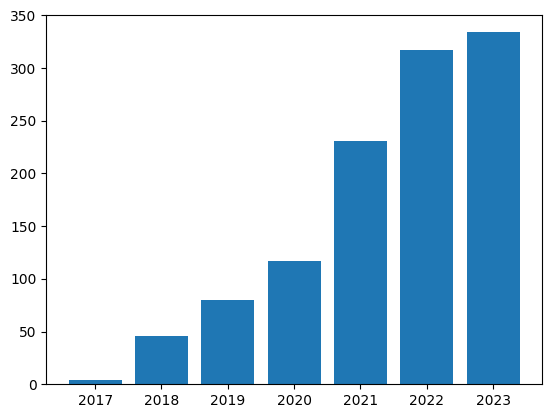

Damilola Adesina
[2019, 2020, 2021, 2022, 2023]


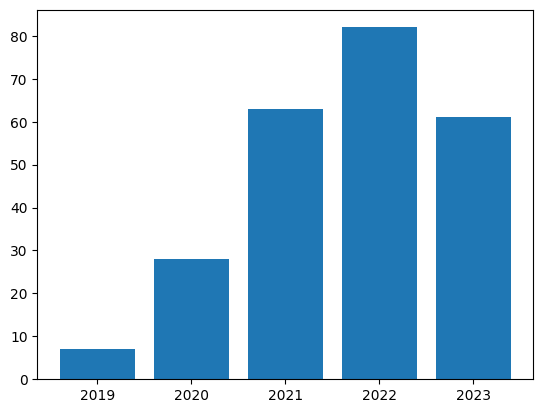

Jake Russin
[1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


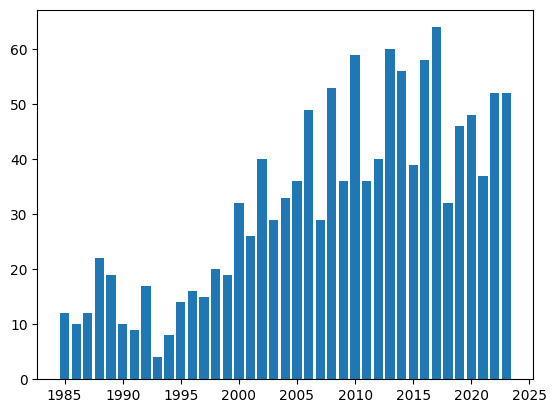

Maryam Abdool
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


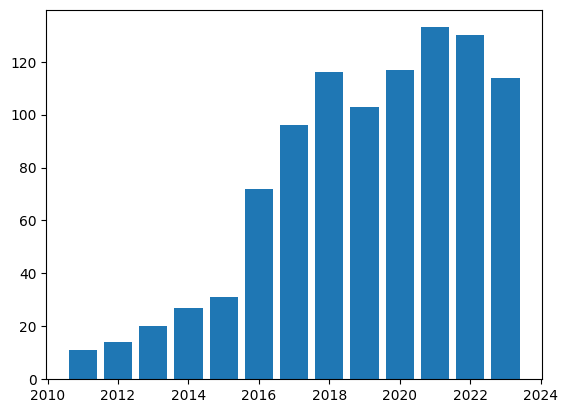

Anthony Dick
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


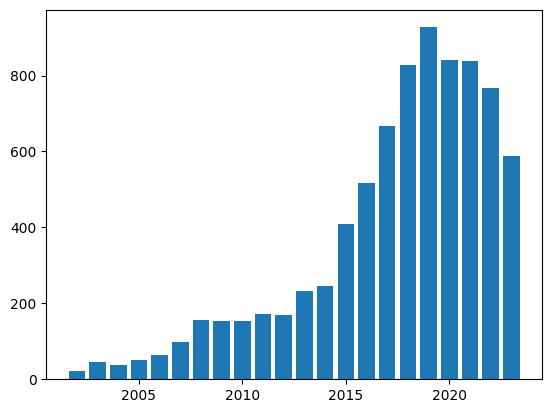

Lazhar Khelifi
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


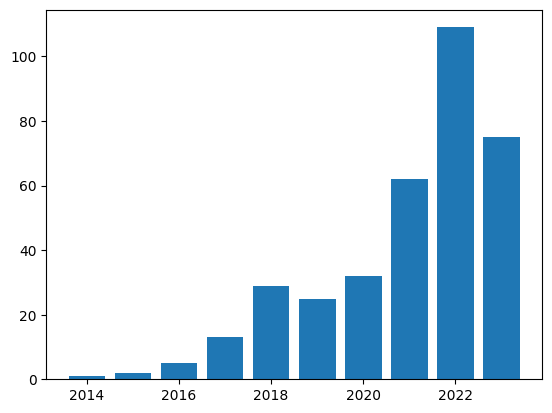

Abhishek Singh
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


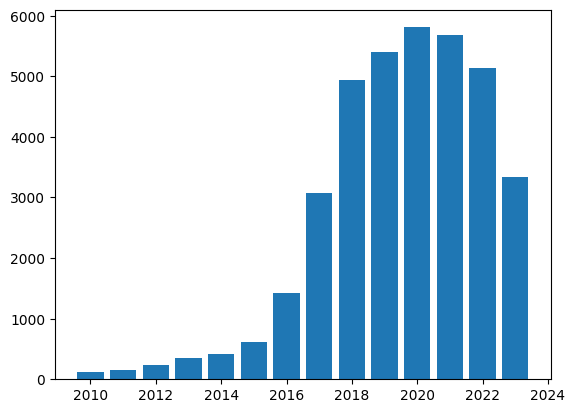

Raphaël Puget
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


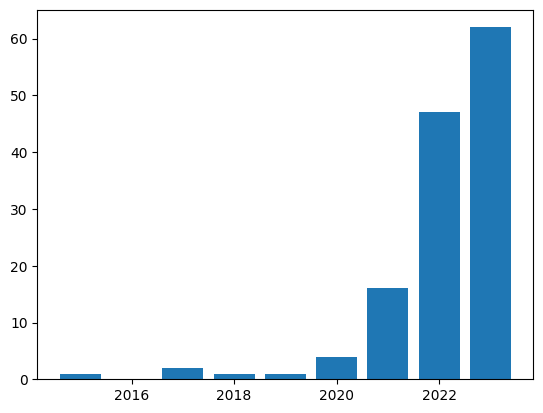

Gargi Joshi
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


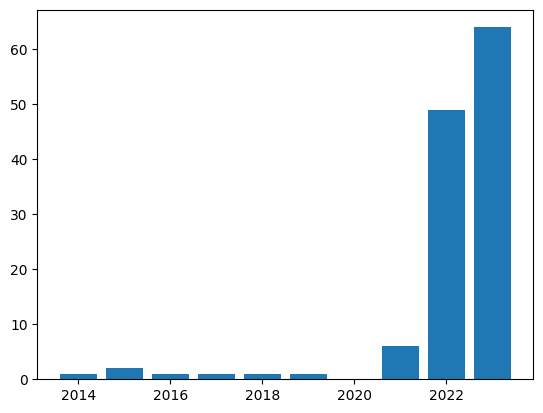

Fei Sha
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


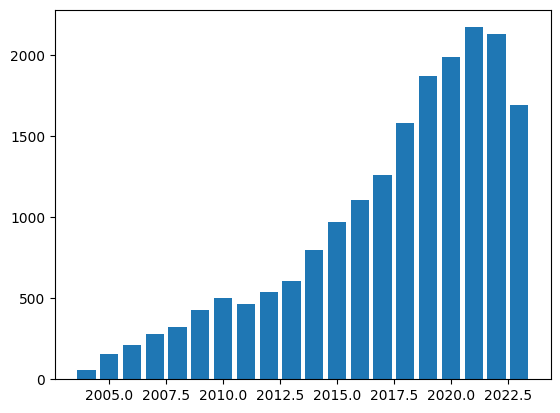

Nishant Subramani
[2020, 2021, 2022, 2023]


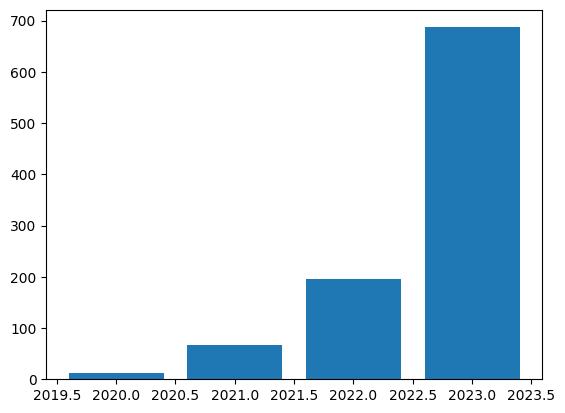

Ningyu Zhang
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


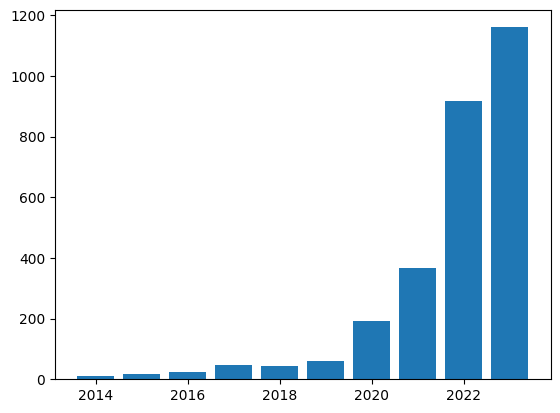

Alejo Nevado-Holgado
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


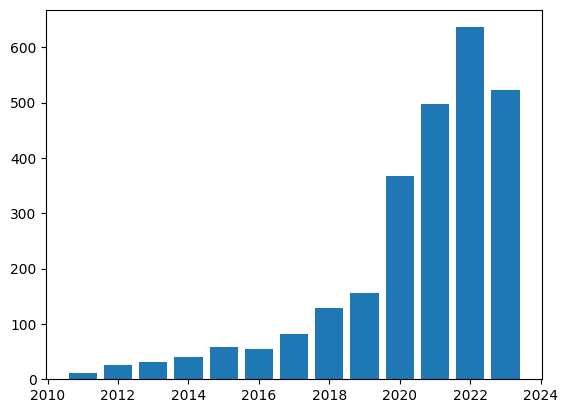

Akshay Kumar Gupta
[1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


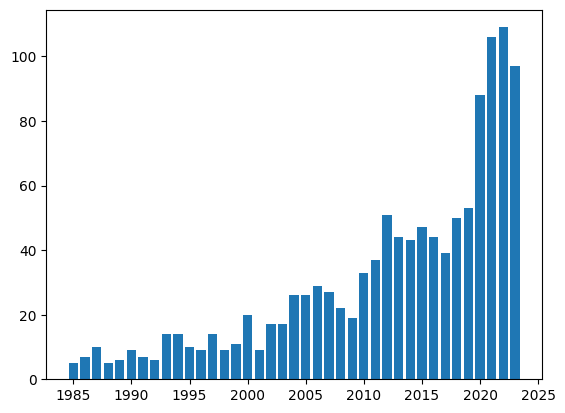

Max Müller-Eberstein
[2020, 2021, 2022, 2023]


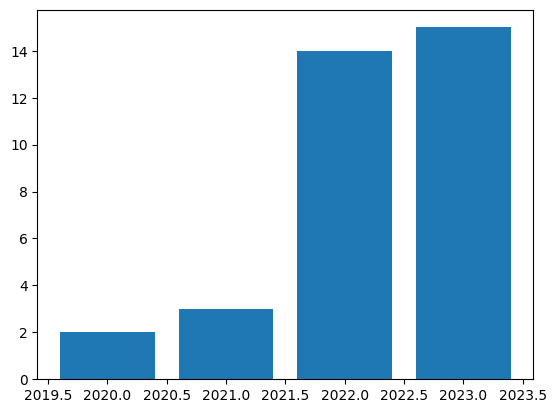

Shan Liu
[1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


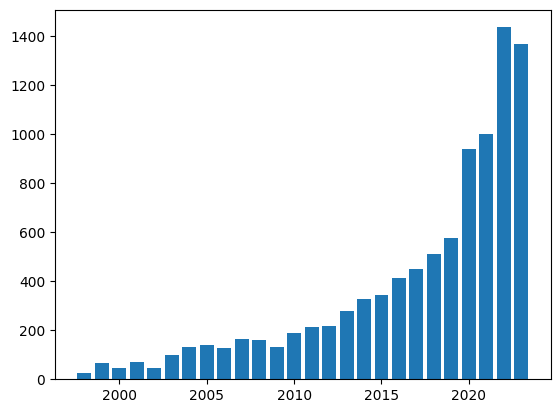

Guy Cloutier
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


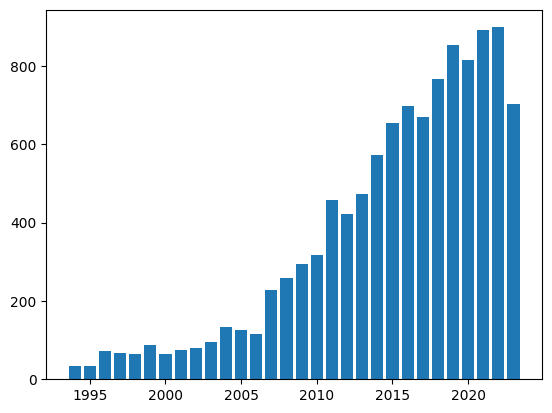

Huiji Gao
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


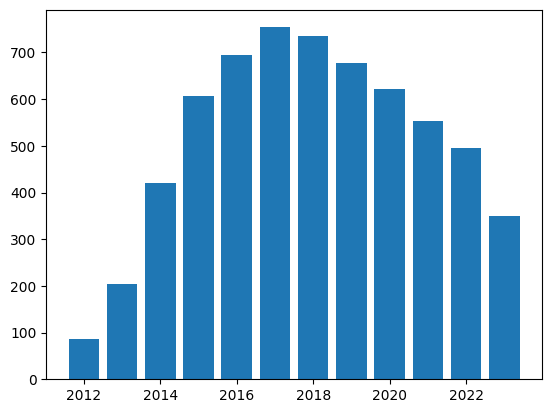

Shen Yan
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


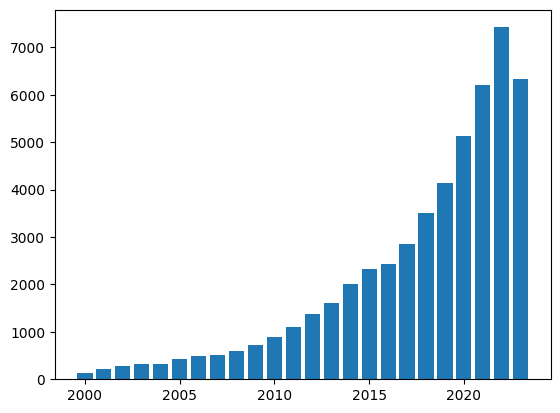

Zhenheng Tang
[2019, 2020, 2021, 2022, 2023]


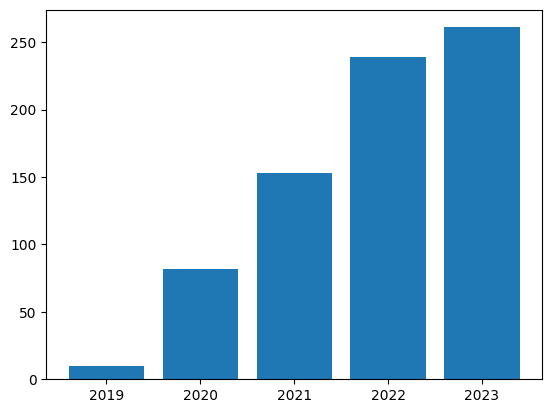

Zichao Long
[2018, 2019, 2020, 2021, 2022, 2023]


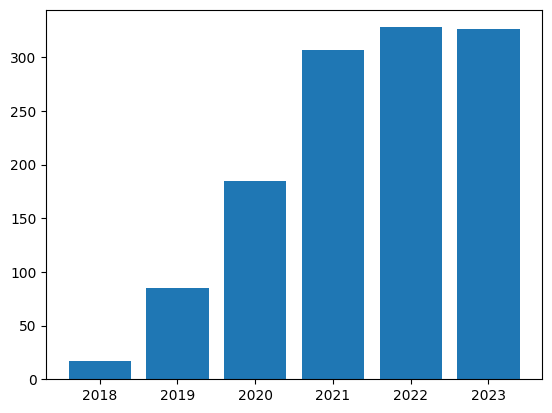

Ping Zhou
[1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


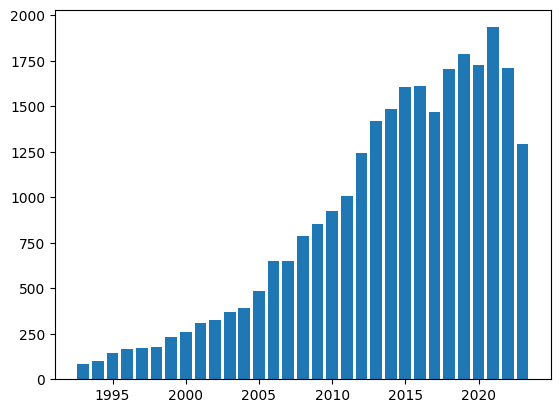

Brian Spiesman
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


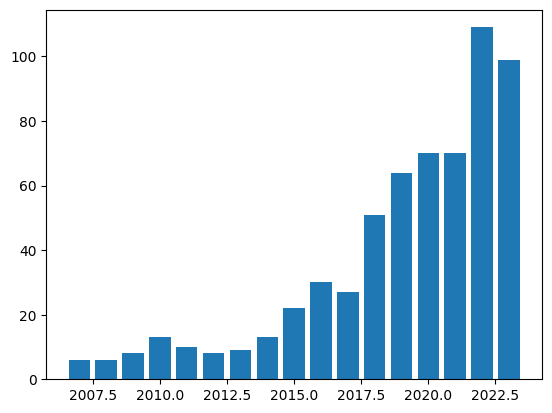

Chiradeep Roy
[2019, 2020, 2021, 2022, 2023]


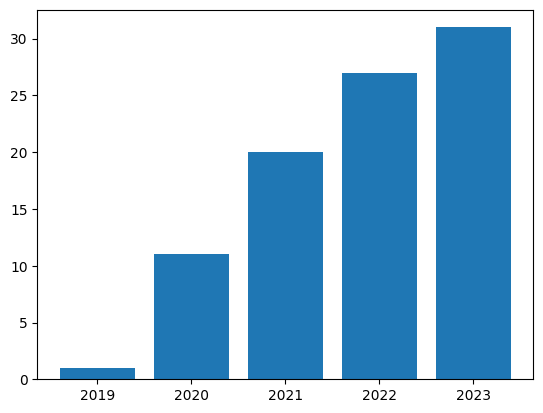

Satyendra Singh Chouhan
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


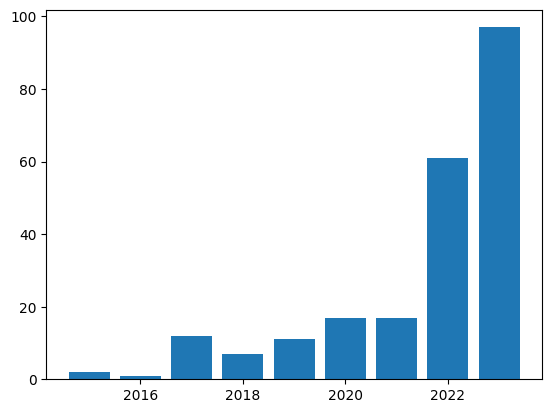

Heng-Lu Chang
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


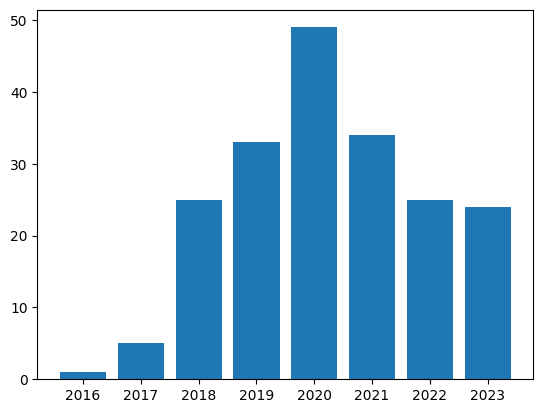

Anton van den Hengel
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


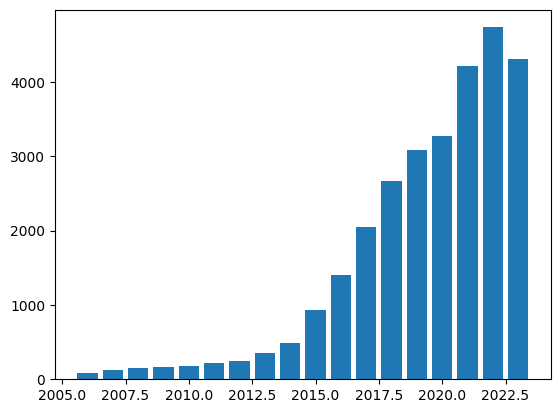

Qi Hao
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


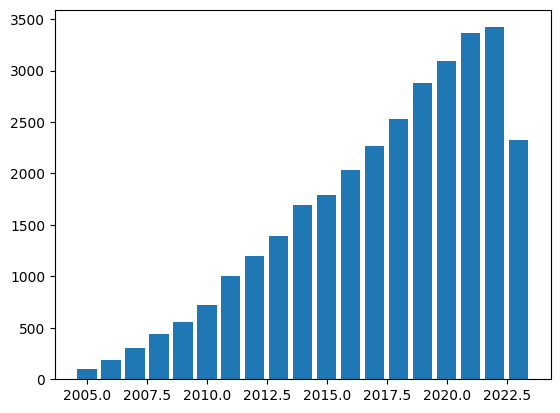

Irene Li
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


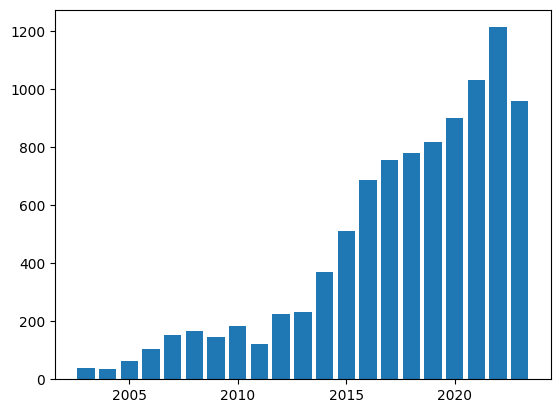

Xu Zhou
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


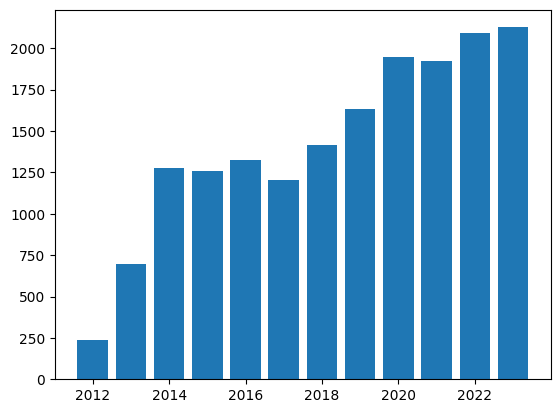

Jianqing Fan
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


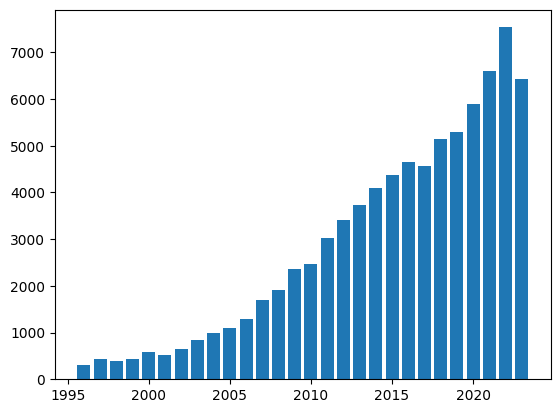

Abelino Jimenez
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


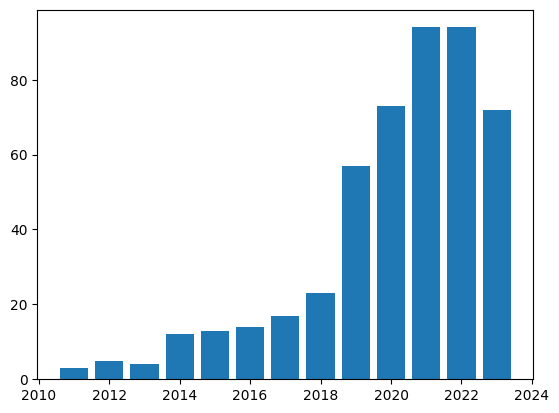

Bharath Challa
[2021, 2022]


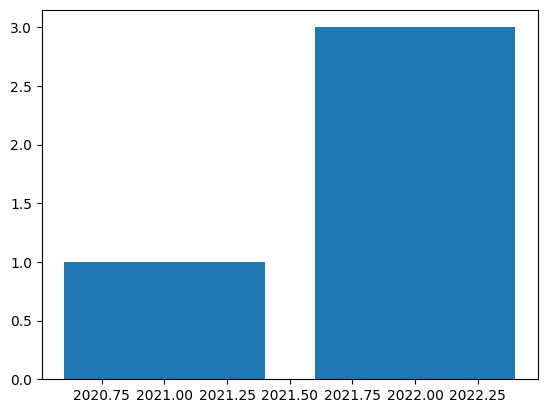

Vivek Khetan
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


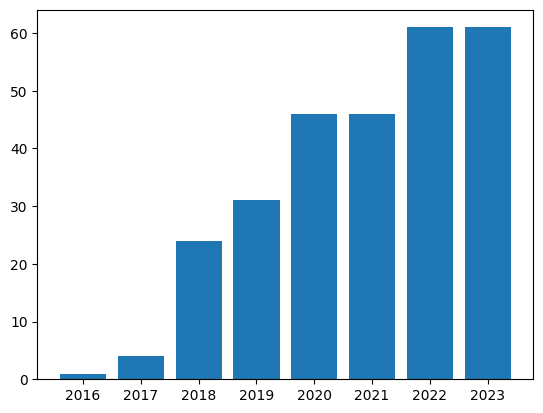

Lucas Valentin
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


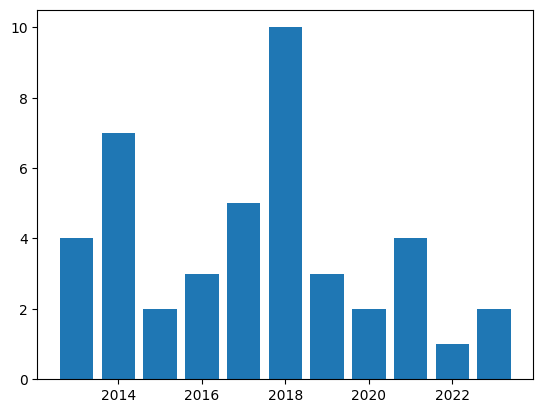

Han-Wei Shen
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


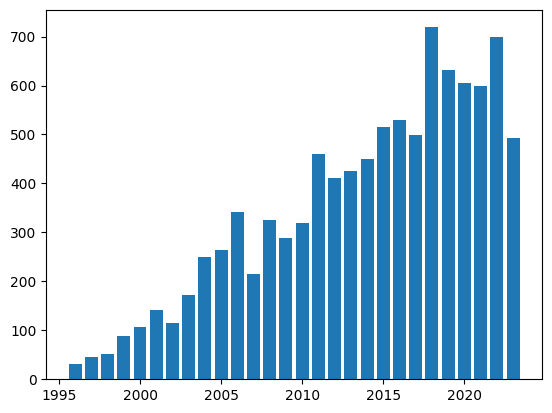

Xiaoguang Han
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


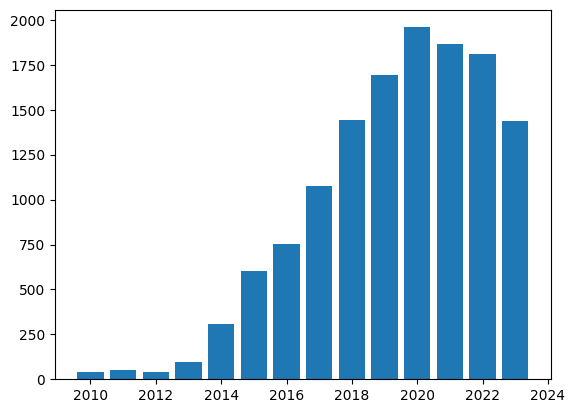

Lirong Wu
[2020, 2021, 2022, 2023]


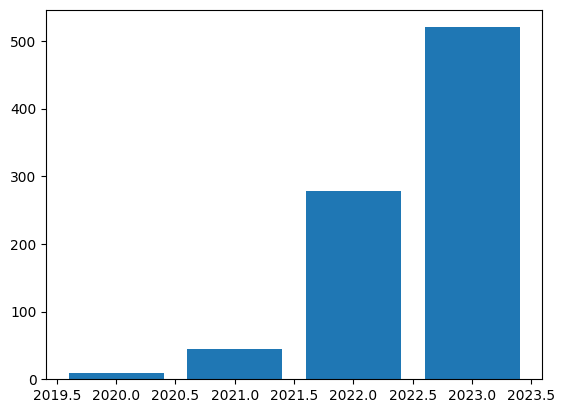

Qingbao Huang
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


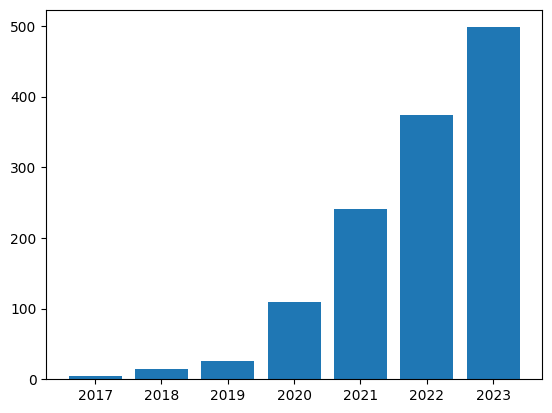

Donglin Zhan
[2019, 2020, 2021, 2022, 2023]


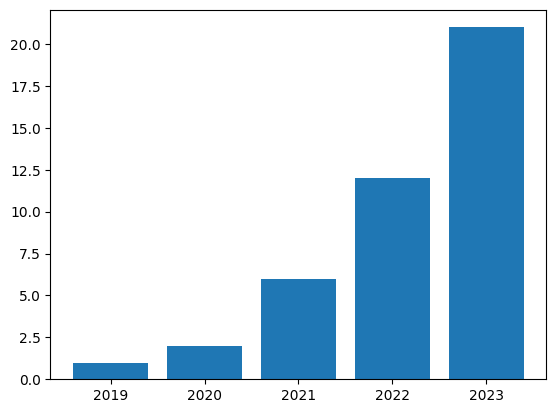

Shuo Han
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


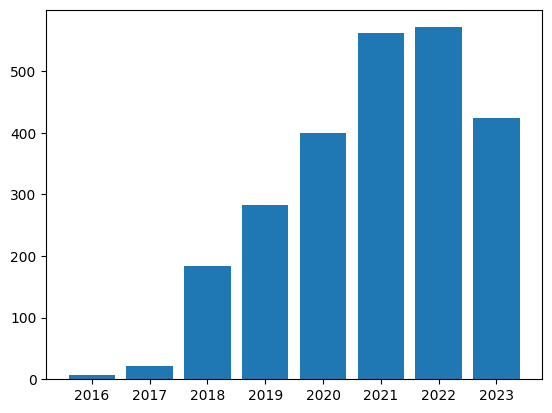

Avishek Nag
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


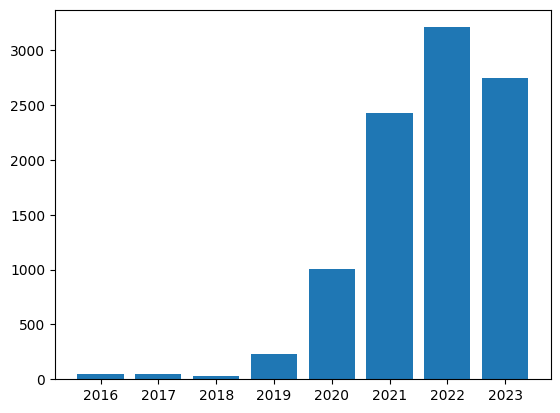

Vincent Albouy
[2018, 2019, 2020, 2021, 2022, 2023]


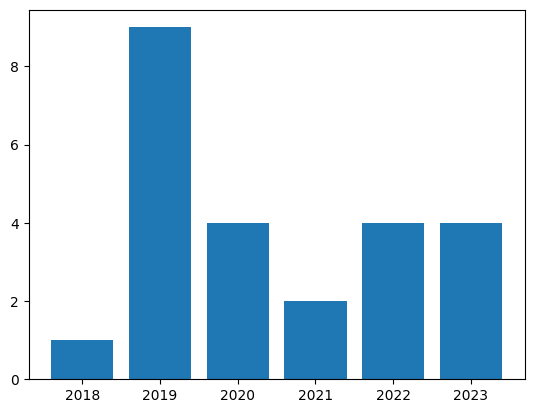

Rongpeng Li
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


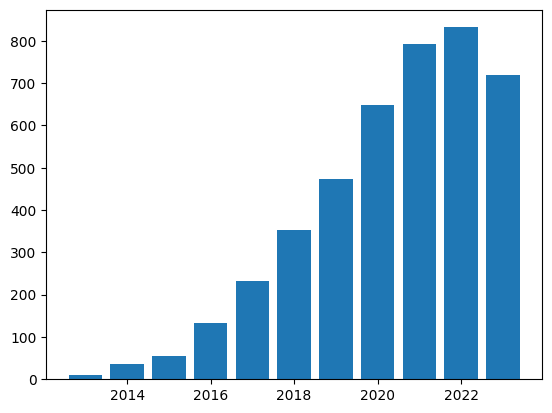

Denis Akhiyarov
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


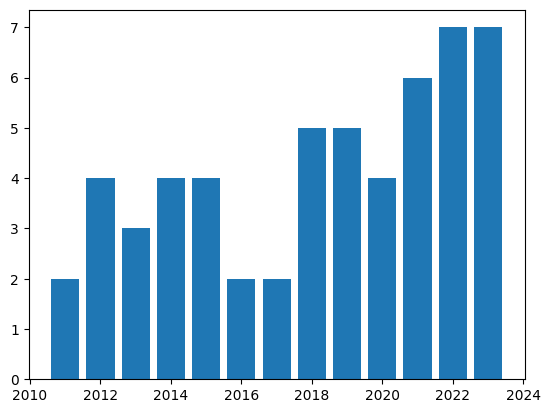

Cennet Oguz
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


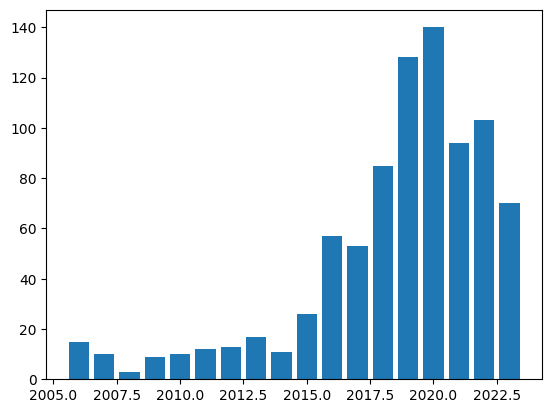

Gongjin Lan
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


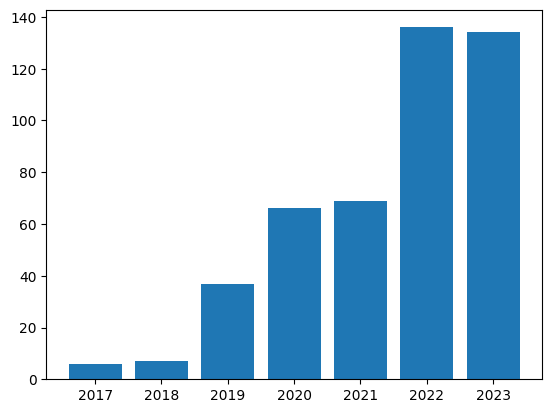

Niki Trigoni
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


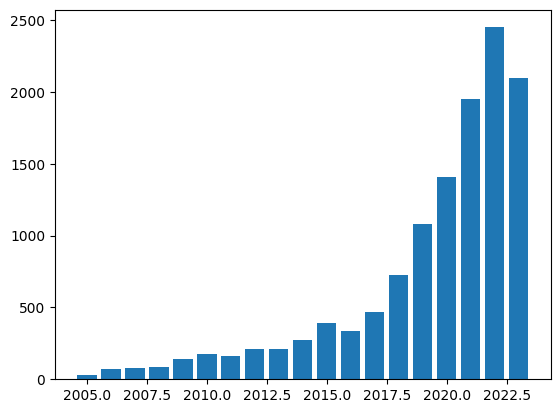

Klaus Ackermann
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


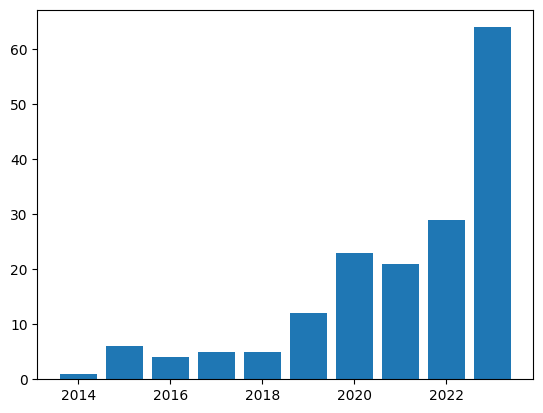

Alexander Wan
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


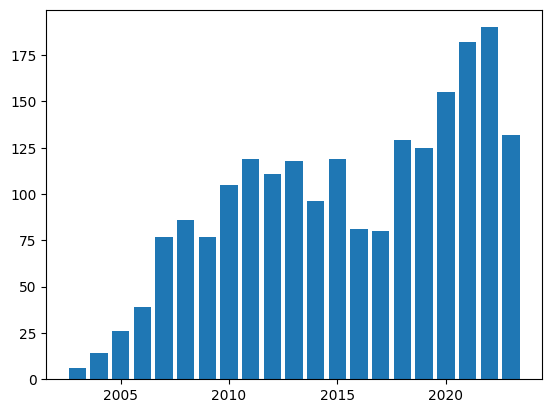

Stan. Z. Li
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


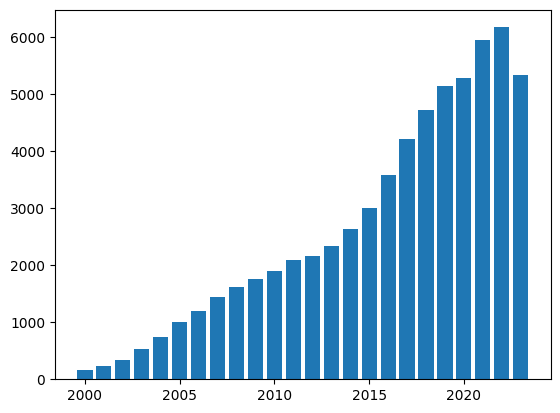

Vidya Prasad K
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


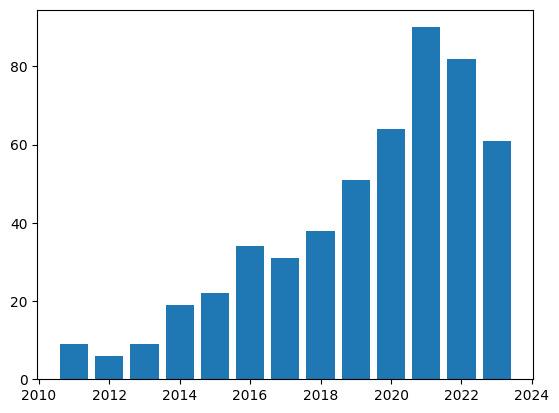

Lars Ruthotto
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


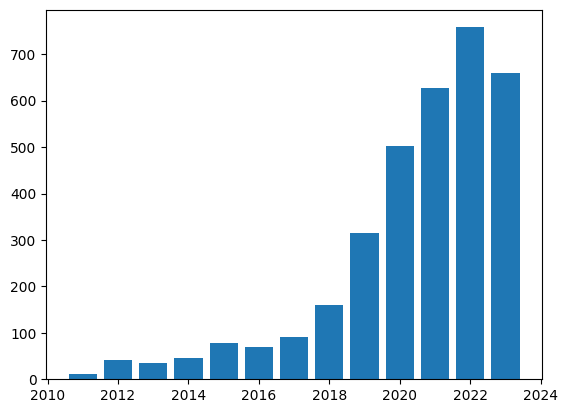

Ronan Collobert
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


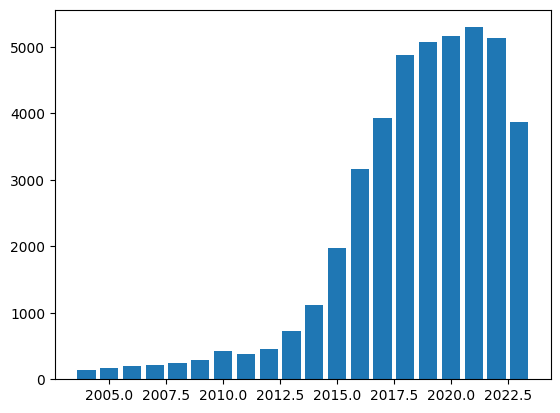

Shang Zhang
[1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


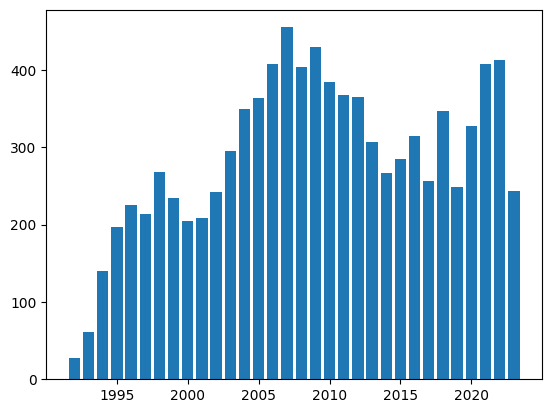

Wenhao Yu
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


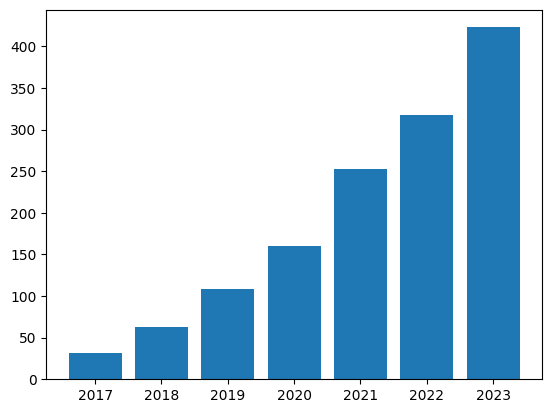

MD. Kamrul Hasan
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


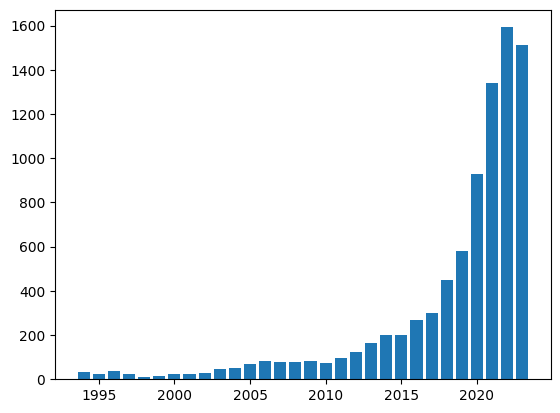

Wei Sun
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


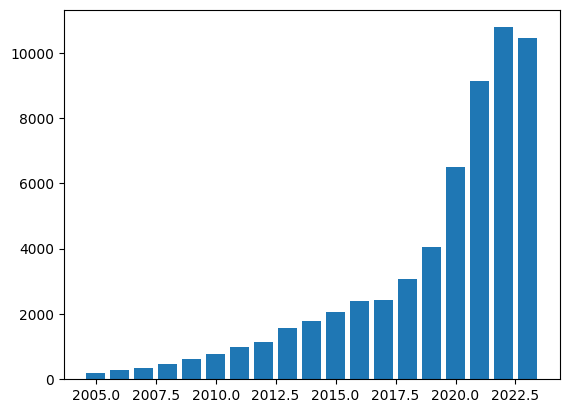

Noriaki Hirose
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


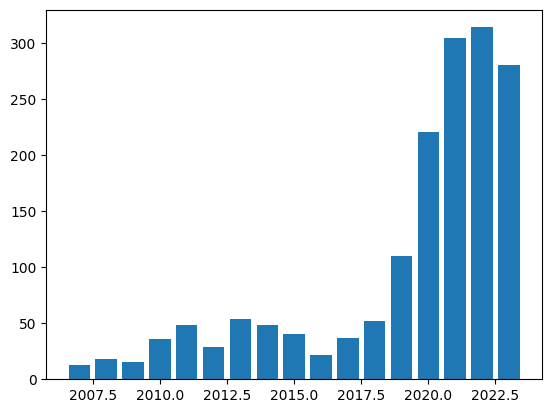

Fariz Rahman
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


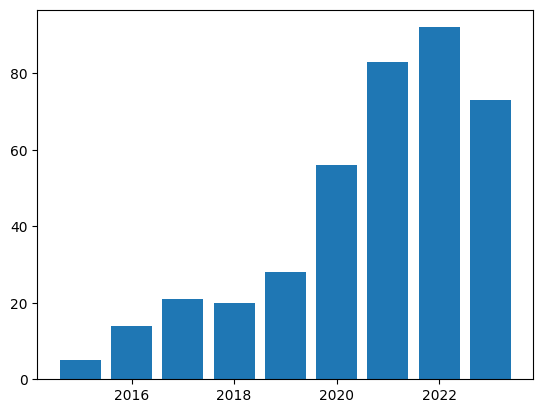

Ming Jin
[1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


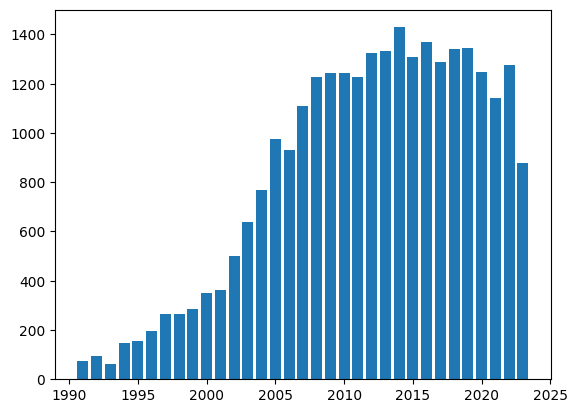

Kevin Xu
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


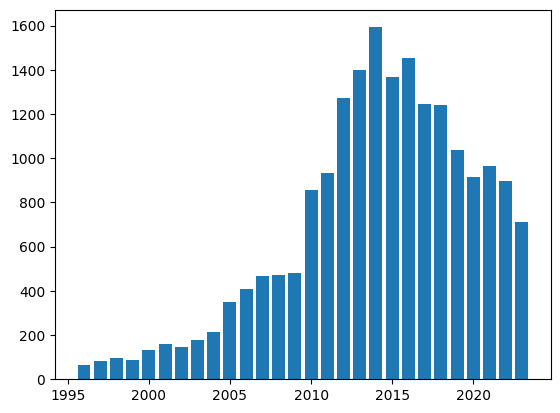

Mario Lucic
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


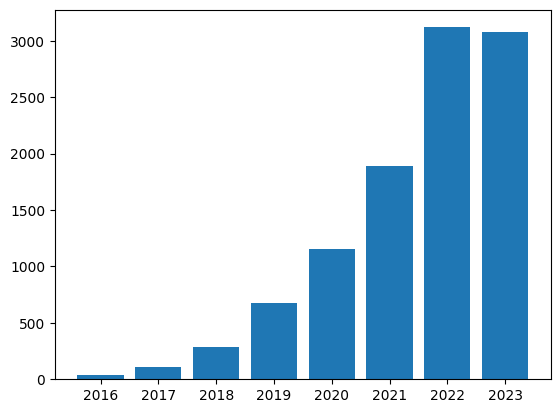

Silvia Severini
[1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


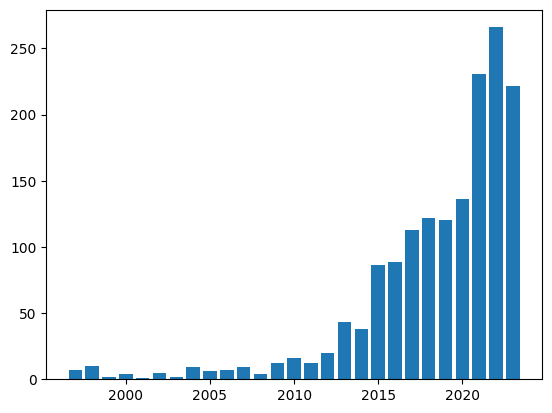

Tiago A. Almeida
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


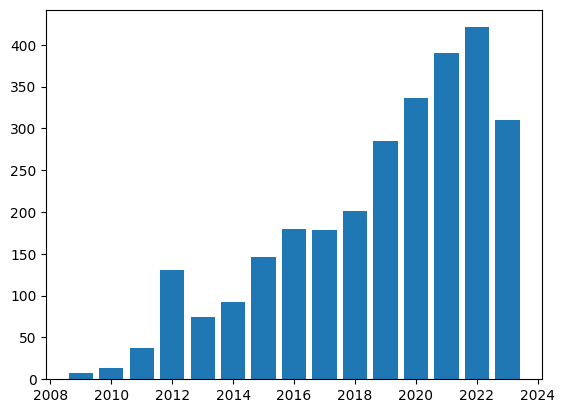

Ritwik Gupta
[2019, 2020, 2021, 2022, 2023]


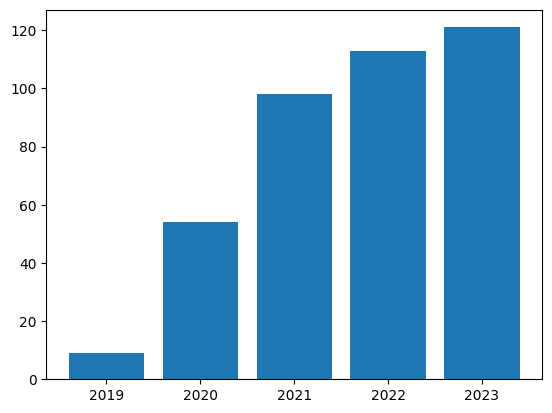

Laura Brenner
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


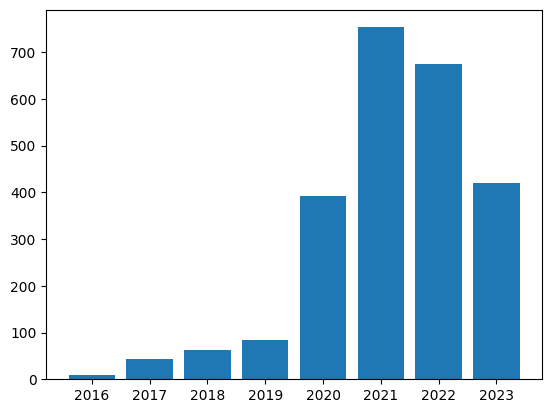

Lauren J. Wong
[2018, 2019, 2020, 2021, 2022, 2023]


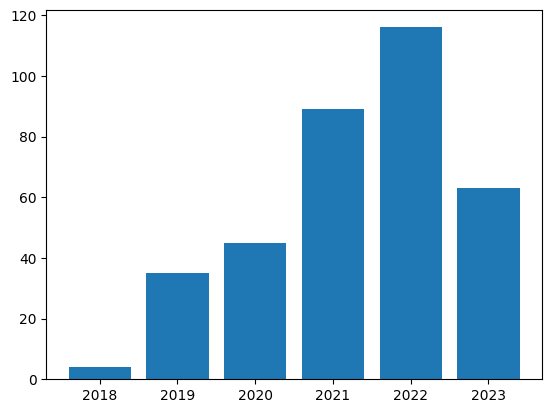

Shilong Liu
[2021, 2022, 2023]


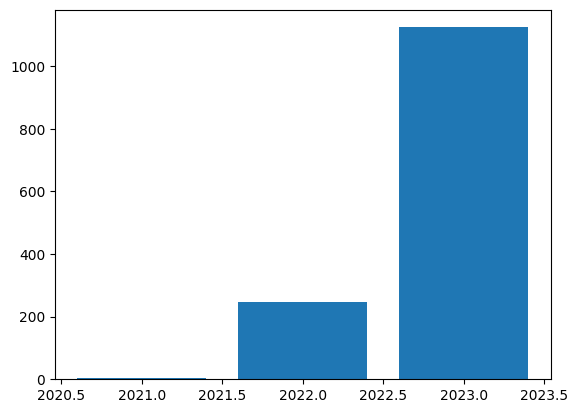

Andrey Rzhetsky
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


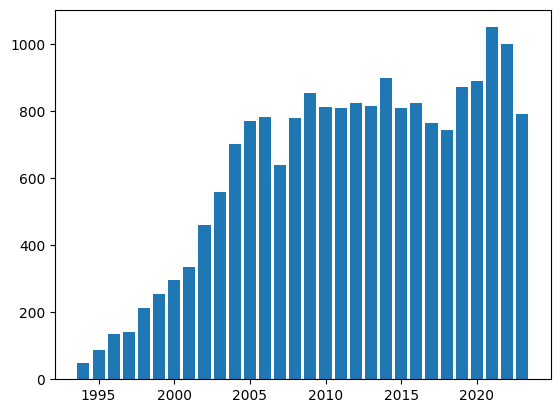

Muhammad Shoaib Farooq
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


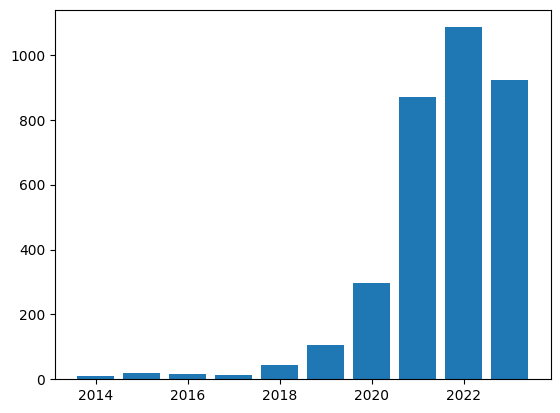

Xiangxi Shi
[2018, 2019, 2020, 2021, 2022, 2023]


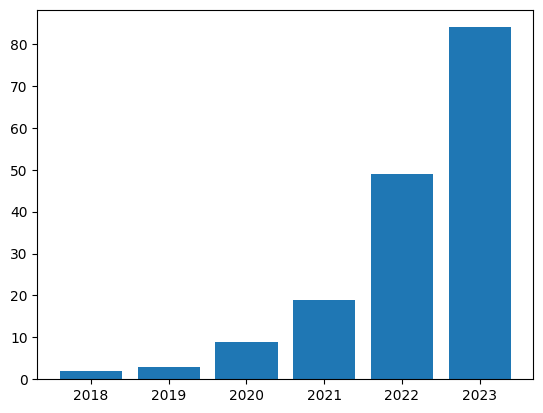

Stan Z. Li
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


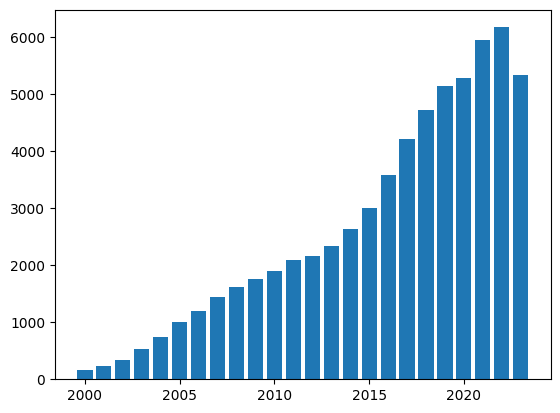

Ting Zhang
[1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


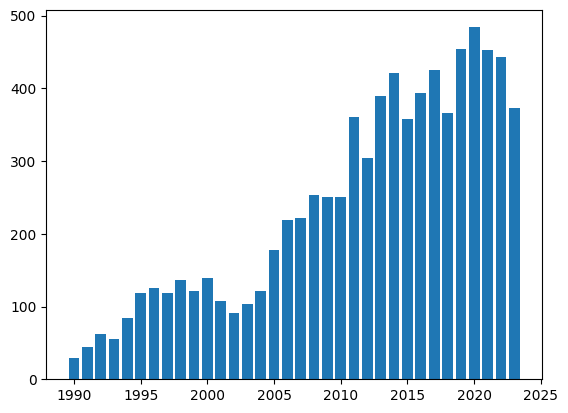

Corey Hudson
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


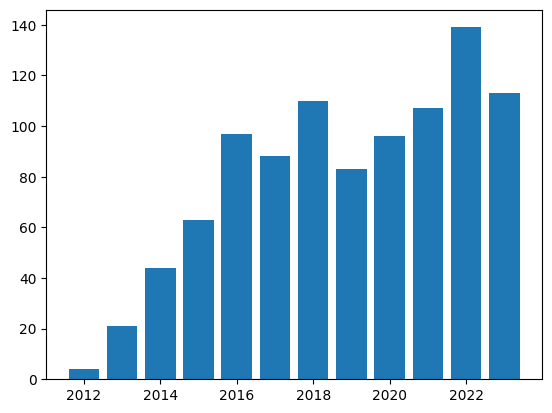

Weijun Li
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


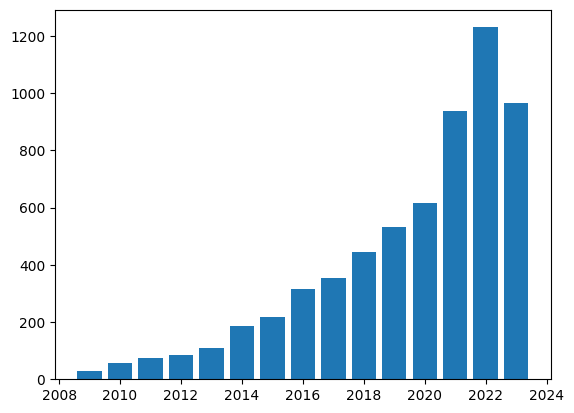

Berk Tinaz
[2019, 2020, 2021, 2022, 2023]


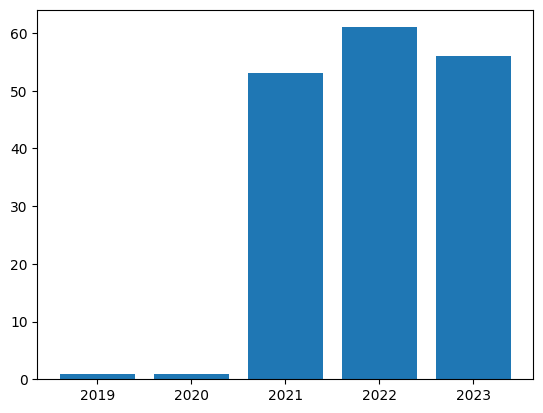

Abdullah Nazib
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


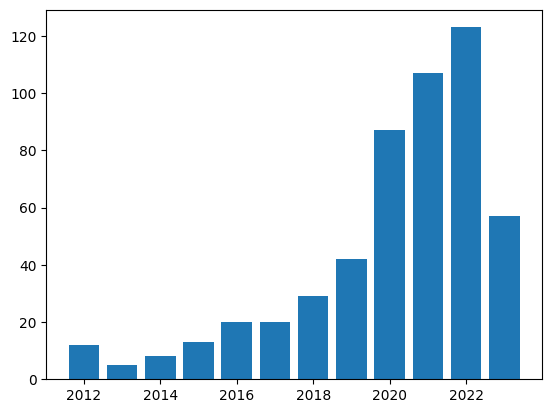

Vishvajit Bakarola
[2018, 2019, 2020, 2021, 2022, 2023]


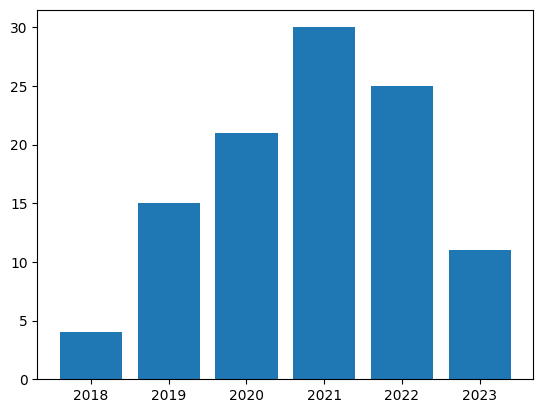

Xipeng Qiu
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


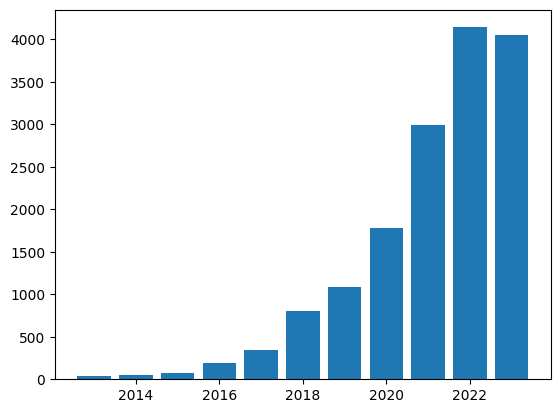

Yanping Wu
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


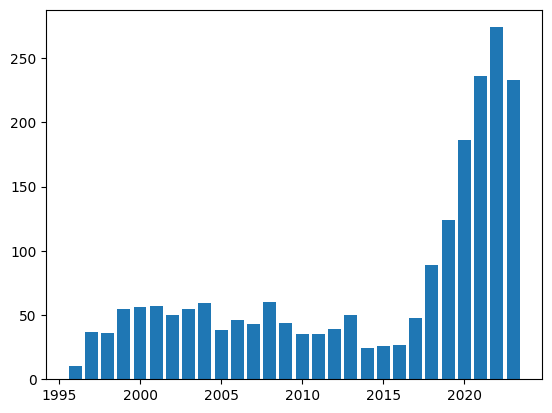

Harini Suresh
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


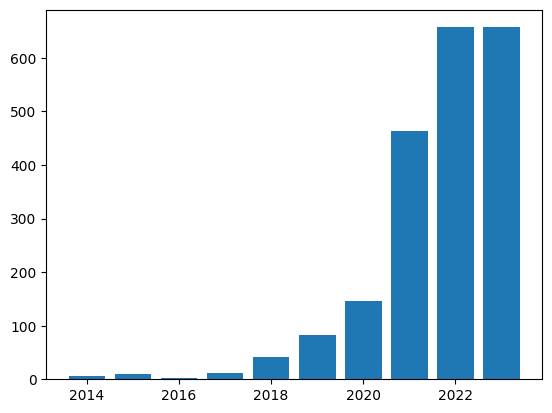

Yang You
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


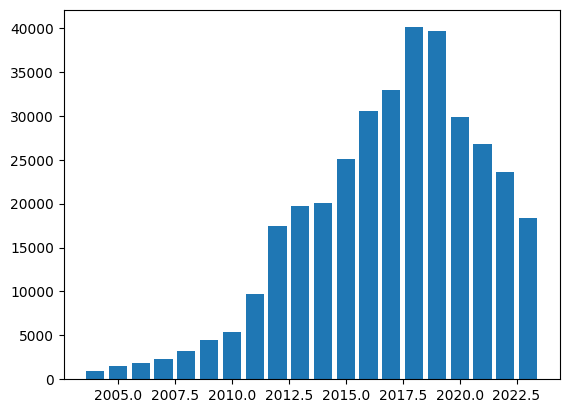

Liwei Wu
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


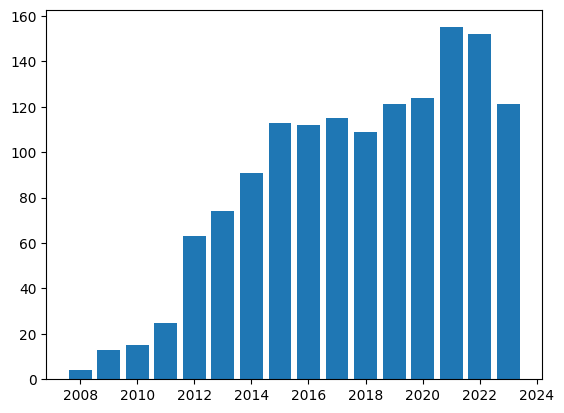

Ming-Chang Liu
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


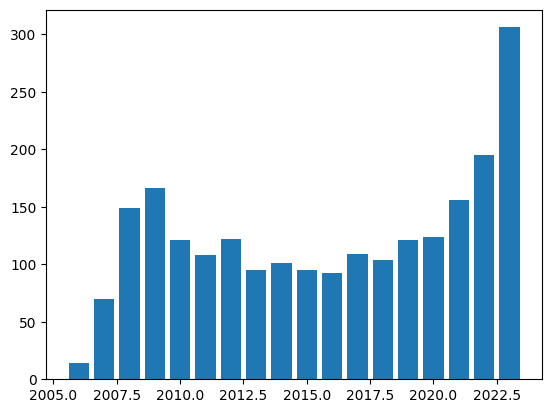

Sakshi Singh
[1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


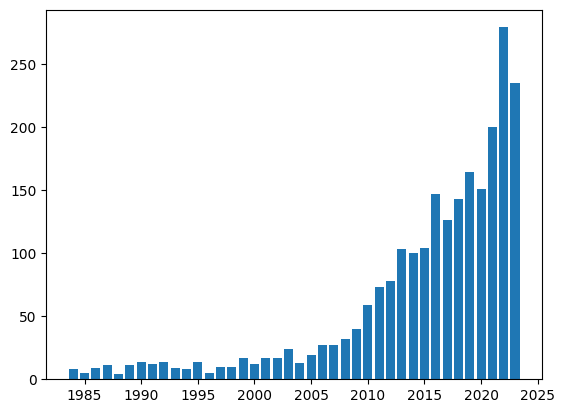

Hong Zhang
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


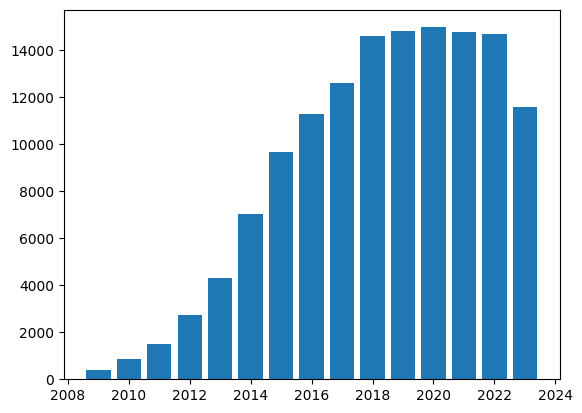

Karthick Prasad Gunasekaran
[2020, 2021, 2022, 2023]


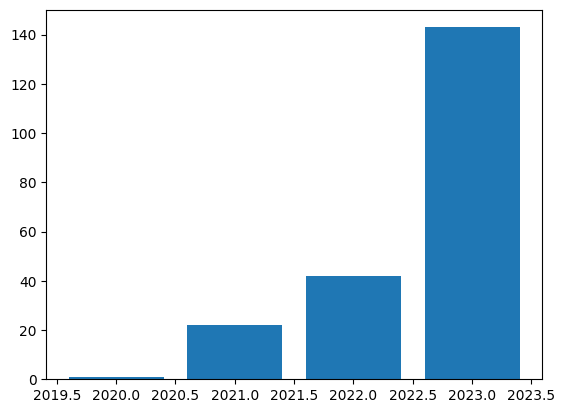

Tanay Kumar Saha
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


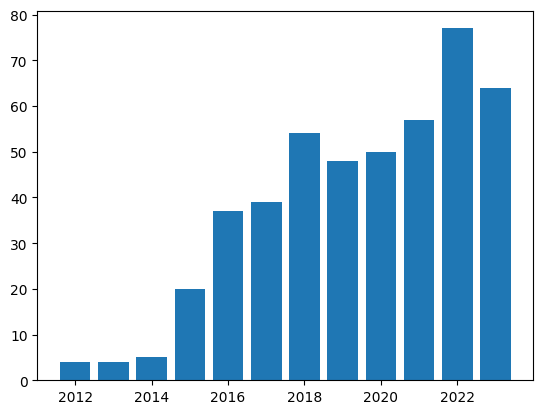

Xiang Wan
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


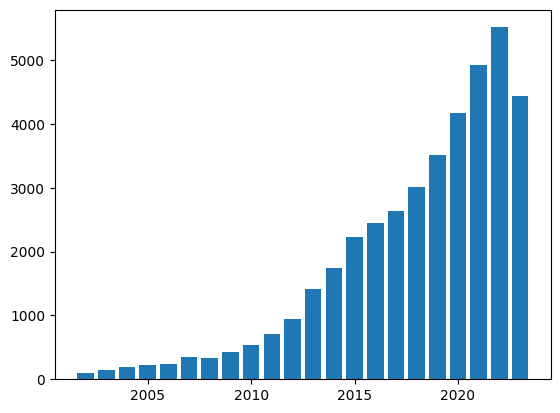

Pan Pan
[1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


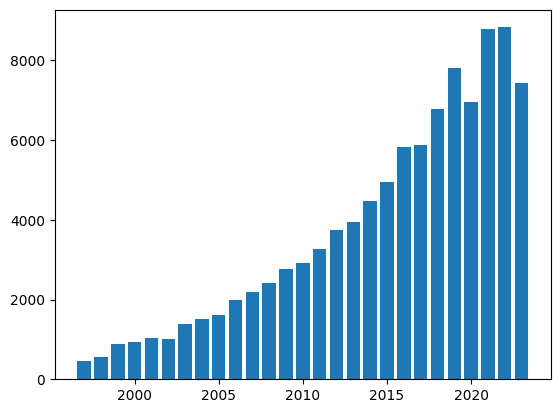

Alexey Letunovskiy
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


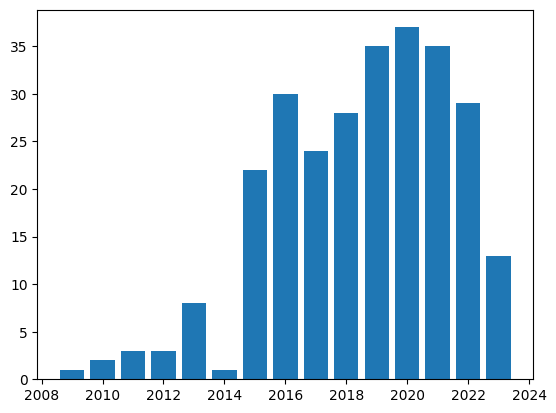

Ziyao Wang
[]


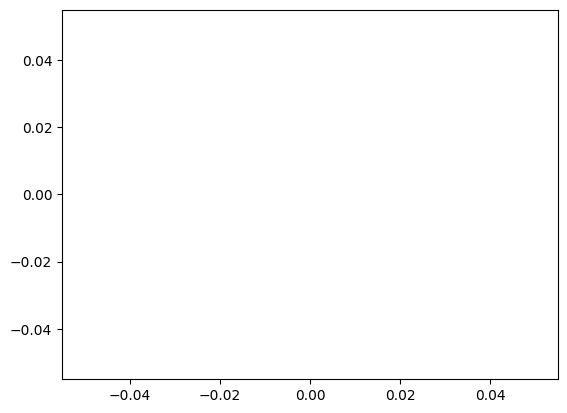

Hang Dong
[1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


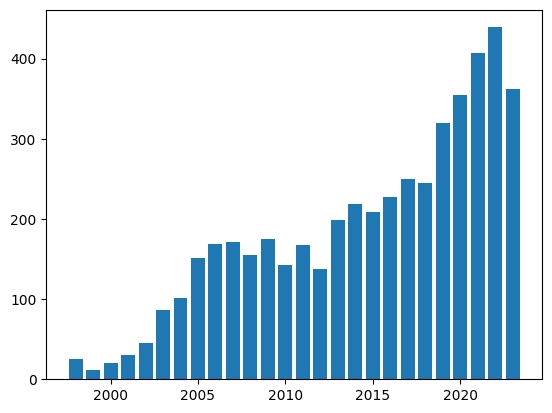

Abel A. Reyes-Angulo
[2021, 2022, 2023]


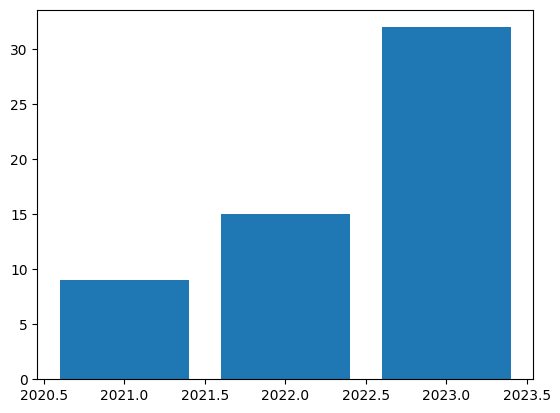

Husrev Taha Sencar
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


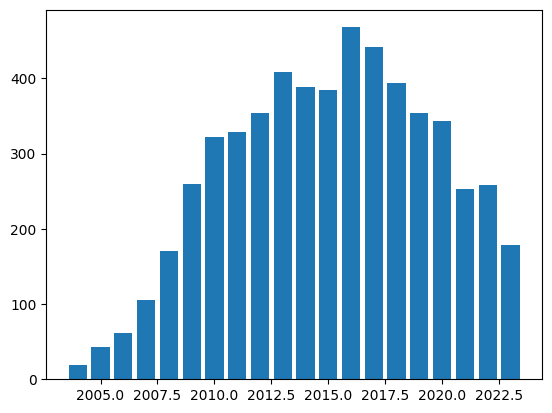

Dimuthu Lakmal
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


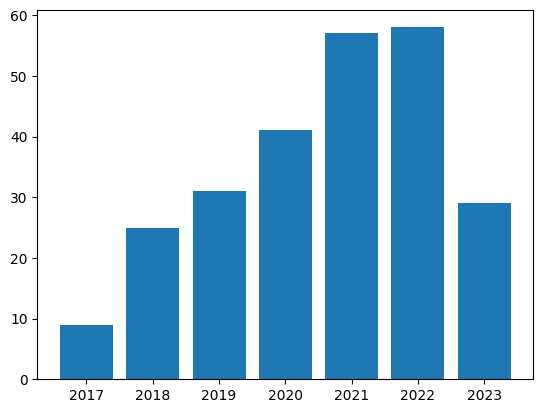

Nils Barlaug
[2021, 2022, 2023]


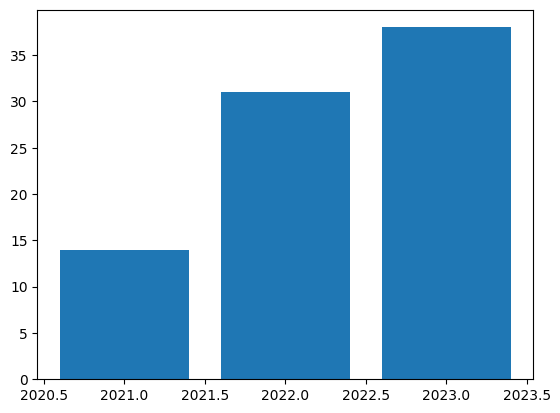

Ju Sun
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


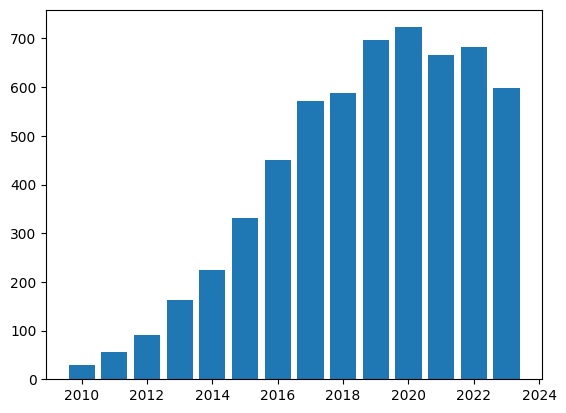

Laura Graesser
[2019, 2020, 2021, 2022, 2023]


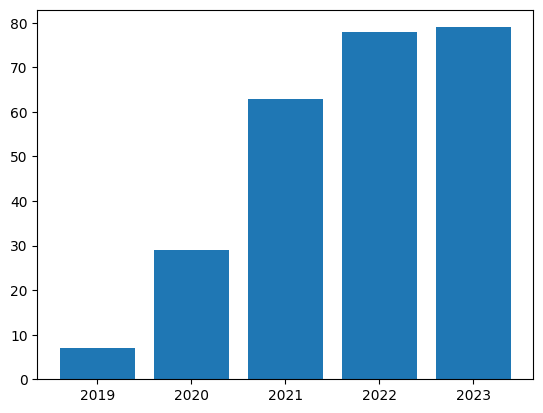

Cornelia Fermuller
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


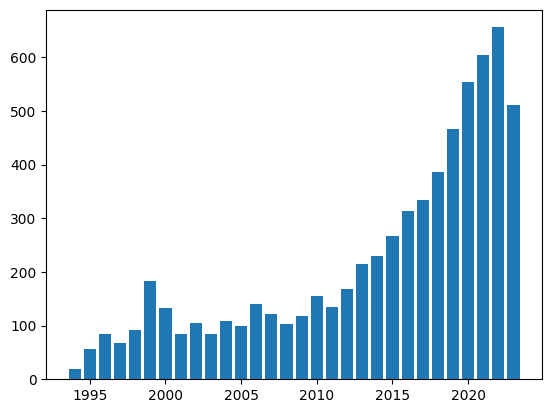

Zhenhua Liu
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


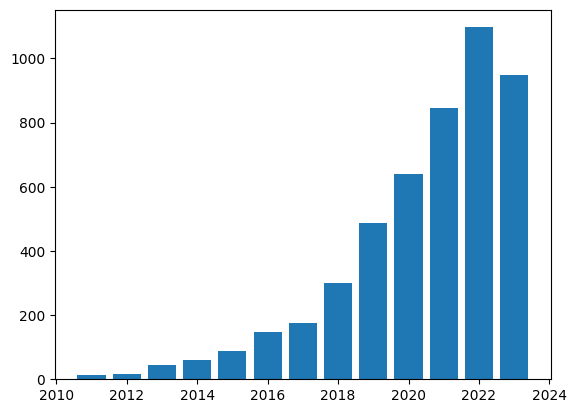

Dimitris N. Metaxas
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


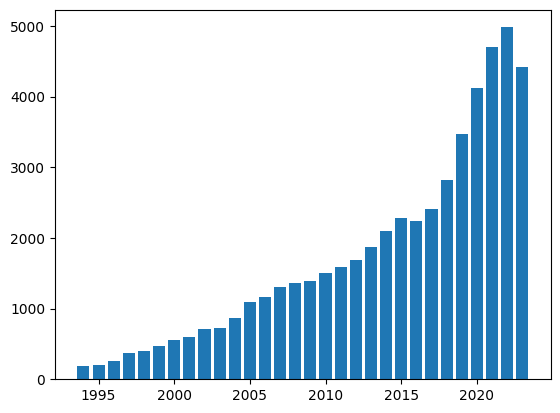

Hong Xu
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


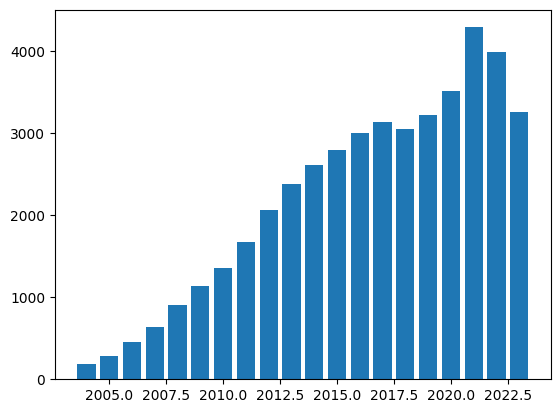

Ignacio Sarasua
[2019, 2020, 2021, 2022, 2023]


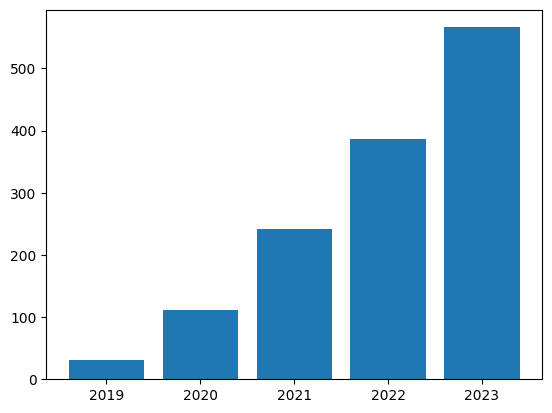

Anirudh Jain
[2019, 2020, 2021, 2022, 2023]


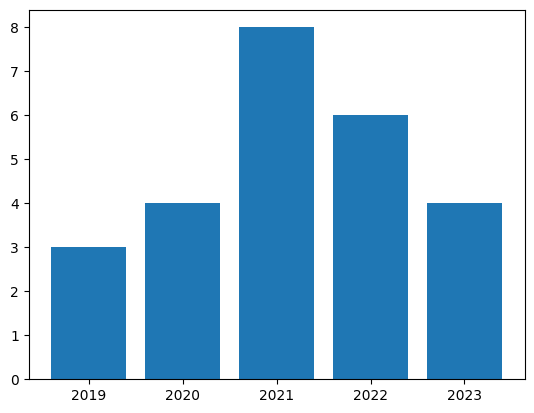

Agung Bella Putra Utama
[2021, 2022, 2023]


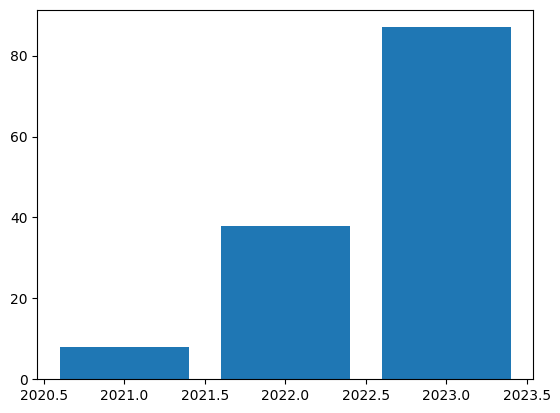

Bojan Božić
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


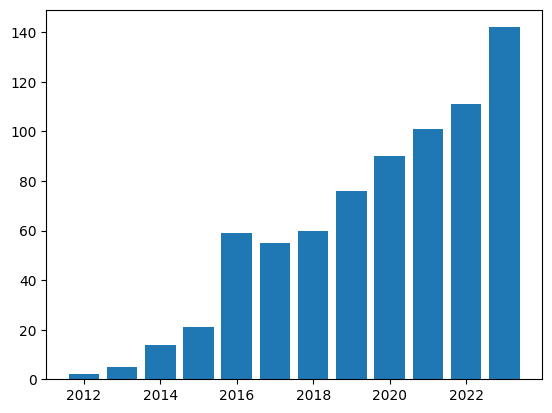

Jean-Luc Starck
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


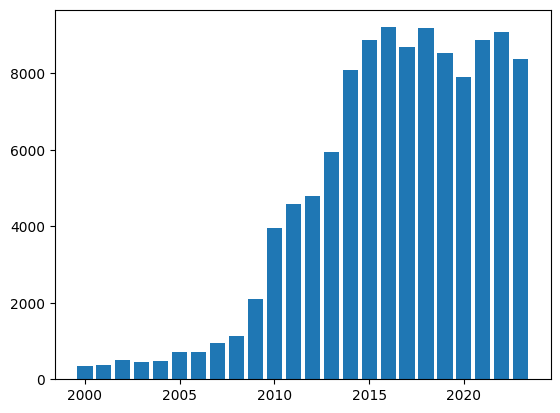

Zhuo Wang
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


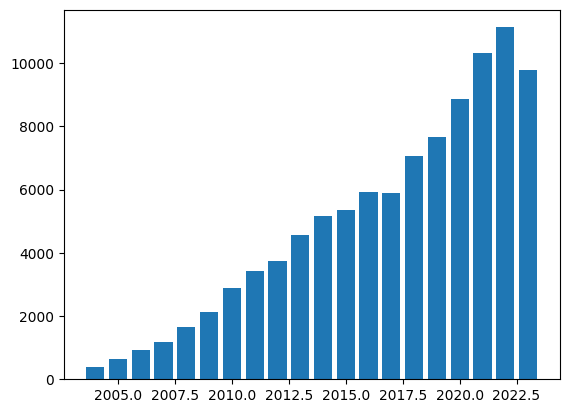

Thierry Moreau
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


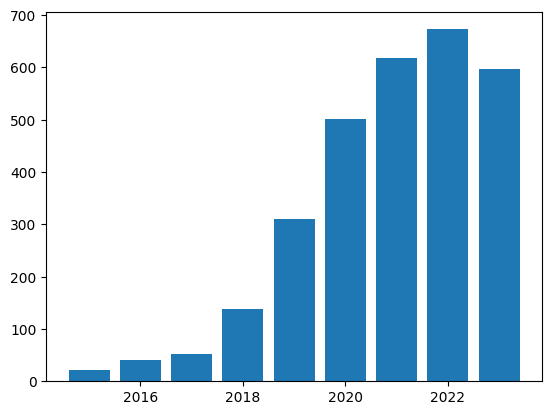

MD. Akil Raihan Iftee
[2020, 2021, 2022, 2023]


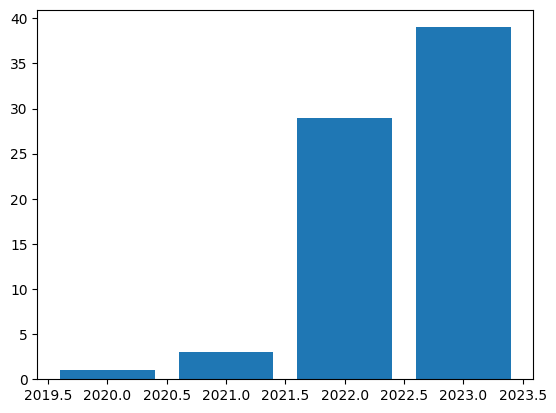

Jun Xia
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


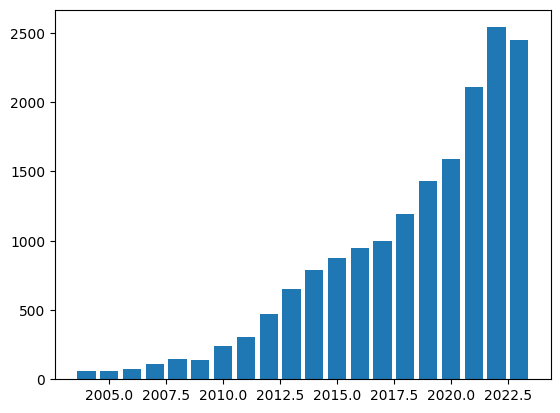

ChenHao Guo
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


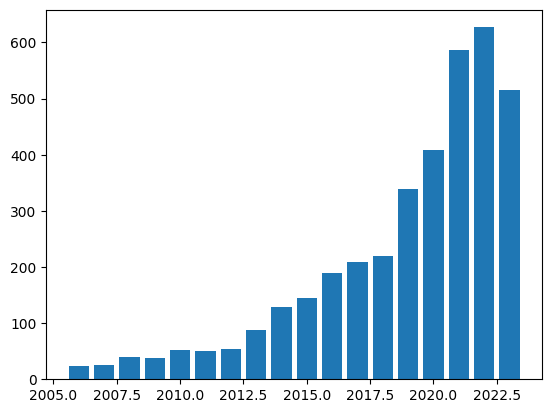

Sijie Zhu
[2019, 2020, 2021, 2022, 2023]


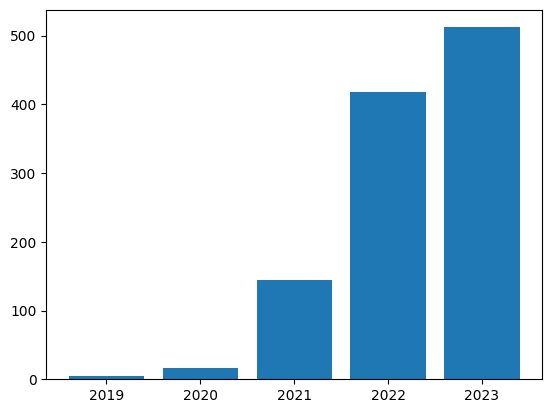

Yu Huang
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


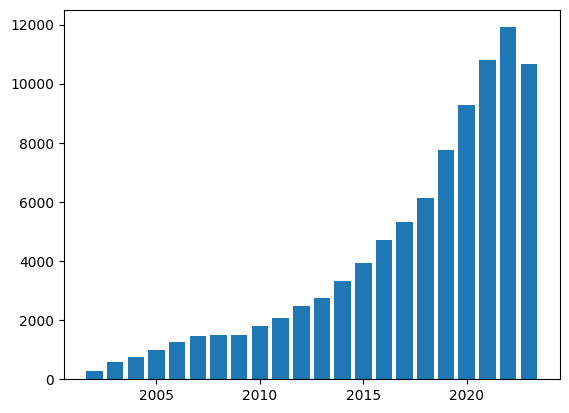

Ujjwal Maulik
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


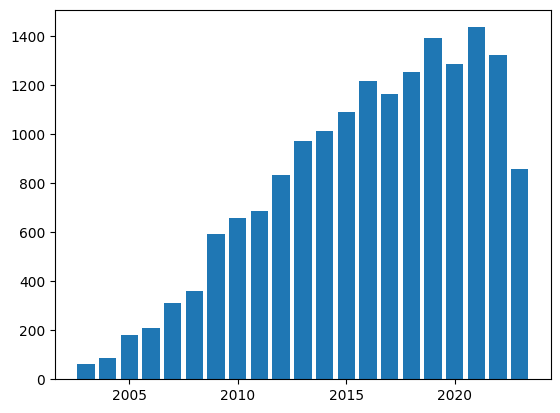

Jen-Tang Lu
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


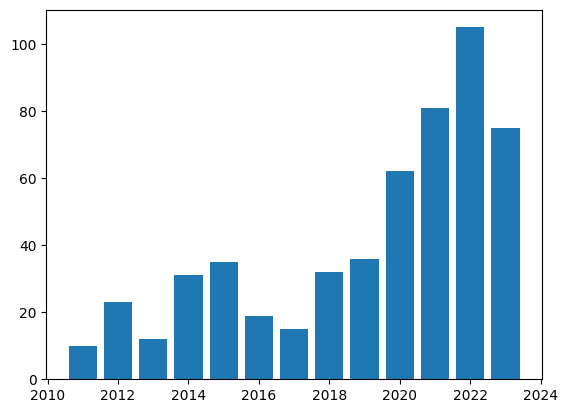

Andrzej Cichocki
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


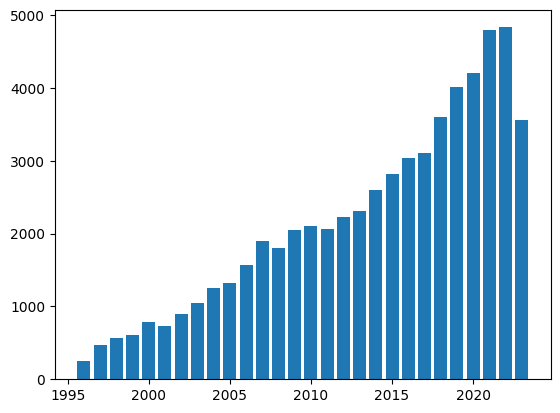

Lynn Miller
[1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


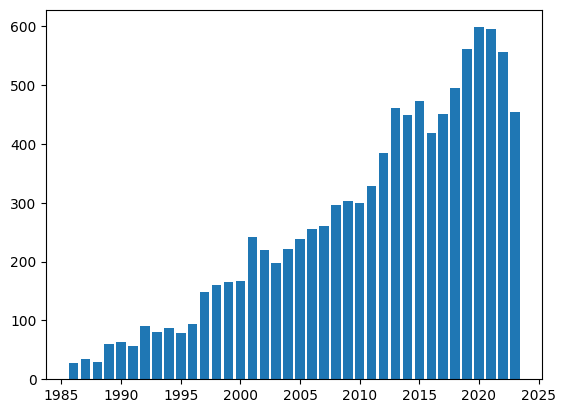

Nicholas McCarthy
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


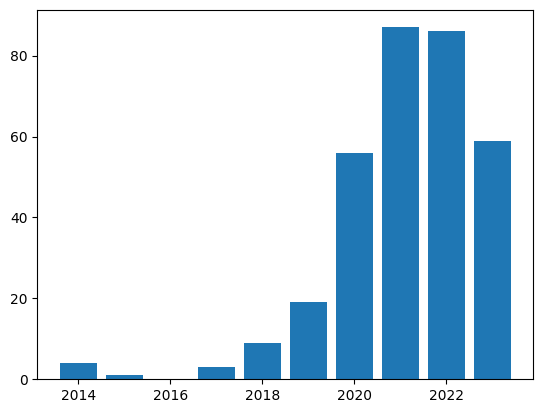

Salman Khan
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


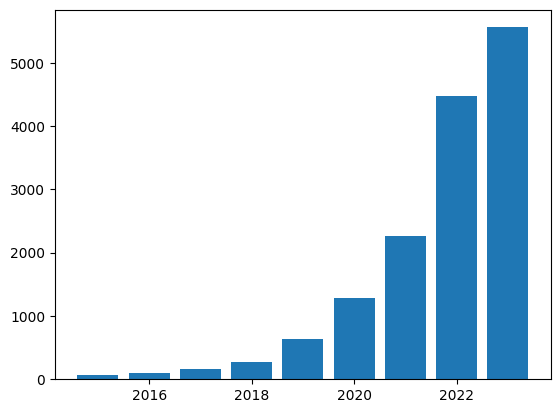

Christos Xypolopoulos
[2018, 2019, 2020, 2021, 2022, 2023]


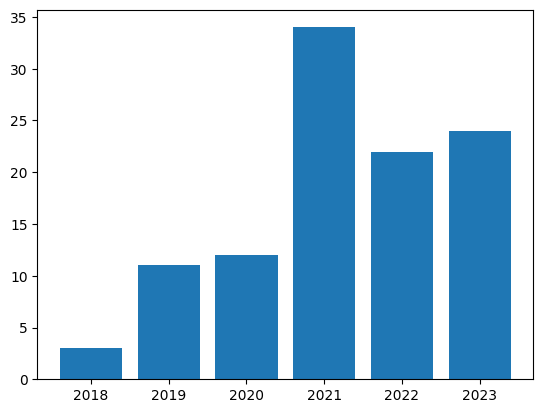

M. S. Badea
[2018, 2019, 2020, 2021, 2022]


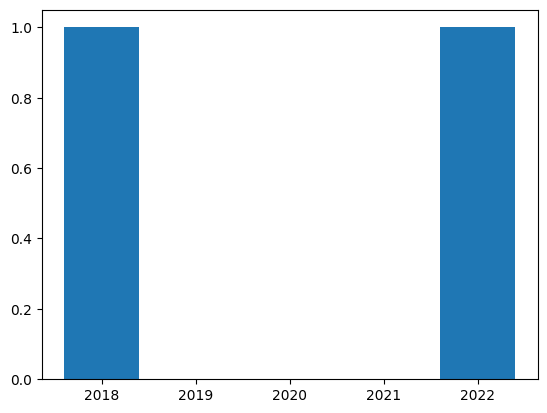

Dequan Wang
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


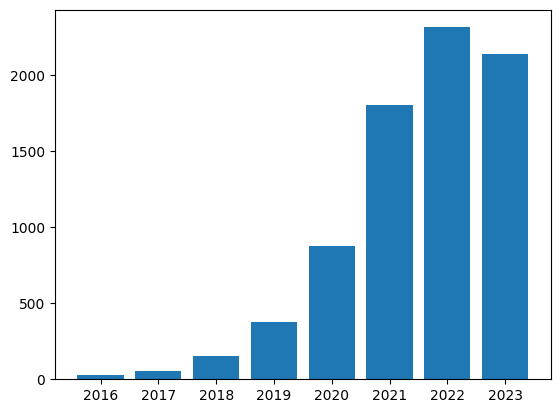

Xinru Yan
[2017, 2018, 2019, 2020, 2021, 2022]


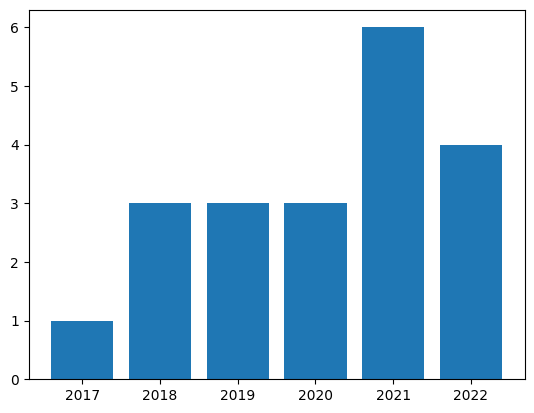

Shao-Bo Lin
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


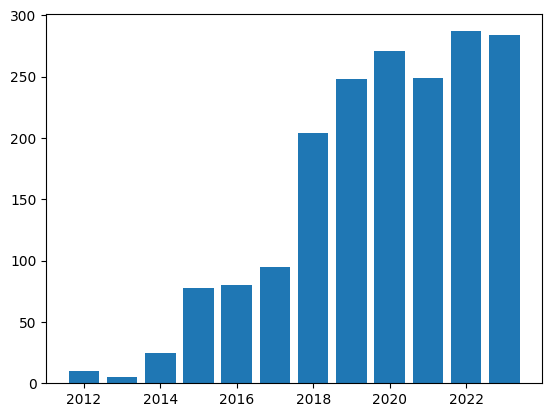

Andri Pranolo
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


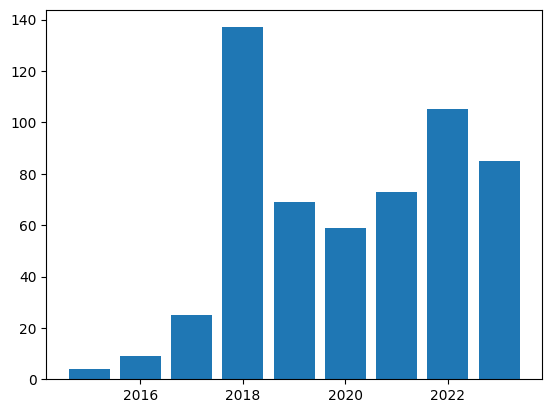

Mira Park
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


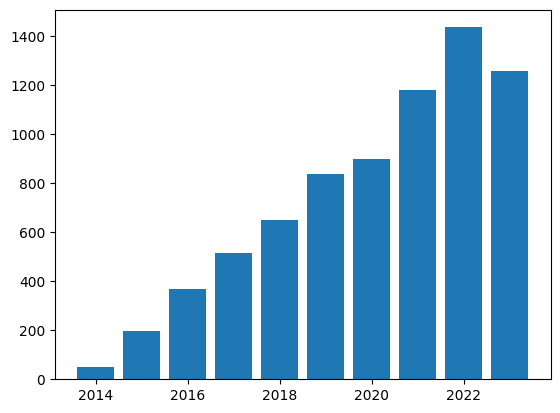

Xiaolei Diao
[2021, 2022, 2023]


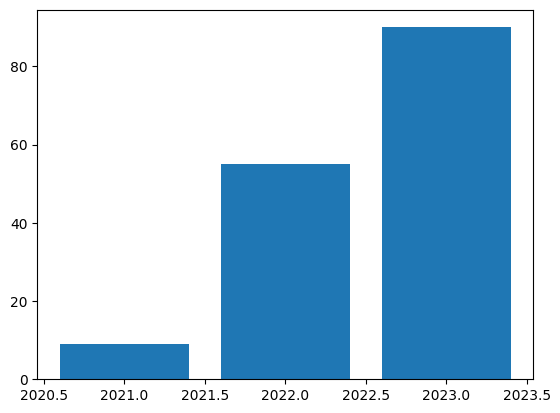

Naveed Akhtar
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


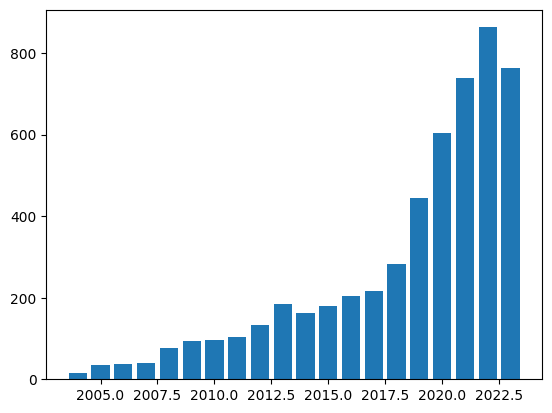

Vanessa Yan
[2022, 2023]


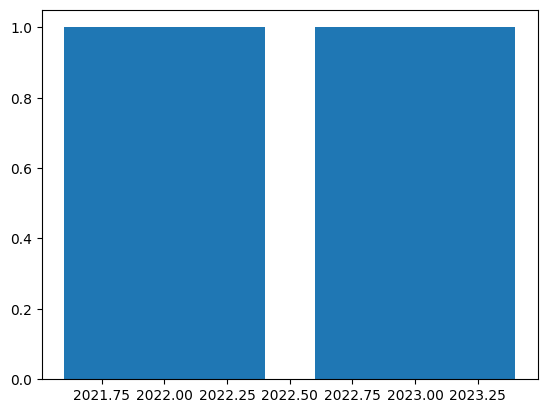

Shahid Alam
[1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


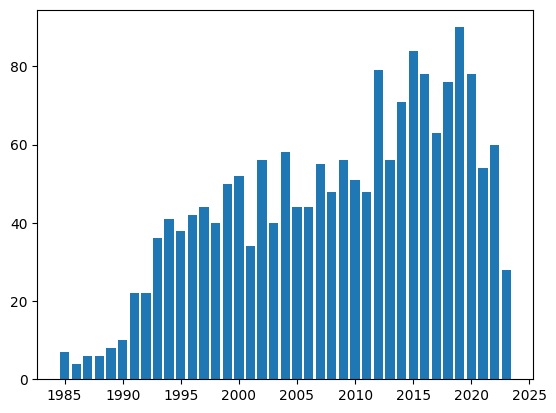

Peter Bell
[1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


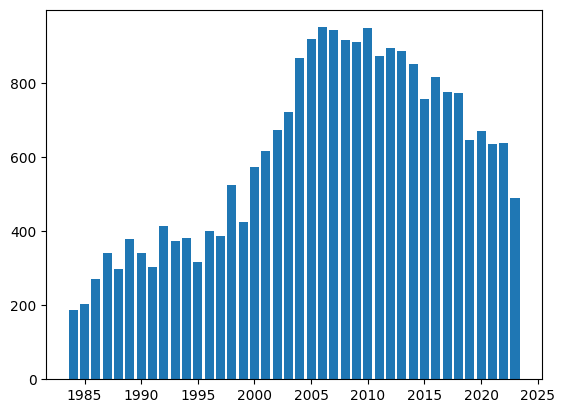

Aravind Srinivas
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


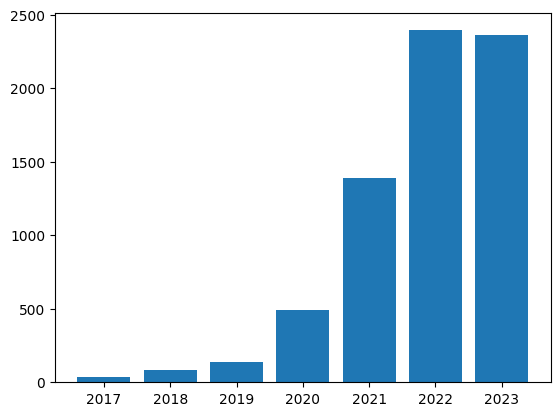

Yueyang Liu
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


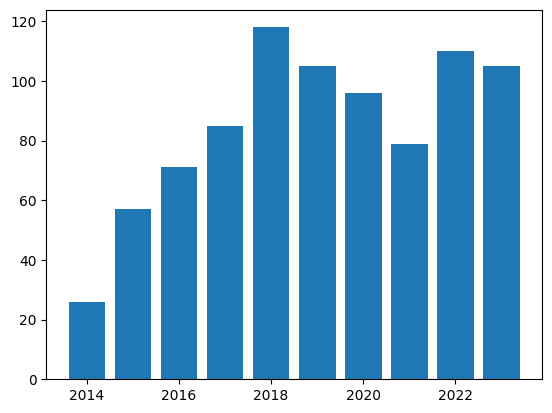

Rui Kong
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


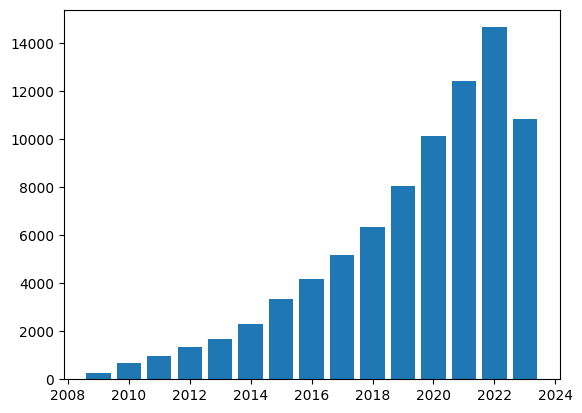

Froduald Kabanza
[1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


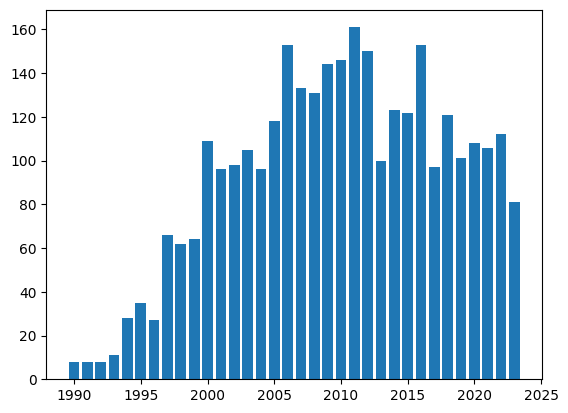

Burkhard Rost
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


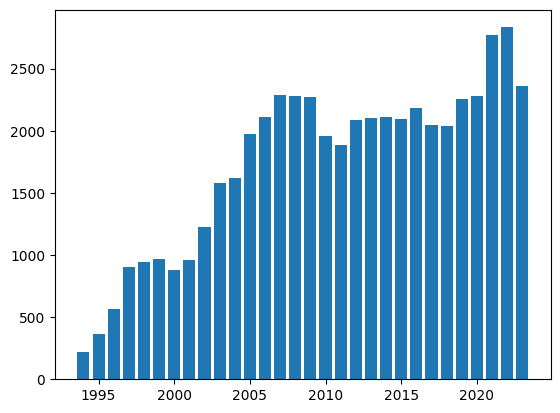

Suejb Memeti
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


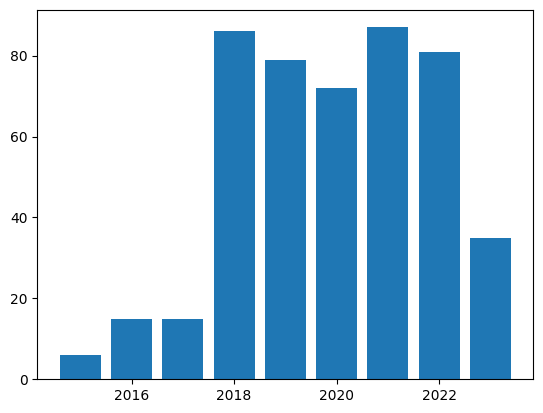

Chi Zhang
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


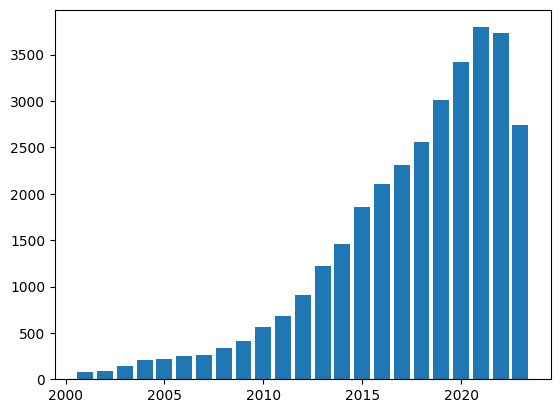

Yuhao Zhang
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


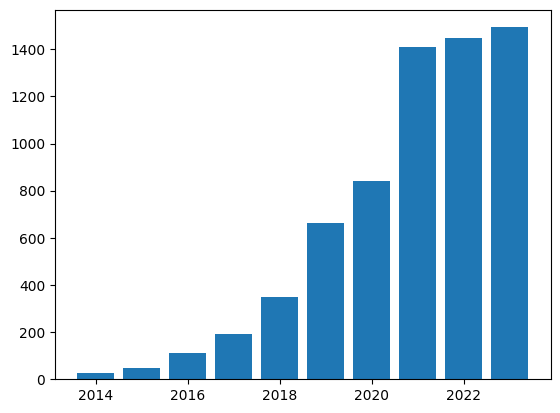

Thien Huu Nguyen
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


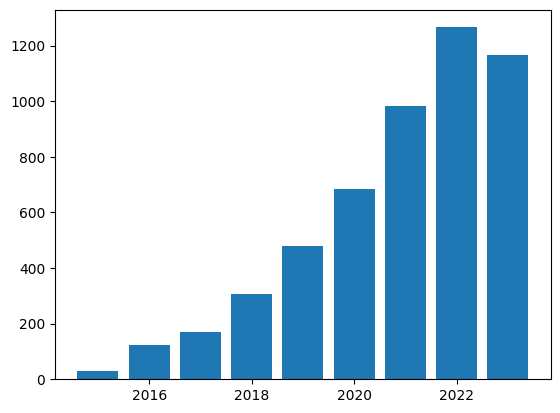

Amirali Abdolrashidi
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


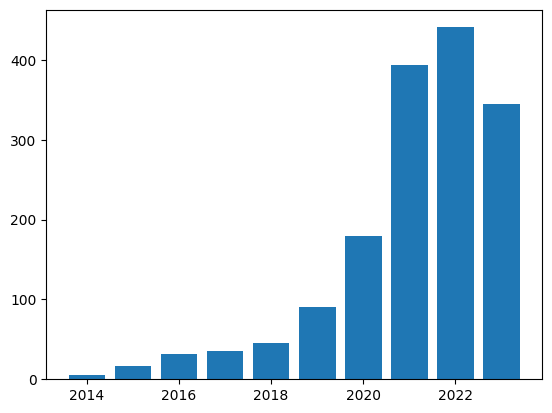

Kai Shen
[1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


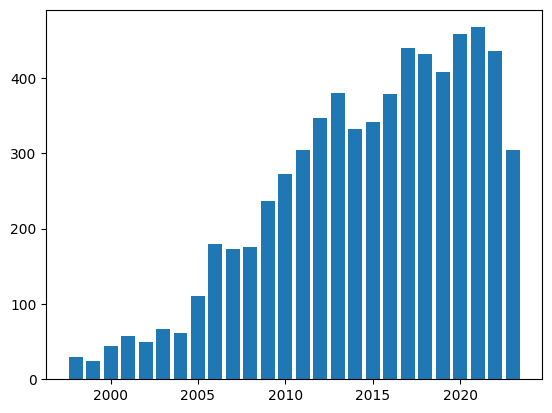

Yiqin Lv
[2022, 2023]


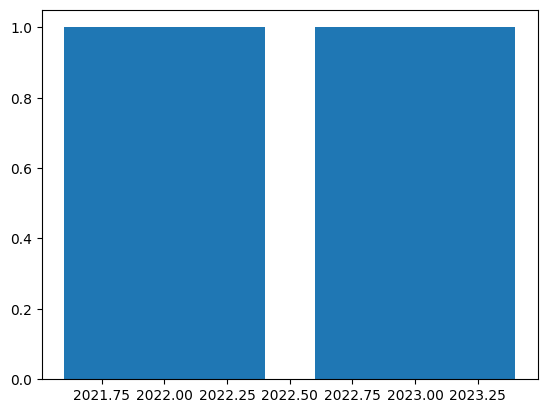

Luciana Ferrer
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


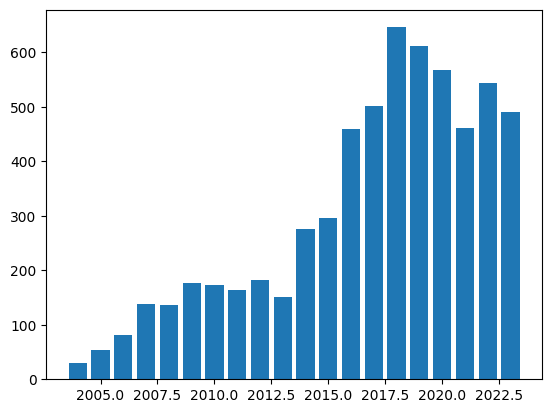

C. Vertan
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


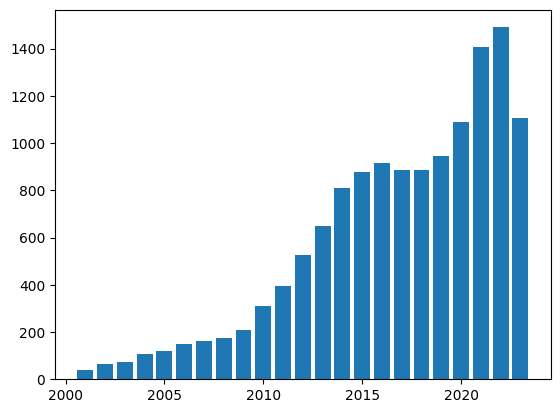

Gourav Siddhad
[2019, 2020, 2021, 2022, 2023]


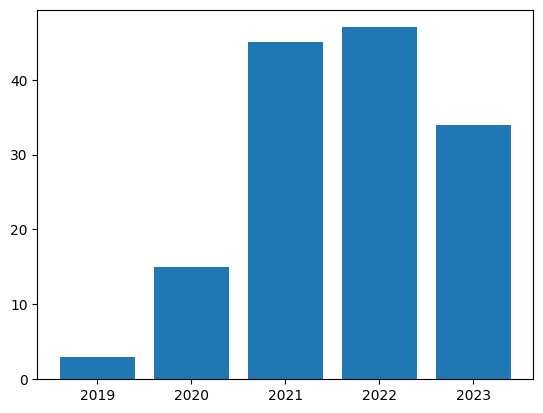

Yu Sun
[1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


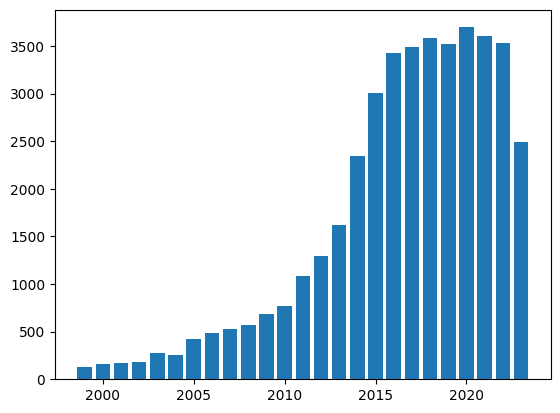

Dimitris Spathis
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


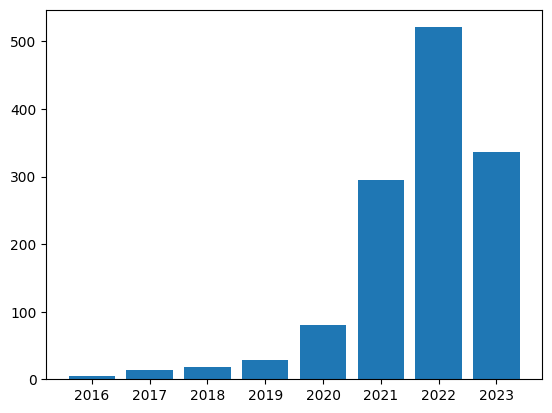

Abdullah Al-Dujaili
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


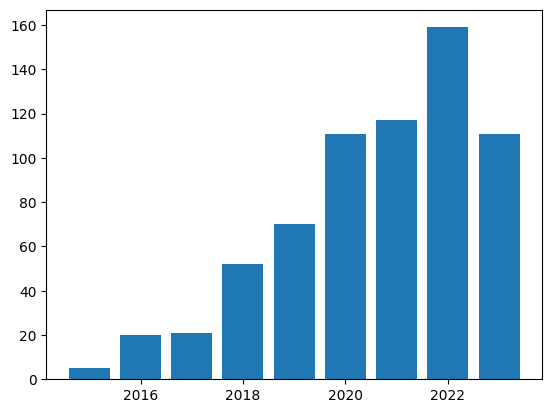

Bhaskar Krishnamachari
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


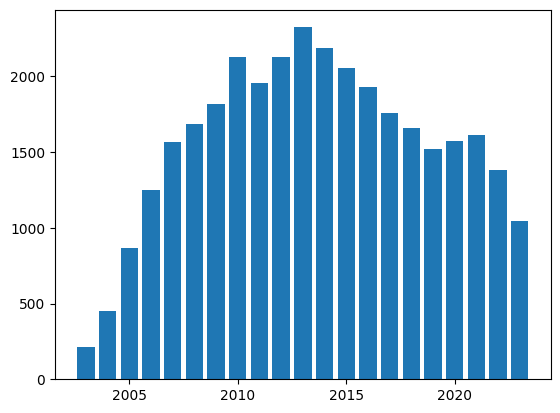

Alireza Borjali
[2018, 2019, 2020, 2021, 2022, 2023]


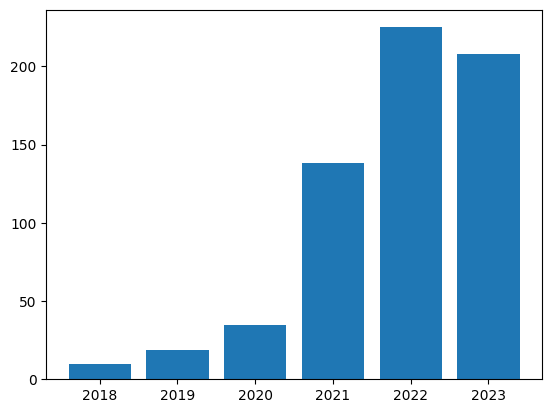

Bin Dong
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


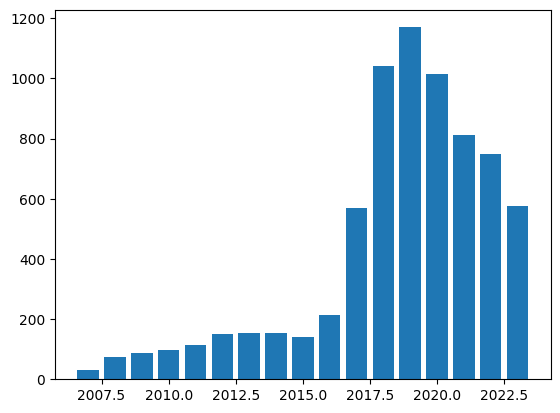

Satyananda Kashyap
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


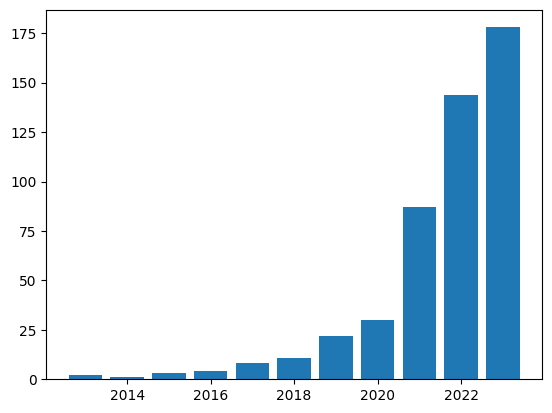

Si Si
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


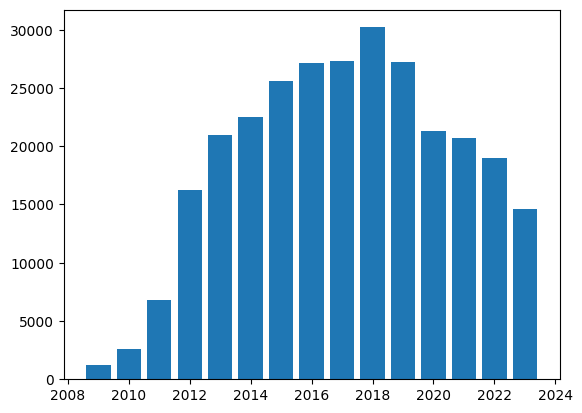

Elisa Bassignana
[2018, 2019, 2020, 2021, 2022, 2023]


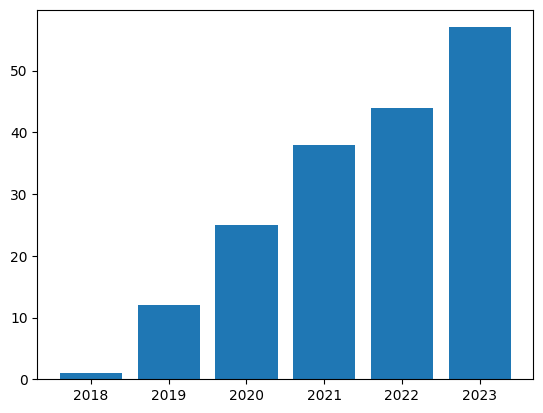

Guosheng Lin
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


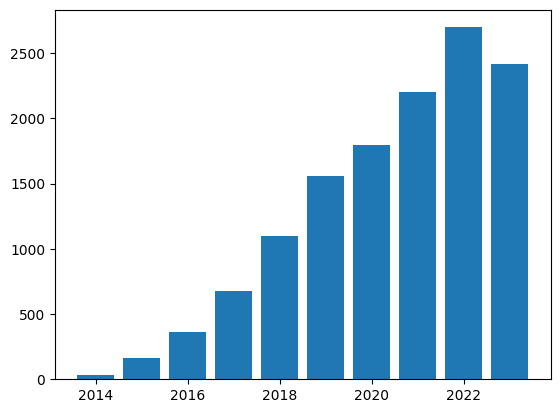

Sushil Shakya
[2019, 2020, 2021, 2022, 2023]


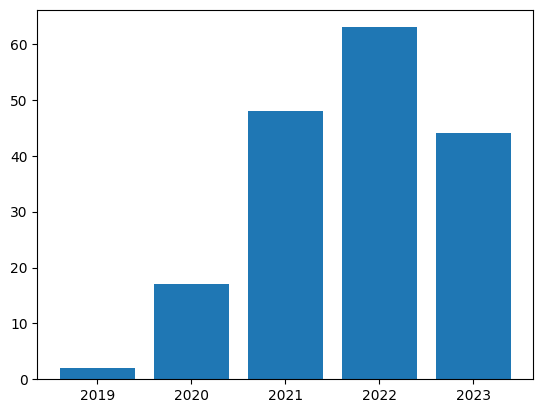

Akim Kotelnikov
[]


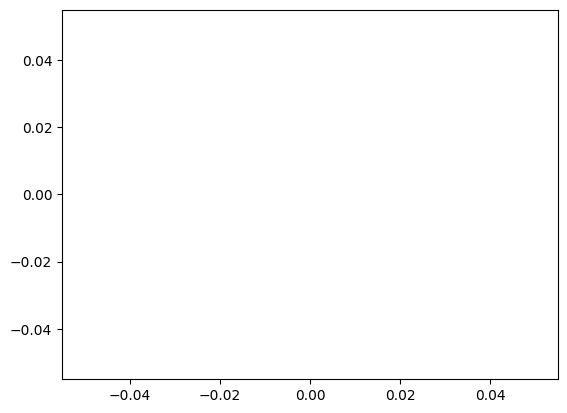

Paolo Valdez
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


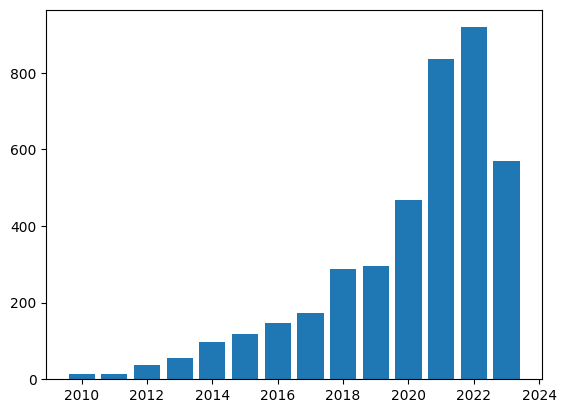

Chitta Baral
[1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


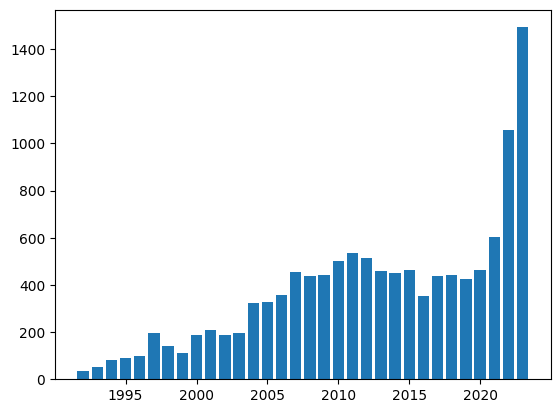

Faezeh Faez
[2021, 2022, 2023]


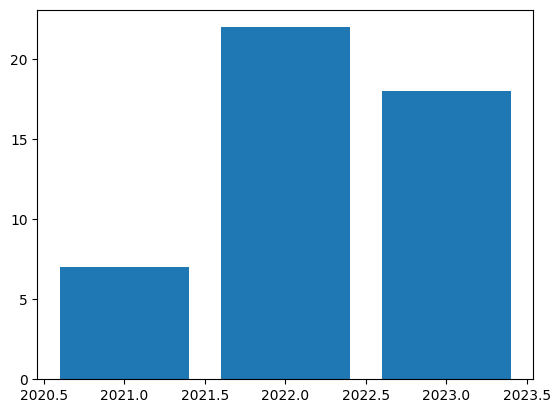

Kevin Bailly
[1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


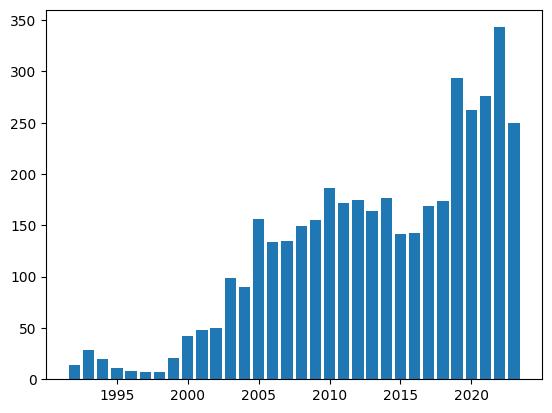

Max Ehrlich
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


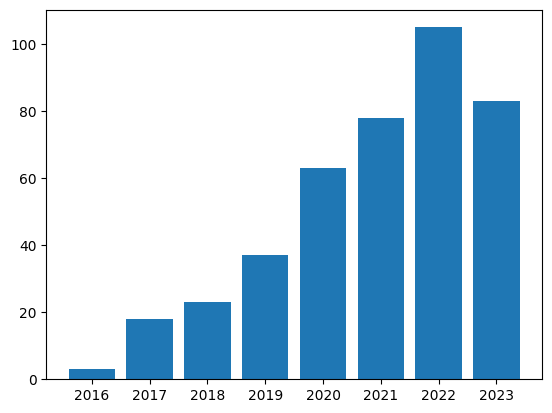

Gaith Rjoub
[2018, 2019, 2020, 2021, 2022, 2023]


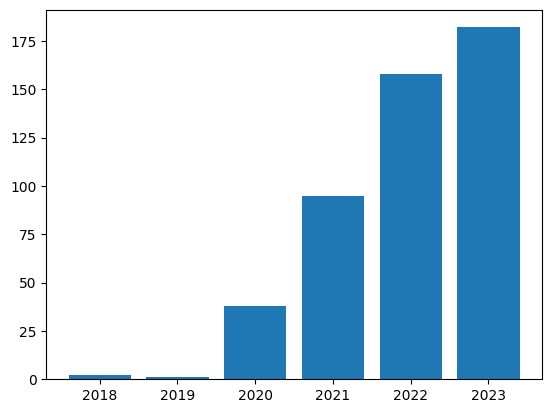

Christina Gsaxner
[2018, 2019, 2020, 2021, 2022, 2023]


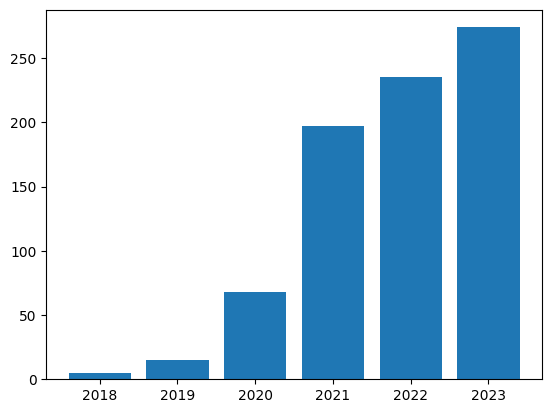

Baochang Ma
[2020, 2021, 2022, 2023]


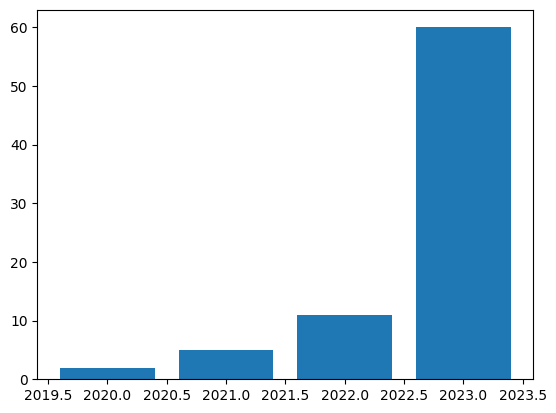

Dong Yu
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


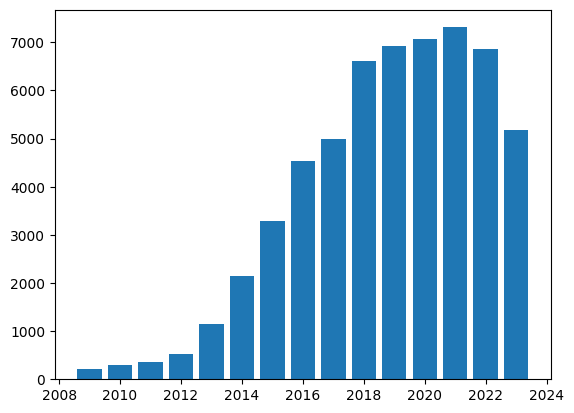

Qingyang Wu
[2019, 2020, 2021, 2022, 2023]


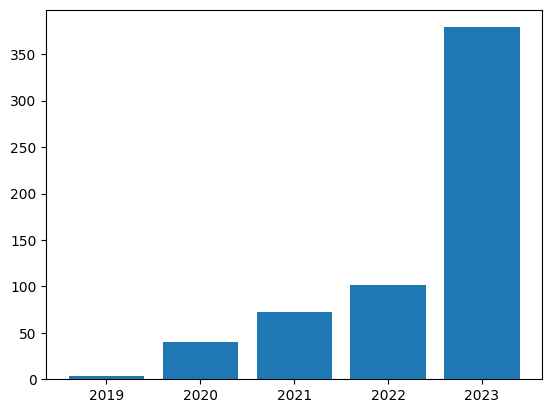

Zhaoyuan Yang
[2018, 2019, 2020, 2021, 2022, 2023]


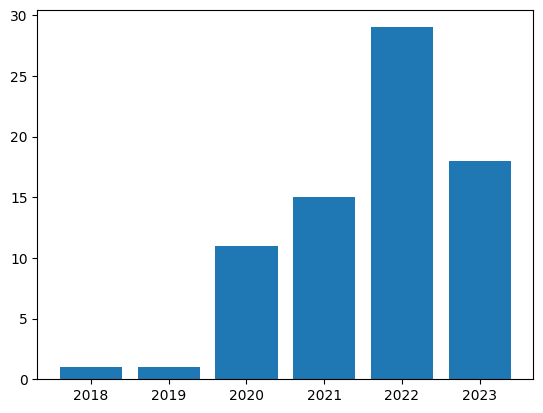

David E. Sommer
[1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


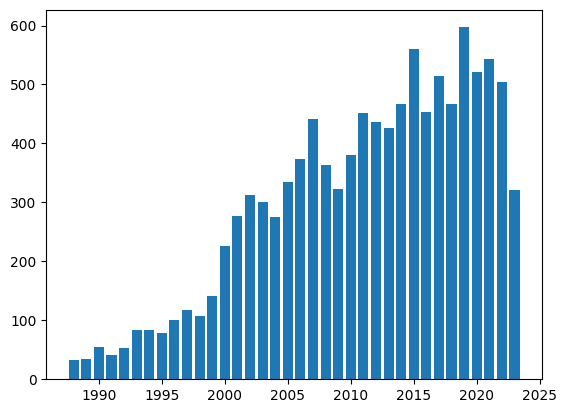

Xiaoying Jia
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


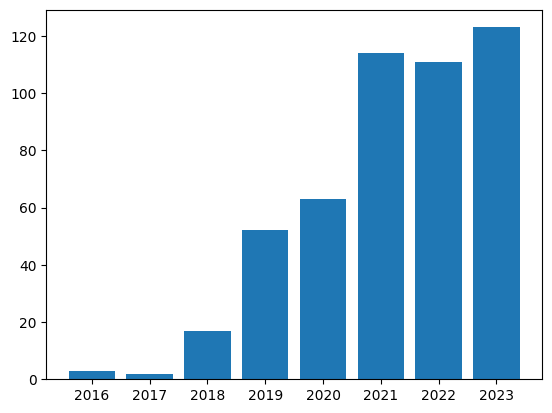

Leonardo Anjoletto Ferreira
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


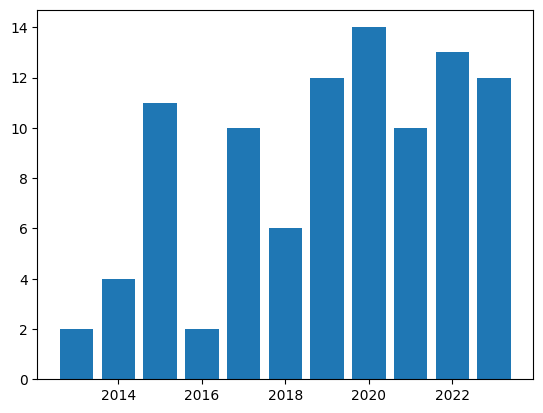

Xu Sun
[1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


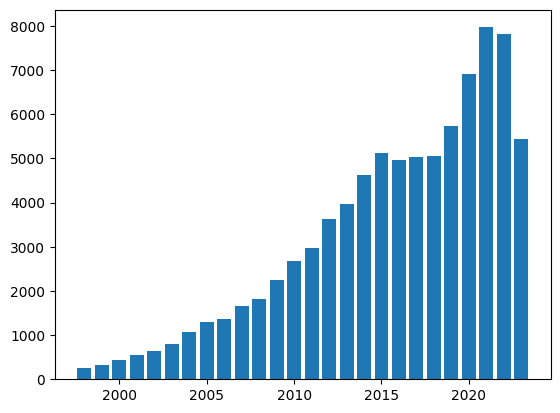

Will Song
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


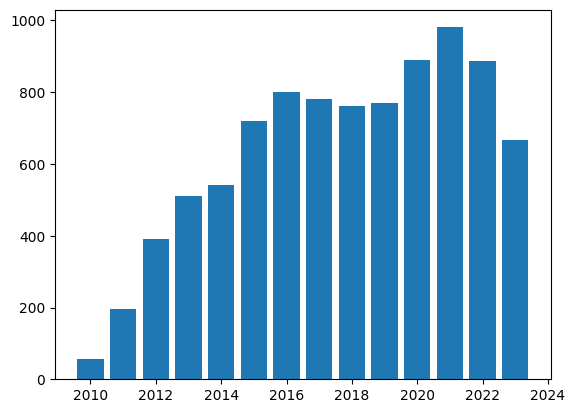

Sahar Zafar
[2019, 2020, 2021, 2022, 2023]


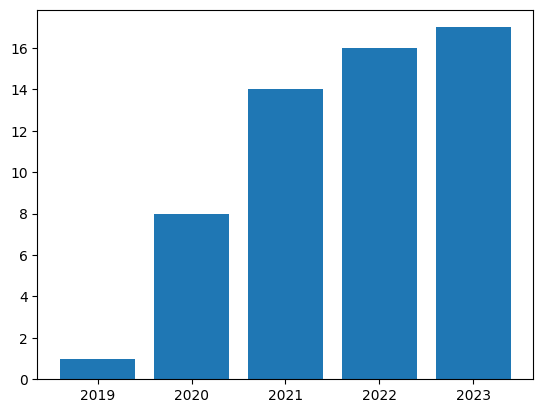

Junhua Li
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


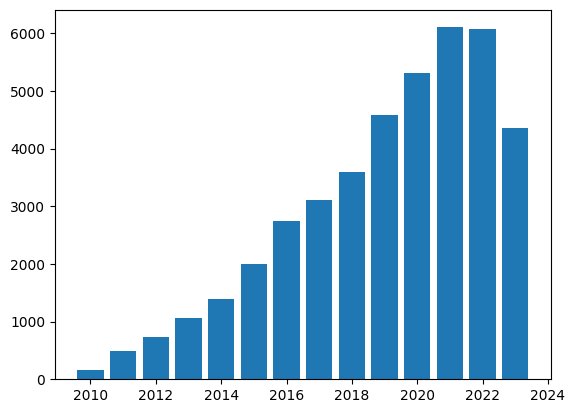

Daniel Campos
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


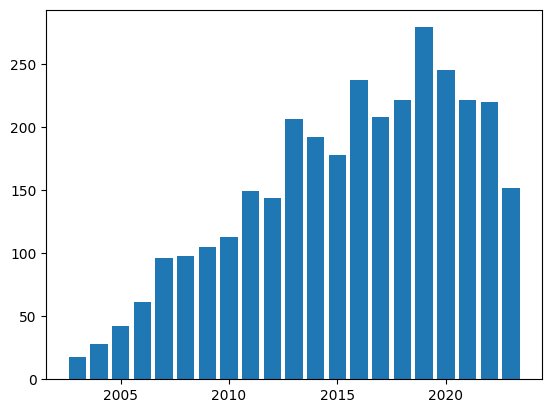

Leo Anthony Celi
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


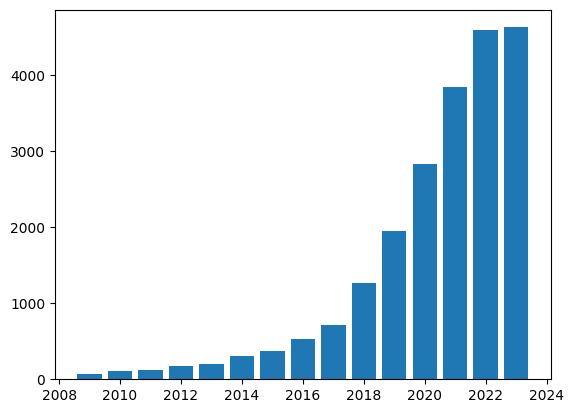

Thanh-Tung Nguyen
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


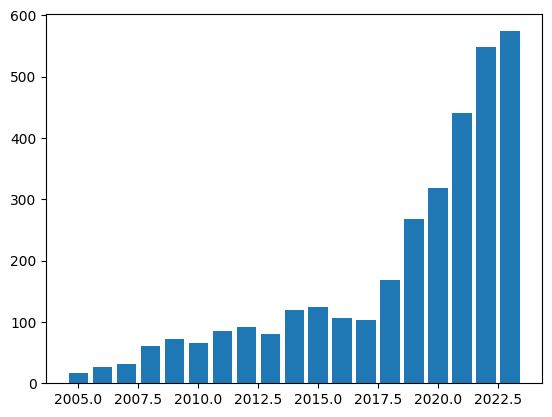

Syed Afaq Shah
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


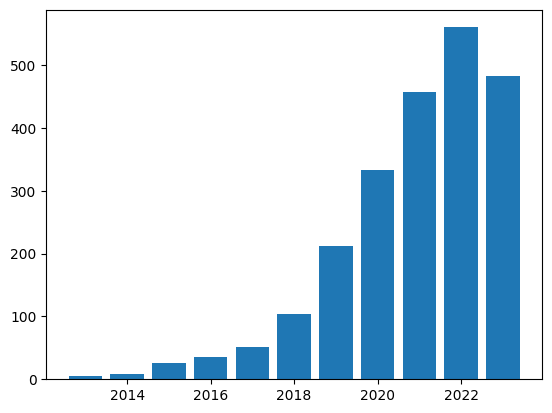

Mustafa Tolga Eren
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


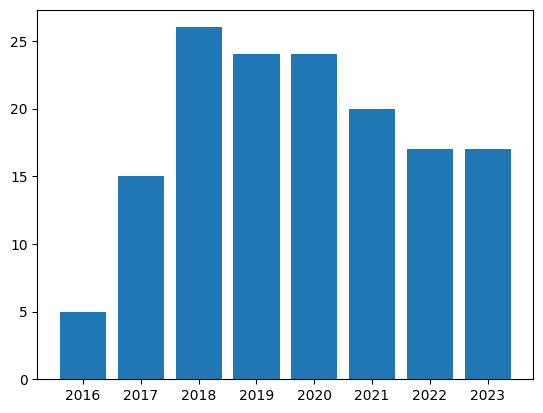

Raghavender Sahdev
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


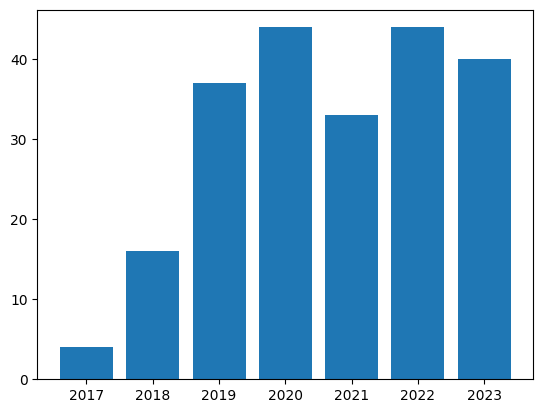

Alexander Mathis
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


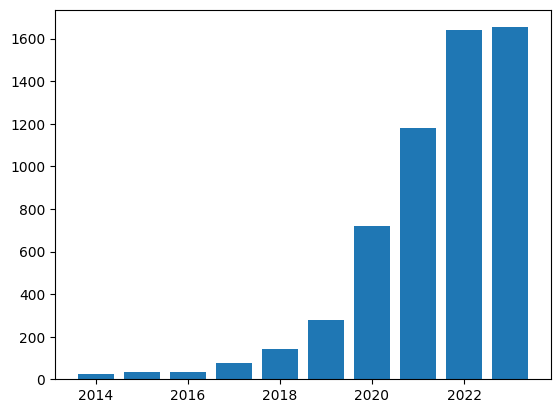

Yiwei Sun
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


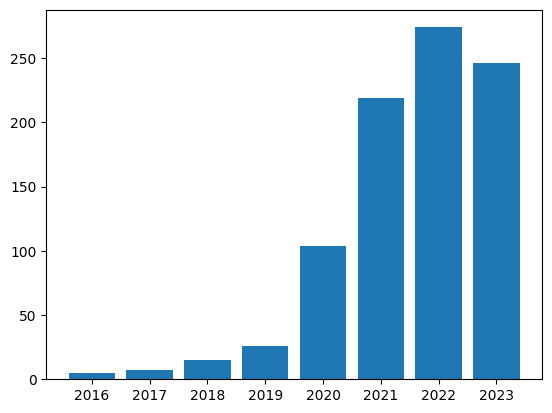

Stephan Rabanser
[2018, 2019, 2020, 2021, 2022, 2023]


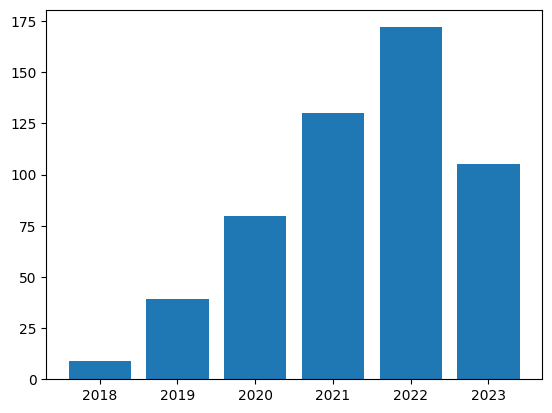

Linda Galligan
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


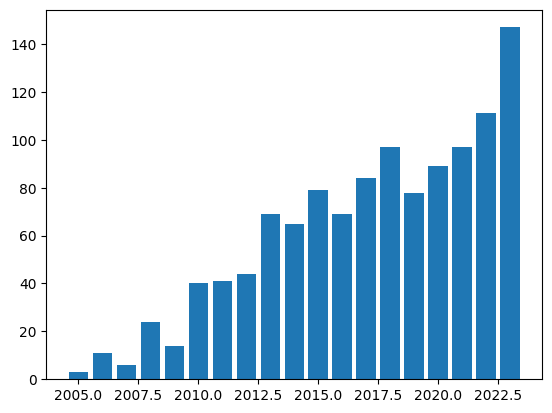

Xiaodong Qu
[2018, 2019, 2020, 2021, 2022, 2023]


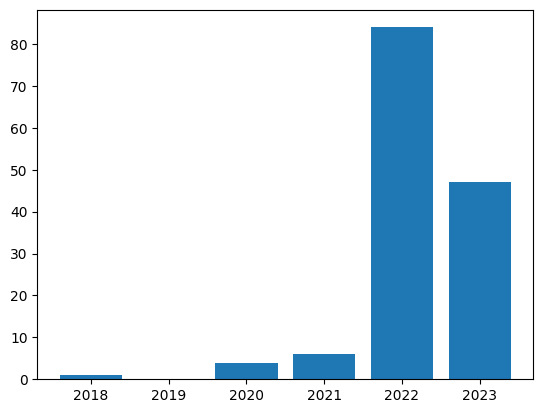

Bo Long
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


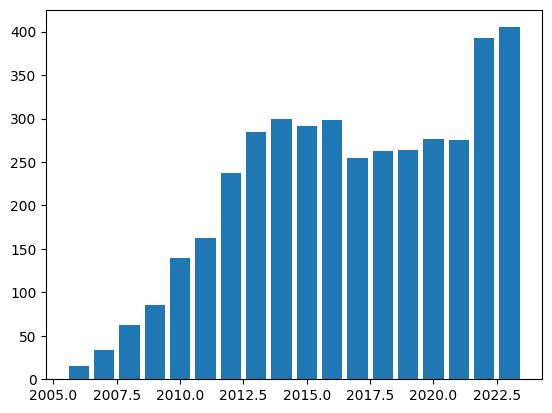

Zhiyuan Zhang
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


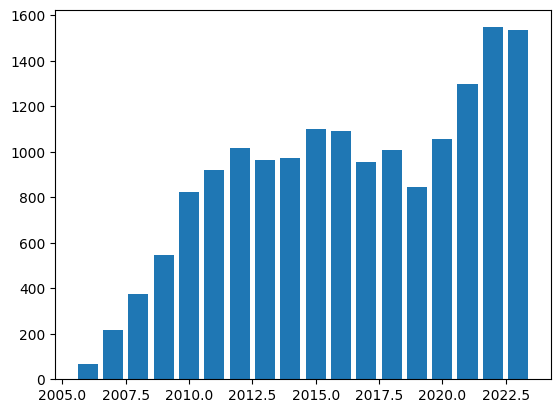

William Mitchell
[1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


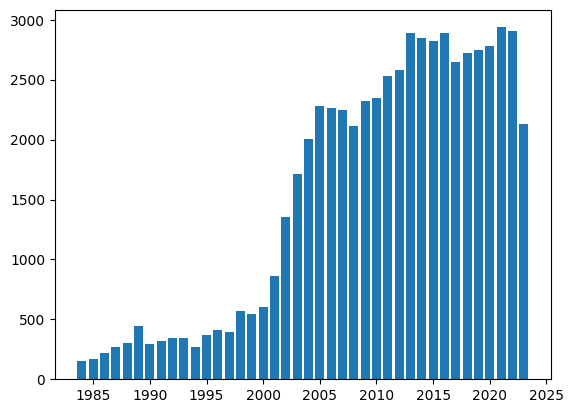

Ruket Cakici
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


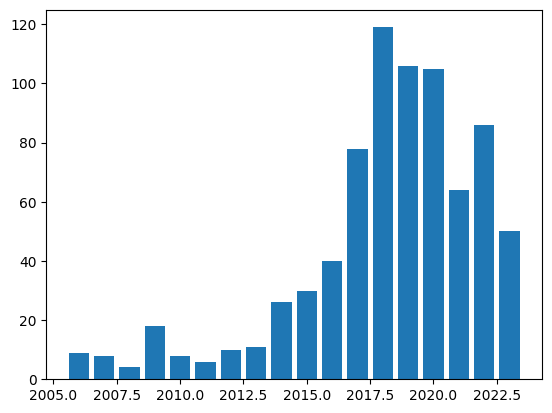

Cong Yao
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


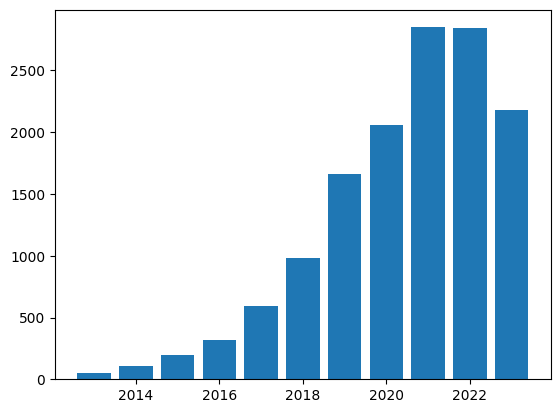

Roman Kern
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


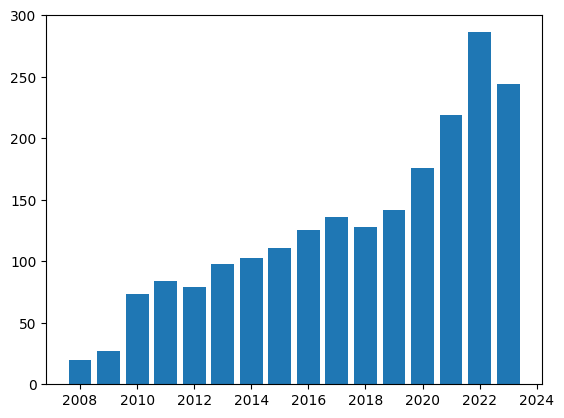

Jean-Roch Vlimant
[1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


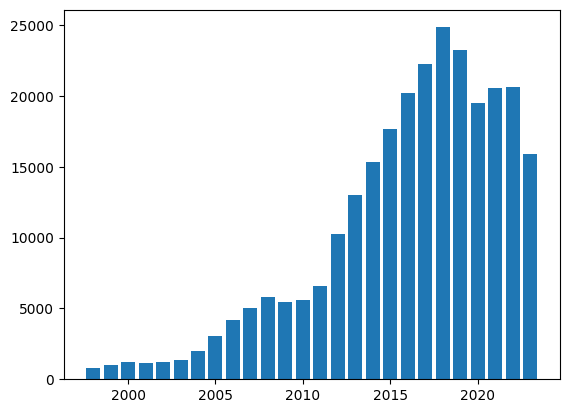

Muhammet cakir
[2020, 2021, 2022, 2023]


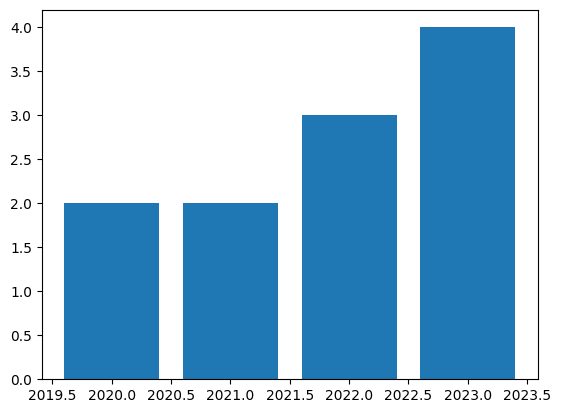

Jiachen Zhou
[2019, 2020, 2021, 2022, 2023]


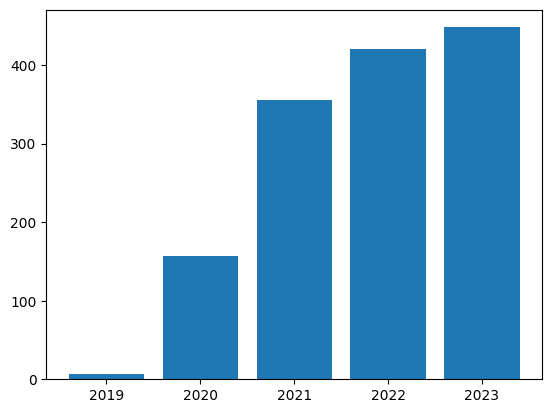

Jeremy Goldwasser
[2021, 2022, 2023]


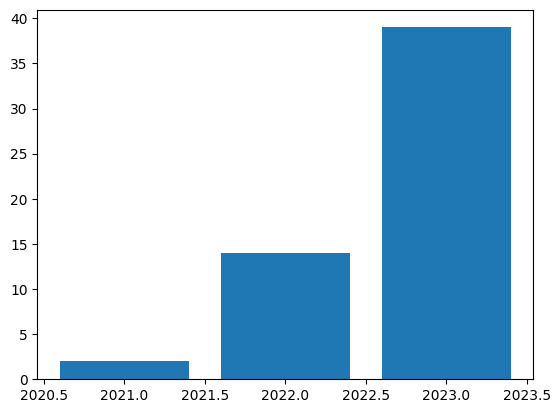

Benjamin Shickel
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


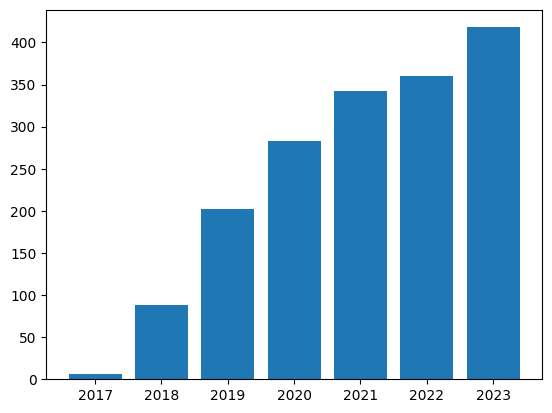

Abhinav Ramesh Kashyap
[2020, 2021, 2022, 2023]


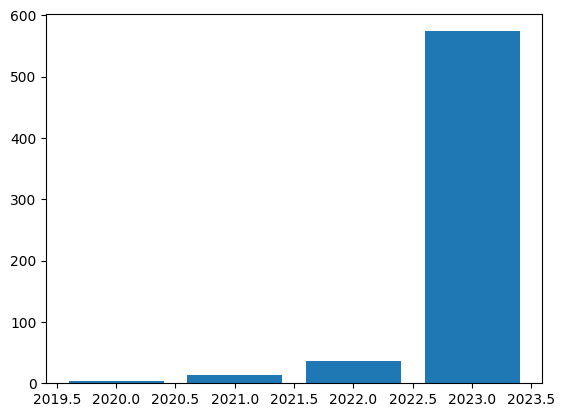

Hung-yi Lee
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


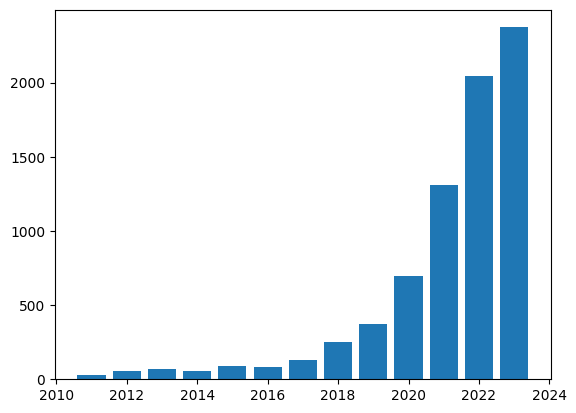

Shuiwang Ji
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


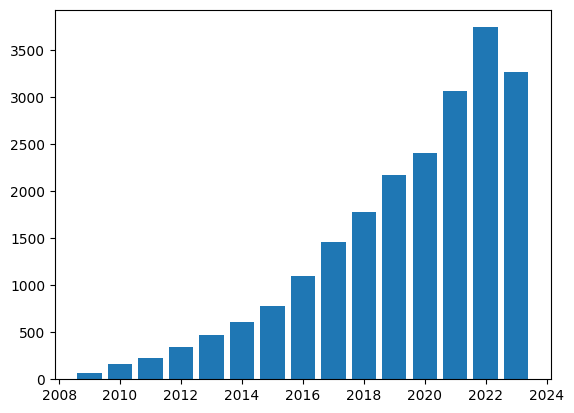

Juan Castorena
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


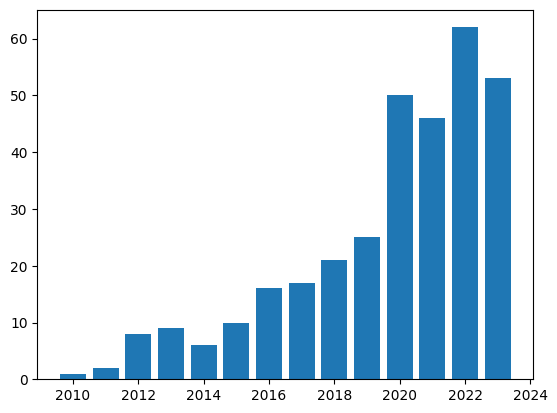

Abhinav Vishnu
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


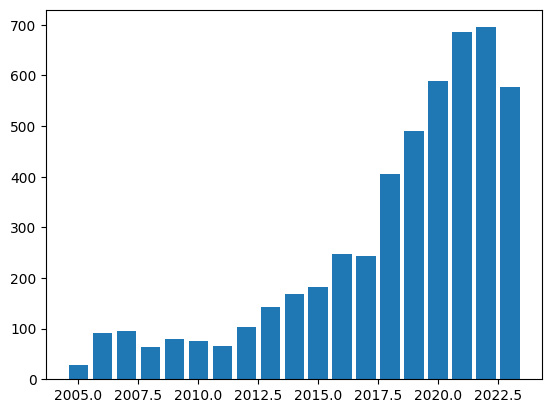

Ilya Prokin
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


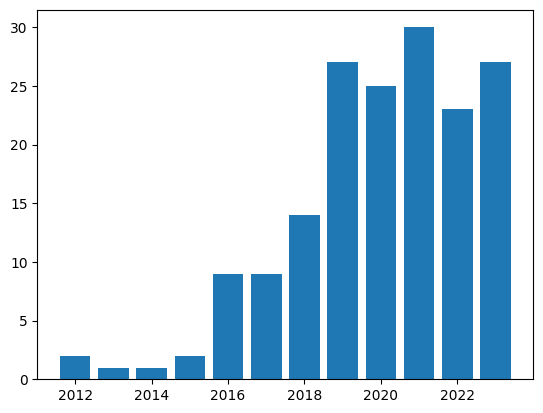

Chaoqiang Zhao
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


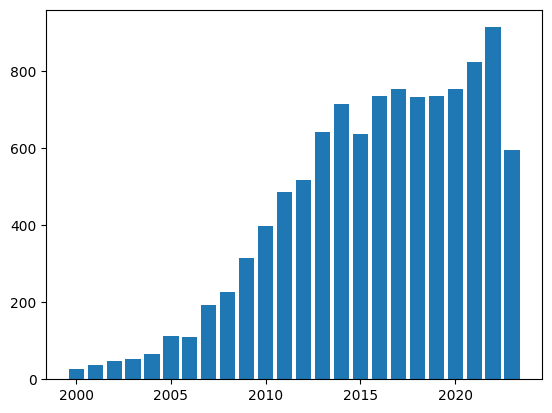

Mengmeng Song
[2021, 2022, 2023]


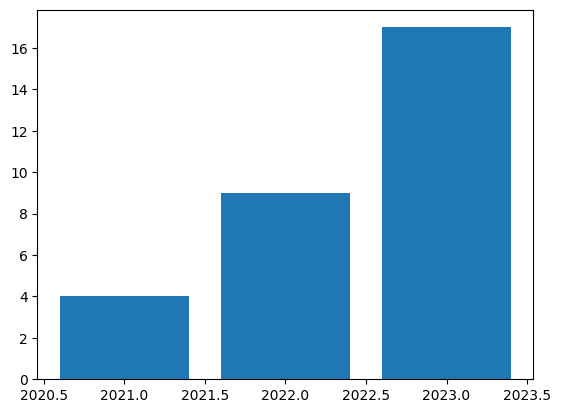

Seng Pei Liew
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


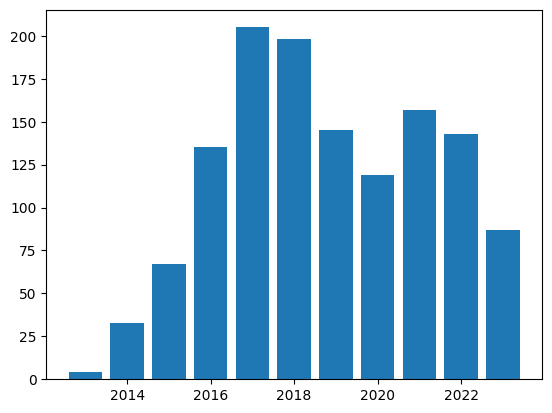

Lilapati Waikhom
[2020, 2021, 2022, 2023]


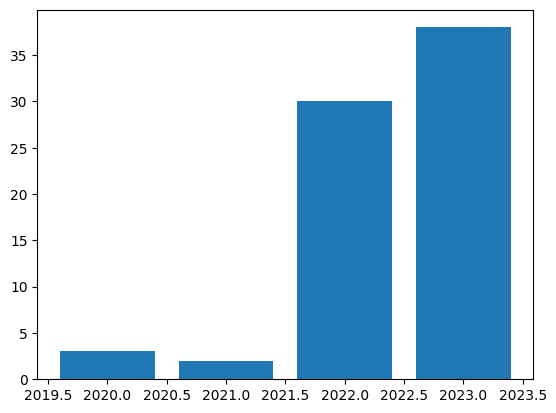

Ramchandra Joshi
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022]


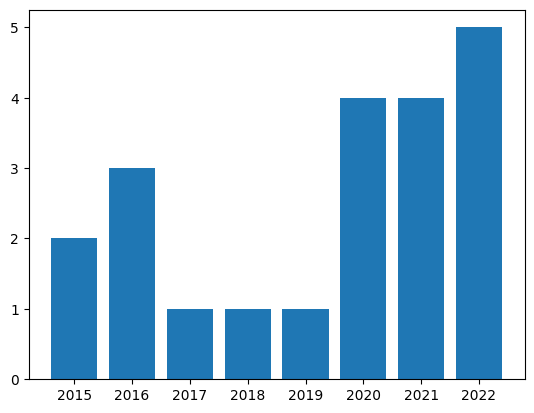

Hadi Esmaeilzadeh
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


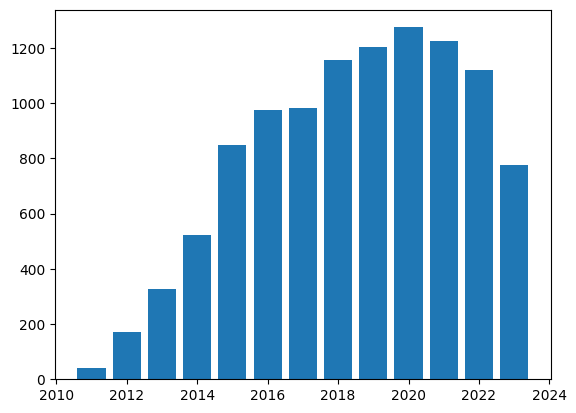

Muhammad Hadi Hussian
[2019, 2020, 2021, 2022, 2023]


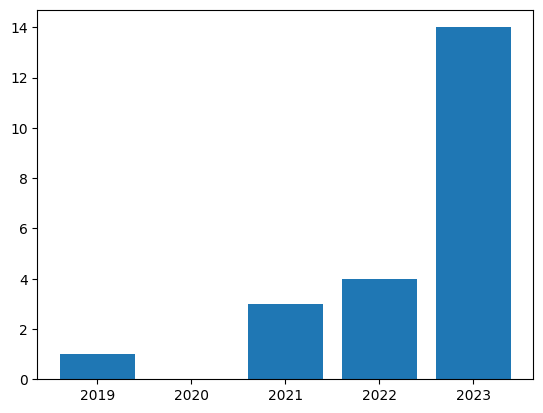

Jessica Pan
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


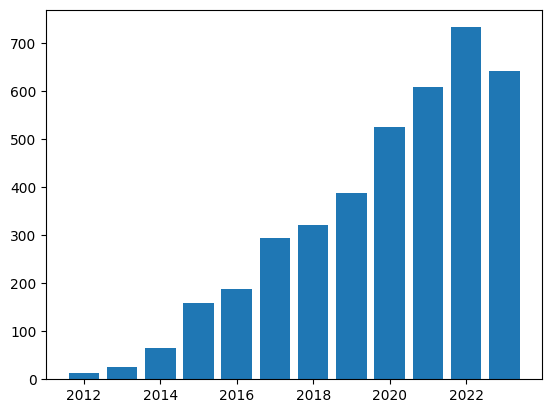

Dawei Li
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


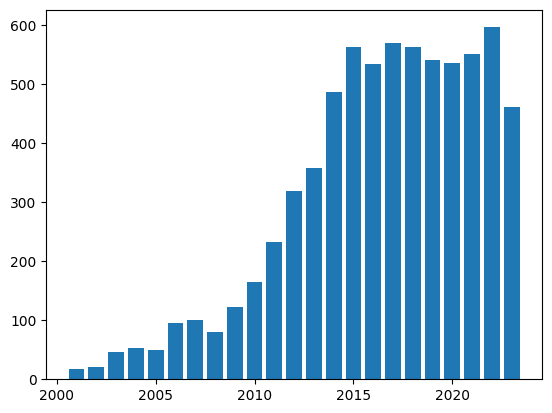

Anthony Sarah
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


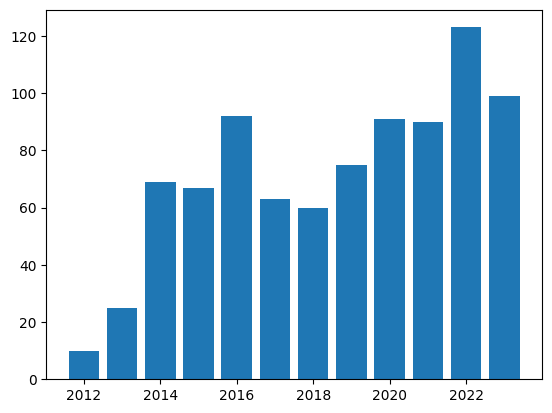

Rezoana Bente Arif
[2018, 2019, 2020, 2021, 2022, 2023]


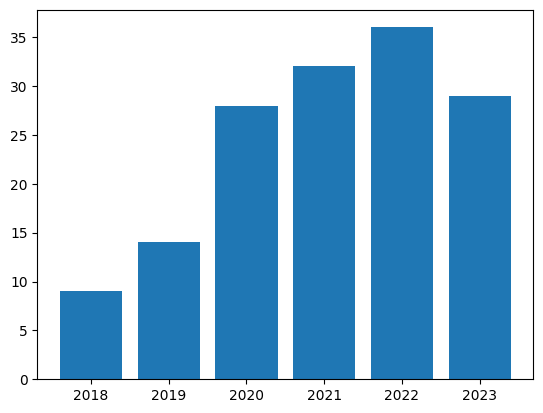

Anubhav Jain
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


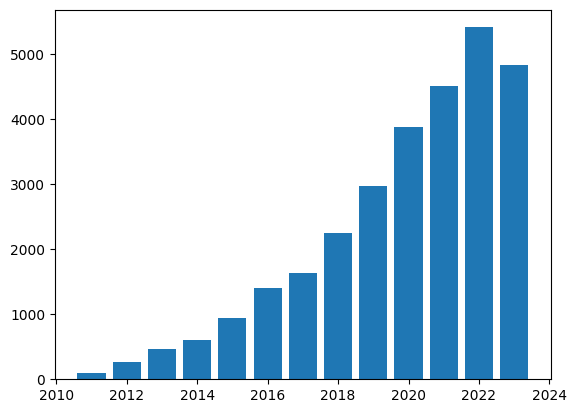

Hoo-Chang Shin
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


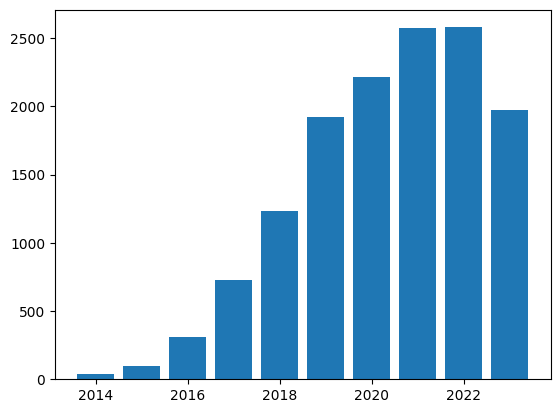

Tian Lv
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


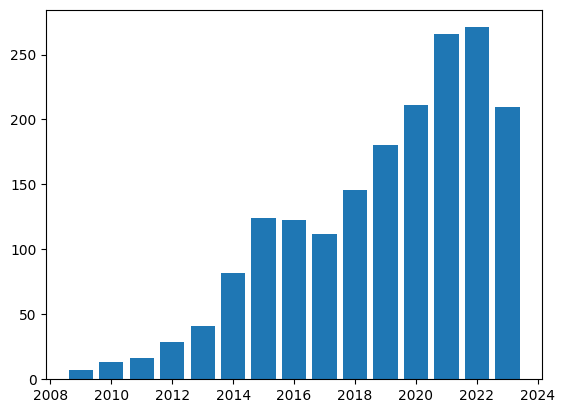

Arthur Szlam
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


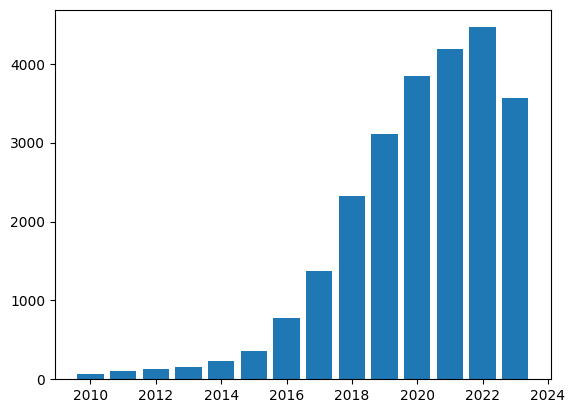

Christopher Dann
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


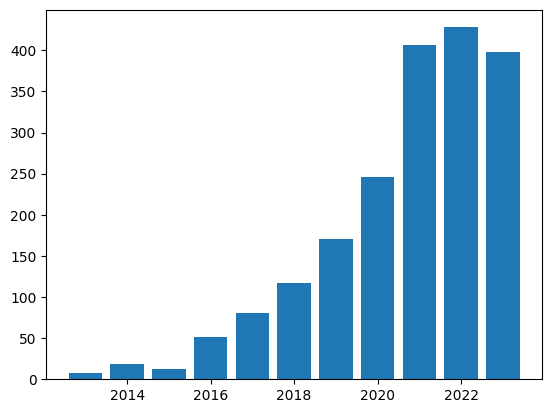

Tak-Sung Heo
[2020, 2021, 2022, 2023]


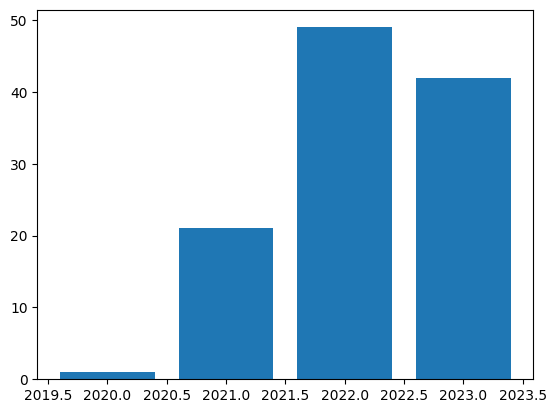

Chang-Tsun Li
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


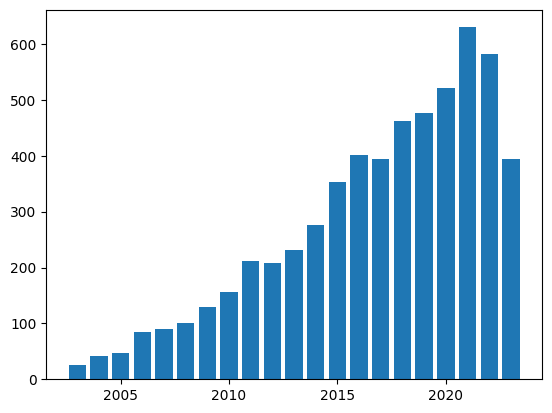

Shasha Li
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


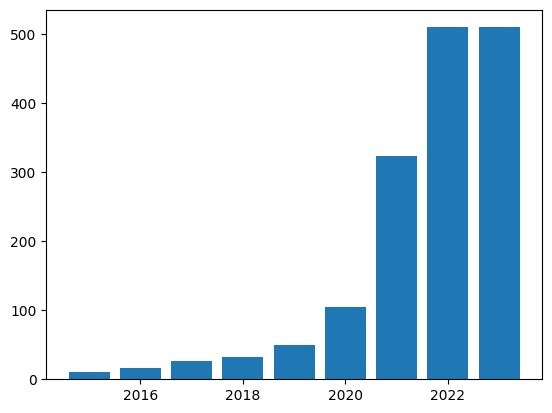

Xin Liu
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


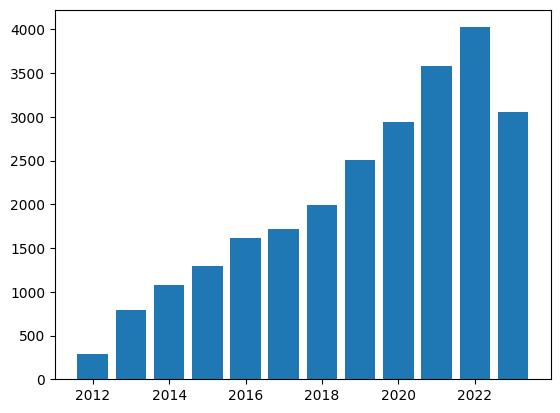

Yu Chen
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


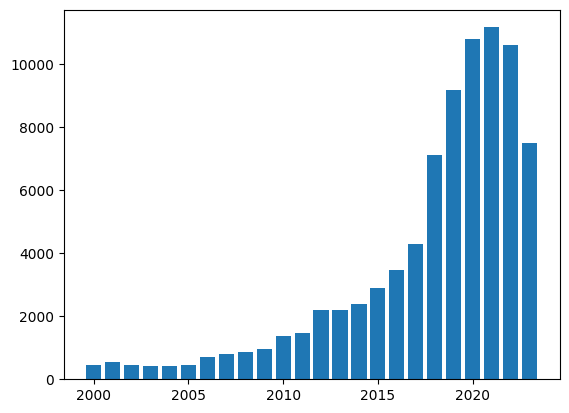

Claudio Fanconi
[2020, 2021, 2022, 2023]


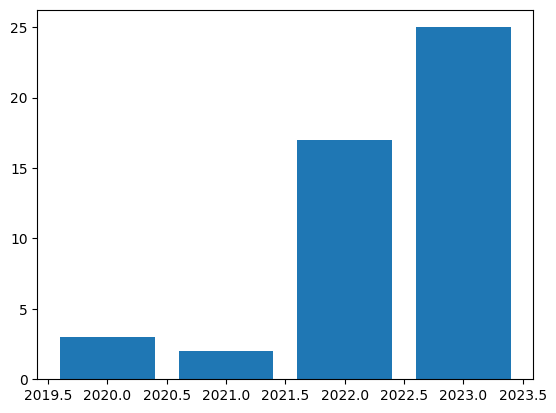

Lena Sasal
[2022, 2023]


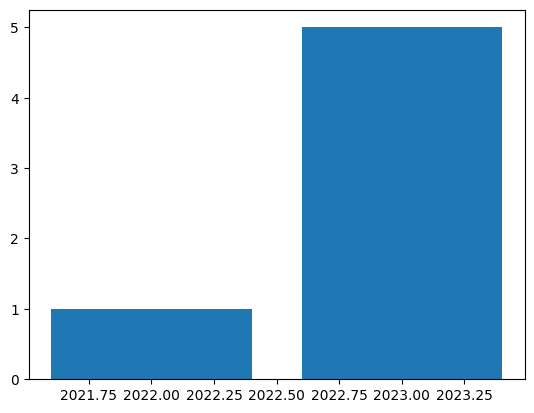

Ruth P Lim
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


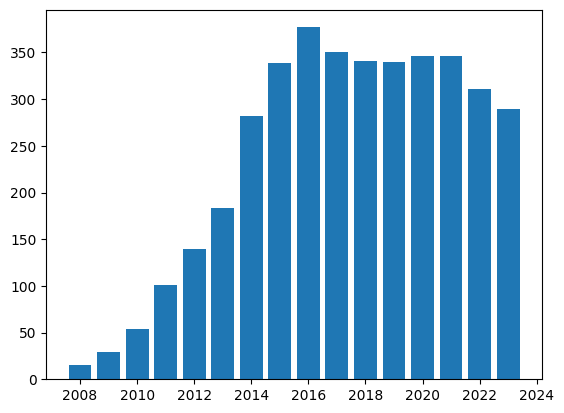

Lahiru Senevirathne
[2019, 2020, 2021, 2022, 2023]


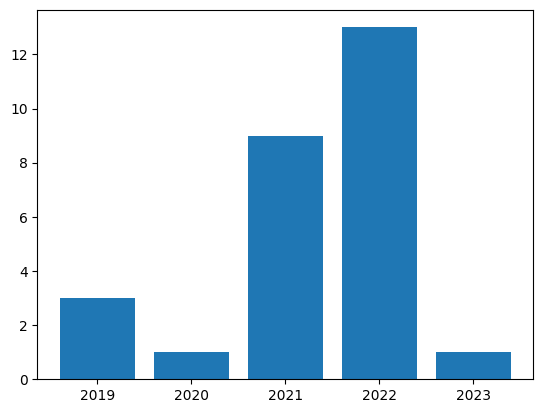

Zachary Tatlock
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


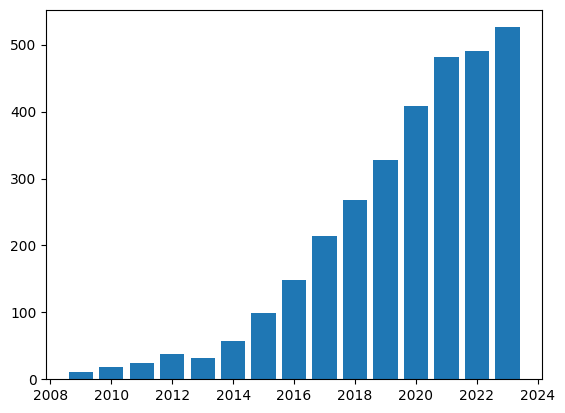

Nathan C. Frey
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


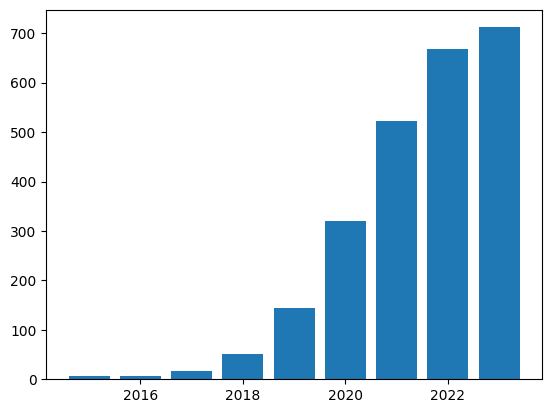

Loreto Parisi
[2018, 2019, 2020, 2021, 2022, 2023]


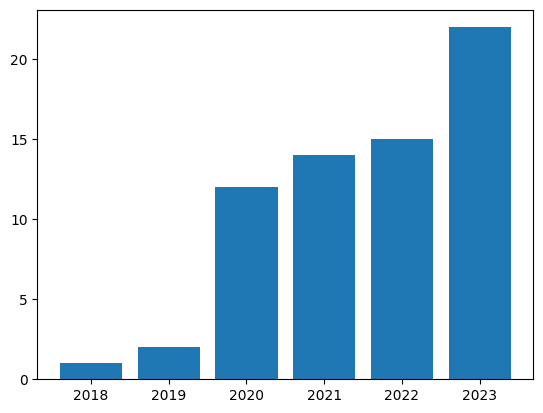

Judy W. Gichoya
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


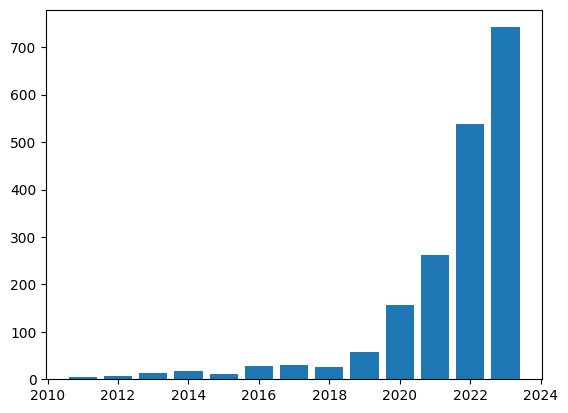

Xiaohui Tao
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


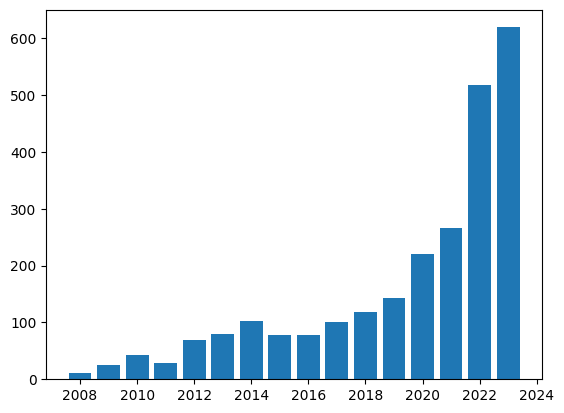

Julien Launay
[2020, 2021, 2022, 2023]


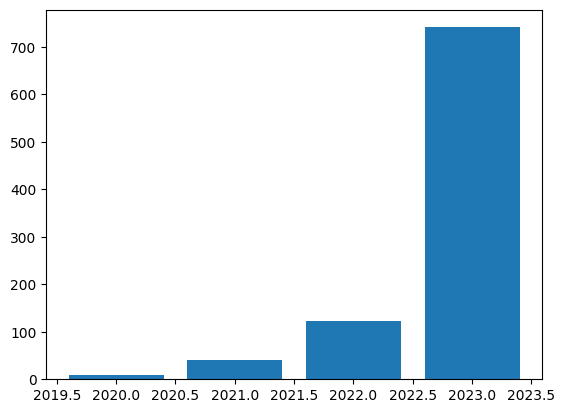

Yinpei Dai
[2020, 2021, 2022, 2023]


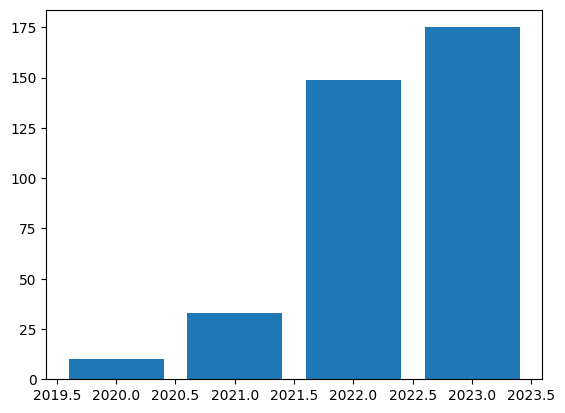

Stamatis Outsios
[1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


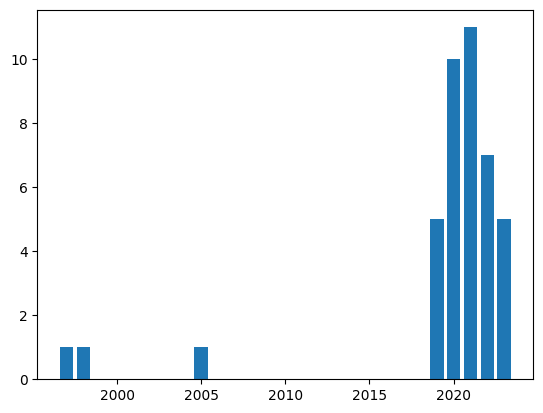

Tiago Gonçalves
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


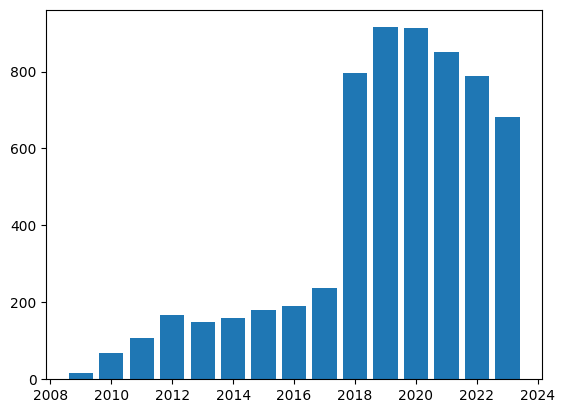

Rui-Yang Ju
[2022, 2023]


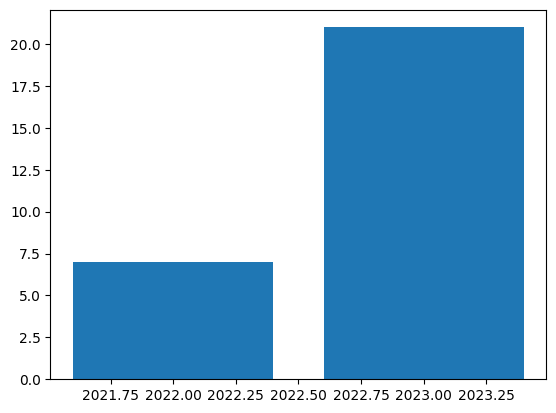

Nargiz Humbatova
[2020, 2021, 2022, 2023]


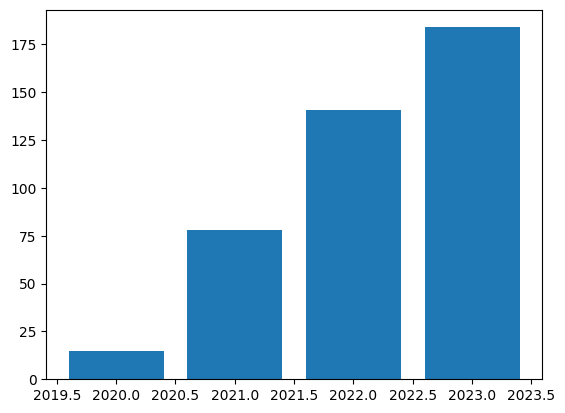

Chenchen Fan
[2019, 2020, 2021, 2022, 2023]


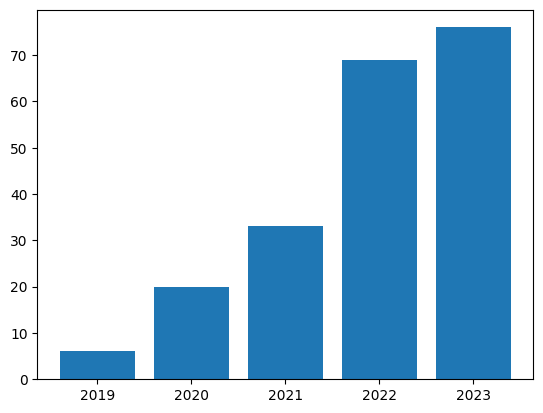

Silvio Barra
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


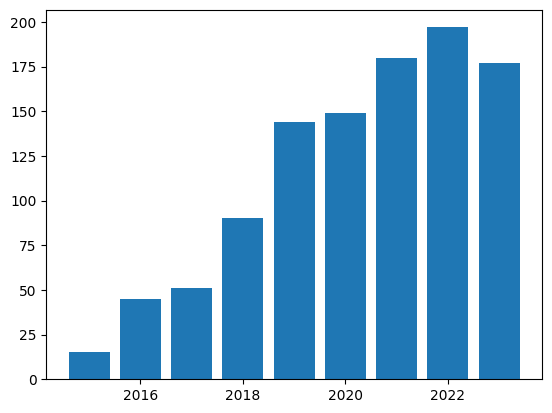

Petar Milin
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


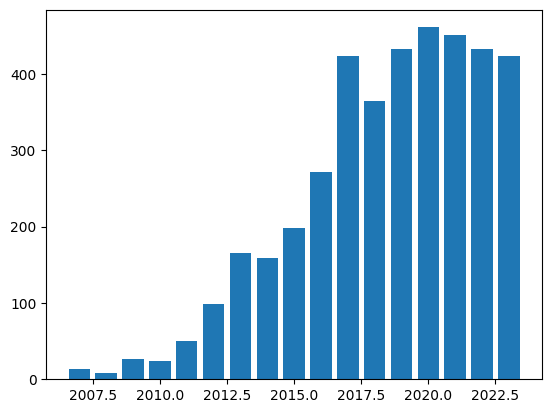

Yuge Shi
[2019, 2020, 2021, 2022, 2023]


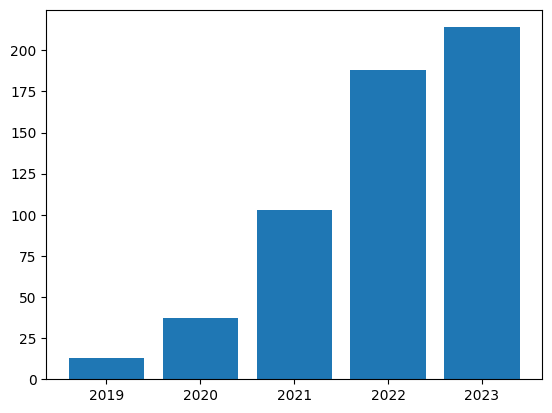

Adar Kahana
[2020, 2021, 2022, 2023]


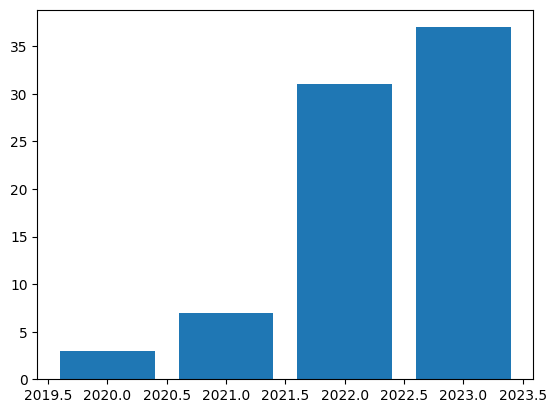

Chandan Singh
[2019, 2020, 2021, 2022, 2023]


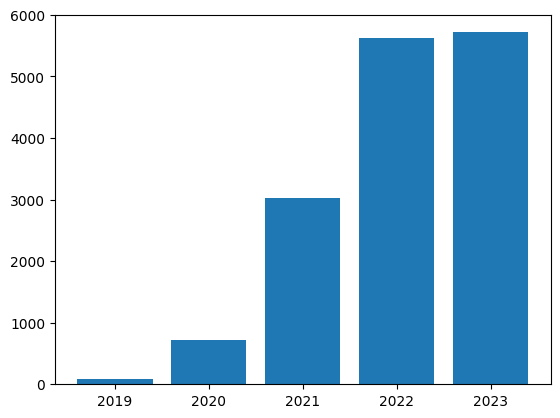

Jianyu Zhao
[2019, 2020, 2021, 2022, 2023]


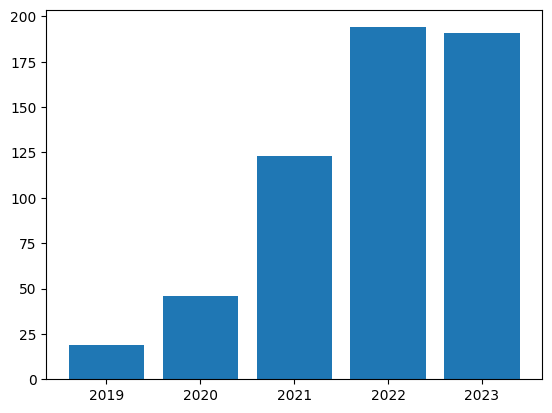

Masahiro Yamamoto
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


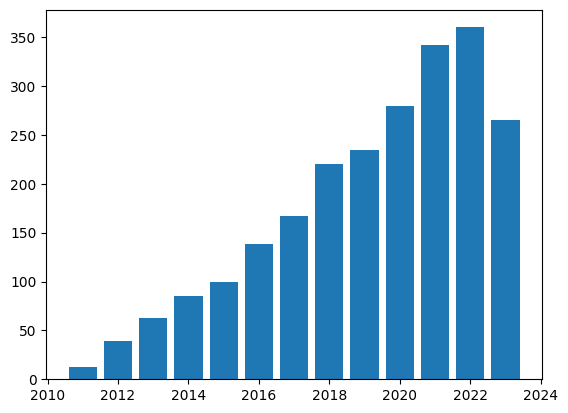

Mario Villaizán-Vallelado
[]


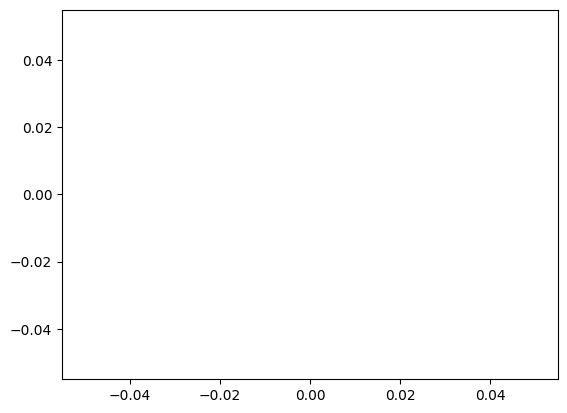

Eldad Haber
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


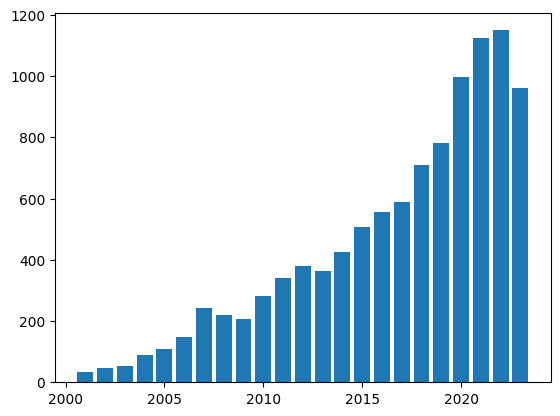

Deepu John
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


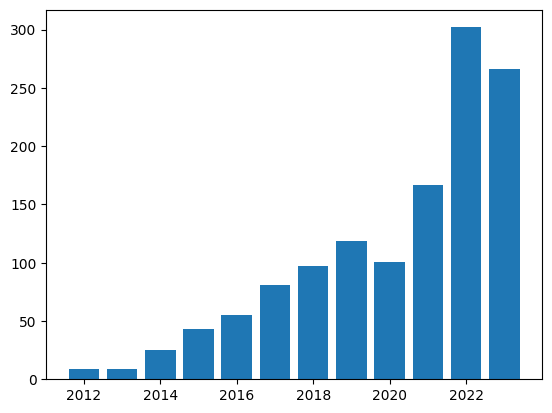

Jun Pang
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


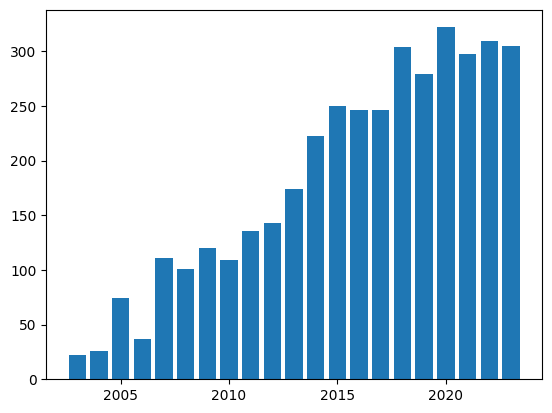

P. Santhanam
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


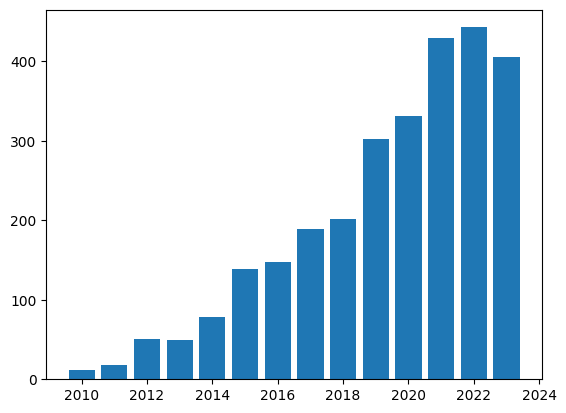

Tao Jiang
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


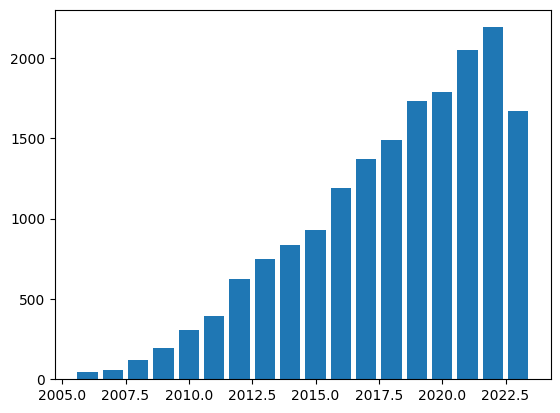

Tom Young
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


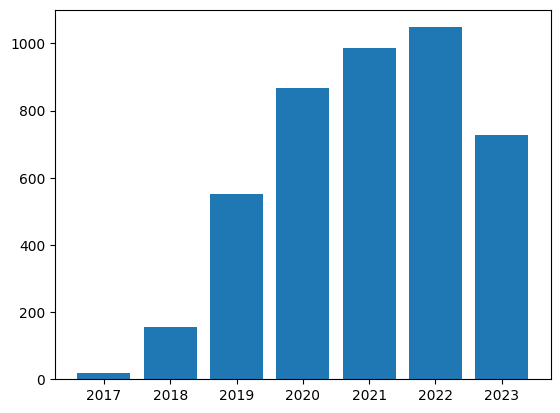

Tongliang Liu
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


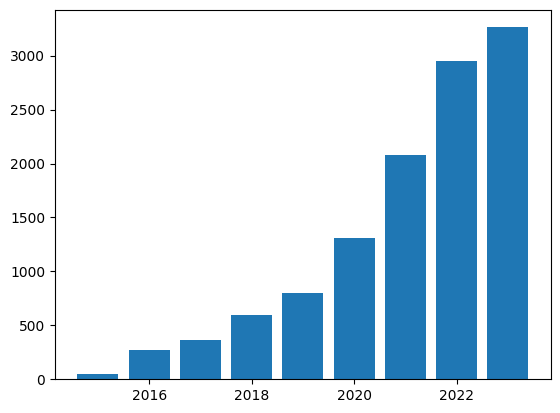

Kurt Keutzer
[1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


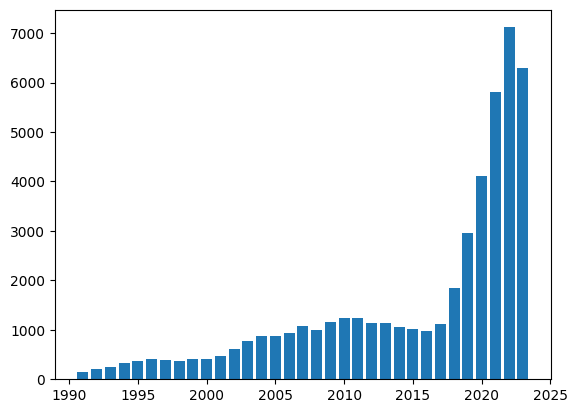

Timo Hartmann
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


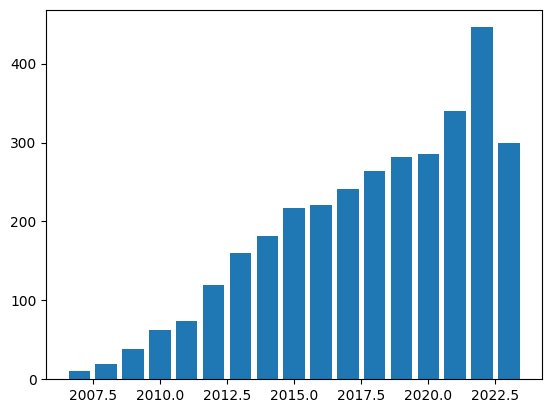

Kyongsik Yun
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


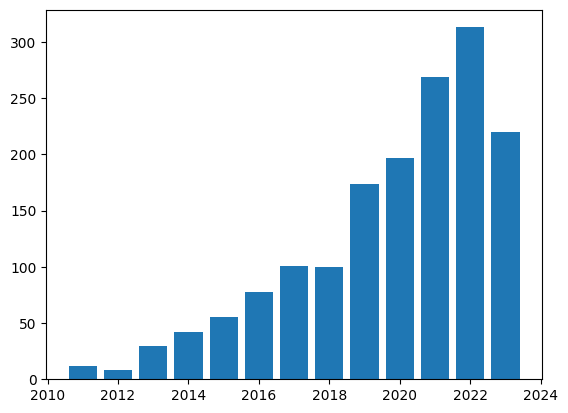

Zhifeng Li
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


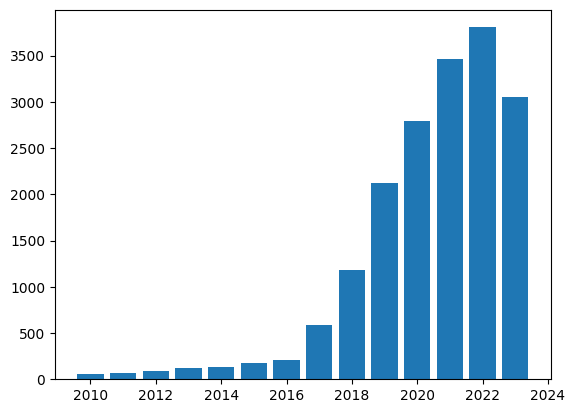

Chongyu Zhang
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


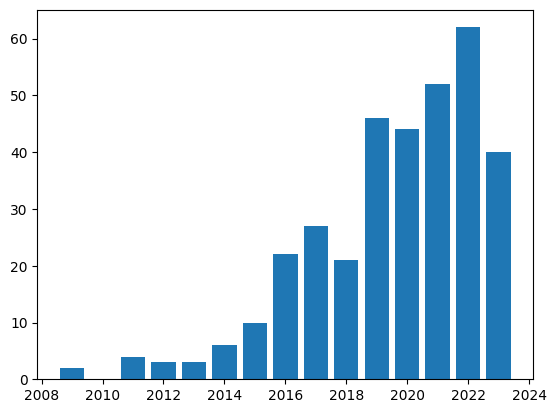

Jiang Lu
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


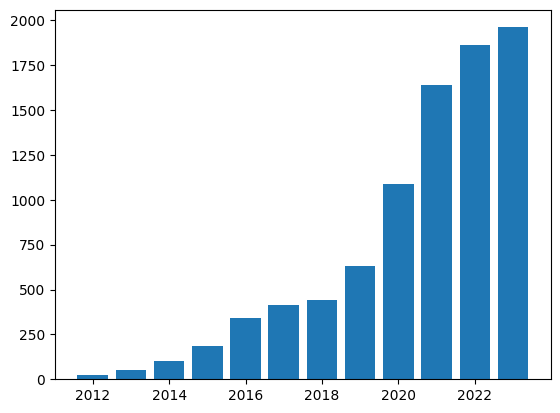

Adriel Saporta
[2021, 2022, 2023]


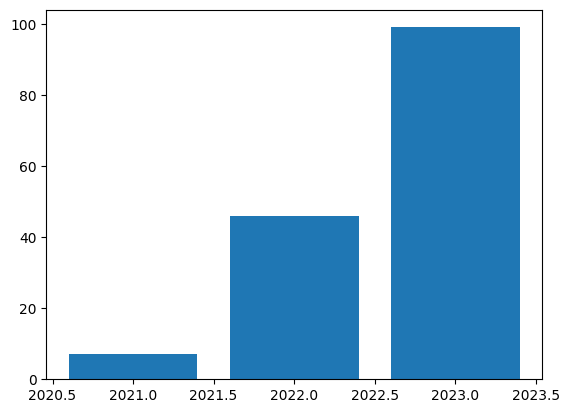

Avi Mendelson
[1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


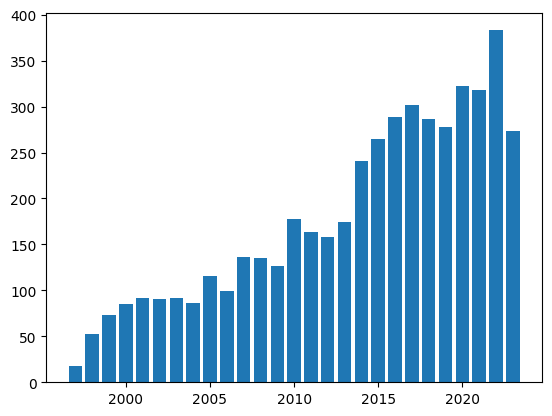

Yujun Lin
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


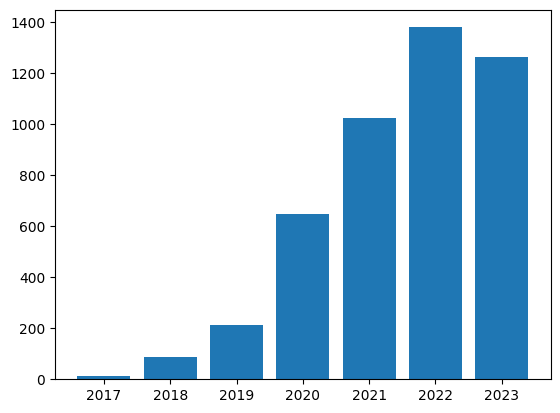

Tsuhan Chen
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


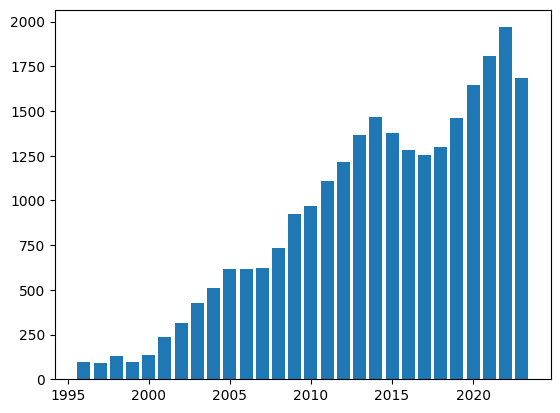

Tejas Gokhale
[2020, 2021, 2022, 2023]


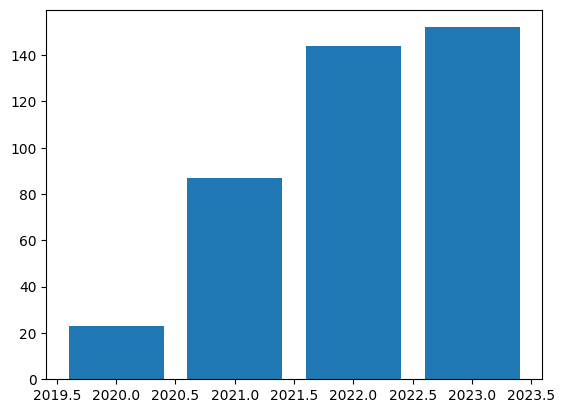

Jiandong Zhou
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


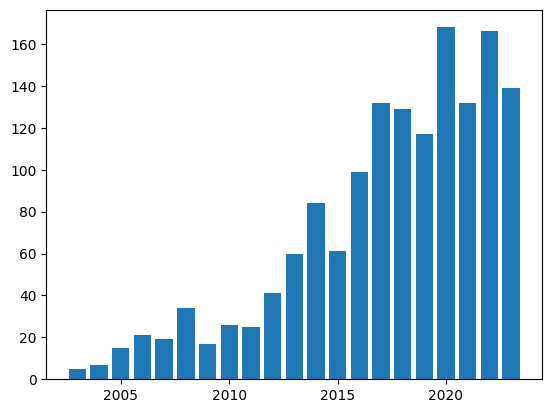

Chenqiu Zhao
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


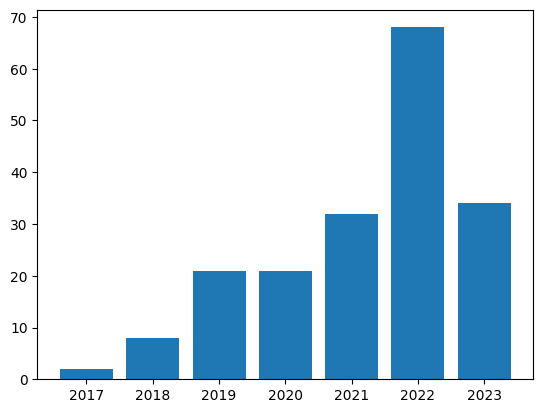

Sitong Wu
[2021, 2022, 2023]


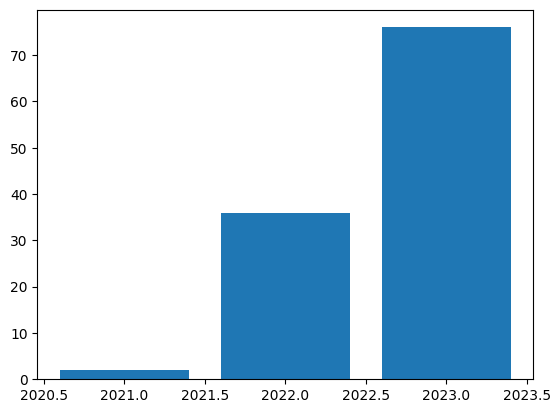

Yeyun Zou
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


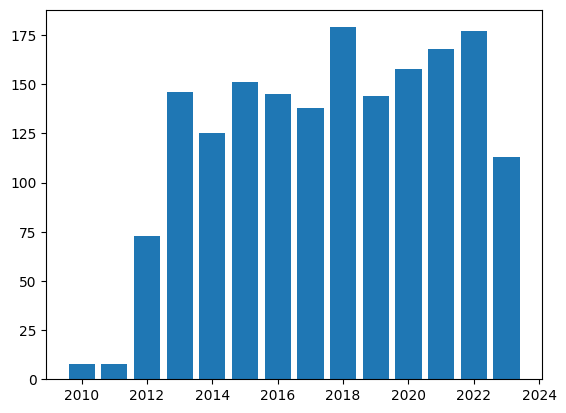

Shaoen Wu
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


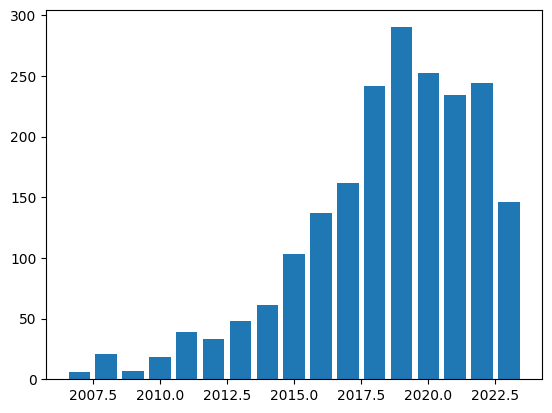

Marco Gori
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


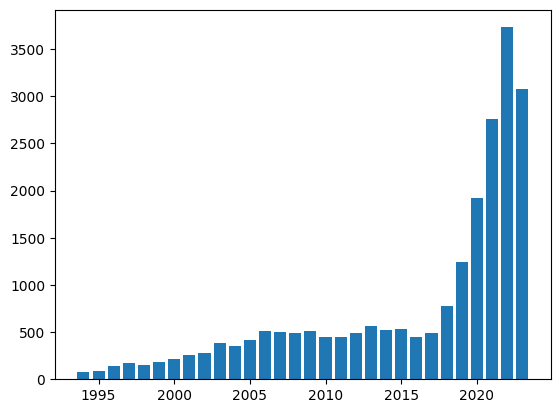

Chi Ian Tang
[2019, 2020, 2021, 2022, 2023]


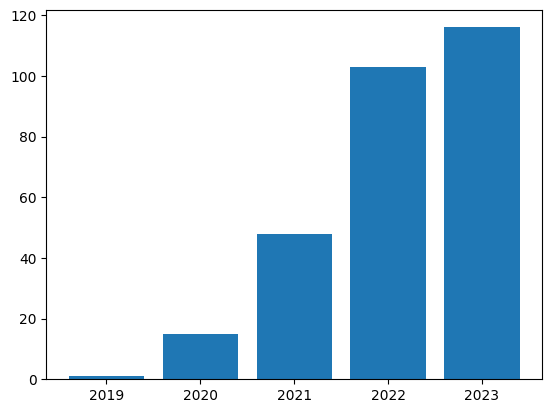

Mohamed Lamine Malki
[2021, 2022, 2023]


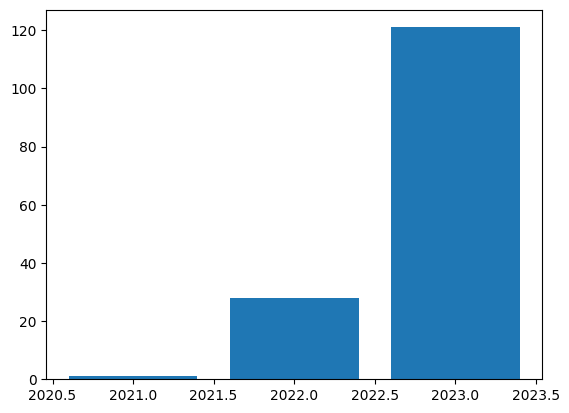

Sahil Sharma
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


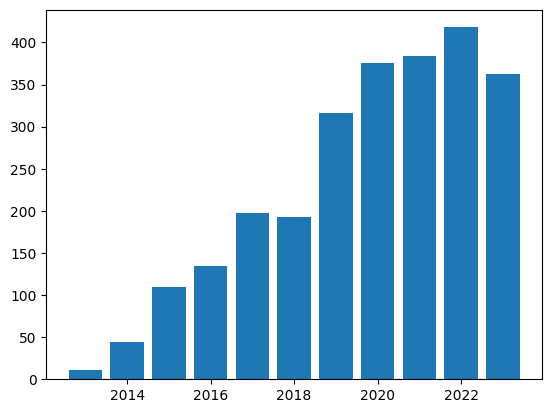

Guy Farjon
[2018, 2019, 2020, 2021, 2022, 2023]


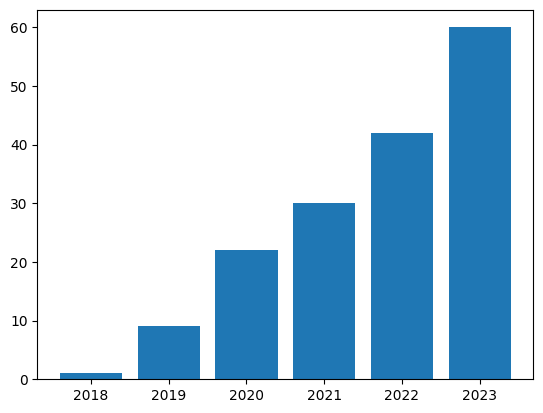

Shengzhi Zhang
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


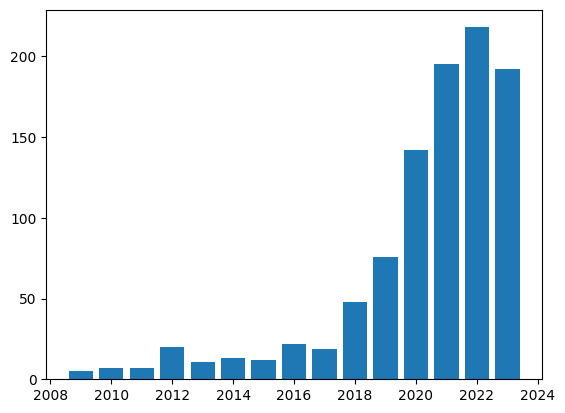

Chun-Hsien Lin
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


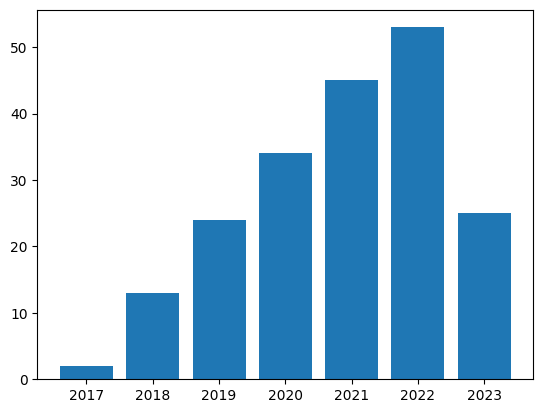

Shashank Shekhar
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


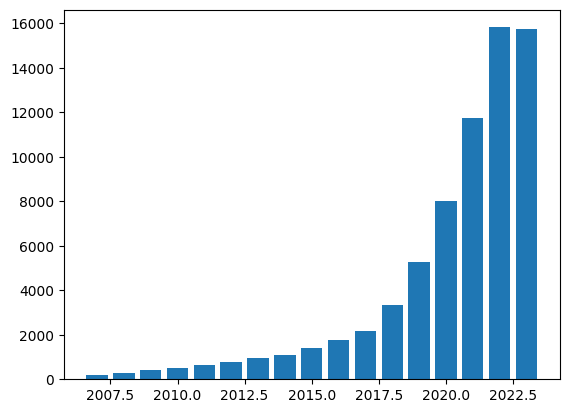

Nisansa de Silva
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


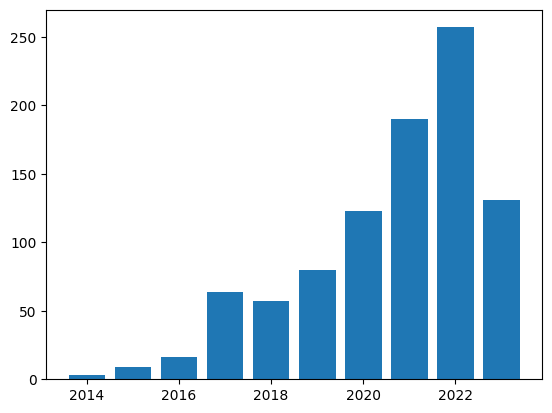

Christian Scheible
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


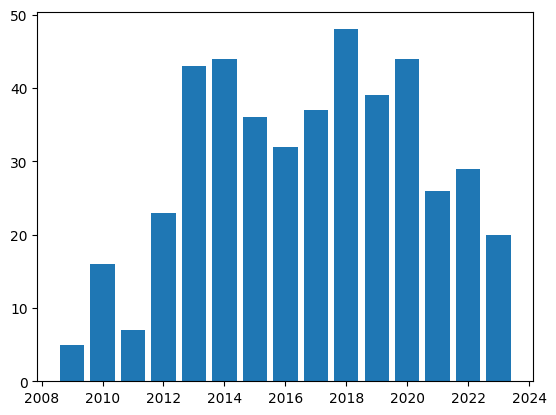

Yanyao Shen
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


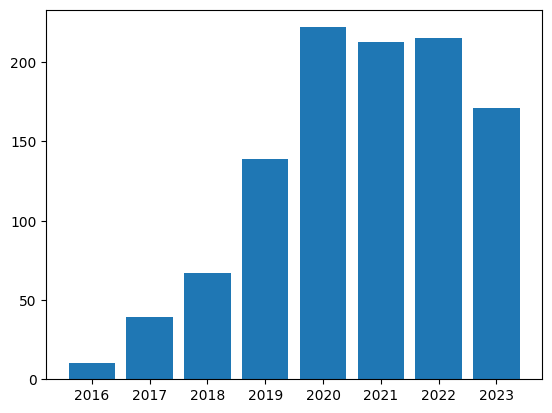

Dongdong Zhao
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


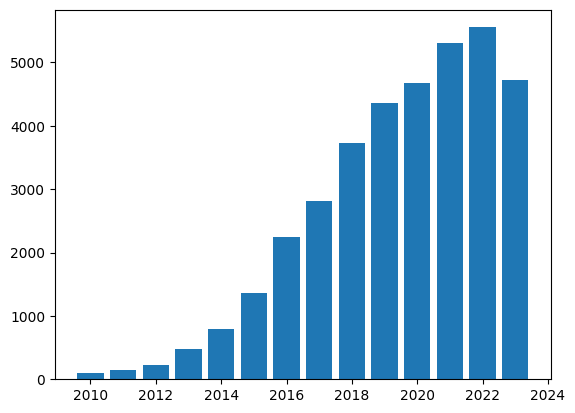

Francesco Giannini
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


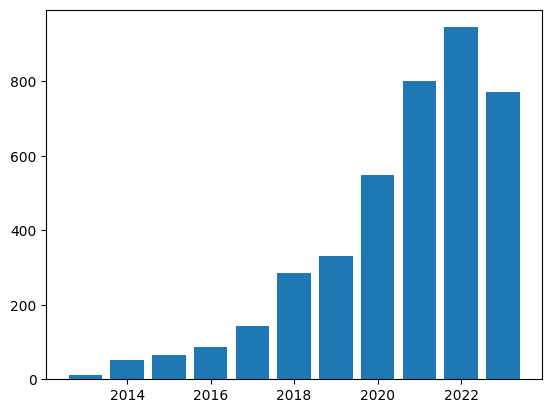

Honggang Zhang
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


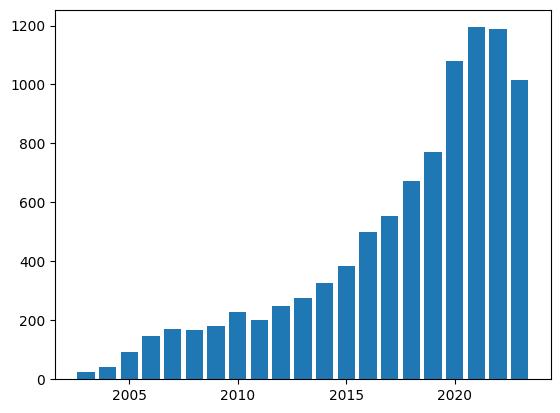

Arijit Khan
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


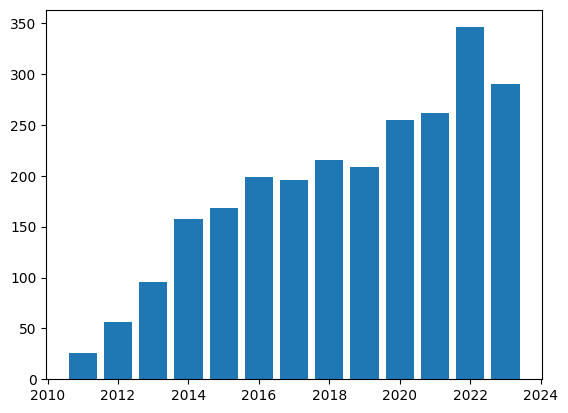

Eugene Tam
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


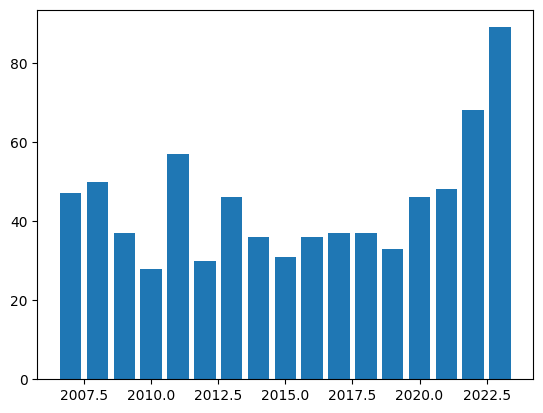

Avshalom Elmalech
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


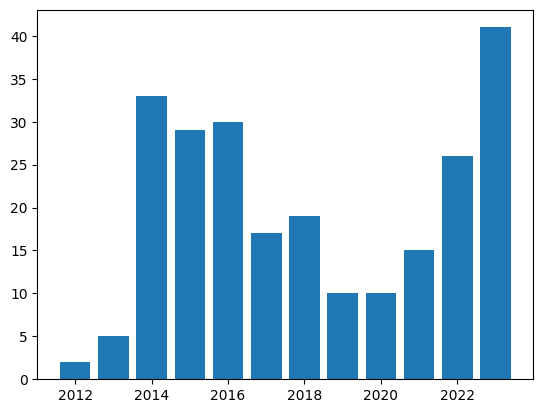

Kabir Nagrecha
[2020, 2021, 2022, 2023]


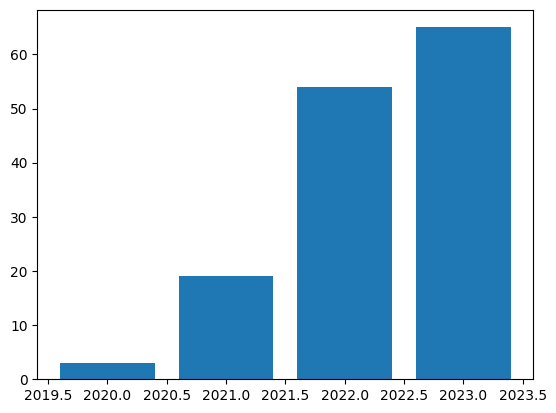

Di Wu
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


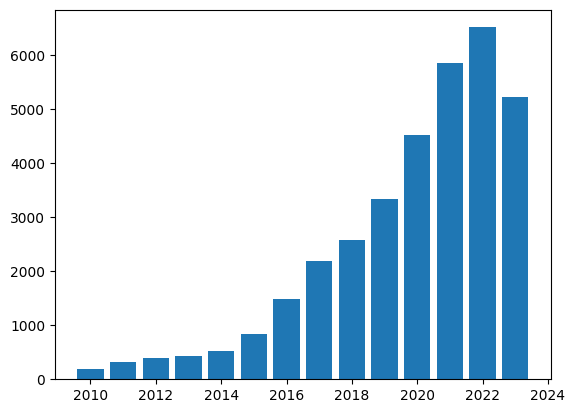

Thomas C. Booth
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


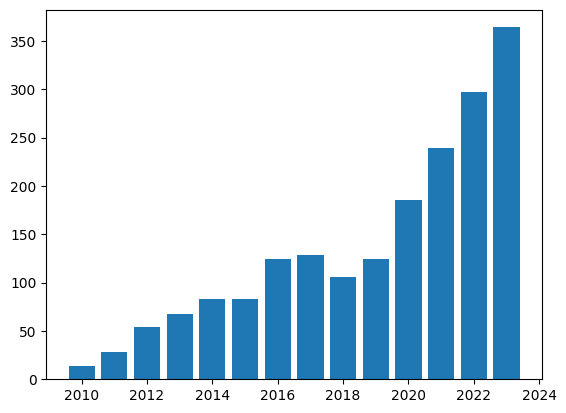

Soheila Molaei
[2018, 2019, 2020, 2021, 2022, 2023]


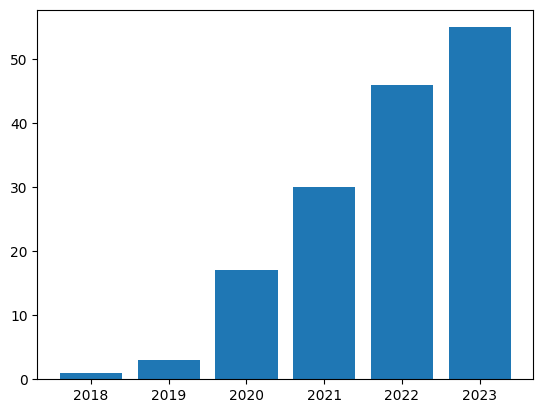

Pablo Zegers
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


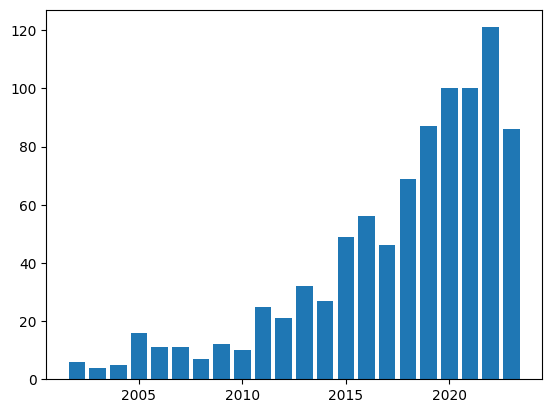

Paolo Tonella
[1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


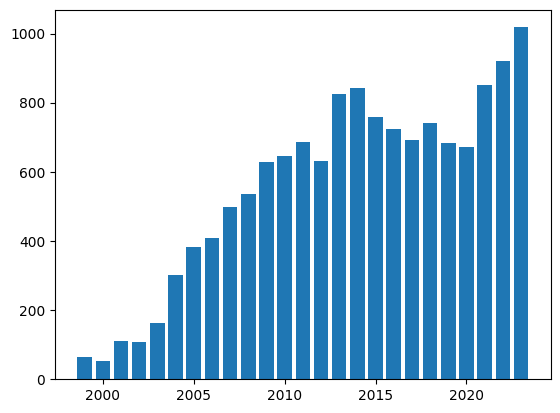

Feng Gao
[1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


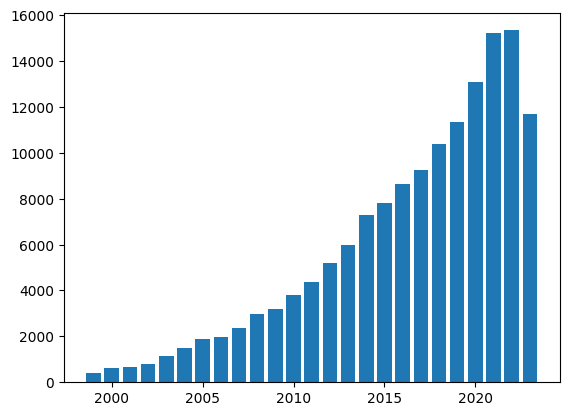

John Folkesson
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


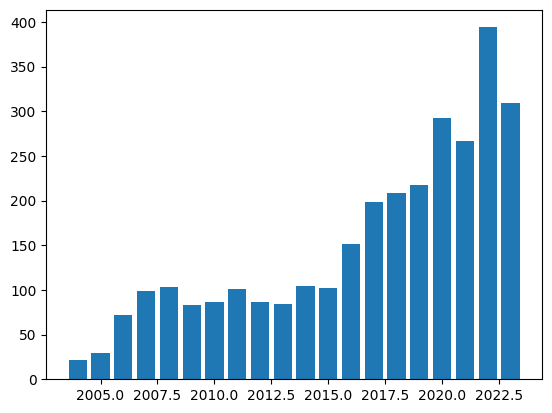

Yongming Rao
[2018, 2019, 2020, 2021, 2022, 2023]


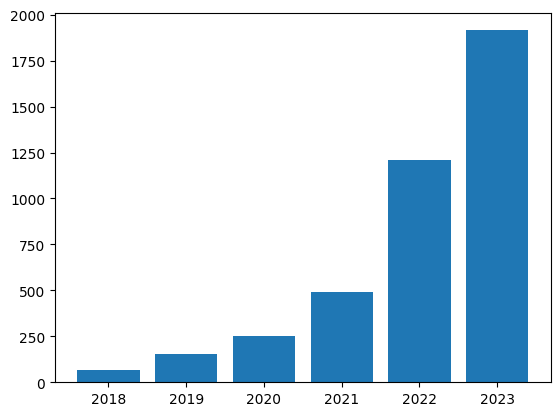

Ming Zhang
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


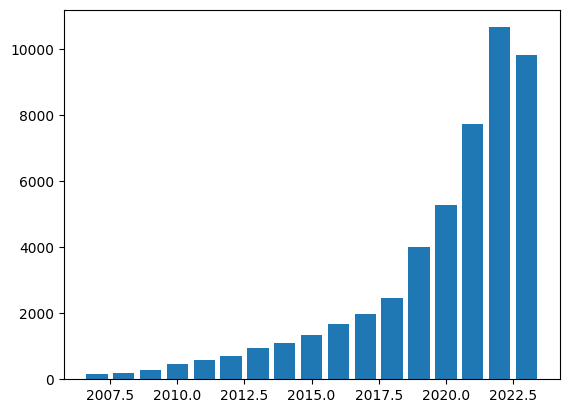

Abhishek Gupta
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


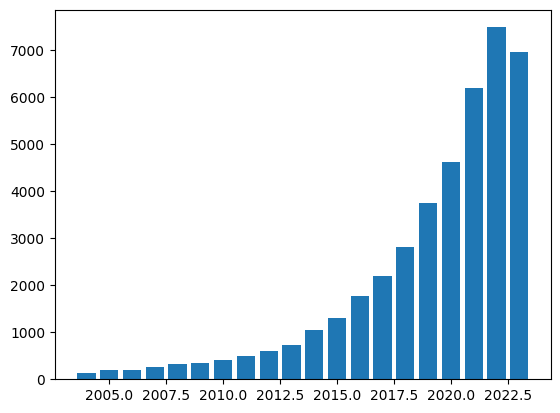

Emanuele Rodolà
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


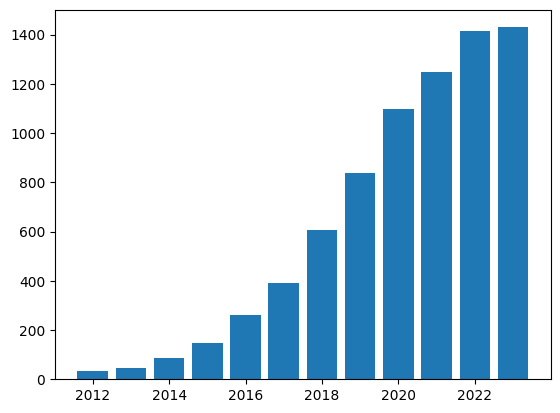

Abrar Ahmed
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


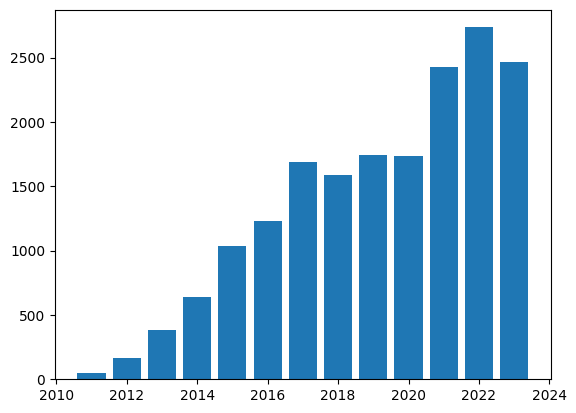

Weiping Li
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


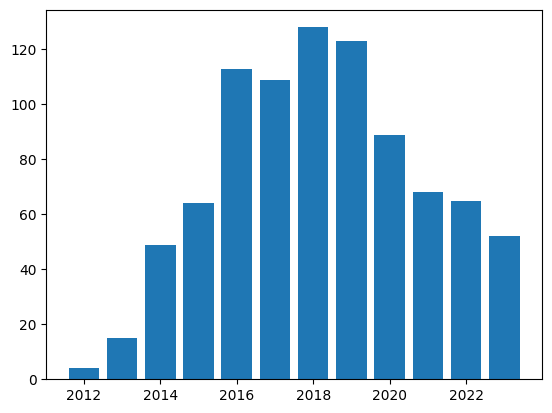

Naeem K. Janjua
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


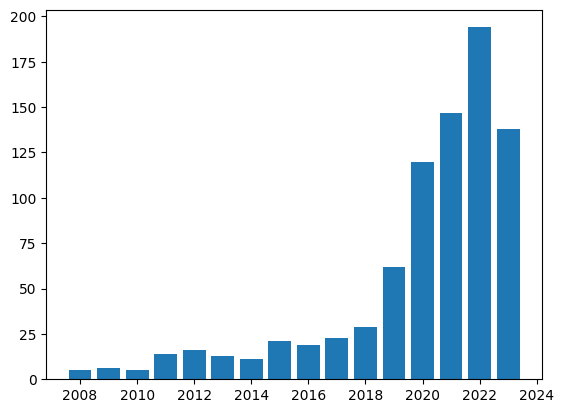

Lingfei Ma
[2018, 2019, 2020, 2021, 2022, 2023]


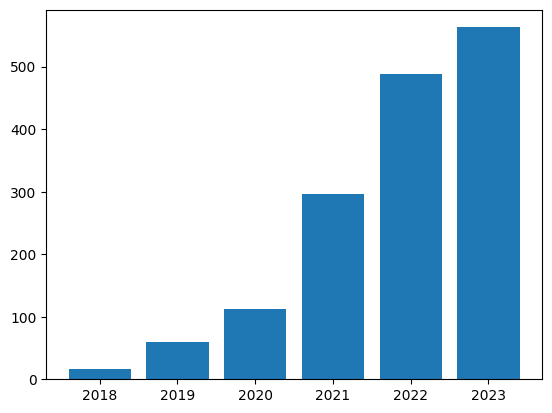

Hongyang Sun
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


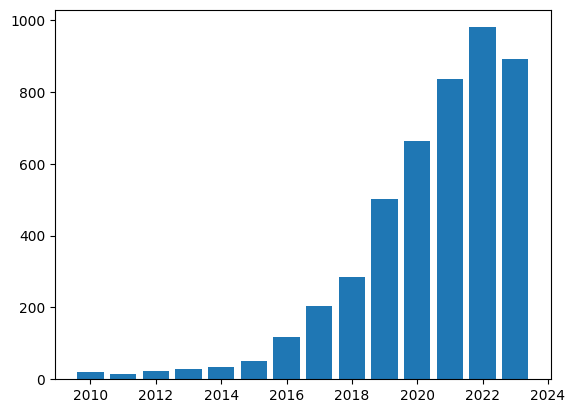

Alok Choudhary
[1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


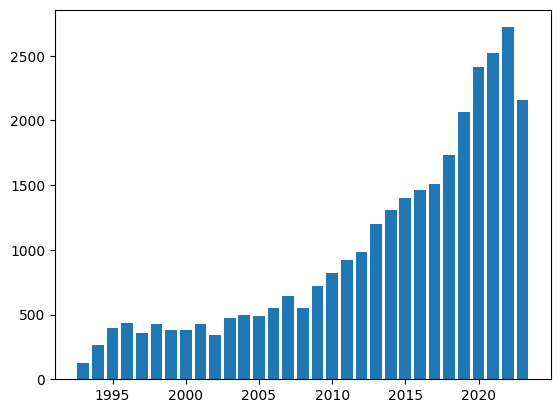

Ying Shen
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


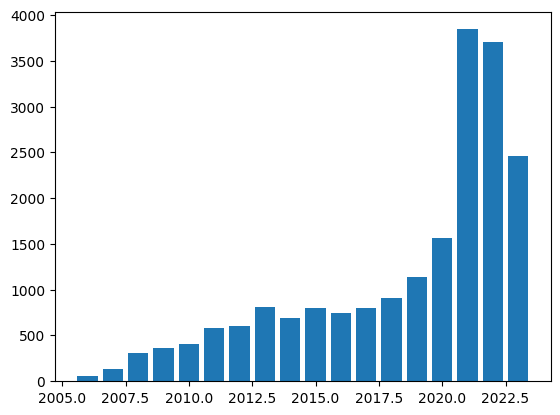

Georgios Leontidis
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


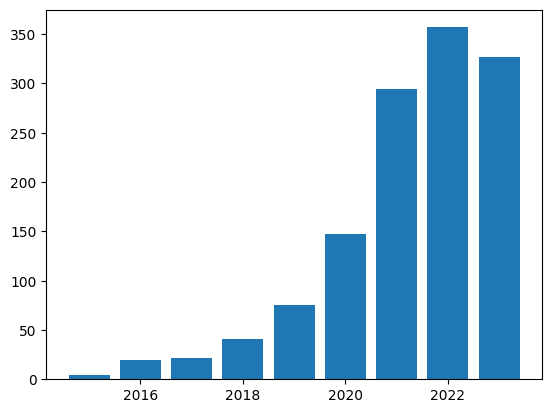

Ruijie Quan
[2019, 2020, 2021, 2022, 2023]


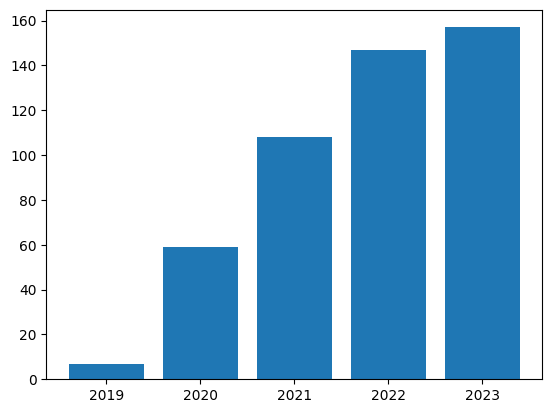

Eric Nyberg
[1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


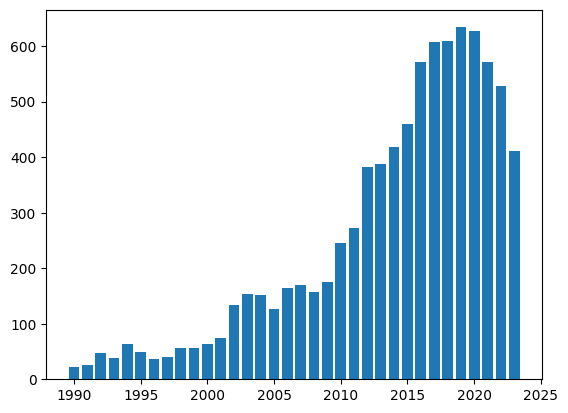

Ting Lei
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


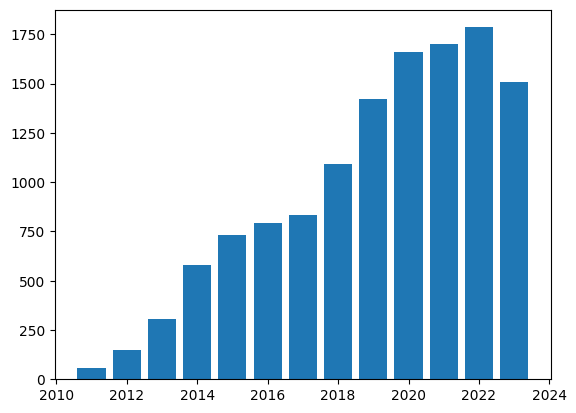

Kuan-Yu Chen
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


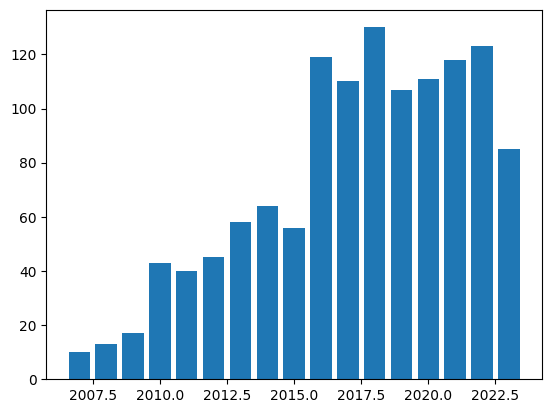

Joel Tetreault
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


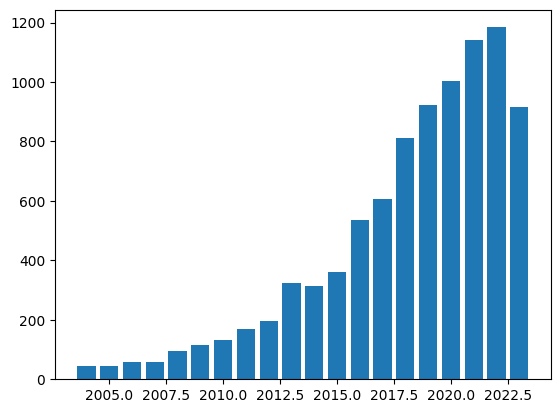

Hao Luo
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


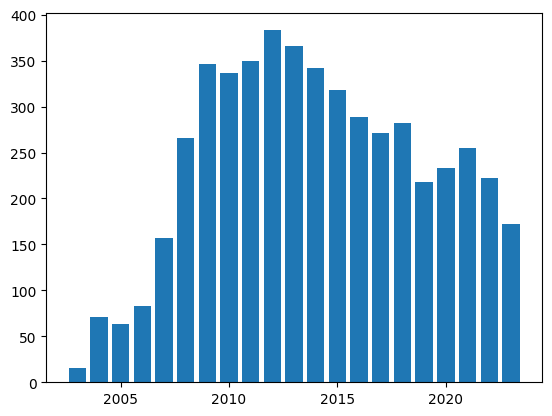

Colin Schultz
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


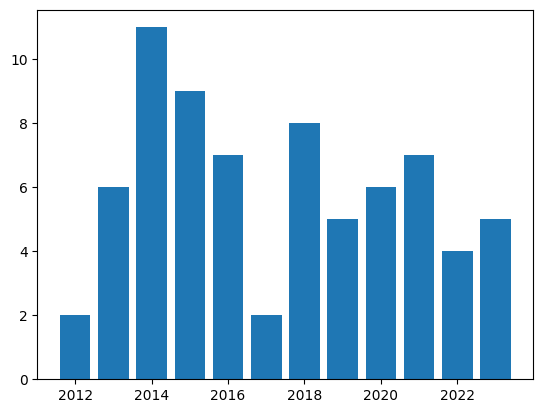

Tanik Saikh
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


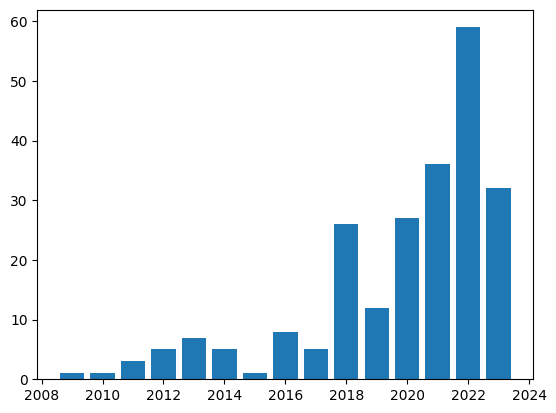

Ying Liu
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


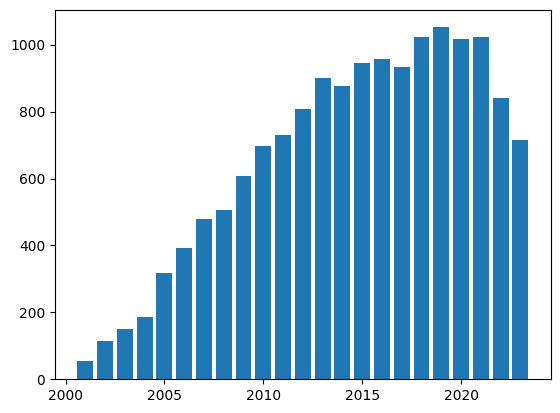

Amir Globerson
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


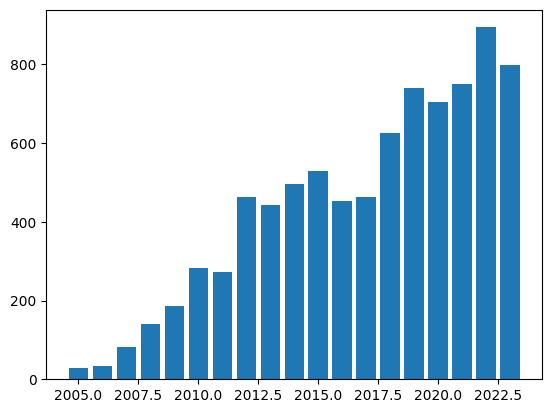

Artem Babenko
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


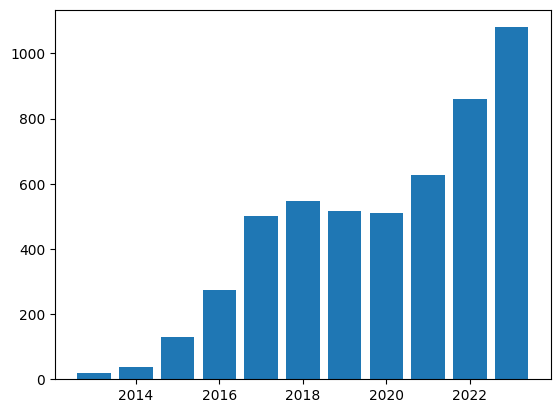

Toon Goedemé
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


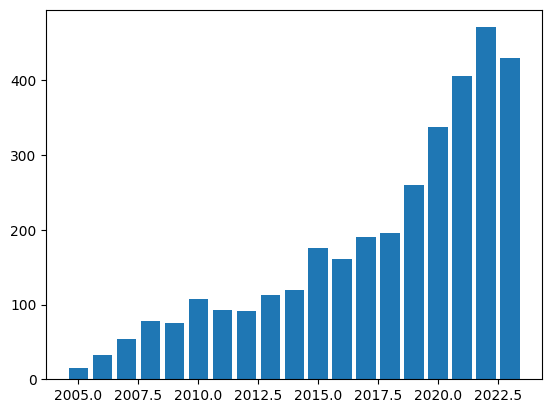

Lichao Mou
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


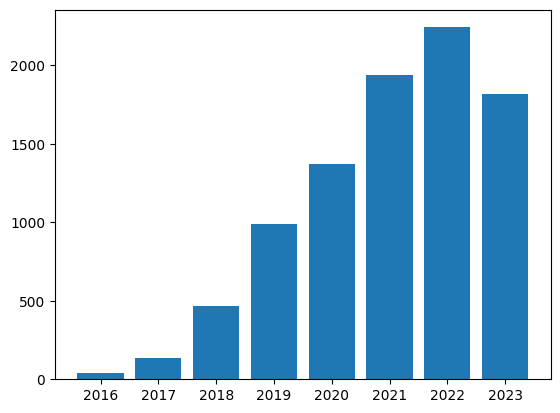

Giovanni Brignone
[]


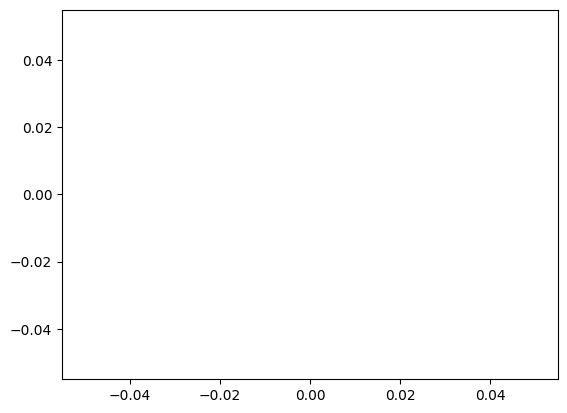

Yike Guo
[1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


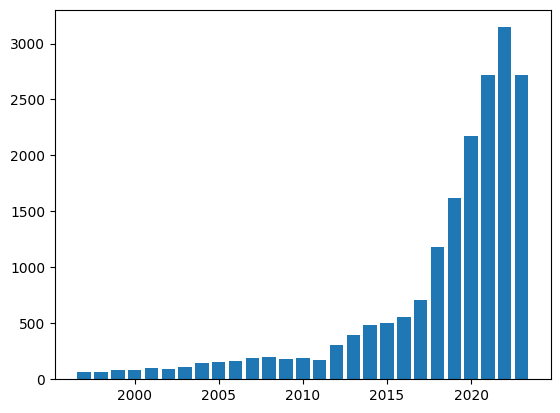

Aixin Sun
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


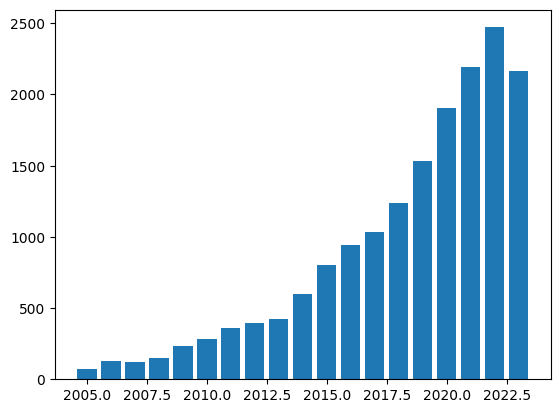

Mahmoud Al-Ayyoub
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


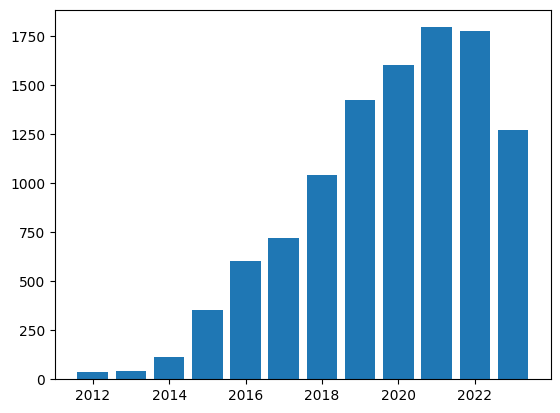

HyeonJun Kim
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


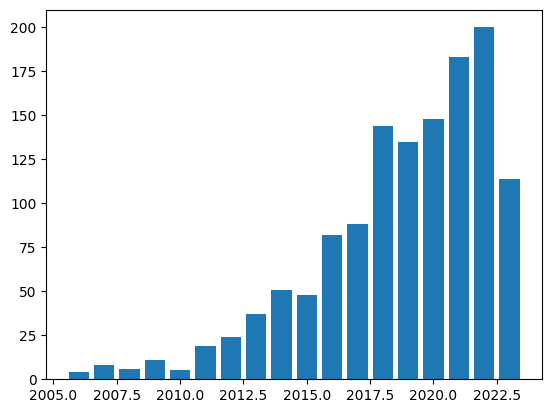

Sumit Kumar Jha
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


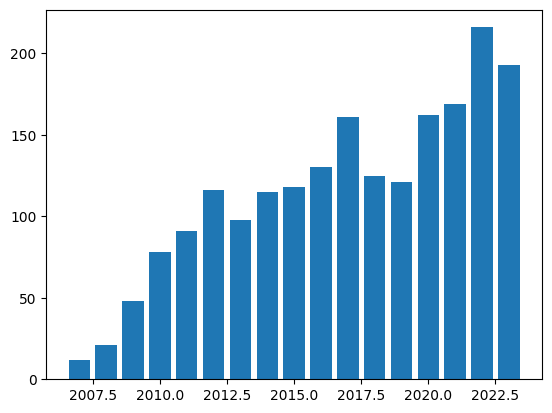

Fangde Liu
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


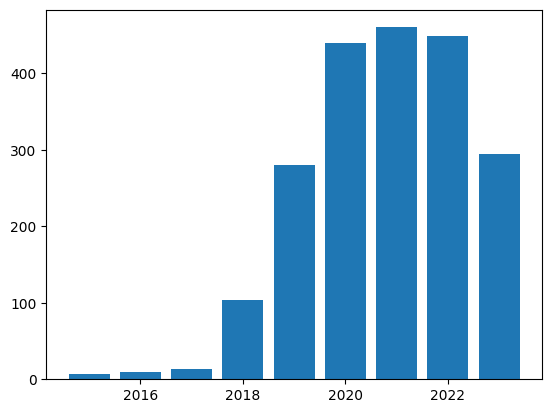

Xuchen Liu
[]


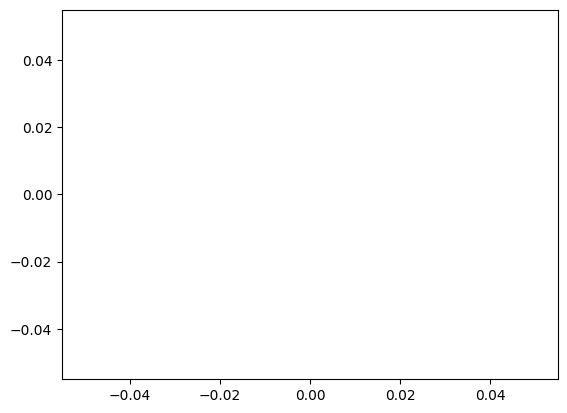

Jana Vatter
[]


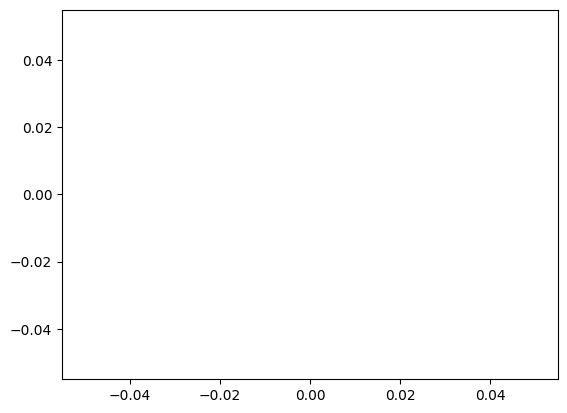

Seth Cooper
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


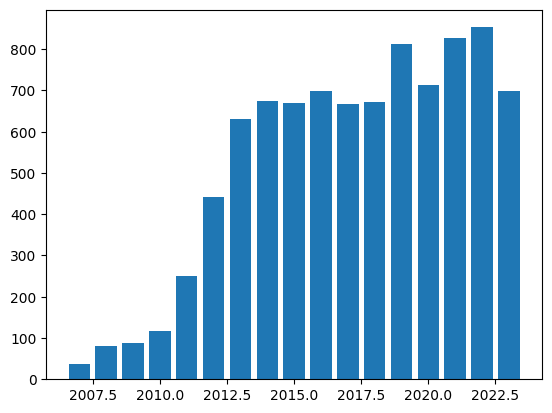

Zhangyang Gao
[2021, 2022, 2023]


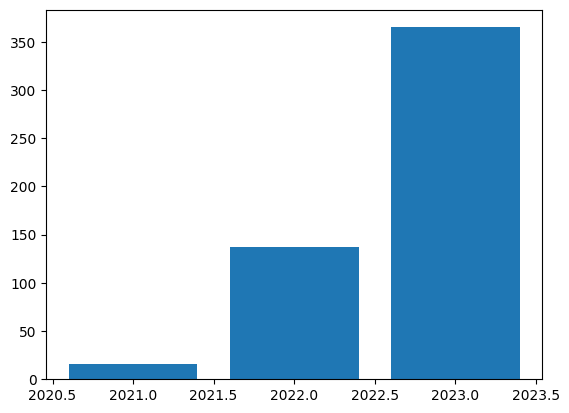

Qinfeng Shi
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


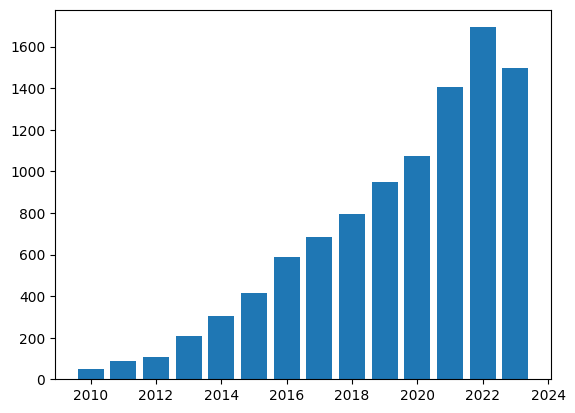

Kenneth Chiu
[1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


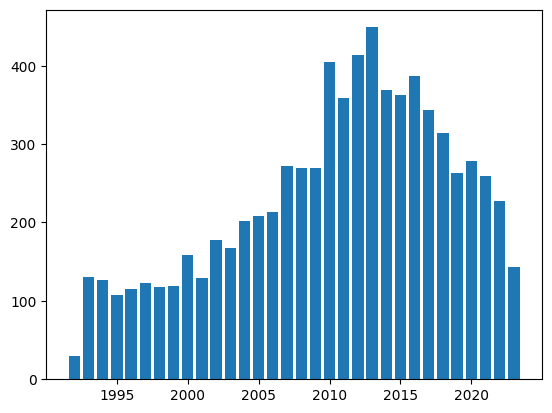

Samy Jelassi
[2018, 2019, 2020, 2021, 2022, 2023]


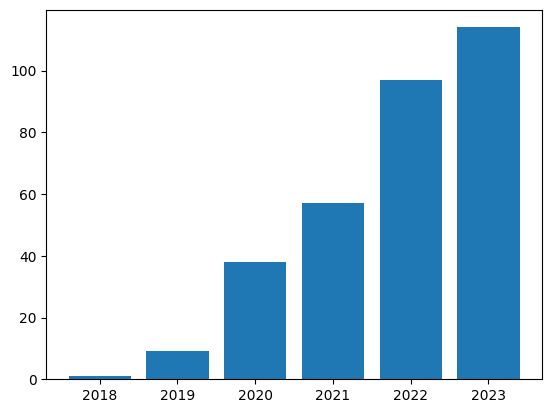

Wen Ji
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


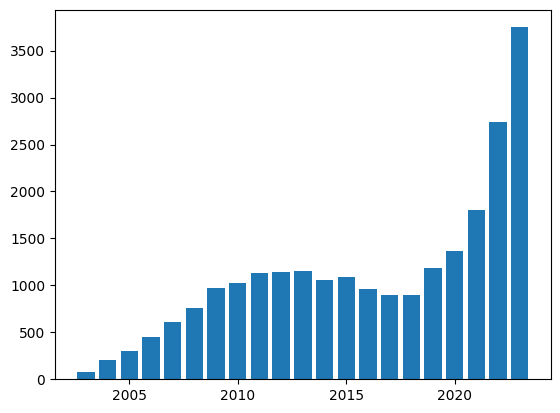

Abdul Mueed Hafiz
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


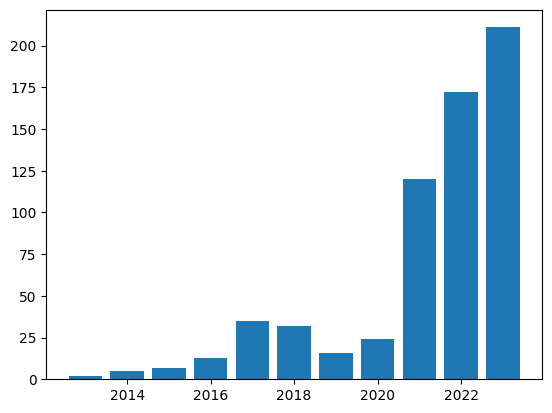

Jack O'Shaughnessy
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


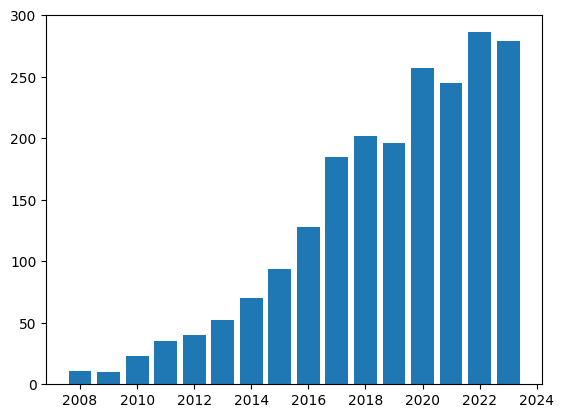

Zhike Zhang
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


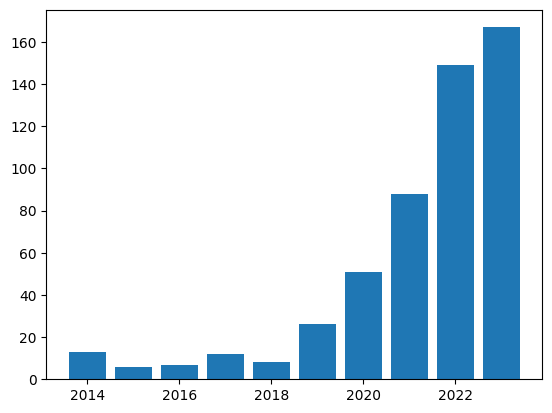

Jan Brauner
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


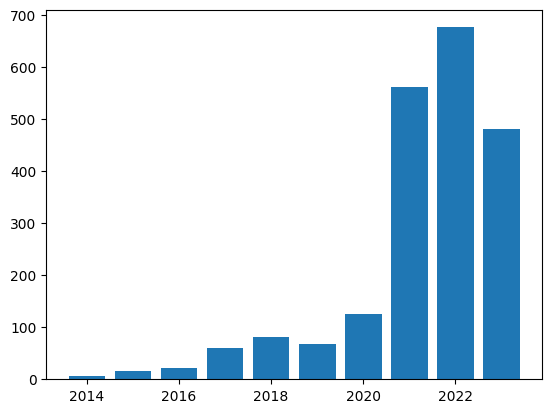

Rajesh Kumar Mundotiya
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


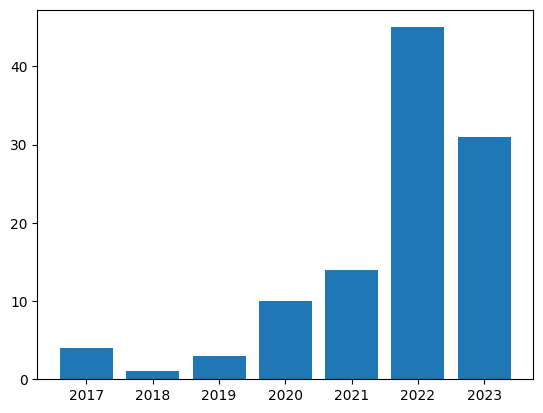

Xinyue Hao
[2019, 2020, 2021, 2022, 2023]


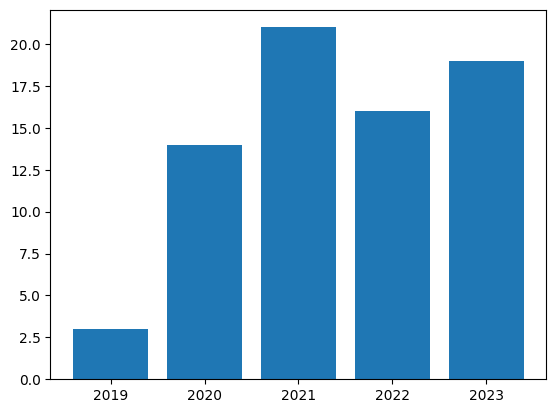

Héctor Corrales
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


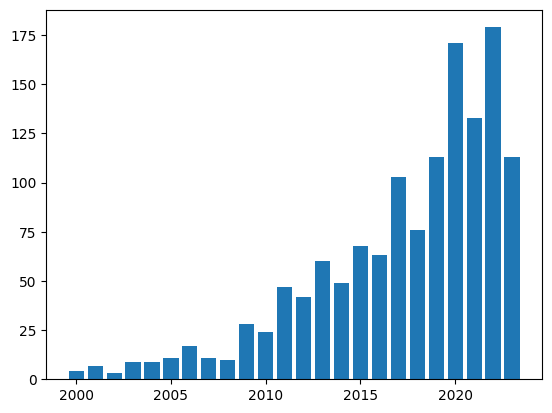

Violeta Madjarova
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


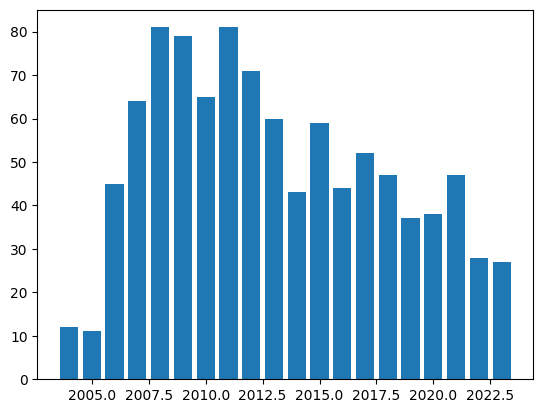

Md. Asifuzzaman Jishan
[2020, 2021, 2022, 2023]


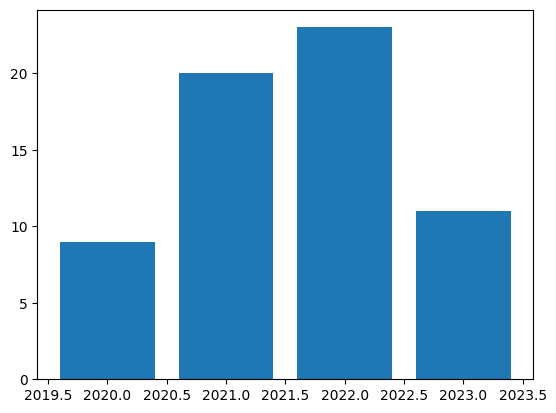

Piyumal Demotte
[2019, 2020, 2021, 2022, 2023]


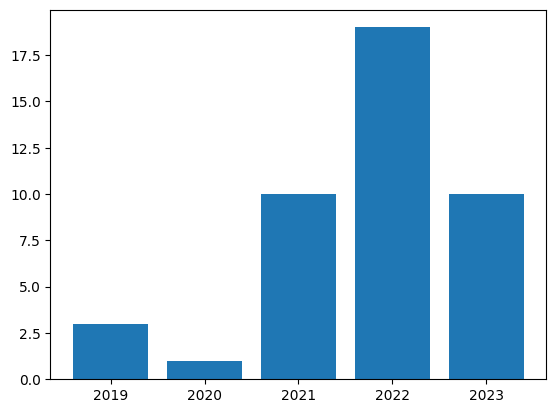

Yogi Prasetyo
[2019, 2020, 2021, 2022, 2023]


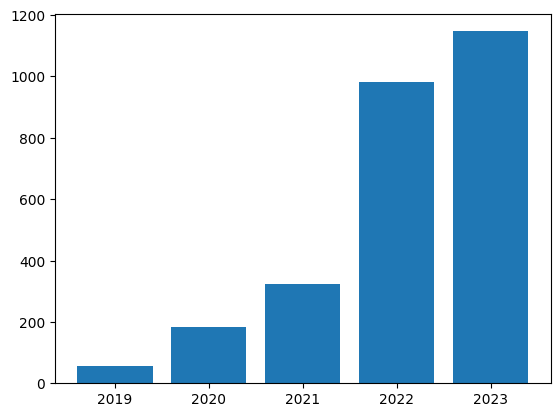

Lorenzo Jaime Yu Flores
[2021, 2022, 2023]


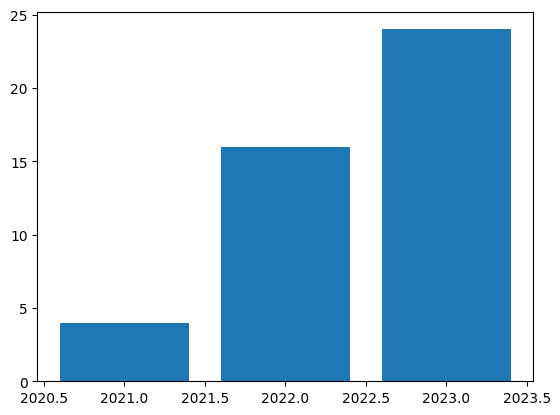

Weizhong Yan
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


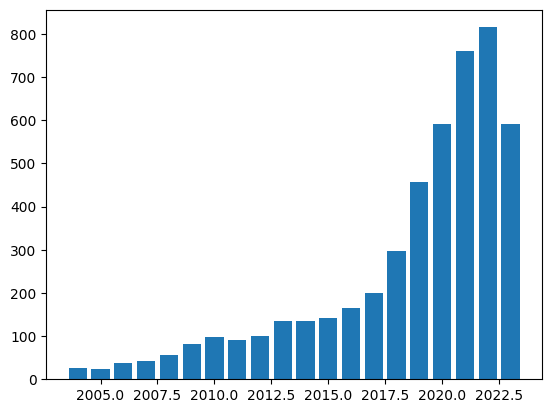

Soman KP
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


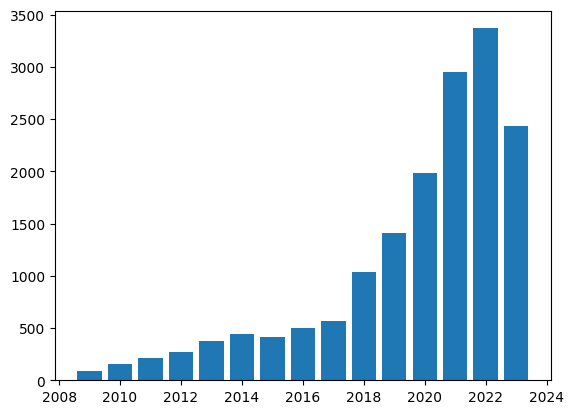

Rajat Koner
[2018, 2019, 2020, 2021, 2022, 2023]


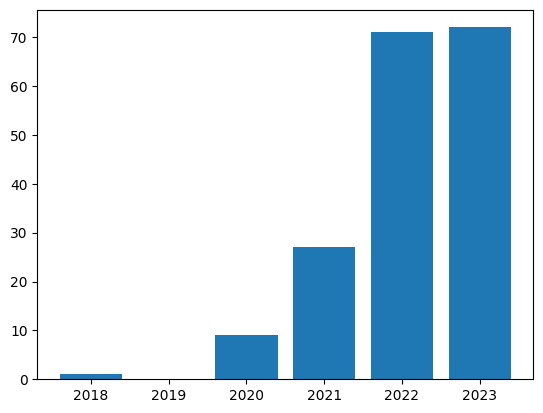

Javier Ruiz-del-Solar
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


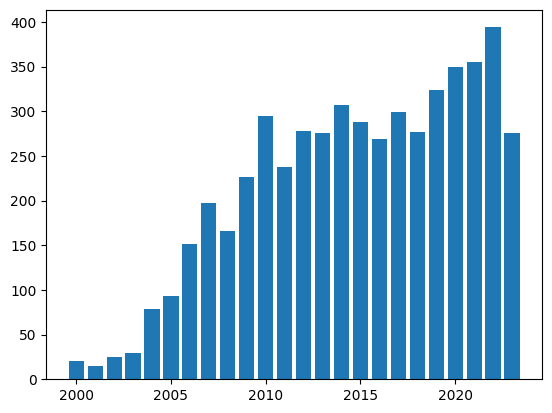

Javier Del Ser
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


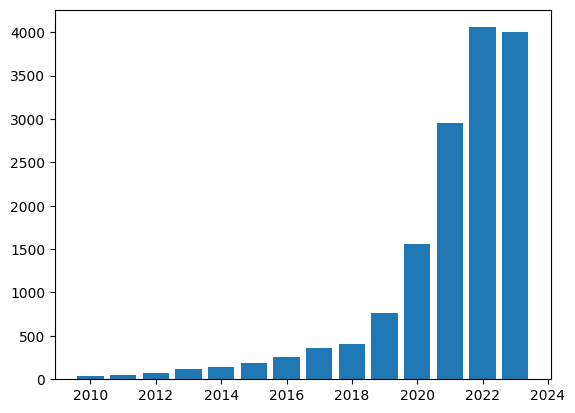

Tamer Abuhmed
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


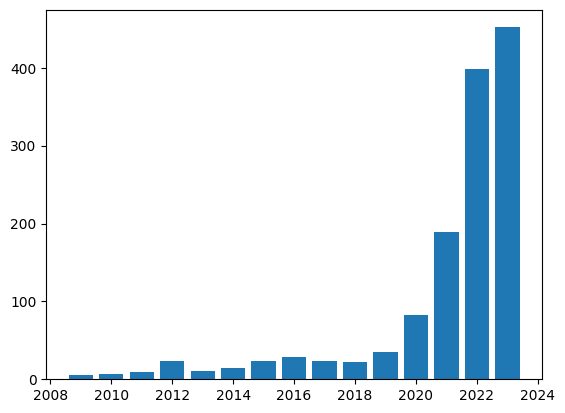

Lim Chern Hong
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


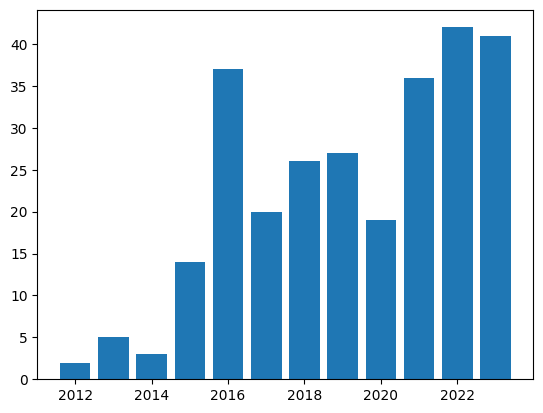

Christian Igel
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


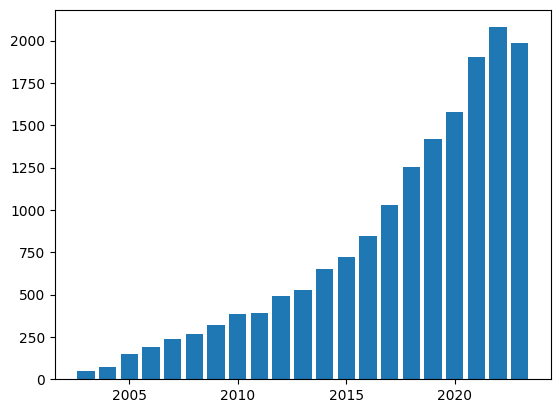

Canhui Cai
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


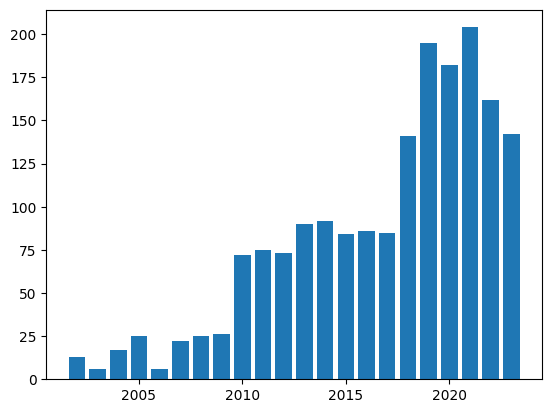

Misael Morales
[2022, 2023]


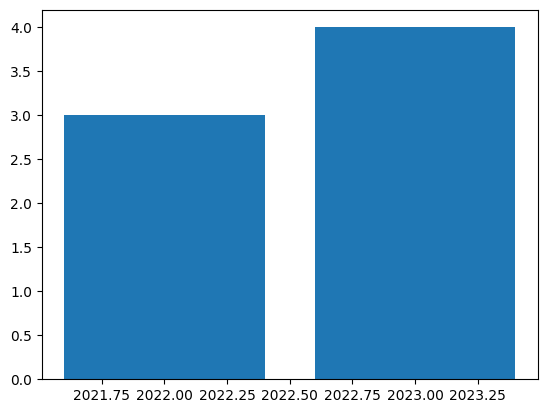

Feng Chen
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


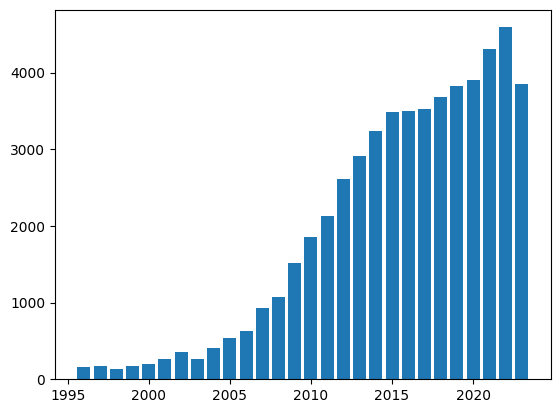

Maika Edberg
[]


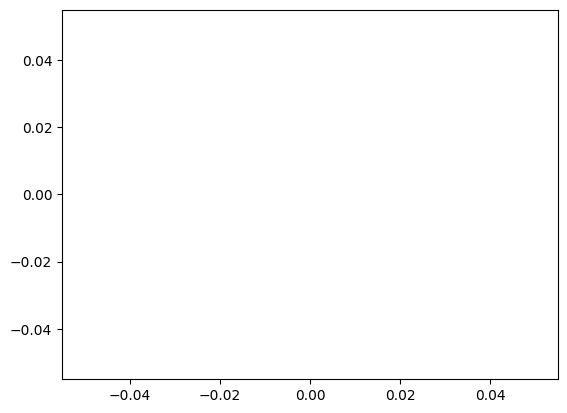

Deepan Das
[2018, 2019, 2020, 2021, 2022, 2023]


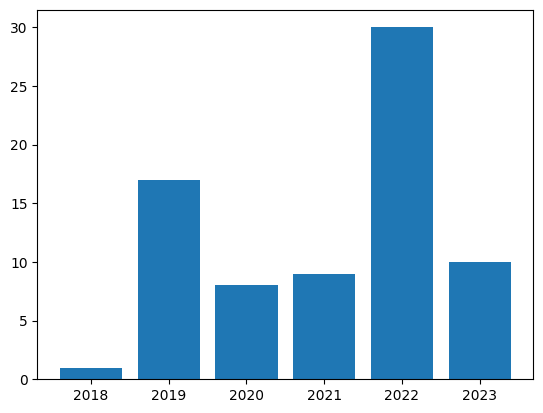

Berkan Demirel
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


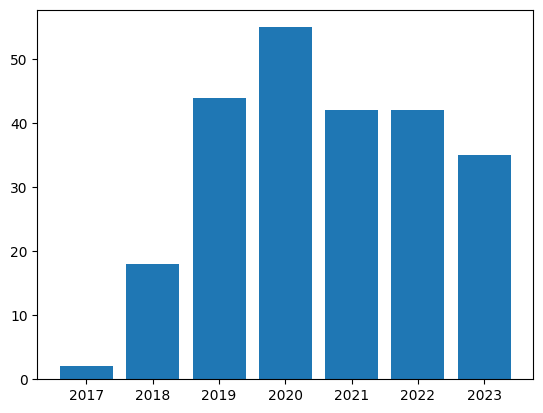

Jian Guo
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


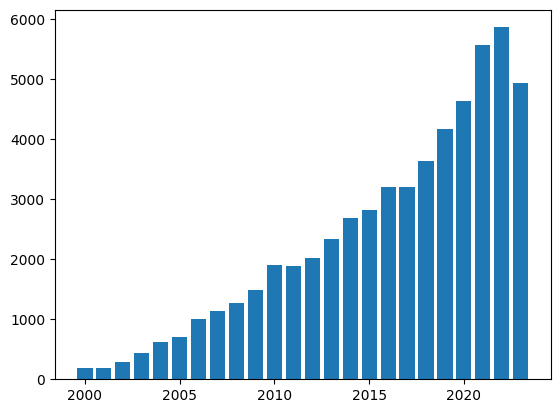

Rita Cucchiara
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


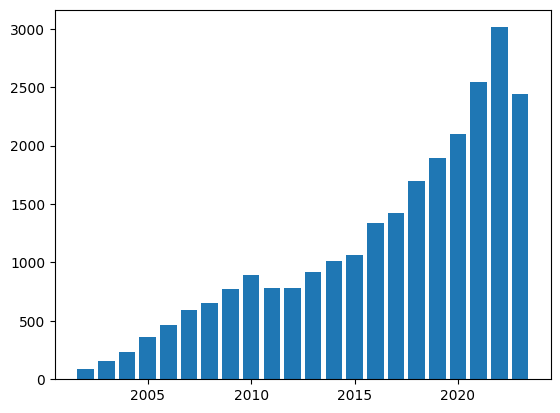

Seyran Saeedi
[2019, 2020, 2021, 2022, 2023]


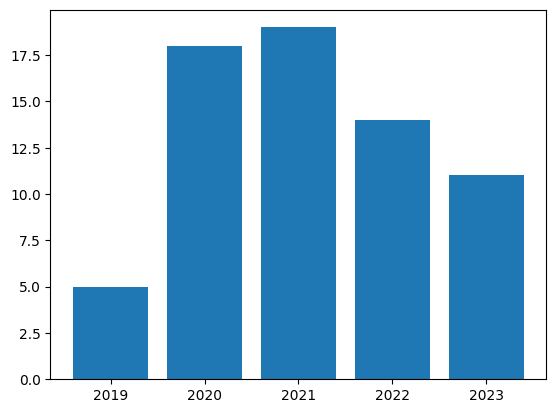

Kathryn Leonard
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


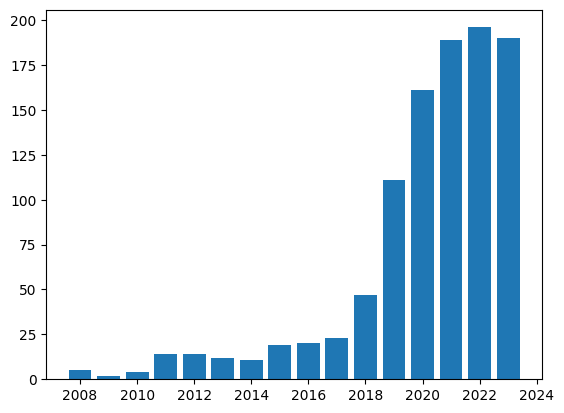

Kai Xiao
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


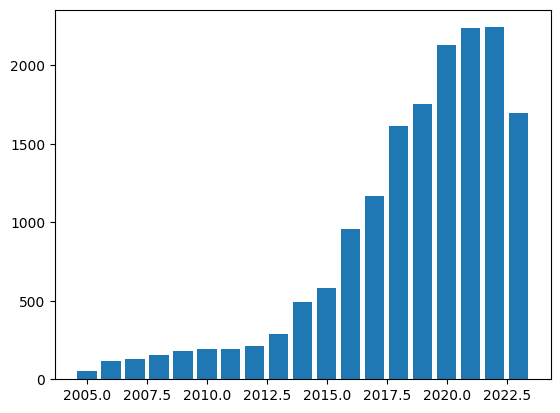

Ayush Noori
[2019, 2020, 2021, 2022, 2023]


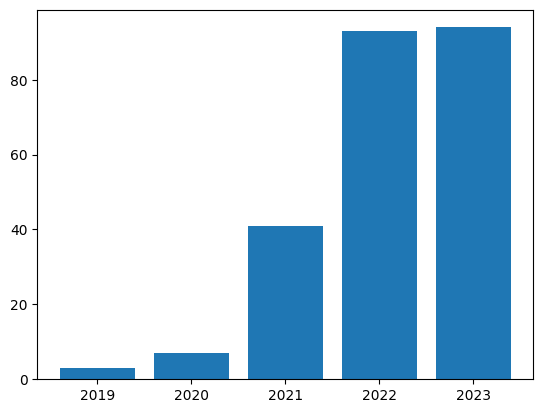

Mohammed Bennamoun
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


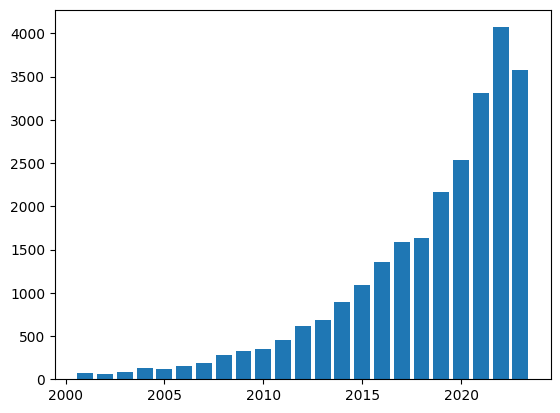

Xiaobao Wu
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


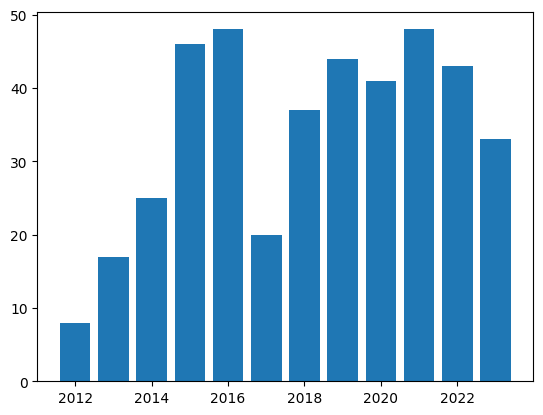

Divyanshu Aggarwal
[2021, 2022, 2023]


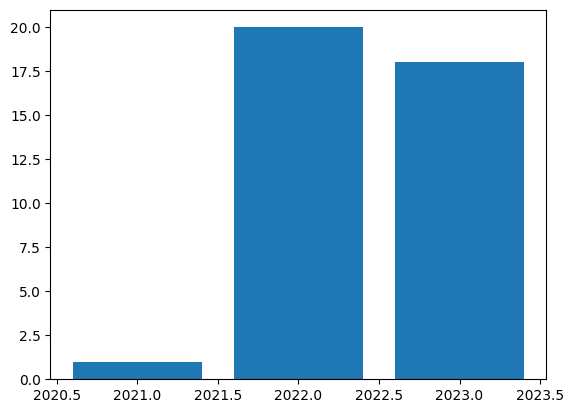

Hui Hu
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


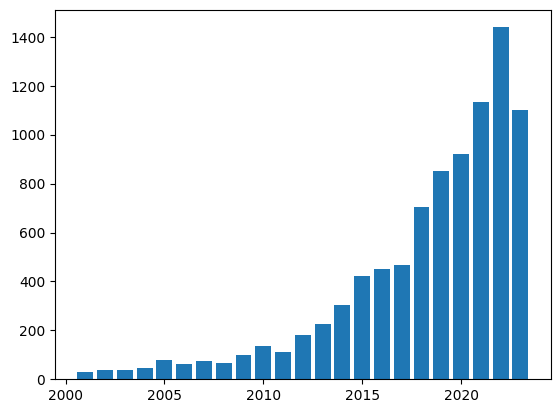

Jason Xie
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


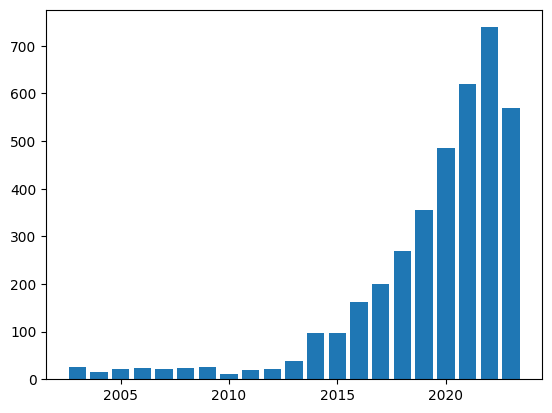

Kartik Prabhu
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


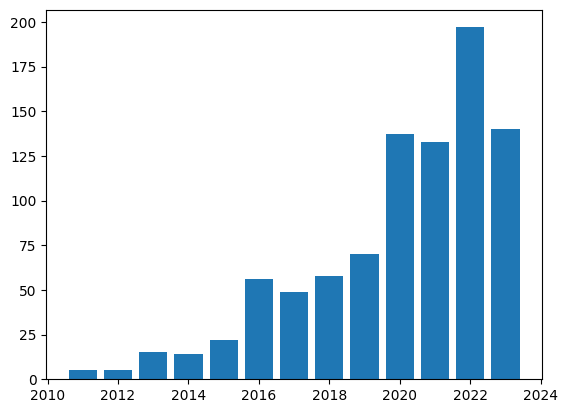

Neha Verma
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


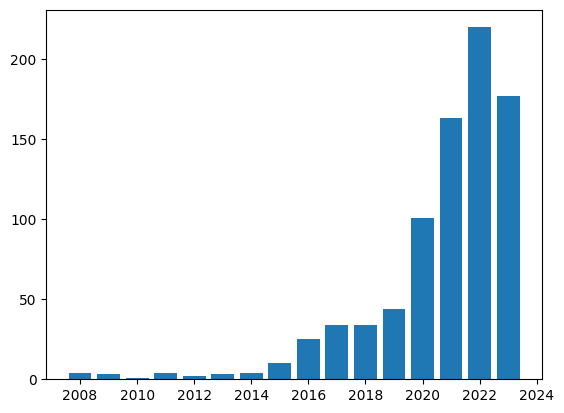

Yepang Liu
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


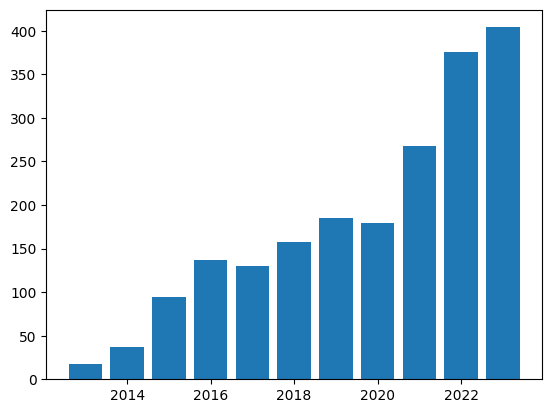

James T. Kwok
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


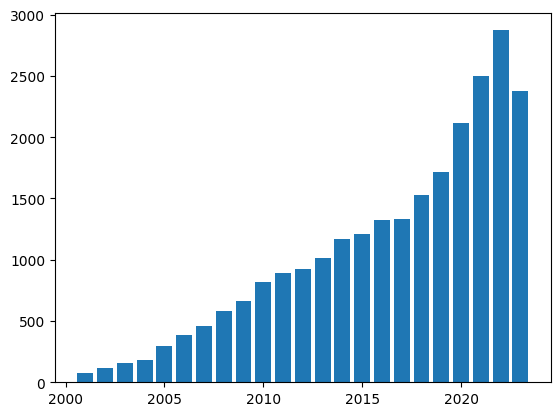

Alok Singh
[1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


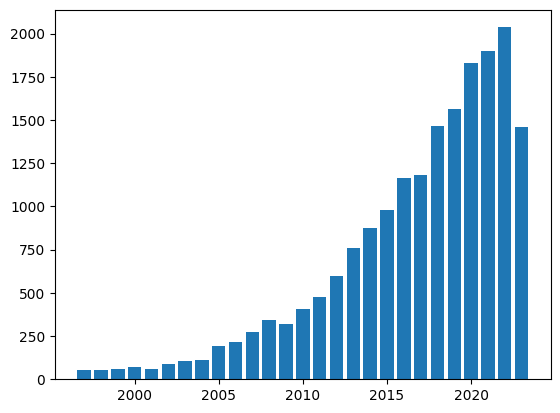

Maayan Zhitomirsky-Geffet
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


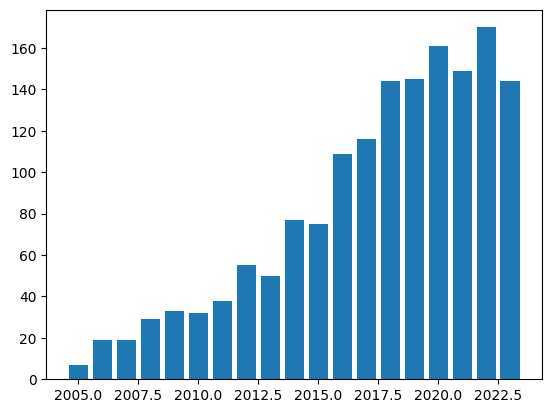

Mahsa Salehi
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


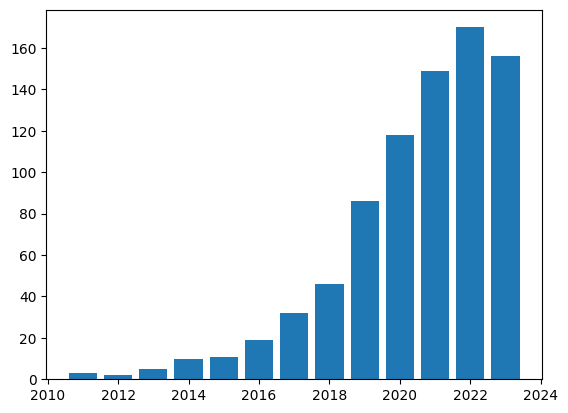

Xingxing Wang
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


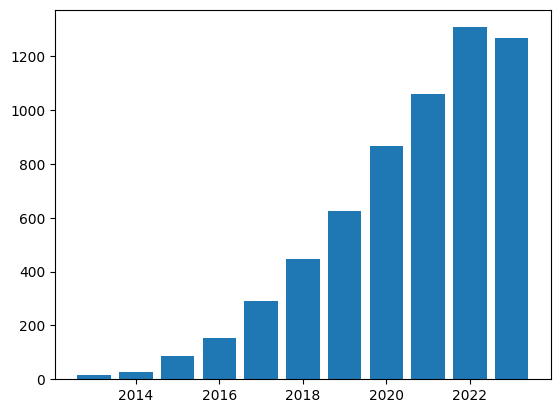

Adarsh Prasad
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


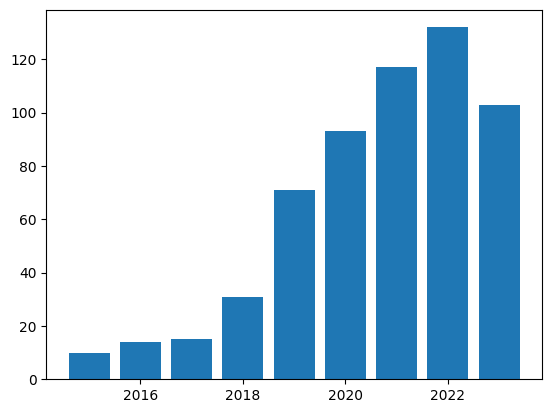

Erlend Aune
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


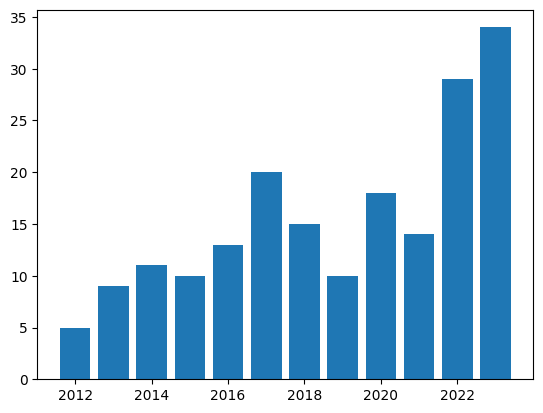

Dung Truong
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


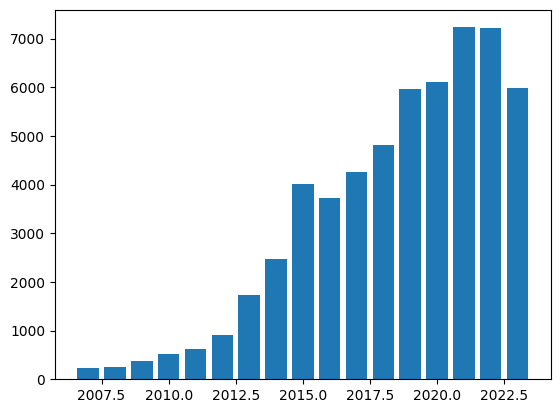

Shadi Basurra
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


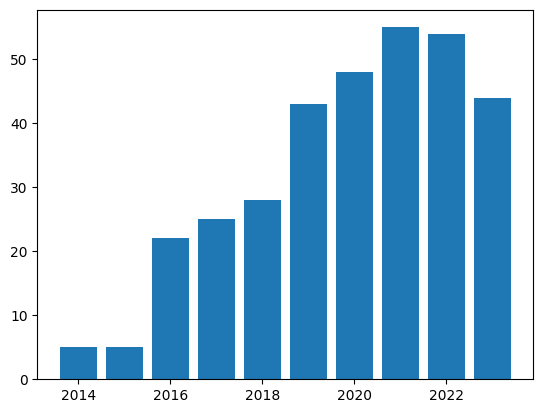

Jianyong Wang
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


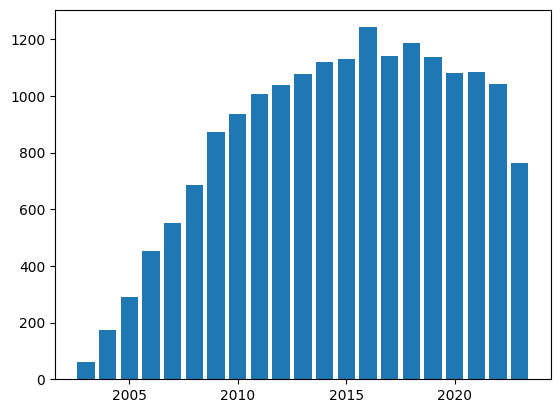

Thomas Li
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


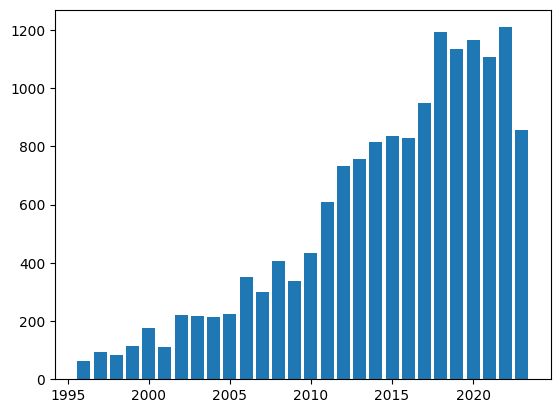

Devis Tuia
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


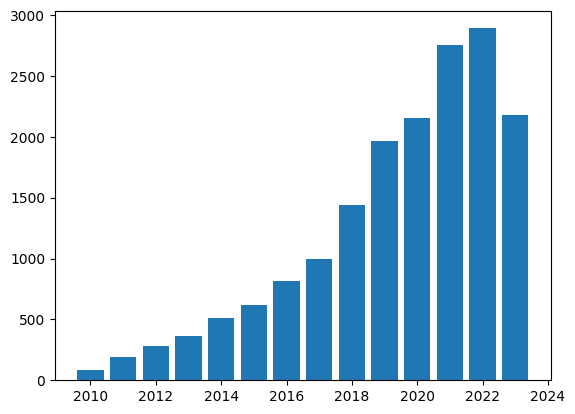

Jennifer D'Souza
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


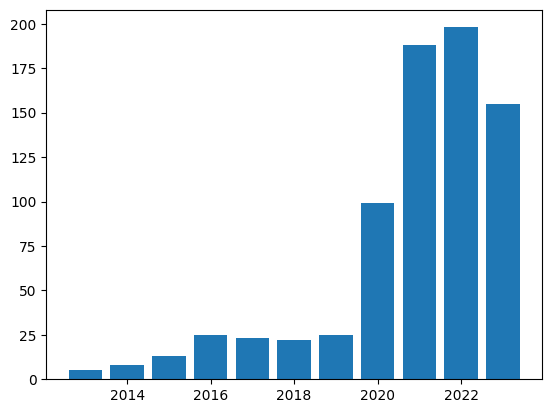

Jeremias Sulam
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


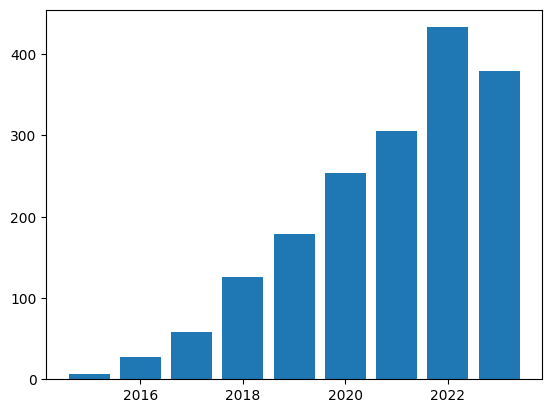

Jakob Verbeek
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


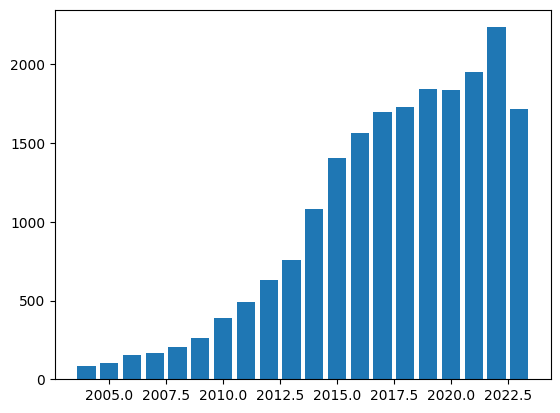

Rui Li
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


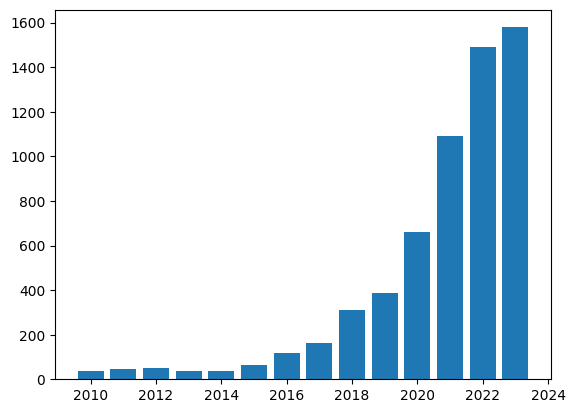

Lu Zhang
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


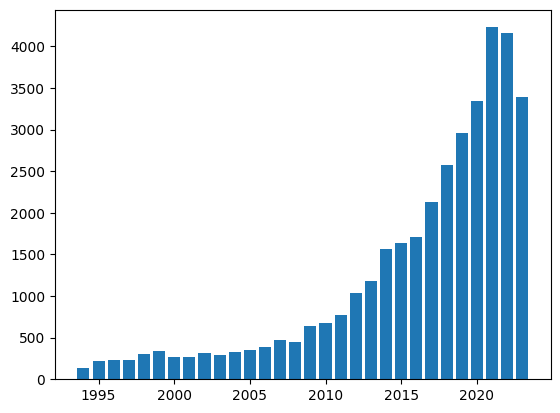

Haoran Zhang
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


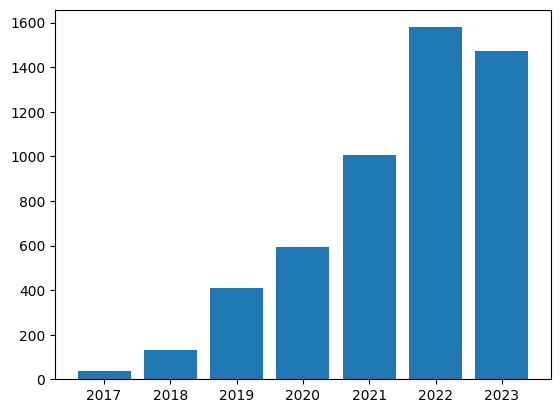

Vincent Ying
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


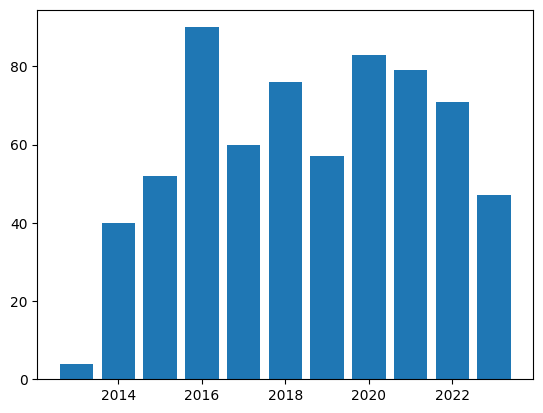

Abhinav Goel
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


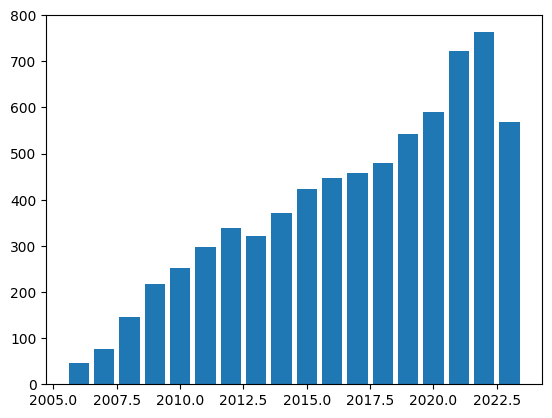

Loris Bazzani
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


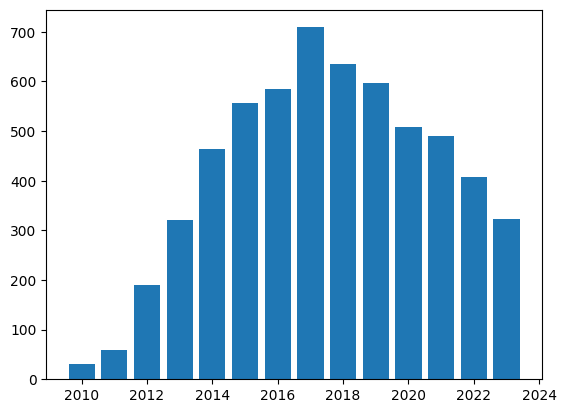

Arash Amini
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


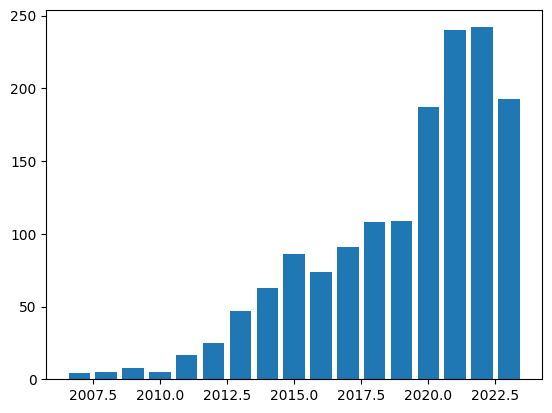

Man Luo
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


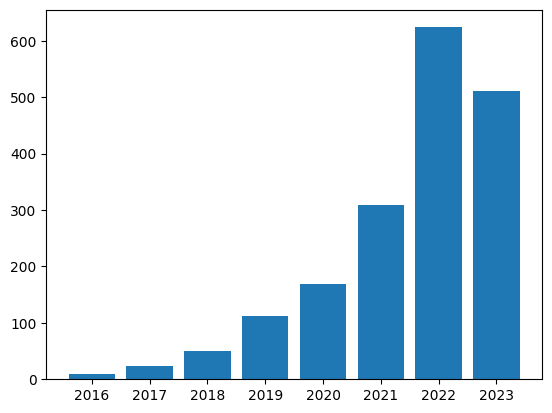

Amandeep Kumar
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


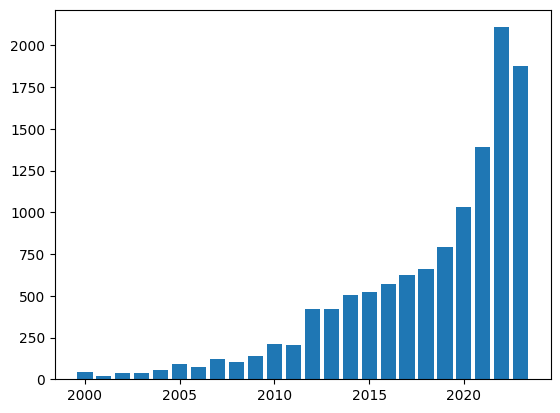

Xingyu Li
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


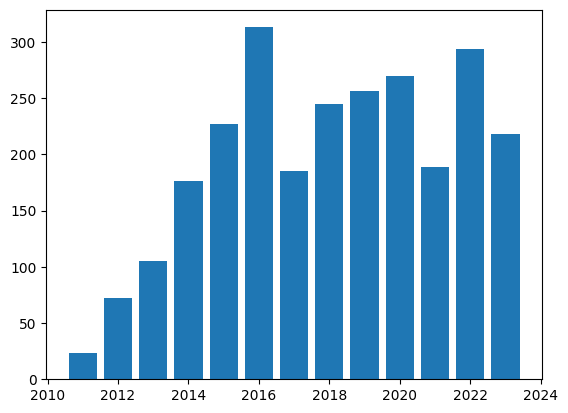

Michael T Lu
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


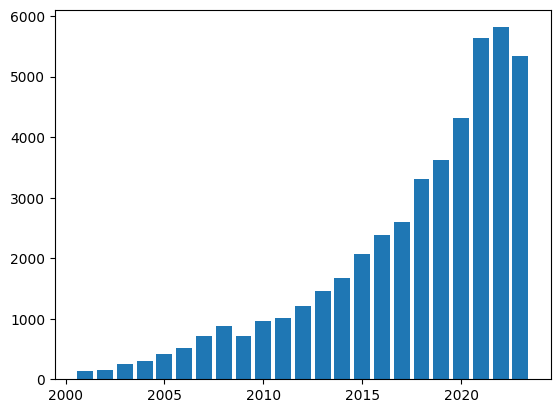

Bichen Wu
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


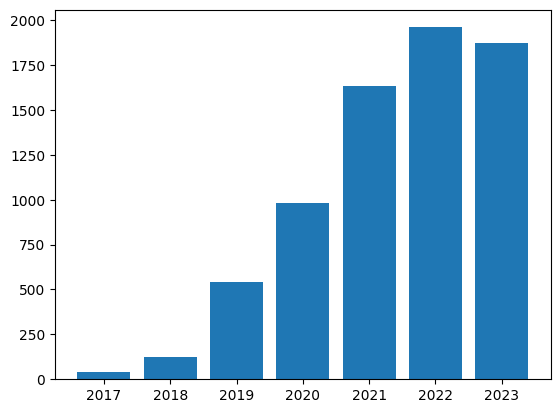

Dragomir Radev
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


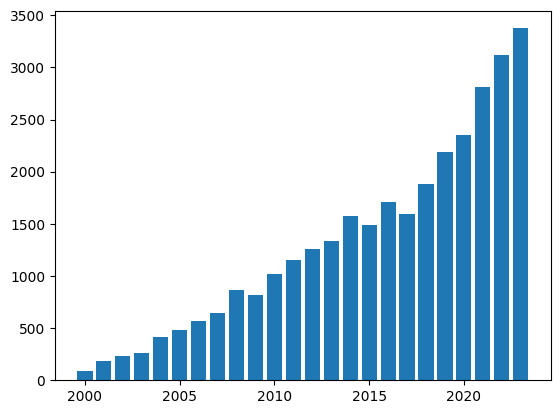

Jiho Jang
[2018, 2019, 2020, 2021, 2022, 2023]


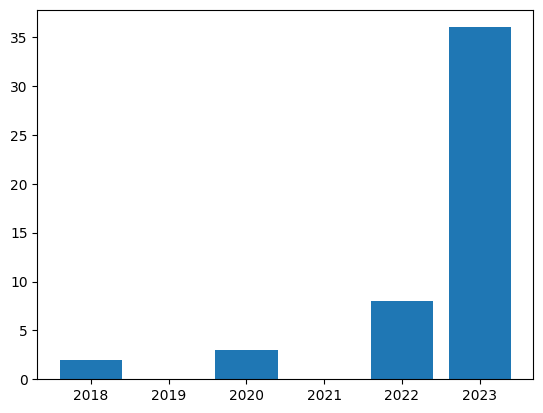

Mingli Song
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


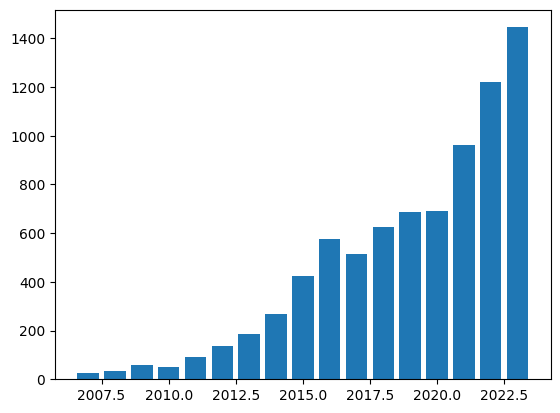

Jiasen Lu
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


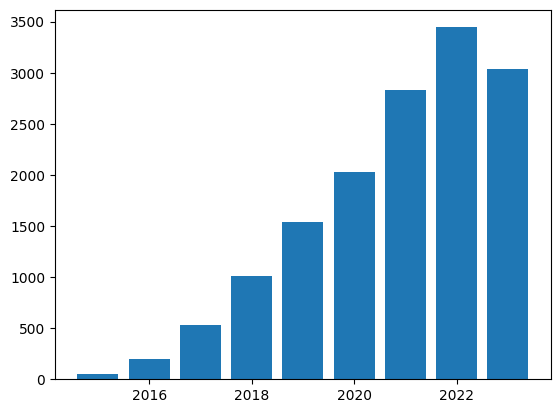

Michael Zelinski
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


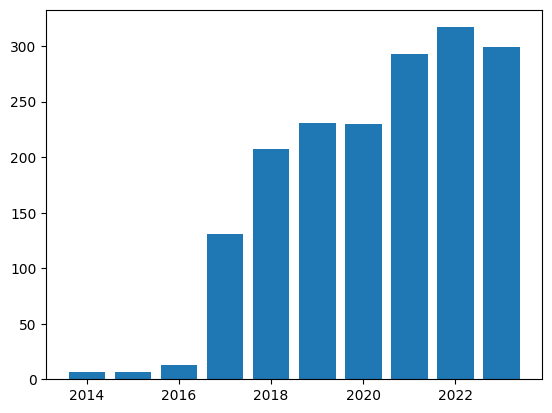

Jianlin Su
[2019, 2020, 2021, 2022, 2023]


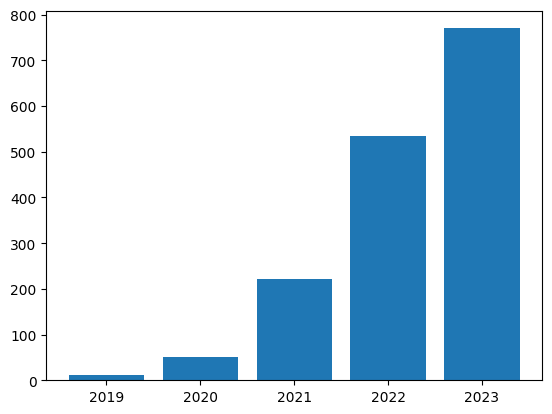

Chao Liu
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


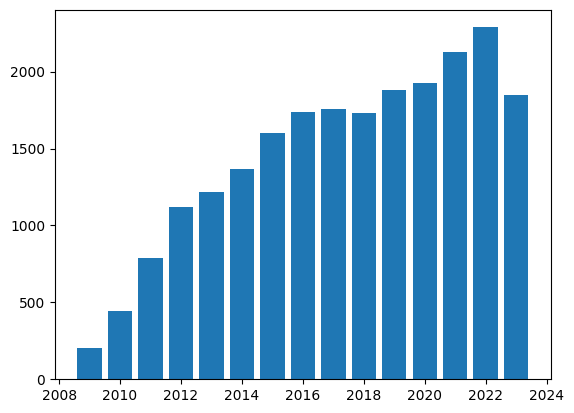

Henghui Ding
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


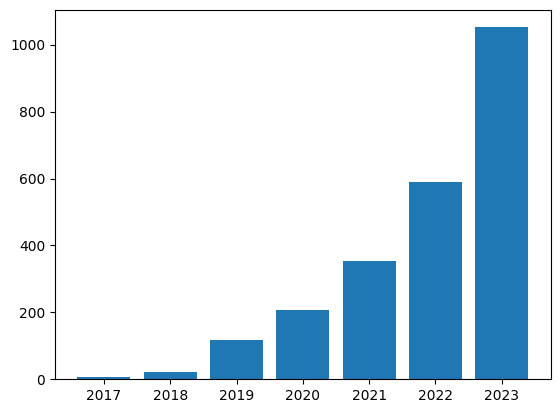

Dara Bahri
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


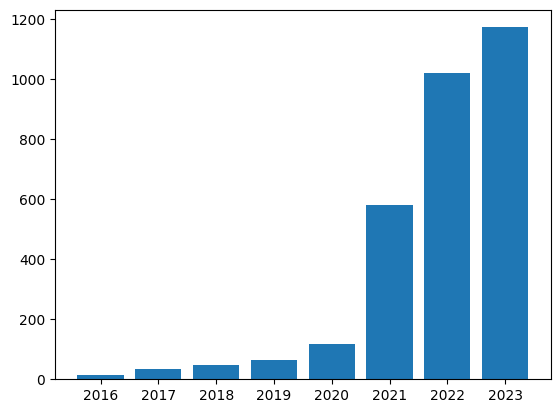

Qingbo Wu
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


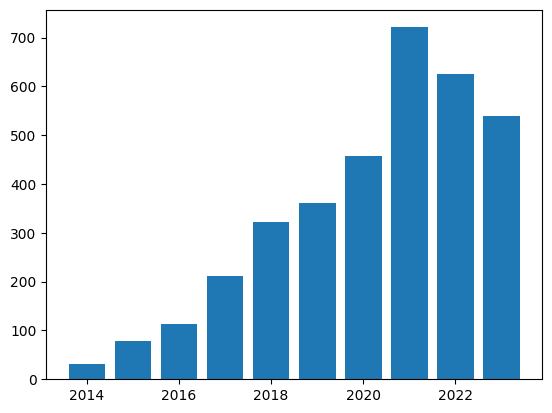

Christopher Kanan
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


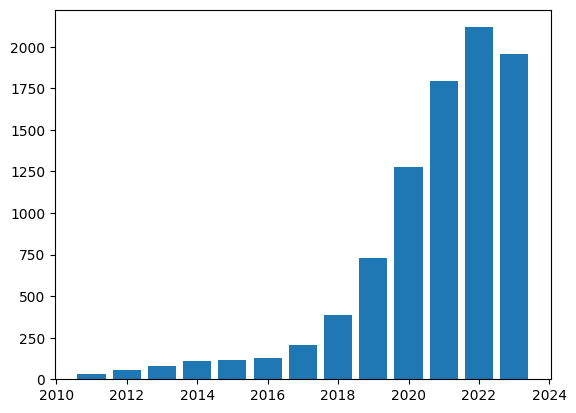

Christian Rathgeb
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


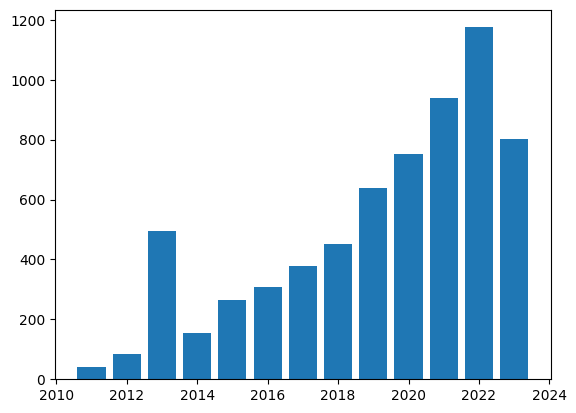

Mohamed El-Geish
[2019, 2020, 2021, 2022, 2023]


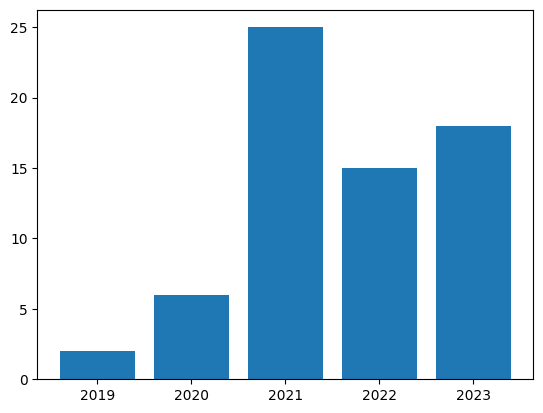

R. Andrew Taylor
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


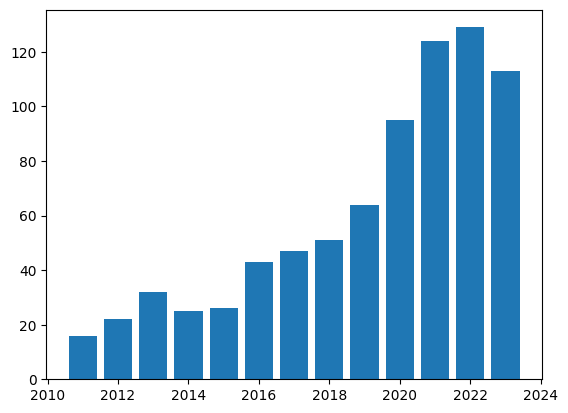

Yannis Panagakis
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


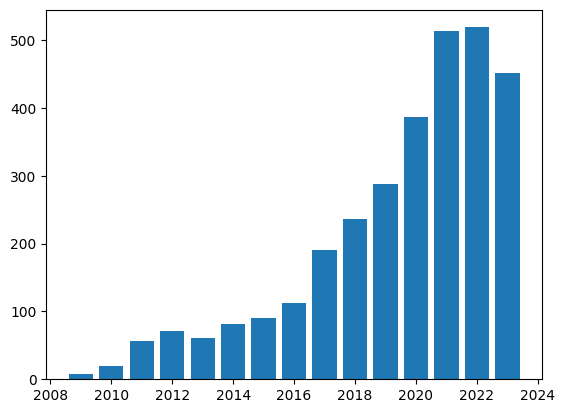

Devesh K. Jha
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


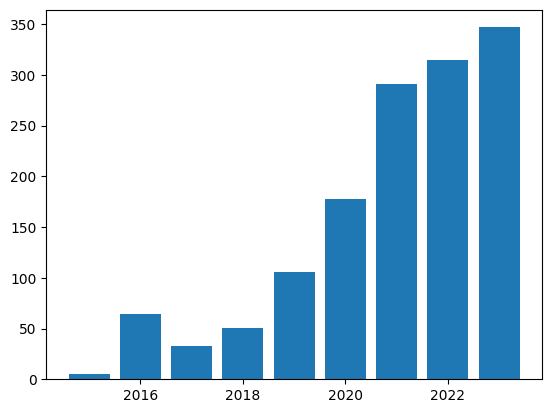

Dawei Yin
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


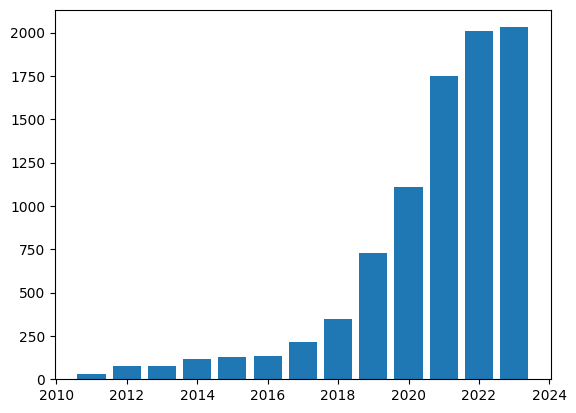

Kyle Hamilton
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


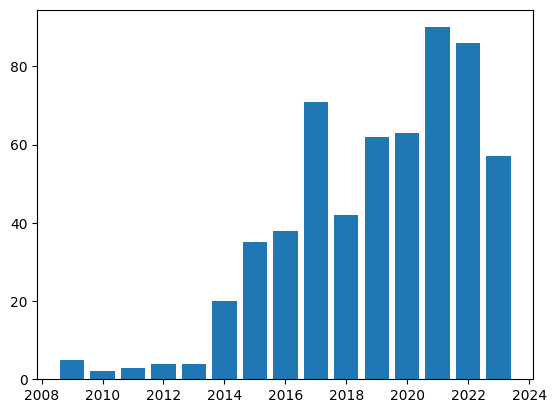

Wei Zhao
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


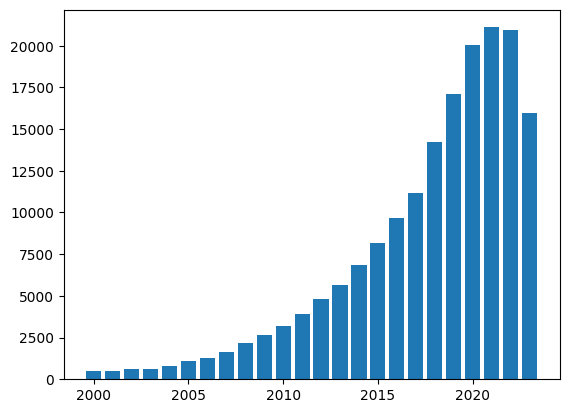

Florian Matthes
[1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


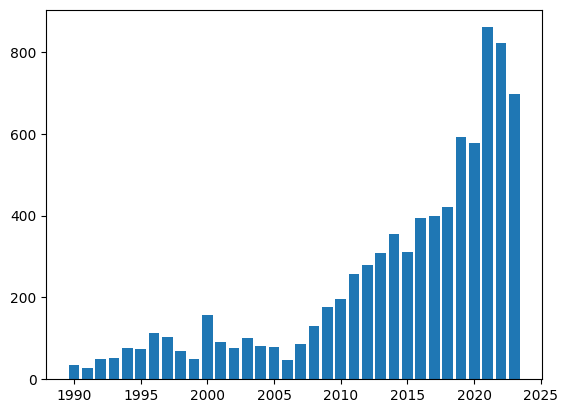

Lin Meng
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


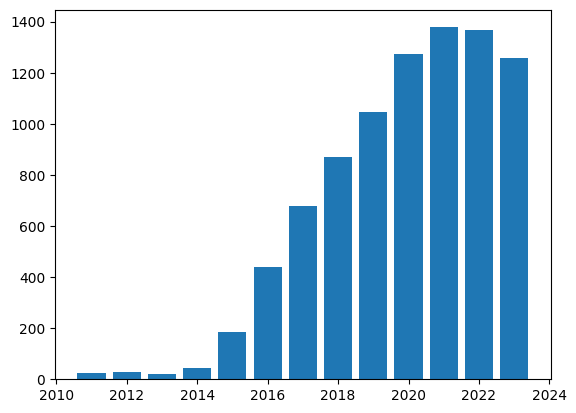

Xiaobo Sharon Hu
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


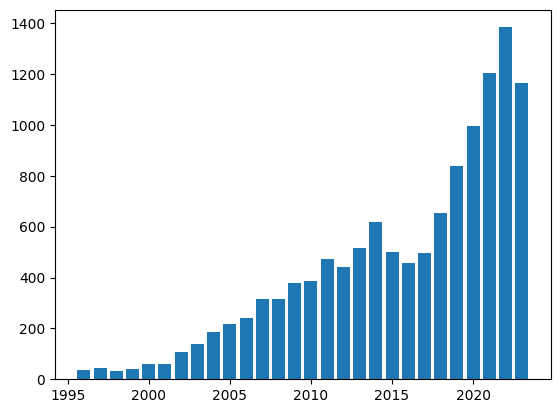

Philippe Tarroux
[1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


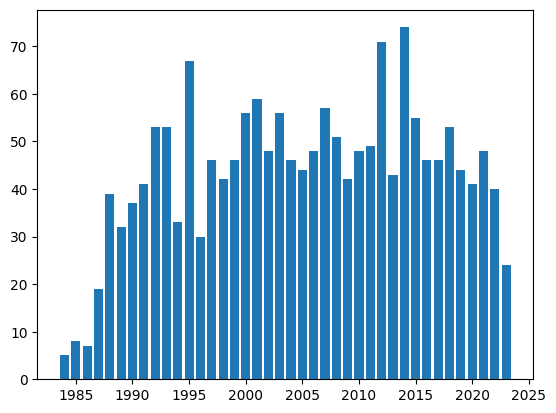

Minghao Liu
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


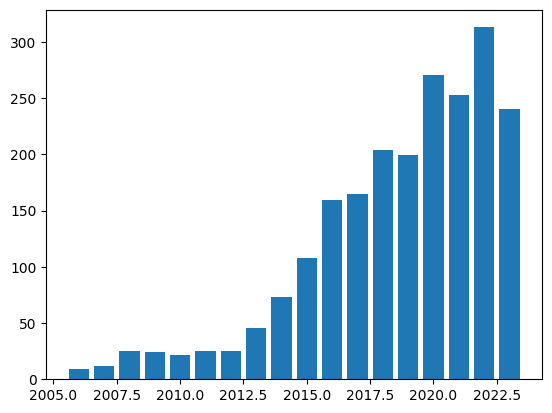

Chang-Tien Lu
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


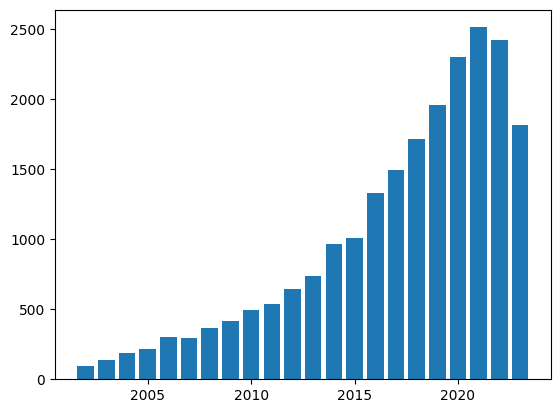

Chao Dong
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


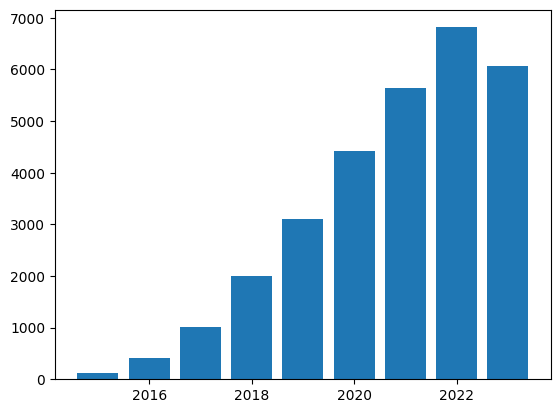

Honglei Liu
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


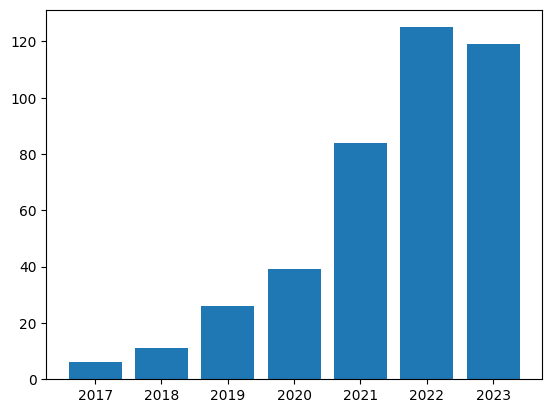

Bo Chang
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


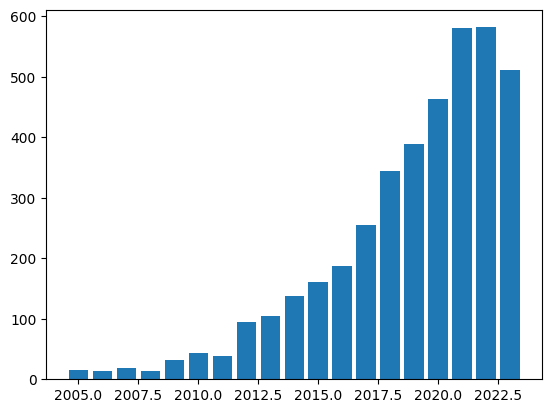

Hao Peng
[2018, 2019, 2020, 2021, 2022, 2023]


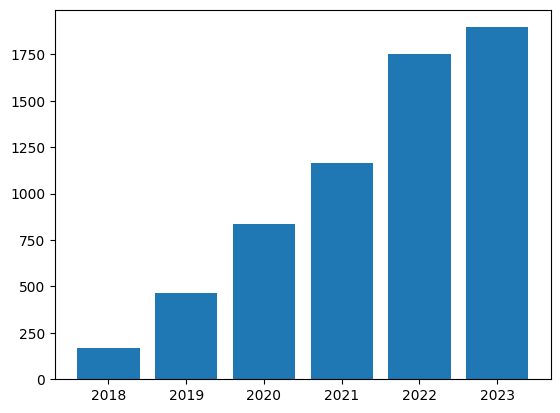

Sanjay K. Sahay
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


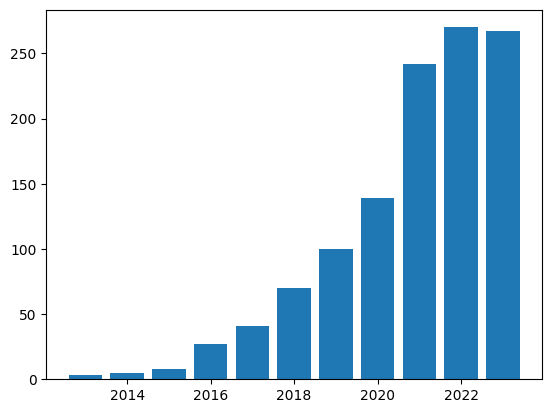

Safa Alsaidi
[2021, 2022, 2023]


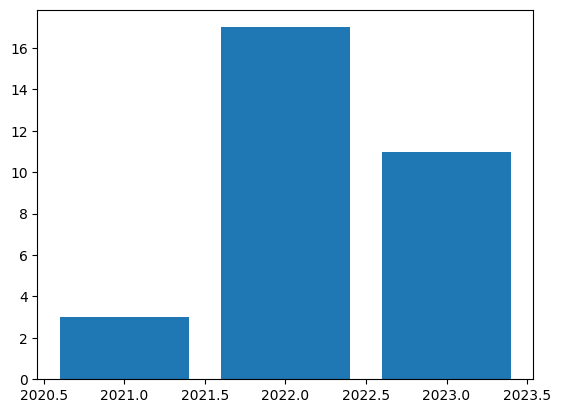

Zejiang Shen
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


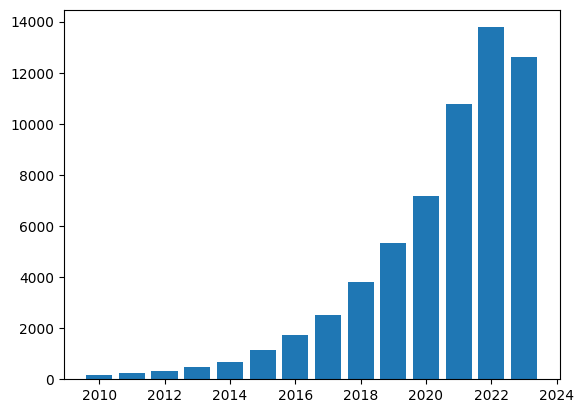

Yun Wang
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


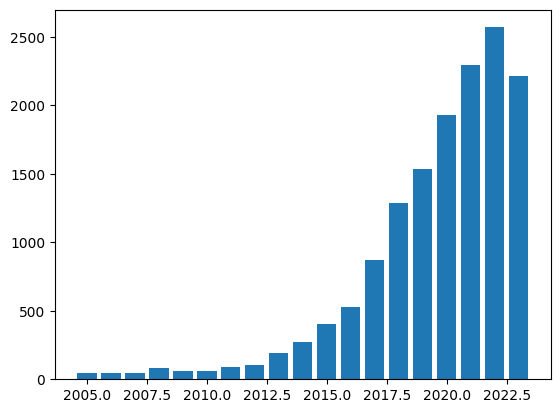

Michael Carbin
[2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


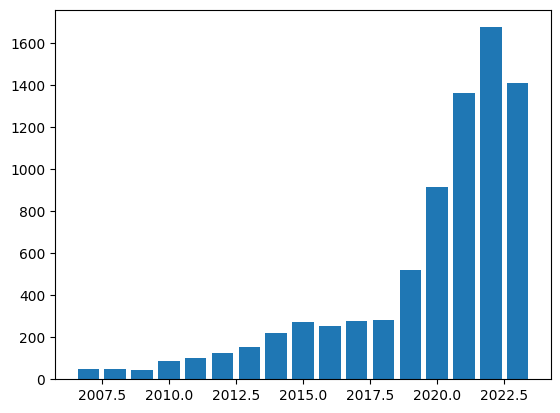

Saurabh Amin
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


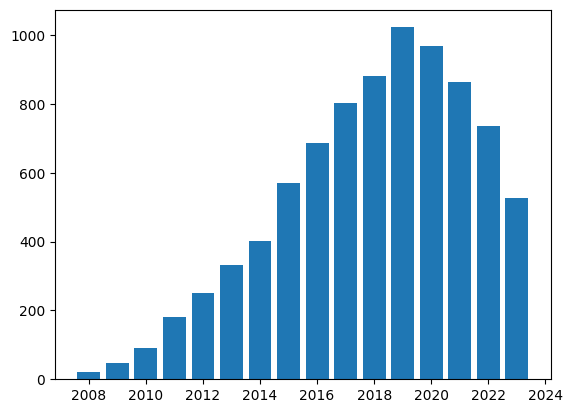

Guanglei Yang
[2020, 2021, 2022, 2023]


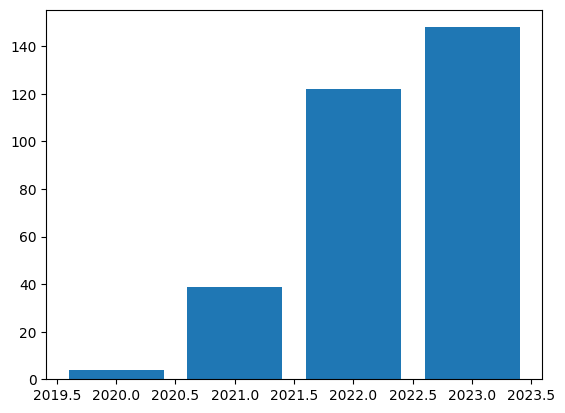

Ahmed Elnaggar
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


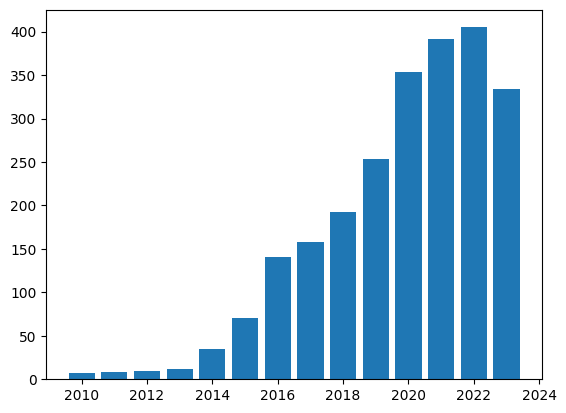

Jeff Dean
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


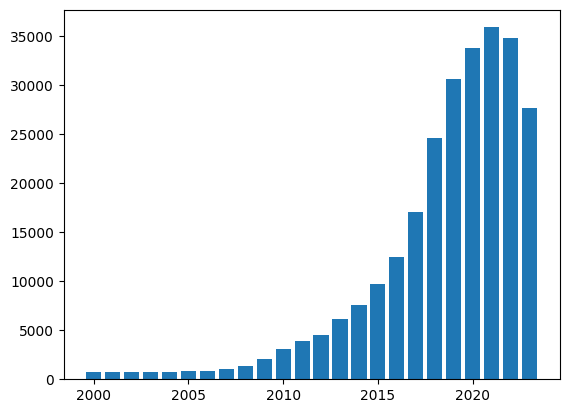

Franco Ronchetti
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


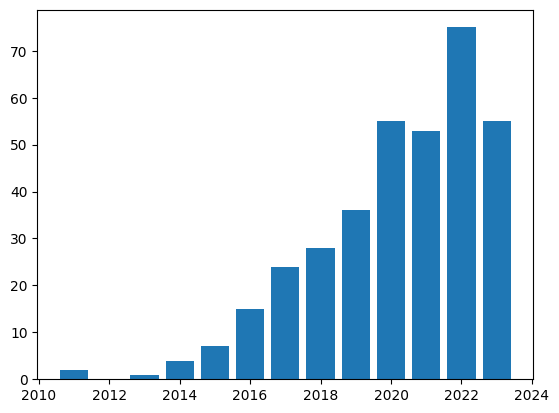

Narayanan PP
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


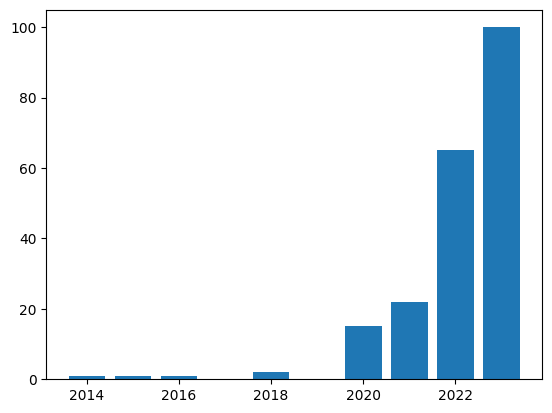

Xinru Zhang
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


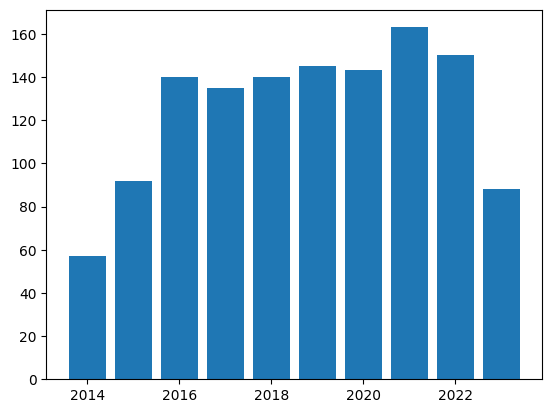

Swathikiran Sudhakaran
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


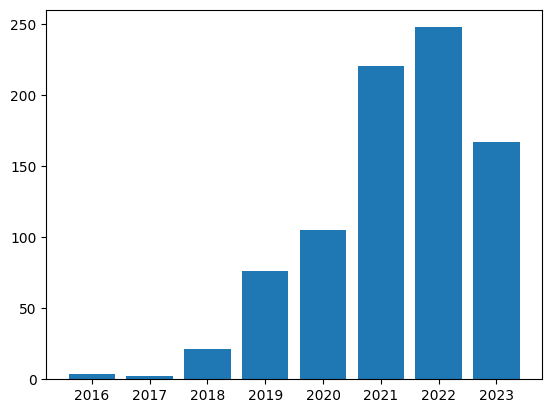

Alexandra I. Cristea
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


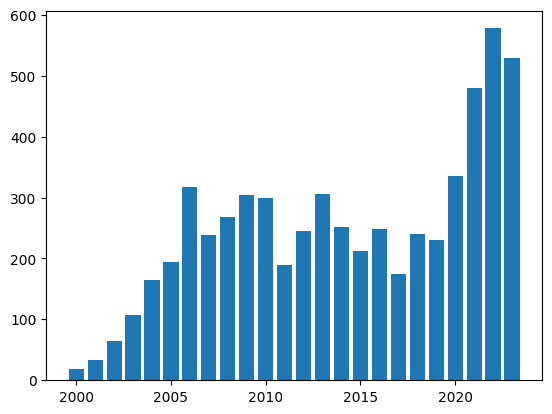

Fanhua Shang
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


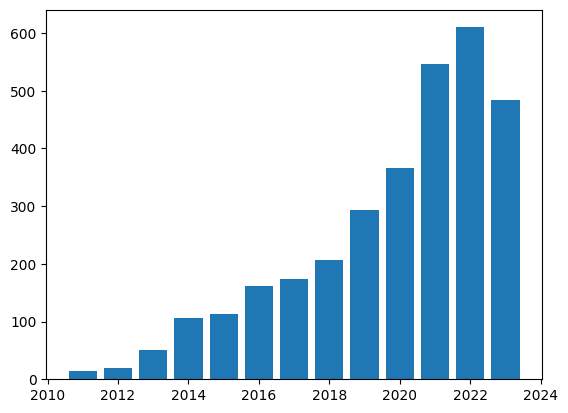

Siyuan Ma
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


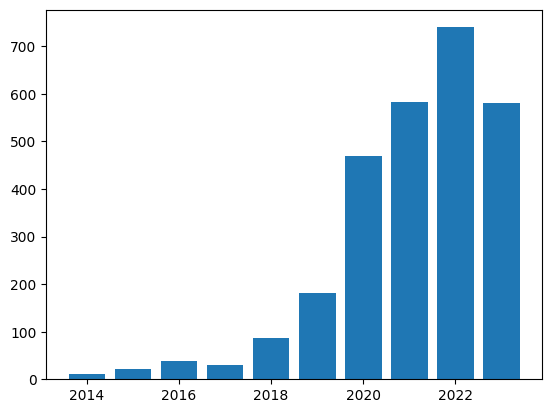

Bao Xin Chen
[2018, 2019, 2020, 2021, 2022, 2023]


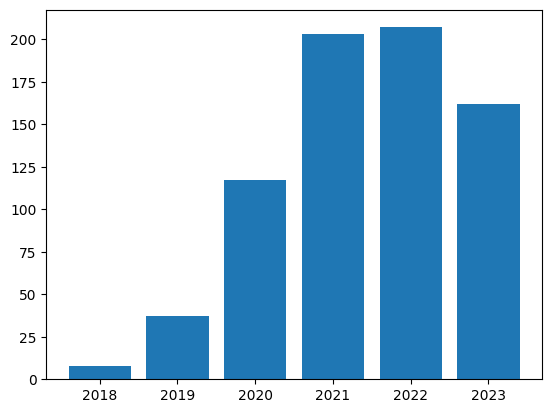

Haomin Zhou
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


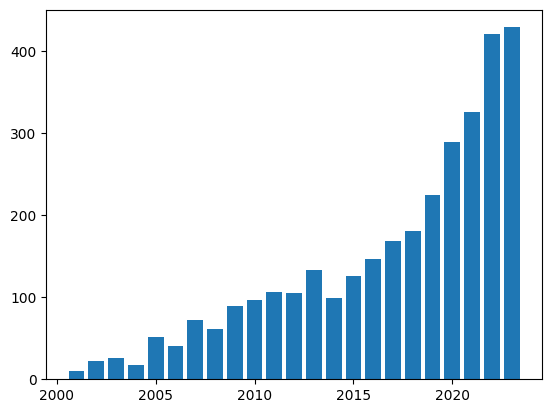

Tao Wan
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


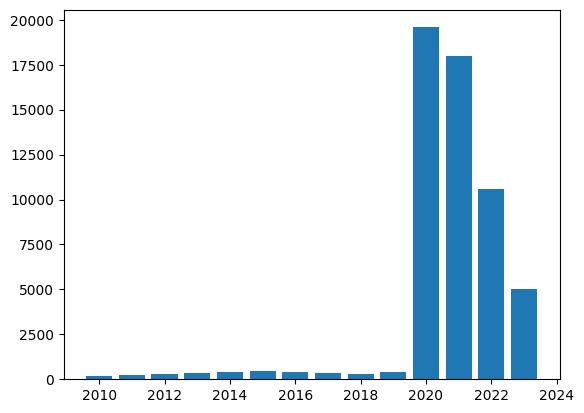

Frederic Alexandre
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


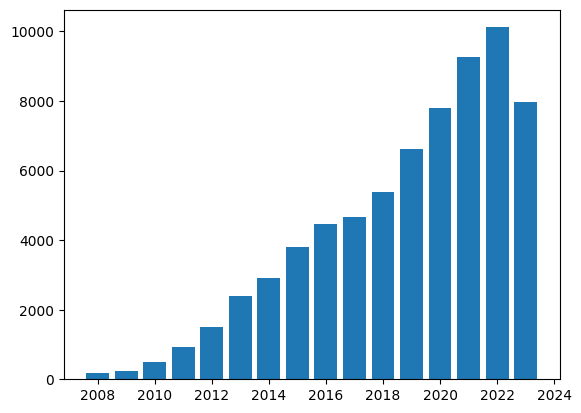

Alexandre Saidi
[]


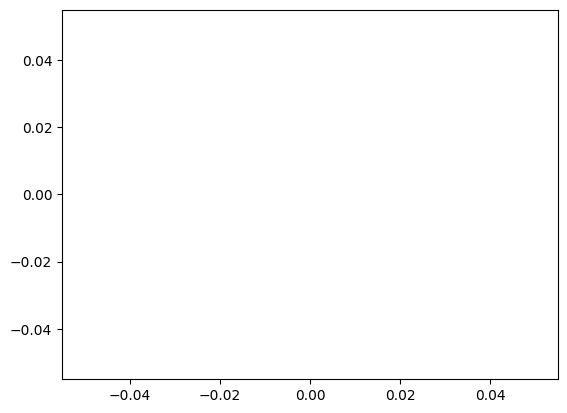

Edison Marrese-Taylor
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


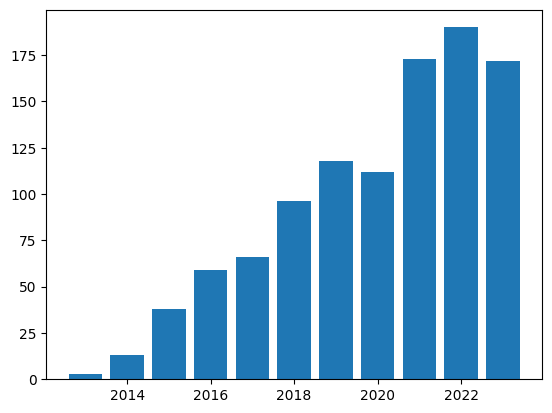

Sergio A. Velastin
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


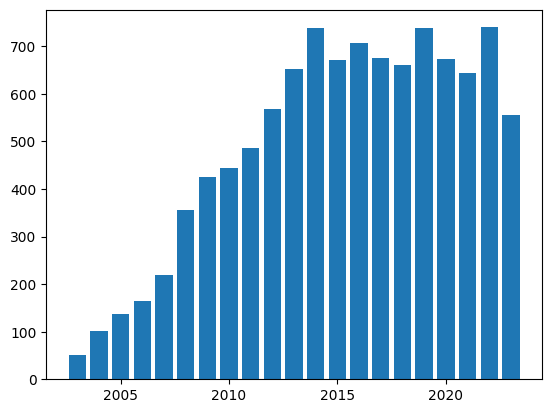

Guanxiong Liu
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


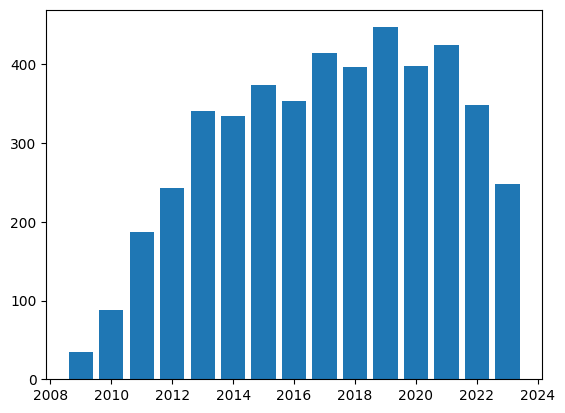

Chun Fan
[1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


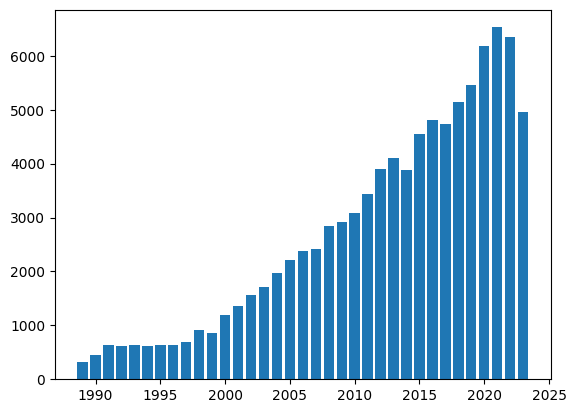

Hao Xu
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


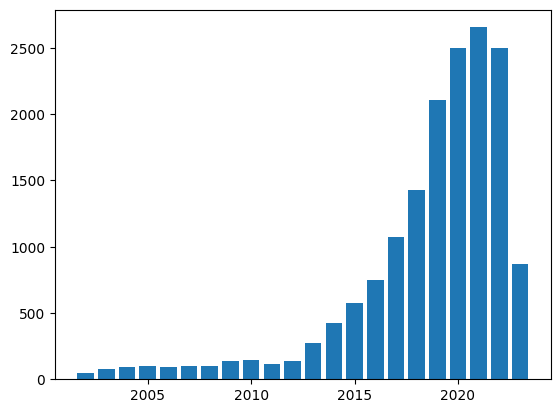

Zaharaddeen Karami Lawal
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


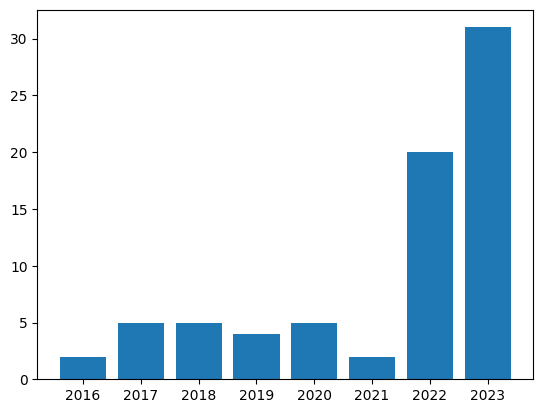

Jan Philip Wahle
[2021, 2022, 2023]


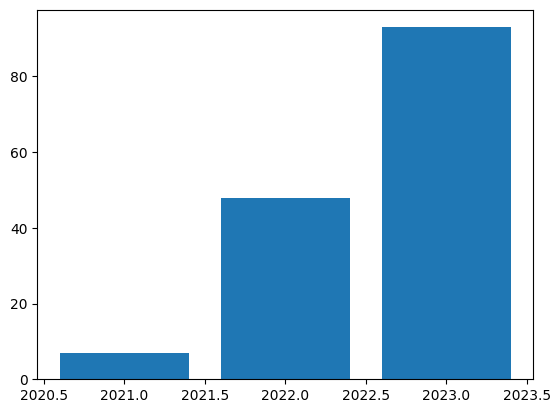

Ce Zhang
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


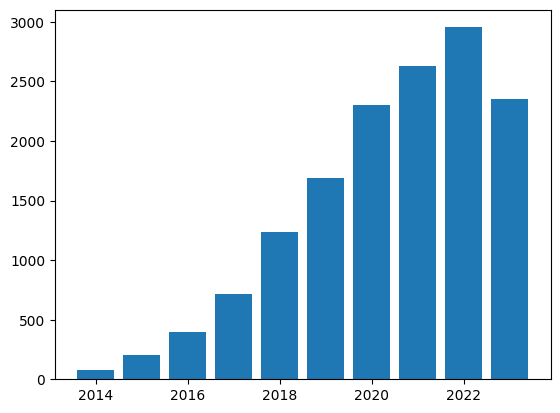

Jianan Chen
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


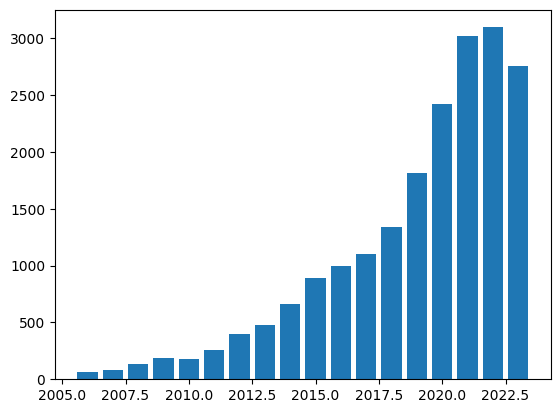

Mohammadhadi Bagheri
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


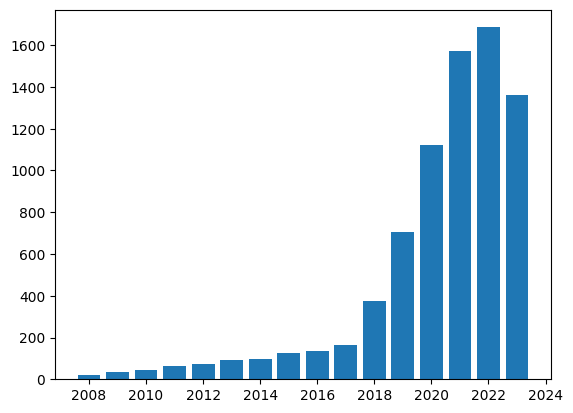

Tarun Joshi
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


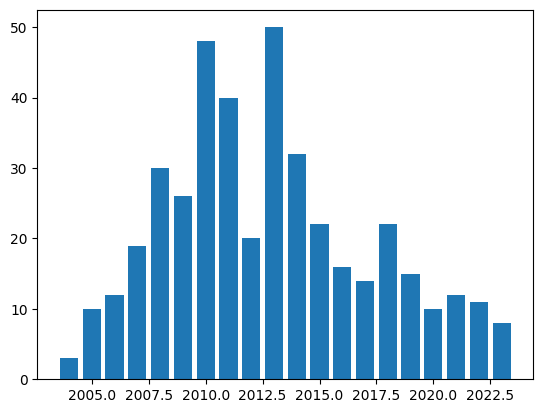

Martin Seneviratne
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


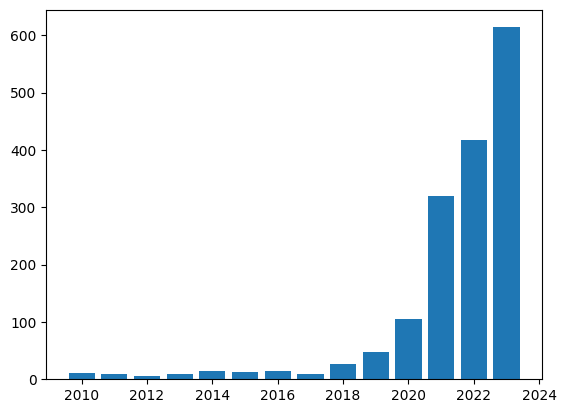

Manuel Berenguel
[1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


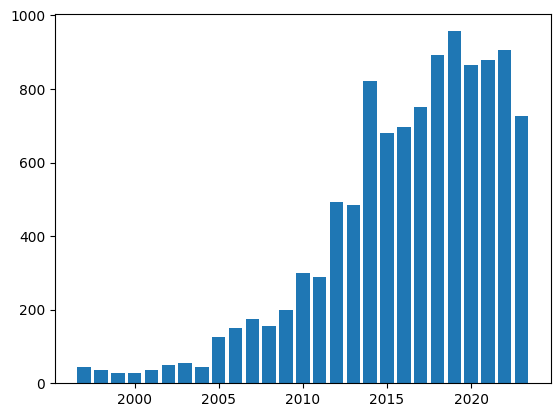

U Rajendra Acharya
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


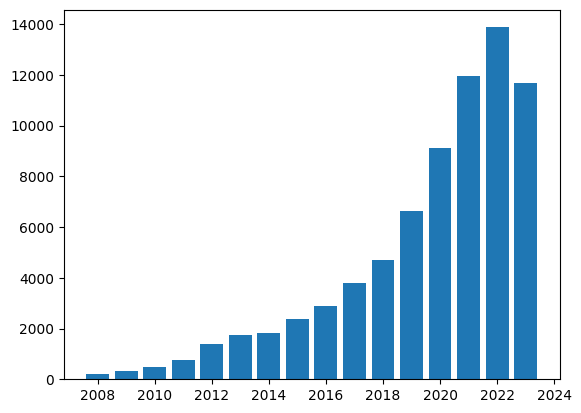

Rongfei Lu
[2021, 2022, 2023]


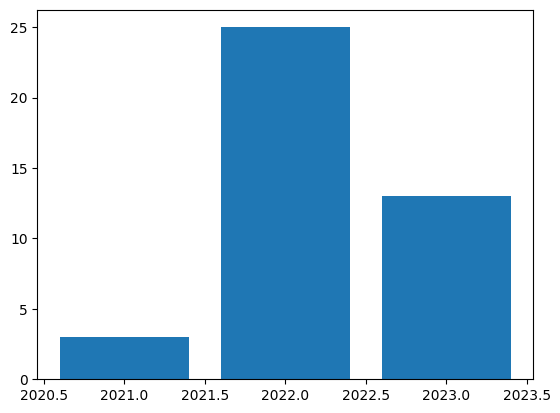

Ke Liang
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


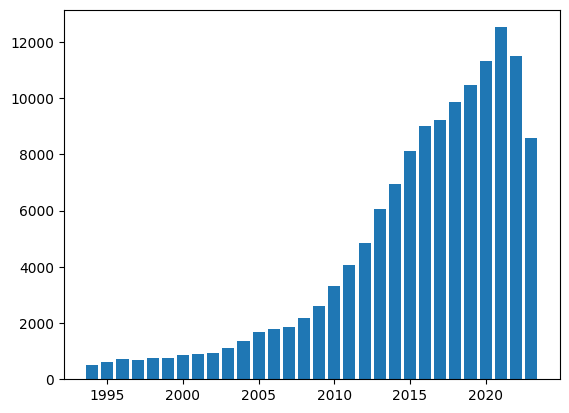

Xiuying Wei
[2022, 2023]


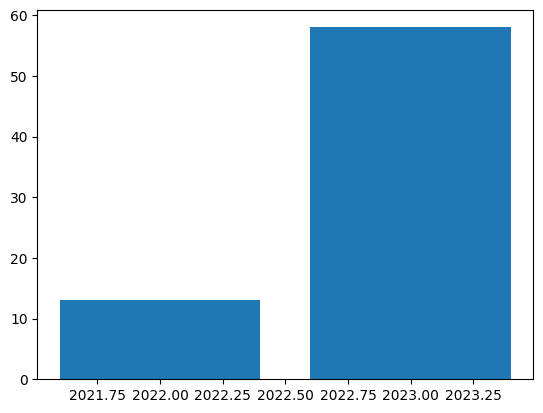

Petrea Redmond
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


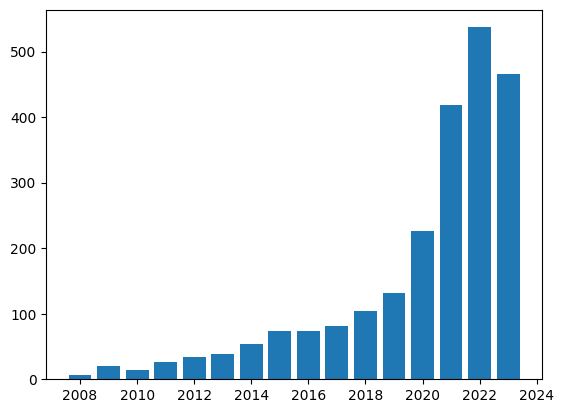

Aamir Miyajiwala
[2022, 2023]


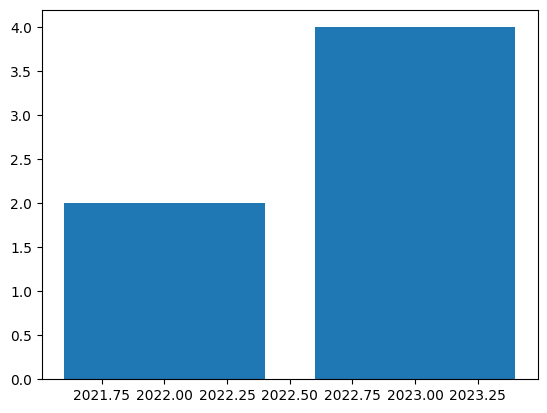

Saifullahi Aminu Bello
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


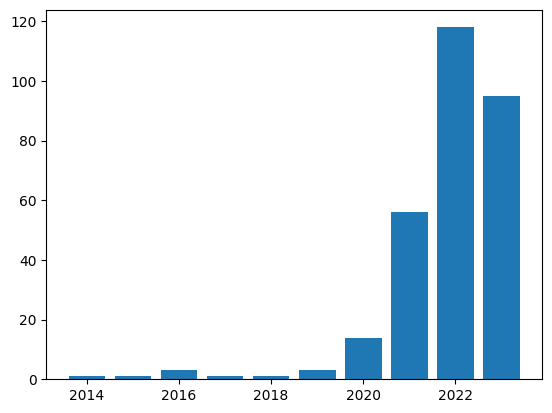

Ling Gao
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


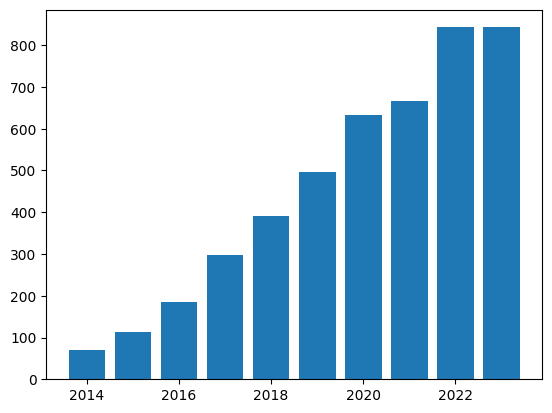

Satyajit Kamble
[2018, 2019, 2020, 2021, 2022, 2023]


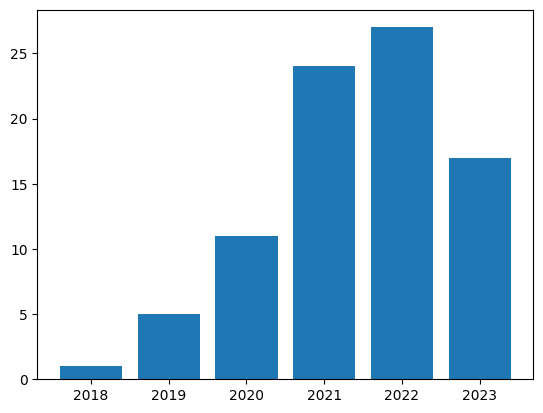

Yixing Xu
[2019, 2020, 2021, 2022, 2023]


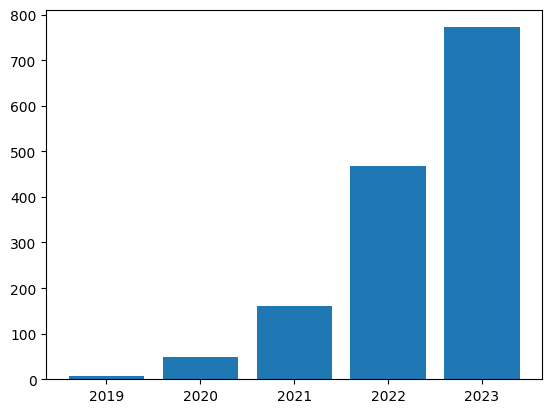

Qi Tian
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


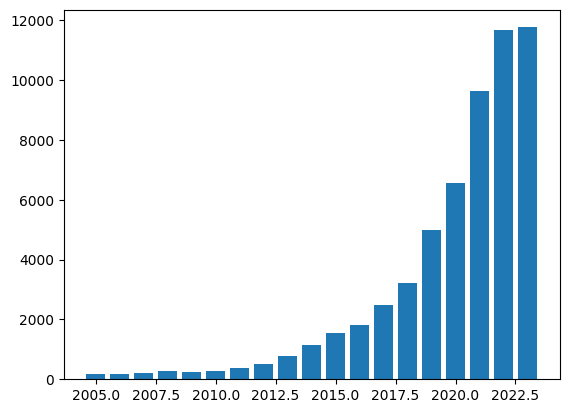

Chenghao Liu
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


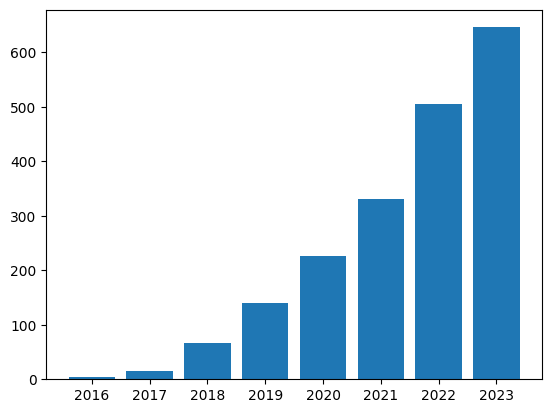

Kevin Gimpel
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


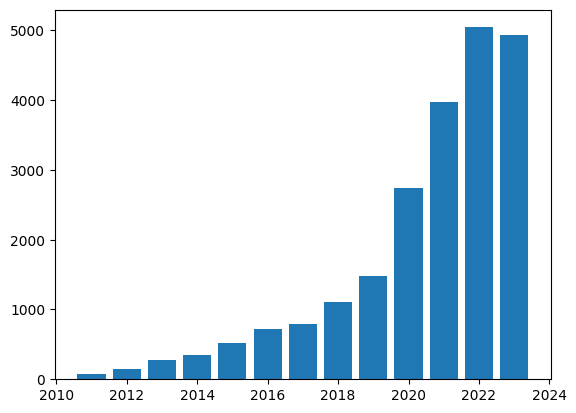

Premkumar Natarajan
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


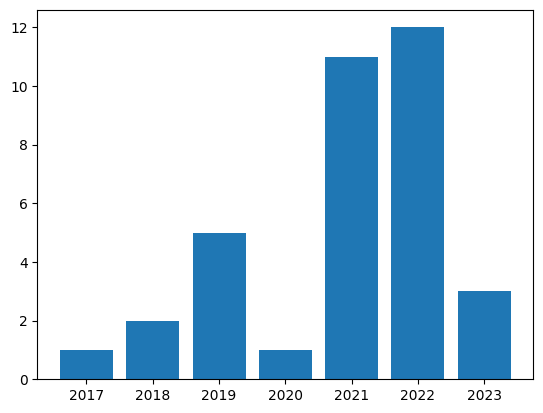

Minou Rabiei
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


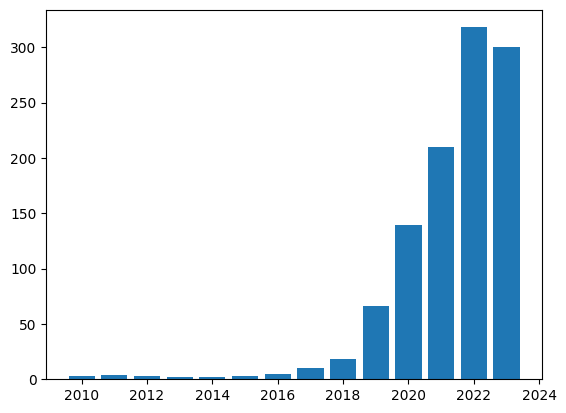

Changhu Wang
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


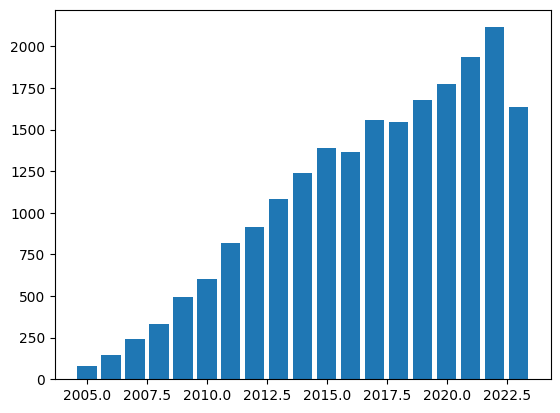

Wael. Z. ElSawy
[2020, 2021, 2022, 2023]


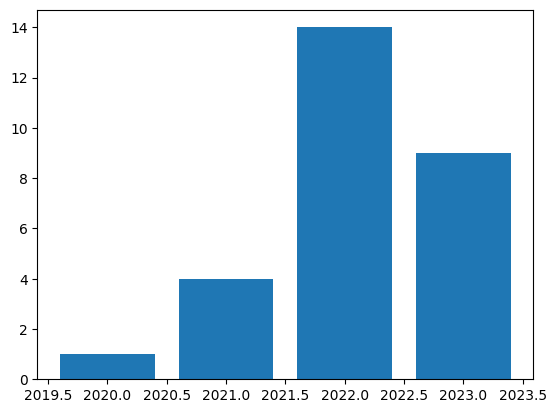

Tristan Deleu
[2019, 2020, 2021, 2022, 2023]


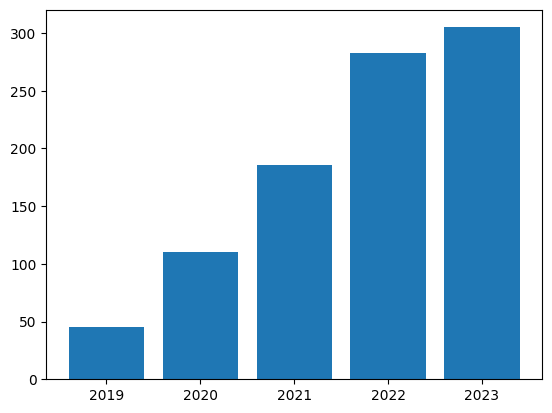

Yudong Zhu
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


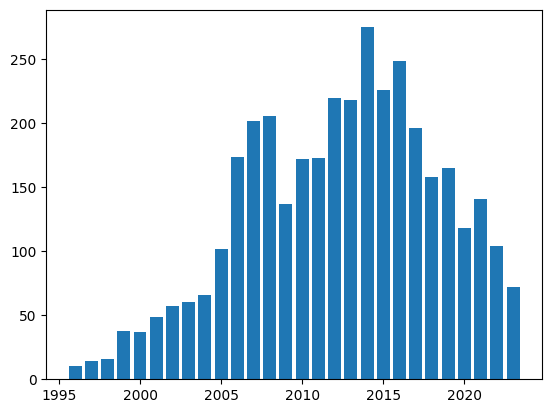

Oscar Chang
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


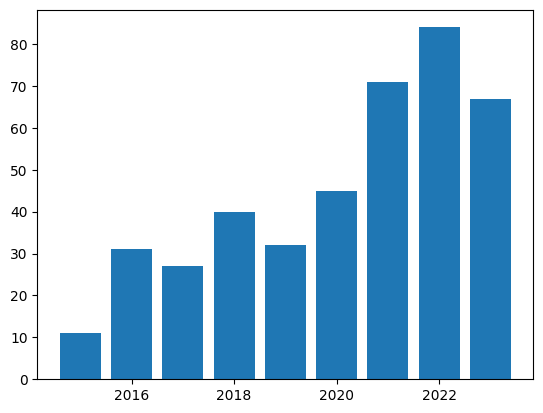

Andreas Dengel
[1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


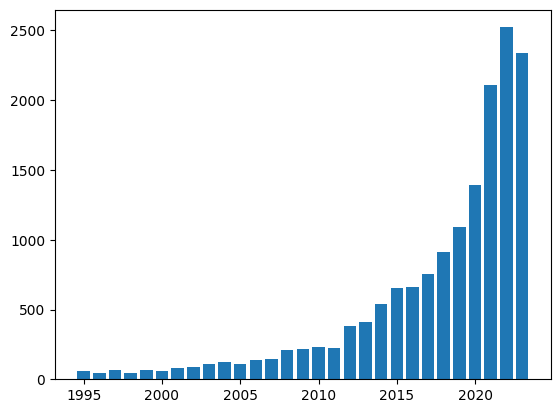

Yang Xiang
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


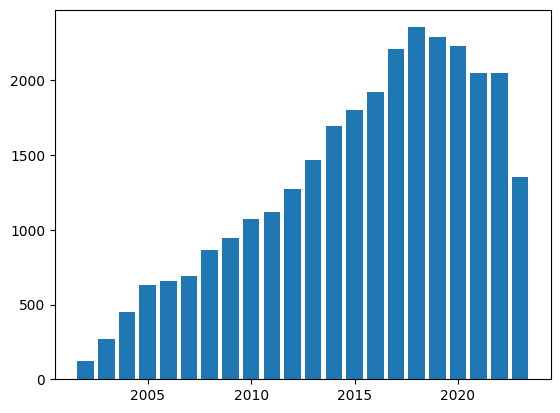

Javier Bonilla
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


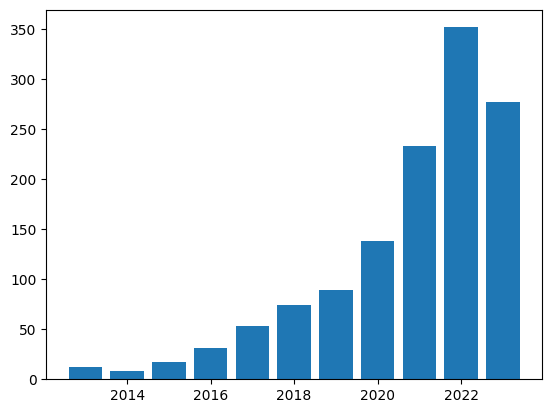

Mahmoud Assran
[2019, 2020, 2021, 2022, 2023]


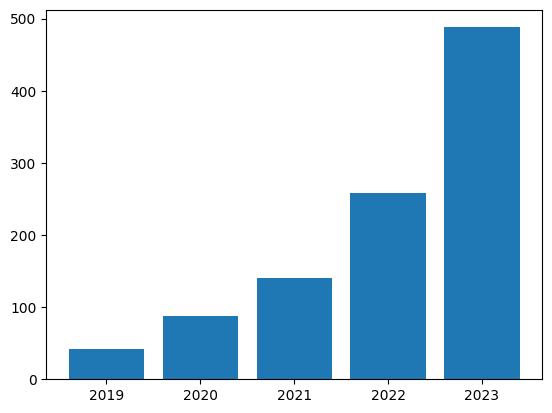

Haitao Mi
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


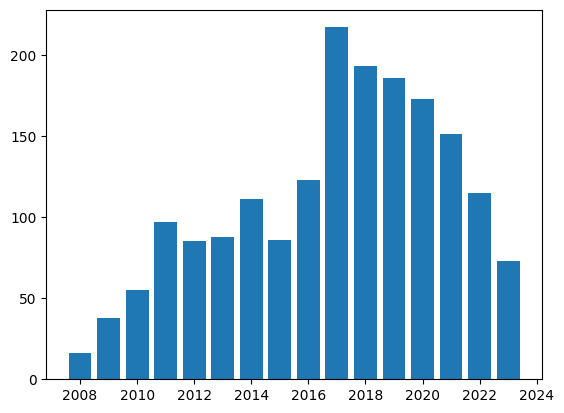

Zexian Zeng
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


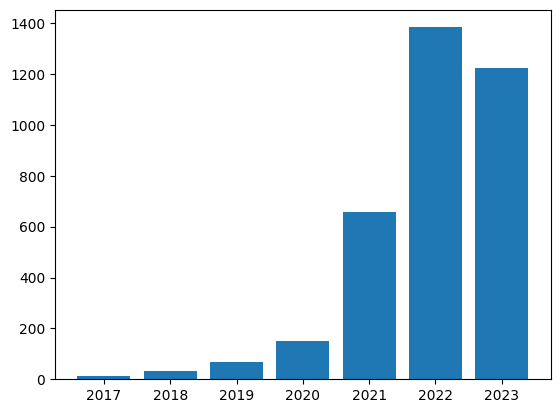

Sibei Yang
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


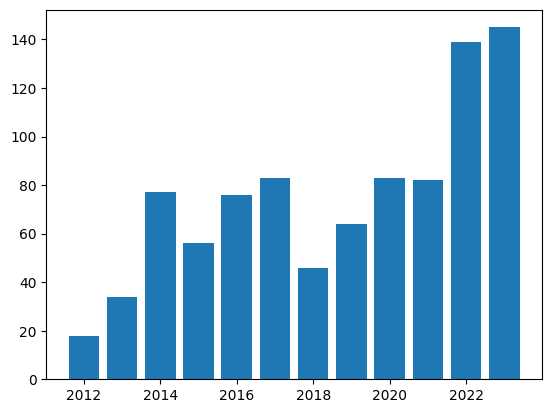

James Oldfield
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


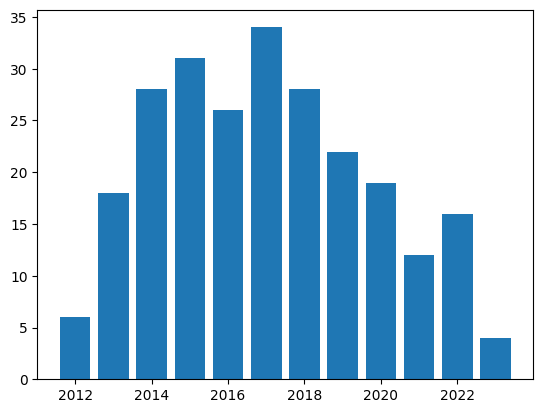

Jing Zhang
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


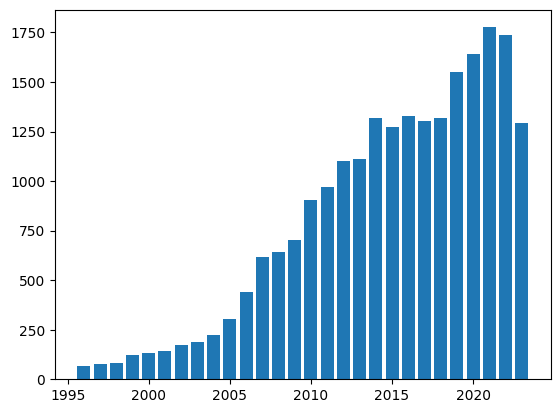

Evgeny Burnaev
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


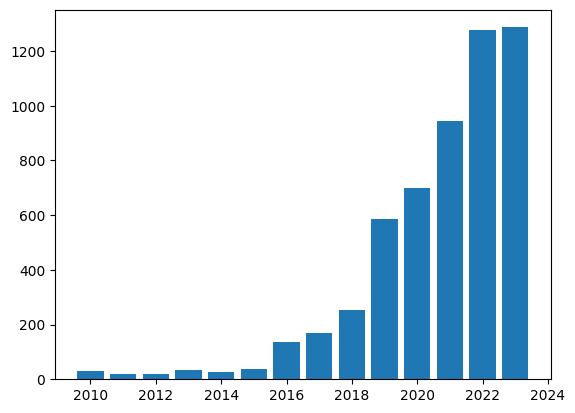

Zhennan Yan
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


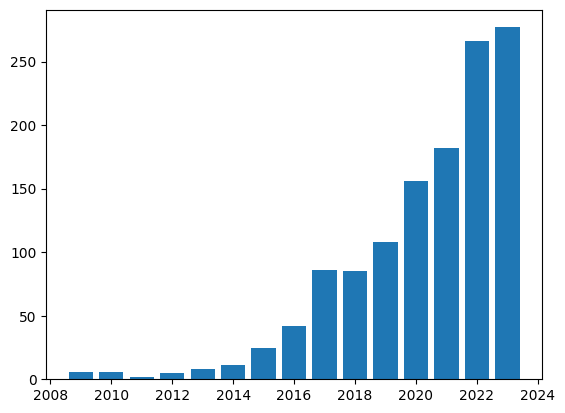

Hengyong Yu
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


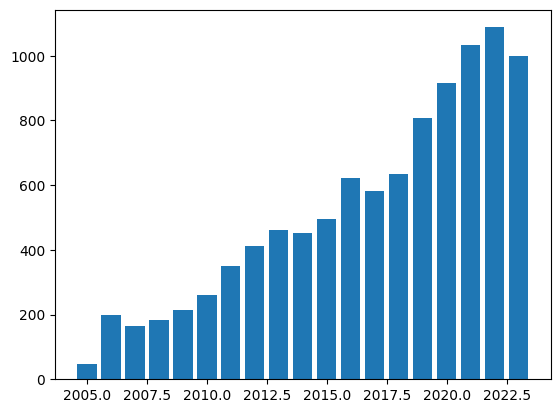

Anthony Remazeilles
[2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


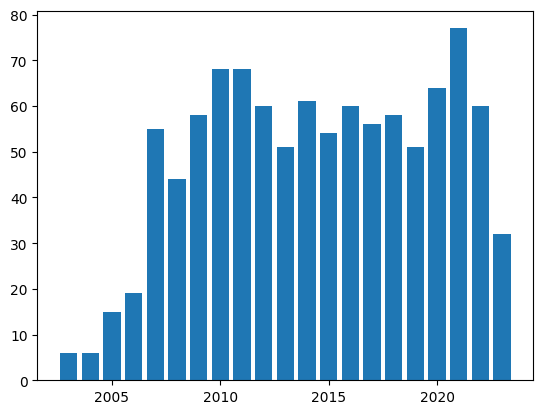

Zhongyue Zhang
[2018, 2019, 2020, 2021, 2022, 2023]


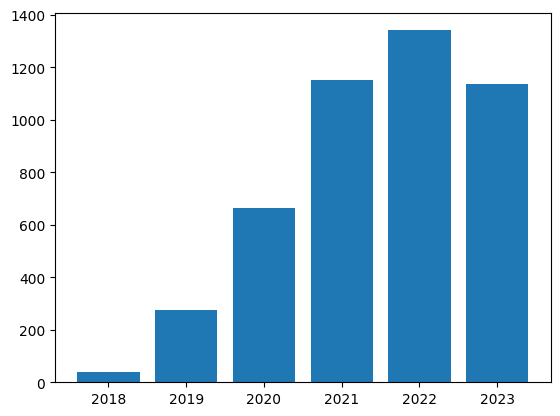

Esa Pitkänen
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


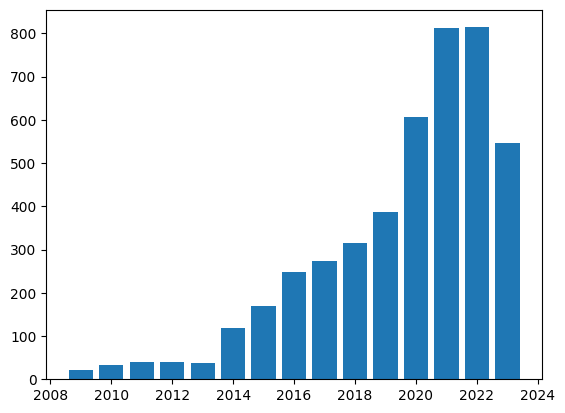

Steven QH Truong
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


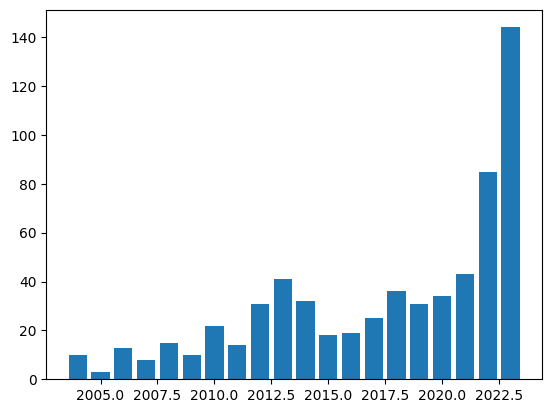

Hanwang Zhang
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


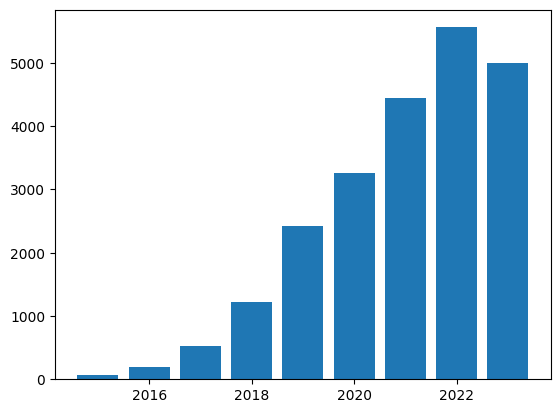

Boyi Yang
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


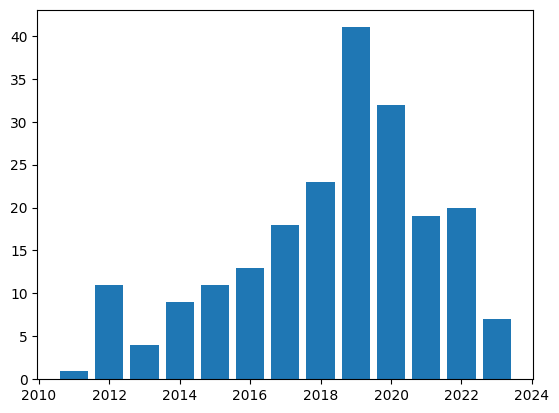

Qian Wang
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


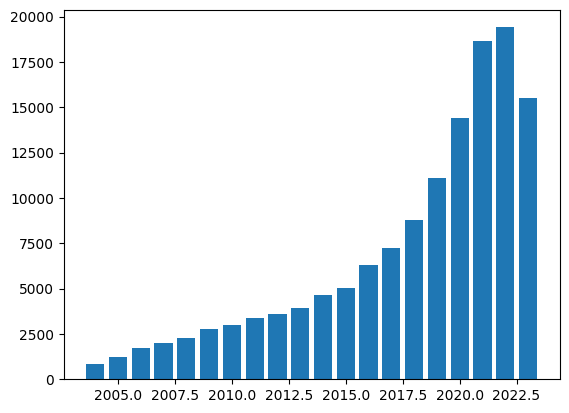

Sher Mohammad Doudpota
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


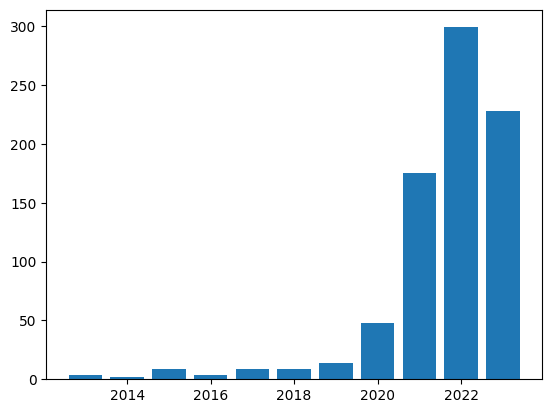

Stefano Mangini
[2020, 2021, 2022, 2023]


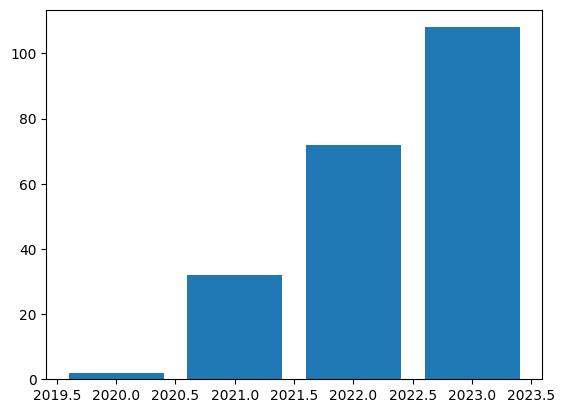

Derek T. Anderson
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


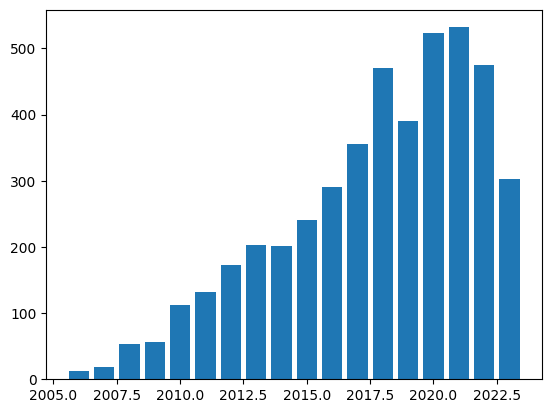

Istiak Ahmad
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


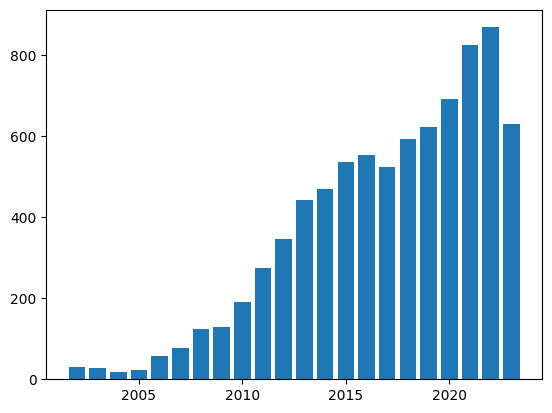

Haiqin Yang
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


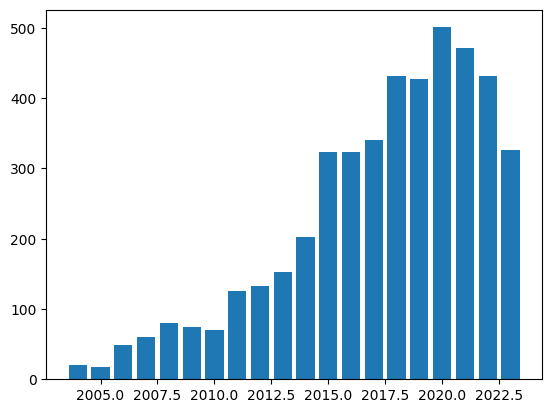

Stefan Ultes
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


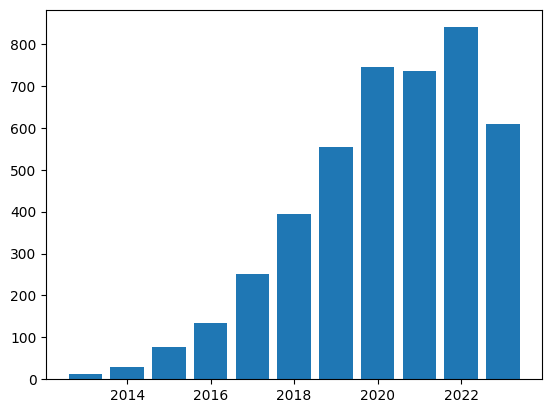

Guodong Guo
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


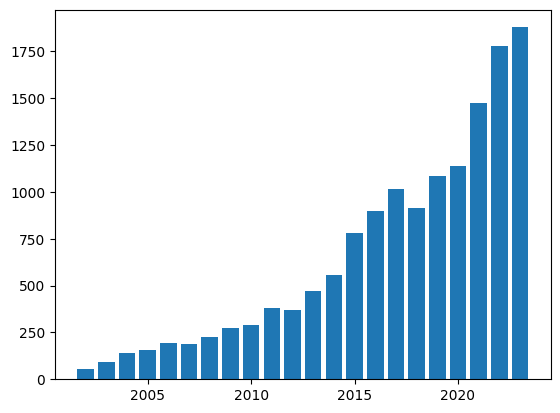

Shuming Jiao
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


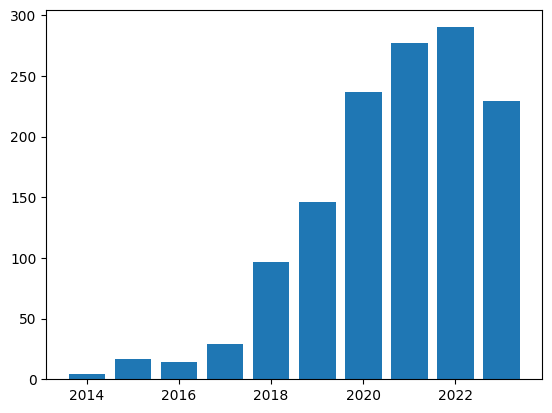

Piji Li
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


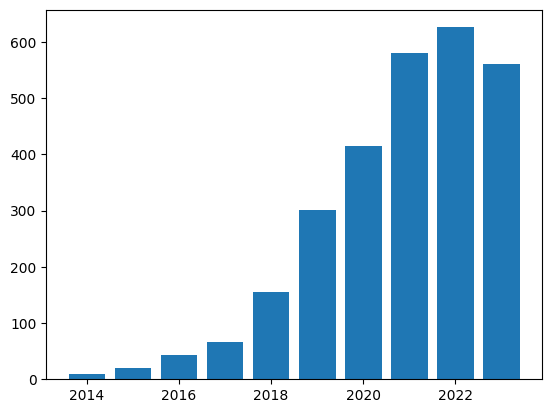

Xingjian Shi
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


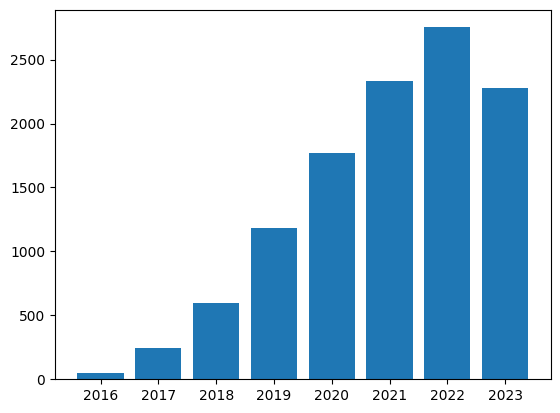

Jindřich Libovický
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


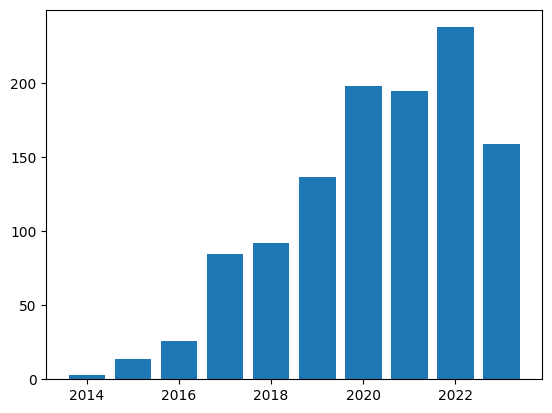

Philipp Schaer
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


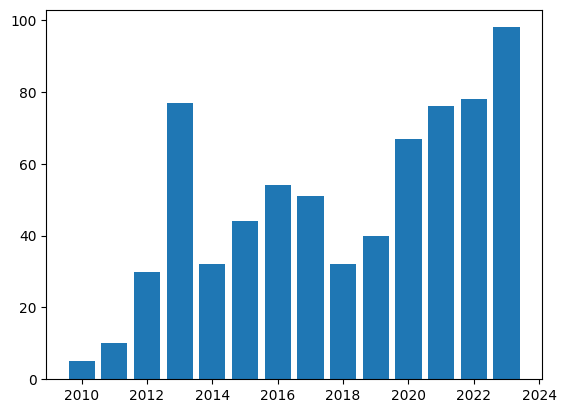

Farah Alsafadi
[2021, 2022, 2023]


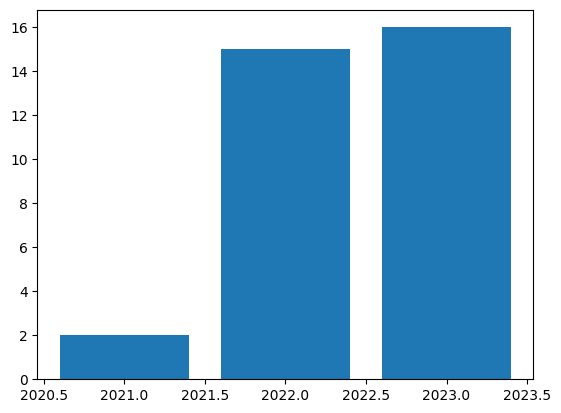

Zibin Zhao
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


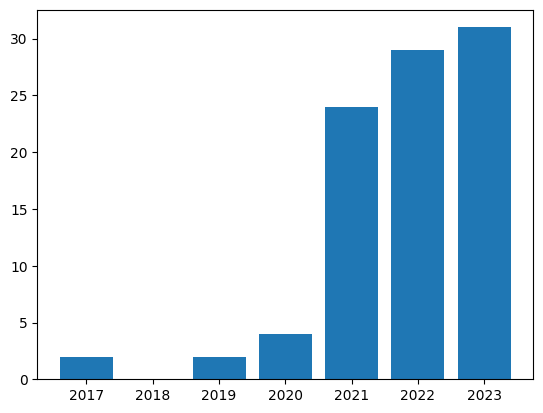

Frank Keller
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


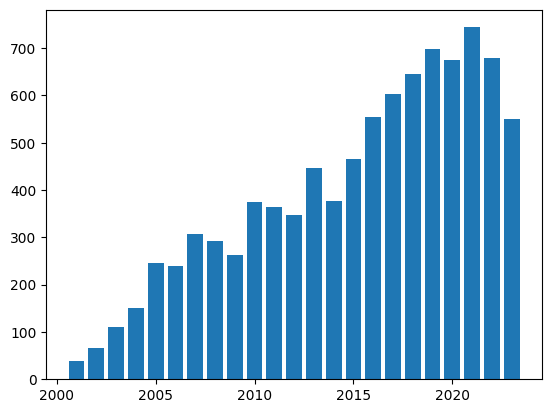

Xing Zhao
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


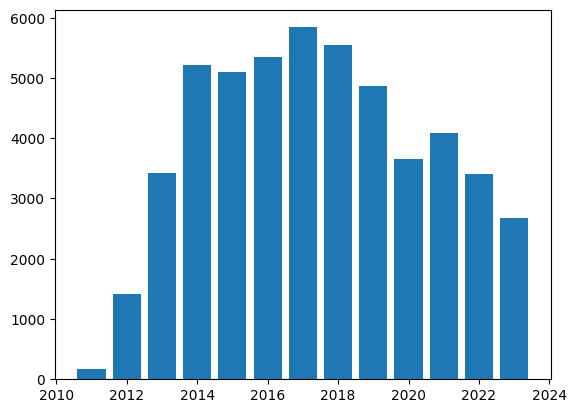

Sheng Yan
[1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


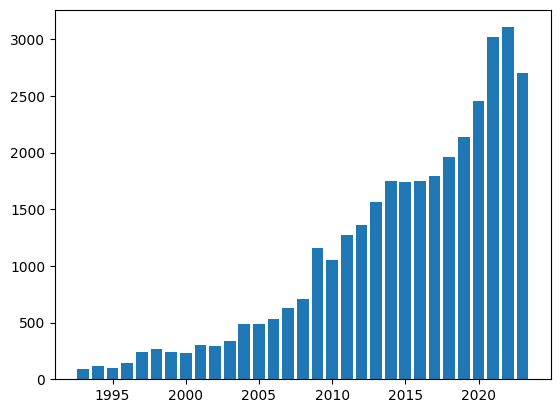

Hang Su
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


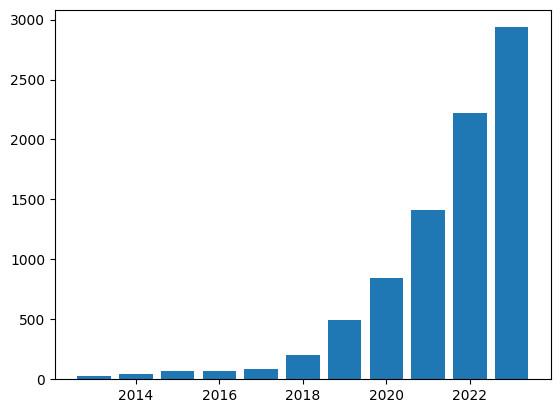

Chuizheng Meng
[2018, 2019, 2020, 2021, 2022, 2023]


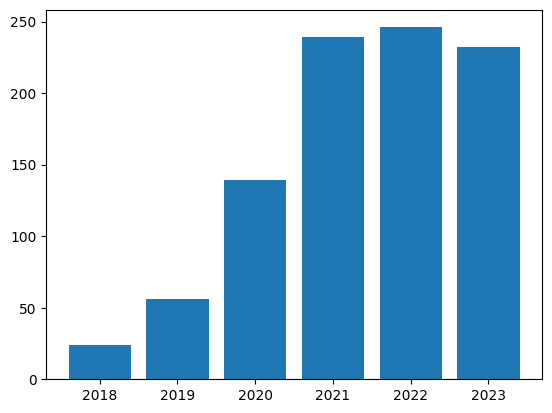

Qiyu Sun
[1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


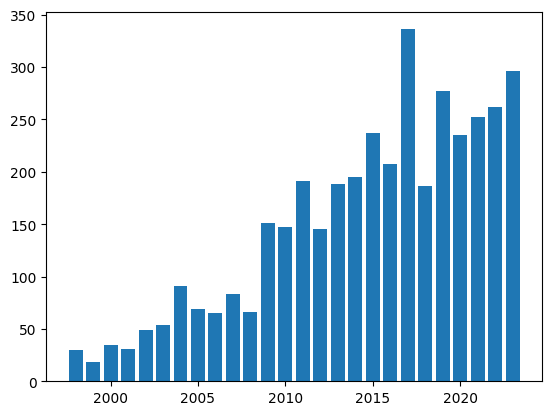

Jérôme Malick
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


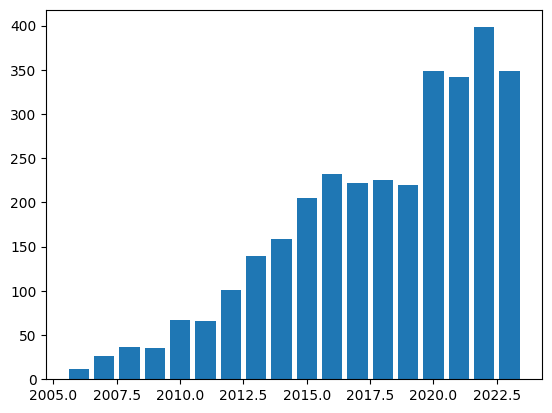

Grigori Sidorov
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


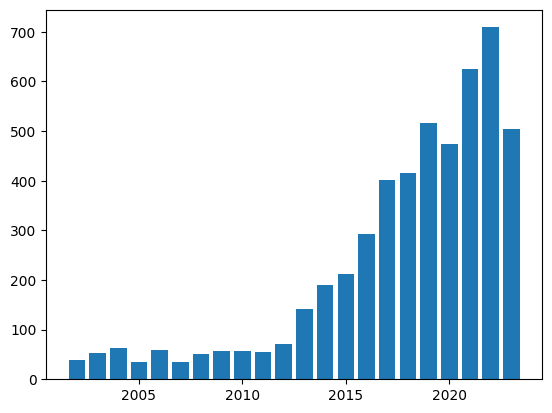

Zihang Dai
[2018, 2019, 2020, 2021, 2022, 2023]


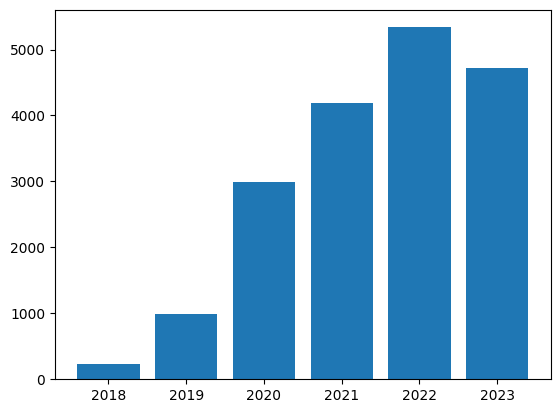

Zhengping Che
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


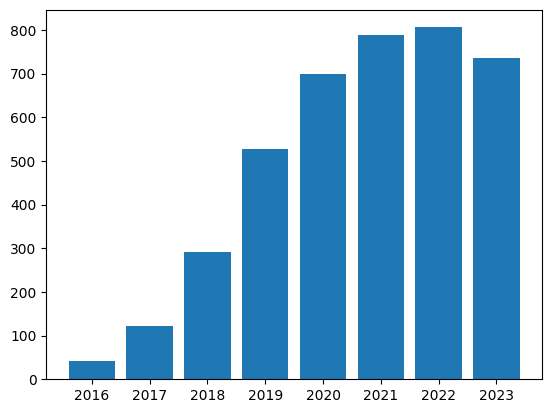

Qiang Li
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


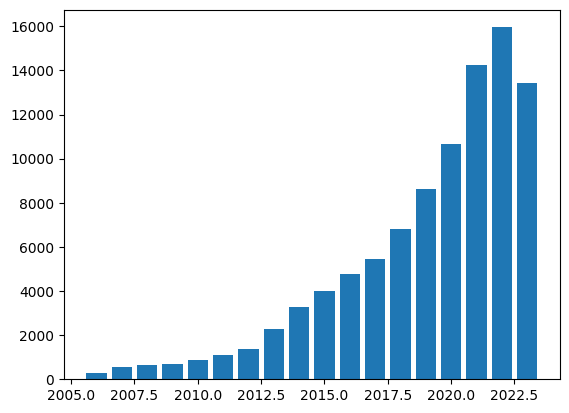

Peng Wang
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


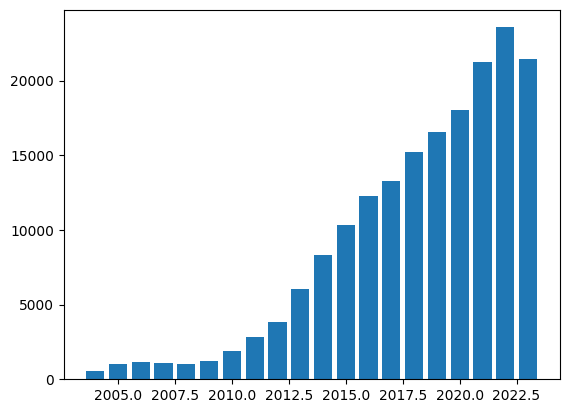

Miao Sun
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


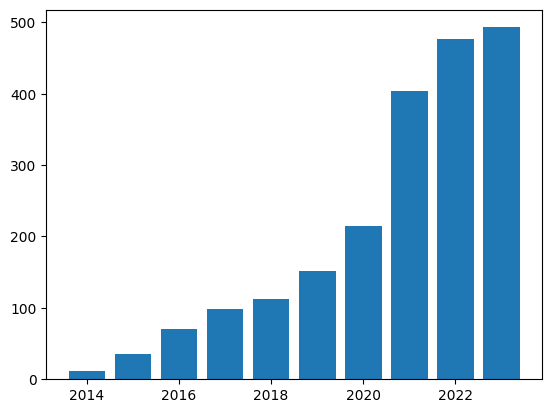

Zikang Liu
[2022, 2023]


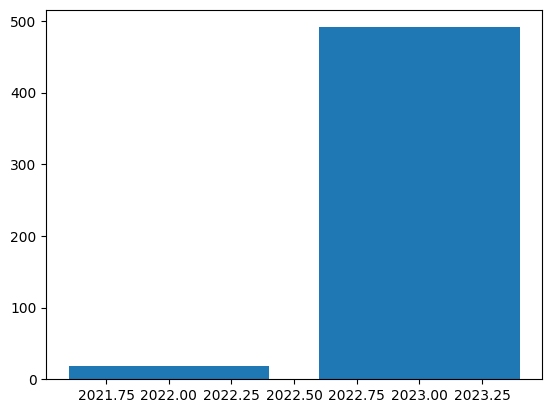

Sumei Sun
[2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


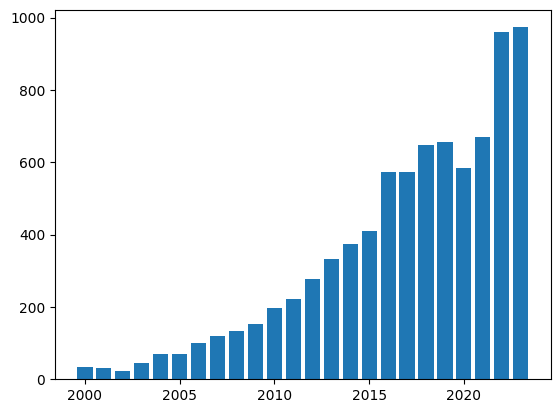

Zhoubing Xu
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


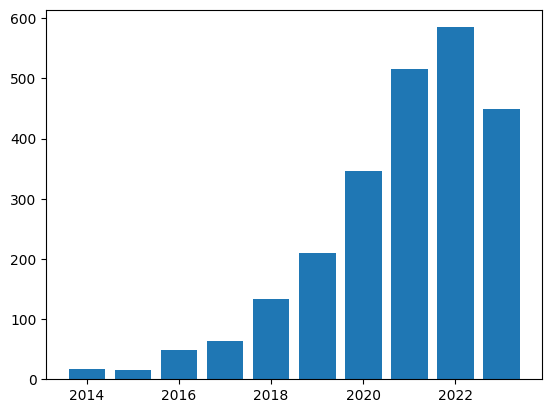

Enrico Santus
[1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


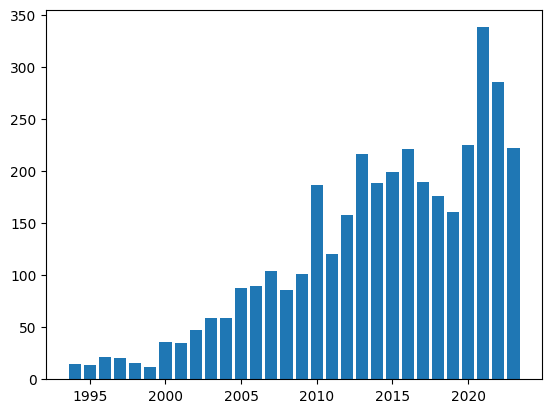

Manish Munikar
[2019, 2020, 2021, 2022, 2023]


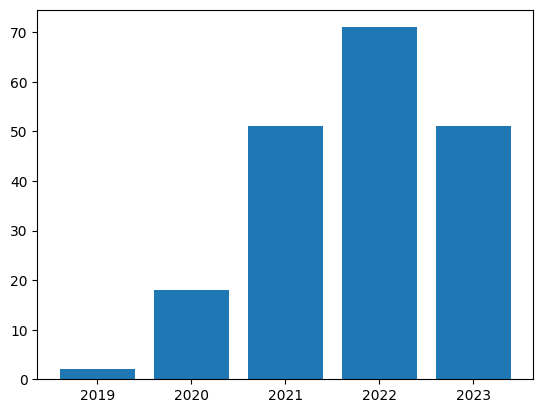

Dejing Dou
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


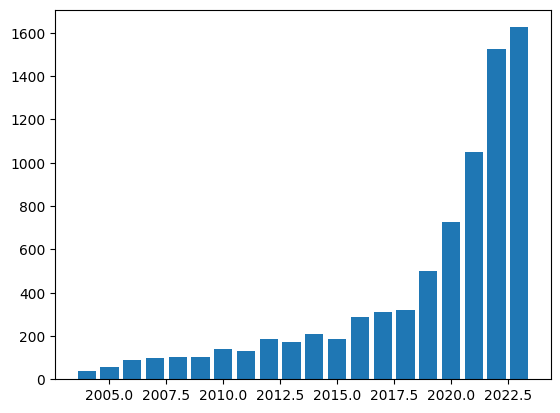

Shiming Zhang
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


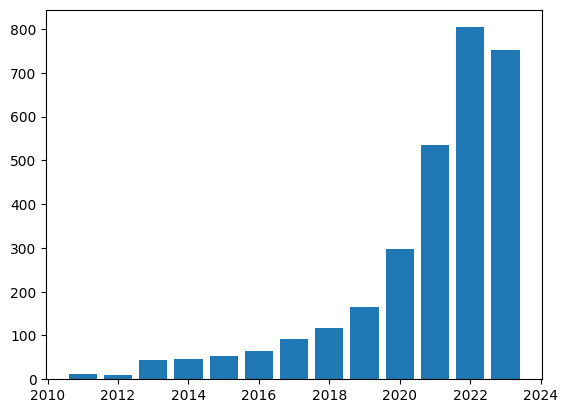

Zewen Li
[2020, 2021, 2022, 2023]


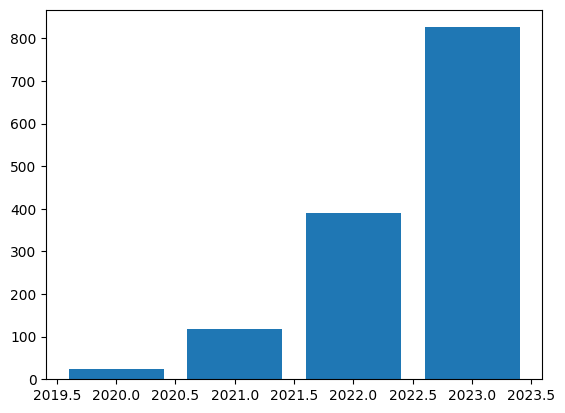

Vladimir Korviakov
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


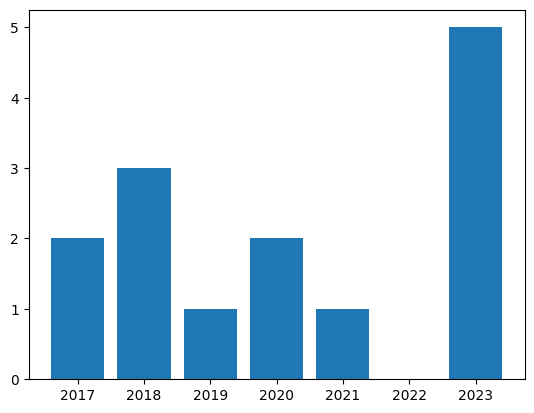

Dianhai Yu
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


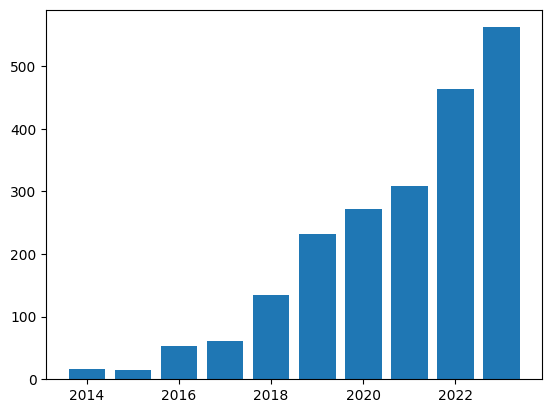

Jan Šnajder
[2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


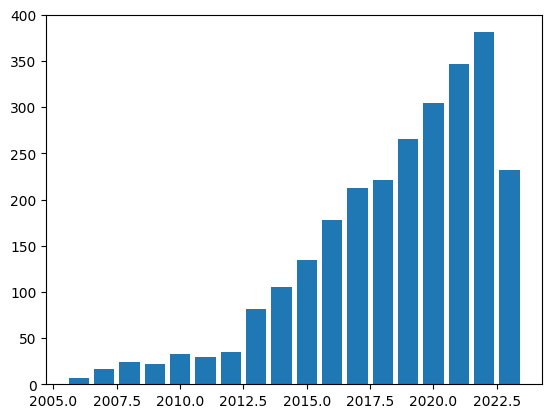

Unmesh Kurup
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


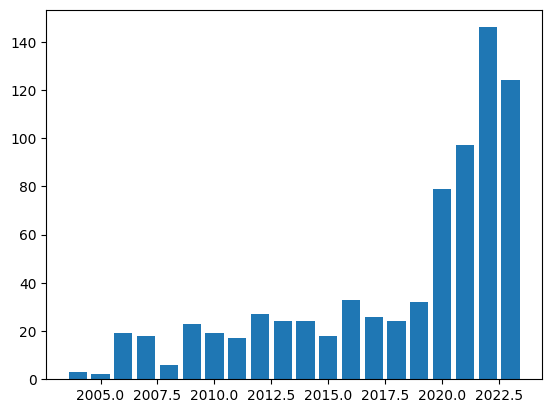

Meysam Asgari-Chenaghlu
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


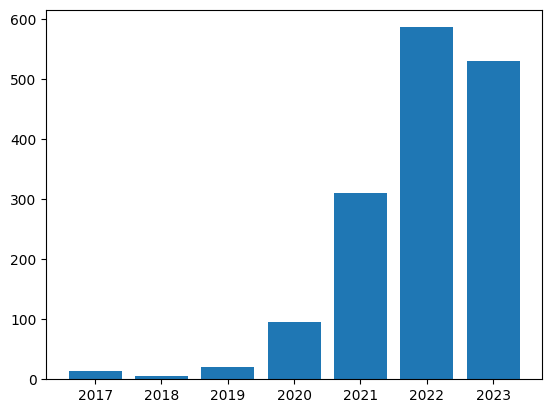

Bernhard Schäfl
[2020, 2021, 2022, 2023]


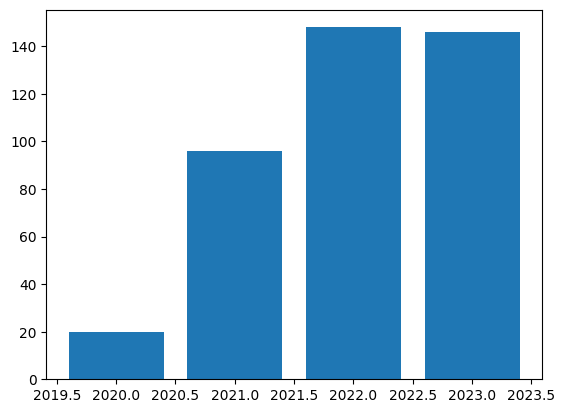

Alex Kendall
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


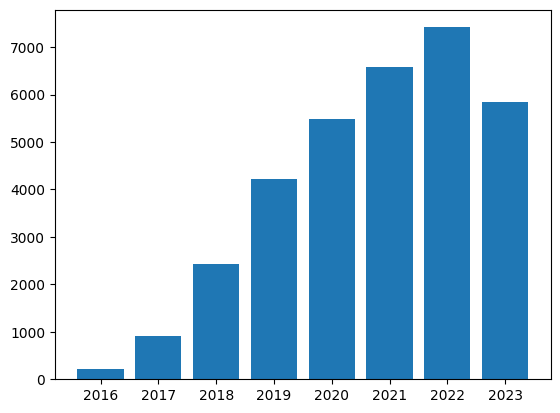

Giulio Zizzo
[2018, 2019, 2020, 2021, 2022, 2023]


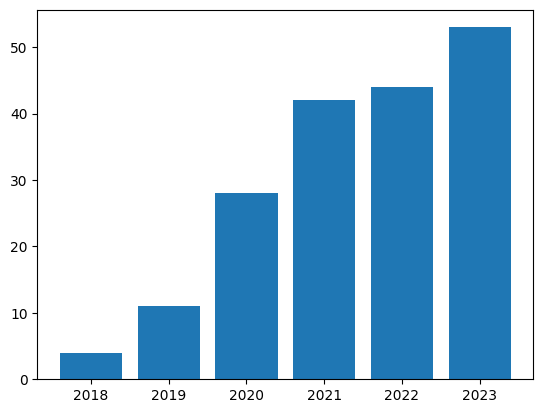

Zhiyong Lu
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


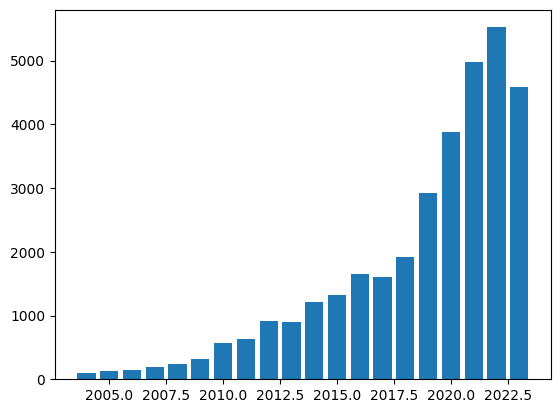

Yuan Qi
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


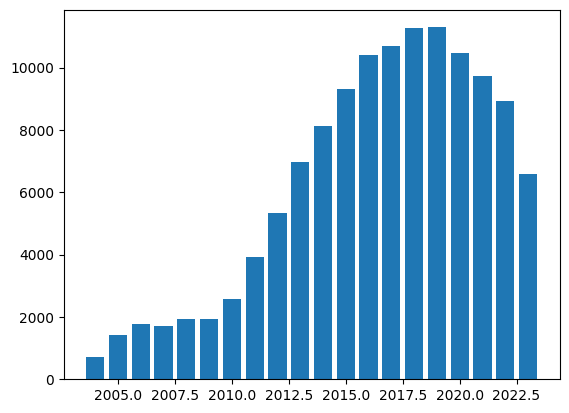

Ilke Demir
[2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


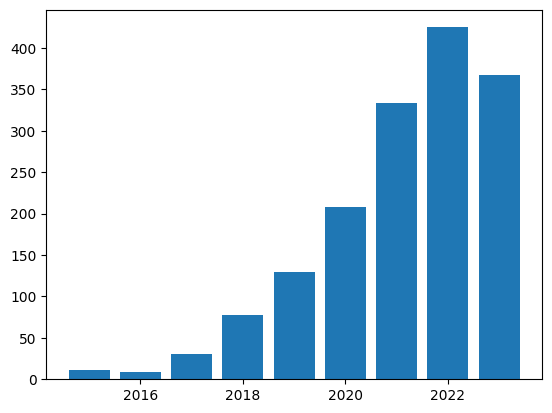

Yonghong Tian
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


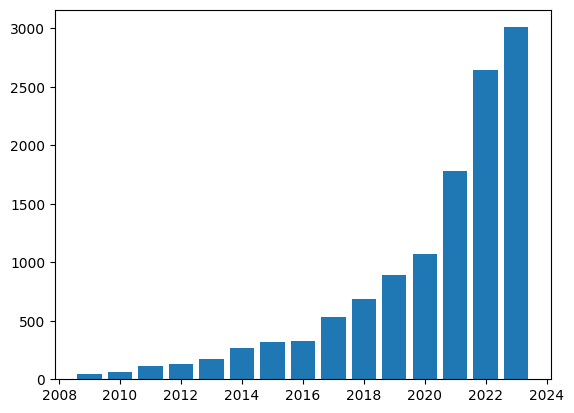

Duolin Wang
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


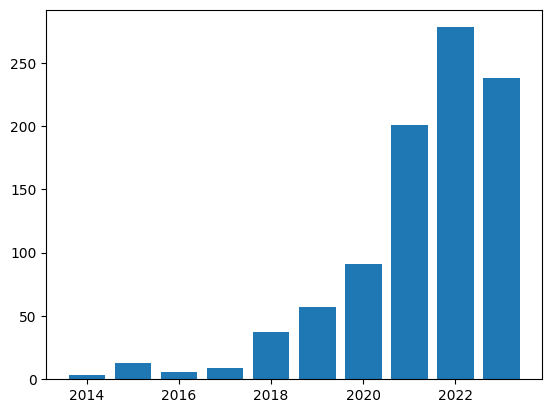

Trung Mai
[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


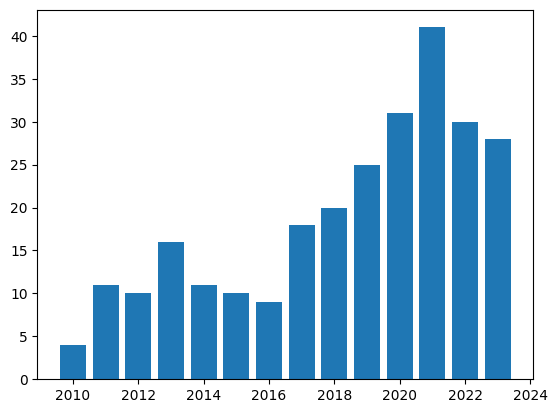

Mahdieh Soleymani Baghshah
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


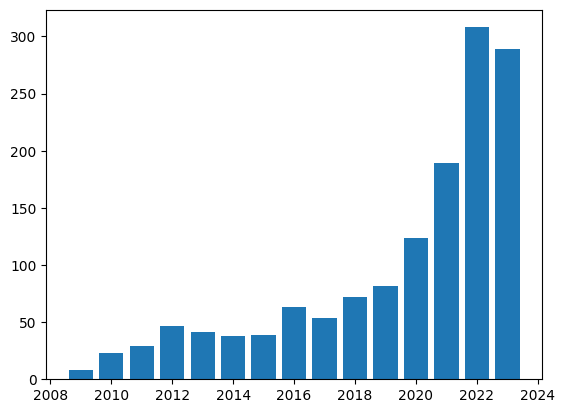

Hao Chen
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


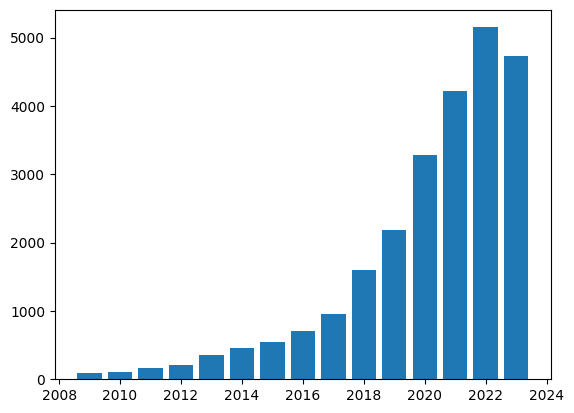

Karën Fort
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


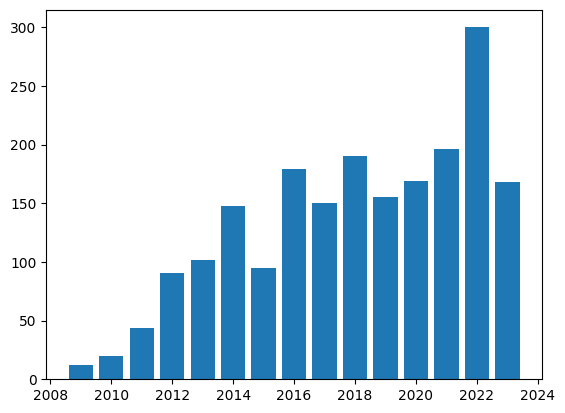

Li Shen
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


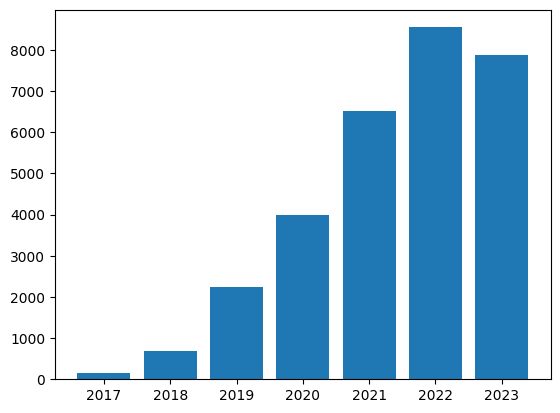

Qingqing Cao
[2017, 2018, 2019, 2020, 2021, 2022, 2023]


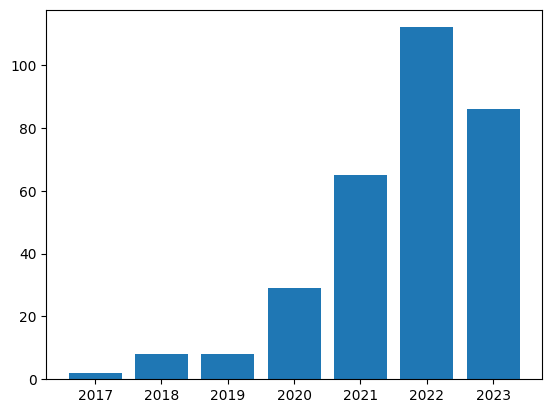

Pedro O. Pinheiro
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


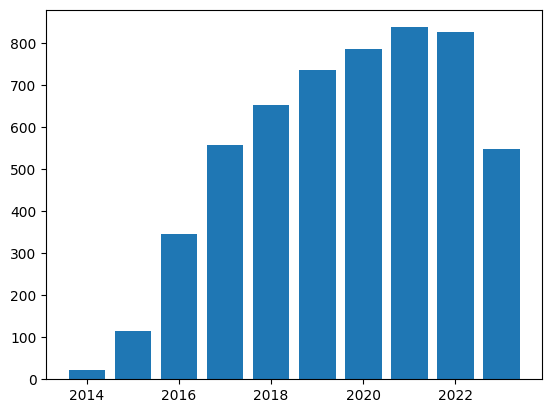

Sree Premkumar
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


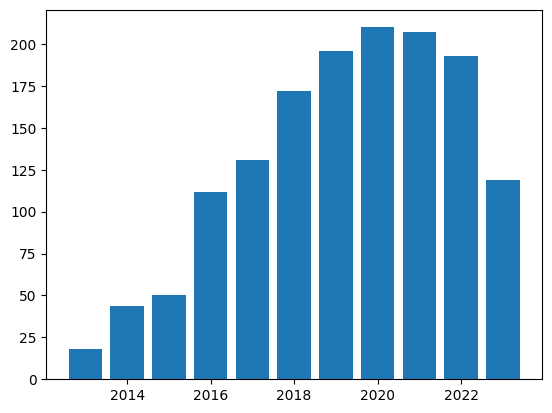

Gabor Karsai
[1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


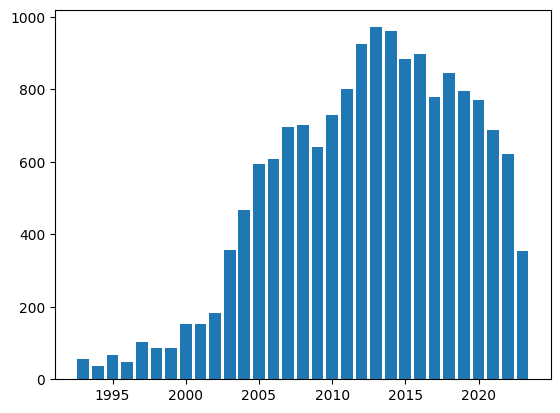

Yuheng Chen
[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


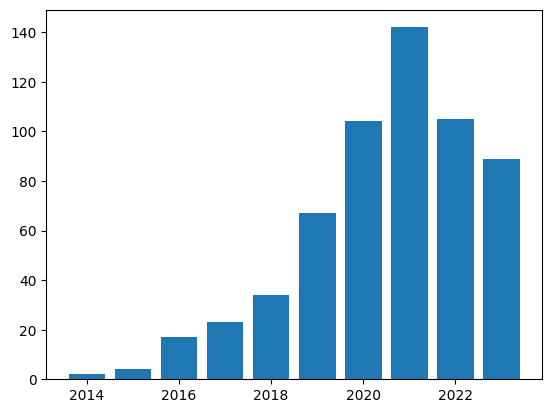

Ruihao Gong
[2020, 2021, 2022, 2023]


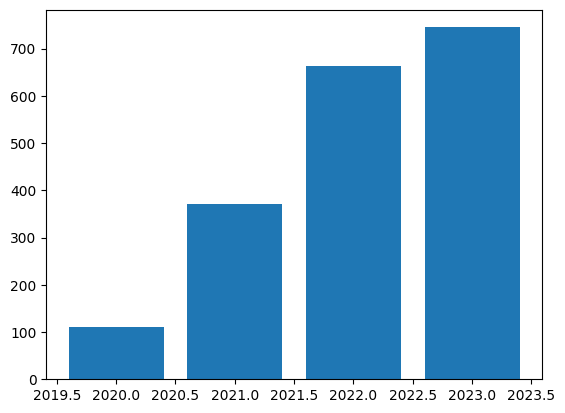

Shih-Chun Lin
[2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


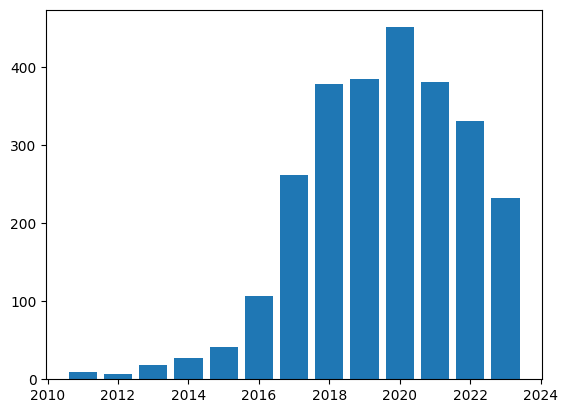

Yuxuan Wang
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


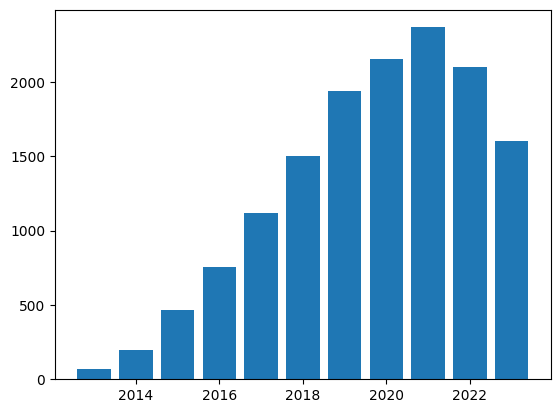

Gaoang Wang
[2018, 2019, 2020, 2021, 2022, 2023]


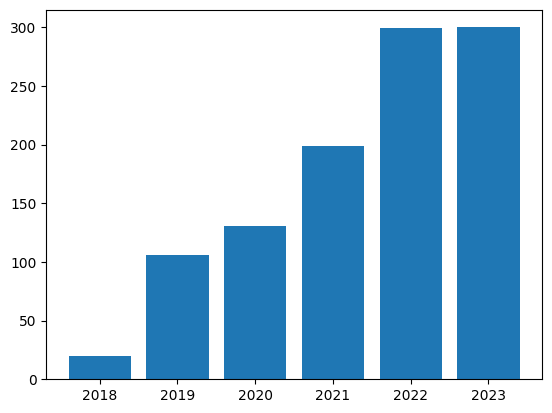

Bahram Zonooz
[2018, 2019, 2020, 2021, 2022, 2023]


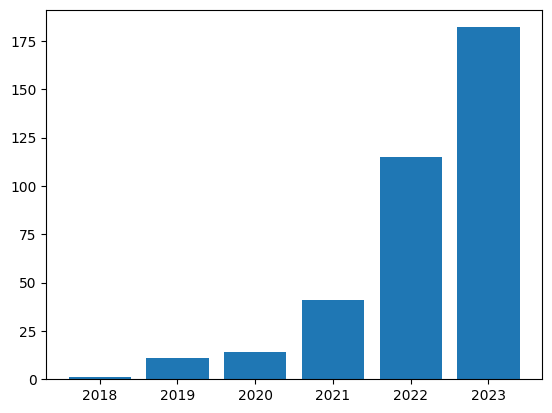

Chunlin Tian
[]


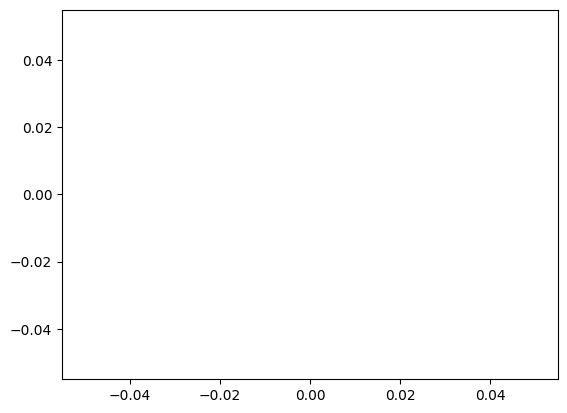

Michael Milham
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


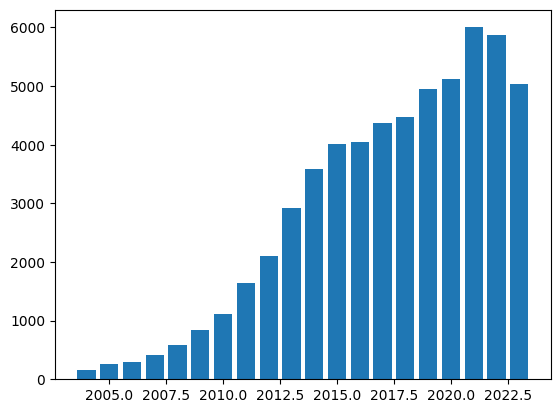

Michael Gilbert
[1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


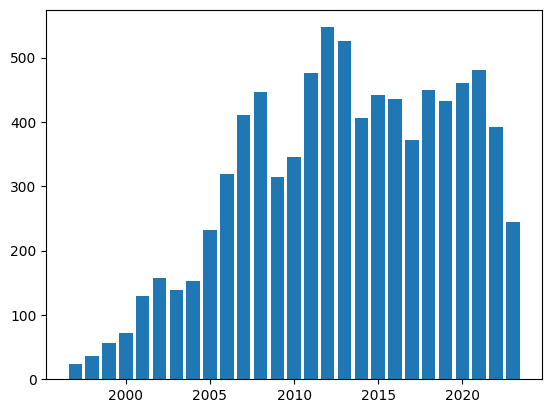

Zizhong Chen
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


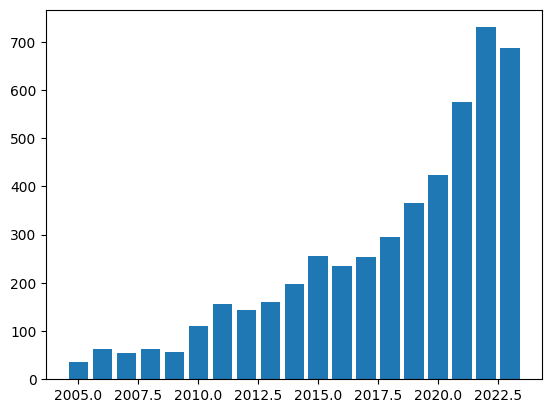

Alan F. Smeaton
[1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


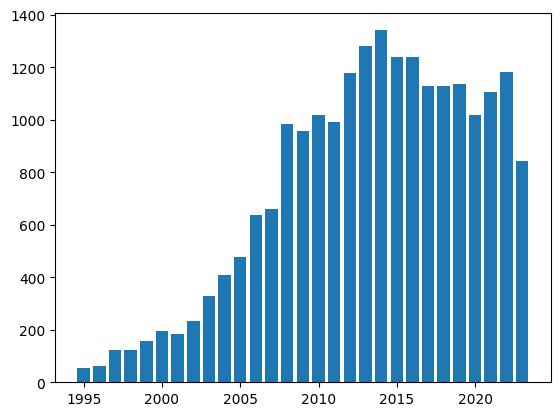

Tsetsentsengel Munkhbayar
[]


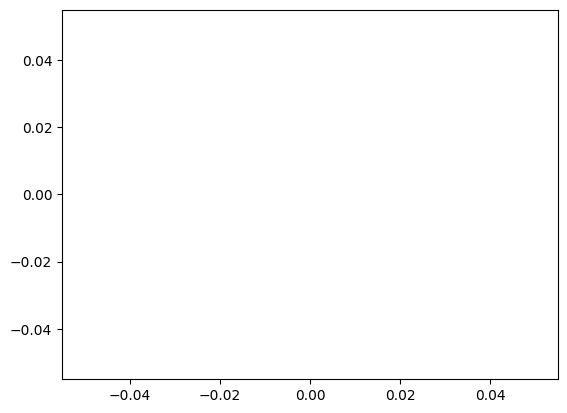

Athena Vakali
[2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


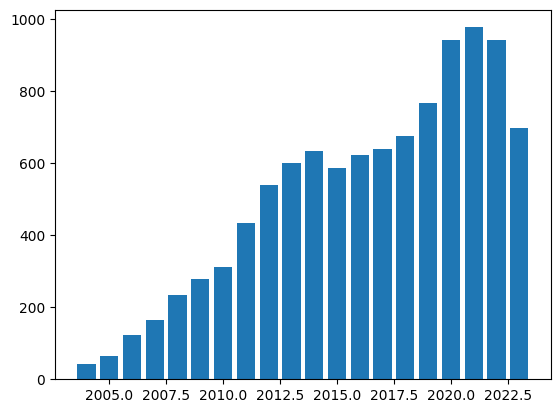

Stefanos Zafeiriou
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


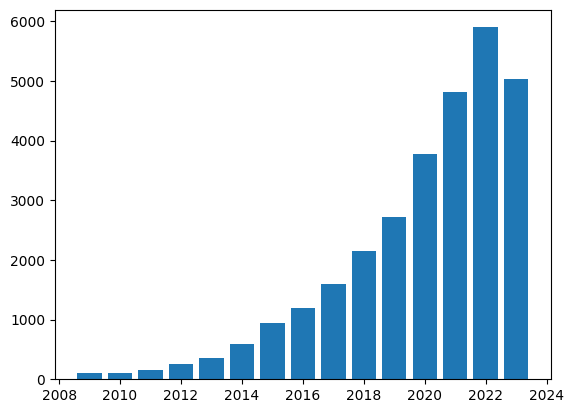

Cecilia Mascolo
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


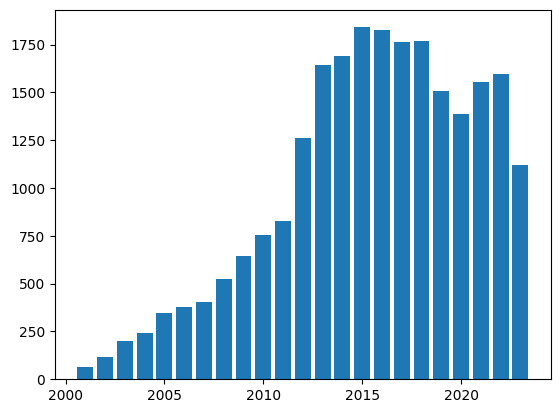

Shaofu Xu
[2018, 2019, 2020, 2021, 2022, 2023]


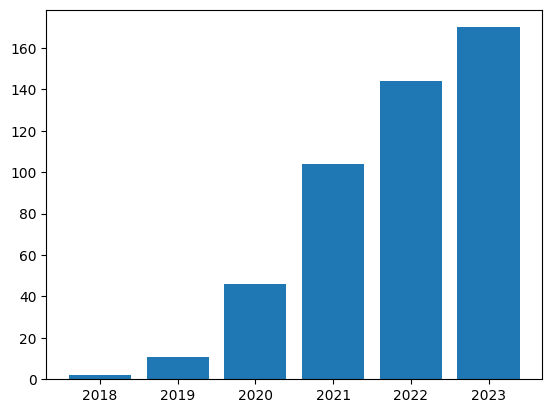

Fangyi Zhu
[2018, 2019, 2020, 2021, 2022, 2023]


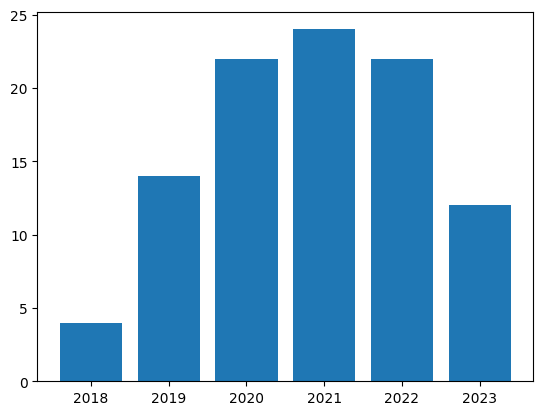

Raphael Canals
[1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


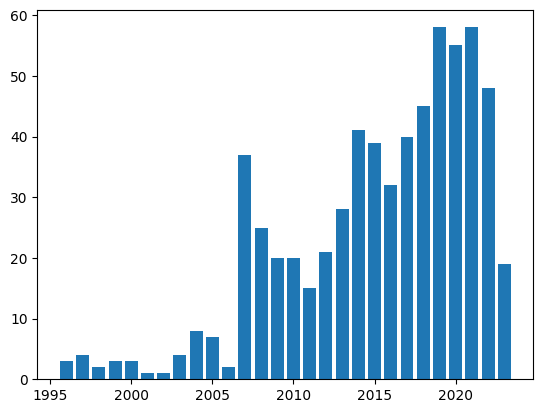

Yujin Tang
[2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


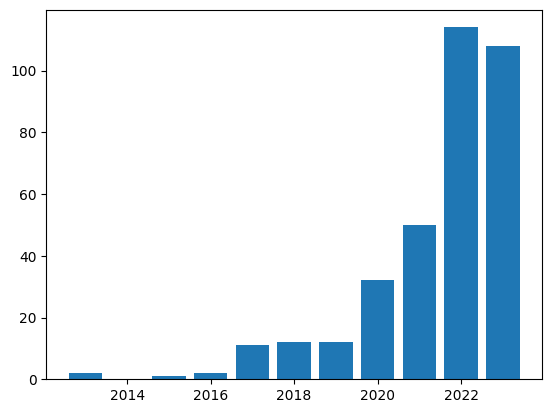

Devrim Cavusoglu
[2020, 2021, 2022, 2023]


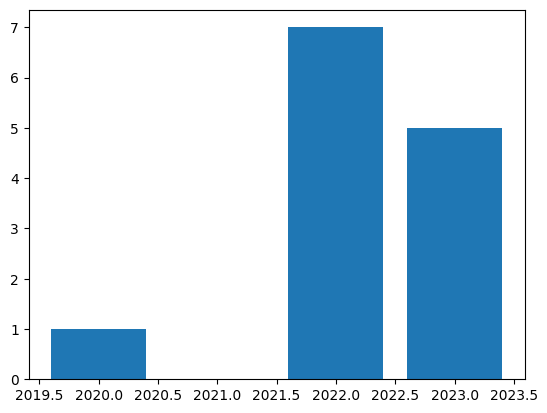

Shengcai Liao
[2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


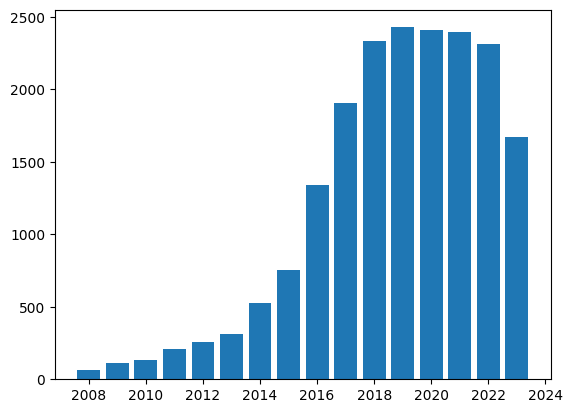

Emerald U. Henry
[2022, 2023]


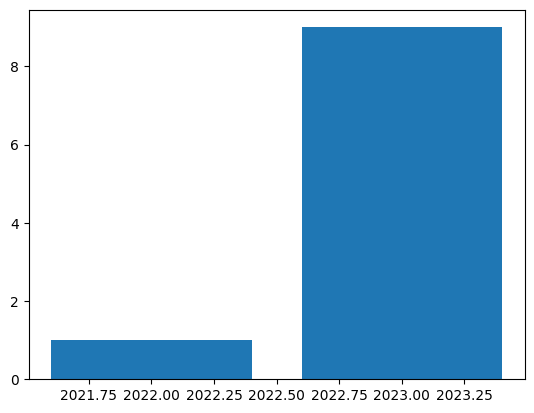

Christoph Busch
[2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


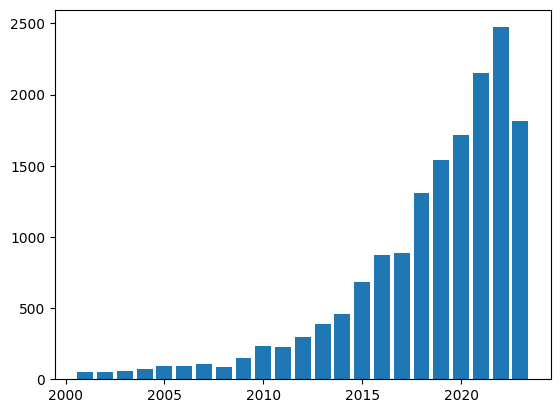

Lukas Schmidt
[2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


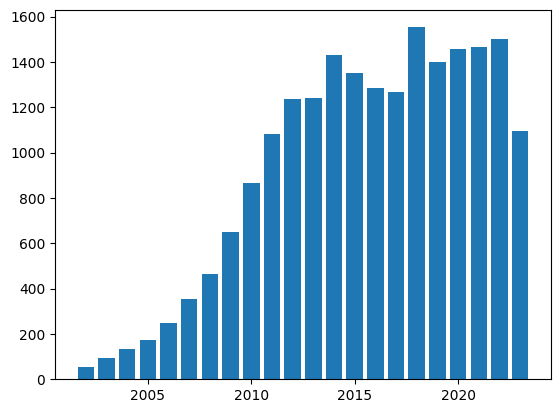

Erik Cambria
[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


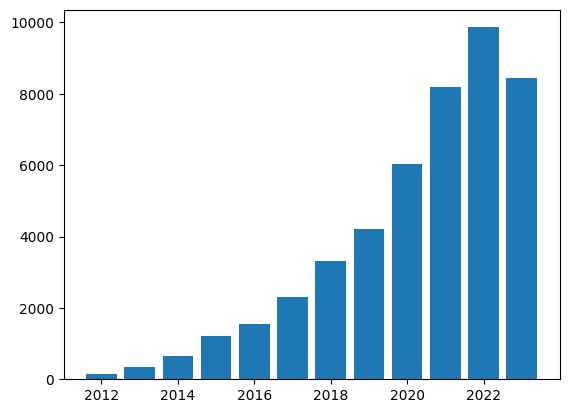

Tianjie Yang
[2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


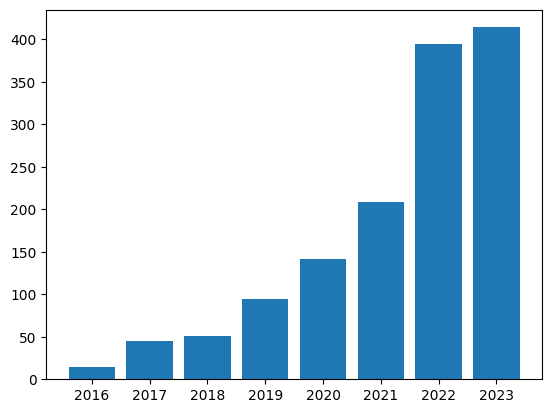

Eric Chan-Tin
[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


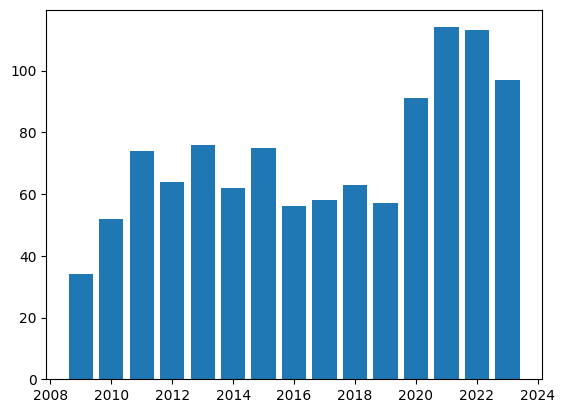

Fatih Porikli
[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]


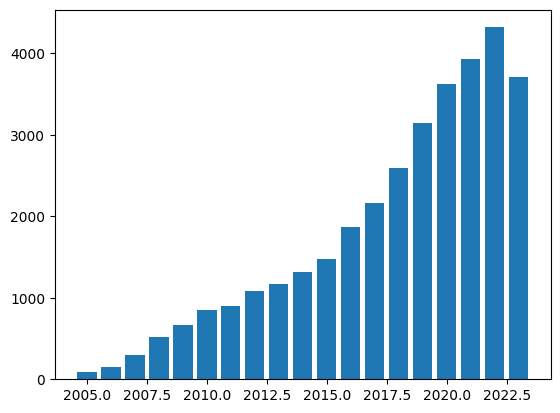

.ipynb_checkpoints


IsADirectoryError: [Errno 21] Is a directory: 'all_data/content/drive/MyDrive/large authors data/.ipynb_checkpoints'

In [ ]:
import matplotlib.pyplot as plt

for file in files:
    print(file)
#     try :
    link  = 'all_data/content/drive/MyDrive/large authors data/' + file
    f =  open(link)
    data = json.load(f)

    print(list(map(int, data["cites_per_year"].keys())))
    dates, cites = list(map(int, data["cites_per_year"].keys())),list(map(int, data["cites_per_year"].values()))
    plt.bar(dates, cites)
    plt.savefig('name_plot/' + str(file) + '.png')
    plt.show()
    f.close()

In [ ]:
import pandas as pd
from IPython.core.display import HTML# Create a dataframe using pandas library
graphs = ['name_plot/' + str(file) + '.png' for file in  authors_info.author.values]
authors_info['plots'] = graphs
def path_to_image_html(path):
    return '<img src="'+ path + '" width="60" >'
authors_info.to_html(escape=False, formatters=dict(plots=path_to_image_html))
ae = HTML(authors_info.to_html(escape=False,formatters=dict(plots=path_to_image_html)))


In [ ]:
ae

,author,affiliation,email_domain,interests,hindex,i10index,plots
0,Chao Xue,Sun Yat-sen University,@mail2.sysu.edu.cn,"[Bioinformatics, Genetics, AI]",3,2,
1,Ningxin Zhang,"Massey University, New Zealand",@massey.ac.nz,"[Molecular biology of microbe-host interaction, molecular epidemiology, genomics]",12,15,
2,Kai Shu,"Assistant Professor of Computer Science, Illinois Institute of Technology",@iit.edu,"[Data Mining, Trustworthy AI, Social Computing, NLP, Disinformation]",37,61,
3,Purvi Goel,Indian Institute of Technology Madras,@cse.iitm.ac.in,"[computer science, machine learning]",7,6,
4,Chen Change Loy,"MMLab@NTU, S-Lab, Nanyang Technological University",@ntu.edu.sg,"[Computer Vision, Image Processing, Machine Learning]",105,210,
5,Tuka Alhanai,New York University Abu Dhabi,@nyu.edu,"[machine learning, computer science, signal processing]",13,16,
6,hailing jin,"Professor & Cy Mouradick Endowed Chair, University of California, Riverside",@ucr.edu,"[cross-kingdom RNAi, small RNA, epigenetics, plant immunity]",62,98,
7,Chi-Huey Wong,The Scripps Research Institute; Academia Sinica,@gate.sinica.edu.tw,[Chemical Biology and Glycoscience],157,823,
8,Xiaodong He (何晓冬),"AI Lab, JD.COM (京东AI研究院); IEEE/CAAI Fellow",@ieee.org,"[deep learning, natural language processing, multimodal vision-and-language]",75,199,
9,Mengyuan Liu,"Assistant Professor, Peking University",@pku.edu.cn,"[Artificial Intelligence, Computer Vision, Robotics]",21,33,


In [ ]:
HTML(left_joined_total.to_html(escape=False,formatters=dict(plots=path_to_image_html)))

# JOINS

![image.png](attachment:image.png)

In [ ]:
authors_info = authors_info.rename(columns={"name": "author"})

In [ ]:
authors_info.shape

(1869, 6)

In [ ]:
table_exploded.shape

(24651, 6)

In [ ]:
authors_info.head()

,author,affiliation,email_domain,interests,hindex,i10index
0,Chao Xue,Sun Yat-sen University,@mail2.sysu.edu.cn,"[Bioinformatics, Genetics, AI]",3,2
1,Ningxin Zhang,"Massey University, New Zealand",@massey.ac.nz,[Molecular biology of microbe-host interaction...,12,15
2,Kai Shu,"Assistant Professor of Computer Science, Illin...",@iit.edu,"[Data Mining, Trustworthy AI, Social Computing...",37,61
3,Purvi Goel,Indian Institute of Technology Madras,@cse.iitm.ac.in,"[computer science, machine learning]",7,6
4,Chen Change Loy,"MMLab@NTU, S-Lab, Nanyang Technological Univer...",@ntu.edu.sg,"[Computer Vision, Image Processing, Machine Le...",105,210


In [ ]:
table_exploded.head()

,Unnamed: 0,author,title,abstract,key_words,date_published
561,561,Chenhao Xu,Deep Learning Techniques for Video Instance Se...,"Video instance segmentation, also known as m...",natural language processing \n deep learning \...,2023-10-19
561,561,Chang-Tsun Li,Deep Learning Techniques for Video Instance Se...,"Video instance segmentation, also known as m...",natural language processing \n deep learning \...,2023-10-19
561,561,Yongjian Hu,Deep Learning Techniques for Video Instance Se...,"Video instance segmentation, also known as m...",natural language processing \n deep learning \...,2023-10-19
561,561,Chee Peng Lim,Deep Learning Techniques for Video Instance Se...,"Video instance segmentation, also known as m...",natural language processing \n deep learning \...,2023-10-19
561,561,Douglas Creighton,Deep Learning Techniques for Video Instance Se...,"Video instance segmentation, also known as m...",natural language processing \n deep learning \...,2023-10-19


In [ ]:
table_exploded = table_exploded.drop_duplicates()

In [ ]:
table_exploded.shape

(4097, 6)

In [ ]:
t1 = table_exploded.groupby("author",  group_keys=True).agg(lambda x: list(set(x))).reset_index()

In [ ]:
t1.head()

,author,Unnamed: 0,title,abstract,key_words,date_published
0,Harshavardhana,[467],[EmpLite: A Lightweight Sequence Labeling Mode...,[ Word emphasis in textual content aims at co...,[natural language processing \n deep learning ...,[2020-12-15 00:00:00]
1,Hui,[315],[Cyber Intrusion Detection by Using Deep Neura...,[ Cyber attacks pose crucial threats to compu...,[natural language processing \n deep learning ...,[2021-03-17 00:00:00]
2,Wang,[315],[Cyber Intrusion Detection by Using Deep Neura...,[ Cyber attacks pose crucial threats to compu...,[natural language processing \n deep learning ...,[2021-03-17 00:00:00]
3,Zhang,[123],[Deep Collective Learning: Learning Optimal In...,[ It is well observed that in deep learning a...,[natural language processing \n deep learning ...,[2020-09-17 00:00:00]
4,Zhongfei,[123],[Deep Collective Learning: Learning Optimal In...,[ It is well observed that in deep learning a...,[natural language processing \n deep learning ...,[2020-09-17 00:00:00]


In [ ]:
t1.shape

(3825, 6)

In [ ]:
inner_merged_total = pd.merge(
   t1, authors_info, on=['author']
)
inner_merged_total.shape

(1184, 11)

In [ ]:
inner_merged_total

,author,Unnamed: 0,title,abstract,key_words,date_published,affiliation,email_domain,interests,hindex,i10index
0,Aamir Miyajiwala,[609],[On Sensitivity of Deep Learning Based Text Cl...,[ Text classification is a fundamental Natura...,[natural language processing \n deep learning ...,[2022-01-02 00:00:00],University of Southern California,@usc.edu,"[Machine Learning, Natural Language Processing...",1,0
1,Abbas Ghaddar,[466],[Towards Zero-Shot Knowledge Distillation for ...,[ Knowledge Distillation (KD) is a common kno...,[natural language processing \n deep learning ...,[2020-12-31 00:00:00],University of Montreal,@umontreal.ca,"[Artificial Intelligence, Natural Language Pro...",10,11
2,Abdelrahman Mohamed,[325],[Self-Supervised Speech Representation Learnin...,[ Although supervised deep learning has revol...,[natural language processing \n deep learning ...,[2022-05-21 00:00:00],"Research scientist, Facebook AI Research",@fb.com,"[Speech Processing, Speech Recognition, Spoken...",49,72
3,Abdullah Al-Dujaili,[536],[AST-Based Deep Learning for Detecting Malicio...,[ With the celebrated success of deep learnin...,[natural language processing \n deep learning ...,[2018-10-03 00:00:00],Analog Devices,@mit.edu,"[Optimization, Machine Learning, Computer Visi...",12,14
4,Abelino Jimenez,[189],[Non-Determinism in Neural Networks for Advers...,[ Recent breakthroughs in the field of deep l...,[natural language processing \n deep learning ...,[2019-05-26 00:00:00],Unknown affiliation,@linkedin.com,"[Machine Learning, Signal Processing, Privacy ...",11,14
...,...,...,...,...,...,...,...,...,...,...,...
1179,Ziyang Huang,[119],[A Survey on Time-Series Pre-Trained Models],[ Time-Series Mining (TSM) is an important re...,[natural language processing \n deep learning ...,[2023-05-18 00:00:00],"Ph.D Student, Tsinghua University",@mails.tsinghua.edu.cn,"[2D materials, functional minerals, magneto-op...",7,6
1180,Ziyao Wang,[889],[A General Framework for Defending Against Bac...,"[ In this work, we propose a new and general ...",[natural language processing \n deep learning ...,[2021-11-29 00:00:00],"University of Maryland, College Park",@umd.edu,"[machine learning, federated learning, securit...",1,0
1181,Zolzaya Dashdorj,[548],[Deep learning model for Mongolian Citizens Fe...,[ A large amount of feedback was collected ov...,[natural language processing \n deep learning ...,[2023-02-23 00:00:00],"Associate professor, Mongolian University of S...",@must.edu.mn,"[pattern recognition, semantics and ontology, ...",6,4
1182,Şaziye Betül Özateş,[751],[A Hybrid Approach to Dependency Parsing: Comb...,"[ Fully data-driven, deep learning-based mode...",[natural language processing \n deep learning ...,[2020-02-24 00:00:00],Boğaziçi University,@boun.edu.tr,"[Computational Linguistics, Natural Language P...",5,5


In [ ]:
outer_merged = pd.merge(
    t1, authors_info, how="outer", on=["author"]
)
outer_merged

,author,Unnamed: 0,title,abstract,key_words,date_published,affiliation,email_domain,interests,hindex,i10index
0,Harshavardhana,[467],[EmpLite: A Lightweight Sequence Labeling Mode...,[ Word emphasis in textual content aims at co...,[natural language processing \n deep learning ...,[2020-12-15 00:00:00],NaN,NaN,NaN,NaN,NaN
1,Hui,[315],[Cyber Intrusion Detection by Using Deep Neura...,[ Cyber attacks pose crucial threats to compu...,[natural language processing \n deep learning ...,[2021-03-17 00:00:00],NaN,NaN,NaN,NaN,NaN
2,Wang,[315],[Cyber Intrusion Detection by Using Deep Neura...,[ Cyber attacks pose crucial threats to compu...,[natural language processing \n deep learning ...,[2021-03-17 00:00:00],NaN,NaN,NaN,NaN,NaN
3,Zhang,[123],[Deep Collective Learning: Learning Optimal In...,[ It is well observed that in deep learning a...,[natural language processing \n deep learning ...,[2020-09-17 00:00:00],NaN,NaN,NaN,NaN,NaN
4,Zhongfei,[123],[Deep Collective Learning: Learning Optimal In...,[ It is well observed that in deep learning a...,[natural language processing \n deep learning ...,[2020-09-17 00:00:00],NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
4513,"Yanli Wang, MD, PhD",NaN,NaN,NaN,NaN,NaN,The Children's Hospital of Philadelphia,@chop.edu,"[Genomics, Bioinformatics]",9.0,9.0
4514,Zhonghua Zhang,NaN,NaN,NaN,NaN,NaN,Qingdao Agricultural University,@qau.edu.cn,[comparative genomics and genetics],45.0,66.0
4515,Yong-Xin Liu (刘永鑫),NaN,NaN,NaN,NaN,NaN,"Agricultural Genomics Institute at Shenzhen, C...",@caas.cn,"[Bioinformatics, Metagenome, Metagenomics, Mic...",21.0,27.0
4516,Joseph A Paguio,NaN,NaN,NaN,NaN,NaN,Jefferson Health,@jefferson.edu,"[Internal Medicine, Public Health]",8.0,5.0


In [ ]:
left_merged_reversed = pd.merge(
    t1, authors_info, how="left", on=["author"]
)
left_merged_reversed.shape

(3833, 11)

In [ ]:
left_merged_reversed

,author,Unnamed: 0,title,abstract,key_words,date_published,affiliation,email_domain,interests,hindex,i10index
0,Harshavardhana,[467],[EmpLite: A Lightweight Sequence Labeling Mode...,[ Word emphasis in textual content aims at co...,[natural language processing \n deep learning ...,[2020-12-15 00:00:00],NaN,NaN,NaN,NaN,NaN
1,Hui,[315],[Cyber Intrusion Detection by Using Deep Neura...,[ Cyber attacks pose crucial threats to compu...,[natural language processing \n deep learning ...,[2021-03-17 00:00:00],NaN,NaN,NaN,NaN,NaN
2,Wang,[315],[Cyber Intrusion Detection by Using Deep Neura...,[ Cyber attacks pose crucial threats to compu...,[natural language processing \n deep learning ...,[2021-03-17 00:00:00],NaN,NaN,NaN,NaN,NaN
3,Zhang,[123],[Deep Collective Learning: Learning Optimal In...,[ It is well observed that in deep learning a...,[natural language processing \n deep learning ...,[2020-09-17 00:00:00],NaN,NaN,NaN,NaN,NaN
4,Zhongfei,[123],[Deep Collective Learning: Learning Optimal In...,[ It is well observed that in deep learning a...,[natural language processing \n deep learning ...,[2020-09-17 00:00:00],NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
3828,sule gunduz oguducu,[80],[A Deep Hybrid Model for Recommendation Systems],[ Recommendation has been a long-standing pro...,[natural language processing \n deep learning ...,[2020-09-21 00:00:00],NaN,NaN,NaN,NaN,NaN
3829,Ülkü Meteriz,[305],"[You Can Run, But You Cannot Hide: Using Eleva...",[ The extensive use of smartphones and wearab...,[natural language processing \n deep learning ...,[2019-10-20 00:00:00],NaN,NaN,NaN,NaN,NaN
3830,Şaziye Betül Özateş,[751],[A Hybrid Approach to Dependency Parsing: Comb...,"[ Fully data-driven, deep learning-based mode...",[natural language processing \n deep learning ...,[2020-02-24 00:00:00],Boğaziçi University,@boun.edu.tr,"[Computational Linguistics, Natural Language P...",5.0,5.0
3831,Şule Gündüz Öğüdücü,[193],[Neural Hybrid Recommender: Recommendation nee...,"[ In recent years, deep learning has gained a...",[natural language processing \n deep learning ...,[2019-09-29 00:00:00],Professor at Istanbul Technical University,@itu.edu.tr,"[Data Mining, web mining, recommendation syste...",24.0,46.0


In [ ]:
t1.join(
     authors_info.set_index(["author"]), on="author",lsuffix="_left", rsuffix="_right"
).shape

(3833, 11)

In [ ]:
t1.join(
     authors_info.set_index(["author"]), on="author", how = 'right', lsuffix="_left", rsuffix="_right"
).shape

(1869, 11)

In [ ]:
t1.join(
     authors_info.set_index(["author"]), on="author" ,how = 'outer', lsuffix="_left", rsuffix="_right"
).shape

(4518, 11)

In [ ]:
inner_joined_total = t1.join(
    authors_info.set_index(["author"]),
    on="author",
    how="inner",
    lsuffix="_x",
    rsuffix="_y",
)

In [ ]:
inner_joined_total

,author,Unnamed: 0,title,abstract,key_words,date_published,affiliation,email_domain,interests,hindex,i10index
8,Aamir Miyajiwala,[609],[On Sensitivity of Deep Learning Based Text Cl...,[ Text classification is a fundamental Natura...,[natural language processing \n deep learning ...,[2022-01-02 00:00:00],University of Southern California,@usc.edu,"[Machine Learning, Natural Language Processing...",1,0
15,Abbas Ghaddar,[466],[Towards Zero-Shot Knowledge Distillation for ...,[ Knowledge Distillation (KD) is a common kno...,[natural language processing \n deep learning ...,[2020-12-31 00:00:00],University of Montreal,@umontreal.ca,"[Artificial Intelligence, Natural Language Pro...",10,11
19,Abdelrahman Mohamed,[325],[Self-Supervised Speech Representation Learnin...,[ Although supervised deep learning has revol...,[natural language processing \n deep learning ...,[2022-05-21 00:00:00],"Research scientist, Facebook AI Research",@fb.com,"[Speech Processing, Speech Recognition, Spoken...",49,72
28,Abdullah Al-Dujaili,[536],[AST-Based Deep Learning for Detecting Malicio...,[ With the celebrated success of deep learnin...,[natural language processing \n deep learning ...,[2018-10-03 00:00:00],Analog Devices,@mit.edu,"[Optimization, Machine Learning, Computer Visi...",12,14
31,Abelino Jimenez,[189],[Non-Determinism in Neural Networks for Advers...,[ Recent breakthroughs in the field of deep l...,[natural language processing \n deep learning ...,[2019-05-26 00:00:00],Unknown affiliation,@linkedin.com,"[Machine Learning, Signal Processing, Privacy ...",11,14
...,...,...,...,...,...,...,...,...,...,...,...
3810,Ziyang Huang,[119],[A Survey on Time-Series Pre-Trained Models],[ Time-Series Mining (TSM) is an important re...,[natural language processing \n deep learning ...,[2023-05-18 00:00:00],"Ph.D Student, Tsinghua University",@mails.tsinghua.edu.cn,"[2D materials, functional minerals, magneto-op...",7,6
3811,Ziyao Wang,[889],[A General Framework for Defending Against Bac...,"[ In this work, we propose a new and general ...",[natural language processing \n deep learning ...,[2021-11-29 00:00:00],"University of Maryland, College Park",@umd.edu,"[machine learning, federated learning, securit...",1,0
3814,Zolzaya Dashdorj,[548],[Deep learning model for Mongolian Citizens Fe...,[ A large amount of feedback was collected ov...,[natural language processing \n deep learning ...,[2023-02-23 00:00:00],"Associate professor, Mongolian University of S...",@must.edu.mn,"[pattern recognition, semantics and ontology, ...",6,4
3822,Şaziye Betül Özateş,[751],[A Hybrid Approach to Dependency Parsing: Comb...,"[ Fully data-driven, deep learning-based mode...",[natural language processing \n deep learning ...,[2020-02-24 00:00:00],Boğaziçi University,@boun.edu.tr,"[Computational Linguistics, Natural Language P...",5,5


In [ ]:
joined_total = inner_joined_total.drop_duplicates(subset=['author', 'email_domain', 'hindex', 'i10index'])

In [ ]:
joined_total

,author,Unnamed: 0,title,abstract,key_words,date_published,affiliation,email_domain,interests,hindex,i10index
8,Aamir Miyajiwala,[609],[On Sensitivity of Deep Learning Based Text Cl...,[ Text classification is a fundamental Natura...,[natural language processing \n deep learning ...,[2022-01-02 00:00:00],University of Southern California,@usc.edu,"[Machine Learning, Natural Language Processing...",1,0
15,Abbas Ghaddar,[466],[Towards Zero-Shot Knowledge Distillation for ...,[ Knowledge Distillation (KD) is a common kno...,[natural language processing \n deep learning ...,[2020-12-31 00:00:00],University of Montreal,@umontreal.ca,"[Artificial Intelligence, Natural Language Pro...",10,11
19,Abdelrahman Mohamed,[325],[Self-Supervised Speech Representation Learnin...,[ Although supervised deep learning has revol...,[natural language processing \n deep learning ...,[2022-05-21 00:00:00],"Research scientist, Facebook AI Research",@fb.com,"[Speech Processing, Speech Recognition, Spoken...",49,72
28,Abdullah Al-Dujaili,[536],[AST-Based Deep Learning for Detecting Malicio...,[ With the celebrated success of deep learnin...,[natural language processing \n deep learning ...,[2018-10-03 00:00:00],Analog Devices,@mit.edu,"[Optimization, Machine Learning, Computer Visi...",12,14
31,Abelino Jimenez,[189],[Non-Determinism in Neural Networks for Advers...,[ Recent breakthroughs in the field of deep l...,[natural language processing \n deep learning ...,[2019-05-26 00:00:00],Unknown affiliation,@linkedin.com,"[Machine Learning, Signal Processing, Privacy ...",11,14
...,...,...,...,...,...,...,...,...,...,...,...
3810,Ziyang Huang,[119],[A Survey on Time-Series Pre-Trained Models],[ Time-Series Mining (TSM) is an important re...,[natural language processing \n deep learning ...,[2023-05-18 00:00:00],"Ph.D Student, Tsinghua University",@mails.tsinghua.edu.cn,"[2D materials, functional minerals, magneto-op...",7,6
3811,Ziyao Wang,[889],[A General Framework for Defending Against Bac...,"[ In this work, we propose a new and general ...",[natural language processing \n deep learning ...,[2021-11-29 00:00:00],"University of Maryland, College Park",@umd.edu,"[machine learning, federated learning, securit...",1,0
3814,Zolzaya Dashdorj,[548],[Deep learning model for Mongolian Citizens Fe...,[ A large amount of feedback was collected ov...,[natural language processing \n deep learning ...,[2023-02-23 00:00:00],"Associate professor, Mongolian University of S...",@must.edu.mn,"[pattern recognition, semantics and ontology, ...",6,4
3822,Şaziye Betül Özateş,[751],[A Hybrid Approach to Dependency Parsing: Comb...,"[ Fully data-driven, deep learning-based mode...",[natural language processing \n deep learning ...,[2020-02-24 00:00:00],Boğaziçi University,@boun.edu.tr,"[Computational Linguistics, Natural Language P...",5,5


In [ ]:
HTML(joined_total.to_html(escape=False,formatters=dict(plots=path_to_image_html)))

,author,Unnamed: 0,title,abstract,key_words,date_published,affiliation,email_domain,interests,hindex,i10index,plots
8,Aamir Miyajiwala,[609],[On Sensitivity of Deep Learning Based Text Classification Algorithms to\n Practical Input Perturbations],"[ Text classification is a fundamental Natural Language Processing task that\nhas a wide variety of applications, where deep learning approaches have\nproduced state-of-the-art results. While these models have been heavily\ncriticized for their black-box nature, their robustness to slight perturbations\nin input text has been a matter of concern. In this work, we carry out a\ndata-focused study evaluating the impact of systematic practical perturbations\non the performance of the deep learning based text classification models like\nCNN, LSTM, and BERT-based algorithms. The perturbations are induced by the\naddition and removal of unwanted tokens like punctuation and stop-words that\nare minimally associated with the final performance of the model. We show that\nthese deep learning approaches including BERT are sensitive to such legitimate\ninput perturbations on four standard benchmark datasets SST2, TREC-6, BBC News,\nand tweet_eval. We observe that BERT is more susceptible to the removal of\ntokens as compared to the addition of tokens. Moreover, LSTM is slightly more\nsensitive to input perturbations as compared to CNN based model. The work also\nserves as a practical guide to assessing the impact of discrepancies in\ntrain-test conditions on the final performance of models.\n]",[natural language processing \n deep learning \n computer vision],[2022-01-02 00:00:00],University of Southern California,@usc.edu,"[Machine Learning, Natural Language Processing, Data Science, Geospatial Analysis]",1,0,
15,Abbas Ghaddar,[466],[Towards Zero-Shot Knowledge Distillation for Natural Language Processing],"[ Knowledge Distillation (KD) is a common knowledge transfer algorithm used for\nmodel compression across a variety of deep learning based natural language\nprocessing (NLP) solutions. In its regular manifestations, KD requires access\nto the teacher's training data for knowledge transfer to the student network.\nHowever, privacy concerns, data regulations and proprietary reasons may prevent\naccess to such data. We present, to the best of our knowledge, the first work\non Zero-Shot Knowledge Distillation for NLP, where the student learns from the\nmuch larger teacher without any task specific data. Our solution combines out\nof domain data and adversarial training to learn the teacher's output\ndistribution. We investigate six tasks from the GLUE benchmark and demonstrate\nthat we can achieve between 75% and 92% of the teacher's classification score\n(accuracy or F1) while compressing the model 30 times.\n]",[natural language processing \n deep learning \n computer vision],[2020-12-31 00:00:00],University of Montreal,@umontreal.ca,"[Artificial Intelligence, Natural Language Processing, Machine Learning, Deep Learning]",10,11,
19,Abdelrahman Mohamed,[325],[Self-Supervised Speech Representation Learning: A Review],"[ Although supervised deep learning has revolutionized speech and audio\nprocessing, it has necessitated the building of specialist models for\nindividual tasks and application scenarios. It is likewise difficult to apply\nthis to dialects and languages for which only limited labeled data is\navailable. Self-supervised representation learning methods promise a single\nuniversal model that would benefit a wide variety of tasks and domains. Such\nmethods have shown success in natural language processing and computer vision\ndomains, achieving new levels of performance while reducing the number of\nlabels required for many downstream scenarios. Speech representation learning\nis experiencing similar progress in three main categories: generative,\ncontrastive, and predictive methods. Other approaches rely on multi-modal data\nfor pre-training, mixing text or visual data streams with spe

# Find article with the highest mean hindex

In [ ]:
subset = joined_total[['author', 'title', 'hindex']]

In [ ]:
h_paper = pd.DataFrame(subset.explode('title')[[ 'title', 'hindex']].groupby('title',).hindex.mean().reset_index())

In [ ]:
h_paper.hindex.max()


246.0

# COATHORS GRAPH

In [ ]:
%config InlineBackend.figure_format='retina'

In [ ]:
dict_coathors = dict()
for file in files:
    if file not in dict_coathors.keys():
        dict_coathors[file] = []
    print(file)
    link  = 'all_data/content/drive/MyDrive/large authors data/' + file
    f =  open(link)
    data = json.load(f)


    if len(data["coauthors"])> 0:
        for coathor in data["coauthors"]:
            if coathor['name'] not in dict_coathors.keys():
                dict_coathors[coathor['name']] = [file]
            else:
                dict_coathors[coathor['name']].append(file)
            dict_coathors[file].append(coathor['name'])






    f.close()

Xuechao Sun
Ningxin Zheng
Kai Shu
Purvi Goel
Chen Change Loy
Tuka Alhanai
Hailin Jin
Qi Wang
Xiaodong He
Mengyuan Liu
Ganesh Bagler
Karteek Alahari
Anirban Laha
Matthias Grabmair
Matthew D. Hoffman
Barath Raj Kandur Raja
Pablo Arias
Guoliang Li
Ke Qin
Akarsh S
Qun Liu
Peter Fettke
Ulas Sert
Evgenii Zheltonozhskii
Kanav Vats
Subir Biswas
Shumin Deng
Yi-Chia Wang
Luis Vega
Maciej M. Mazurowski
Xiongwei Wu
Bing Shuai
Tianyu Gao
Tri Nguyen
Hui Deng
Ping Lu
Cameran Frank
Muhammad Ali Ibrahim
Yuyu Luo
Khiem Vinh Tran
Huiqiang Xie
Sungho Yoon
Yaoru Luo
Mitchell Nahmias
Cong Bai
Prabal Datta Barua
Min Peng
Yiheng Xu
Zhangyang Wang
Dheeraj Vattikonda
Mengwei Xu
Swasti Mishra
Shuai Zheng
Yongqiang Yao
Wenwu Zhu
Guangxiang Zhao
Soujanya Poria
Felix Hieber
Owen Rambow
Pravendra Singh
Pablo Pino
Xiaoyu Zhang
Michael Zyda
Christopher Hidey
Cyprien de Masson d'Autume
Nan Yang
Zolzaya Dashdorj
Shubhada Labde
Chen Zhao
Yan Shi
Gang Chen
Zihao Wang
Liang Zhao
Shi Jin
Ze Cao
 Zhang
Wangchunshu Zhou
Ahmad

IsADirectoryError: [Errno 21] Is a directory: 'all_data/content/drive/MyDrive/large authors data/.ipynb_checkpoints'

In [ ]:
nd = dict()
for i, (k,v) in enumerate(dict_coathors.items()):
    if i != 6:
        nd[k] = v
    else:
        pass
    i+=1
    if i==9:
        break

In [ ]:
G = nx.DiGraph(nd)

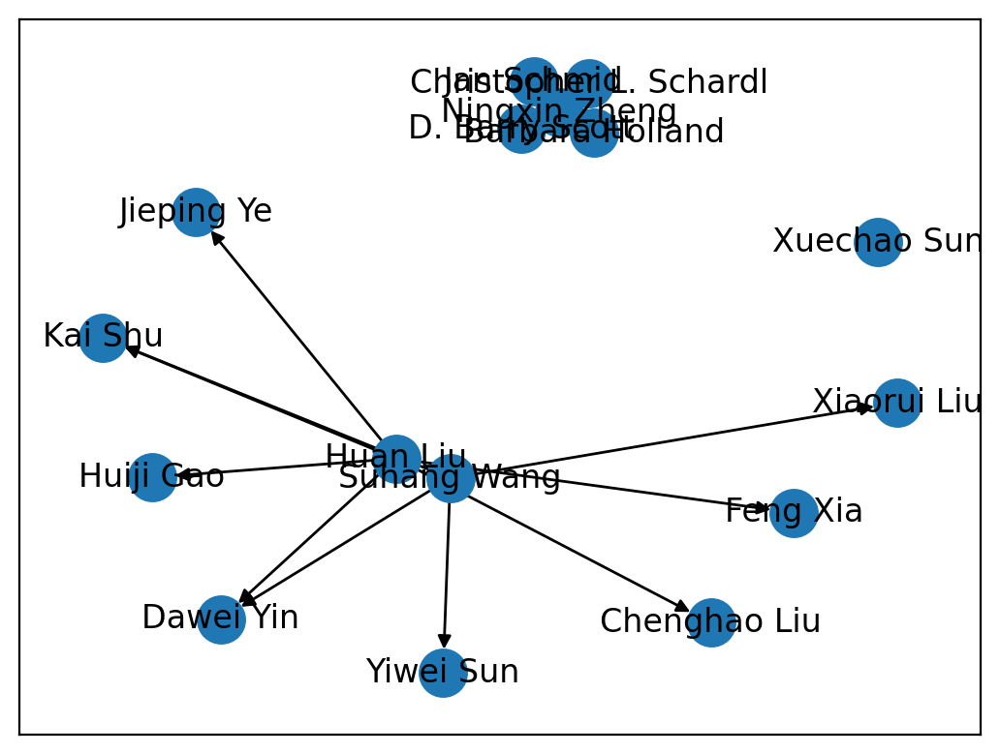

In [ ]:
nx.draw_networkx(G, with_labels=True)

In [ ]:
# Adj = nx.adjacency_matrix(G)

### Get adjacency matrix

In [ ]:
df = dict_coathors
df2 = pd.DataFrame.from_dict(df, orient='index')
df2 = df2.stack().reset_index()
df2.level_1=1

In [ ]:
df3 = df2.drop_duplicates().pivot(index='level_0',columns=0,values='level_1').fillna(0)

In [ ]:
df3

,Zhang,"""Chun-Huat Heng""","""Denise Doolan""","""Jose C. Nicolau"" or ""Jose Nicolau"" or ""Jose Carlos Nicolau"" or ""Nicolau JC"" or Nicolau J","""Sang Bok Lee""","""Yashodhan Kanoria"" OR ""Yash Kanoria""",(Jacob) Zhiyuan Fang,(Lily) Ziwei Cheng,(محمد الحبيب) Mohamed Alhabeb,A Jon Stoessl OR jon Stoessl,...,Антон Циммерлинг (Anton Zimmerling),Калачев Глеб,ا.د. عمر الكيلاني,​Madhavilatha Maganti,呉剣明(Jianming WU),曾薇 Wei Zeng,朱伟,"杨运煌 (Yang, Yunhuang)",欣荣 戴,김병서 (Byung-Seo Kim)
level_0,,,,,,,,,,,,,,,,,,,,,
Zhang,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""Chun-Huat Heng""",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""Denise Doolan""",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""Jose C. Nicolau"" or ""Jose Nicolau"" or ""Jose Carlos Nicolau"" or ""Nicolau JC"" or Nicolau J",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""Sang Bok Lee""",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
曾薇 Wei Zeng,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
朱伟,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"杨运煌 (Yang, Yunhuang)",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## Friendship paradox

In [ ]:
csr_matrix = csr_matrix(df3.astype(pd.SparseDtype("float64",0)).sparse.to_coo())

In [ ]:
csr_matrix.sum(axis=0)

matrix([[18.,  1.,  2., ...,  1.,  1.,  1.]])

In [ ]:
csr_matrix.todense().sum(axis=0).A[0]

array([18.,  1.,  2., ...,  1.,  1.,  1.])

In [ ]:
csr_matrix.dot(csr_matrix).todense().sum(axis=0)

matrix([[ 35.,  50., 145., ..., 192.,  38.,  12.]])

In [ ]:
matrix = np.array([[0,1,0,1], [1,0,1,1], [0,1,0,1],[1,1,1,0]])

In [ ]:
matrix.sum(axis=0)

array([2, 3, 2, 3])

In [ ]:
(matrix@matrix)

array([[2, 1, 2, 1],
       [1, 3, 1, 2],
       [2, 1, 2, 1],
       [1, 2, 1, 3]])

# GET NUMBER OF PUBLICATIONS CITATIONS


1870

In [ ]:

for file in files:

    dict_publictions = {
        'title' : [],
        'pub_year': [],
        'num_citations' : [],
      }


    link  = 'all_data/content/drive/MyDrive/large authors data/' + file

    if link != 'all_data/content/drive/MyDrive/large authors data/.ipynb_checkpoints':
        f =  open(link)
        data = json.load(f)
        for i in range(len(data['publications'])):

            try:
                dict_publictions['title'].append(data['publications'][i]['bib']['title'])

                dict_publictions['pub_year'].append(data['publications'][i]['bib']['pub_year'])
                dict_publictions['num_citations'].append(data['publications'][i]['num_citations'])
            except KeyError:
                dict_publictions['pub_year'].append(0)
                dict_publictions['num_citations'].append(data['publications'][i]['num_citations'])
    pd.DataFrame(dict_publictions).to_csv('Pubs2/'+str(file)+'.csv')
#     break

In [ ]:
for file in files:
    print(pd.read_csv('Pubs2/'+str(file)+'.csv'))
    break

   Unnamed: 0                                              title  pub_year  \
0           0  A powerful conditional gene-based association ...      2019   
1           1  DESE: estimating driver tissues by selective e...      2019   
2           2  A conditional gene-based association framework...      2022   
3           3  PCGA: a comprehensive web server for phenotype...      2022   
4           4  Powerful and robust inference of complex pheno...      2022   
5           5  A global overview of single-cell type selectiv...      2020   
6           6  Genome-Wide Association Study Identifies New R...      2022   

   num_citations  
0             19  
1             16  
2              5  
3              2  
4              2  
5              1  
6              0  


In [ ]:
import os
pubs = os.listdir('Pubs2')

In [ ]:
len(pubs)

1870

In [ ]:
def maximum_cite(x):

    try:
        name = x + '.csv'
        df = pd.read_csv('Pubs2/'+name)

        return df.num_citations.max()
    except FileNotFoundError:
        return 0.


In [ ]:
joined_total['max_cite'] = joined_total.author.apply(lambda x : maximum_cite(x))

/tmp/ipykernel_74416/968482927.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  joined_total['max_cite'] = joined_total.author.apply(lambda x : maximum_cite(x))


In [ ]:
joined_total

,author,Unnamed: 0,title,abstract,key_words,date_published,affiliation,email_domain,interests,hindex,i10index,max_cite
8,Aamir Miyajiwala,[609],[On Sensitivity of Deep Learning Based Text Cl...,[ Text classification is a fundamental Natura...,[natural language processing \n deep learning ...,[2022-01-02 00:00:00],University of Southern California,@usc.edu,"[Machine Learning, Natural Language Processing...",1,0,5.0
15,Abbas Ghaddar,[466],[Towards Zero-Shot Knowledge Distillation for ...,[ Knowledge Distillation (KD) is a common kno...,[natural language processing \n deep learning ...,[2020-12-31 00:00:00],University of Montreal,@umontreal.ca,"[Artificial Intelligence, Natural Language Pro...",10,11,108.0
19,Abdelrahman Mohamed,[325],[Self-Supervised Speech Representation Learnin...,[ Although supervised deep learning has revol...,[natural language processing \n deep learning ...,[2022-05-21 00:00:00],"Research scientist, Facebook AI Research",@fb.com,"[Speech Processing, Speech Recognition, Spoken...",49,72,12678.0
28,Abdullah Al-Dujaili,[536],[AST-Based Deep Learning for Detecting Malicio...,[ With the celebrated success of deep learnin...,[natural language processing \n deep learning ...,[2018-10-03 00:00:00],Analog Devices,@mit.edu,"[Optimization, Machine Learning, Computer Visi...",12,14,192.0
31,Abelino Jimenez,[189],[Non-Determinism in Neural Networks for Advers...,[ Recent breakthroughs in the field of deep l...,[natural language processing \n deep learning ...,[2019-05-26 00:00:00],Unknown affiliation,@linkedin.com,"[Machine Learning, Signal Processing, Privacy ...",11,14,100.0
...,...,...,...,...,...,...,...,...,...,...,...,...
3810,Ziyang Huang,[119],[A Survey on Time-Series Pre-Trained Models],[ Time-Series Mining (TSM) is an important re...,[natural language processing \n deep learning ...,[2023-05-18 00:00:00],"Ph.D Student, Tsinghua University",@mails.tsinghua.edu.cn,"[2D materials, functional minerals, magneto-op...",7,6,68.0
3811,Ziyao Wang,[889],[A General Framework for Defending Against Bac...,"[ In this work, we propose a new and general ...",[natural language processing \n deep learning ...,[2021-11-29 00:00:00],"University of Maryland, College Park",@umd.edu,"[machine learning, federated learning, securit...",1,0,3.0
3814,Zolzaya Dashdorj,[548],[Deep learning model for Mongolian Citizens Fe...,[ A large amount of feedback was collected ov...,[natural language processing \n deep learning ...,[2023-02-23 00:00:00],"Associate professor, Mongolian University of S...",@must.edu.mn,"[pattern recognition, semantics and ontology, ...",6,4,51.0
3822,Şaziye Betül Özateş,[751],[A Hybrid Approach to Dependency Parsing: Comb...,"[ Fully data-driven, deep learning-based mode...",[natural language processing \n deep learning ...,[2020-02-24 00:00:00],Boğaziçi University,@boun.edu.tr,"[Computational Linguistics, Natural Language P...",5,5,0.0


# PAGERANK

## HOW DO SEARCH ENGINES WORK?


> CRAWLING
 -   Scour the Internet for content, looking over the code/content for each URL they find.
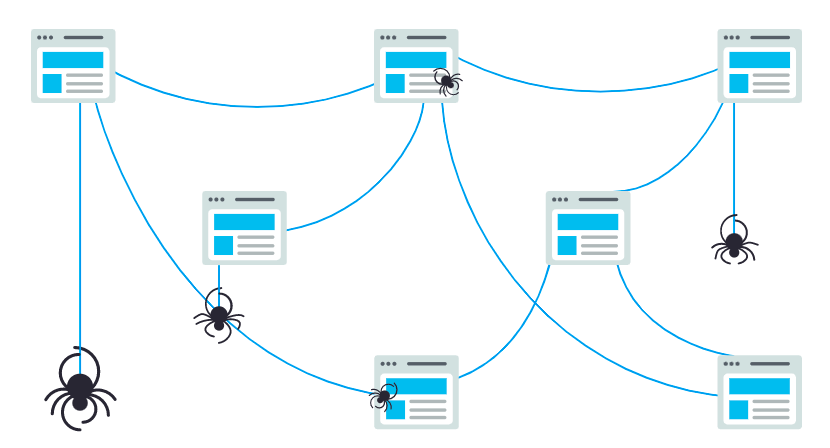



> INDEXING
 - Store and organize the content found during the crawling process. Once a page is in the index, it’s in the running to be displayed as a result to relevant queries.
 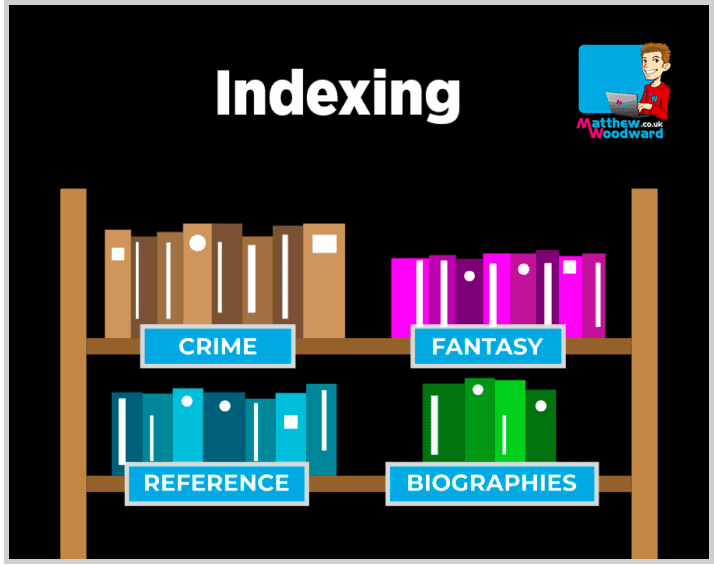

> RANKING
 - Provide the pieces of content that will best answer a searcher's query, which means that results are ordered by most relevant to least relevant.


  ## HOW TO RANK?

  ### Early 90s - *text based ranking systems*

  - It seems reasonable to imagine that what a search engine does is to keep an index of all web pages, and when a user types in a query search, the engine browses through its index and counts the occurrences of the key words in each web file. The winners are the pages with the highest number of occurrences of the key words. These get displayed back to the user.


  ## WILL IT WORK?

## ANOTHER APPROACH

> PageRank, 1998

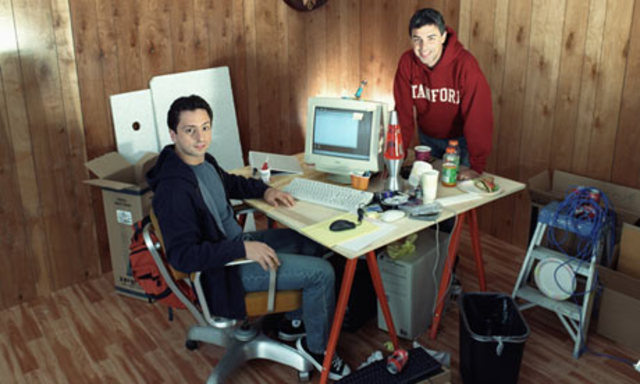


http://ilpubs.stanford.edu:8090/422/1/1999-66.pdf

## WE have several pages. How we can represent it? As a graph!

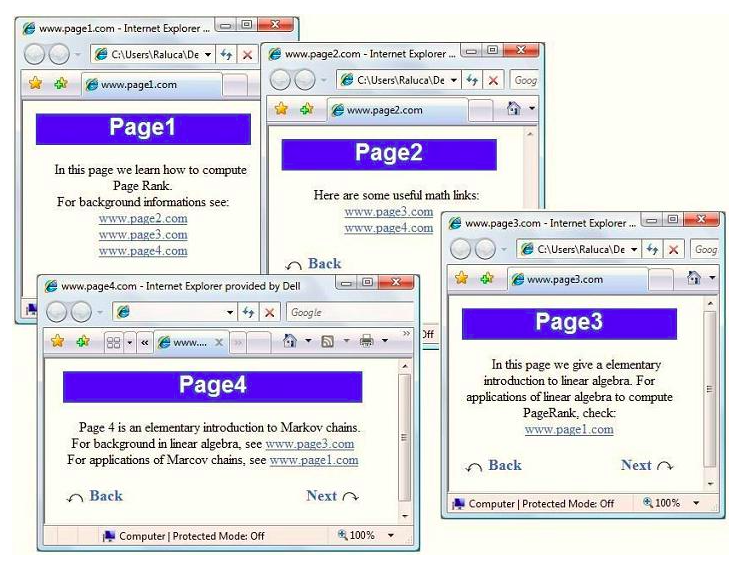

## We can easily represents web-pages as graph

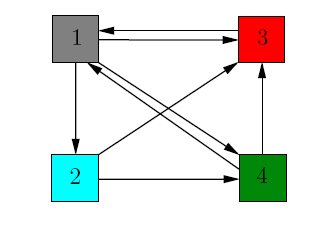

In [ ]:
import numpy as np
## Adjacency matrix:

A =  np.array([[0, 0, 1, 1],
               [1, 0, 0, 0],
               [1, 1, 0, 1],
               [1, 1, 0, 0]], dtype=np.float64)

A

array([[0., 0., 1., 1.],
       [1., 0., 0., 0.],
       [1., 1., 0., 1.],
       [1., 1., 0., 0.]])

We need to compute somehow the transition matrix (column-stohastic matrix with the probabilities of transition from $j$ node to $i$)

$$a_{i,j} \ge 0$$ and $$\sum_{j}a_{i,j} = 1$$

In [ ]:
from scipy.sparse import diags
import numpy as np
from scipy.linalg import lu
from time import time
import scipy.sparse as sp

def transition_matrix(G):
    sum1 = G.sum(axis=0)
    sum1[sum1 == 0] = 1
    if sp.issparse(G):
        # diag = sp.lil_matrix((sum1.shape[0], sum1.shape[0]))
        # print(diag.shape, sum1.shape)
        # diag.setdiag(1 / sum1)
        A = G.multiply(1 / sum1) #diag
    else:
        A = G * 1 / sum1

    return A

In [ ]:
transition_matrix(A)

array([[0.        , 0.        , 1.        , 0.5       ],
       [0.33333333, 0.        , 0.        , 0.        ],
       [0.33333333, 0.5       , 0.        , 0.5       ],
       [0.33333333, 0.5       , 0.        , 0.        ]])

Now imagine that we have $N$ users and their initial distribution $x_0=$ (it may be uniform, or whatever).

Each step in the graph can be expressed with multiplication of the trnsition matrix

So we get

$$Ax_0$$

on the first step

$$A (A x_0) = A^2 x_0$$

on the second step.


On the $k$$th step we obtain

$$A^k x_0$$


We will get $v = A^k x_0$ where $v$ presents the distribution of the $N$ after $k$ steps.

What is vectir $v$?


## POWER METHOD

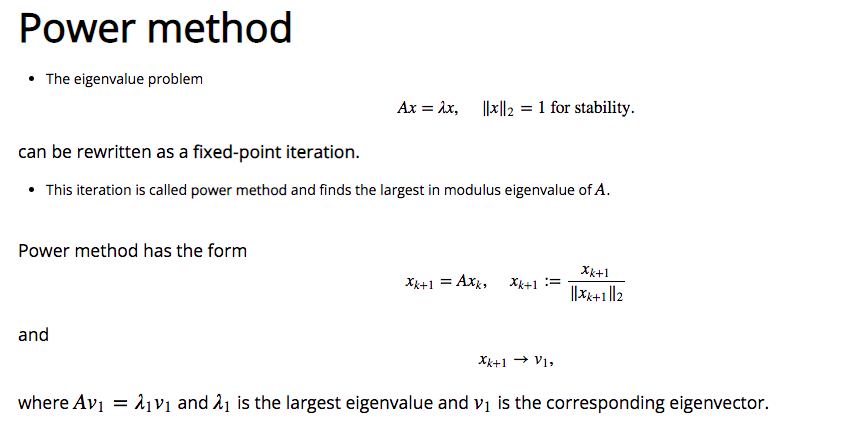

In [ ]:
def power_iteration(A, num_simulations: int):
    # Ideally choose a random vector
    # To decrease the chance that our vector
    # Is orthogonal to the eigenvector
    b_k = np.array([0.25, 0.25, 0.25, 0.25])#np.random.rand(A.shape[1])

    for _ in range(num_simulations):
        # calculate the matrix-by-vector product Ab
        b_k1 = np.dot(A, b_k)

        # calculate the norm
        # b_k1_norm = np.linalg.norm(b_k1)

        # re normalize the vector
        b_k = b_k1 #  / b_k1_norm

    return b_k

power_iteration(transition_matrix(A), 8)

array([0.38671875, 0.12991898, 0.28978588, 0.19357639])

In [ ]:
power_iteration(transition_matrix(A), 100)

array([0.38709677, 0.12903226, 0.29032258, 0.19354839])

In [ ]:
e, v = np.linalg.eig(transition_matrix(A))
v[:,0]

array([0.72101012+0.j, 0.24033671+0.j, 0.54075759+0.j, 0.36050506+0.j])

## Our final distribution - is yhe maximum eigen vector!

But ... Not that fast


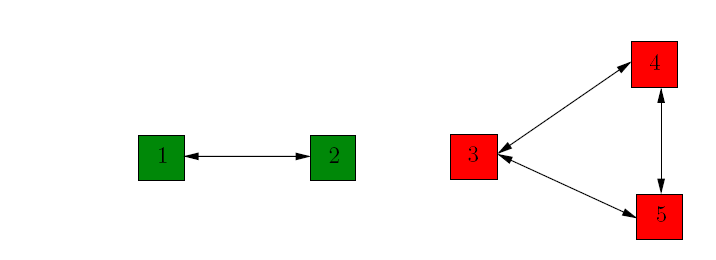

In [ ]:
A_disconnected = np.array([[0,1, 0, 0, 0],
                           [1, 0, 0, 0, 0],
                           [0, 0, 0 , 1, 1],
                           [0, 0, 1, 0, 1],
                           [0, 0 , 1, 1, 0]])

In [ ]:
A_disconnected

array([[0, 1, 0, 0, 0],
       [1, 0, 0, 0, 0],
       [0, 0, 0, 1, 1],
       [0, 0, 1, 0, 1],
       [0, 0, 1, 1, 0]])

In [ ]:

transition_matrix(A_disconnected)

array([[0. , 1. , 0. , 0. , 0. ],
       [1. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0.5, 0.5],
       [0. , 0. , 0.5, 0. , 0.5],
       [0. , 0. , 0.5, 0.5, 0. ]])

In [ ]:
e_d, v_d = np.linalg.eig(transition_matrix(A_disconnected))
v_d

array([[ 0.70710678, -0.70710678,  0.        ,  0.        ,  0.        ],
       [ 0.70710678,  0.70710678,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        , -0.81649658,  0.57735027,  0.22645541],
       [ 0.        ,  0.        ,  0.40824829,  0.57735027, -0.79259392],
       [ 0.        ,  0.        ,  0.40824829,  0.57735027,  0.56613852]])

## Here comes the PageRank magic!

Let's Denote $P$ as a Transition matrix, $d$ is a damping factor (0, 1), and $w$ is vector such as $w^{\top}e =1$ where $e = [1, 1, 1, \dots, 1, 1,1 ]$


Brin and Page introduced regularization trachique


$$
\textbf{M} = d \textbf{P} + (1-d) we^{\top}
$$

if we take $w = [\frac{1}{N}, \frac{1}{N}, \dots, \frac{1}{N}, \frac{1}{N}]$
$$
\textbf{M}  = d \textbf{P} + \frac{1-d}{N} \begin{pmatrix} 1 & \dots & 1 \\ \vdots & & \vdots \\ 1 & \dots & 1 \end{pmatrix},
$$



Why this matrix is good?

**Perron-Frobenius Theorem**: If $M$ is a positive, column stochastic matrix, then:
 - 1 is an eigenvalue of multiplicity one.


- 1 is the largest eigenvalue: all the other eigenvalues have absolute value smaller than 1.


-  The eigenvectors corresponding to the eigenvalue 1 have either only positive entries or only negative entries. In particular, for the eigenvalue 1 there exists a unique eigenvector with the sum of its entries equal to 1.

**That provides Power Method convergency!**


Power Method Convergence Theorem: Let $M$ be a positive, column stochastic $n \times n$ matrix. Denote by $v$ its probabilistic eigenvector corresponding to the eigenvalue $1$. Let $z$ be the column vector with all entries equal to . Then the sequence $z, Mz, ..., M^{k}z$ converges to the vector $v$.

In [ ]:
def page_rank(A, d):
  P = transition_matrix(A)
  M = d * P + (1 - d) / P.shape[0] * np.ones(P.shape)

  return M

The eigen vector problem is:

#### We take $e^{\top}v = \sum v_i$

$$
M v = v
$$
$$
(d \textbf{P} + (1-d) we^{\top}) v = v
$$
$$
(d \textbf{P} + \frac{(1-d)}{N} e e^{\top}) v = v
$$

$$
v^{k+1} = d \textbf{P} v^{k} +  \frac{(1-d)}{N} e \sum v_i
$$

In [ ]:

def page_rank_matvec(P, d, v):
   vk = d * P @ v + (1 - d) / P.shape[0] * np.ones(P.shape[1])

   return vk

In [ ]:
from tqdm import tqdm

def power_method_PR(A, d, num_simulations):

    b_k = np.ones(A.shape[1]) /A.shape[1]
    P = transition_matrix(A)
    for _ in tqdm(range(num_simulations)):

        b_k1 = page_rank_matvec(P, d, b_k)


        b_k1_norm = np.linalg.norm(b_k1)


        b_k = b_k1 / b_k1_norm

    return b_k


# RANK THE SCIENTISTs


In [ ]:
from scipy.sparse import diags
import numpy as np
from scipy.linalg import lu
from time import time
import scipy.sparse as sp

def transition_matrix(G):
    sum1 = G.sum(axis=0)
    sum1[sum1 == 0] = 1
    if sp.issparse(G):
        # diag = sp.lil_matrix((sum1.shape[0], sum1.shape[0]))
        # print(diag.shape, sum1.shape)
        # diag.setdiag(1 / sum1)
        A = G.multiply(1 / sum1) #diag
    else:
        A = G * 1 / sum1

    return A

In [ ]:
A = transition_matrix(csr_matrix)

In [ ]:
A

<21370x21370 sparse matrix of type '<class 'numpy.float64'>'
	with 50460 stored elements in COOrdinate format>

In [ ]:
def page_rank(A, d):
    P = transition_matrix(A)
    M = d * P + (1 - d) / P.shape[0] * np.ones(P.shape)

    return M

In [ ]:
def page_rank_matvec(P, d, v):
    vk = d * P.todense() @ v + (1 - d) / P.shape[0] * np.ones((P.shape[1], 1)) *np.mean(v)


    return vk

In [ ]:


def power_method_PR(A, d, num_simulations):

    b_k = np.ones((A.shape[1], 1)) /A.shape[1]

    P = transition_matrix(A)
    for _ in tqdm(range(num_simulations)):

        b_k1 = page_rank_matvec(P, d, b_k)


        b_k1_norm = np.linalg.norm(b_k1)


        b_k = b_k1 / b_k1_norm

    return b_k

In [ ]:
d = 0.85
b = power_method_PR(A, d, 200)

  2%|███                                                                                                                                                                                                             | 3/200 [00:08<09:27,  2.88s/it]


KeyboardInterrupt: 

In [ ]:
def page_rank_matvec(v):
    d = 0.85
    P= PGA

    v = v.reshape(-1,1)
    vk = d * P @ v + (1 - d) * np.mean(v)

    return vk

In [ ]:
# PGA = page_rank(A, d)
PGA = transition_matrix(csr_matrix)
A = LinearOperator((PGA.shape[0], PGA.shape[1]), matvec=page_rank_matvec)

In [ ]:
def power_method_PR(A, d, num_simulations):

    b_k = np.ones((A.shape[1], 1)) /A.shape[1]


    for _ in tqdm(range(num_simulations)):

        b_k1 = A.matvec(b_k)


        b_k1_norm = np.linalg.norm(b_k1)


        b_k = b_k1 / b_k1_norm

    return b_k

In [ ]:
res = power_method_PR(A, 0.85, 200)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 676.99it/s]


In [ ]:
authors = df3.reset_index().level_0.values

In [ ]:
authors

array([' Zhang', '"Chun-Huat Heng"', '"Denise Doolan"', ...,
       '杨运煌 (Yang, Yunhuang)', '欣荣 戴', '김병서 (Byung-Seo Kim)'],
      dtype=object)

In [ ]:
res[:, 0][np.argsort(-res[:, 0])]

array([0.22542329, 0.14627028, 0.14590091, ..., 0.00066923, 0.00066923,
       0.00066787])

In [ ]:
authors[np.argsort(-res[:, 0])][:20]

array(['Ian Foster', 'Wei Zhao', 'Burkhard Rost', 'Alan F. Smeaton',
       'Spyridon Bakas', 'Bennett Landman', 'Fausto Giunchiglia',
       'Ryan Cotterell', 'Lingxi Xie', 'Mohammed Bennamoun',
       'Aditya Joshi', 'Zhiyuan Liu', 'Xiaobo Sharon Hu', 'Nick Erickson',
       'Dragomir Radev', 'Hong Zhang', 'Erik Cambria',
       'William Yang Wang', 'Dong Yu', 'Chen Change Loy'], dtype=object)